In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'P4_2.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain]
x_val = xval
y_val = [yval,yval]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM, fx

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 292)      346896      input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 495)      145035      lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        992         dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/Desktop/New folder3/model checkpoint/P4_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik},loss_weights=[0.5,0.5],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 1135176.62500, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00002: val_loss improved from 1135176.62500 to 814977.37500, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00003: val_loss improved from 814977.37500 to 614068.31250, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00004: val_loss improved from 614068.31250 to 473091.31250, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00005: val_loss improved from 473091.31250 to 471414.06250, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00006: val_loss improved from 471414.06250 to 462708.59375, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00007: val_loss did not improve


Epoch 00204: val_loss did not improve from 14323.81641

Epoch 00205: val_loss did not improve from 14323.81641

Epoch 00206: val_loss did not improve from 14323.81641

Epoch 00207: val_loss did not improve from 14323.81641

Epoch 00208: val_loss did not improve from 14323.81641

Epoch 00209: val_loss improved from 14323.81641 to 13911.90918, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00210: val_loss did not improve from 13911.90918

Epoch 00211: val_loss did not improve from 13911.90918

Epoch 00212: val_loss did not improve from 13911.90918

Epoch 00213: val_loss did not improve from 13911.90918

Epoch 00214: val_loss did not improve from 13911.90918

Epoch 00215: val_loss did not improve from 13911.90918

Epoch 00216: val_loss did not improve from 13911.90918

Epoch 00217: val_loss did not improve from 13911.90918

Epoch 00218: val_loss did not improve from 13911.90918

Epoch 00219: val_loss did not improve from 13911.90918

Epoch 00220: val_lo


Epoch 00329: val_loss did not improve from 11847.92871

Epoch 00330: val_loss did not improve from 11847.92871

Epoch 00331: val_loss improved from 11847.92871 to 11845.56934, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00332: val_loss did not improve from 11845.56934

Epoch 00333: val_loss did not improve from 11845.56934

Epoch 00334: val_loss did not improve from 11845.56934

Epoch 00335: val_loss did not improve from 11845.56934

Epoch 00336: val_loss did not improve from 11845.56934

Epoch 00337: val_loss did not improve from 11845.56934

Epoch 00338: val_loss did not improve from 11845.56934

Epoch 00339: val_loss did not improve from 11845.56934

Epoch 00340: val_loss improved from 11845.56934 to 11816.34570, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00341: val_loss did not improve from 11816.34570

Epoch 00342: val_loss improved from 11816.34570 to 11556.50488, saving model to C:/Users/Asus/Desktop/N

Epoch 00456: val_loss improved from 9816.93555 to 9762.54199, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00457: val_loss did not improve from 9762.54199

Epoch 00458: val_loss did not improve from 9762.54199

Epoch 00459: val_loss did not improve from 9762.54199

Epoch 00460: val_loss did not improve from 9762.54199

Epoch 00461: val_loss did not improve from 9762.54199

Epoch 00462: val_loss did not improve from 9762.54199

Epoch 00463: val_loss improved from 9762.54199 to 9585.49805, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00464: val_loss did not improve from 9585.49805

Epoch 00465: val_loss did not improve from 9585.49805

Epoch 00466: val_loss did not improve from 9585.49805

Epoch 00467: val_loss improved from 9585.49805 to 9333.27539, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00468: val_loss did not improve from 9333.27539

Epoch 00469: val_loss did not improv

Epoch 00582: val_loss did not improve from 7269.88721

Epoch 00583: val_loss did not improve from 7269.88721

Epoch 00584: val_loss did not improve from 7269.88721

Epoch 00585: val_loss did not improve from 7269.88721

Epoch 00586: val_loss did not improve from 7269.88721

Epoch 00587: val_loss did not improve from 7269.88721

Epoch 00588: val_loss did not improve from 7269.88721

Epoch 00589: val_loss did not improve from 7269.88721

Epoch 00590: val_loss did not improve from 7269.88721

Epoch 00591: val_loss did not improve from 7269.88721

Epoch 00592: val_loss did not improve from 7269.88721

Epoch 00593: val_loss did not improve from 7269.88721

Epoch 00594: val_loss did not improve from 7269.88721

Epoch 00595: val_loss did not improve from 7269.88721

Epoch 00596: val_loss did not improve from 7269.88721

Epoch 00597: val_loss did not improve from 7269.88721

Epoch 00598: val_loss did not improve from 7269.88721

Epoch 00599: val_loss improved from 7269.88721 to 7074.76123, sav


Epoch 00715: val_loss did not improve from 5296.44336

Epoch 00716: val_loss did not improve from 5296.44336

Epoch 00717: val_loss did not improve from 5296.44336

Epoch 00718: val_loss did not improve from 5296.44336

Epoch 00719: val_loss did not improve from 5296.44336

Epoch 00720: val_loss did not improve from 5296.44336

Epoch 00721: val_loss did not improve from 5296.44336

Epoch 00722: val_loss did not improve from 5296.44336

Epoch 00723: val_loss did not improve from 5296.44336

Epoch 00724: val_loss did not improve from 5296.44336

Epoch 00725: val_loss did not improve from 5296.44336

Epoch 00726: val_loss did not improve from 5296.44336

Epoch 00727: val_loss improved from 5296.44336 to 4851.16895, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00728: val_loss did not improve from 4851.16895

Epoch 00729: val_loss did not improve from 4851.16895

Epoch 00730: val_loss did not improve from 4851.16895

Epoch 00731: val_loss did not improv


Epoch 00852: val_loss did not improve from 3783.19604

Epoch 00853: val_loss did not improve from 3783.19604

Epoch 00854: val_loss did not improve from 3783.19604

Epoch 00855: val_loss did not improve from 3783.19604

Epoch 00856: val_loss improved from 3783.19604 to 3522.61108, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 00857: val_loss did not improve from 3522.61108

Epoch 00858: val_loss did not improve from 3522.61108

Epoch 00859: val_loss did not improve from 3522.61108

Epoch 00860: val_loss did not improve from 3522.61108

Epoch 00861: val_loss did not improve from 3522.61108

Epoch 00862: val_loss did not improve from 3522.61108

Epoch 00863: val_loss did not improve from 3522.61108

Epoch 00864: val_loss did not improve from 3522.61108

Epoch 00865: val_loss did not improve from 3522.61108

Epoch 00866: val_loss did not improve from 3522.61108

Epoch 00867: val_loss did not improve from 3522.61108

Epoch 00868: val_loss did not improv

Epoch 00989: val_loss did not improve from 2499.85254

Epoch 00990: val_loss did not improve from 2499.85254

Epoch 00991: val_loss did not improve from 2499.85254

Epoch 00992: val_loss did not improve from 2499.85254

Epoch 00993: val_loss did not improve from 2499.85254

Epoch 00994: val_loss did not improve from 2499.85254

Epoch 00995: val_loss did not improve from 2499.85254

Epoch 00996: val_loss did not improve from 2499.85254

Epoch 00997: val_loss did not improve from 2499.85254

Epoch 00998: val_loss did not improve from 2499.85254

Epoch 00999: val_loss did not improve from 2499.85254

Epoch 01000: val_loss did not improve from 2499.85254

Epoch 01001: val_loss did not improve from 2499.85254

Epoch 01002: val_loss did not improve from 2499.85254

Epoch 01003: val_loss did not improve from 2499.85254

Epoch 01004: val_loss improved from 2499.85254 to 2018.32654, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 01005: val_loss did not improve

Epoch 01126: val_loss did not improve from 1134.21423

Epoch 01127: val_loss did not improve from 1134.21423

Epoch 01128: val_loss did not improve from 1134.21423

Epoch 01129: val_loss did not improve from 1134.21423

Epoch 01130: val_loss did not improve from 1134.21423

Epoch 01131: val_loss did not improve from 1134.21423

Epoch 01132: val_loss did not improve from 1134.21423

Epoch 01133: val_loss did not improve from 1134.21423

Epoch 01134: val_loss did not improve from 1134.21423

Epoch 01135: val_loss did not improve from 1134.21423

Epoch 01136: val_loss improved from 1134.21423 to 634.66583, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 01137: val_loss did not improve from 634.66583

Epoch 01138: val_loss did not improve from 634.66583

Epoch 01139: val_loss did not improve from 634.66583

Epoch 01140: val_loss did not improve from 634.66583

Epoch 01141: val_loss did not improve from 634.66583

Epoch 01142: val_loss did not improve from 

Epoch 01274: val_loss improved from 259.55017 to 136.95279, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 01275: val_loss did not improve from 136.95279

Epoch 01276: val_loss did not improve from 136.95279

Epoch 01277: val_loss did not improve from 136.95279

Epoch 01278: val_loss improved from 136.95279 to 127.14410, saving model to C:/Users/Asus/Desktop/New folder3/model checkpoint\P4_ckpt

Epoch 01279: val_loss did not improve from 127.14410

Epoch 01280: val_loss did not improve from 127.14410

Epoch 01281: val_loss did not improve from 127.14410

Epoch 01282: val_loss did not improve from 127.14410

Epoch 01283: val_loss did not improve from 127.14410

Epoch 01284: val_loss did not improve from 127.14410

Epoch 01285: val_loss did not improve from 127.14410

Epoch 01286: val_loss did not improve from 127.14410

Epoch 01287: val_loss did not improve from 127.14410

Epoch 01288: val_loss did not improve from 127.14410

Epoch 01289: val_loss did 

Epoch 01422: val_loss did not improve from 107.47095

Epoch 01423: val_loss did not improve from 107.47095

Epoch 01424: val_loss did not improve from 107.47095

Epoch 01425: val_loss did not improve from 107.47095

Epoch 01426: val_loss did not improve from 107.47095

Epoch 01427: val_loss did not improve from 107.47095

Epoch 01428: val_loss did not improve from 107.47095

Epoch 01429: val_loss did not improve from 107.47095

Epoch 01430: val_loss did not improve from 107.47095

Epoch 01431: val_loss did not improve from 107.47095

Epoch 01432: val_loss did not improve from 107.47095

Epoch 01433: val_loss did not improve from 107.47095

Epoch 01434: val_loss did not improve from 107.47095

Epoch 01435: val_loss did not improve from 107.47095

Epoch 01436: val_loss did not improve from 107.47095

Epoch 01437: val_loss did not improve from 107.47095

Epoch 01438: val_loss did not improve from 107.47095

Epoch 01439: val_loss did not improve from 107.47095

Epoch 01440: val_loss did no

Epoch 01573: val_loss did not improve from 98.74873

Epoch 01574: val_loss did not improve from 98.74873

Epoch 01575: val_loss did not improve from 98.74873

Epoch 01576: val_loss did not improve from 98.74873

Epoch 01577: val_loss did not improve from 98.74873

Epoch 01578: val_loss did not improve from 98.74873

Epoch 01579: val_loss did not improve from 98.74873

Epoch 01580: val_loss did not improve from 98.74873

Epoch 01581: val_loss did not improve from 98.74873

Epoch 01582: val_loss did not improve from 98.74873

Epoch 01583: val_loss did not improve from 98.74873

Epoch 01584: val_loss did not improve from 98.74873

Epoch 01585: val_loss did not improve from 98.74873

Epoch 01586: val_loss did not improve from 98.74873

Epoch 01587: val_loss did not improve from 98.74873

Epoch 01588: val_loss did not improve from 98.74873

Epoch 01589: val_loss did not improve from 98.74873

Epoch 01590: val_loss did not improve from 98.74873

Epoch 01591: val_loss did not improve from 98.


Epoch 01729: val_loss did not improve from 85.13609

Epoch 01730: val_loss did not improve from 85.13609

Epoch 01731: val_loss did not improve from 85.13609

Epoch 01732: val_loss did not improve from 85.13609

Epoch 01733: val_loss did not improve from 85.13609

Epoch 01734: val_loss did not improve from 85.13609

Epoch 01735: val_loss did not improve from 85.13609

Epoch 01736: val_loss did not improve from 85.13609

Epoch 01737: val_loss did not improve from 85.13609

Epoch 01738: val_loss did not improve from 85.13609

Epoch 01739: val_loss did not improve from 85.13609

Epoch 01740: val_loss did not improve from 85.13609

Epoch 01741: val_loss did not improve from 85.13609

Epoch 01742: val_loss did not improve from 85.13609

Epoch 01743: val_loss did not improve from 85.13609

Epoch 01744: val_loss did not improve from 85.13609

Epoch 01745: val_loss did not improve from 85.13609

Epoch 01746: val_loss did not improve from 85.13609

Epoch 01747: val_loss did not improve from 85

Epoch 01885: val_loss did not improve from 85.13609

Epoch 01886: val_loss did not improve from 85.13609

Epoch 01887: val_loss did not improve from 85.13609

Epoch 01888: val_loss did not improve from 85.13609

Epoch 01889: val_loss did not improve from 85.13609

Epoch 01890: val_loss did not improve from 85.13609

Epoch 01891: val_loss did not improve from 85.13609

Epoch 01892: val_loss did not improve from 85.13609

Epoch 01893: val_loss did not improve from 85.13609

Epoch 01894: val_loss did not improve from 85.13609

Epoch 01895: val_loss did not improve from 85.13609

Epoch 01896: val_loss did not improve from 85.13609

Epoch 01897: val_loss did not improve from 85.13609

Epoch 01898: val_loss did not improve from 85.13609

Epoch 01899: val_loss did not improve from 85.13609

Epoch 01900: val_loss did not improve from 85.13609

Epoch 01901: val_loss did not improve from 85.13609

Epoch 01902: val_loss did not improve from 85.13609

Epoch 01903: val_loss did not improve from 85.


Epoch 02041: val_loss did not improve from 85.13609

Epoch 02042: val_loss did not improve from 85.13609

Epoch 02043: val_loss did not improve from 85.13609

Epoch 02044: val_loss did not improve from 85.13609

Epoch 02045: val_loss did not improve from 85.13609

Epoch 02046: val_loss did not improve from 85.13609

Epoch 02047: val_loss did not improve from 85.13609

Epoch 02048: val_loss did not improve from 85.13609

Epoch 02049: val_loss did not improve from 85.13609

Epoch 02050: val_loss did not improve from 85.13609

Epoch 02051: val_loss did not improve from 85.13609

Epoch 02052: val_loss did not improve from 85.13609

Epoch 02053: val_loss did not improve from 85.13609

Epoch 02054: val_loss did not improve from 85.13609

Epoch 02055: val_loss did not improve from 85.13609

Epoch 02056: val_loss did not improve from 85.13609

Epoch 02057: val_loss did not improve from 85.13609

Epoch 02058: val_loss did not improve from 85.13609

Epoch 02059: val_loss did not improve from 85


Epoch 02196: val_loss did not improve from 85.13609

Epoch 02197: val_loss did not improve from 85.13609

Epoch 02198: val_loss did not improve from 85.13609

Epoch 02199: val_loss did not improve from 85.13609

Epoch 02200: val_loss did not improve from 85.13609

Epoch 02201: val_loss did not improve from 85.13609

Epoch 02202: val_loss did not improve from 85.13609

Epoch 02203: val_loss did not improve from 85.13609

Epoch 02204: val_loss did not improve from 85.13609

Epoch 02205: val_loss did not improve from 85.13609

Epoch 02206: val_loss did not improve from 85.13609

Epoch 02207: val_loss did not improve from 85.13609

Epoch 02208: val_loss did not improve from 85.13609

Epoch 02209: val_loss did not improve from 85.13609

Epoch 02210: val_loss did not improve from 85.13609

Epoch 02211: val_loss did not improve from 85.13609

Epoch 02212: val_loss did not improve from 85.13609

Epoch 02213: val_loss did not improve from 85.13609

Epoch 02214: val_loss did not improve from 85

Epoch 02351: val_loss did not improve from 85.13609

Epoch 02352: val_loss did not improve from 85.13609

Epoch 02353: val_loss did not improve from 85.13609

Epoch 02354: val_loss did not improve from 85.13609

Epoch 02355: val_loss did not improve from 85.13609

Epoch 02356: val_loss did not improve from 85.13609

Epoch 02357: val_loss did not improve from 85.13609

Epoch 02358: val_loss did not improve from 85.13609

Epoch 02359: val_loss did not improve from 85.13609

Epoch 02360: val_loss did not improve from 85.13609

Epoch 02361: val_loss did not improve from 85.13609

Epoch 02362: val_loss did not improve from 85.13609

Epoch 02363: val_loss did not improve from 85.13609

Epoch 02364: val_loss did not improve from 85.13609

Epoch 02365: val_loss did not improve from 85.13609

Epoch 02366: val_loss did not improve from 85.13609

Epoch 02367: val_loss did not improve from 85.13609

Epoch 02368: val_loss did not improve from 85.13609

Epoch 02369: val_loss did not improve from 85.


Epoch 02508: val_loss did not improve from 85.13609

Epoch 02509: val_loss did not improve from 85.13609

Epoch 02510: val_loss did not improve from 85.13609

Epoch 02511: val_loss did not improve from 85.13609

Epoch 02512: val_loss did not improve from 85.13609

Epoch 02513: val_loss did not improve from 85.13609

Epoch 02514: val_loss did not improve from 85.13609

Epoch 02515: val_loss did not improve from 85.13609

Epoch 02516: val_loss did not improve from 85.13609

Epoch 02517: val_loss did not improve from 85.13609

Epoch 02518: val_loss did not improve from 85.13609

Epoch 02519: val_loss did not improve from 85.13609

Epoch 02520: val_loss did not improve from 85.13609

Epoch 02521: val_loss did not improve from 85.13609

Epoch 02522: val_loss did not improve from 85.13609

Epoch 02523: val_loss did not improve from 85.13609

Epoch 02524: val_loss did not improve from 85.13609

Epoch 02525: val_loss did not improve from 85.13609

Epoch 02526: val_loss did not improve from 85


Epoch 02664: val_loss did not improve from 85.13609

Epoch 02665: val_loss did not improve from 85.13609

Epoch 02666: val_loss did not improve from 85.13609

Epoch 02667: val_loss did not improve from 85.13609

Epoch 02668: val_loss did not improve from 85.13609

Epoch 02669: val_loss did not improve from 85.13609

Epoch 02670: val_loss did not improve from 85.13609

Epoch 02671: val_loss did not improve from 85.13609

Epoch 02672: val_loss did not improve from 85.13609

Epoch 02673: val_loss did not improve from 85.13609

Epoch 02674: val_loss did not improve from 85.13609

Epoch 02675: val_loss did not improve from 85.13609

Epoch 02676: val_loss did not improve from 85.13609

Epoch 02677: val_loss did not improve from 85.13609

Epoch 02678: val_loss did not improve from 85.13609

Epoch 02679: val_loss did not improve from 85.13609

Epoch 02680: val_loss did not improve from 85.13609

Epoch 02681: val_loss did not improve from 85.13609

Epoch 02682: val_loss did not improve from 85

Epoch 02819: val_loss did not improve from 85.13609

Epoch 02820: val_loss did not improve from 85.13609

Epoch 02821: val_loss did not improve from 85.13609

Epoch 02822: val_loss did not improve from 85.13609

Epoch 02823: val_loss did not improve from 85.13609

Epoch 02824: val_loss did not improve from 85.13609

Epoch 02825: val_loss did not improve from 85.13609

Epoch 02826: val_loss did not improve from 85.13609

Epoch 02827: val_loss did not improve from 85.13609

Epoch 02828: val_loss did not improve from 85.13609

Epoch 02829: val_loss did not improve from 85.13609

Epoch 02830: val_loss did not improve from 85.13609

Epoch 02831: val_loss did not improve from 85.13609

Epoch 02832: val_loss did not improve from 85.13609

Epoch 02833: val_loss did not improve from 85.13609

Epoch 02834: val_loss did not improve from 85.13609

Epoch 02835: val_loss did not improve from 85.13609

Epoch 02836: val_loss did not improve from 85.13609

Epoch 02837: val_loss did not improve from 85.


Epoch 02975: val_loss did not improve from 85.13609

Epoch 02976: val_loss did not improve from 85.13609

Epoch 02977: val_loss did not improve from 85.13609

Epoch 02978: val_loss did not improve from 85.13609

Epoch 02979: val_loss did not improve from 85.13609

Epoch 02980: val_loss did not improve from 85.13609

Epoch 02981: val_loss did not improve from 85.13609

Epoch 02982: val_loss did not improve from 85.13609

Epoch 02983: val_loss did not improve from 85.13609

Epoch 02984: val_loss did not improve from 85.13609

Epoch 02985: val_loss did not improve from 85.13609

Epoch 02986: val_loss did not improve from 85.13609

Epoch 02987: val_loss did not improve from 85.13609

Epoch 02988: val_loss did not improve from 85.13609

Epoch 02989: val_loss did not improve from 85.13609

Epoch 02990: val_loss did not improve from 85.13609

Epoch 02991: val_loss did not improve from 85.13609

Epoch 02992: val_loss did not improve from 85.13609

Epoch 02993: val_loss did not improve from 85


Epoch 03130: val_loss did not improve from 85.13609

Epoch 03131: val_loss did not improve from 85.13609

Epoch 03132: val_loss did not improve from 85.13609

Epoch 03133: val_loss did not improve from 85.13609

Epoch 03134: val_loss did not improve from 85.13609

Epoch 03135: val_loss did not improve from 85.13609

Epoch 03136: val_loss did not improve from 85.13609

Epoch 03137: val_loss did not improve from 85.13609

Epoch 03138: val_loss did not improve from 85.13609

Epoch 03139: val_loss did not improve from 85.13609

Epoch 03140: val_loss did not improve from 85.13609

Epoch 03141: val_loss did not improve from 85.13609

Epoch 03142: val_loss did not improve from 85.13609

Epoch 03143: val_loss did not improve from 85.13609

Epoch 03144: val_loss did not improve from 85.13609

Epoch 03145: val_loss did not improve from 85.13609

Epoch 03146: val_loss did not improve from 85.13609

Epoch 03147: val_loss did not improve from 85.13609

Epoch 03148: val_loss did not improve from 85

Epoch 03286: val_loss did not improve from 85.13609

Epoch 03287: val_loss did not improve from 85.13609

Epoch 03288: val_loss did not improve from 85.13609

Epoch 03289: val_loss did not improve from 85.13609

Epoch 03290: val_loss did not improve from 85.13609

Epoch 03291: val_loss did not improve from 85.13609

Epoch 03292: val_loss did not improve from 85.13609

Epoch 03293: val_loss did not improve from 85.13609

Epoch 03294: val_loss did not improve from 85.13609

Epoch 03295: val_loss did not improve from 85.13609

Epoch 03296: val_loss did not improve from 85.13609

Epoch 03297: val_loss did not improve from 85.13609

Epoch 03298: val_loss did not improve from 85.13609

Epoch 03299: val_loss did not improve from 85.13609

Epoch 03300: val_loss did not improve from 85.13609

Epoch 03301: val_loss did not improve from 85.13609

Epoch 03302: val_loss did not improve from 85.13609

Epoch 03303: val_loss did not improve from 85.13609

Epoch 03304: val_loss did not improve from 85.

Epoch 03442: val_loss did not improve from 85.13609

Epoch 03443: val_loss did not improve from 85.13609

Epoch 03444: val_loss did not improve from 85.13609

Epoch 03445: val_loss did not improve from 85.13609

Epoch 03446: val_loss did not improve from 85.13609

Epoch 03447: val_loss did not improve from 85.13609

Epoch 03448: val_loss did not improve from 85.13609

Epoch 03449: val_loss did not improve from 85.13609

Epoch 03450: val_loss did not improve from 85.13609

Epoch 03451: val_loss did not improve from 85.13609

Epoch 03452: val_loss did not improve from 85.13609

Epoch 03453: val_loss did not improve from 85.13609

Epoch 03454: val_loss did not improve from 85.13609

Epoch 03455: val_loss did not improve from 85.13609

Epoch 03456: val_loss did not improve from 85.13609

Epoch 03457: val_loss did not improve from 85.13609

Epoch 03458: val_loss did not improve from 85.13609

Epoch 03459: val_loss did not improve from 85.13609

Epoch 03460: val_loss did not improve from 85.

Epoch 03598: val_loss did not improve from 85.13609

Epoch 03599: val_loss did not improve from 85.13609

Epoch 03600: val_loss did not improve from 85.13609

Epoch 03601: val_loss did not improve from 85.13609

Epoch 03602: val_loss did not improve from 85.13609

Epoch 03603: val_loss did not improve from 85.13609

Epoch 03604: val_loss did not improve from 85.13609

Epoch 03605: val_loss did not improve from 85.13609

Epoch 03606: val_loss did not improve from 85.13609

Epoch 03607: val_loss did not improve from 85.13609

Epoch 03608: val_loss did not improve from 85.13609

Epoch 03609: val_loss did not improve from 85.13609

Epoch 03610: val_loss did not improve from 85.13609

Epoch 03611: val_loss did not improve from 85.13609

Epoch 03612: val_loss did not improve from 85.13609

Epoch 03613: val_loss did not improve from 85.13609

Epoch 03614: val_loss did not improve from 85.13609

Epoch 03615: val_loss did not improve from 85.13609

Epoch 03616: val_loss did not improve from 85.

Epoch 03753: val_loss did not improve from 85.13609

Epoch 03754: val_loss did not improve from 85.13609

Epoch 03755: val_loss did not improve from 85.13609

Epoch 03756: val_loss did not improve from 85.13609

Epoch 03757: val_loss did not improve from 85.13609

Epoch 03758: val_loss did not improve from 85.13609

Epoch 03759: val_loss did not improve from 85.13609

Epoch 03760: val_loss did not improve from 85.13609

Epoch 03761: val_loss did not improve from 85.13609

Epoch 03762: val_loss did not improve from 85.13609

Epoch 03763: val_loss did not improve from 85.13609

Epoch 03764: val_loss did not improve from 85.13609

Epoch 03765: val_loss did not improve from 85.13609

Epoch 03766: val_loss did not improve from 85.13609

Epoch 03767: val_loss did not improve from 85.13609

Epoch 03768: val_loss did not improve from 85.13609

Epoch 03769: val_loss did not improve from 85.13609

Epoch 03770: val_loss did not improve from 85.13609

Epoch 03771: val_loss did not improve from 85.

Epoch 03909: val_loss did not improve from 85.13609

Epoch 03910: val_loss did not improve from 85.13609

Epoch 03911: val_loss did not improve from 85.13609

Epoch 03912: val_loss did not improve from 85.13609

Epoch 03913: val_loss did not improve from 85.13609

Epoch 03914: val_loss did not improve from 85.13609

Epoch 03915: val_loss did not improve from 85.13609

Epoch 03916: val_loss did not improve from 85.13609

Epoch 03917: val_loss did not improve from 85.13609

Epoch 03918: val_loss did not improve from 85.13609

Epoch 03919: val_loss did not improve from 85.13609

Epoch 03920: val_loss did not improve from 85.13609

Epoch 03921: val_loss did not improve from 85.13609

Epoch 03922: val_loss did not improve from 85.13609

Epoch 03923: val_loss did not improve from 85.13609

Epoch 03924: val_loss did not improve from 85.13609

Epoch 03925: val_loss did not improve from 85.13609

Epoch 03926: val_loss did not improve from 85.13609

Epoch 03927: val_loss did not improve from 85.


Epoch 04065: val_loss did not improve from 85.13609

Epoch 04066: val_loss did not improve from 85.13609

Epoch 04067: val_loss did not improve from 85.13609

Epoch 04068: val_loss did not improve from 85.13609

Epoch 04069: val_loss did not improve from 85.13609

Epoch 04070: val_loss did not improve from 85.13609

Epoch 04071: val_loss did not improve from 85.13609

Epoch 04072: val_loss did not improve from 85.13609

Epoch 04073: val_loss did not improve from 85.13609

Epoch 04074: val_loss did not improve from 85.13609

Epoch 04075: val_loss did not improve from 85.13609

Epoch 04076: val_loss did not improve from 85.13609

Epoch 04077: val_loss did not improve from 85.13609

Epoch 04078: val_loss did not improve from 85.13609

Epoch 04079: val_loss did not improve from 85.13609

Epoch 04080: val_loss did not improve from 85.13609

Epoch 04081: val_loss did not improve from 85.13609

Epoch 04082: val_loss did not improve from 85.13609

Epoch 04083: val_loss did not improve from 85


Epoch 04223: val_loss did not improve from 85.13609

Epoch 04224: val_loss did not improve from 85.13609

Epoch 04225: val_loss did not improve from 85.13609

Epoch 04226: val_loss did not improve from 85.13609

Epoch 04227: val_loss did not improve from 85.13609

Epoch 04228: val_loss did not improve from 85.13609

Epoch 04229: val_loss did not improve from 85.13609

Epoch 04230: val_loss did not improve from 85.13609

Epoch 04231: val_loss did not improve from 85.13609

Epoch 04232: val_loss did not improve from 85.13609

Epoch 04233: val_loss did not improve from 85.13609

Epoch 04234: val_loss did not improve from 85.13609

Epoch 04235: val_loss did not improve from 85.13609

Epoch 04236: val_loss did not improve from 85.13609

Epoch 04237: val_loss did not improve from 85.13609

Epoch 04238: val_loss did not improve from 85.13609

Epoch 04239: val_loss did not improve from 85.13609

Epoch 04240: val_loss did not improve from 85.13609

Epoch 04241: val_loss did not improve from 85


Epoch 04378: val_loss did not improve from 85.13609

Epoch 04379: val_loss did not improve from 85.13609

Epoch 04380: val_loss did not improve from 85.13609

Epoch 04381: val_loss did not improve from 85.13609

Epoch 04382: val_loss did not improve from 85.13609

Epoch 04383: val_loss did not improve from 85.13609

Epoch 04384: val_loss did not improve from 85.13609

Epoch 04385: val_loss did not improve from 85.13609

Epoch 04386: val_loss did not improve from 85.13609

Epoch 04387: val_loss did not improve from 85.13609

Epoch 04388: val_loss did not improve from 85.13609

Epoch 04389: val_loss did not improve from 85.13609

Epoch 04390: val_loss did not improve from 85.13609

Epoch 04391: val_loss did not improve from 85.13609

Epoch 04392: val_loss did not improve from 85.13609

Epoch 04393: val_loss did not improve from 85.13609

Epoch 04394: val_loss did not improve from 85.13609

Epoch 04395: val_loss did not improve from 85.13609

Epoch 04396: val_loss did not improve from 85


Epoch 04534: val_loss did not improve from 85.13609

Epoch 04535: val_loss did not improve from 85.13609

Epoch 04536: val_loss did not improve from 85.13609

Epoch 04537: val_loss did not improve from 85.13609

Epoch 04538: val_loss did not improve from 85.13609

Epoch 04539: val_loss did not improve from 85.13609

Epoch 04540: val_loss did not improve from 85.13609

Epoch 04541: val_loss did not improve from 85.13609

Epoch 04542: val_loss did not improve from 85.13609

Epoch 04543: val_loss did not improve from 85.13609

Epoch 04544: val_loss did not improve from 85.13609

Epoch 04545: val_loss did not improve from 85.13609

Epoch 04546: val_loss did not improve from 85.13609

Epoch 04547: val_loss did not improve from 85.13609

Epoch 04548: val_loss did not improve from 85.13609

Epoch 04549: val_loss did not improve from 85.13609

Epoch 04550: val_loss did not improve from 85.13609

Epoch 04551: val_loss did not improve from 85.13609

Epoch 04552: val_loss did not improve from 85


Epoch 04689: val_loss did not improve from 85.13609

Epoch 04690: val_loss did not improve from 85.13609

Epoch 04691: val_loss did not improve from 85.13609

Epoch 04692: val_loss did not improve from 85.13609

Epoch 04693: val_loss did not improve from 85.13609

Epoch 04694: val_loss did not improve from 85.13609

Epoch 04695: val_loss did not improve from 85.13609

Epoch 04696: val_loss did not improve from 85.13609

Epoch 04697: val_loss did not improve from 85.13609

Epoch 04698: val_loss did not improve from 85.13609

Epoch 04699: val_loss did not improve from 85.13609

Epoch 04700: val_loss did not improve from 85.13609

Epoch 04701: val_loss did not improve from 85.13609

Epoch 04702: val_loss did not improve from 85.13609

Epoch 04703: val_loss did not improve from 85.13609

Epoch 04704: val_loss did not improve from 85.13609

Epoch 04705: val_loss did not improve from 85.13609

Epoch 04706: val_loss did not improve from 85.13609

Epoch 04707: val_loss did not improve from 85

Epoch 04997: val_loss did not improve from 85.13609

Epoch 04998: val_loss did not improve from 85.13609

Epoch 04999: val_loss did not improve from 85.13609

Epoch 05000: val_loss did not improve from 85.13609

Epoch 05001: val_loss did not improve from 85.13609

Epoch 05002: val_loss did not improve from 85.13609

Epoch 05003: val_loss did not improve from 85.13609

Epoch 05004: val_loss did not improve from 85.13609

Epoch 05005: val_loss did not improve from 85.13609

Epoch 05006: val_loss did not improve from 85.13609

Epoch 05007: val_loss did not improve from 85.13609

Epoch 05008: val_loss did not improve from 85.13609

Epoch 05009: val_loss did not improve from 85.13609

Epoch 05010: val_loss did not improve from 85.13609

Epoch 05011: val_loss did not improve from 85.13609

Epoch 05012: val_loss did not improve from 85.13609

Epoch 05013: val_loss did not improve from 85.13609

Epoch 05014: val_loss did not improve from 85.13609

Epoch 05015: val_loss did not improve from 85.


Epoch 05308: val_loss did not improve from 85.13609

Epoch 05309: val_loss did not improve from 85.13609

Epoch 05310: val_loss did not improve from 85.13609

Epoch 05311: val_loss did not improve from 85.13609

Epoch 05312: val_loss did not improve from 85.13609

Epoch 05313: val_loss did not improve from 85.13609

Epoch 05314: val_loss did not improve from 85.13609

Epoch 05315: val_loss did not improve from 85.13609

Epoch 05316: val_loss did not improve from 85.13609

Epoch 05317: val_loss did not improve from 85.13609

Epoch 05318: val_loss did not improve from 85.13609

Epoch 05319: val_loss did not improve from 85.13609

Epoch 05320: val_loss did not improve from 85.13609

Epoch 05321: val_loss did not improve from 85.13609

Epoch 05322: val_loss did not improve from 85.13609

Epoch 05323: val_loss did not improve from 85.13609

Epoch 05324: val_loss did not improve from 85.13609

Epoch 05325: val_loss did not improve from 85.13609

Epoch 05326: val_loss did not improve from 85

Epoch 05465: val_loss did not improve from 85.13609

Epoch 05466: val_loss did not improve from 85.13609

Epoch 05467: val_loss did not improve from 85.13609

Epoch 05468: val_loss did not improve from 85.13609

Epoch 05469: val_loss did not improve from 85.13609

Epoch 05470: val_loss did not improve from 85.13609

Epoch 05471: val_loss did not improve from 85.13609

Epoch 05472: val_loss did not improve from 85.13609

Epoch 05473: val_loss did not improve from 85.13609

Epoch 05474: val_loss did not improve from 85.13609

Epoch 05475: val_loss did not improve from 85.13609

Epoch 05476: val_loss did not improve from 85.13609

Epoch 05477: val_loss did not improve from 85.13609

Epoch 05478: val_loss did not improve from 85.13609

Epoch 05479: val_loss did not improve from 85.13609

Epoch 05480: val_loss did not improve from 85.13609

Epoch 05481: val_loss did not improve from 85.13609

Epoch 05482: val_loss did not improve from 85.13609

Epoch 05483: val_loss did not improve from 85.

Epoch 05620: val_loss did not improve from 85.13609

Epoch 05621: val_loss did not improve from 85.13609

Epoch 05622: val_loss did not improve from 85.13609

Epoch 05623: val_loss did not improve from 85.13609

Epoch 05624: val_loss did not improve from 85.13609

Epoch 05625: val_loss did not improve from 85.13609

Epoch 05626: val_loss did not improve from 85.13609

Epoch 05627: val_loss did not improve from 85.13609

Epoch 05628: val_loss did not improve from 85.13609

Epoch 05629: val_loss did not improve from 85.13609

Epoch 05630: val_loss did not improve from 85.13609

Epoch 05631: val_loss did not improve from 85.13609

Epoch 05632: val_loss did not improve from 85.13609

Epoch 05633: val_loss did not improve from 85.13609

Epoch 05634: val_loss did not improve from 85.13609

Epoch 05635: val_loss did not improve from 85.13609

Epoch 05636: val_loss did not improve from 85.13609

Epoch 05637: val_loss did not improve from 85.13609

Epoch 05638: val_loss did not improve from 85.

Epoch 05930: val_loss did not improve from 85.13609

Epoch 05931: val_loss did not improve from 85.13609

Epoch 05932: val_loss did not improve from 85.13609

Epoch 05933: val_loss did not improve from 85.13609

Epoch 05934: val_loss did not improve from 85.13609

Epoch 05935: val_loss did not improve from 85.13609

Epoch 05936: val_loss did not improve from 85.13609

Epoch 05937: val_loss did not improve from 85.13609

Epoch 05938: val_loss did not improve from 85.13609

Epoch 05939: val_loss did not improve from 85.13609

Epoch 05940: val_loss did not improve from 85.13609

Epoch 05941: val_loss did not improve from 85.13609

Epoch 05942: val_loss did not improve from 85.13609

Epoch 05943: val_loss did not improve from 85.13609

Epoch 05944: val_loss did not improve from 85.13609

Epoch 05945: val_loss did not improve from 85.13609

Epoch 05946: val_loss did not improve from 85.13609

Epoch 05947: val_loss did not improve from 85.13609

Epoch 05948: val_loss did not improve from 85.


Epoch 06240: val_loss did not improve from 85.13609

Epoch 06241: val_loss did not improve from 85.13609

Epoch 06242: val_loss did not improve from 85.13609

Epoch 06243: val_loss did not improve from 85.13609

Epoch 06244: val_loss did not improve from 85.13609

Epoch 06245: val_loss did not improve from 85.13609

Epoch 06246: val_loss did not improve from 85.13609

Epoch 06247: val_loss did not improve from 85.13609

Epoch 06248: val_loss did not improve from 85.13609

Epoch 06249: val_loss did not improve from 85.13609

Epoch 06250: val_loss did not improve from 85.13609

Epoch 06251: val_loss did not improve from 85.13609

Epoch 06252: val_loss did not improve from 85.13609

Epoch 06253: val_loss did not improve from 85.13609

Epoch 06254: val_loss did not improve from 85.13609

Epoch 06255: val_loss did not improve from 85.13609

Epoch 06256: val_loss did not improve from 85.13609

Epoch 06257: val_loss did not improve from 85.13609

Epoch 06258: val_loss did not improve from 85


Epoch 06395: val_loss did not improve from 85.13609

Epoch 06396: val_loss did not improve from 85.13609

Epoch 06397: val_loss did not improve from 85.13609

Epoch 06398: val_loss did not improve from 85.13609

Epoch 06399: val_loss did not improve from 85.13609

Epoch 06400: val_loss did not improve from 85.13609

Epoch 06401: val_loss did not improve from 85.13609

Epoch 06402: val_loss did not improve from 85.13609

Epoch 06403: val_loss did not improve from 85.13609

Epoch 06404: val_loss did not improve from 85.13609

Epoch 06405: val_loss did not improve from 85.13609

Epoch 06406: val_loss did not improve from 85.13609

Epoch 06407: val_loss did not improve from 85.13609

Epoch 06408: val_loss did not improve from 85.13609

Epoch 06409: val_loss did not improve from 85.13609

Epoch 06410: val_loss did not improve from 85.13609

Epoch 06411: val_loss did not improve from 85.13609

Epoch 06412: val_loss did not improve from 85.13609

Epoch 06413: val_loss did not improve from 85

Epoch 06552: val_loss did not improve from 85.13609

Epoch 06553: val_loss did not improve from 85.13609

Epoch 06554: val_loss did not improve from 85.13609

Epoch 06555: val_loss did not improve from 85.13609

Epoch 06556: val_loss did not improve from 85.13609

Epoch 06557: val_loss did not improve from 85.13609

Epoch 06558: val_loss did not improve from 85.13609

Epoch 06559: val_loss did not improve from 85.13609

Epoch 06560: val_loss did not improve from 85.13609

Epoch 06561: val_loss did not improve from 85.13609

Epoch 06562: val_loss did not improve from 85.13609

Epoch 06563: val_loss did not improve from 85.13609

Epoch 06564: val_loss did not improve from 85.13609

Epoch 06565: val_loss did not improve from 85.13609

Epoch 06566: val_loss did not improve from 85.13609

Epoch 06567: val_loss did not improve from 85.13609

Epoch 06568: val_loss did not improve from 85.13609

Epoch 06569: val_loss did not improve from 85.13609

Epoch 06570: val_loss did not improve from 85.

Epoch 06709: val_loss did not improve from 85.13609

Epoch 06710: val_loss did not improve from 85.13609

Epoch 06711: val_loss did not improve from 85.13609

Epoch 06712: val_loss did not improve from 85.13609

Epoch 06713: val_loss did not improve from 85.13609

Epoch 06714: val_loss did not improve from 85.13609

Epoch 06715: val_loss did not improve from 85.13609

Epoch 06716: val_loss did not improve from 85.13609

Epoch 06717: val_loss did not improve from 85.13609

Epoch 06718: val_loss did not improve from 85.13609

Epoch 06719: val_loss did not improve from 85.13609

Epoch 06720: val_loss did not improve from 85.13609

Epoch 06721: val_loss did not improve from 85.13609

Epoch 06722: val_loss did not improve from 85.13609

Epoch 06723: val_loss did not improve from 85.13609

Epoch 06724: val_loss did not improve from 85.13609

Epoch 06725: val_loss did not improve from 85.13609

Epoch 06726: val_loss did not improve from 85.13609

Epoch 06727: val_loss did not improve from 85.

Epoch 07018: val_loss did not improve from 85.13609

Epoch 07019: val_loss did not improve from 85.13609

Epoch 07020: val_loss did not improve from 85.13609

Epoch 07021: val_loss did not improve from 85.13609

Epoch 07022: val_loss did not improve from 85.13609

Epoch 07023: val_loss did not improve from 85.13609

Epoch 07024: val_loss did not improve from 85.13609

Epoch 07025: val_loss did not improve from 85.13609

Epoch 07026: val_loss did not improve from 85.13609

Epoch 07027: val_loss did not improve from 85.13609

Epoch 07028: val_loss did not improve from 85.13609

Epoch 07029: val_loss did not improve from 85.13609

Epoch 07030: val_loss did not improve from 85.13609

Epoch 07031: val_loss did not improve from 85.13609

Epoch 07032: val_loss did not improve from 85.13609

Epoch 07033: val_loss did not improve from 85.13609

Epoch 07034: val_loss did not improve from 85.13609

Epoch 07035: val_loss did not improve from 85.13609

Epoch 07036: val_loss did not improve from 85.


Epoch 07174: val_loss did not improve from 85.13609

Epoch 07175: val_loss did not improve from 85.13609

Epoch 07176: val_loss did not improve from 85.13609

Epoch 07177: val_loss did not improve from 85.13609

Epoch 07178: val_loss did not improve from 85.13609

Epoch 07179: val_loss did not improve from 85.13609

Epoch 07180: val_loss did not improve from 85.13609

Epoch 07181: val_loss did not improve from 85.13609

Epoch 07182: val_loss did not improve from 85.13609

Epoch 07183: val_loss did not improve from 85.13609

Epoch 07184: val_loss did not improve from 85.13609

Epoch 07185: val_loss did not improve from 85.13609

Epoch 07186: val_loss did not improve from 85.13609

Epoch 07187: val_loss did not improve from 85.13609

Epoch 07188: val_loss did not improve from 85.13609

Epoch 07189: val_loss did not improve from 85.13609

Epoch 07190: val_loss did not improve from 85.13609

Epoch 07191: val_loss did not improve from 85.13609

Epoch 07192: val_loss did not improve from 85


Epoch 07330: val_loss did not improve from 85.13609

Epoch 07331: val_loss did not improve from 85.13609

Epoch 07332: val_loss did not improve from 85.13609

Epoch 07333: val_loss did not improve from 85.13609

Epoch 07334: val_loss did not improve from 85.13609

Epoch 07335: val_loss did not improve from 85.13609

Epoch 07336: val_loss did not improve from 85.13609

Epoch 07337: val_loss did not improve from 85.13609

Epoch 07338: val_loss did not improve from 85.13609

Epoch 07339: val_loss did not improve from 85.13609

Epoch 07340: val_loss did not improve from 85.13609

Epoch 07341: val_loss did not improve from 85.13609

Epoch 07342: val_loss did not improve from 85.13609

Epoch 07343: val_loss did not improve from 85.13609

Epoch 07344: val_loss did not improve from 85.13609

Epoch 07345: val_loss did not improve from 85.13609

Epoch 07346: val_loss did not improve from 85.13609

Epoch 07347: val_loss did not improve from 85.13609

Epoch 07348: val_loss did not improve from 85


Epoch 07485: val_loss did not improve from 85.13609

Epoch 07486: val_loss did not improve from 85.13609

Epoch 07487: val_loss did not improve from 85.13609

Epoch 07488: val_loss did not improve from 85.13609

Epoch 07489: val_loss did not improve from 85.13609

Epoch 07490: val_loss did not improve from 85.13609

Epoch 07491: val_loss did not improve from 85.13609

Epoch 07492: val_loss did not improve from 85.13609

Epoch 07493: val_loss did not improve from 85.13609

Epoch 07494: val_loss did not improve from 85.13609

Epoch 07495: val_loss did not improve from 85.13609

Epoch 07496: val_loss did not improve from 85.13609

Epoch 07497: val_loss did not improve from 85.13609

Epoch 07498: val_loss did not improve from 85.13609

Epoch 07499: val_loss did not improve from 85.13609

Epoch 07500: val_loss did not improve from 85.13609

Epoch 07501: val_loss did not improve from 85.13609

Epoch 07502: val_loss did not improve from 85.13609

Epoch 07503: val_loss did not improve from 85

Epoch 07642: val_loss did not improve from 85.13609

Epoch 07643: val_loss did not improve from 85.13609

Epoch 07644: val_loss did not improve from 85.13609

Epoch 07645: val_loss did not improve from 85.13609

Epoch 07646: val_loss did not improve from 85.13609

Epoch 07647: val_loss did not improve from 85.13609

Epoch 07648: val_loss did not improve from 85.13609

Epoch 07649: val_loss did not improve from 85.13609

Epoch 07650: val_loss did not improve from 85.13609

Epoch 07651: val_loss did not improve from 85.13609

Epoch 07652: val_loss did not improve from 85.13609

Epoch 07653: val_loss did not improve from 85.13609

Epoch 07654: val_loss did not improve from 85.13609

Epoch 07655: val_loss did not improve from 85.13609

Epoch 07656: val_loss did not improve from 85.13609

Epoch 07657: val_loss did not improve from 85.13609

Epoch 07658: val_loss did not improve from 85.13609

Epoch 07659: val_loss did not improve from 85.13609

Epoch 07660: val_loss did not improve from 85.

Epoch 07797: val_loss did not improve from 85.13609

Epoch 07798: val_loss did not improve from 85.13609

Epoch 07799: val_loss did not improve from 85.13609

Epoch 07800: val_loss did not improve from 85.13609

Epoch 07801: val_loss did not improve from 85.13609

Epoch 07802: val_loss did not improve from 85.13609

Epoch 07803: val_loss did not improve from 85.13609

Epoch 07804: val_loss did not improve from 85.13609

Epoch 07805: val_loss did not improve from 85.13609

Epoch 07806: val_loss did not improve from 85.13609

Epoch 07807: val_loss did not improve from 85.13609

Epoch 07808: val_loss did not improve from 85.13609

Epoch 07809: val_loss did not improve from 85.13609

Epoch 07810: val_loss did not improve from 85.13609

Epoch 07811: val_loss did not improve from 85.13609

Epoch 07812: val_loss did not improve from 85.13609

Epoch 07813: val_loss did not improve from 85.13609

Epoch 07814: val_loss did not improve from 85.13609

Epoch 07815: val_loss did not improve from 85.

Epoch 07953: val_loss did not improve from 85.13609

Epoch 07954: val_loss did not improve from 85.13609

Epoch 07955: val_loss did not improve from 85.13609

Epoch 07956: val_loss did not improve from 85.13609

Epoch 07957: val_loss did not improve from 85.13609

Epoch 07958: val_loss did not improve from 85.13609

Epoch 07959: val_loss did not improve from 85.13609

Epoch 07960: val_loss did not improve from 85.13609

Epoch 07961: val_loss did not improve from 85.13609

Epoch 07962: val_loss did not improve from 85.13609

Epoch 07963: val_loss did not improve from 85.13609

Epoch 07964: val_loss did not improve from 85.13609

Epoch 07965: val_loss did not improve from 85.13609

Epoch 07966: val_loss did not improve from 85.13609

Epoch 07967: val_loss did not improve from 85.13609

Epoch 07968: val_loss did not improve from 85.13609

Epoch 07969: val_loss did not improve from 85.13609

Epoch 07970: val_loss did not improve from 85.13609

Epoch 07971: val_loss did not improve from 85.

Epoch 08109: val_loss did not improve from 85.13609

Epoch 08110: val_loss did not improve from 85.13609

Epoch 08111: val_loss did not improve from 85.13609

Epoch 08112: val_loss did not improve from 85.13609

Epoch 08113: val_loss did not improve from 85.13609

Epoch 08114: val_loss did not improve from 85.13609

Epoch 08115: val_loss did not improve from 85.13609

Epoch 08116: val_loss did not improve from 85.13609

Epoch 08117: val_loss did not improve from 85.13609

Epoch 08118: val_loss did not improve from 85.13609

Epoch 08119: val_loss did not improve from 85.13609

Epoch 08120: val_loss did not improve from 85.13609

Epoch 08121: val_loss did not improve from 85.13609

Epoch 08122: val_loss did not improve from 85.13609

Epoch 08123: val_loss did not improve from 85.13609

Epoch 08124: val_loss did not improve from 85.13609

Epoch 08125: val_loss did not improve from 85.13609

Epoch 08126: val_loss did not improve from 85.13609

Epoch 08127: val_loss did not improve from 85.

Epoch 08264: val_loss did not improve from 85.13609

Epoch 08265: val_loss did not improve from 85.13609

Epoch 08266: val_loss did not improve from 85.13609

Epoch 08267: val_loss did not improve from 85.13609

Epoch 08268: val_loss did not improve from 85.13609

Epoch 08269: val_loss did not improve from 85.13609

Epoch 08270: val_loss did not improve from 85.13609

Epoch 08271: val_loss did not improve from 85.13609

Epoch 08272: val_loss did not improve from 85.13609

Epoch 08273: val_loss did not improve from 85.13609

Epoch 08274: val_loss did not improve from 85.13609

Epoch 08275: val_loss did not improve from 85.13609

Epoch 08276: val_loss did not improve from 85.13609

Epoch 08277: val_loss did not improve from 85.13609

Epoch 08278: val_loss did not improve from 85.13609

Epoch 08279: val_loss did not improve from 85.13609

Epoch 08280: val_loss did not improve from 85.13609

Epoch 08281: val_loss did not improve from 85.13609

Epoch 08282: val_loss did not improve from 85.

Epoch 08419: val_loss did not improve from 85.13609

Epoch 08420: val_loss did not improve from 85.13609

Epoch 08421: val_loss did not improve from 85.13609

Epoch 08422: val_loss did not improve from 85.13609

Epoch 08423: val_loss did not improve from 85.13609

Epoch 08424: val_loss did not improve from 85.13609

Epoch 08425: val_loss did not improve from 85.13609

Epoch 08426: val_loss did not improve from 85.13609

Epoch 08427: val_loss did not improve from 85.13609

Epoch 08428: val_loss did not improve from 85.13609

Epoch 08429: val_loss did not improve from 85.13609

Epoch 08430: val_loss did not improve from 85.13609

Epoch 08431: val_loss did not improve from 85.13609

Epoch 08432: val_loss did not improve from 85.13609

Epoch 08433: val_loss did not improve from 85.13609

Epoch 08434: val_loss did not improve from 85.13609

Epoch 08435: val_loss did not improve from 85.13609

Epoch 08436: val_loss did not improve from 85.13609

Epoch 08437: val_loss did not improve from 85.

Epoch 08727: val_loss did not improve from 85.13609

Epoch 08728: val_loss did not improve from 85.13609

Epoch 08729: val_loss did not improve from 85.13609

Epoch 08730: val_loss did not improve from 85.13609

Epoch 08731: val_loss did not improve from 85.13609

Epoch 08732: val_loss did not improve from 85.13609

Epoch 08733: val_loss did not improve from 85.13609

Epoch 08734: val_loss did not improve from 85.13609

Epoch 08735: val_loss did not improve from 85.13609

Epoch 08736: val_loss did not improve from 85.13609

Epoch 08737: val_loss did not improve from 85.13609

Epoch 08738: val_loss did not improve from 85.13609

Epoch 08739: val_loss did not improve from 85.13609

Epoch 08740: val_loss did not improve from 85.13609

Epoch 08741: val_loss did not improve from 85.13609

Epoch 08742: val_loss did not improve from 85.13609

Epoch 08743: val_loss did not improve from 85.13609

Epoch 08744: val_loss did not improve from 85.13609

Epoch 08745: val_loss did not improve from 85.


Epoch 08882: val_loss did not improve from 85.13609

Epoch 08883: val_loss did not improve from 85.13609

Epoch 08884: val_loss did not improve from 85.13609

Epoch 08885: val_loss did not improve from 85.13609

Epoch 08886: val_loss did not improve from 85.13609

Epoch 08887: val_loss did not improve from 85.13609

Epoch 08888: val_loss did not improve from 85.13609

Epoch 08889: val_loss did not improve from 85.13609

Epoch 08890: val_loss did not improve from 85.13609

Epoch 08891: val_loss did not improve from 85.13609

Epoch 08892: val_loss did not improve from 85.13609

Epoch 08893: val_loss did not improve from 85.13609

Epoch 08894: val_loss did not improve from 85.13609

Epoch 08895: val_loss did not improve from 85.13609

Epoch 08896: val_loss did not improve from 85.13609

Epoch 08897: val_loss did not improve from 85.13609

Epoch 08898: val_loss did not improve from 85.13609

Epoch 08899: val_loss did not improve from 85.13609

Epoch 08900: val_loss did not improve from 85

Epoch 09037: val_loss did not improve from 85.13609

Epoch 09038: val_loss did not improve from 85.13609

Epoch 09039: val_loss did not improve from 85.13609

Epoch 09040: val_loss did not improve from 85.13609

Epoch 09041: val_loss did not improve from 85.13609

Epoch 09042: val_loss did not improve from 85.13609

Epoch 09043: val_loss did not improve from 85.13609

Epoch 09044: val_loss did not improve from 85.13609

Epoch 09045: val_loss did not improve from 85.13609

Epoch 09046: val_loss did not improve from 85.13609

Epoch 09047: val_loss did not improve from 85.13609

Epoch 09048: val_loss did not improve from 85.13609

Epoch 09049: val_loss did not improve from 85.13609

Epoch 09050: val_loss did not improve from 85.13609

Epoch 09051: val_loss did not improve from 85.13609

Epoch 09052: val_loss did not improve from 85.13609

Epoch 09053: val_loss did not improve from 85.13609

Epoch 09054: val_loss did not improve from 85.13609

Epoch 09055: val_loss did not improve from 85.

Epoch 09193: val_loss did not improve from 85.13609

Epoch 09194: val_loss did not improve from 85.13609

Epoch 09195: val_loss did not improve from 85.13609

Epoch 09196: val_loss did not improve from 85.13609

Epoch 09197: val_loss did not improve from 85.13609

Epoch 09198: val_loss did not improve from 85.13609

Epoch 09199: val_loss did not improve from 85.13609

Epoch 09200: val_loss did not improve from 85.13609

Epoch 09201: val_loss did not improve from 85.13609

Epoch 09202: val_loss did not improve from 85.13609

Epoch 09203: val_loss did not improve from 85.13609

Epoch 09204: val_loss did not improve from 85.13609

Epoch 09205: val_loss did not improve from 85.13609

Epoch 09206: val_loss did not improve from 85.13609

Epoch 09207: val_loss did not improve from 85.13609

Epoch 09208: val_loss did not improve from 85.13609

Epoch 09209: val_loss did not improve from 85.13609

Epoch 09210: val_loss did not improve from 85.13609

Epoch 09211: val_loss did not improve from 85.

Epoch 09501: val_loss did not improve from 85.13609

Epoch 09502: val_loss did not improve from 85.13609

Epoch 09503: val_loss did not improve from 85.13609

Epoch 09504: val_loss did not improve from 85.13609

Epoch 09505: val_loss did not improve from 85.13609

Epoch 09506: val_loss did not improve from 85.13609

Epoch 09507: val_loss did not improve from 85.13609

Epoch 09508: val_loss did not improve from 85.13609

Epoch 09509: val_loss did not improve from 85.13609

Epoch 09510: val_loss did not improve from 85.13609

Epoch 09511: val_loss did not improve from 85.13609

Epoch 09512: val_loss did not improve from 85.13609

Epoch 09513: val_loss did not improve from 85.13609

Epoch 09514: val_loss did not improve from 85.13609

Epoch 09515: val_loss did not improve from 85.13609

Epoch 09516: val_loss did not improve from 85.13609

Epoch 09517: val_loss did not improve from 85.13609

Epoch 09518: val_loss did not improve from 85.13609

Epoch 09519: val_loss did not improve from 85.

Epoch 09656: val_loss did not improve from 85.13609

Epoch 09657: val_loss did not improve from 85.13609

Epoch 09658: val_loss did not improve from 85.13609

Epoch 09659: val_loss did not improve from 85.13609

Epoch 09660: val_loss did not improve from 85.13609

Epoch 09661: val_loss did not improve from 85.13609

Epoch 09662: val_loss did not improve from 85.13609

Epoch 09663: val_loss did not improve from 85.13609

Epoch 09664: val_loss did not improve from 85.13609

Epoch 09665: val_loss did not improve from 85.13609

Epoch 09666: val_loss did not improve from 85.13609

Epoch 09667: val_loss did not improve from 85.13609

Epoch 09668: val_loss did not improve from 85.13609

Epoch 09669: val_loss did not improve from 85.13609

Epoch 09670: val_loss did not improve from 85.13609

Epoch 09671: val_loss did not improve from 85.13609

Epoch 09672: val_loss did not improve from 85.13609

Epoch 09673: val_loss did not improve from 85.13609

Epoch 09674: val_loss did not improve from 85.


Epoch 09811: val_loss did not improve from 85.13609

Epoch 09812: val_loss did not improve from 85.13609

Epoch 09813: val_loss did not improve from 85.13609

Epoch 09814: val_loss did not improve from 85.13609

Epoch 09815: val_loss did not improve from 85.13609

Epoch 09816: val_loss did not improve from 85.13609

Epoch 09817: val_loss did not improve from 85.13609

Epoch 09818: val_loss did not improve from 85.13609

Epoch 09819: val_loss did not improve from 85.13609

Epoch 09820: val_loss did not improve from 85.13609

Epoch 09821: val_loss did not improve from 85.13609

Epoch 09822: val_loss did not improve from 85.13609

Epoch 09823: val_loss did not improve from 85.13609

Epoch 09824: val_loss did not improve from 85.13609

Epoch 09825: val_loss did not improve from 85.13609

Epoch 09826: val_loss did not improve from 85.13609

Epoch 09827: val_loss did not improve from 85.13609

Epoch 09828: val_loss did not improve from 85.13609

Epoch 09829: val_loss did not improve from 85


Epoch 09966: val_loss did not improve from 85.13609

Epoch 09967: val_loss did not improve from 85.13609

Epoch 09968: val_loss did not improve from 85.13609

Epoch 09969: val_loss did not improve from 85.13609

Epoch 09970: val_loss did not improve from 85.13609

Epoch 09971: val_loss did not improve from 85.13609

Epoch 09972: val_loss did not improve from 85.13609

Epoch 09973: val_loss did not improve from 85.13609

Epoch 09974: val_loss did not improve from 85.13609

Epoch 09975: val_loss did not improve from 85.13609

Epoch 09976: val_loss did not improve from 85.13609

Epoch 09977: val_loss did not improve from 85.13609

Epoch 09978: val_loss did not improve from 85.13609

Epoch 09979: val_loss did not improve from 85.13609

Epoch 09980: val_loss did not improve from 85.13609

Epoch 09981: val_loss did not improve from 85.13609

Epoch 09982: val_loss did not improve from 85.13609

Epoch 09983: val_loss did not improve from 85.13609

Epoch 09984: val_loss did not improve from 85

In [25]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [26]:
#moving average smoothing function for loss visualization

def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

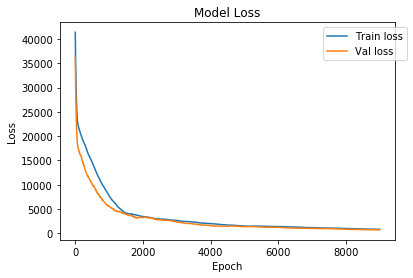

In [27]:
#Plot Model Loss

w = 1000
h1 = np.array(history.history['loss'])
h4 = np.array(history.history['val_loss'])
h1 = moving_average(h1,w)
h4 = moving_average(h4,w)
plt.plot(h1,label='Train loss')
plt.plot(h4,label='Val loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

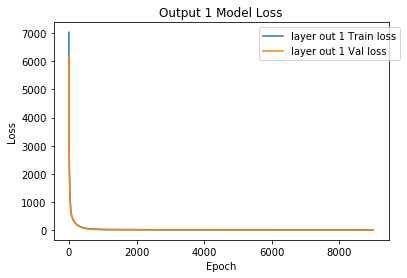

In [28]:
#Plot output 1 loss

h2 = np.array(history.history['out1_loss'])
h5 = np.array(history.history['val_out1_loss'])
h2 = moving_average(h2,w)
h5 = moving_average(h5,w)
plt.plot(h2,label='layer out 1 Train loss')
plt.plot(h5,label='layer out 1 Val loss')
plt.title('Output 1 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

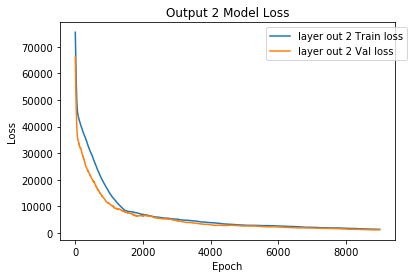

In [29]:
#Plot output 2 loss

h3 = np.array(history.history['out2_loss'])
h6 = np.array(history.history['val_out2_loss'])
h3 = moving_average(h3,w)
h6 = moving_average(h6,w)
plt.plot(h3,label='layer out 2 Train loss')
plt.plot(h6,label='layer out 2 Val loss')
plt.title('Output 2 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

In [30]:
#visualize graph

#%tensorboard --logdir logs
#if issue delete log in C:\Users\Asus\AppData\Local\Temp\.tensor_board

In [31]:
#load ground truth

ytest2 = np.zeros((34,1))
for i in range(34):
    ytest2[i] =  ytest[i][0]
    
ytest2 =ytest2.reshape(34,)
ytest2

array([1281.14374169, 1281.32653181, 1284.62672364, 1278.5596784 ,
       1285.56178804, 1287.5705688 , 1283.03174049, 1283.8962139 ,
       1281.79804311, 1287.77330332, 1284.95010487, 1301.81705535,
       1308.00094314, 1286.07885277, 1284.72838381, 1302.38640531,
       1298.61565625, 1299.89553296, 1302.39133038, 1289.49921555,
       1302.5239315 , 1290.52317354, 1301.70485758, 1309.75382841,
       1302.73793114, 1313.62069451, 1297.08660638, 1294.75217867,
       1348.39593271, 1305.75010933, 1305.40336415, 1290.89362893,
       1293.24594158, 1308.27575113])

In [32]:
#Load ground truth sequence

fleet_Rul_File = "ytestT.csv"
fleet_RUL = pd.read_csv(fleet_Rul_File, skiprows = 0,header = None)
#fleet_RUL = fleet_RUL*(thrmax-thrmin) + thrmin
fleet_RUL_np = np.zeros((34,24))
for i in range(34):
    for j in range(24):
        fleet_RUL_np[i][j] = fleet_RUL[i][j]

fleet_RUL_np.shape

(34, 24)

In [33]:
#Prediction

#Make 100 predictions and calculate average RMSE

import sklearn
import math
from sklearn import metrics

rmse = np.zeros(100)
rmse1 = np.zeros(100)

for i in range(100):
    
    preds = model(x_test)
    tens_draw = preds[0].sample(1000)
    tens_draw1 = preds[1].sample(1000)
    tens_draw = tf.keras.backend.get_value(tens_draw)
    tens_draw1 = tf.keras.backend.get_value(tens_draw1)

    #RMSE with AU

    #Predicted RUL for each Fleet
    mean_Fleet_All = np.zeros((tens_draw.shape[1],tens_draw.shape[2]))
    mean_Fleet = np.zeros(tens_draw.shape[0])
    for s in range(tens_draw.shape[2]):
        for y in range(tens_draw.shape[1]):
            for x in range(tens_draw.shape[0]):
                mean_Fleet[x] = tens_draw[x,y,s]
            mean_Fleet_All[y][s] = mean_Fleet.mean()

    RUL_mse = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All)
    RUL_rmse = math.sqrt(RUL_mse)
    rmse[i] = RUL_rmse

    mean_Fleet_All1 = np.zeros((tens_draw1.shape[1],tens_draw1.shape[2]))
    mean_Fleet1 = np.zeros(tens_draw1.shape[0])
    for s in range(tens_draw1.shape[2]):
        for y in range(tens_draw1.shape[1]):
            for x in range(tens_draw1.shape[0]):
                mean_Fleet1[x] = tens_draw1[x,y,s]
            mean_Fleet_All1[y] = mean_Fleet1.mean()

    RUL_mse1 = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All1)
    RUL_rmse1 = math.sqrt(RUL_mse1)
    rmse1[i] = RUL_rmse1

#Average RMSE with AU & EU

np.mean(rmse),np.mean(rmse1)

(11.097700667343329, 92.15385962649025)

In [34]:
#Calculate Mean & Std of prediction with AU

pad = 24
fleet_NUM = np.arange(0,pad,1)

Fleet = pd.DataFrame(np.zeros((pad,tens_draw.shape[0])))
mean = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
std = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
for z in range(tens_draw.shape[1]):
    for y in range(tens_draw.shape[0]):
        for x in range(pad):
            Fleet[y][x] = tens_draw[y,z,x]
    row_Mean = Fleet.mean(axis=1)
    row_Std = Fleet.std(axis=1)
    for j in range(pad):
        mean[z][j] = row_Mean[j]
    for k in range(pad):
        std[z][k] = row_Std[k]

In [35]:
#Calculate Mean & Std of prediction with EU

Fleet1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[0])))
meaP4 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
std1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
for z in range(tens_draw1.shape[1]):
    for y in range(tens_draw1.shape[0]):
        for x in range(pad):
            Fleet1[y][x] = tens_draw1[y,z,x]
    row_Mean = Fleet1.mean(axis=1)
    row_Std = Fleet1.std(axis=1)
    for j in range(pad):
        meaP4[z][j] = row_Mean[j]
    for k in range(pad):
        std1[z][k] = row_Std[k]

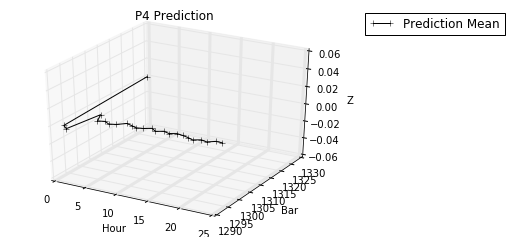

In [36]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("P4 Prediction")
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
#ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
#ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.tiff',bbox_inches='tight')
plt.show()

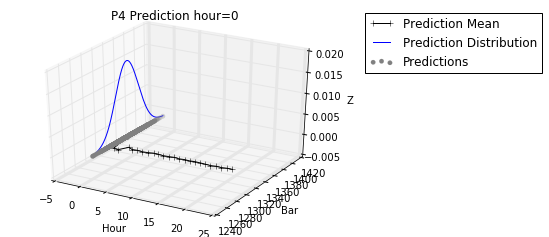

In [37]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 0

ax.set_title("P4 Prediction hour=%i" % i)
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_2.tiff',bbox_inches='tight')
plt.show()

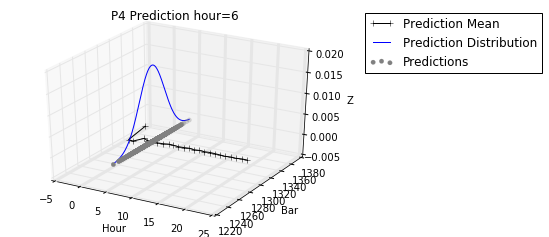

In [38]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 5

ax.set_title("P4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_3.tiff',bbox_inches='tight')
plt.show()

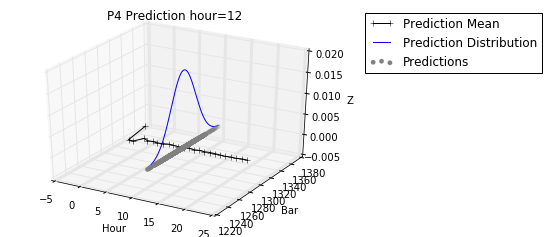

In [39]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 11

ax.set_title("P4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_4.tiff',bbox_inches='tight')
plt.show()

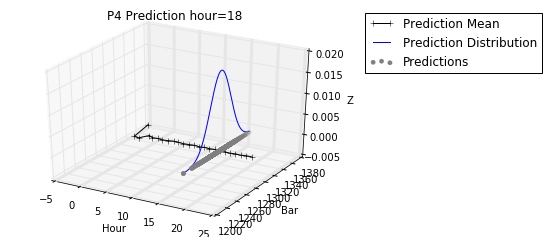

In [40]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("P4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_5.tiff',bbox_inches='tight')
plt.show()

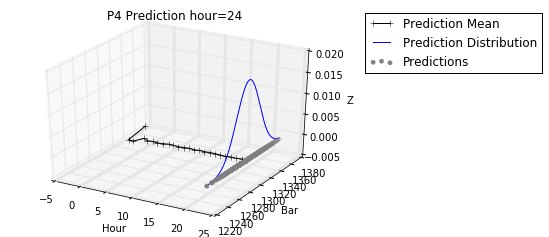

In [41]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 23

ax.set_title("P4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_6.tiff',bbox_inches='tight')
plt.show()

In [42]:
#Load date of prediction

date = "date.csv"
date = pd.read_csv(date, skiprows = 0,header = None)
date = date.to_numpy()

In [43]:
#Load hour of prediction

hour_NUM = ['8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am']

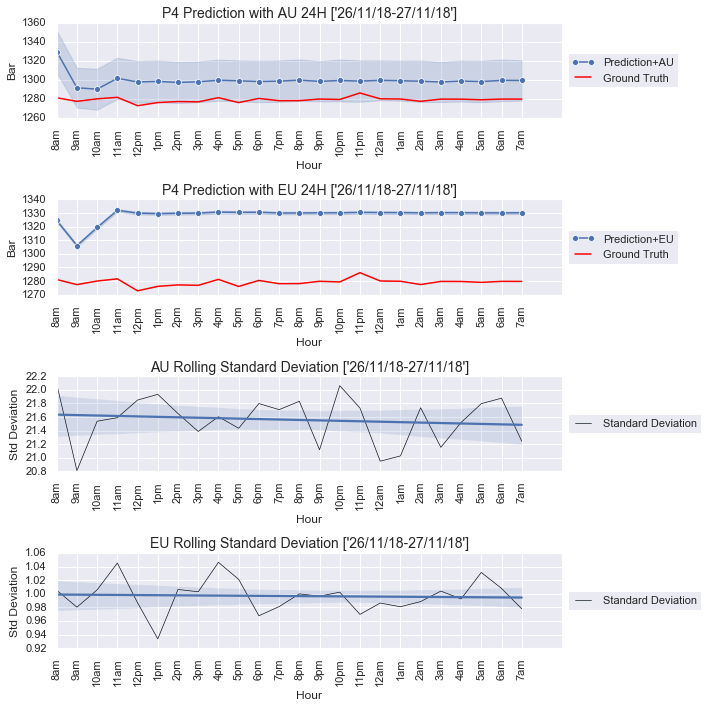

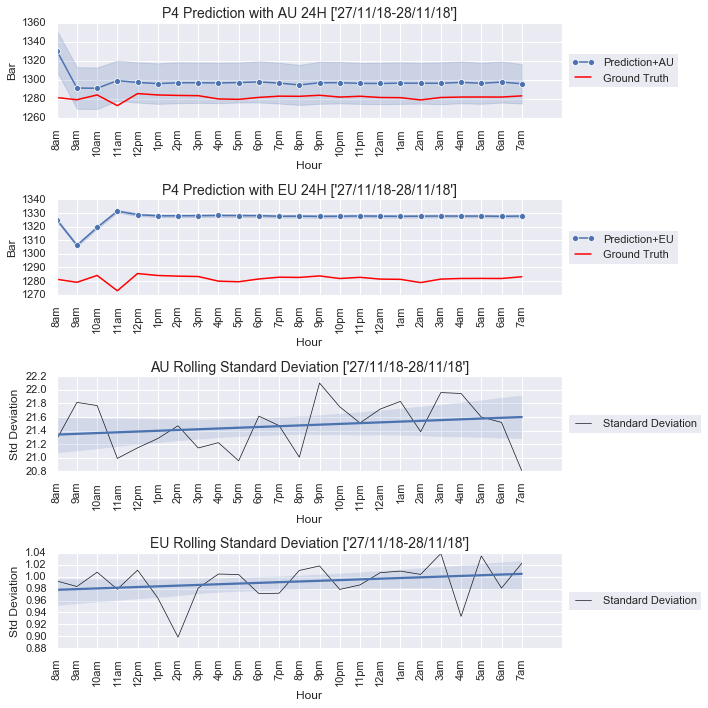

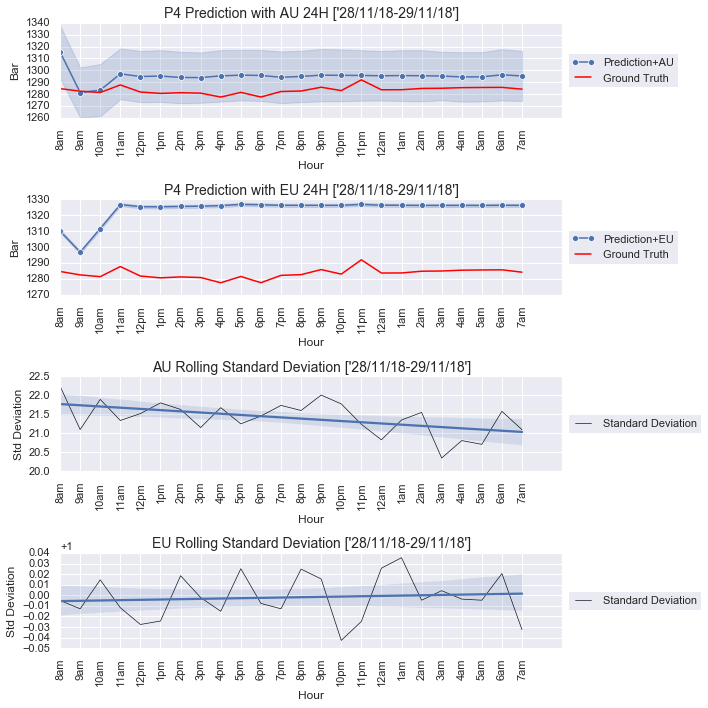

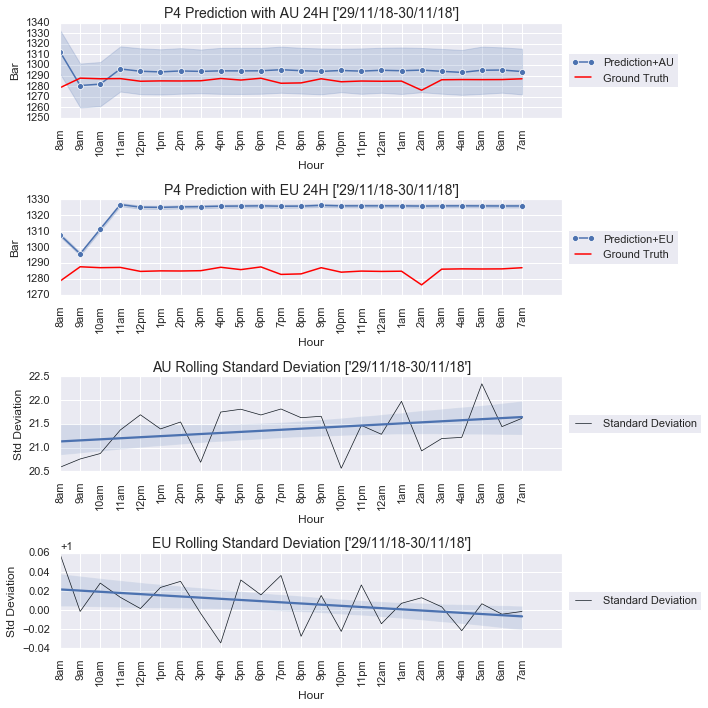

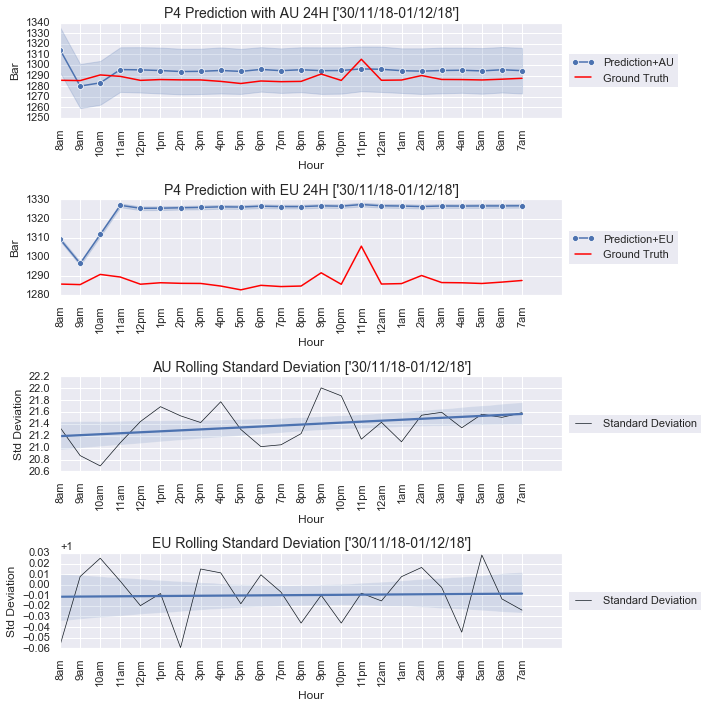

...

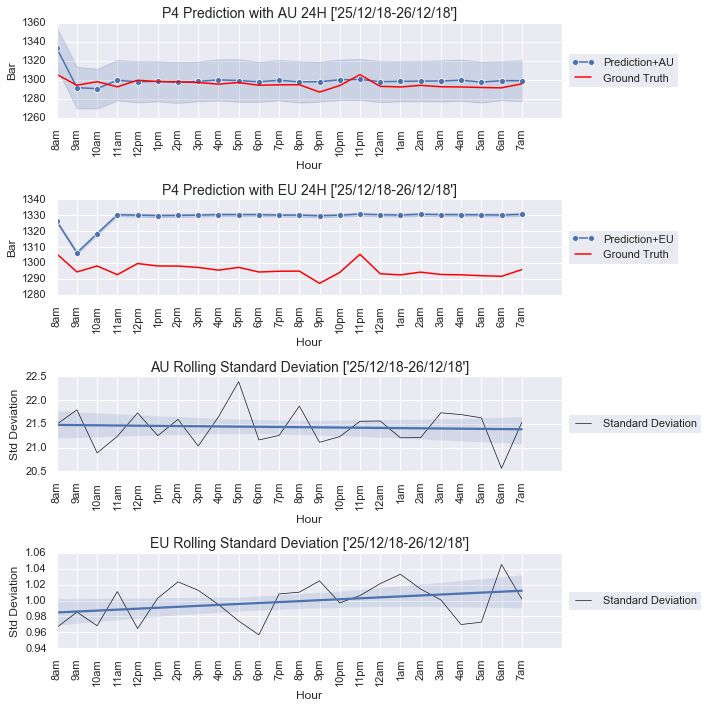

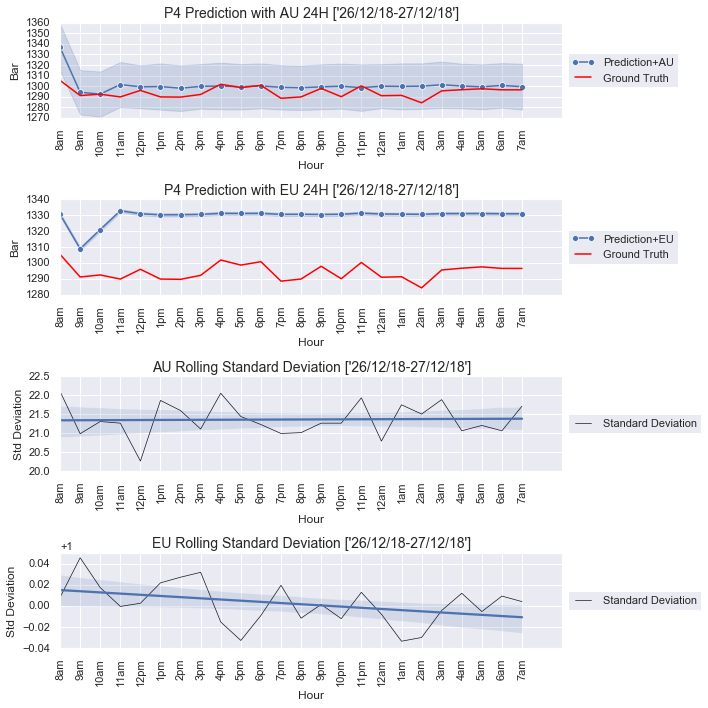

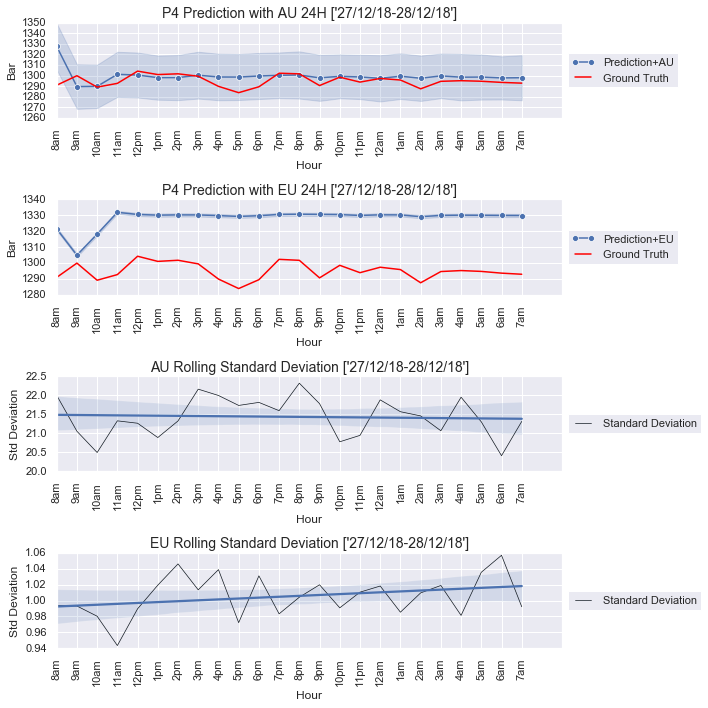

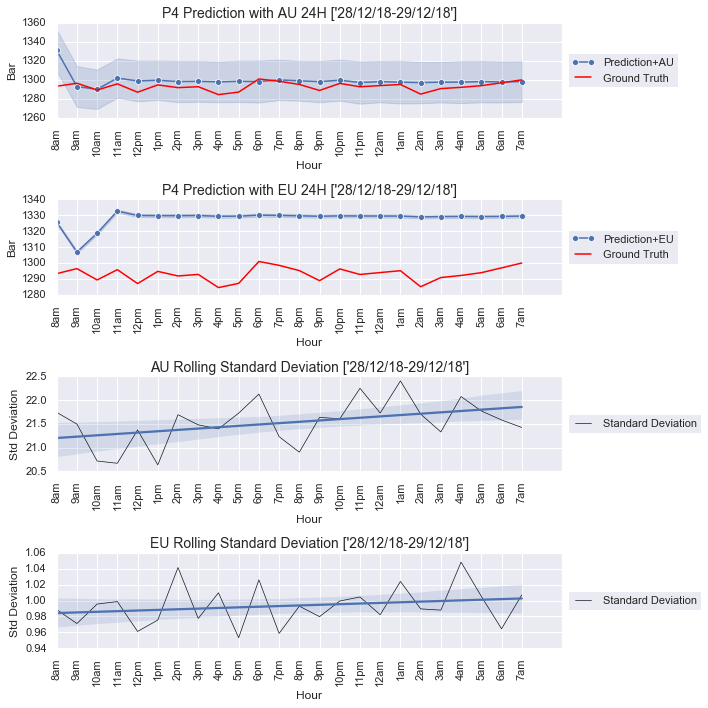

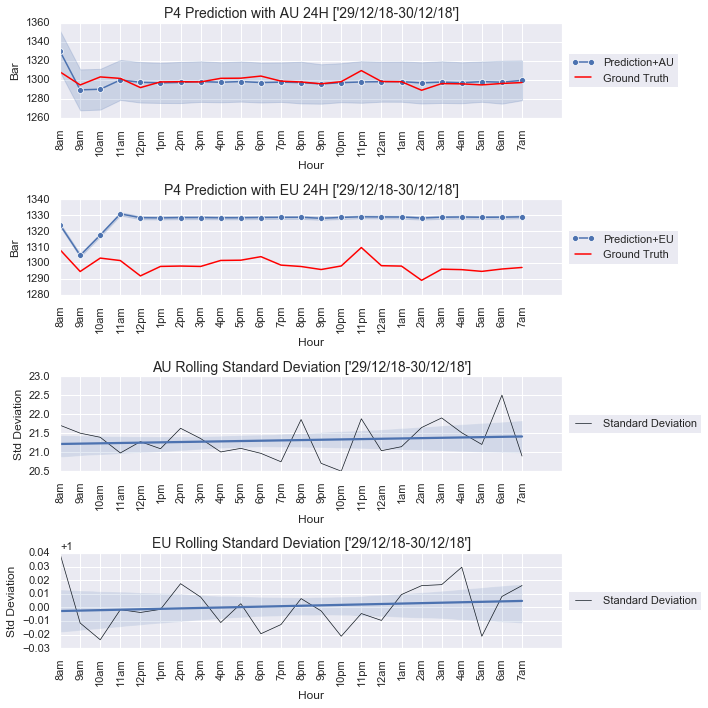

In [44]:
#Prediction Visualization

import seaborn as sns
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes 
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from scipy import stats
sns.set()
for B in range(34):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Bar']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Hour','Bar']
    
    max_Seq_Arrange1.columns = ['Hour','Bar']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Hour','Bar']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Hour','Bar']
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'])
    gs = gridspec.GridSpec(4,1)
    fig = plt.figure(figsize=(10,10))
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="Prediction+AU")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('P4 Prediction with AU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[1])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="Prediction+EU")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('P4 Prediction with EU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    

    ax = fig.add_subplot(gs[2])
    ax.plot('Hour', 'Bar', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'],scatter = False)
    plt.title('AU Rolling Standard Deviation ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[3])
    ax.plot('Hour', 'Bar', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Hour'],med_Std_Arrange['Bar'],scatter = False)
    plt.title('EU Rolling Standard Deviation ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

In [45]:
#SHAP cannot be used with model with probabilistic layers. So, define non probabilistic f'x

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 292)           346896    
_________________________________________________________________
dense_2 (Dense)              (None, 24, 495)           145035    
_________________________________________________________________
dense_3 (Dense)              (None, 24, 1)             496       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 492,427
Trainable params: 492,427
Non-trainable params: 0
_________________________________________________________________


In [46]:
#Extract only "Mean" weights, exclude "Standard Deviation" weights

a = model.layers[3].get_weights()

b = np.zeros((len(a[0]),1))
for x in range(len(a[0])):
    b[x] = a[0][x][0]
    
d = np.zeros(1)
for x in range(1):
    d[x] = a[1][x]
    
c = [b,d]

In [47]:
#Transfer weights from fx to f'x

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(c)

In [48]:
#Prediction with f'x

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [49]:
#Import SHAP & initialized JS for f'x explanation

import shap
shap.initjs()

In [50]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [51]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

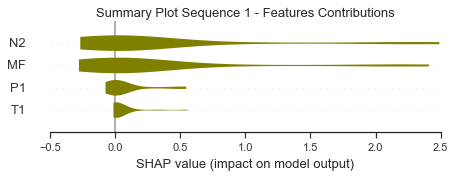

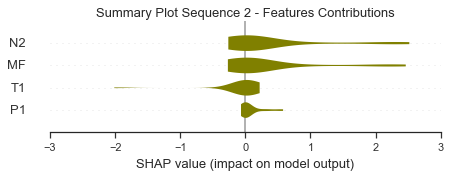

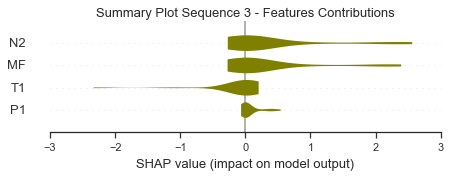

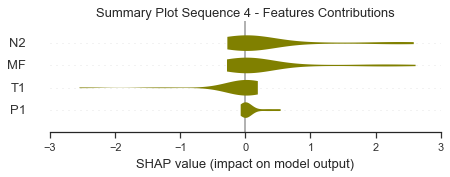

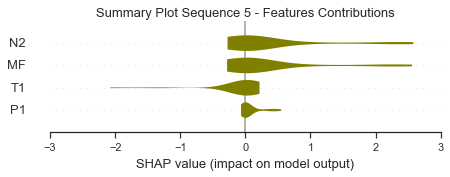

...

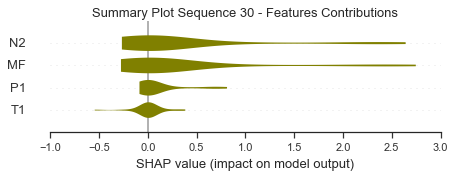

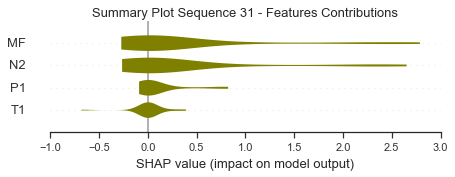

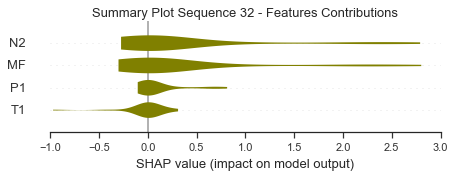

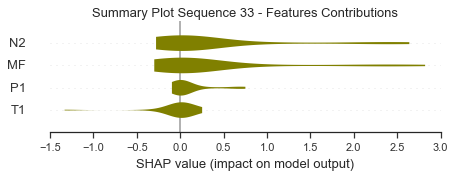

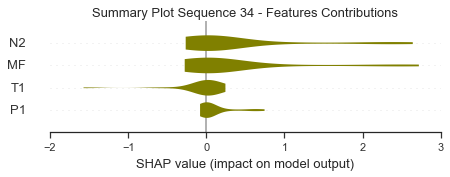

In [52]:
#SHAP Summmary Plot

sns.set_style('ticks')
instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="violin", color='olive')
    plt.title("Summary Plot Sequence %i - Features Contributions" %(i+1),fontsize=13)
    plt.figure
    plt.show()

In [53]:
#SHAP Force Plot - Matplotlib

import seaborn as sns
sns.set_style("ticks")
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    # Per individual array 
    for j in range(24):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,4),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


3 1


3 2


3 3


3 4


3 5


3 6


3 7


3 8


3 9


3 10


3 11


3 12


3 13


3 14


3 15


3 16


3 17


3 18


3 19


3 20


3 21


3 22


3 23


3 24


4 1


4 2


4 3


4 4


4 5


4 6


4 7


4 8


4 9


4 10


4 11


4 12


4 13


4 14


4 15


4 16


4 17


4 18


4 19


4 20


4 21


4 22


4 23


4 24


5 1


5 2


5 3


5 4


5 5


5 6


5 7


5 8


5 9


5 10


5 11


5 12


5 13


5 14


5 15


5 16


5 17


5 18


5 19


5 20


5 21


5 22


5 23


5 24


6 1


6 2


6 3


6 4


6 5


6 6


6 7


6 8


6 9


6 10


6 11


6 12


6 13


6 14


6 15


6 16


6 17


6 18


6 19


6 20


6 21


6 22


6 23


6 24


7 1


7 2


7 3


7 4


7 5


7 6


7 7


7 8


7 9


7 10


7 11


7 12


7 13


7 14


7 15


7 16


7 17


7 18


7 19


7 20


7 21


7 22


7 23


7 24


8 1


8 2


8 3


8 4


8 5


8 6


8 7


8 8


8 9


8 10


8 11


8 12


8 13


8 14


8 15


8 16


8 17


8 18


8 19


8 20


8 21


8 22


8 23


8 24


9 1


9 2


9 3


9 4


9 5


9 6


9 7


9 8


9 9


9 10


9 11


9 12


9 13


9 14


9 15


9 16


9 17


9 18


9 19


9 20


9 21


9 22


9 23


9 24


10 1


10 2


10 3


10 4


10 5


10 6


10 7


10 8


10 9


10 10


10 11


10 12


10 13


10 14


10 15


10 16


10 17


10 18


10 19


10 20


10 21


10 22


10 23


10 24


11 1


11 2


11 3


11 4


11 5


11 6


11 7


11 8


11 9


11 10


11 11


11 12


11 13


11 14


11 15


11 16


11 17


11 18


11 19


11 20


11 21


11 22


11 23


11 24


12 1


12 2


12 3


12 4


12 5


12 6


12 7


12 8


12 9


12 10


12 11


12 12


12 13


12 14


12 15


12 16


12 17


12 18


12 19


12 20


12 21


12 22


12 23


12 24


13 1


13 2


13 3


13 4


13 5


13 6


13 7


13 8


13 9


13 10


13 11


13 12


13 13


13 14


13 15


13 16


13 17


13 18


13 19


13 20


13 21


13 22


13 23


13 24


14 1


14 2


14 3


14 4


14 5


14 6


14 7


14 8


14 9


14 10


14 11


14 12


14 13


14 14


14 15


14 16


14 17


14 18


14 19


14 20


14 21


14 22


14 23


14 24


15 1


15 2


15 3


15 4


15 5


15 6


15 7


15 8


15 9


15 10


15 11


15 12


15 13


15 14


15 15


15 16


15 17


15 18


15 19


15 20


15 21


15 22


15 23


15 24


16 1


16 2


16 3


16 4


16 5


16 6


16 7


16 8


16 9


16 10


16 11


16 12


16 13


16 14


16 15


16 16


16 17


16 18


16 19


16 20


16 21


16 22


16 23


16 24


17 1


17 2


17 3


17 4


17 5


17 6


17 7


17 8


17 9


17 10


17 11


17 12


17 13


17 14


17 15


17 16


17 17


17 18


17 19


17 20


17 21


17 22


17 23


17 24


18 1


18 2


18 3


18 4


18 5


18 6


18 7


18 8


18 9


18 10


18 11


18 12


18 13


18 14


18 15


18 16


18 17


18 18


18 19


18 20


18 21


18 22


18 23


18 24


19 1


19 2


19 3


19 4


19 5


19 6


19 7


19 8


19 9


19 10


19 11


19 12


19 13


19 14


19 15


19 16


19 17


19 18


19 19


19 20


19 21


19 22


19 23


19 24


20 1


20 2


20 3


20 4


20 5


20 6


20 7


20 8


20 9


20 10


20 11


20 12


20 13


20 14


20 15


20 16


20 17


20 18


20 19


20 20


20 21


20 22


20 23


20 24


21 1


21 2


21 3


21 4


21 5


21 6


21 7


21 8


21 9


21 10


21 11


21 12


21 13


21 14


21 15


21 16


21 17


21 18


21 19


21 20


21 21


21 22


21 23


21 24


22 1


22 2


22 3


22 4


22 5


22 6


22 7


22 8


22 9


22 10


22 11


22 12


22 13


22 14


22 15


22 16


22 17


22 18


22 19


22 20


22 21


22 22


22 23


22 24


23 1


23 2


23 3


23 4


23 5


23 6


23 7


23 8


23 9


23 10


23 11


23 12


23 13


23 14


23 15


23 16


23 17


23 18


23 19


23 20


23 21


23 22


23 23


23 24


24 1


24 2


24 3


24 4


24 5


24 6


24 7


24 8


24 9


24 10


24 11


24 12


24 13


24 14


24 15


24 16


24 17


24 18


24 19


24 20


24 21


24 22


24 23


24 24


25 1


25 2


25 3


25 4


25 5


25 6


25 7


25 8


25 9


25 10


25 11


25 12


25 13


25 14


25 15


25 16


25 17


25 18


25 19


25 20


25 21


25 22


25 23


25 24


26 1


26 2


26 3


26 4


26 5


26 6


26 7


26 8


26 9


26 10


26 11


26 12


26 13


26 14


26 15


26 16


26 17


26 18


26 19


26 20


26 21


26 22


26 23


26 24


27 1


27 2


27 3


27 4


27 5


27 6


27 7


27 8


27 9


27 10


27 11


27 12


27 13


27 14


27 15


27 16


27 17


27 18


27 19


27 20


27 21


27 22


27 23


27 24


28 1


28 2


28 3


28 4


28 5


28 6


28 7


28 8


28 9


28 10


28 11


28 12


28 13


28 14


28 15


28 16


28 17


28 18


28 19


28 20


28 21


28 22


28 23


28 24


29 1


29 2


29 3


29 4


29 5


29 6


29 7


29 8


29 9


29 10


29 11


29 12


29 13


29 14


29 15


29 16


29 17


29 18


29 19


29 20


29 21


29 22


29 23


29 24


30 1


30 2


30 3


30 4


30 5


30 6


30 7


30 8


30 9


30 10


30 11


30 12


30 13


30 14


30 15


30 16


30 17


30 18


30 19


30 20


30 21


30 22


30 23


30 24


31 1


31 2


31 3


31 4


31 5


31 6


31 7


31 8


31 9


31 10


31 11


31 12


31 13


31 14


31 15


31 16


31 17


31 18


31 19


31 20


31 21


31 22


31 23


31 24


32 1


32 2


32 3


32 4


32 5


32 6


32 7


32 8


32 9


32 10


32 11


32 12


32 13


32 14


32 15


32 16


32 17


32 18


32 19


32 20


32 21


32 22


32 23


32 24


33 1


33 2


33 3


33 4


33 5


33 6


33 7


33 8


33 9


33 10


33 11


33 12


33 13


33 14


33 15


33 16


33 17


33 18


33 19


33 20


33 21


33 22


33 23


33 24


34 1


34 2


34 3


34 4


34 5


34 6


34 7


34 8


34 9


34 10


34 11


34 12


34 13


34 14


34 15


34 16


34 17


34 18


34 19


34 20


34 21


34 22


34 23


34 24


Contribution: [0.54255721 0.03335118 2.35015002 2.23367702]


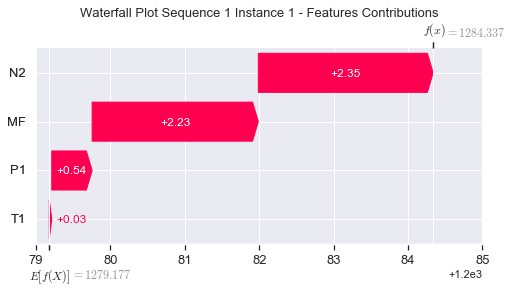

None

Contribution: [-0.07388869 -0.01304798 -0.26788085 -0.27838365]


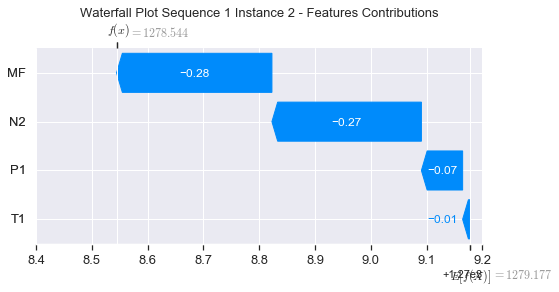

None

Contribution: [0.00104611 0.00098399 0.00369541 0.00353022]


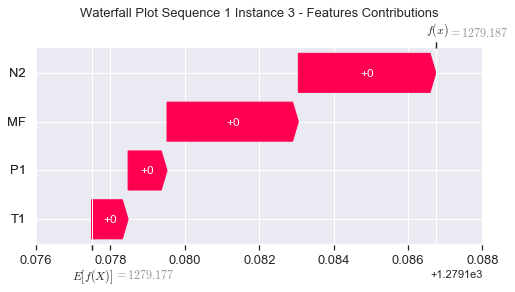

None

Contribution: [0.0015312  0.0014877  0.00511179 0.00482307]


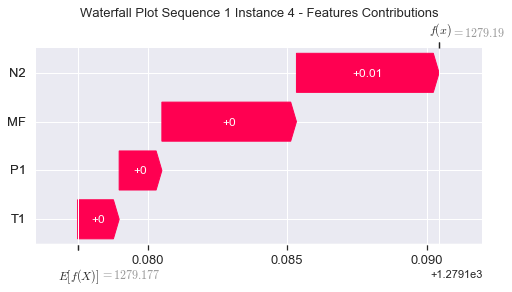

None

Contribution: [0.00170134 0.00172529 0.00561124 0.00521284]


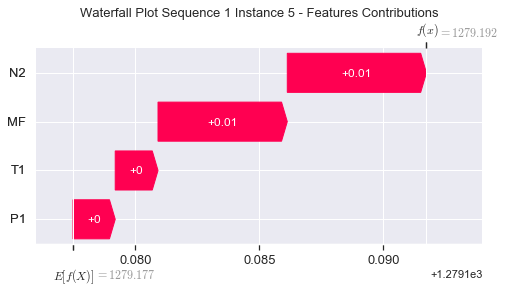

None

Contribution: [0.0018864  0.00186848 0.00615435 0.00571742]


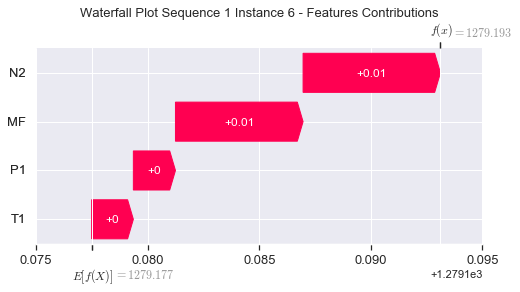

None

Contribution: [0.00202369 0.00201833 0.00662033 0.00616013]


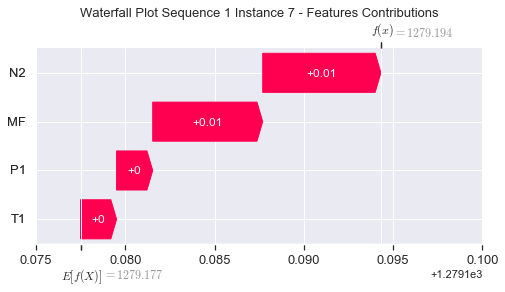

None

Contribution: [0.00207239 0.00205959 0.00675905 0.00629241]


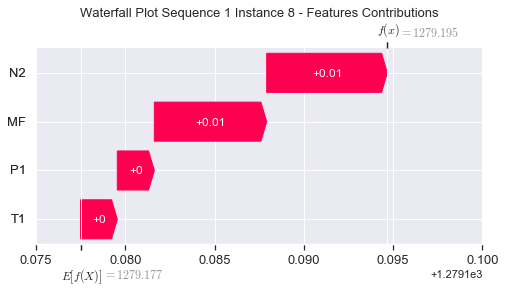

None

Contribution: [0.00207134 0.00218719 0.00670394 0.00629753]


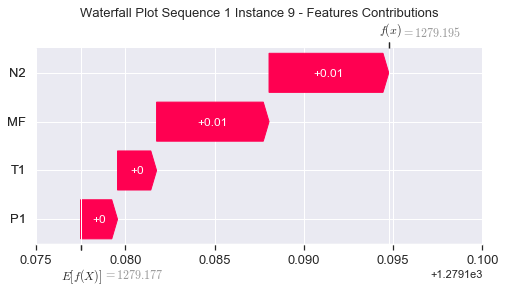

None

Contribution: [0.00202565 0.00207455 0.00660269 0.00620337]


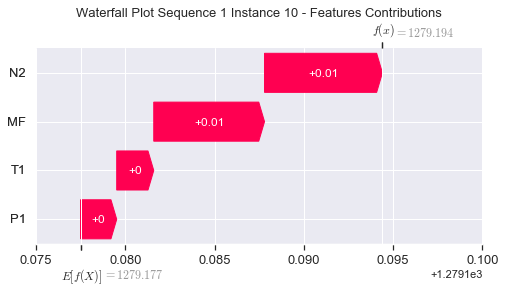

None

Contribution: [0.00203616 0.00205243 0.00654506 0.00612502]


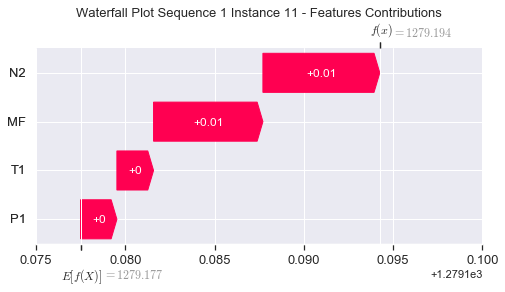

None

Contribution: [0.00196256 0.00193332 0.00645306 0.00602473]


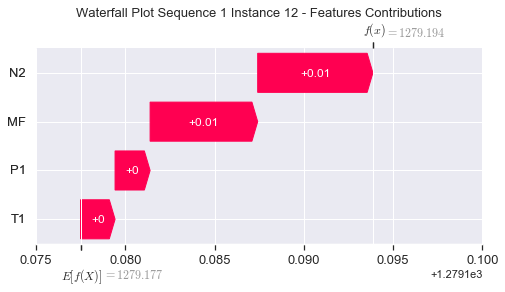

None

Contribution: [0.00193327 0.00192764 0.00636153 0.0059402 ]


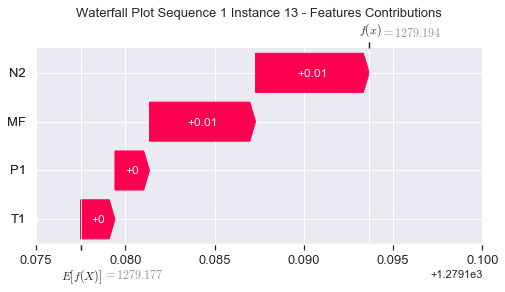

None

Contribution: [0.00189934 0.00183532 0.00606997 0.00565993]


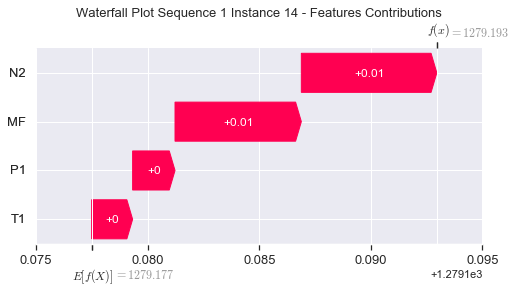

None

Contribution: [0.00165971 0.00165616 0.00542864 0.00508322]


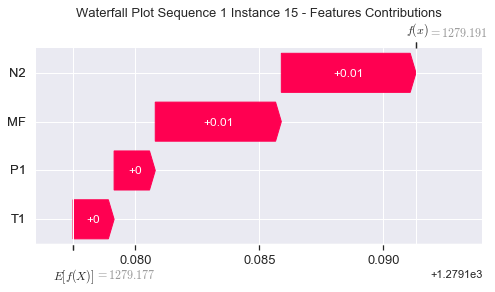

None

Contribution: [0.00131872 0.001362   0.00436516 0.00417322]


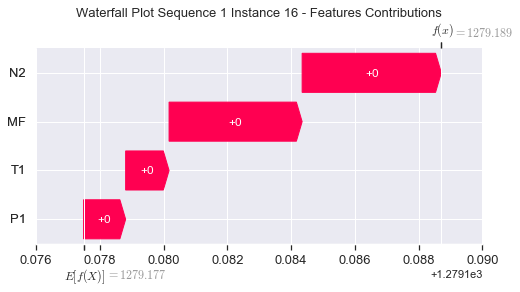

None

Contribution: [0.00122181 0.00133425 0.00405813 0.00379911]


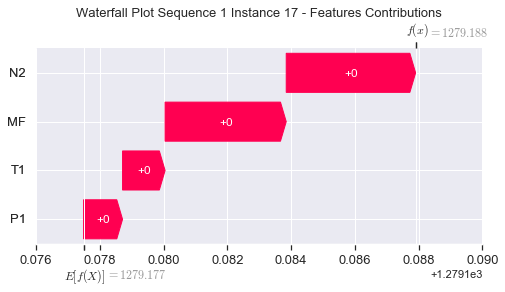

None

Contribution: [0.00310803 0.00345722 0.01053892 0.00967329]


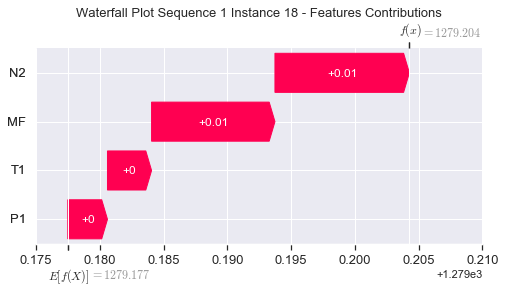

None

Contribution: [0.01273283 0.0140544  0.04392973 0.04025115]


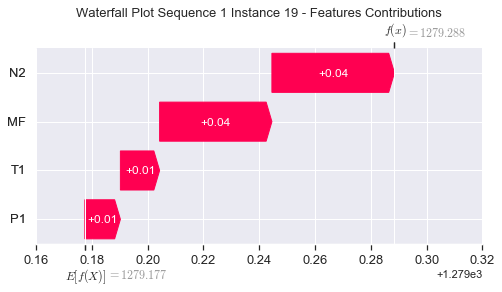

None

Contribution: [0.04631594 0.05039814 0.15696061 0.14329544]


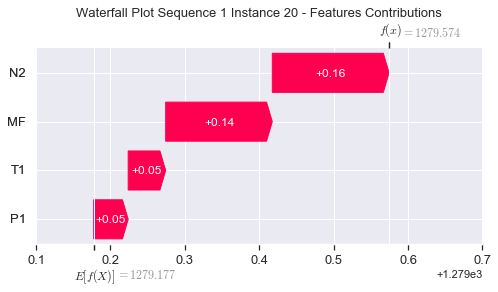

None

Contribution: [0.13526479 0.14598857 0.45884062 0.41936193]


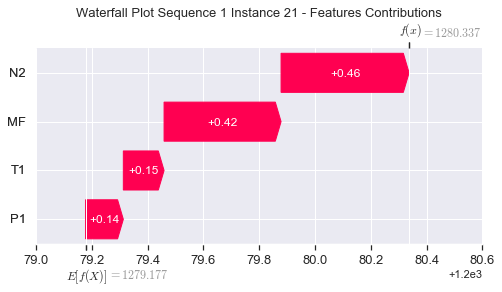

None

Contribution: [0.31991647 0.3416191  1.098432   1.00690255]


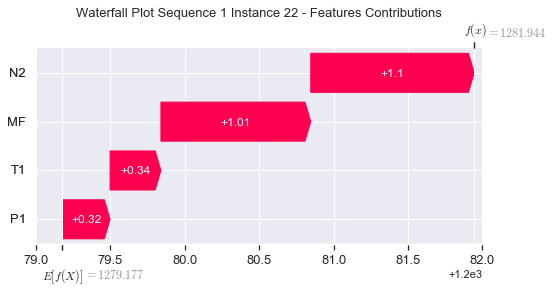

None

Contribution: [0.54586546 0.55629185 2.0570651  1.91225697]


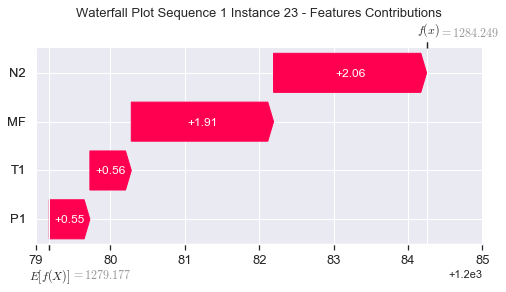

None

Contribution: [0.47706466 0.03658157 2.48995234 2.41089926]


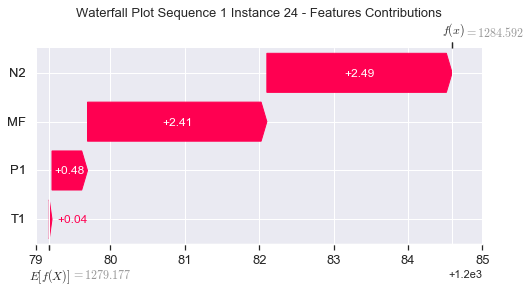

None

Contribution: [0.57938858 0.16436351 2.31172098 2.25229964]


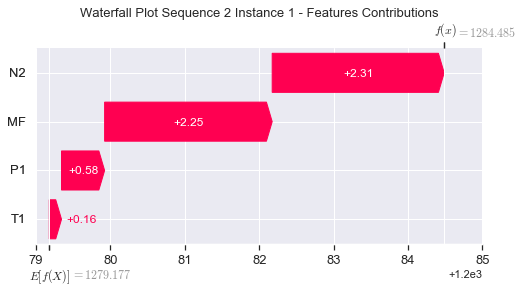

None

Contribution: [-0.06699998 -0.0343489  -0.26173073 -0.26876484]


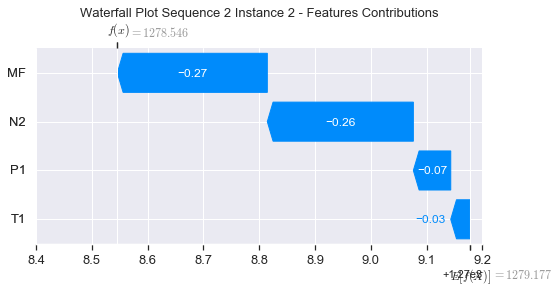

None

Contribution: [0.00106781 0.00100303 0.00376495 0.00365124]


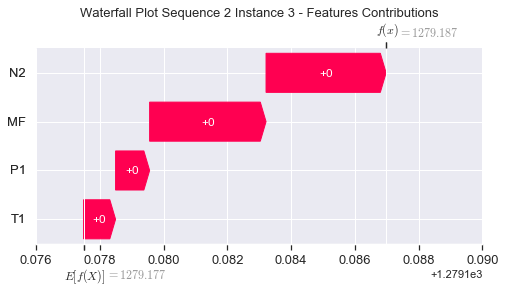

None

Contribution: [0.00154733 0.00153656 0.0052129  0.00484357]


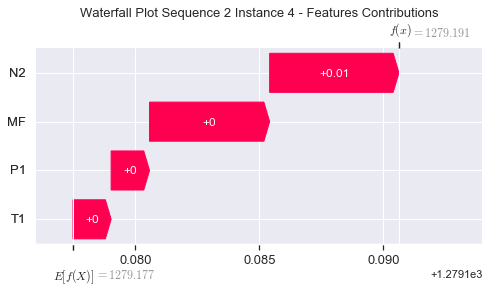

None

Contribution: [0.00173262 0.00142373 0.00577946 0.00545396]


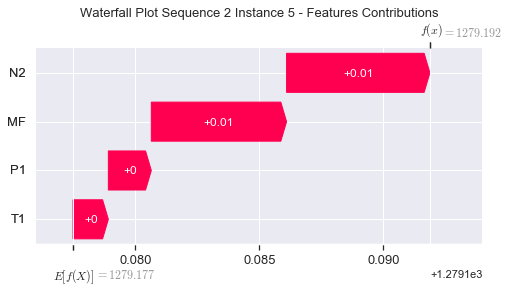

None

Contribution: [0.00190613 0.00149075 0.0063394  0.00593964]


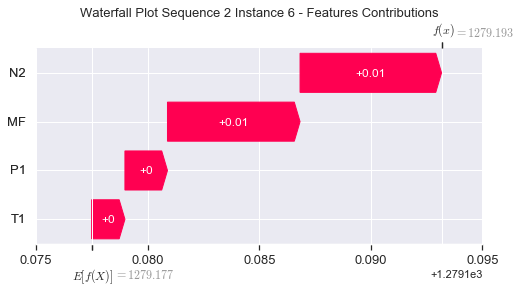

None

Contribution: [0.00205761 0.00158097 0.00683073 0.00638811]


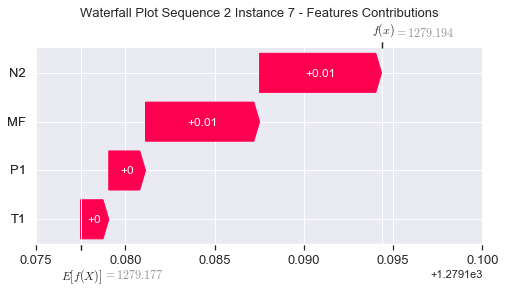

None

Contribution: [0.00210353 0.00161314 0.00698007 0.00653504]


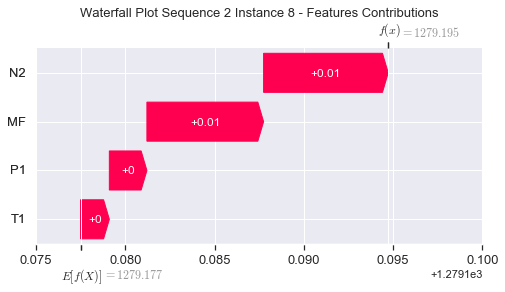

None

Contribution: [0.00210054 0.00155575 0.00695518 0.00649761]


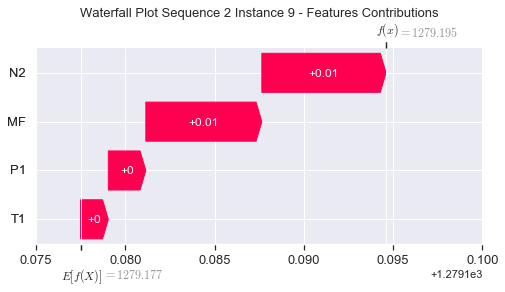

None

Contribution: [0.00206121 0.00151351 0.00686885 0.00641782]


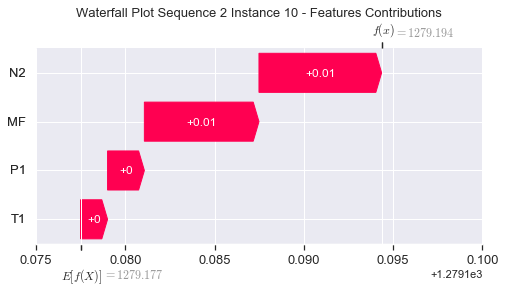

None

Contribution: [0.0020408  0.00149484 0.00677438 0.00632695]


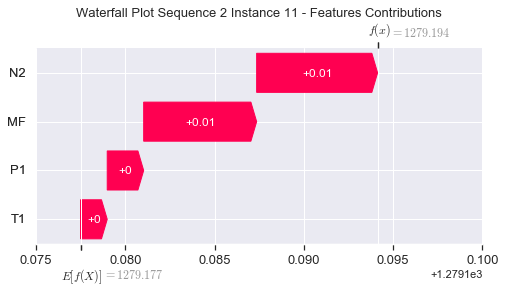

None

Contribution: [0.00200321 0.00140859 0.00666417 0.00620286]


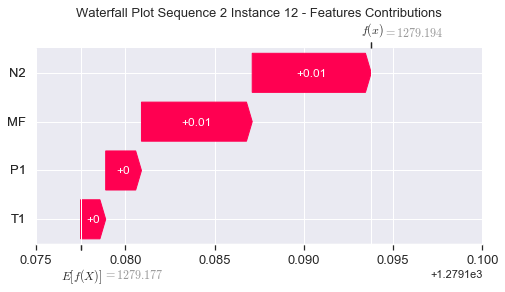

None

Contribution: [0.00197353 0.0013985  0.00656283 0.00611182]


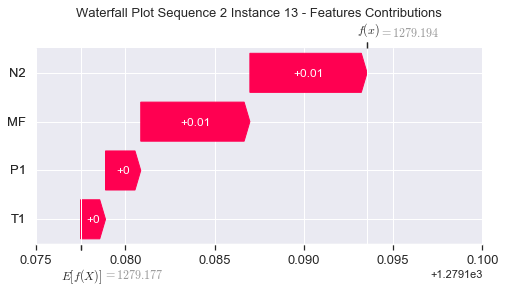

None

Contribution: [0.00188154 0.00128072 0.00623117 0.00580495]


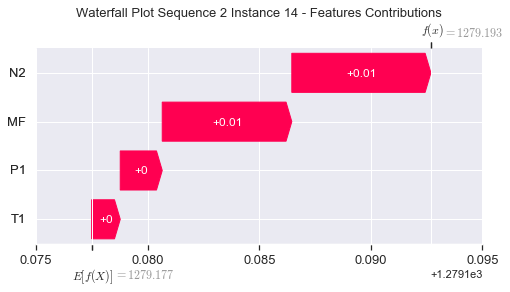

None

Contribution: [0.00166102 0.00115288 0.00552043 0.00515119]


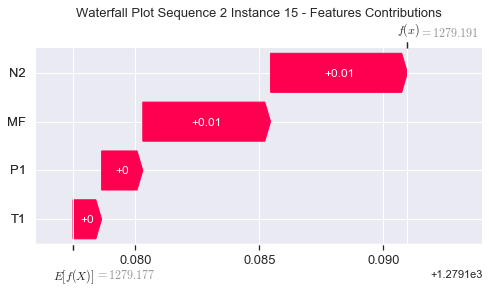

None

Contribution: [0.00130369 0.00091484 0.00439145 0.00413576]


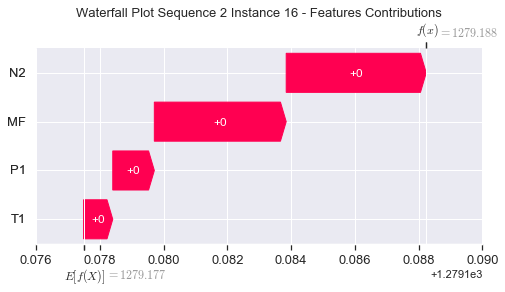

None

Contribution: [0.00124506 0.00087268 0.00421766 0.00392388]


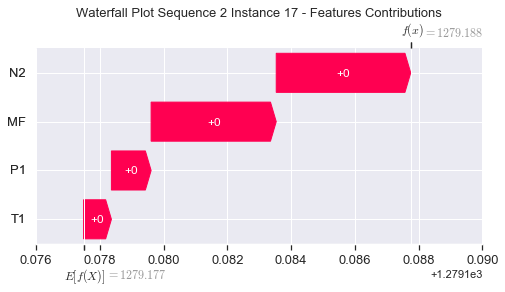

None

Contribution: [0.0033675  0.00261931 0.011617   0.01061656]


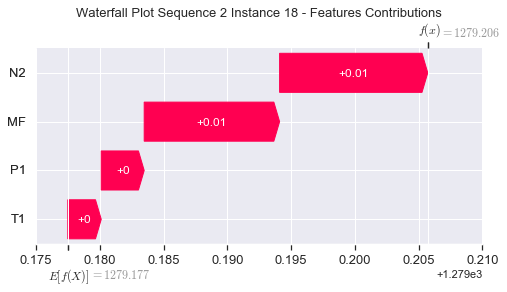

None

Contribution: [0.01399227 0.01128202 0.04799579 0.04362861]


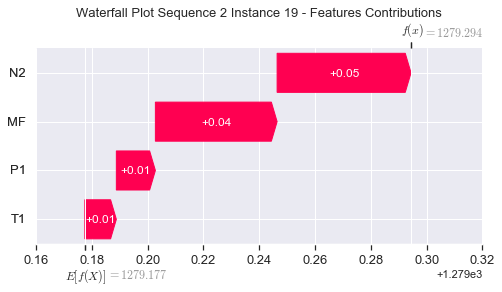

None

Contribution: [0.04916233 0.03907167 0.16855142 0.15376349]


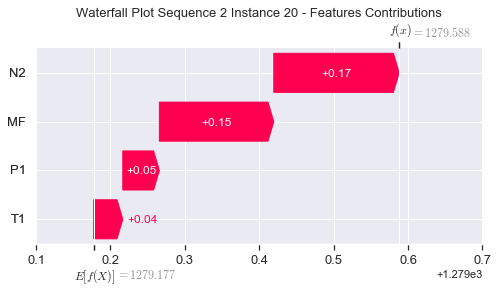

None

Contribution: [0.14101207 0.10804079 0.48435286 0.44240326]


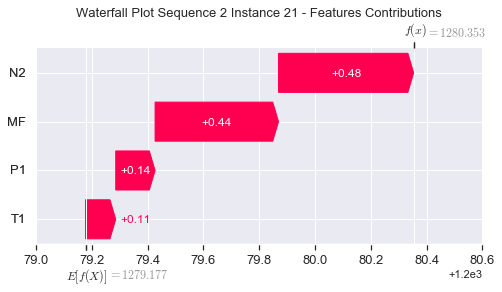

None

Contribution: [0.32662316 0.219168   1.14186835 1.04735178]


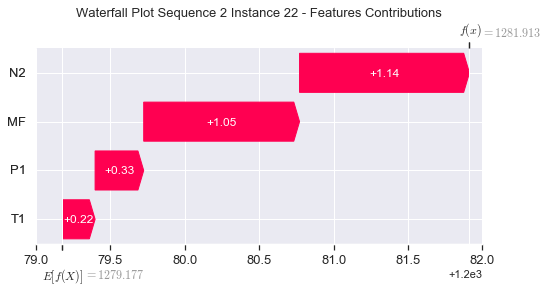

None

Contribution: [0.53135728 0.03832515 2.10914904 1.95955554]


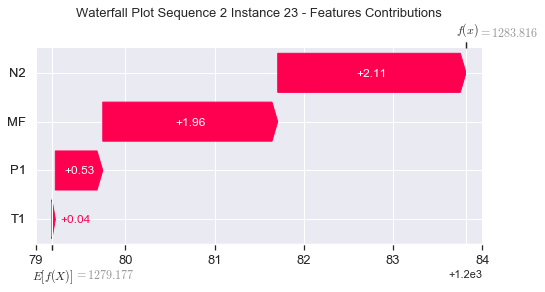

None

Contribution: [ 0.31880874 -2.01400241  2.5184613   2.46340327]


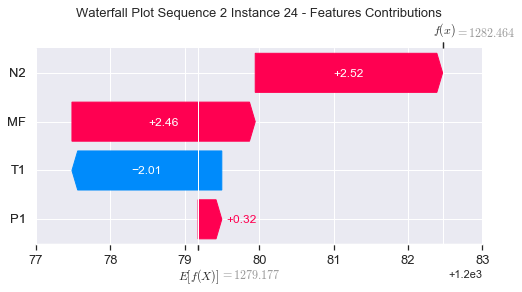

None

Contribution: [ 0.41922986 -1.10701239  2.37560741  2.23193377]


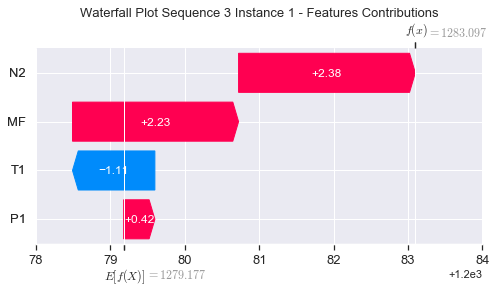

None

Contribution: [-0.06553897  0.10523233 -0.27015473 -0.27348791]


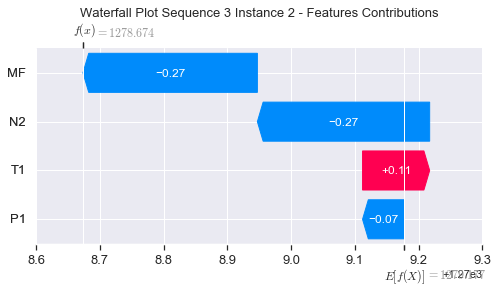

None

Contribution: [0.00104397 0.00055068 0.00380166 0.00362014]


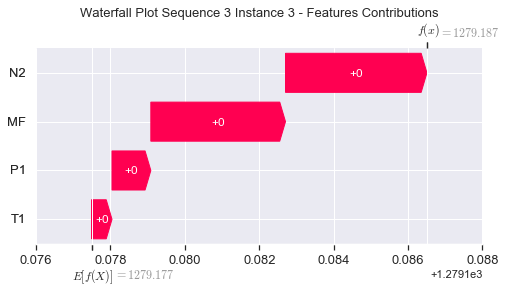

None

Contribution: [0.00157875 0.00093341 0.00528372 0.00495401]


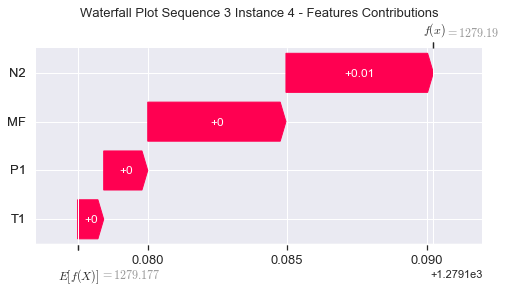

None

Contribution: [0.00174399 0.00114351 0.00581082 0.00539197]


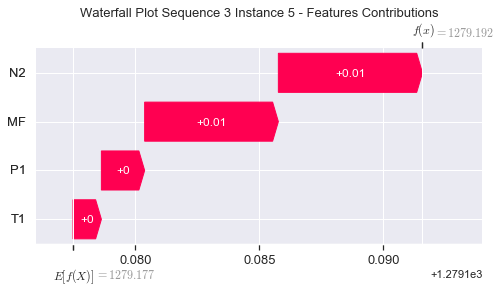

None

Contribution: [0.00191829 0.00132782 0.00638713 0.00591244]


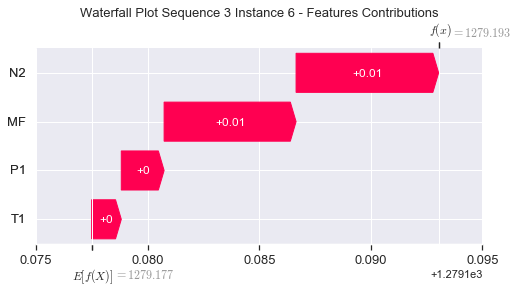

None

Contribution: [0.00206438 0.00143085 0.00687069 0.00635944]


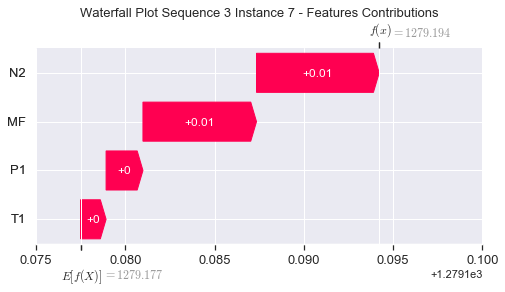

None

Contribution: [0.0021124  0.00146771 0.00701321 0.00649742]


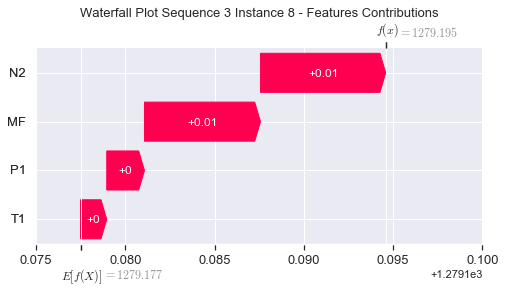

None

Contribution: [0.00208935 0.00154796 0.00695399 0.00641647]


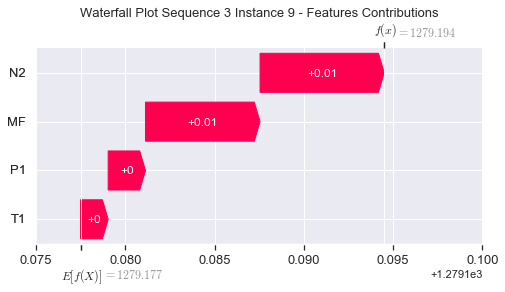

None

Contribution: [0.00208317 0.00164225 0.00688311 0.00640131]


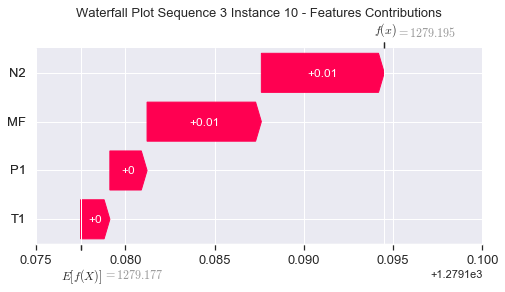

None

Contribution: [0.00206016 0.00153726 0.00680152 0.00628817]


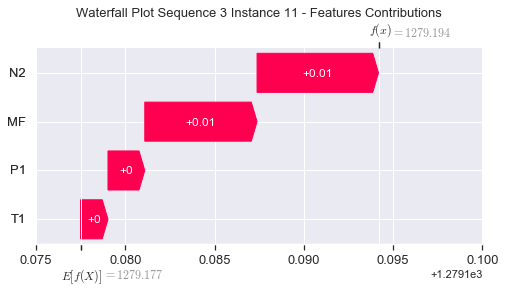

None

Contribution: [0.00203364 0.0013883  0.00670865 0.00622724]


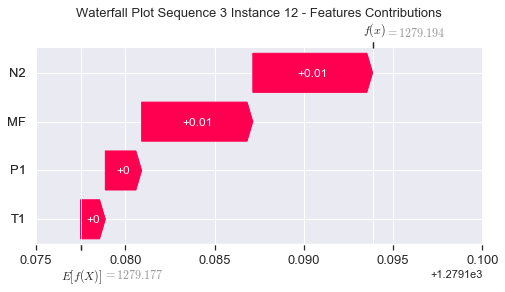

None

Contribution: [0.00199645 0.00135781 0.00659748 0.00612379]


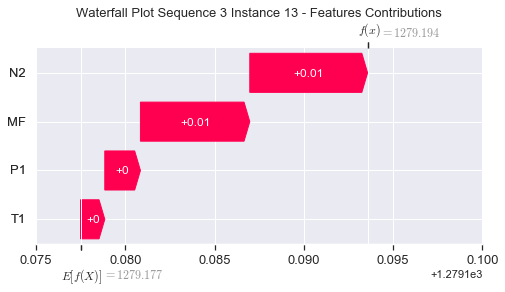

None

Contribution: [0.00185638 0.00132873 0.00626622 0.00581394]


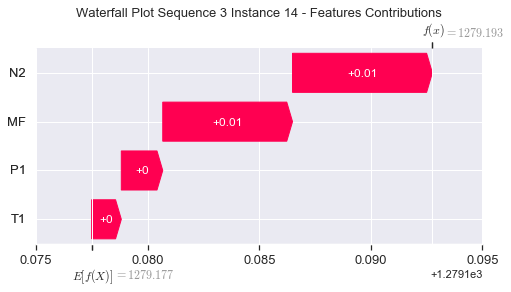

None

Contribution: [0.0016662  0.00111515 0.00552476 0.00514397]


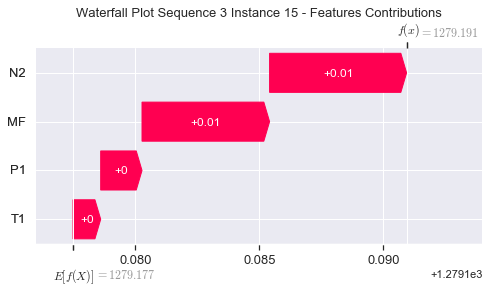

None

Contribution: [0.00133103 0.00088013 0.00436722 0.00415188]


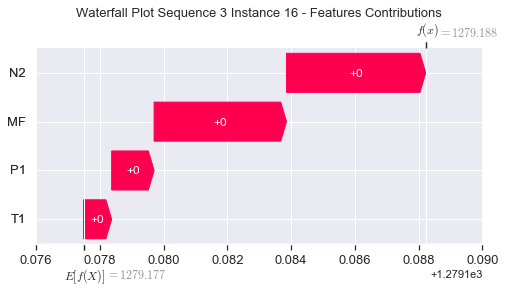

None

Contribution: [0.00121431 0.00082736 0.00411436 0.00382468]


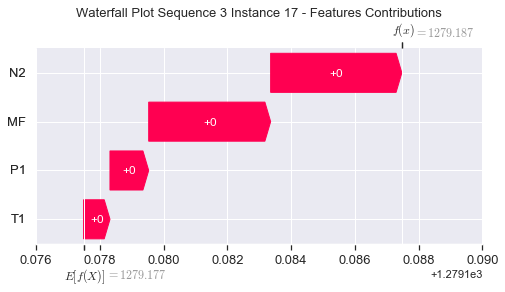

None

Contribution: [0.00334197 0.00256235 0.01152834 0.01052109]


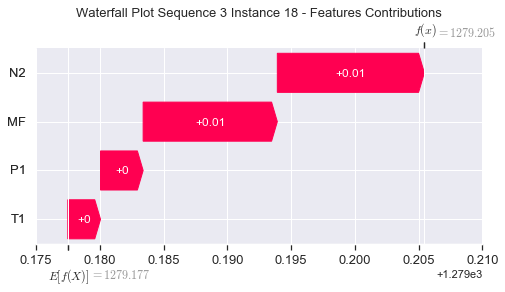

None

Contribution: [0.01420832 0.01067714 0.04836242 0.04393379]


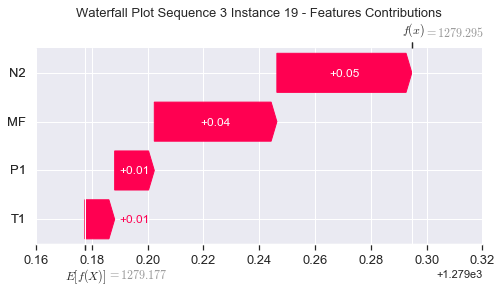

None

Contribution: [0.0495397  0.03781381 0.17006545 0.1547584 ]


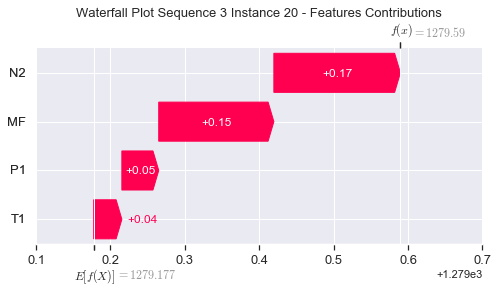

None

Contribution: [0.14232557 0.10425255 0.4886257  0.44537839]


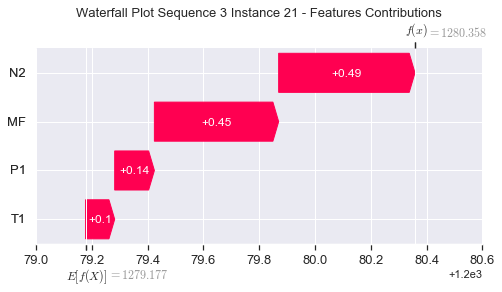

None

Contribution: [0.33027057 0.20397294 1.15122509 1.05361303]


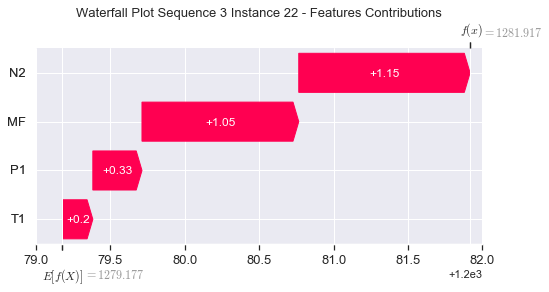

None

Contribution: [5.42869468e-01 6.14587611e-04 2.13185143e+00 1.97728133e+00]


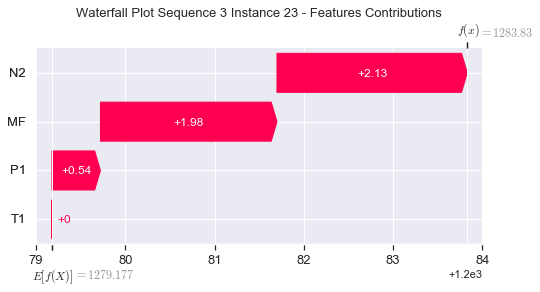

None

Contribution: [ 0.3845756  -2.33036909  2.56268882  2.39339908]


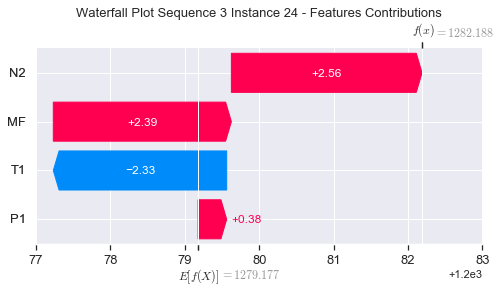

None

Contribution: [ 0.53097053 -1.28278542  2.38561345  2.06249259]


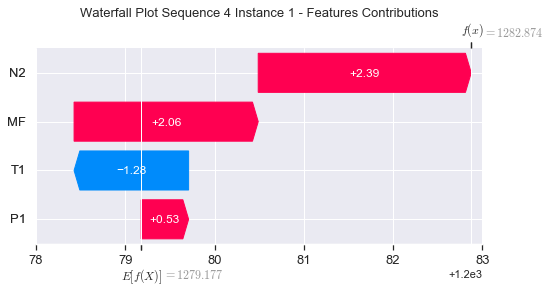

None

Contribution: [-0.07193474  0.1159623  -0.27671486 -0.28239612]


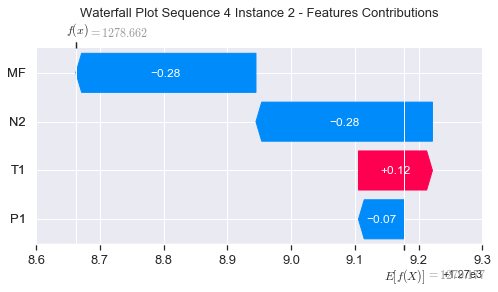

None

Contribution: [0.00102552 0.00056247 0.00380776 0.00364702]


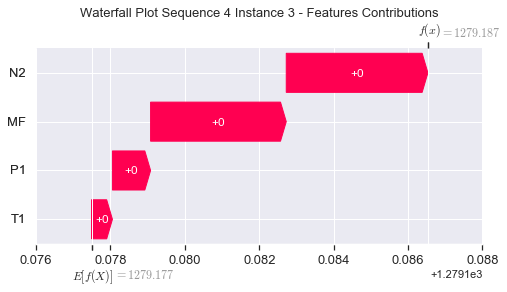

None

Contribution: [0.00159665 0.00098989 0.00529276 0.00495933]


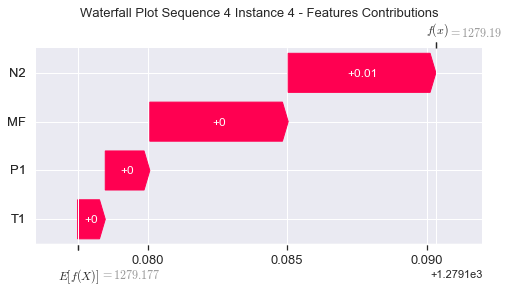

None

Contribution: [0.00175694 0.00109803 0.00582394 0.00542158]


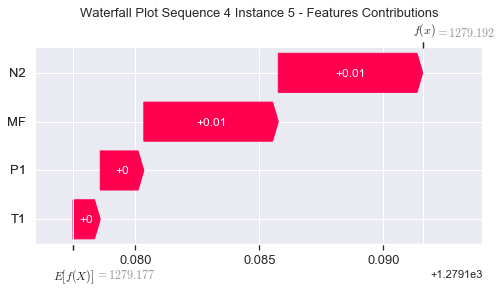

None

Contribution: [0.00194261 0.00122589 0.00640668 0.0059777 ]


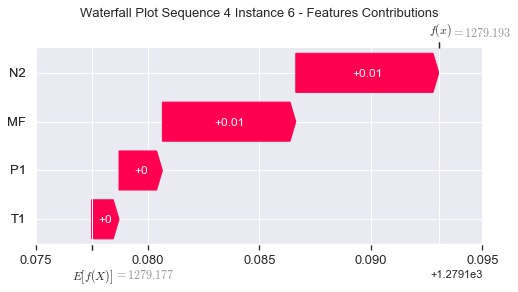

None

Contribution: [0.0020949  0.00133479 0.00689584 0.00642615]


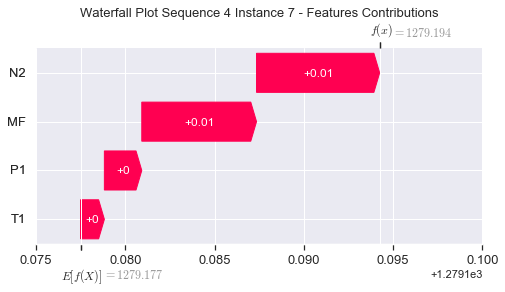

None

Contribution: [0.00213421 0.00136451 0.00704398 0.00657649]


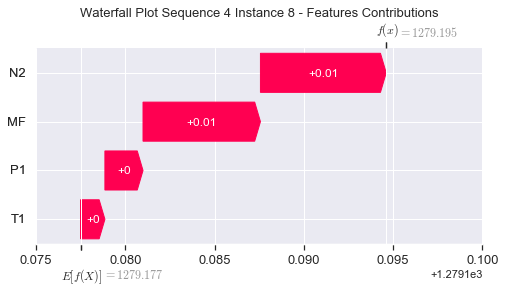

None

Contribution: [0.00208624 0.00141367 0.00699329 0.0065538 ]


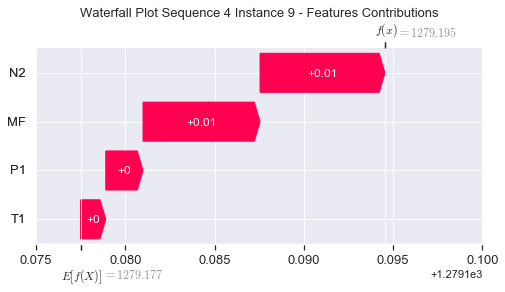

None

Contribution: [0.00210294 0.00132367 0.00690087 0.00648145]


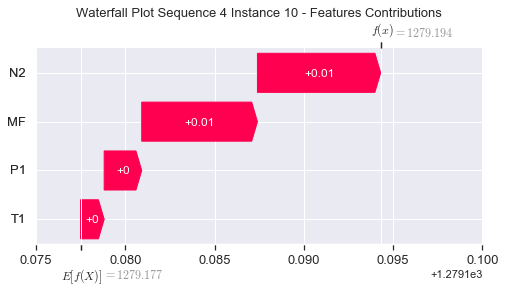

None

Contribution: [0.00203251 0.00135261 0.006827   0.00641453]


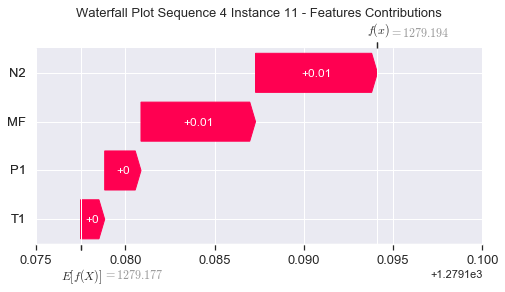

None

Contribution: [0.00203423 0.00129896 0.00672206 0.00626333]


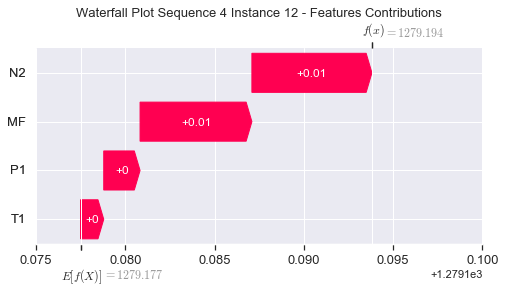

None

Contribution: [0.00200111 0.00127929 0.00661159 0.00616065]


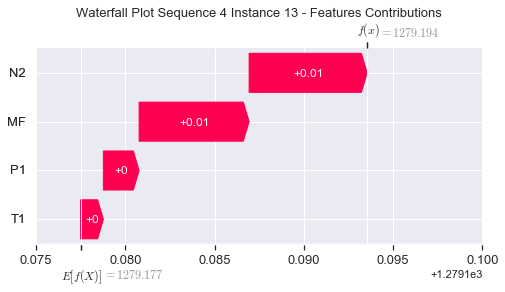

None

Contribution: [0.00188802 0.00124201 0.00629462 0.0059467 ]


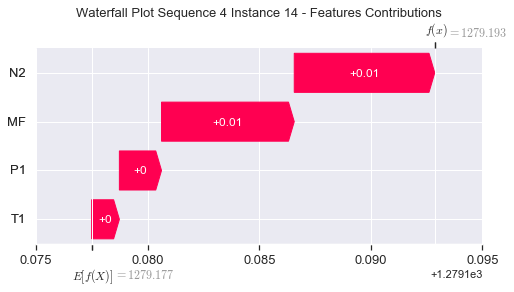

None

Contribution: [0.00167282 0.00103543 0.00553115 0.0051804 ]


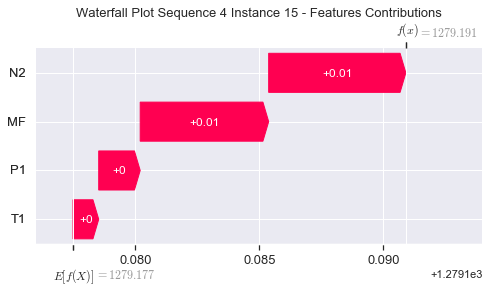

None

Contribution: [0.00129245 0.00080842 0.00433822 0.00408504]


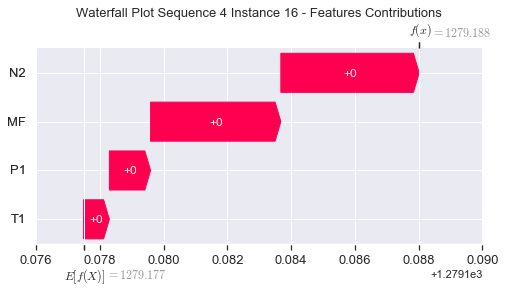

None

Contribution: [0.00121672 0.00075403 0.00409916 0.00384181]


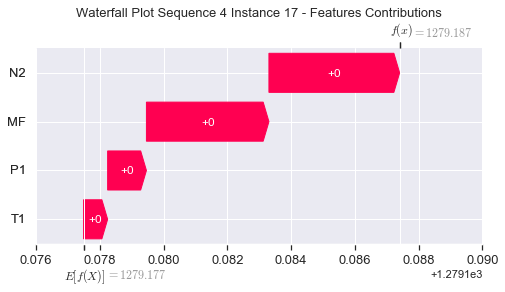

None

Contribution: [0.00335968 0.00239909 0.01153858 0.01060806]


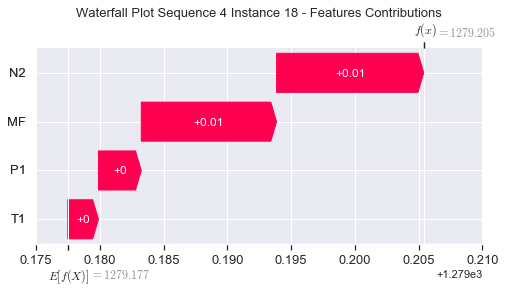

None

Contribution: [0.01429739 0.01068154 0.04842737 0.04377355]


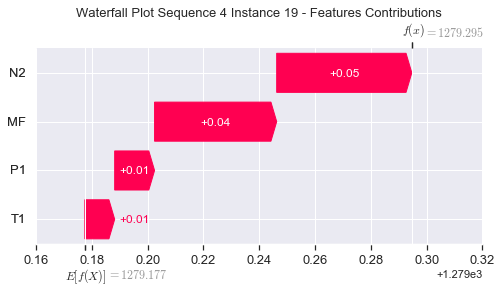

None

Contribution: [0.04990737 0.03631629 0.17059467 0.15615799]


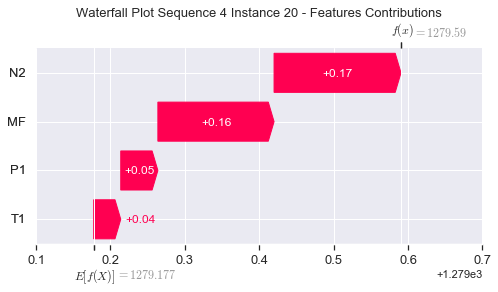

None

Contribution: [0.14296993 0.10003969 0.49006022 0.44926631]


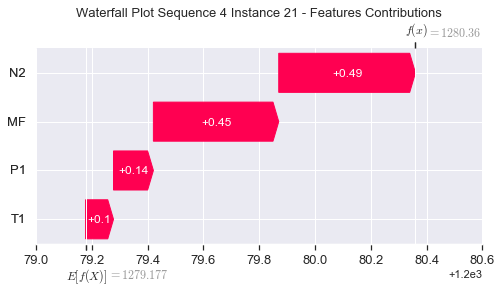

None

Contribution: [0.33050792 0.19132785 1.15403064 1.06309659]


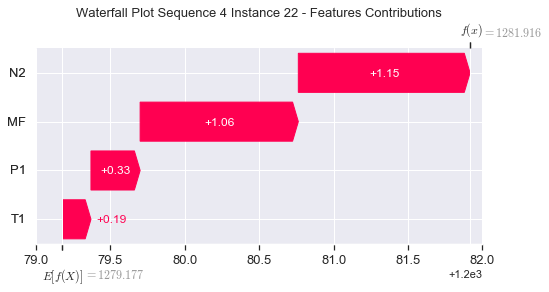

None

Contribution: [ 0.54167286 -0.06186716  2.13671408  2.01366767]


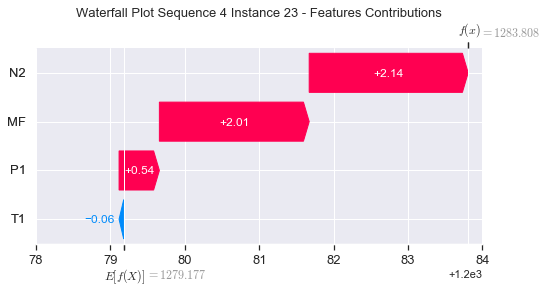

None

Contribution: [ 0.34876608 -2.54905895  2.58668133  2.61460827]


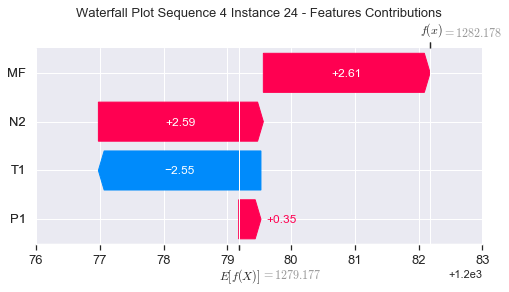

None

Contribution: [ 0.43483122 -1.33104652  2.40780053  2.30918201]


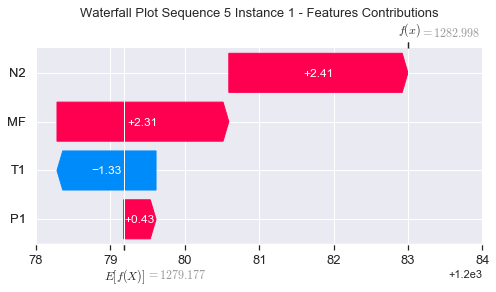

None

Contribution: [-0.0664009   0.12012036 -0.27346682 -0.28088855]


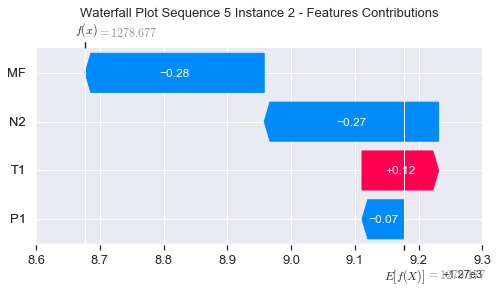

None

Contribution: [0.00102081 0.00054456 0.00378775 0.00365244]


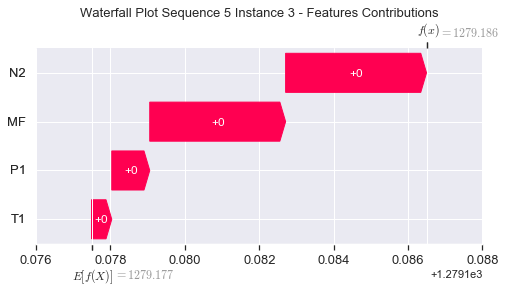

None

Contribution: [0.00154606 0.00098708 0.00526708 0.00495939]


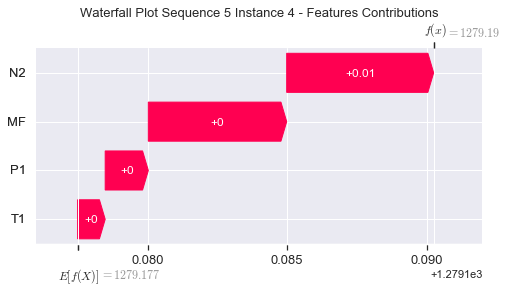

None

Contribution: [0.00171335 0.00111549 0.00579628 0.00543153]


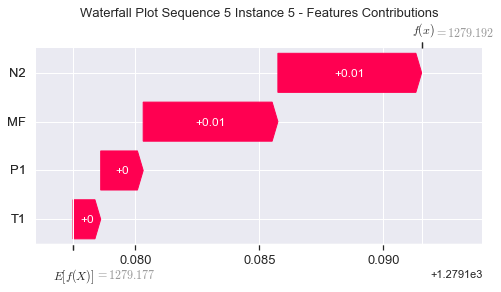

None

Contribution: [0.00190209 0.00129691 0.00637375 0.00597065]


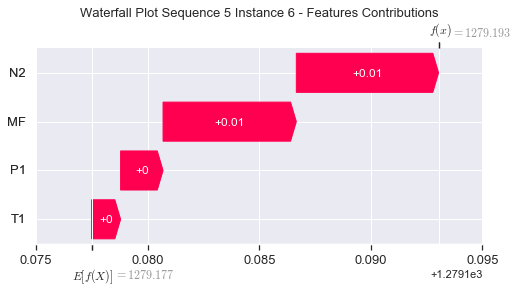

None

Contribution: [0.0020499  0.00139788 0.00685811 0.00641719]


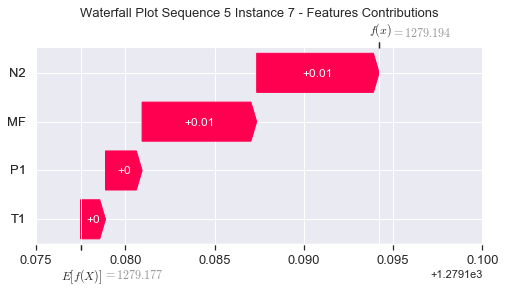

None

Contribution: [0.00209793 0.00143972 0.00700643 0.00655948]


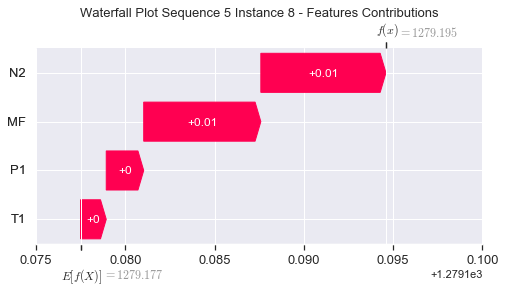

None

Contribution: [0.00207856 0.00148557 0.00694184 0.00649044]


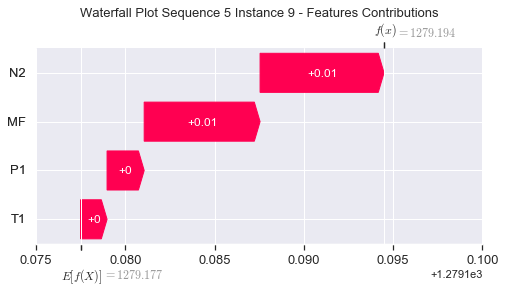

None

Contribution: [0.00201656 0.00145936 0.00684826 0.00639745]


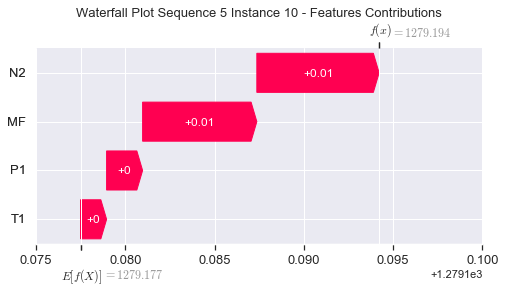

None

Contribution: [0.00203007 0.00149913 0.00678114 0.00633672]


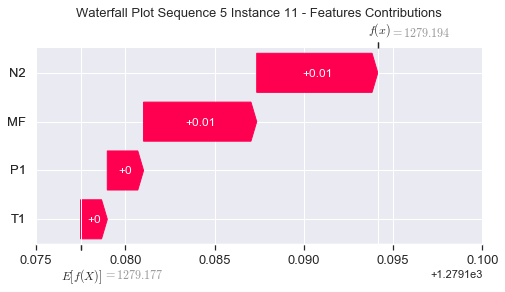

None

Contribution: [0.00199954 0.0013855  0.00668313 0.00623788]


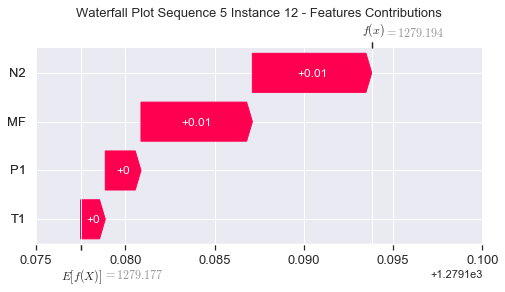

None

Contribution: [0.00196766 0.00135415 0.00657033 0.0061342 ]


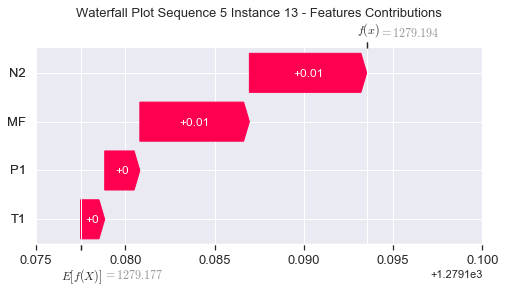

None

Contribution: [0.00189545 0.00129435 0.0062636  0.00588985]


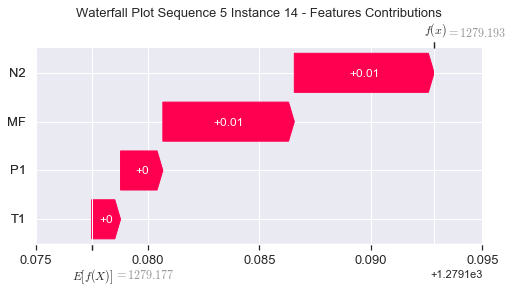

None

Contribution: [0.00165666 0.00112986 0.00551349 0.00516978]


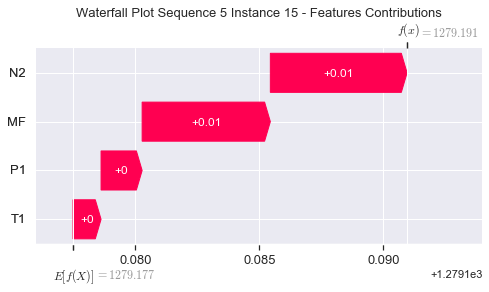

None

Contribution: [0.00133349 0.0008652  0.00438041 0.00426416]


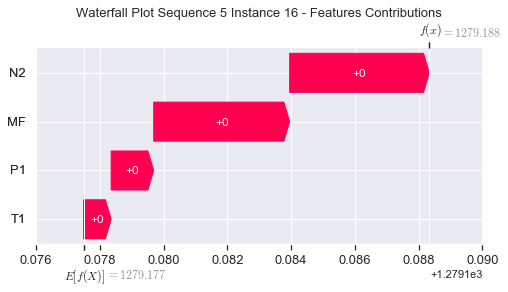

None

Contribution: [0.00121189 0.00084341 0.00409642 0.00383895]


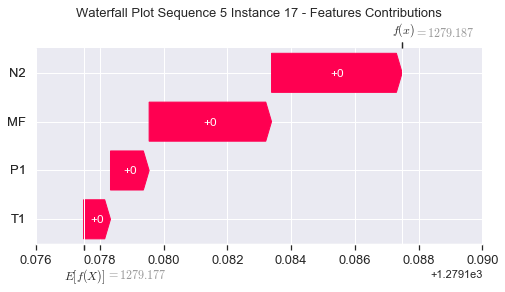

None

Contribution: [0.00331565 0.00258915 0.01138936 0.01046313]


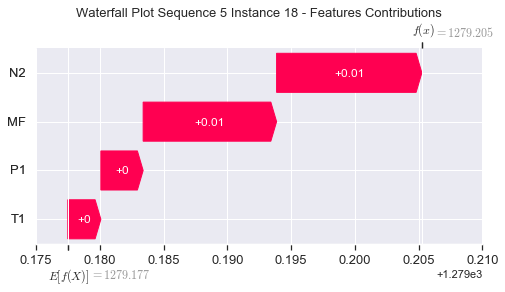

None

Contribution: [0.0139844  0.01075481 0.04763711 0.04349976]


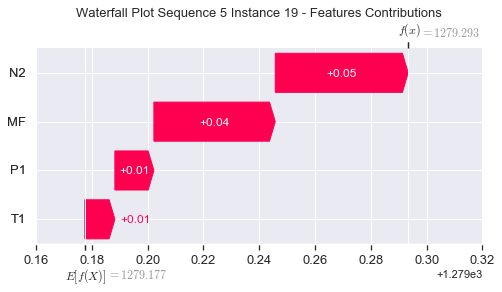

None

Contribution: [0.04937067 0.03844473 0.16832782 0.15393074]


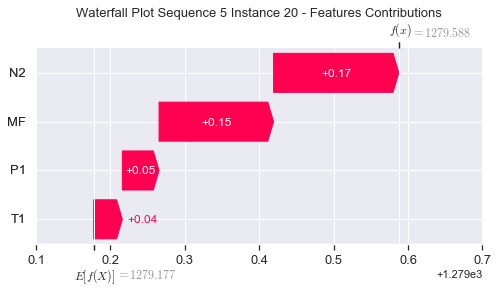

None

Contribution: [0.14199926 0.10720121 0.48478605 0.44369463]


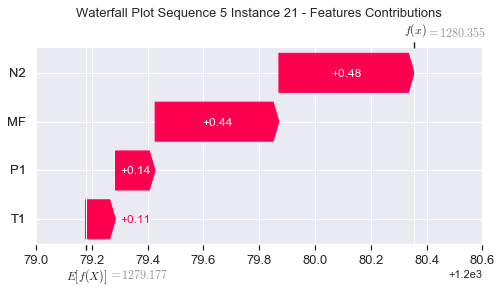

None

Contribution: [0.33005703 0.21736311 1.14475455 1.05146654]


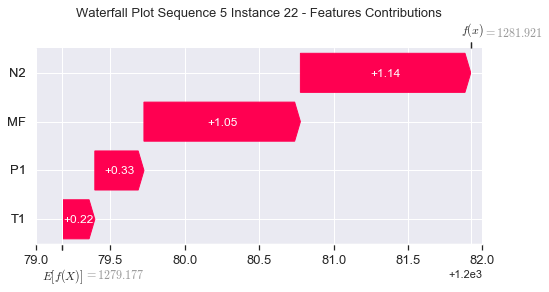

None

Contribution: [0.55062511 0.06016241 2.1245839  1.98707632]


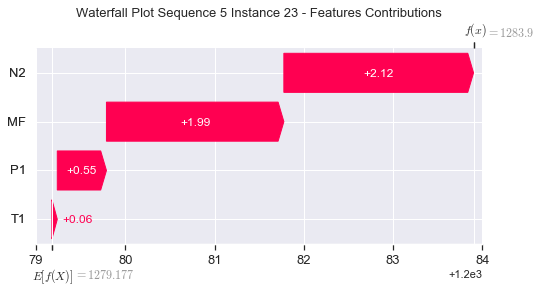

None

Contribution: [ 0.43215008 -2.07308731  2.5792355   2.56051029]


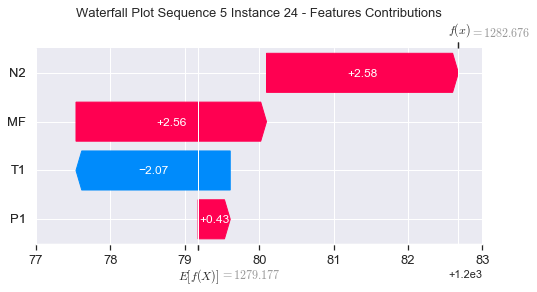

None

Contribution: [ 0.55077459 -1.12330597  2.41110665  2.31778791]


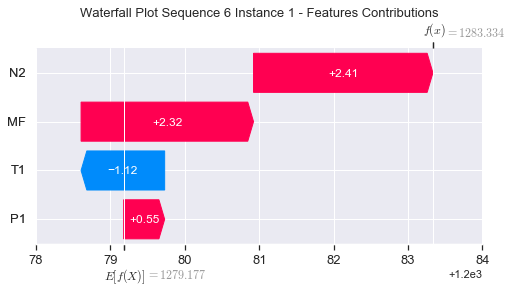

None

Contribution: [-0.07044938  0.09519973 -0.27550356 -0.27910713]


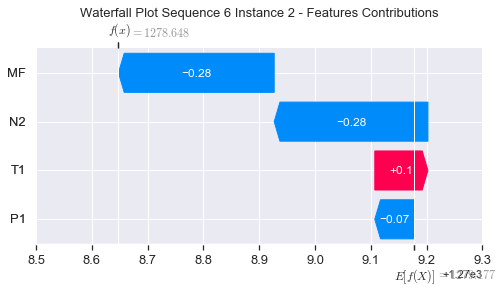

None

Contribution: [0.00104227 0.00065999 0.00383088 0.00367565]


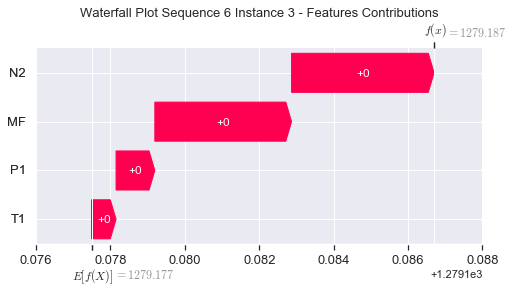

None

Contribution: [0.00158196 0.0010622  0.00531302 0.00494618]


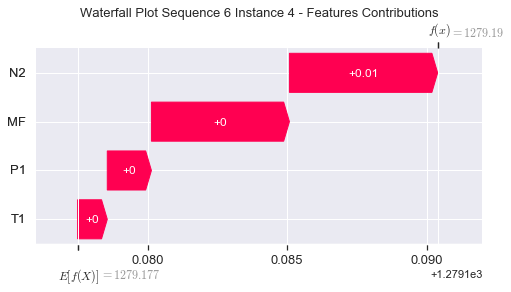

None

Contribution: [0.00175663 0.00126344 0.00585623 0.00545355]


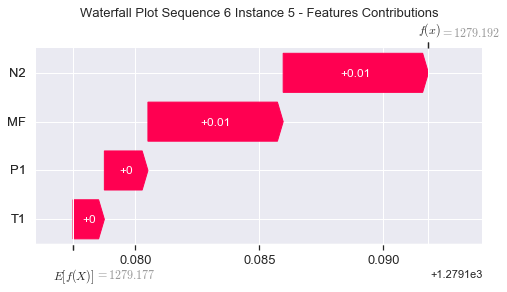

None

Contribution: [0.00194259 0.00134916 0.00643574 0.00598819]


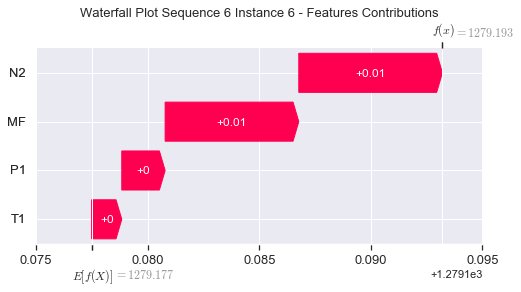

None

Contribution: [0.00209636 0.00143599 0.00692744 0.0064464 ]


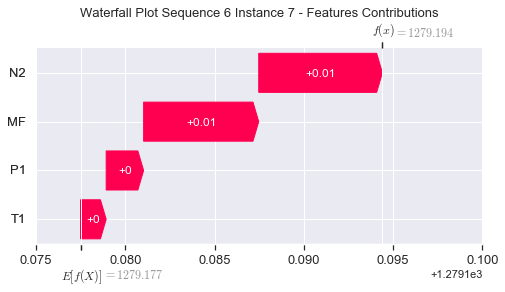

None

Contribution: [0.00213992 0.00145024 0.00708183 0.00658422]


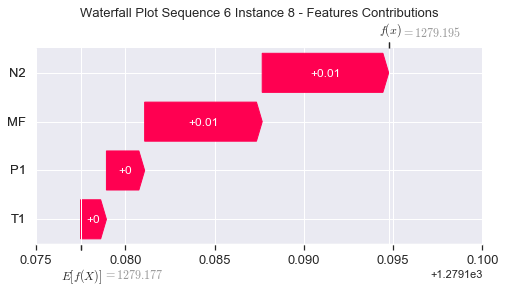

None

Contribution: [0.00212152 0.00141595 0.00702061 0.00649389]


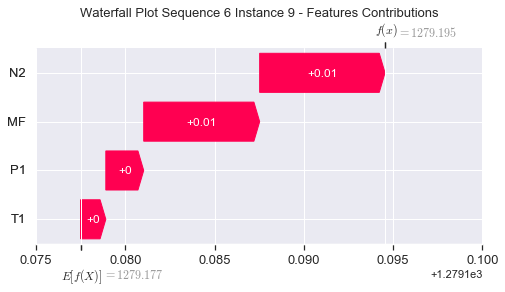

None

Contribution: [0.00207035 0.00143871 0.00694093 0.00649725]


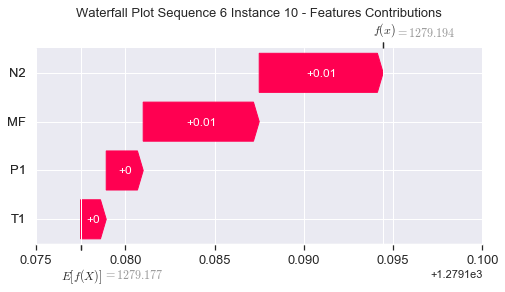

None

Contribution: [0.00206468 0.00136298 0.00686255 0.00633556]


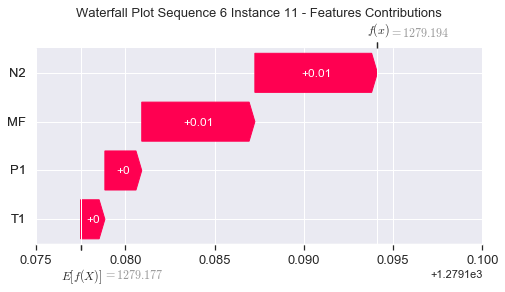

None

Contribution: [0.00204085 0.00128889 0.00674867 0.00627137]


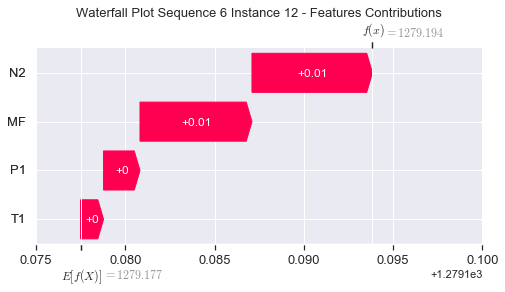

None

Contribution: [0.00200722 0.0012605  0.0066404  0.00617191]


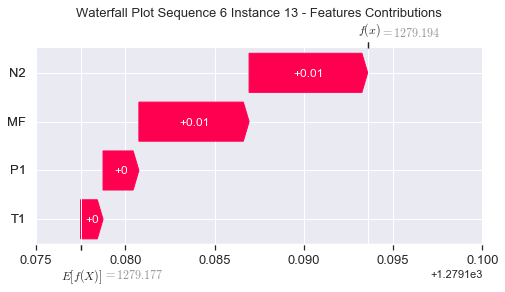

None

Contribution: [0.00190634 0.00123921 0.00629843 0.00588296]


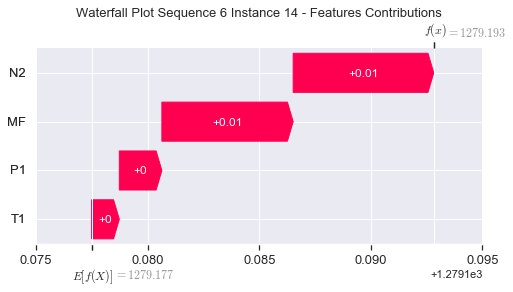

None

Contribution: [0.00167457 0.00099845 0.00554559 0.0051647 ]


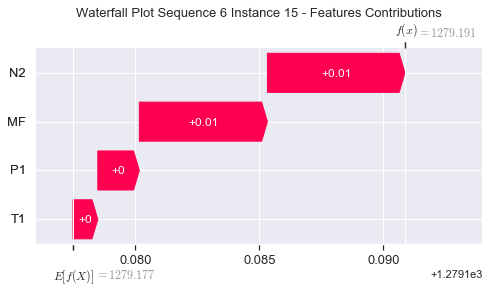

None

Contribution: [0.00130681 0.00069301 0.00433756 0.00403442]


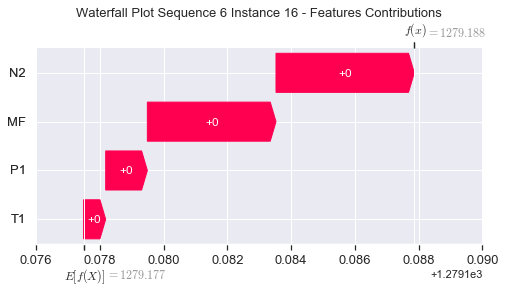

None

Contribution: [0.00123368 0.00069107 0.00417277 0.00387888]


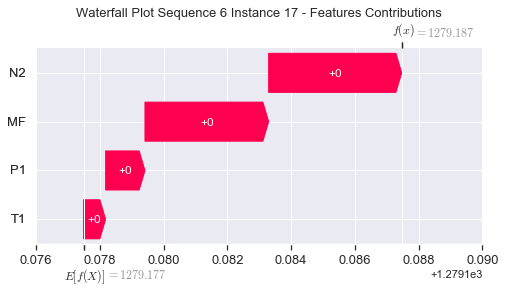

None

Contribution: [0.00346022 0.00226218 0.01193183 0.0108818 ]


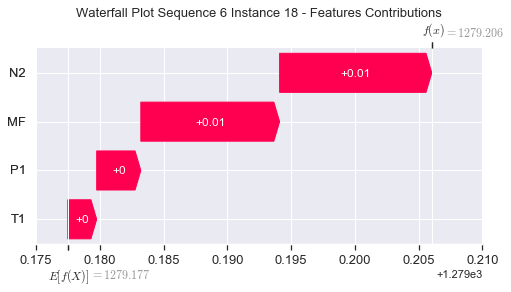

None

Contribution: [0.01457644 0.00961889 0.04992045 0.04519503]


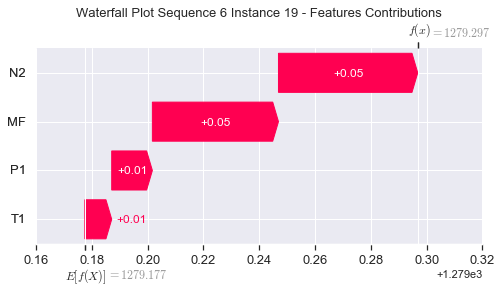

None

Contribution: [0.05077202 0.03366906 0.17446818 0.158505  ]


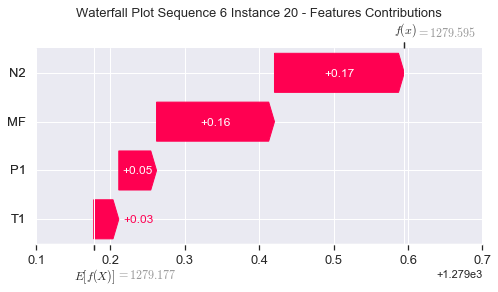

None

Contribution: [0.1446692  0.09043537 0.49845141 0.45311647]


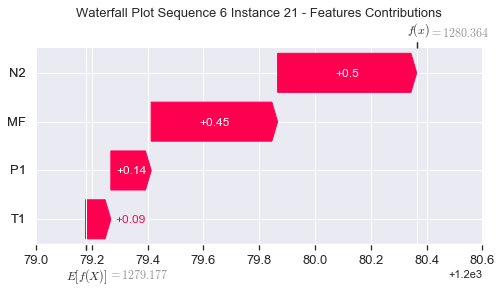

None

Contribution: [0.33227261 0.15883848 1.16919684 1.06436545]


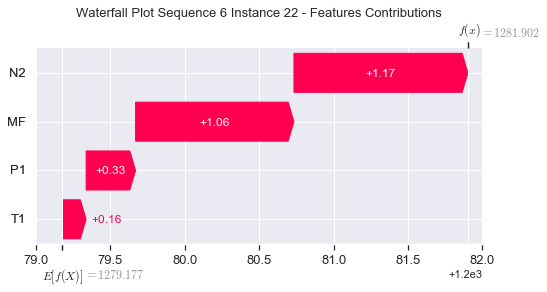

None

Contribution: [ 0.5360962  -0.21819921  2.15906698  1.97915181]


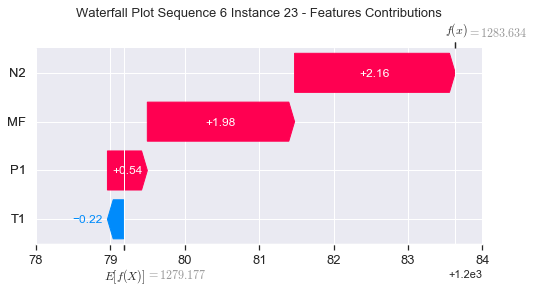

None

Contribution: [ 0.32787884 -3.15853668  2.63602307  2.40142351]


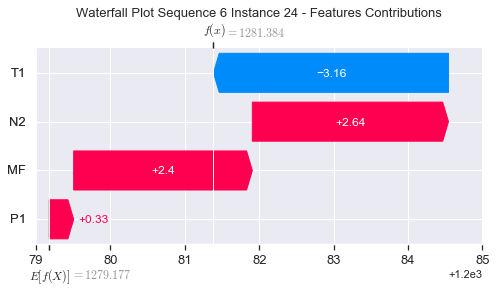

None

Contribution: [ 0.47283072 -1.81883425  2.4549114   2.17116179]


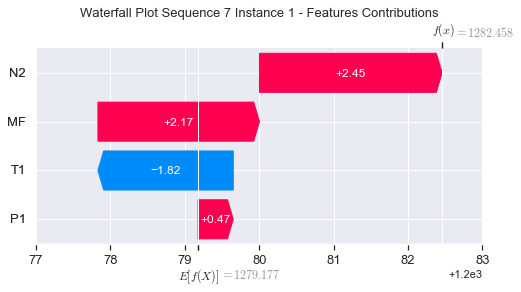

None

Contribution: [-0.06554909  0.16807393 -0.27878459 -0.27418823]


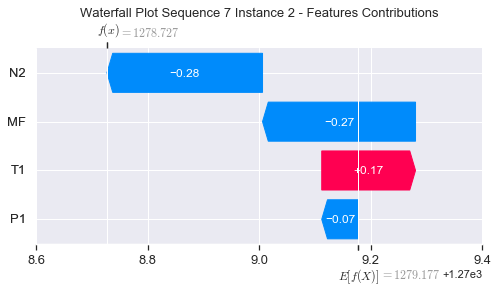

None

Contribution: [0.0010466  0.00048793 0.00384242 0.00367988]


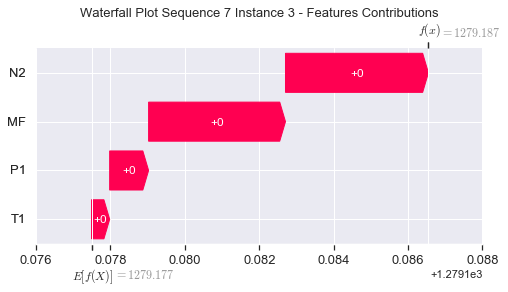

None

Contribution: [0.00159281 0.00076809 0.00536321 0.00505052]


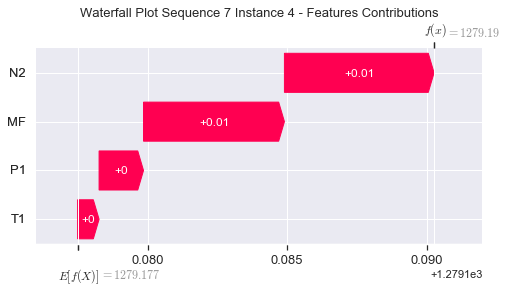

None

Contribution: [0.00177288 0.00092222 0.00590184 0.00553749]


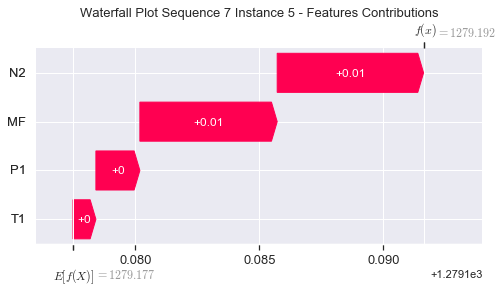

None

Contribution: [0.00194147 0.00102588 0.0064769  0.00604842]


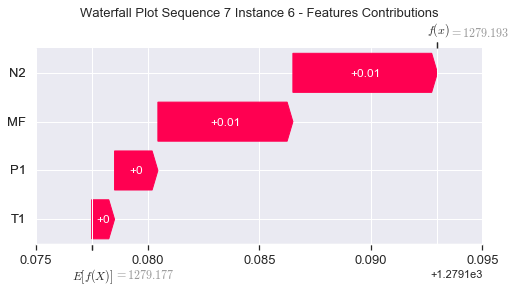

None

Contribution: [0.00208538 0.00113676 0.00697153 0.00651921]


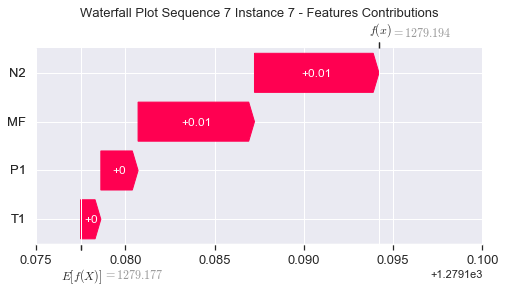

None

Contribution: [0.00213558 0.00116937 0.00711811 0.00664785]


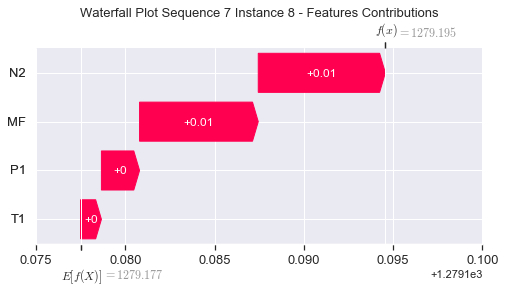

None

Contribution: [0.00210648 0.00127048 0.00705357 0.00660938]


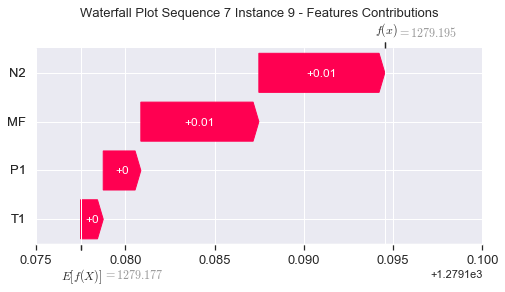

None

Contribution: [0.00210483 0.00129273 0.00698012 0.00655144]


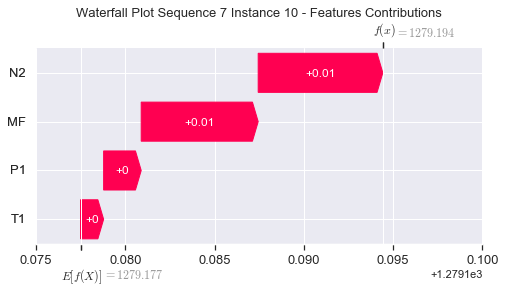

None

Contribution: [0.0020715  0.0011865  0.00688246 0.00639045]


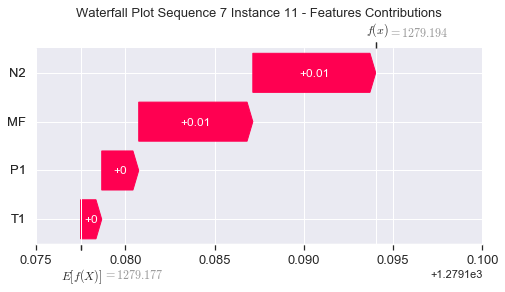

None

Contribution: [0.00202837 0.00111965 0.00679858 0.00633461]


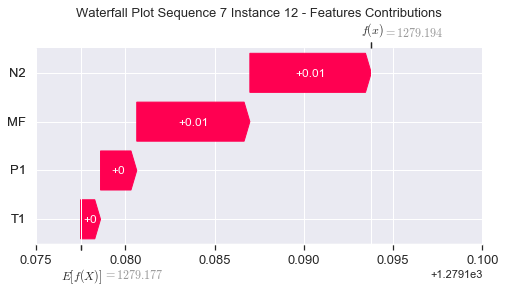

None

Contribution: [0.00199215 0.0011088  0.00668321 0.00623374]


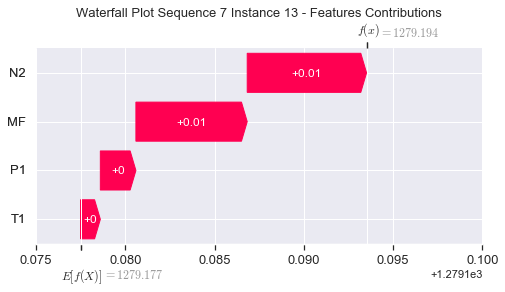

None

Contribution: [0.0018819  0.00114061 0.00633633 0.00591988]


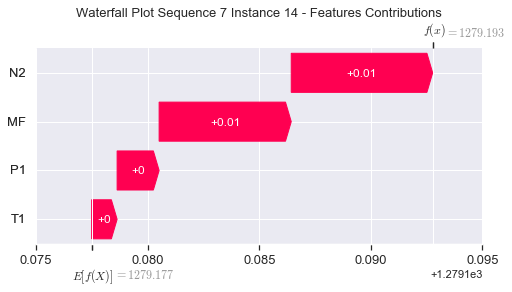

None

Contribution: [0.00165368 0.00087342 0.00555326 0.00518532]


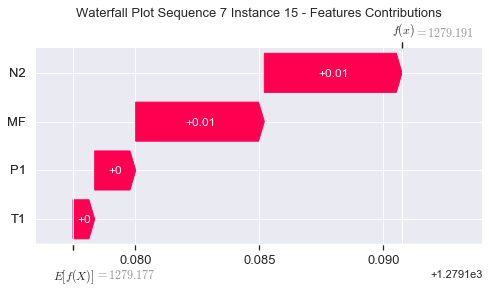

None

Contribution: [0.00131709 0.00061933 0.00434097 0.00411404]


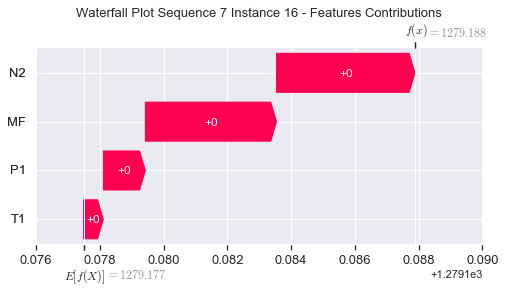

None

Contribution: [0.0011875  0.00061387 0.00410592 0.00382875]


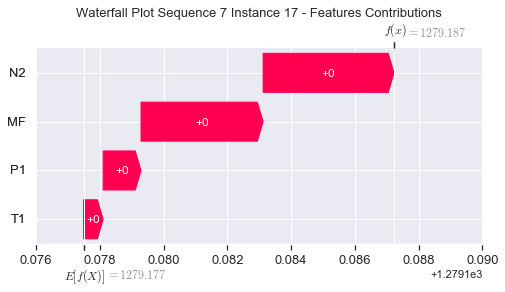

None

Contribution: [0.00338592 0.00215049 0.01185428 0.01081548]


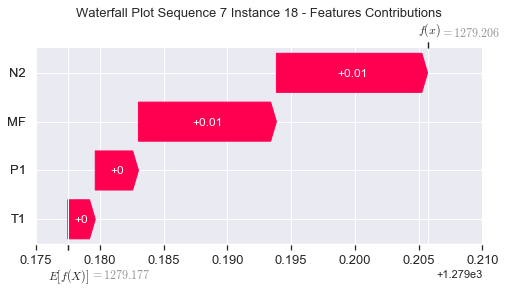

None

Contribution: [0.01469485 0.00926114 0.04999437 0.04546962]


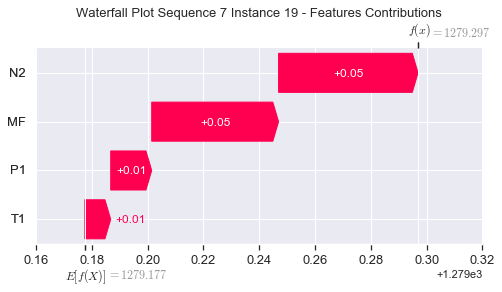

None

Contribution: [0.0504538  0.03361338 0.17497122 0.15910058]


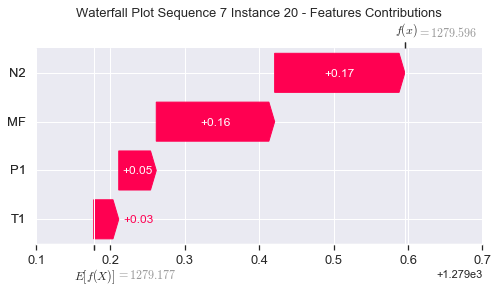

None

Contribution: [0.14388548 0.09118537 0.50004919 0.45480015]


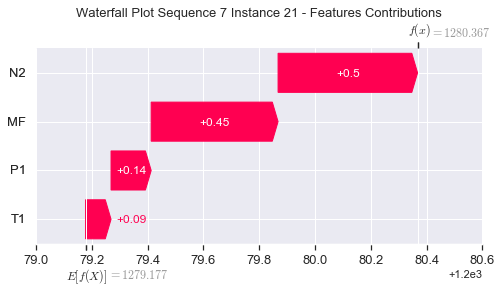

None

Contribution: [0.3310492  0.1604575  1.17218075 1.06646915]


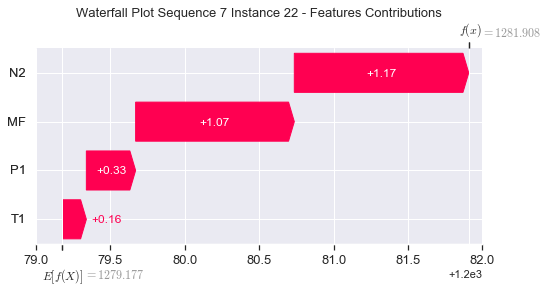

None

Contribution: [ 0.5281011  -0.19898729  2.15892388  1.96831358]


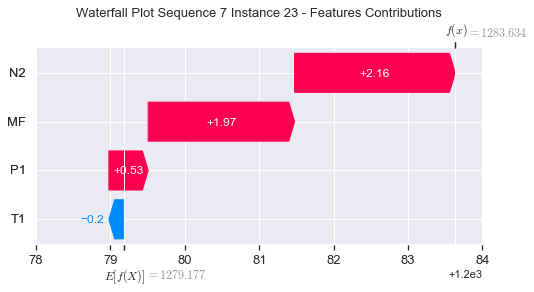

None

Contribution: [ 0.31077925 -3.15754791  2.60530825  2.35111705]


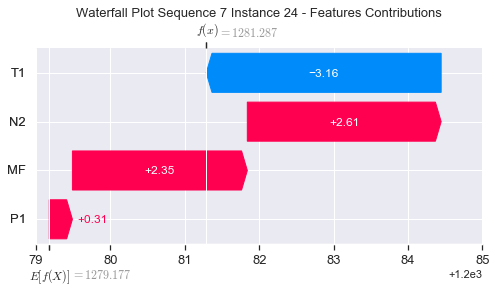

None

Contribution: [ 0.44042496 -1.79555896  2.41479152  2.19081305]


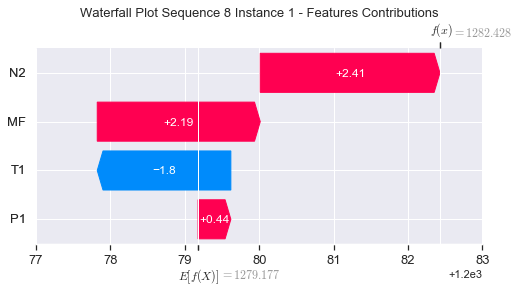

None

Contribution: [-0.06397829  0.1492925  -0.27739444 -0.27222034]


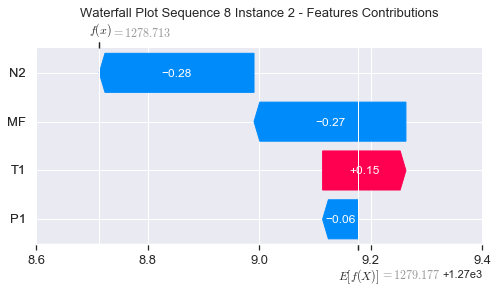

None

Contribution: [0.00102974 0.00041261 0.00383557 0.00367823]


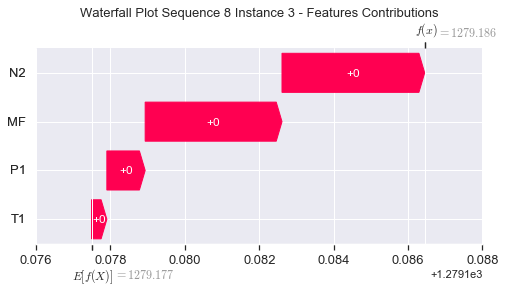

None

Contribution: [0.00154444 0.00076457 0.00531539 0.00501913]


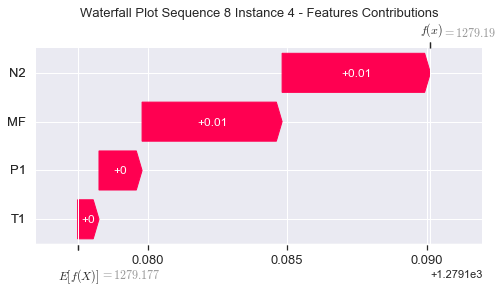

None

Contribution: [0.00161701 0.00089522 0.00577741 0.00511345]


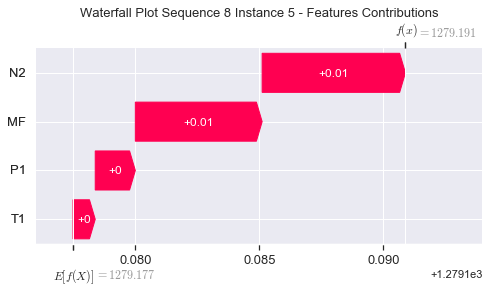

None

Contribution: [0.0018889  0.0011582  0.00639835 0.00584741]


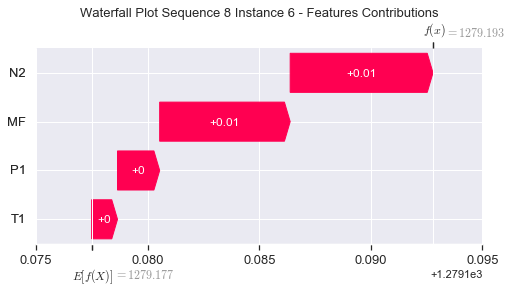

None

Contribution: [0.00203189 0.0012527  0.00688438 0.00631111]


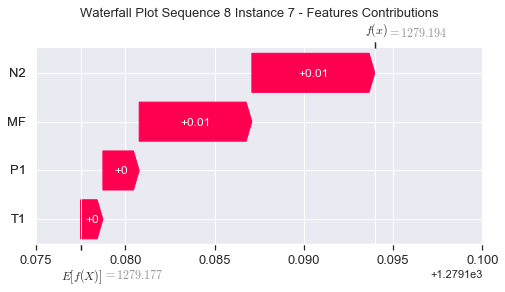

None

Contribution: [0.00207712 0.00131422 0.00702786 0.00645519]


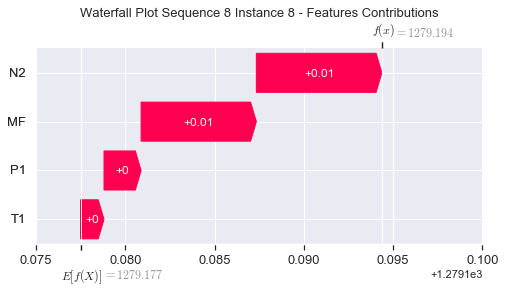

None

Contribution: [0.00201251 0.00124992 0.0069788  0.00653122]


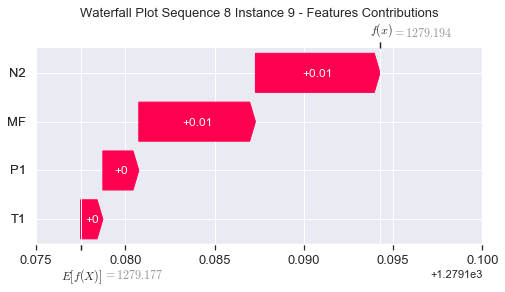

None

Contribution: [0.00187212 0.00116023 0.00684383 0.00624872]


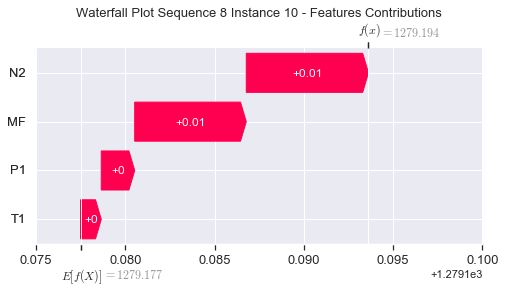

None

Contribution: [0.00203579 0.00143981 0.00680215 0.00642831]


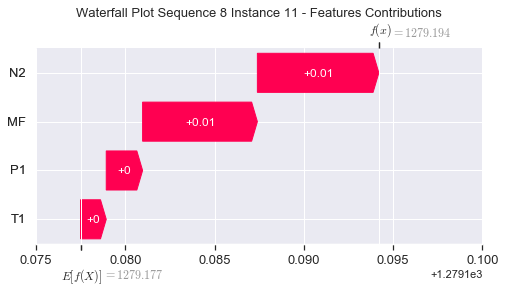

None

Contribution: [0.00203261 0.00148532 0.00668185 0.00623983]


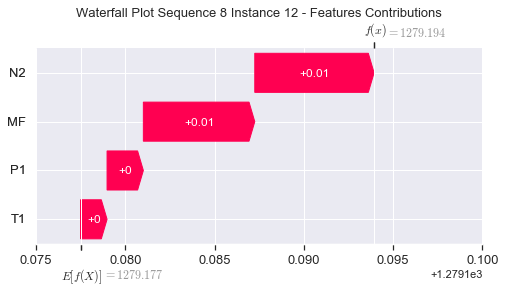

None

Contribution: [0.00198216 0.00142146 0.00656588 0.0061113 ]


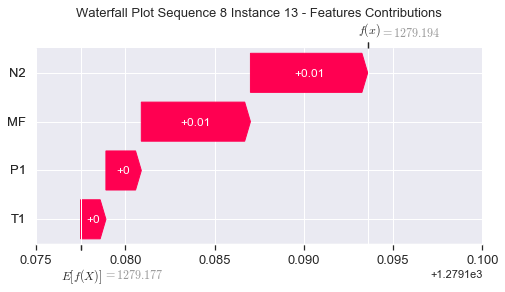

None

Contribution: [0.0018957  0.00134121 0.00625531 0.00590233]


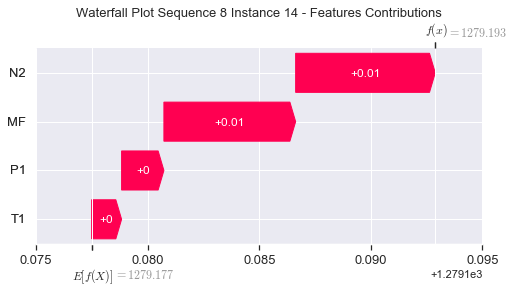

None

Contribution: [0.00168745 0.00118469 0.00552508 0.0051802 ]


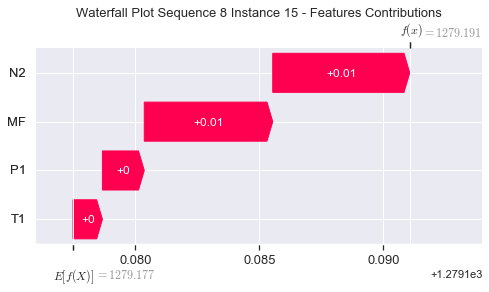

None

Contribution: [0.00132607 0.00089539 0.00436016 0.00416493]


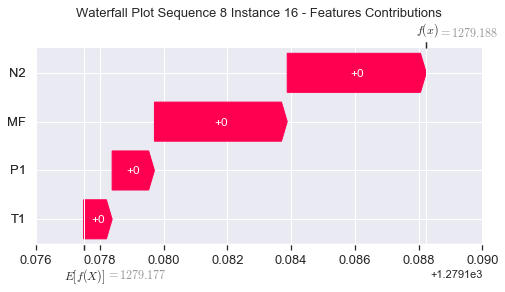

None

Contribution: [0.00122206 0.00089637 0.00404809 0.00381885]


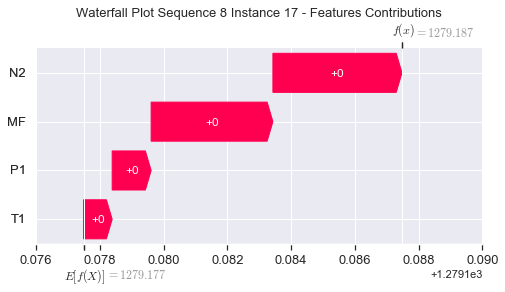

None

Contribution: [0.00330003 0.00271968 0.01110628 0.01026819]


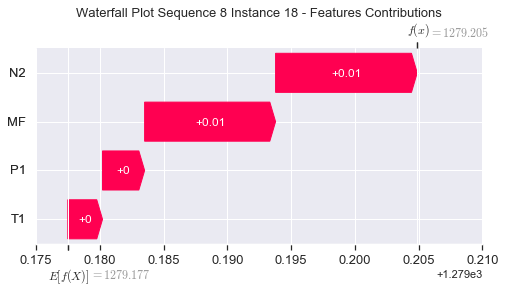

None

Contribution: [0.01390447 0.01082262 0.04691724 0.04267349]


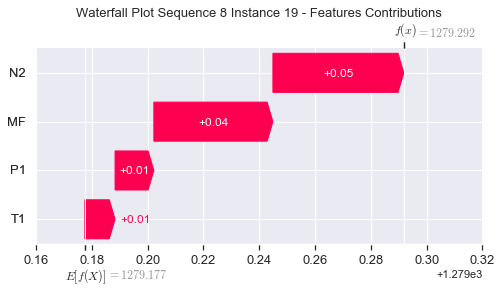

None

Contribution: [0.04889803 0.0396255  0.16613325 0.15154256]


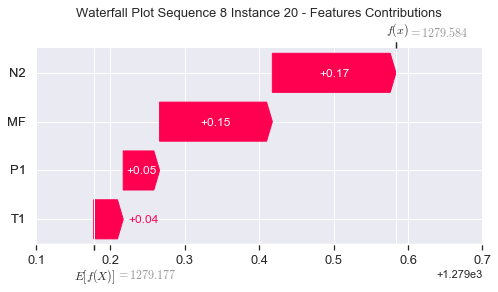

None

Contribution: [0.14132605 0.11375966 0.48008901 0.43811531]


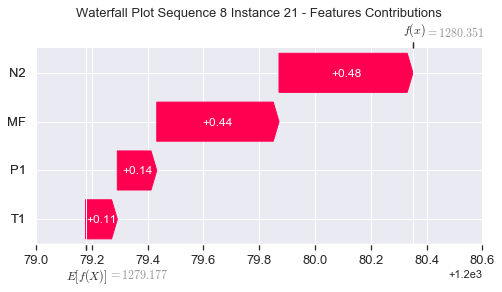

None

Contribution: [0.33082357 0.24410229 1.13728314 1.03771469]


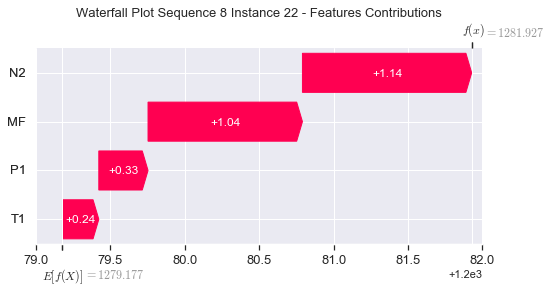

None

Contribution: [0.58244936 0.21183434 2.12855105 1.99926704]


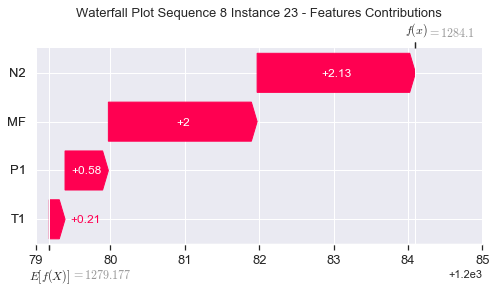

None

Contribution: [ 0.49423697 -1.61990834  2.61090291  2.41031948]


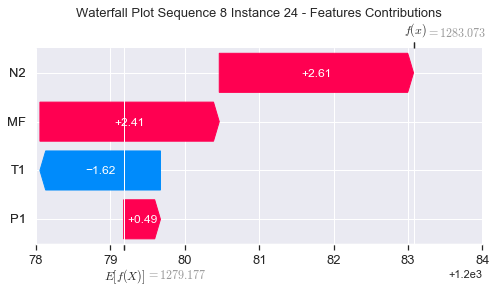

None

Contribution: [ 0.53516645 -0.88177953  2.39241942  2.11602829]


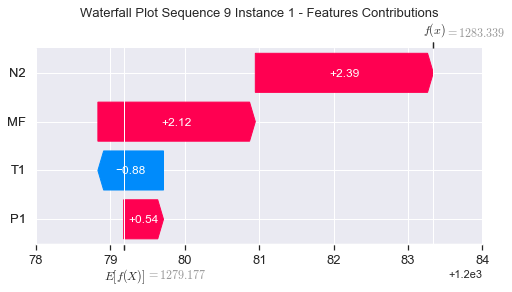

None

Contribution: [-0.0740441   0.04508739 -0.27606585 -0.27353966]


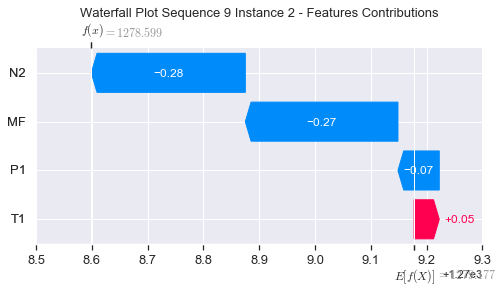

None

Contribution: [0.00105424 0.00062024 0.00377148 0.00357268]


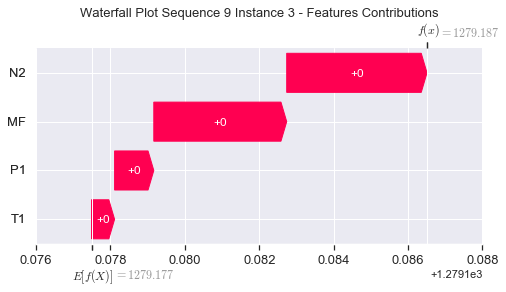

None

Contribution: [0.00153779 0.00126301 0.00520887 0.00483719]


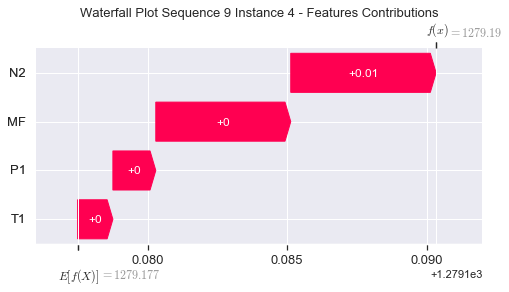

None

Contribution: [0.00172633 0.00135748 0.00575219 0.00539212]


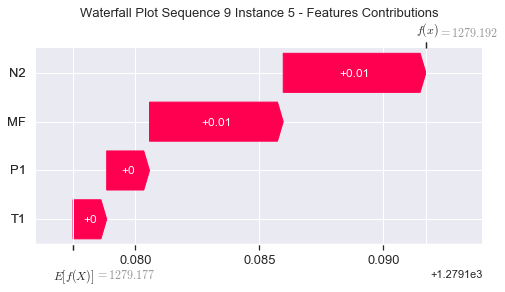

None

Contribution: [0.00189969 0.00146763 0.00631315 0.00587972]


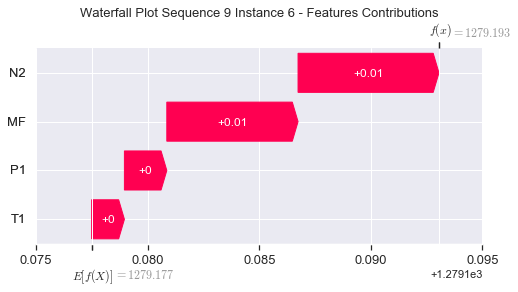

None

Contribution: [0.0020495  0.00157676 0.00679103 0.00631143]


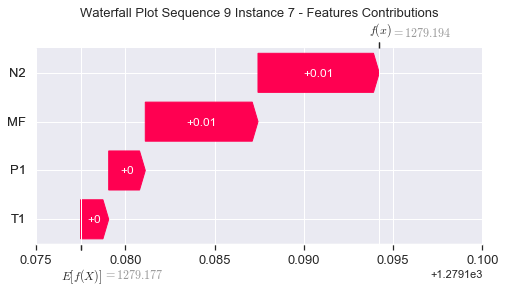

None

Contribution: [0.00210391 0.00160877 0.00693665 0.00646732]


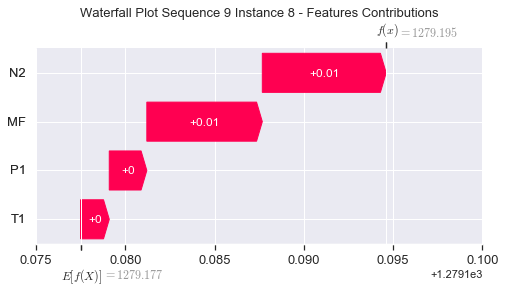

None

Contribution: [0.00212682 0.00166942 0.00687994 0.00640714]


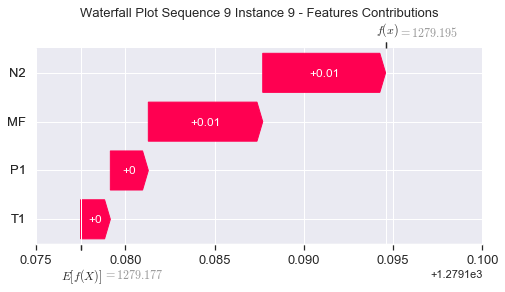

None

Contribution: [0.00207069 0.00164713 0.0068074  0.00646808]


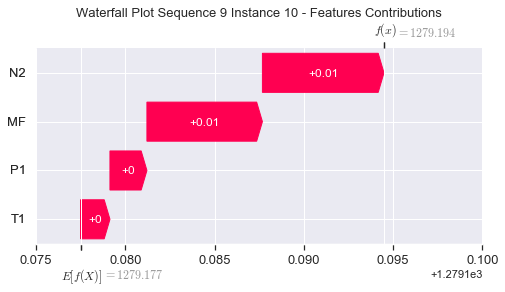

None

Contribution: [0.00207487 0.00161419 0.00673113 0.00629637]


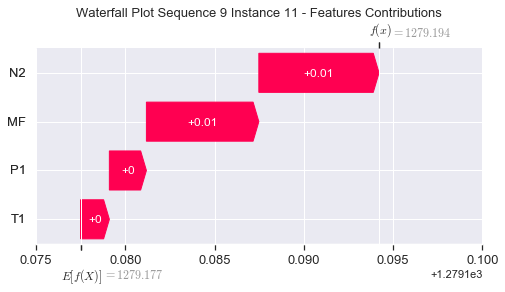

None

Contribution: [0.00201893 0.00148477 0.00663754 0.00618246]


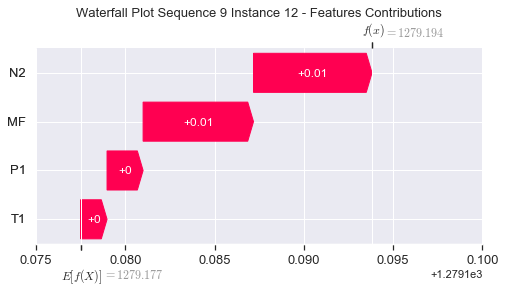

None

Contribution: [0.00199227 0.00146211 0.00653545 0.00609045]


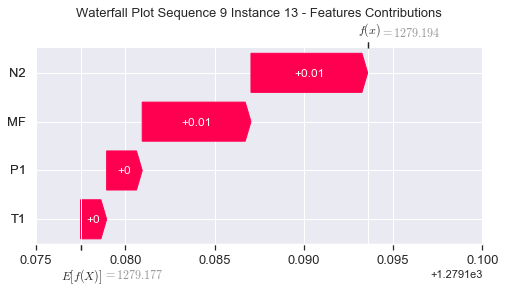

None

Contribution: [0.00193202 0.00134956 0.00624267 0.00591666]


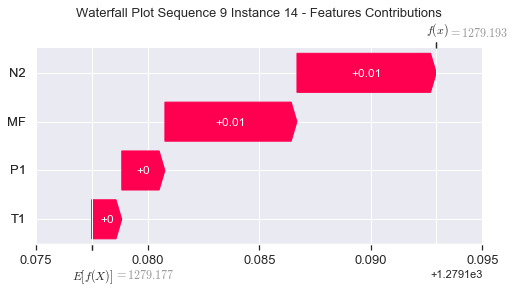

None

Contribution: [0.00168472 0.00120024 0.00550808 0.00515329]


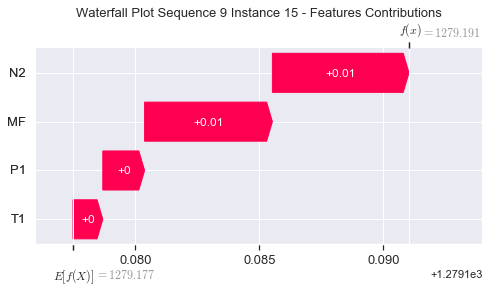

None

Contribution: [0.00134552 0.00085399 0.00436639 0.00417073]


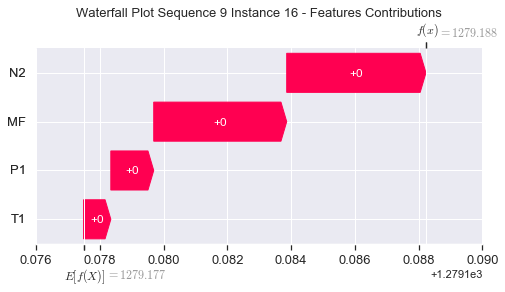

None

Contribution: [0.00123913 0.00088702 0.00408586 0.00381687]


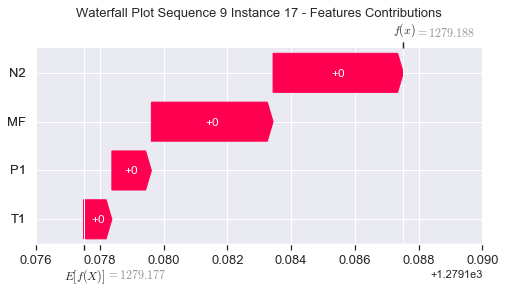

None

Contribution: [0.00332212 0.00260444 0.0111891  0.0102658 ]


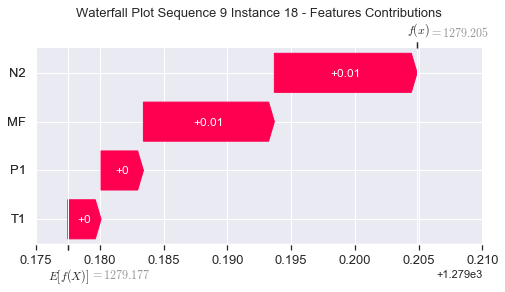

None

Contribution: [0.01391319 0.01145948 0.0469171  0.043225  ]


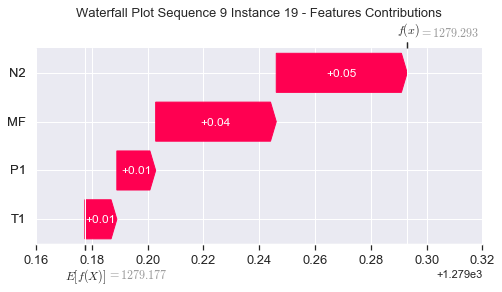

None

Contribution: [0.04970001 0.03887598 0.16626078 0.15214029]


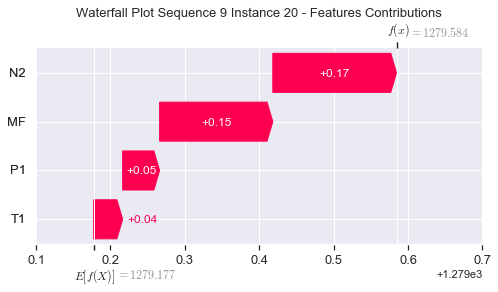

None

Contribution: [0.14391115 0.10845398 0.48062946 0.44089333]


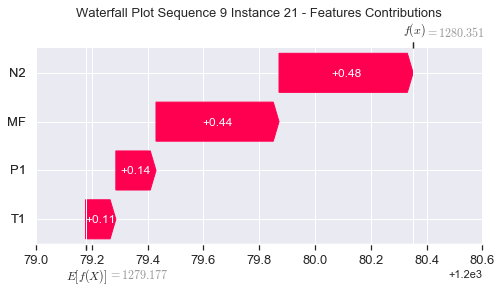

None

Contribution: [0.33862242 0.22156866 1.13961931 1.05318707]


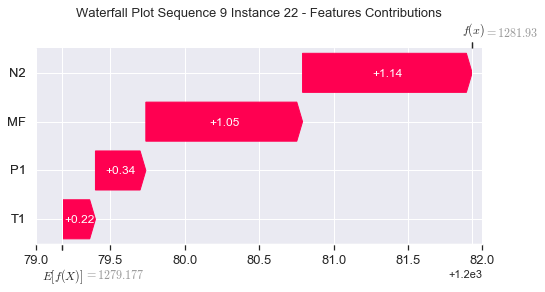

None

Contribution: [0.58938218 0.05993911 2.13055659 2.0153426 ]


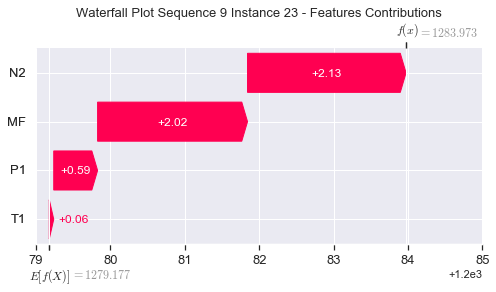

None

Contribution: [ 0.60156429 -2.08951269  2.63202951  2.68676497]


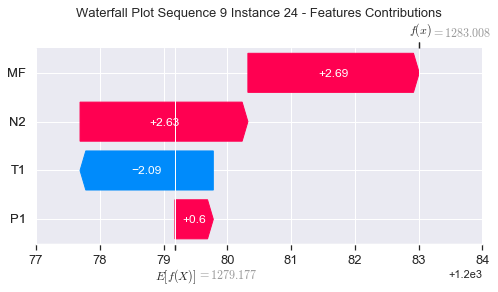

None

Contribution: [ 0.66309198 -1.20215009  2.41347909  2.28684255]


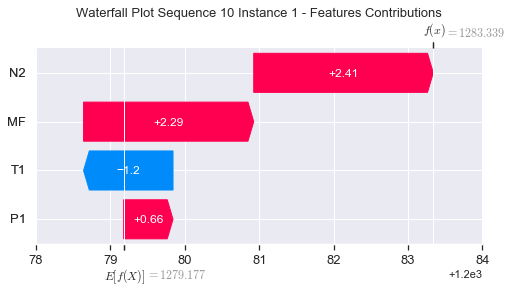

None

Contribution: [-0.08614885  0.09507446 -0.2796977  -0.2980855 ]


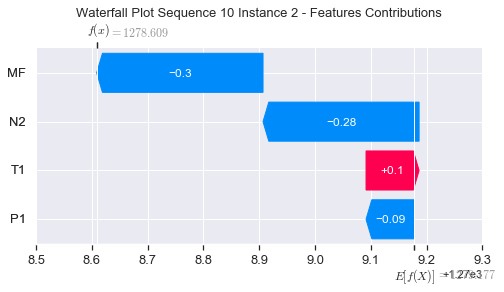

None

Contribution: [0.00106404 0.00063823 0.00377968 0.00364659]


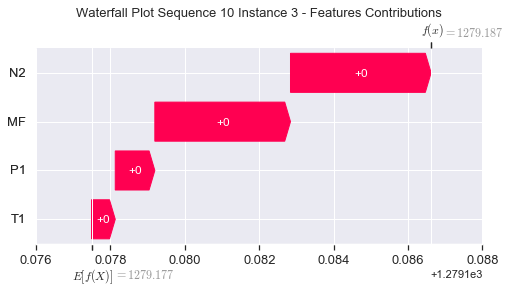

None

Contribution: [0.00160999 0.00107692 0.00523291 0.00486794]


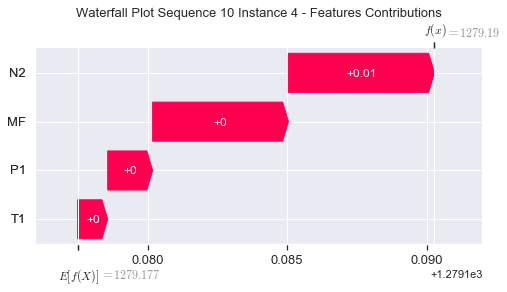

None

Contribution: [0.00179967 0.00142706 0.00576609 0.00540974]


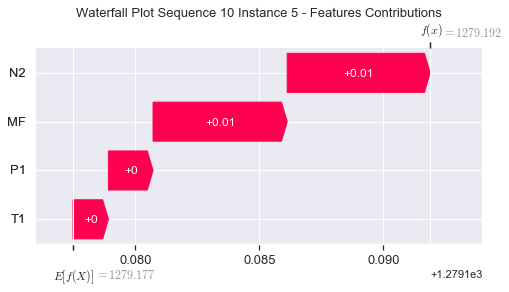

None

Contribution: [0.00201032 0.00133496 0.00633867 0.00600321]


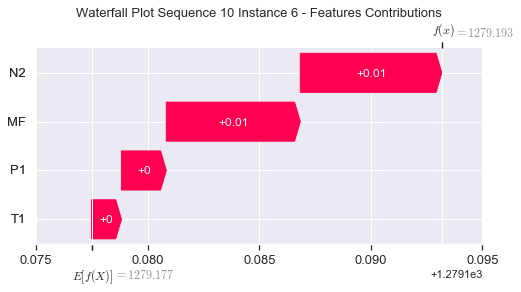

None

Contribution: [0.00213942 0.00135577 0.00679824 0.0064159 ]


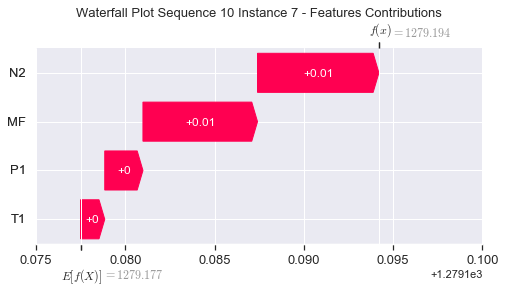

None

Contribution: [0.00221159 0.001463   0.00693447 0.00657248]


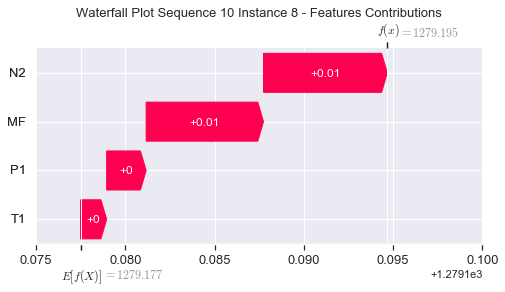

None

Contribution: [0.00226715 0.00164682 0.00686577 0.00659117]


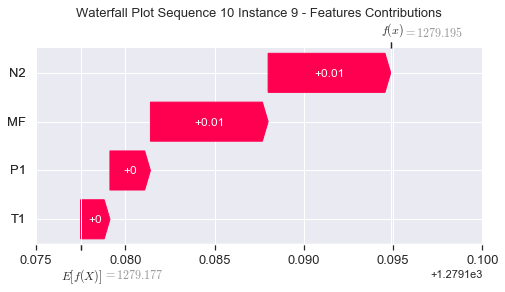

None

Contribution: [0.00222583 0.0017011  0.00679684 0.00649663]


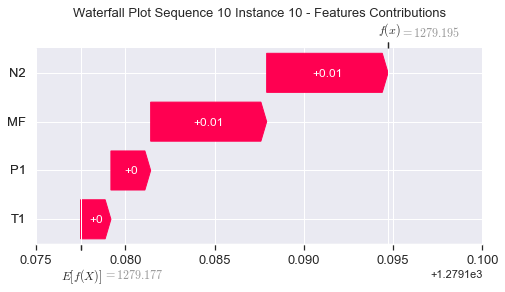

None

Contribution: [0.00232676 0.00178343 0.00678604 0.00663926]


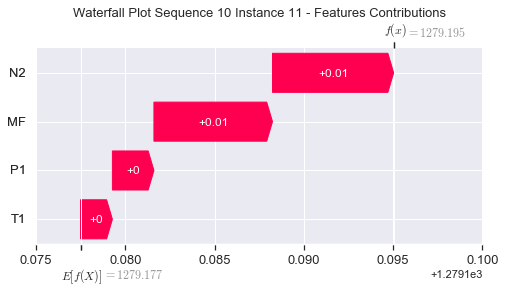

None

Contribution: [0.00213779 0.00133641 0.00668047 0.00636708]


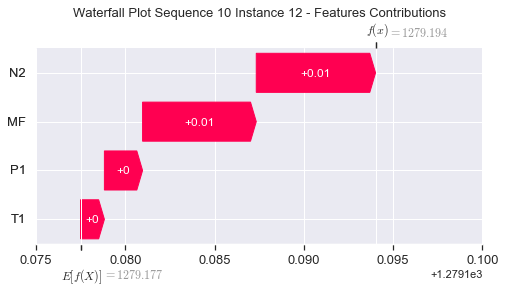

None

Contribution: [0.00209475 0.00128794 0.00658492 0.00624685]


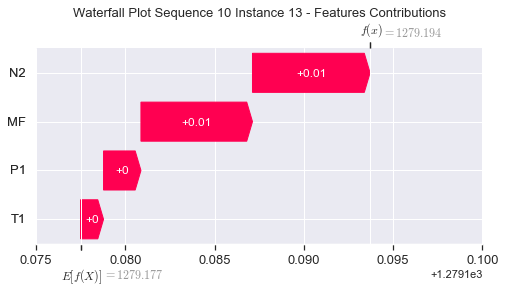

None

Contribution: [0.00202005 0.00141191 0.00627851 0.00593001]


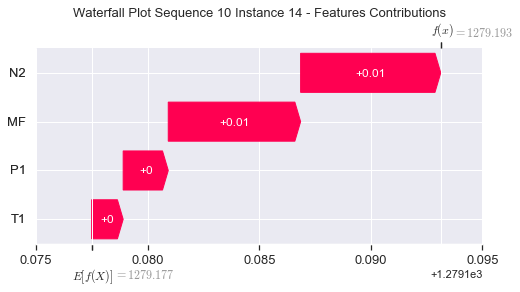

None

Contribution: [0.00177697 0.00098754 0.00554444 0.00528315]


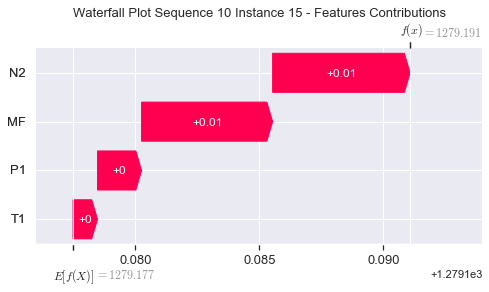

None

Contribution: [0.00132006 0.00030325 0.00433064 0.00415187]


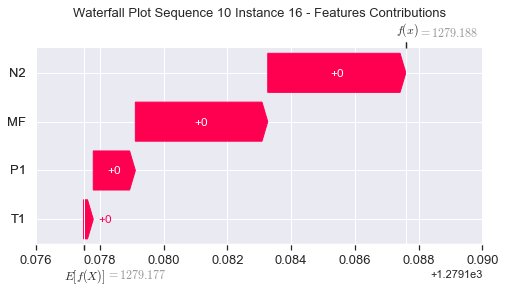

None

Contribution: [0.00132018 0.00063563 0.00415992 0.00395306]


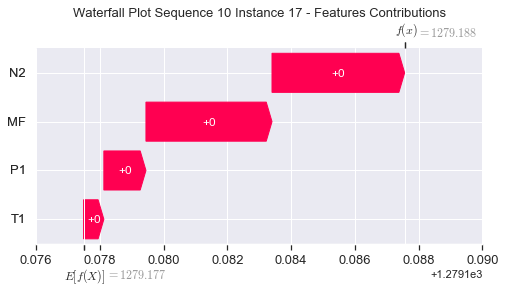

None

Contribution: [0.00360947 0.00206611 0.01166661 0.01084981]


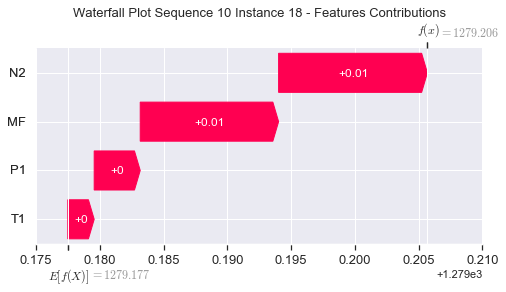

None

Contribution: [0.01481761 0.00638377 0.04896356 0.04537674]


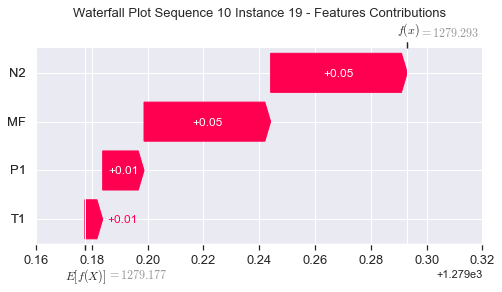

None

Contribution: [0.05223744 0.03114743 0.17008048 0.15622052]


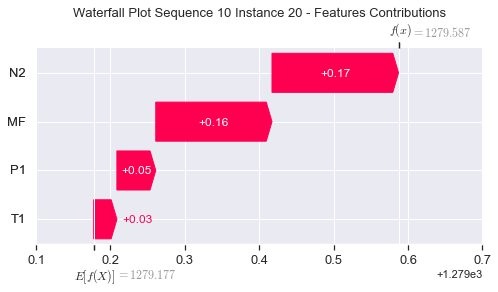

None

Contribution: [0.1505182  0.08809672 0.48769662 0.44891944]


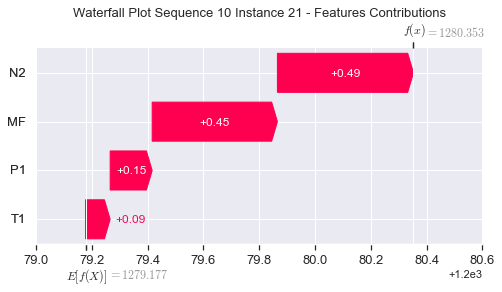

None

Contribution: [0.35751906 0.17139862 1.1501495  1.06694501]


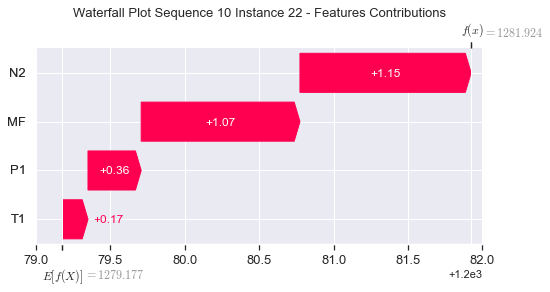

None

Contribution: [ 0.66392884 -0.18301451  2.14732131  2.06289039]


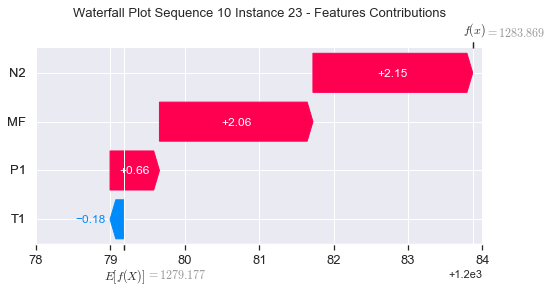

None

Contribution: [ 0.82241746 -2.78903964  2.62070779  2.6524938 ]


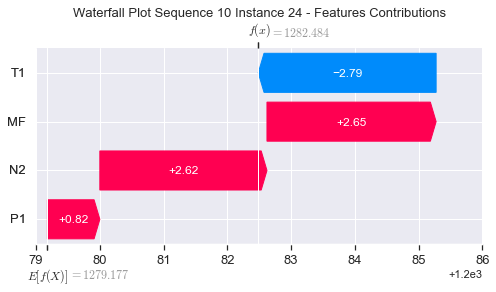

None

Contribution: [ 0.64471398 -1.2883924   2.3287035   2.09028252]


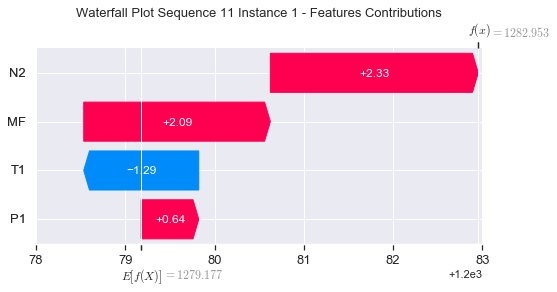

None

Contribution: [-0.09934236  0.1240631  -0.27457036 -0.291046  ]


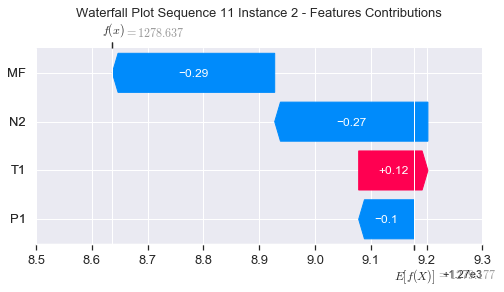

None

Contribution: [0.00109247 0.00062692 0.00368452 0.00359937]


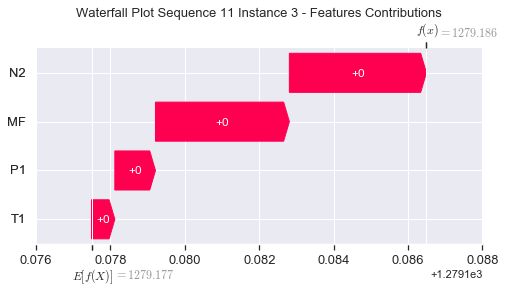

None

Contribution: [0.00165769 0.00125477 0.00509799 0.00486206]


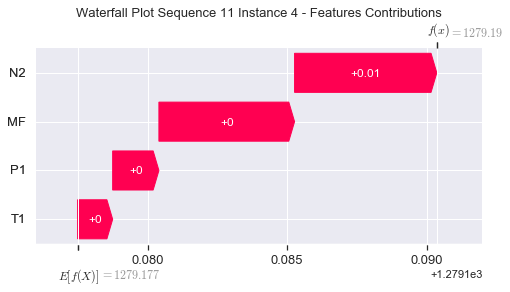

None

Contribution: [0.00182461 0.00144479 0.00561893 0.00533505]


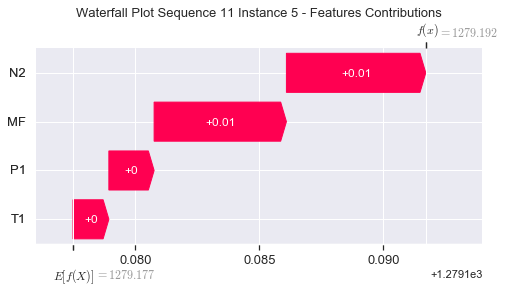

None

Contribution: [0.00202619 0.00161853 0.00617503 0.00585791]


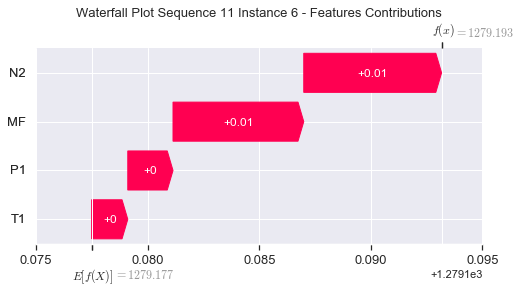

None

Contribution: [0.00216385 0.00175021 0.00664942 0.00628246]


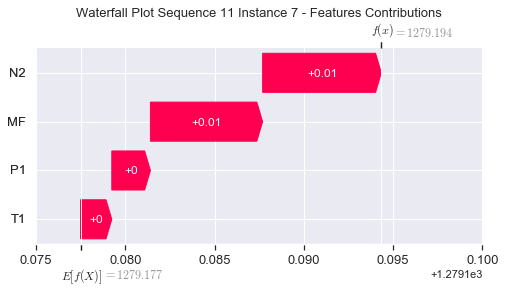

None

Contribution: [0.00221923 0.00178648 0.0067959  0.00643084]


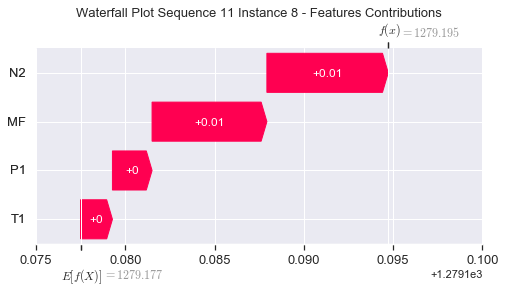

None

Contribution: [0.00214361 0.00180954 0.00671555 0.00623597]


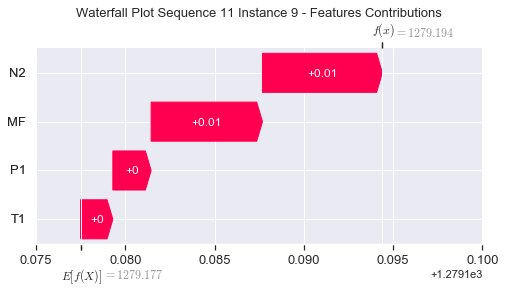

None

Contribution: [0.00209815 0.00177599 0.00663221 0.00623132]


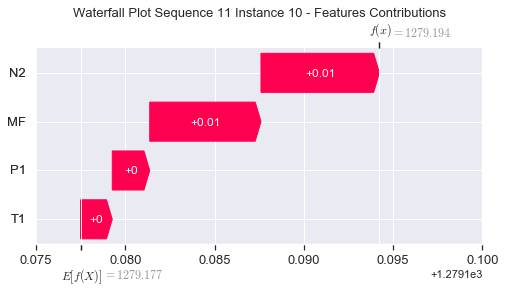

None

Contribution: [0.00216017 0.00173523 0.00656049 0.00616952]


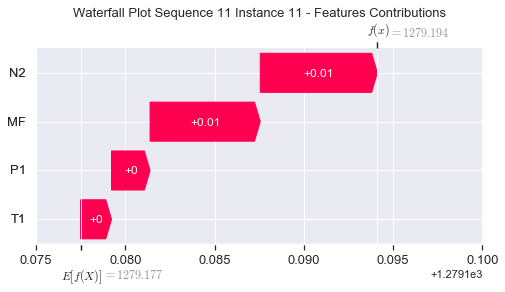

None

Contribution: [0.00213132 0.0016945  0.00647209 0.0061389 ]


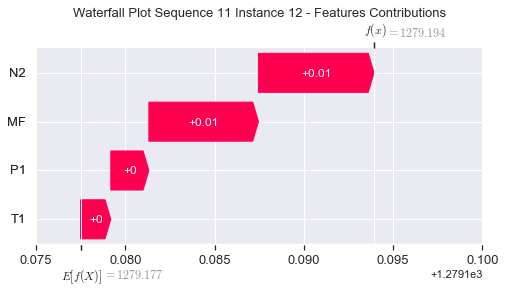

None

Contribution: [0.0020887  0.00168442 0.00637406 0.00603927]


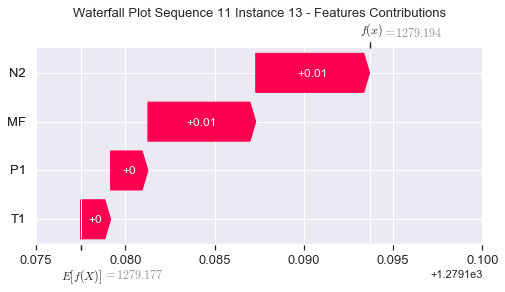

None

Contribution: [0.00199964 0.00164059 0.00609007 0.00580036]


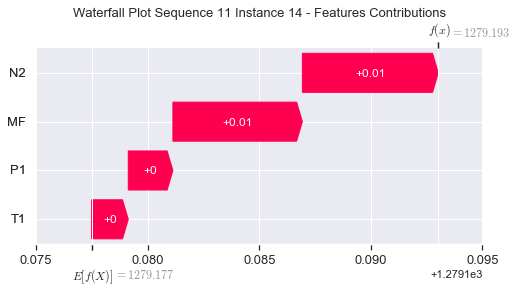

None

Contribution: [0.00179324 0.00144859 0.00543118 0.00517621]


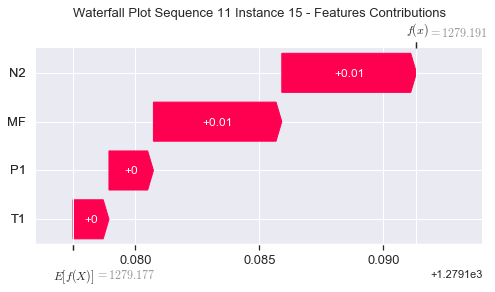

None

Contribution: [0.00151892 0.00110553 0.0043416  0.00425831]


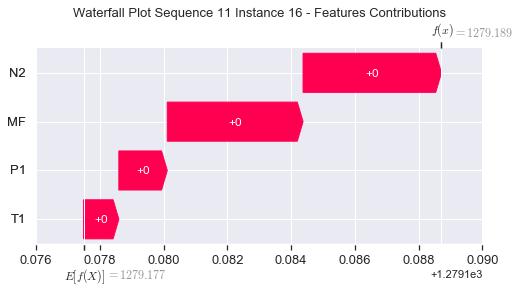

None

Contribution: [0.00129286 0.0011216  0.00392994 0.00375403]


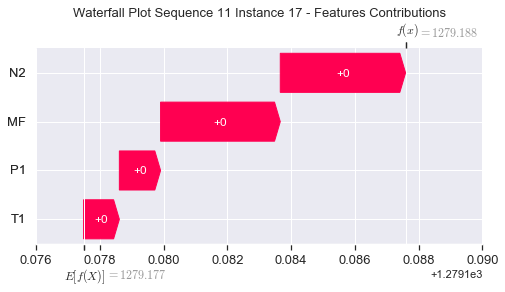

None

Contribution: [0.00323735 0.00298582 0.01016297 0.00952089]


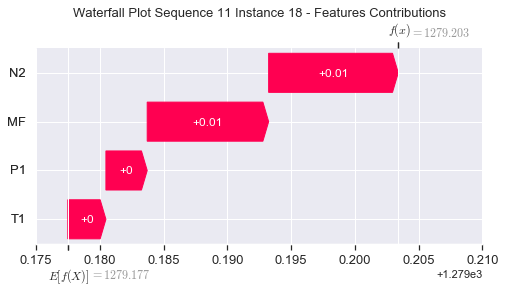

None

Contribution: [0.01383577 0.01262001 0.04302205 0.04096764]


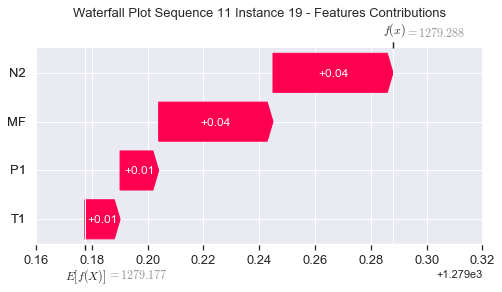

None

Contribution: [0.04876733 0.04522819 0.15550518 0.1445205 ]


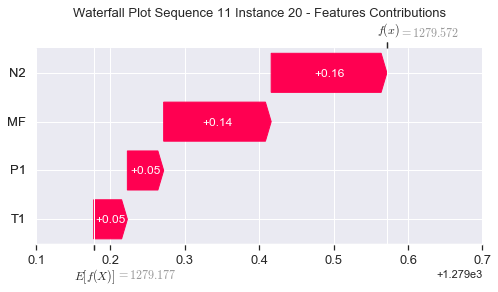

None

Contribution: [0.14387407 0.1308906  0.45670953 0.4256387 ]


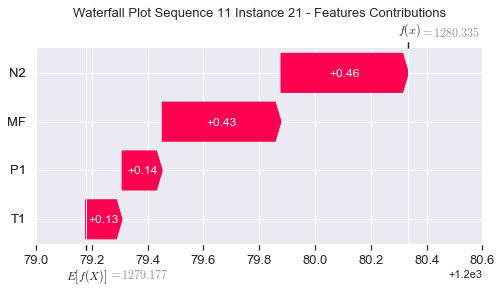

None

Contribution: [0.34905976 0.29876625 1.09681689 1.03429775]


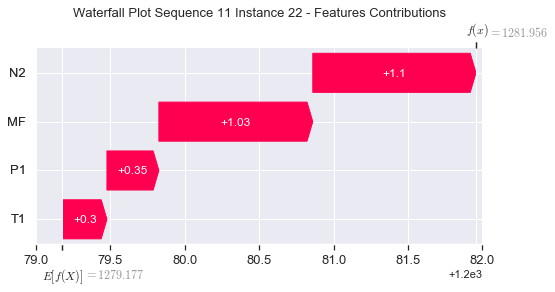

None

Contribution: [0.67188235 0.41198329 2.06891443 2.04859297]


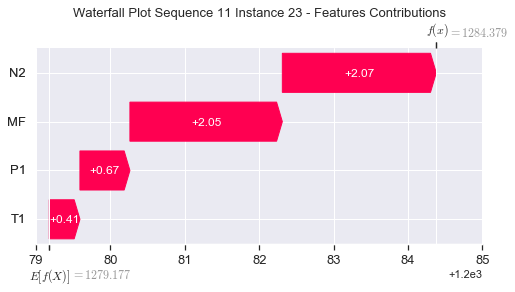

None

Contribution: [ 0.98453164 -0.56755718  2.55417474  2.99659294]


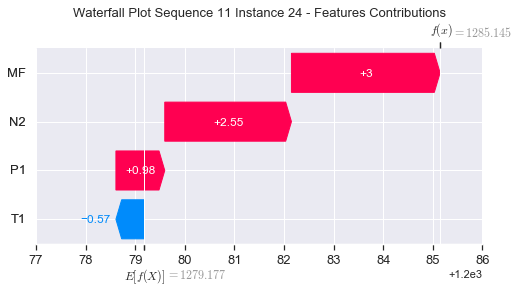

None

Contribution: [ 0.84134008 -0.23204433  2.30071008  2.39594561]


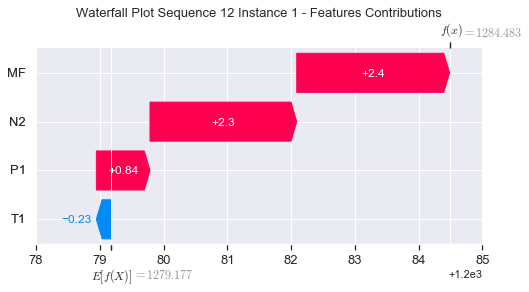

None

Contribution: [-0.1046992   0.00603254 -0.26368336 -0.30113603]


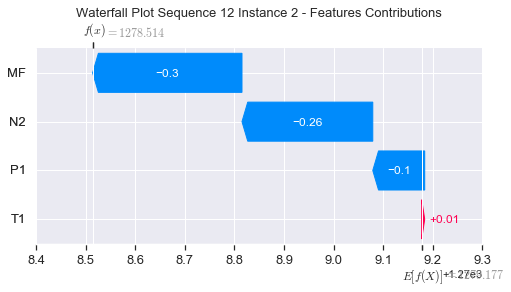

None

Contribution: [0.00111295 0.00086286 0.00366057 0.00359829]


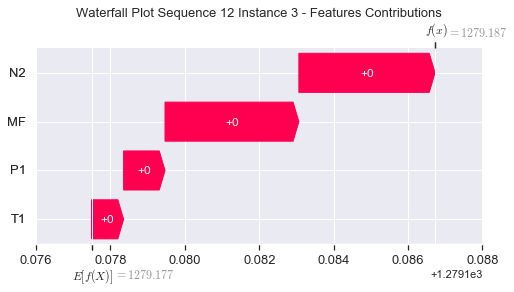

None

Contribution: [0.00164513 0.00140506 0.00507161 0.00484505]


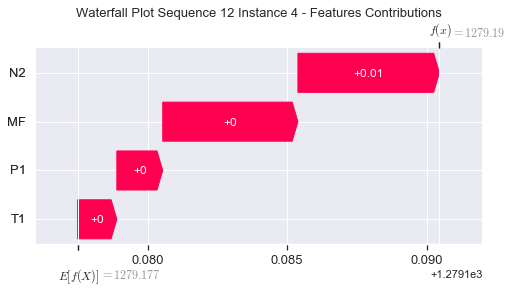

None

Contribution: [0.00181528 0.00159994 0.00560376 0.00530056]


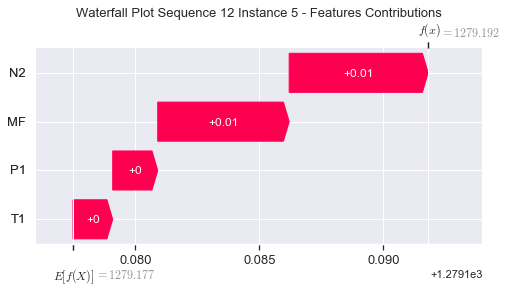

None

Contribution: [0.00199973 0.0016869  0.00615853 0.0058649 ]


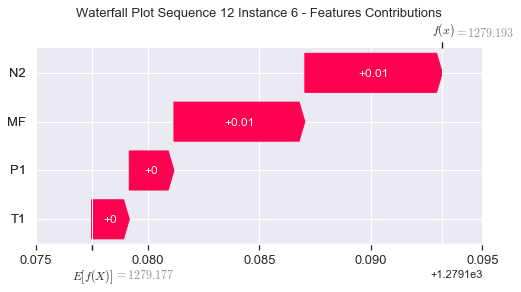

None

Contribution: [0.00215197 0.0017821  0.00662931 0.00630691]


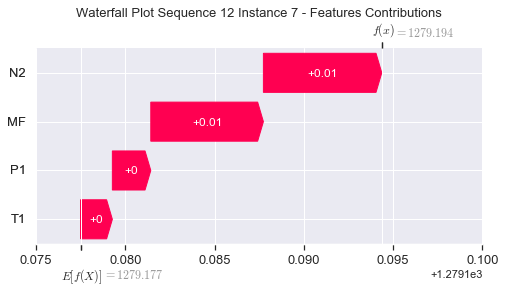

None

Contribution: [0.00219854 0.00182513 0.0067719  0.00643807]


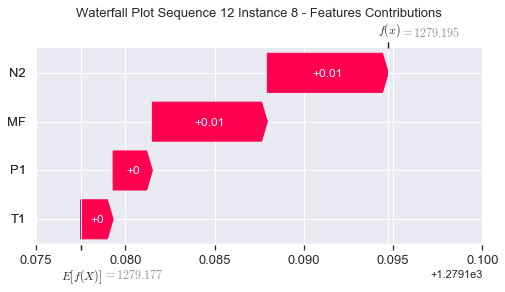

None

Contribution: [0.00218074 0.00180106 0.00670596 0.00634422]


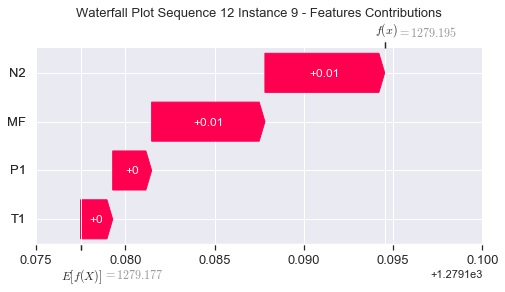

None

Contribution: [0.00220835 0.00178753 0.00664852 0.00639145]


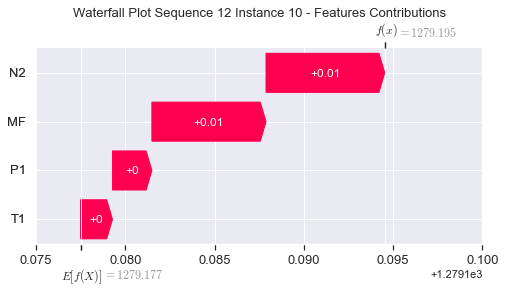

None

Contribution: [0.00212576 0.00177433 0.00655668 0.00619876]


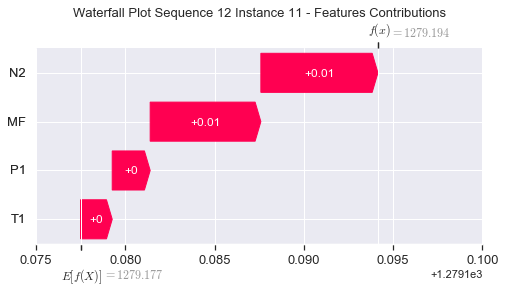

None

Contribution: [0.00209141 0.00164767 0.00647164 0.00613672]


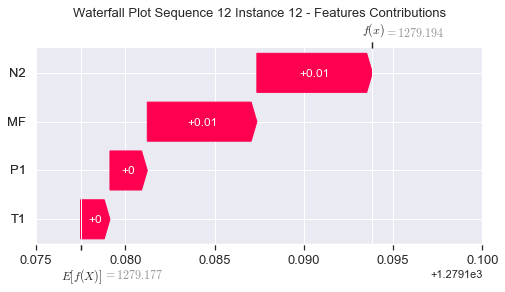

None

Contribution: [0.00206608 0.00162756 0.00638114 0.00605439]


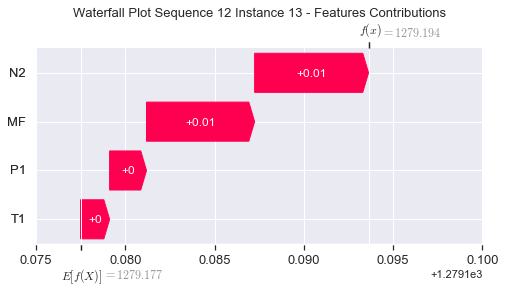

None

Contribution: [0.00199532 0.00149153 0.00609873 0.00585867]


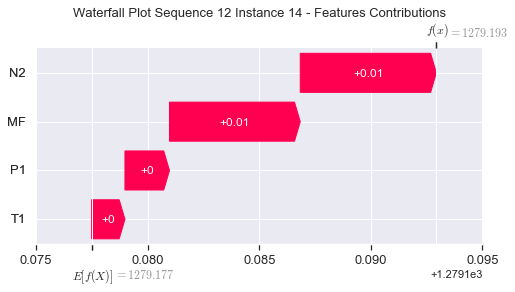

None

Contribution: [0.00177334 0.00138015 0.00544939 0.00519389]


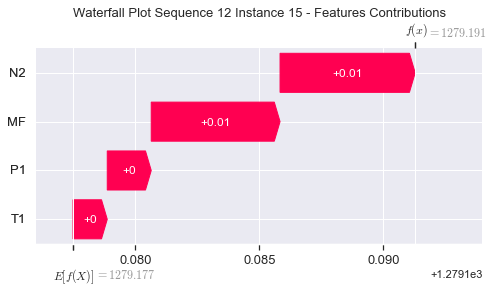

None

Contribution: [0.00144703 0.0010434  0.00438687 0.00424996]


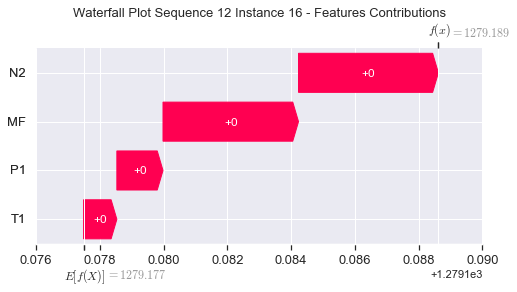

None

Contribution: [0.00133674 0.00106024 0.00410341 0.00393538]


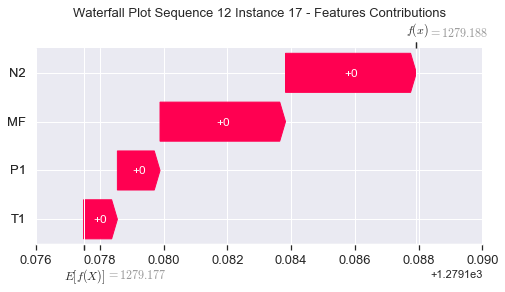

None

Contribution: [0.00336454 0.0028588  0.01066889 0.01002511]


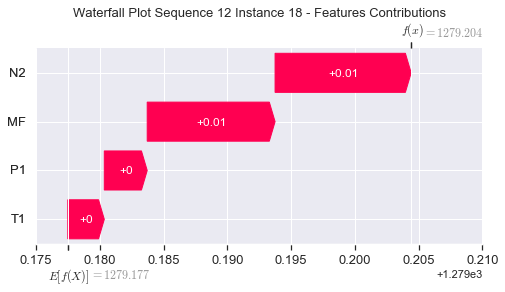

None

Contribution: [0.01372938 0.01153374 0.04432366 0.04088994]


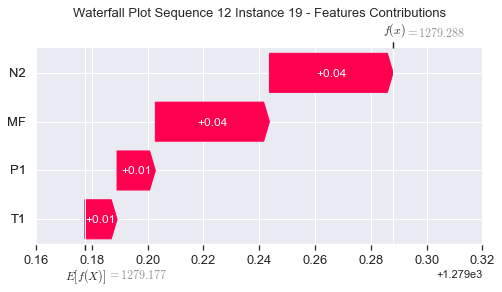

None

Contribution: [0.04948851 0.04226511 0.15782083 0.14705287]


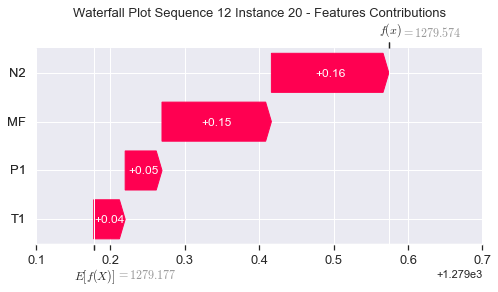

None

Contribution: [0.14486387 0.1212799  0.46112659 0.43003573]


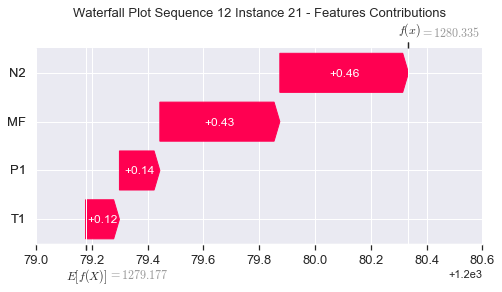

None

Contribution: [0.34822204 0.2718535  1.10524858 1.03685407]


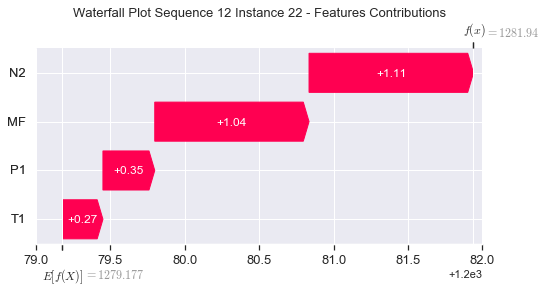

None

Contribution: [0.65565398 0.28047366 2.08944819 2.04762954]


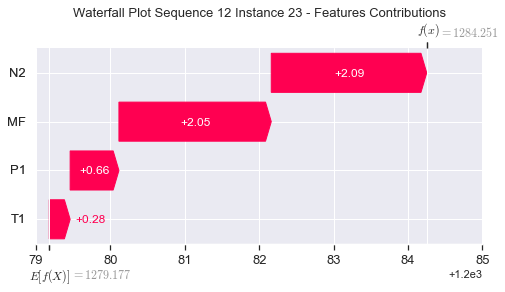

None

Contribution: [ 0.90394191 -0.94096488  2.64434777  3.03863482]


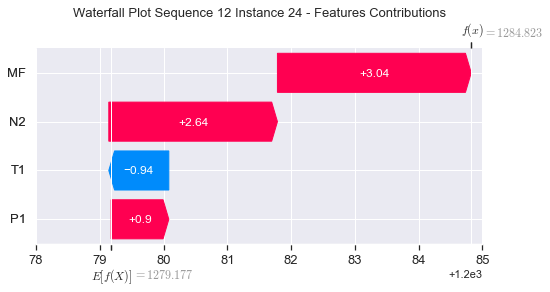

None

Contribution: [ 0.76233187 -0.34078775  2.35966641  2.56932977]


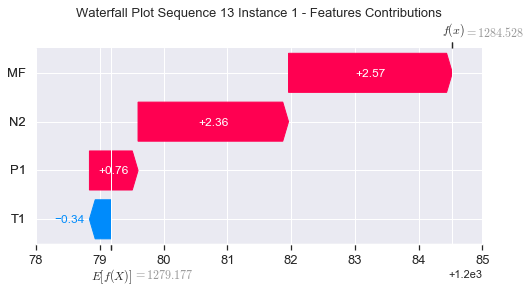

None

Contribution: [-0.09824372  0.03824057 -0.2631675  -0.2848636 ]


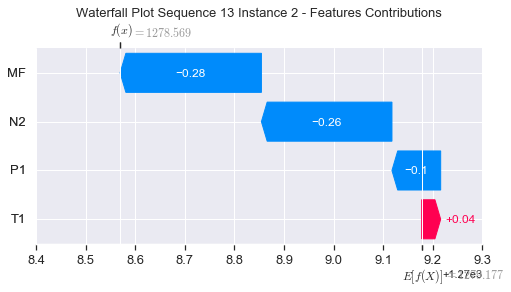

None

Contribution: [0.00108064 0.00084328 0.00367269 0.00351962]


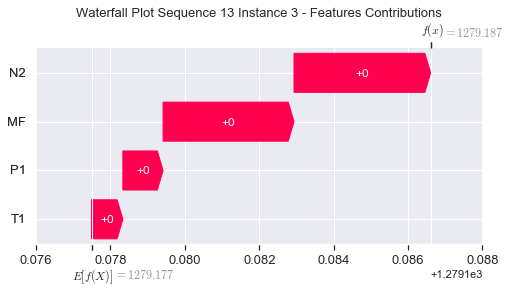

None

Contribution: [0.00159469 0.00141419 0.00509654 0.00485508]


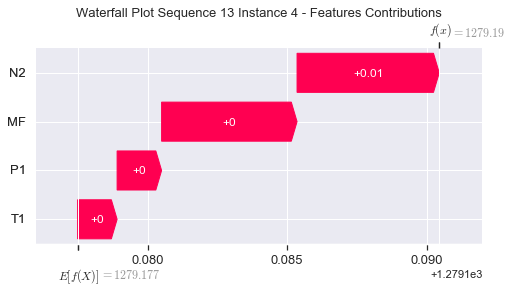

None

Contribution: [0.00177634 0.00151091 0.00561865 0.00529086]


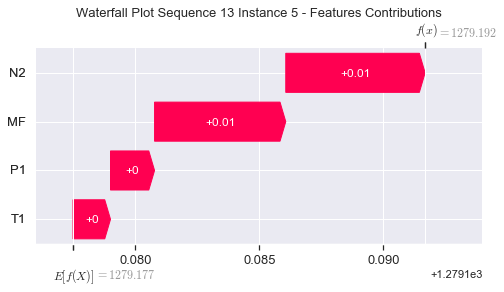

None

Contribution: [0.00195297 0.00165397 0.00616465 0.00576175]


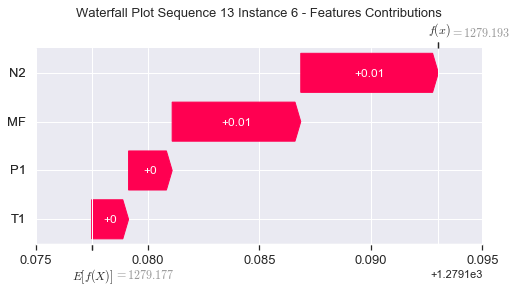

None

Contribution: [0.00210144 0.00176653 0.00663345 0.00620282]


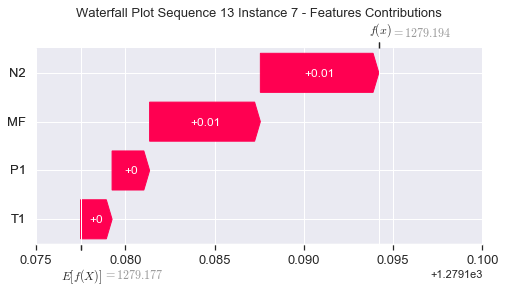

None

Contribution: [0.00215083 0.00181427 0.00677872 0.0063638 ]


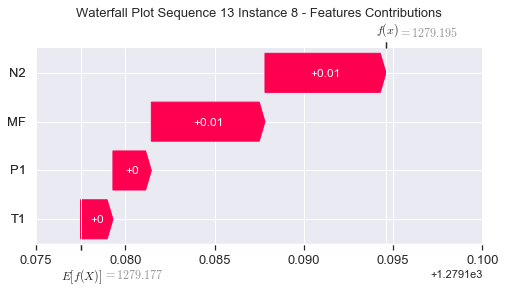

None

Contribution: [0.00215774 0.00181115 0.00672525 0.00639482]


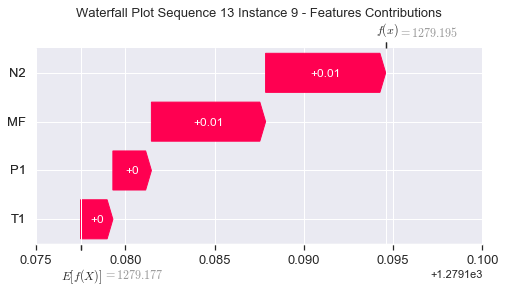

None

Contribution: [0.00210149 0.00158092 0.00661767 0.00625023]


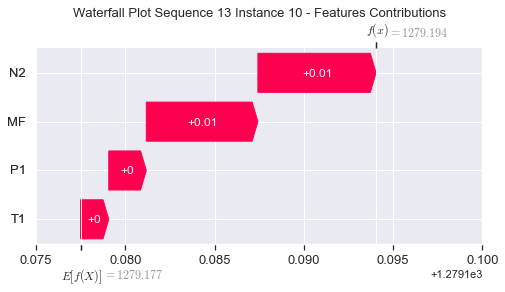

None

Contribution: [0.00210354 0.00180587 0.00655916 0.0062345 ]


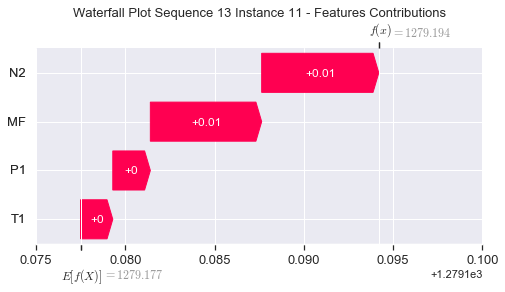

None

Contribution: [0.00205195 0.00177433 0.00646367 0.00608604]


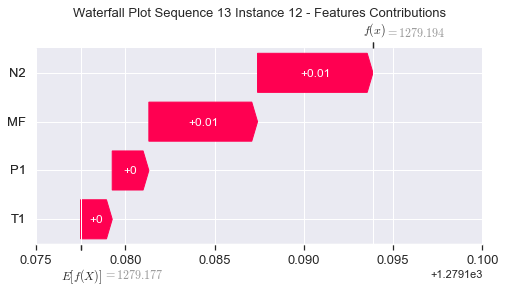

None

Contribution: [0.0020229  0.00174548 0.00637266 0.0060074 ]


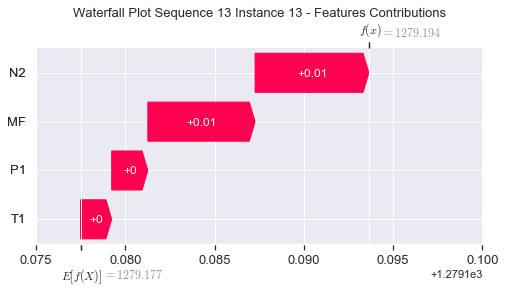

None

Contribution: [0.00195266 0.00172762 0.00610277 0.00581859]


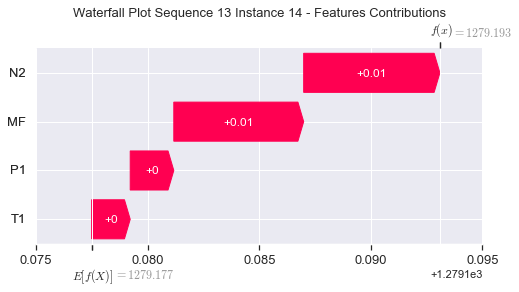

None

Contribution: [0.00173392 0.00150608 0.00545597 0.0051576 ]


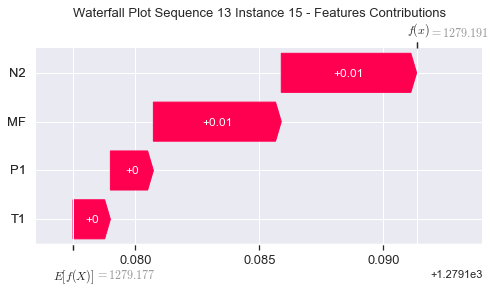

None

Contribution: [0.00139625 0.00119701 0.00439719 0.00418121]


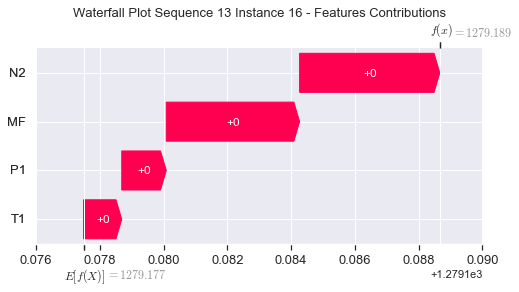

None

Contribution: [0.00129863 0.00118614 0.00410832 0.00390021]


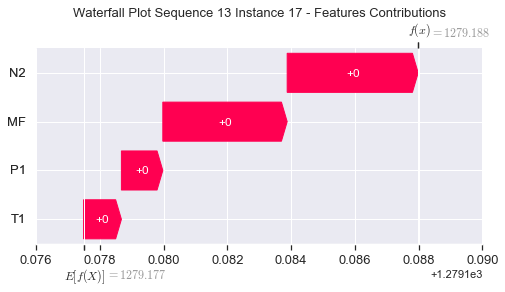

None

Contribution: [0.00323697 0.00311264 0.01055088 0.00982162]


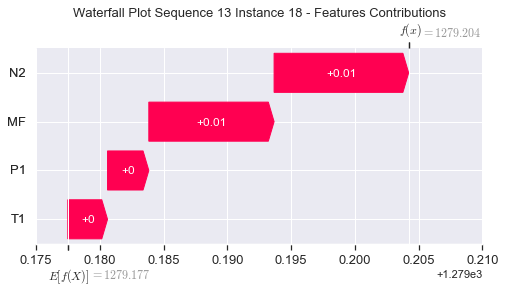

None

Contribution: [0.01315285 0.0123725  0.04377628 0.04048994]


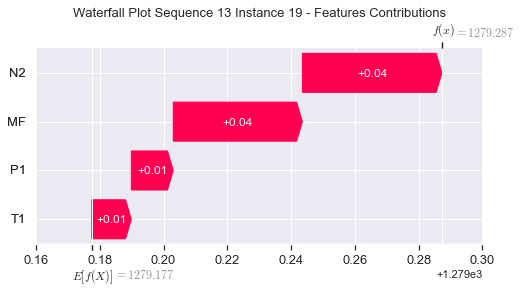

None

Contribution: [0.04765945 0.04491786 0.15609379 0.14488472]


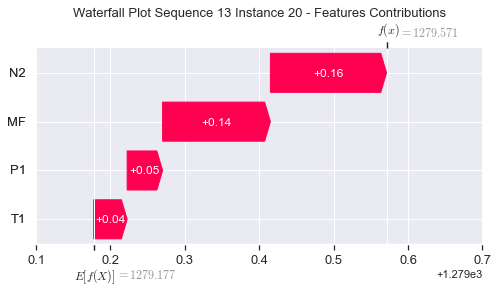

None

Contribution: [0.13977437 0.13097165 0.45696875 0.42576851]


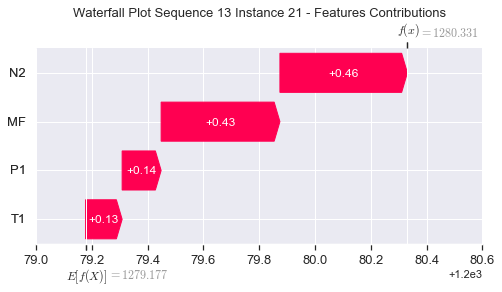

None

Contribution: [0.33472242 0.30403031 1.09816022 1.03372848]


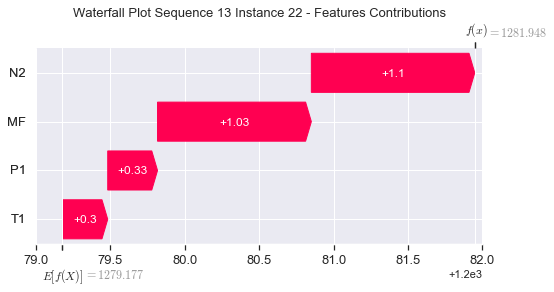

None

Contribution: [0.60804043 0.42799591 2.08200539 2.03774858]


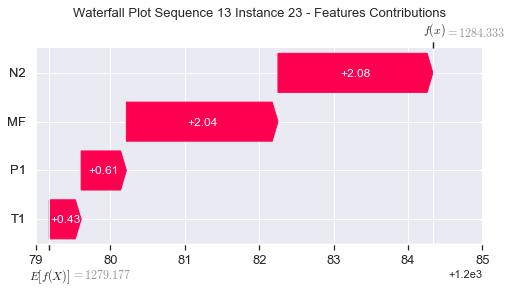

None

Contribution: [ 0.71596691 -0.43194263  2.62674125  2.89282239]


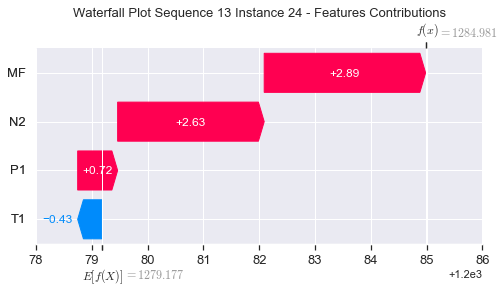

None

Contribution: [0.70173355 0.00795305 2.36040784 2.29425055]


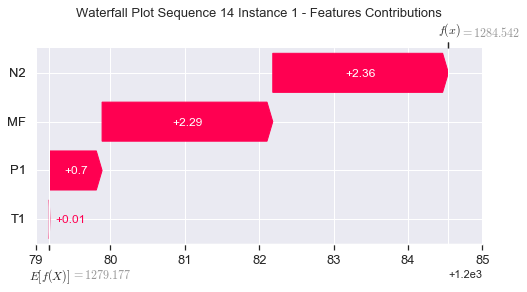

None

Contribution: [-0.08952069 -0.00975692 -0.26967354 -0.31154009]


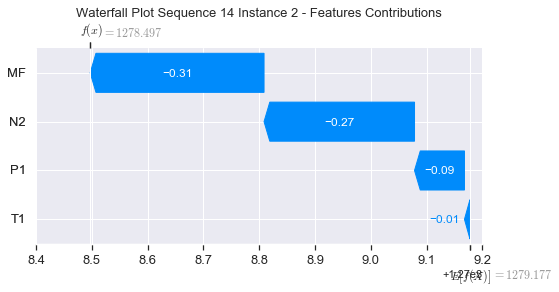

None

Contribution: [0.00106765 0.00103526 0.00366515 0.00356858]


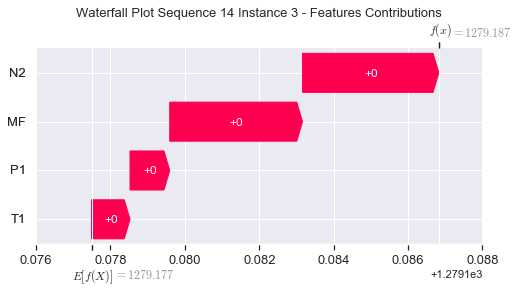

None

Contribution: [0.00162164 0.00158098 0.00508231 0.0049234 ]


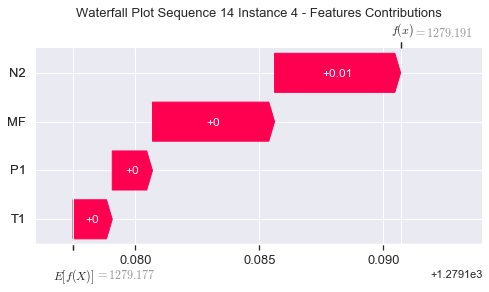

None

Contribution: [0.00177853 0.00176761 0.00557855 0.00526948]


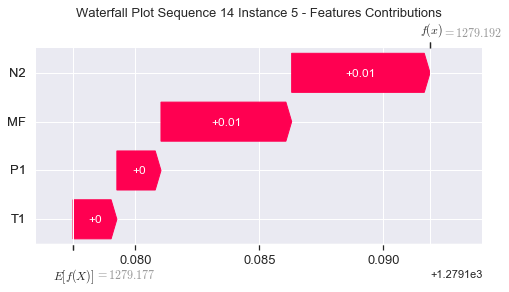

None

Contribution: [0.00194487 0.00186672 0.00612209 0.00575454]


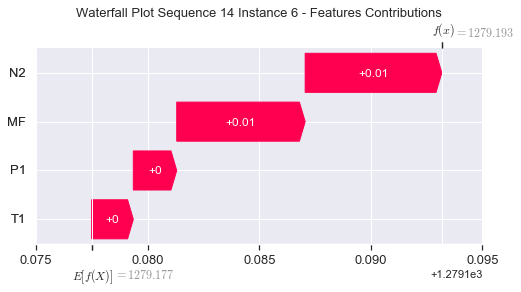

None

Contribution: [0.00209564 0.00198559 0.0065907  0.00620219]


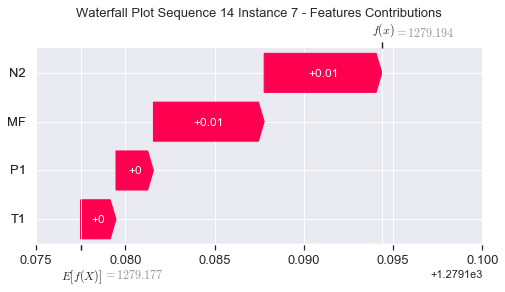

None

Contribution: [0.00214156 0.00202535 0.00673201 0.00633679]


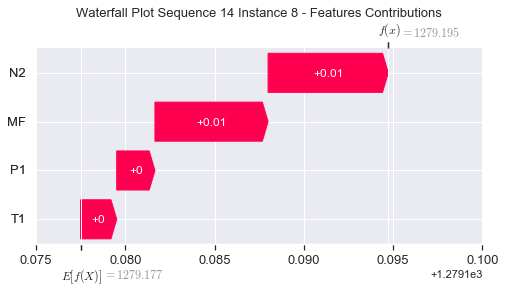

None

Contribution: [0.0021448  0.00209392 0.0066801  0.00628789]


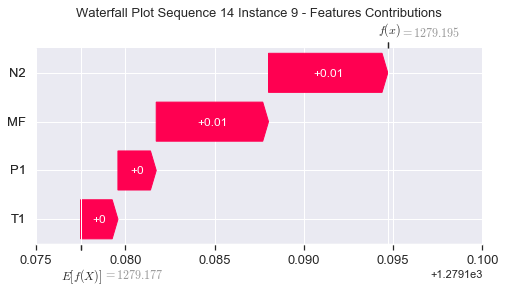

None

Contribution: [0.00211684 0.00205013 0.00660134 0.00626446]


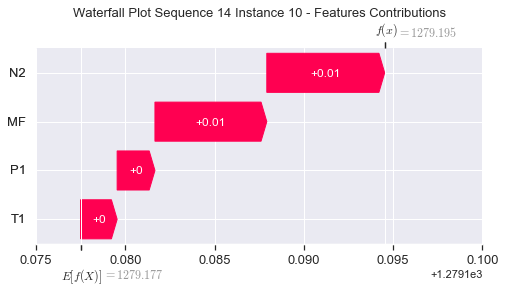

None

Contribution: [0.00208259 0.0020161  0.00653112 0.00612353]


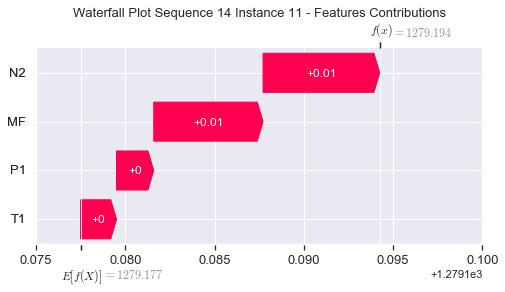

None

Contribution: [0.00204286 0.00186306 0.00644684 0.00607512]


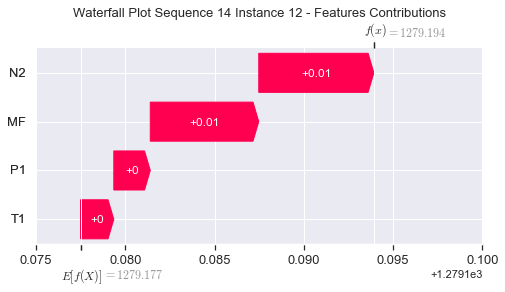

None

Contribution: [0.002019   0.00184083 0.00636065 0.00600125]


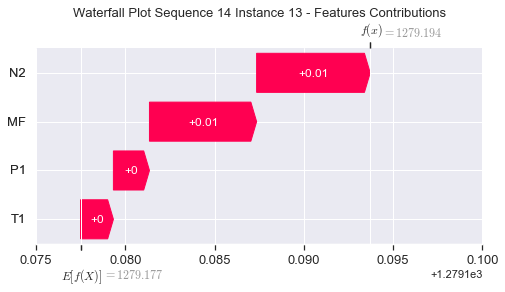

None

Contribution: [0.00193718 0.00175585 0.00607221 0.00571784]


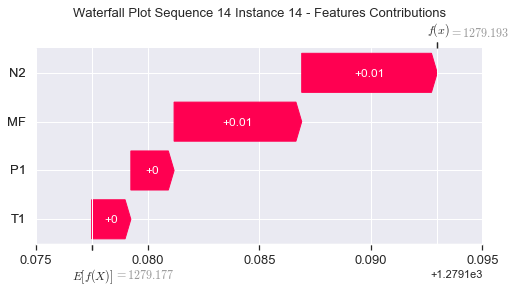

None

Contribution: [0.00173174 0.00155836 0.00544148 0.00514582]


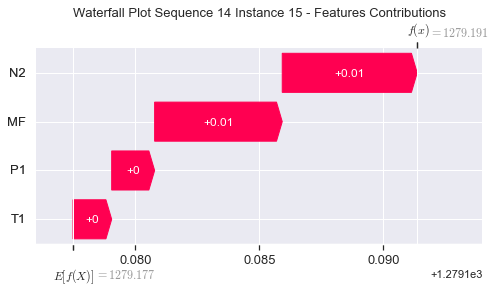

None

Contribution: [0.00138957 0.00117285 0.00437891 0.00419104]


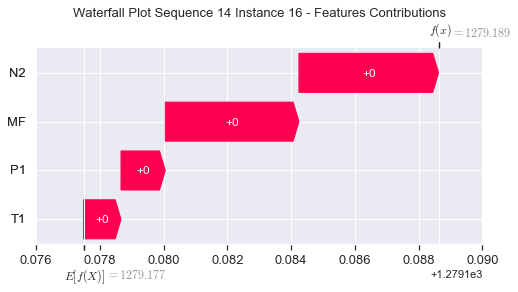

None

Contribution: [0.0012916  0.00120716 0.00408186 0.00387416]


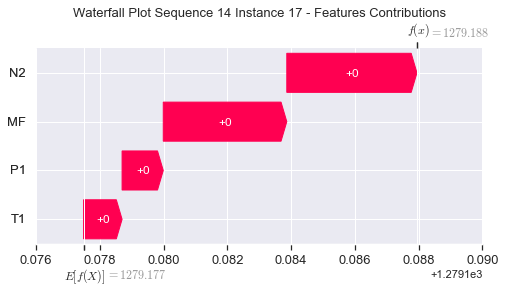

None

Contribution: [0.00323733 0.00313272 0.01054637 0.00980878]


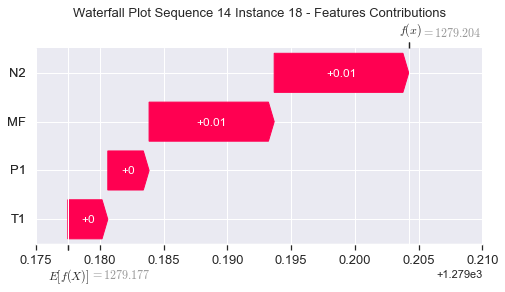

None

Contribution: [0.01348933 0.01234161 0.04397902 0.04077563]


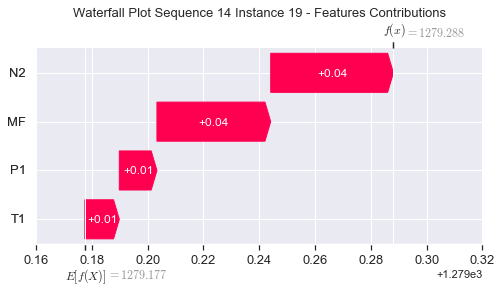

None

Contribution: [0.04807989 0.04536244 0.15691851 0.14535442]


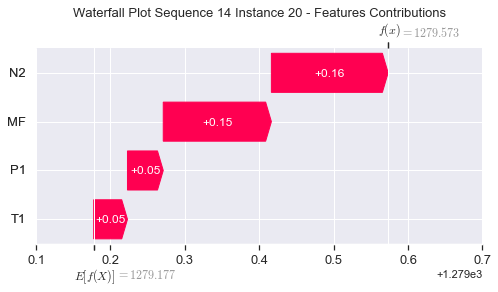

None

Contribution: [0.14092524 0.13089094 0.45937916 0.42641287]


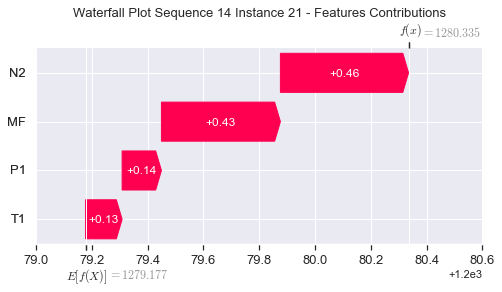

None

Contribution: [0.33758008 0.29885607 1.10295438 1.03131049]


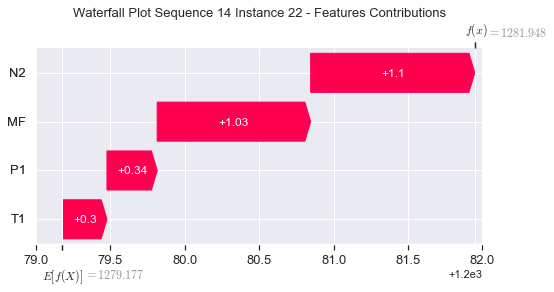

None

Contribution: [0.61208168 0.3798663  2.08683053 2.01652445]


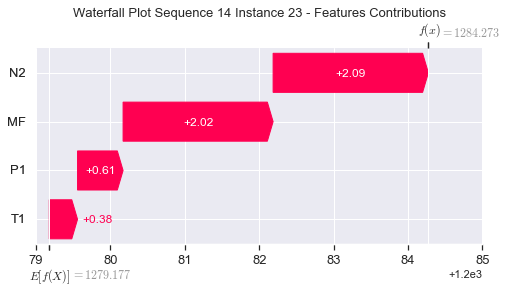

None

Contribution: [ 0.72486969 -0.62076239  2.60611329  2.76895613]


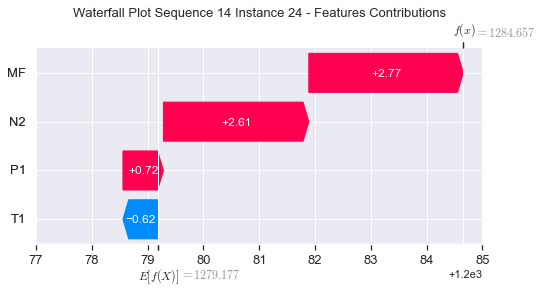

None

Contribution: [ 0.68626457 -0.15513547  2.32102677  2.20951044]


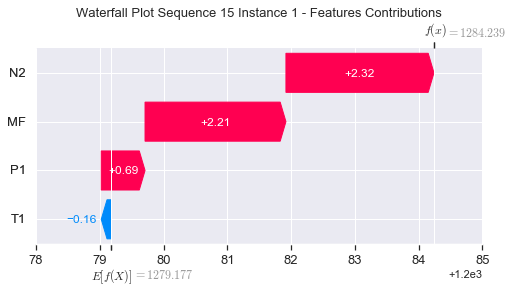

None

Contribution: [-0.09082223  0.01153747 -0.26900835 -0.29805235]


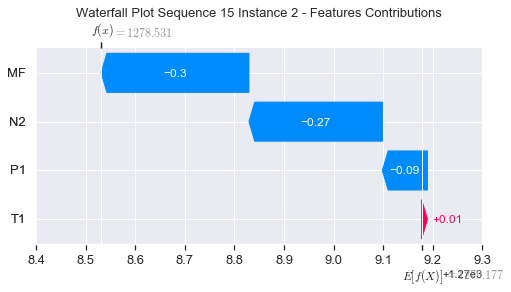

None

Contribution: [0.00108416 0.00091766 0.00367659 0.00353968]


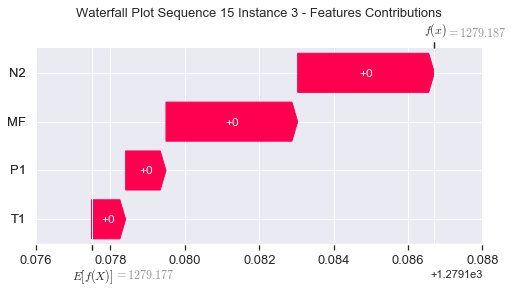

None

Contribution: [0.00157475 0.00137502 0.00507592 0.0048074 ]


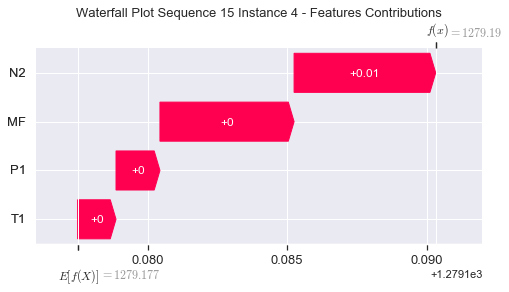

None

Contribution: [0.00177664 0.00162708 0.00560362 0.00528965]


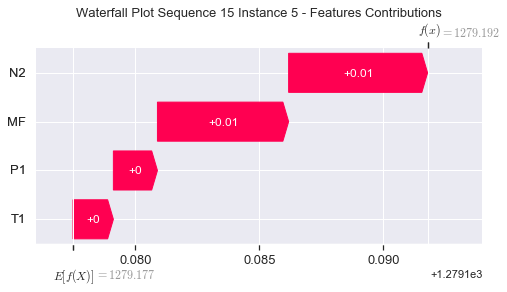

None

Contribution: [0.00196099 0.00172612 0.00615559 0.00581583]


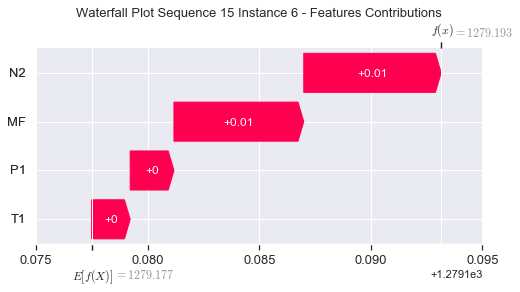

None

Contribution: [0.00211086 0.00186391 0.00662777 0.00626355]


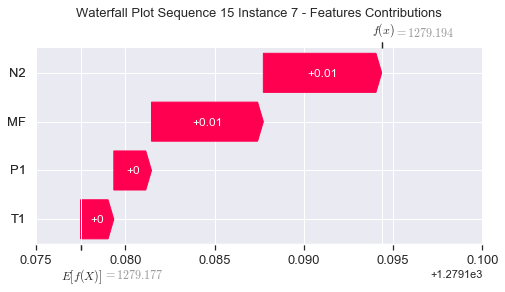

None

Contribution: [0.00215199 0.00189741 0.00676804 0.00639043]


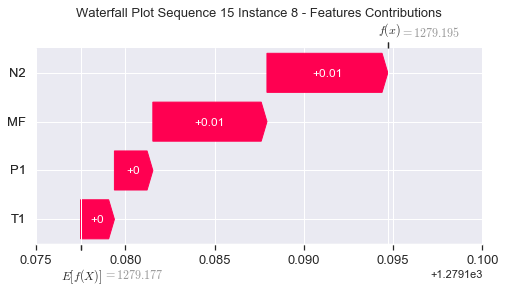

None

Contribution: [0.00212434 0.00193943 0.00670973 0.00633678]


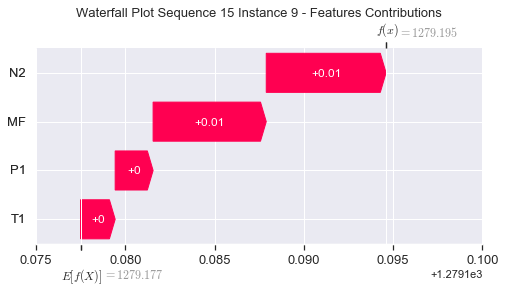

None

Contribution: [0.00212102 0.00189837 0.00663029 0.00631028]


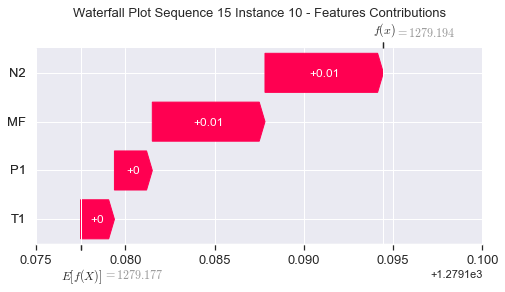

None

Contribution: [0.00205975 0.00184685 0.00654187 0.00613272]


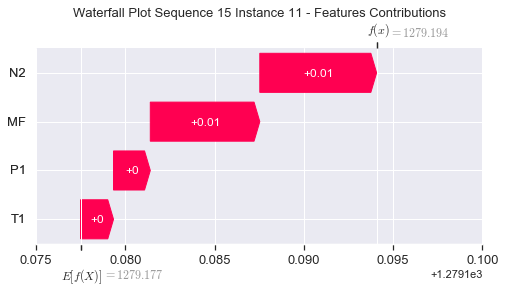

None

Contribution: [0.0020429  0.00182691 0.00645839 0.00607029]


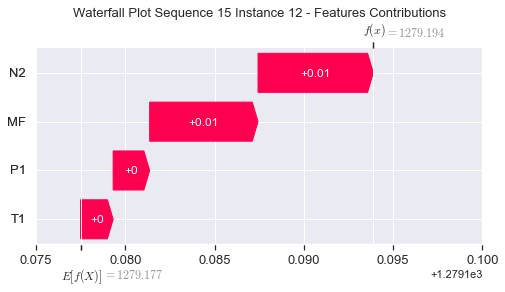

None

Contribution: [0.00201706 0.00180891 0.00636777 0.0059957 ]


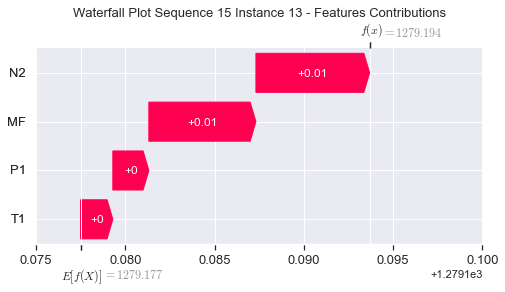

None

Contribution: [0.00196075 0.0016509  0.00609814 0.00582062]


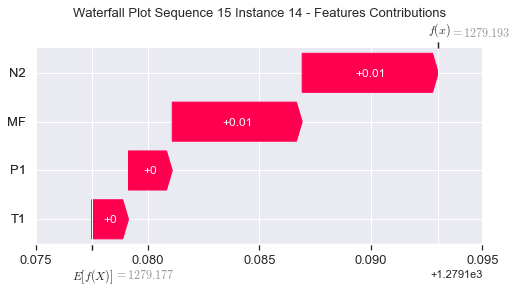

None

Contribution: [0.00172886 0.00153308 0.00544463 0.00514996]


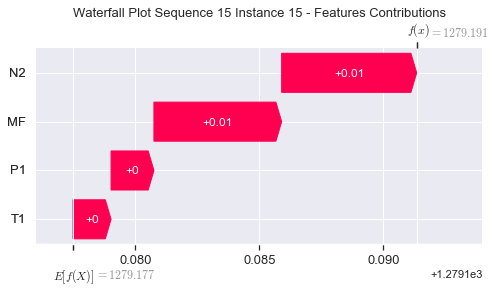

None

Contribution: [0.00140197 0.00125943 0.00438308 0.00420823]


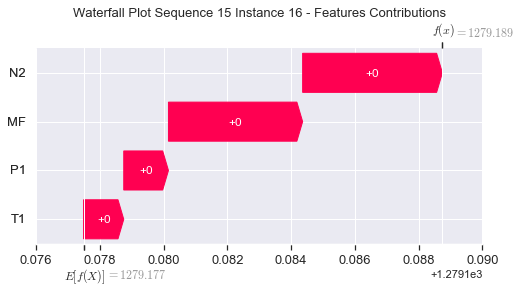

None

Contribution: [0.00128503 0.00119881 0.00406254 0.00385992]


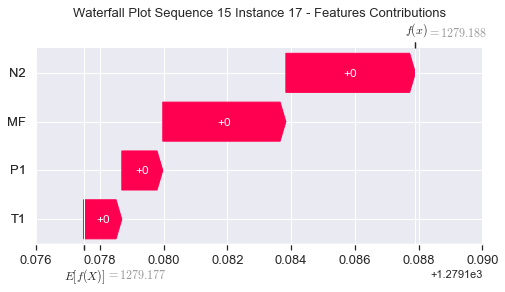

None

Contribution: [0.00322118 0.0031183  0.01048727 0.00976344]


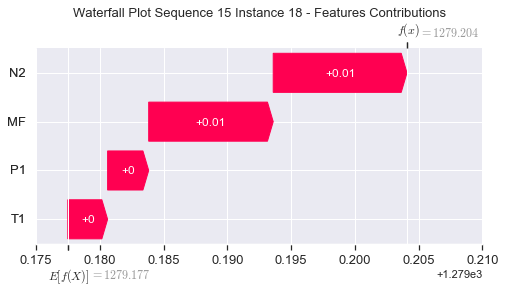

None

Contribution: [0.01344944 0.01294658 0.0437516  0.04038719]


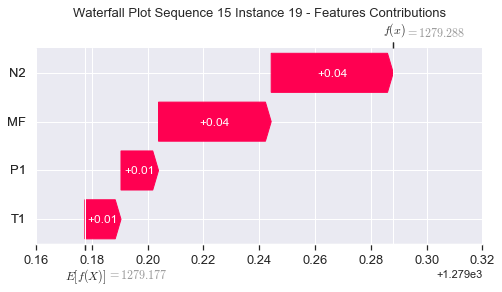

None

Contribution: [0.04795417 0.04565368 0.15678866 0.14519013]


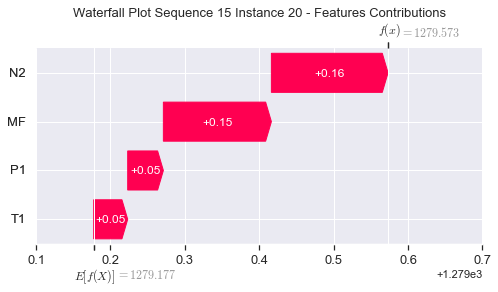

None

Contribution: [0.1404233  0.13255686 0.45927569 0.42556154]


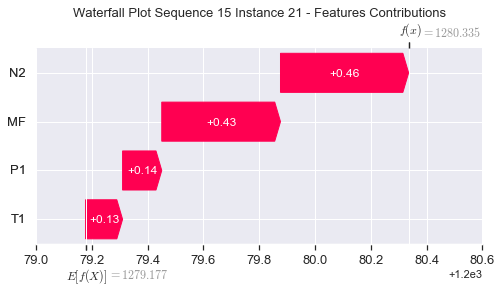

None

Contribution: [0.33513451 0.30500429 1.10255352 1.02648292]


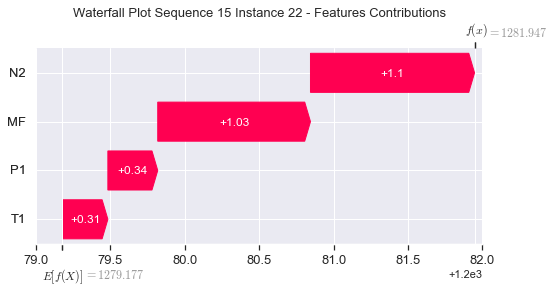

None

Contribution: [0.607213   0.40917151 2.08581192 2.00297325]


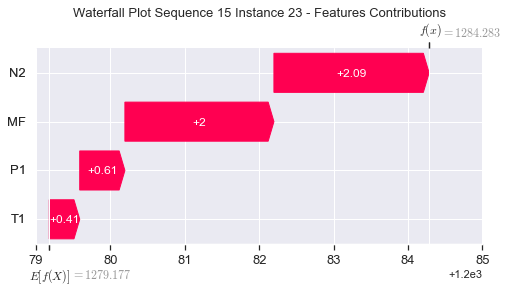

None

Contribution: [ 0.73665273 -0.55147226  2.63097265  2.88761132]


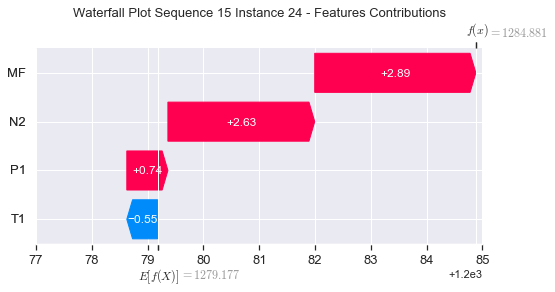

None

Contribution: [ 0.74103513 -0.10054288  2.36084336  2.53539341]


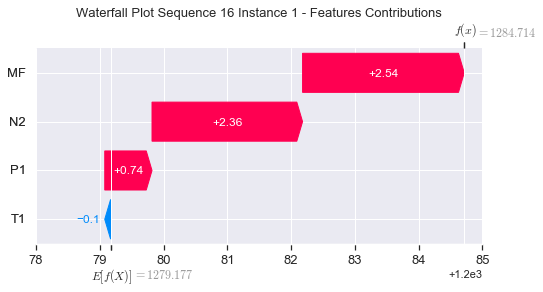

None

Contribution: [-0.08409935 -0.0084386  -0.26379033 -0.27950366]


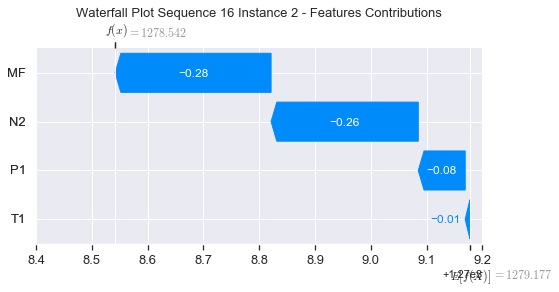

None

Contribution: [0.00106627 0.00097388 0.00368784 0.00357658]


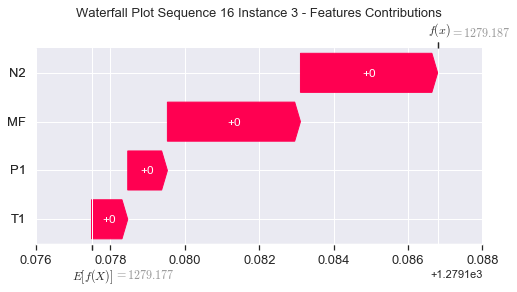

None

Contribution: [0.00161298 0.00151428 0.00509789 0.00481169]


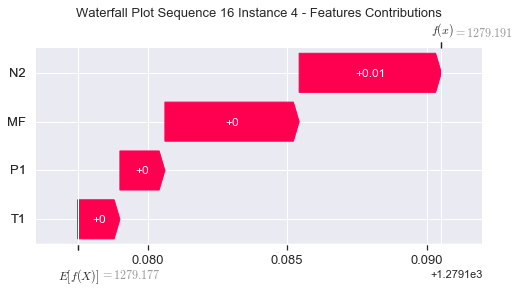

None

Contribution: [0.00179633 0.00159928 0.00562366 0.0053383 ]


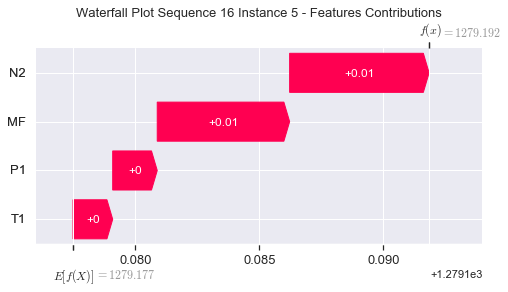

None

Contribution: [0.00197528 0.00170747 0.00617879 0.00585057]


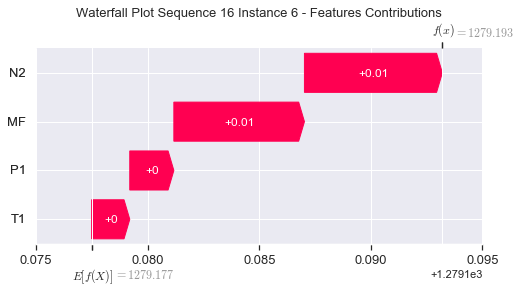

None

Contribution: [0.00212241 0.00184103 0.00665352 0.00629518]


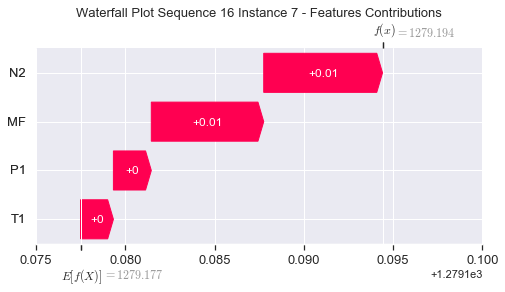

None

Contribution: [0.00216737 0.00185253 0.00679585 0.00643337]


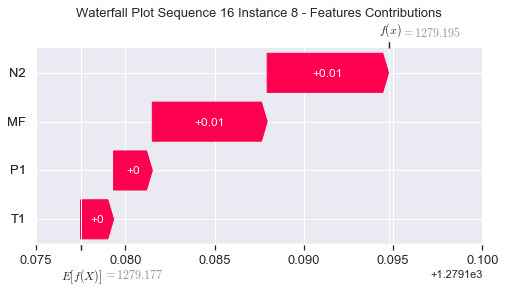

None

Contribution: [0.00214531 0.00179538 0.00673972 0.00639769]


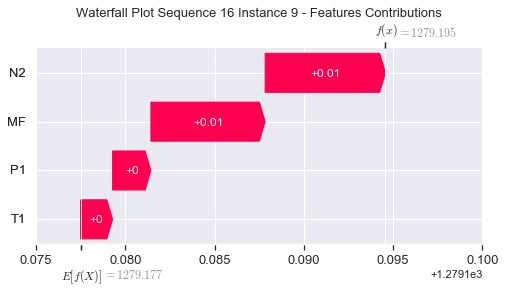

None

Contribution: [0.00211748 0.0018633  0.00665468 0.00632121]


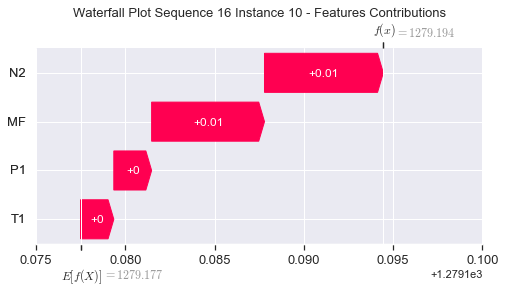

None

Contribution: [0.00209561 0.00167204 0.00658131 0.00624956]


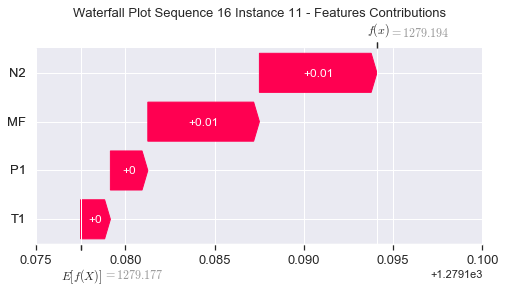

None

Contribution: [0.00205528 0.00174293 0.00649867 0.0061561 ]


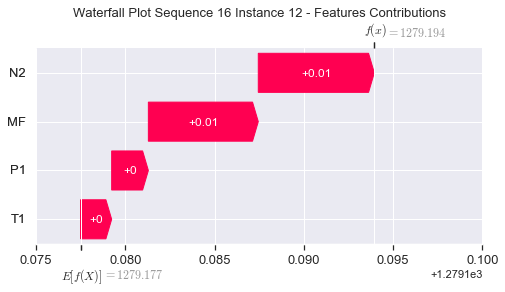

None

Contribution: [0.00202728 0.00173439 0.00640795 0.00606741]


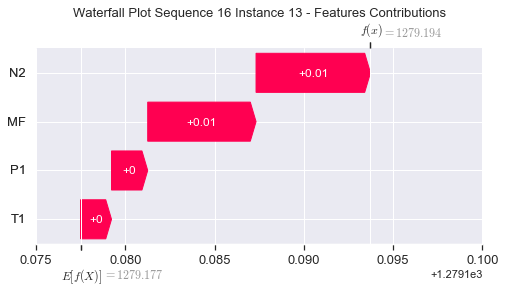

None

Contribution: [0.00193054 0.0016383  0.00611491 0.00577226]


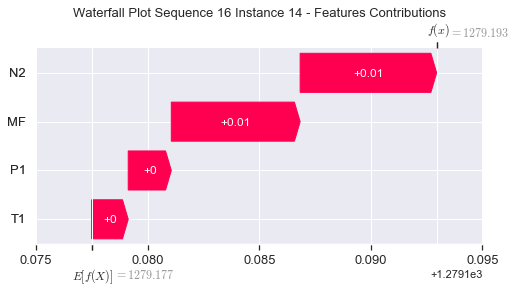

None

Contribution: [0.00173807 0.00146345 0.00547171 0.00518313]


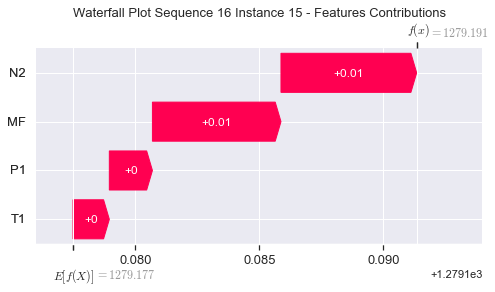

None

Contribution: [0.00137804 0.00111911 0.00437997 0.00411022]


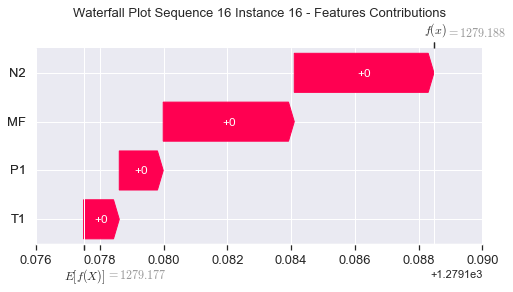

None

Contribution: [0.00130093 0.00115439 0.00412771 0.0039147 ]


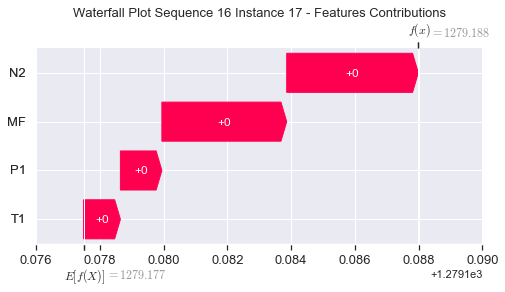

None

Contribution: [0.00328811 0.00305058 0.01073316 0.00997088]


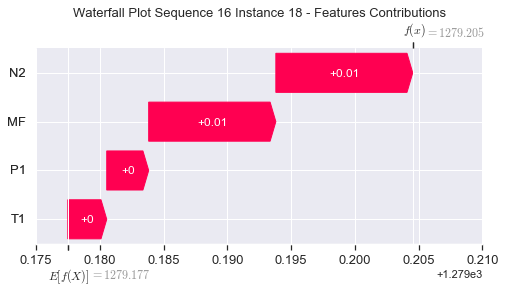

None

Contribution: [0.0136774  0.01227596 0.04450118 0.04156978]


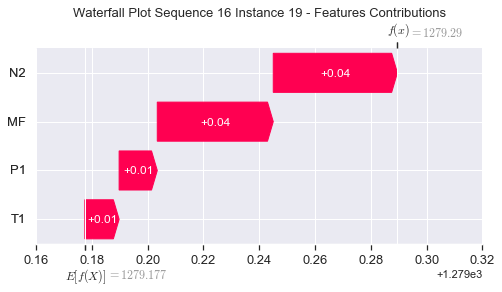

None

Contribution: [0.04848279 0.04443173 0.15866752 0.14635505]


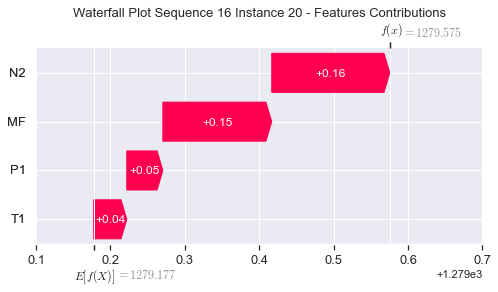

None

Contribution: [0.1415136  0.12740797 0.46301006 0.42773447]


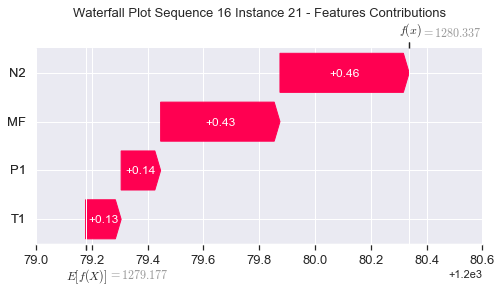

None

Contribution: [0.33770628 0.28462738 1.10800355 1.02950998]


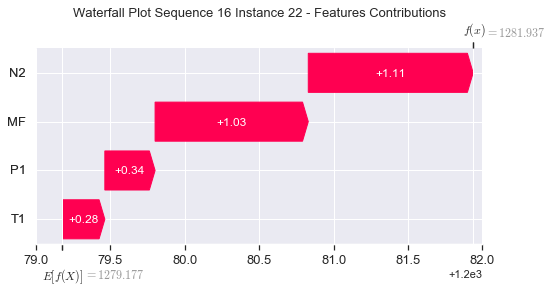

None

Contribution: [0.60874781 0.32430738 2.08710939 1.9948604 ]


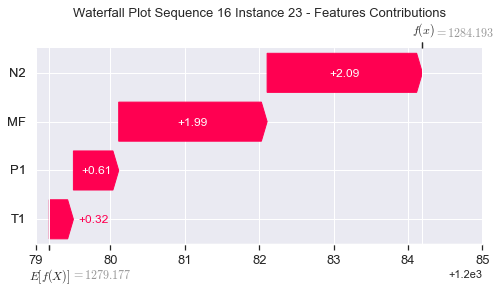

None

Contribution: [ 0.73857561 -0.81292808  2.60011905  2.76921014]


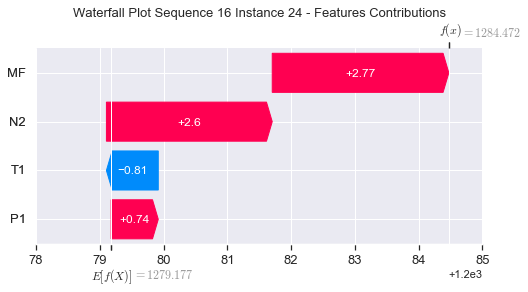

None

Contribution: [ 0.73029788 -0.1474707   2.36042282  2.46042694]


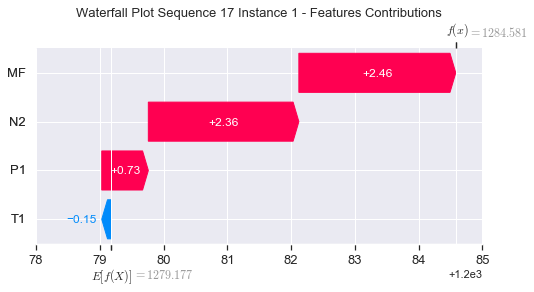

None

Contribution: [-0.08496535  0.02079844 -0.26395639 -0.28289742]


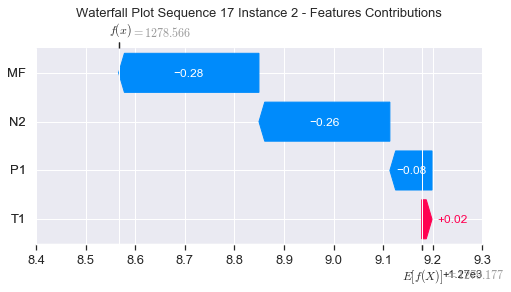

None

Contribution: [0.00110876 0.00086222 0.00371195 0.00358067]


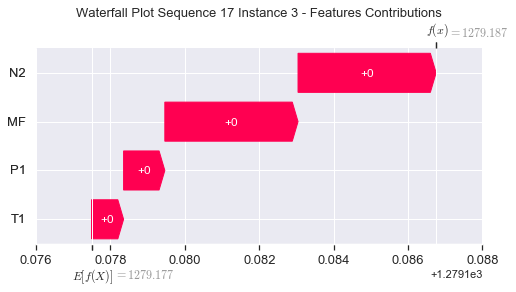

None

Contribution: [0.0016572  0.00138048 0.00515977 0.00497917]


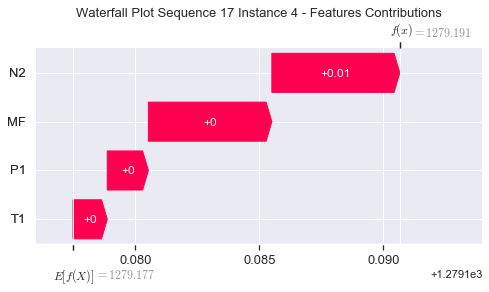

None

Contribution: [0.0018087  0.00148259 0.00566086 0.00534388]


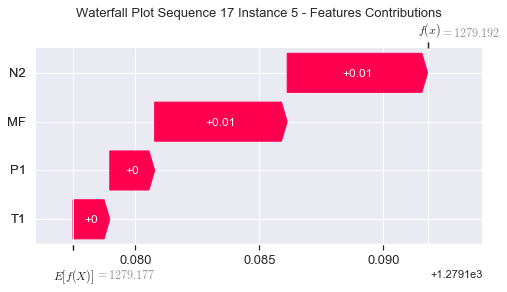

None

Contribution: [0.00197538 0.0016033  0.00621463 0.00583055]


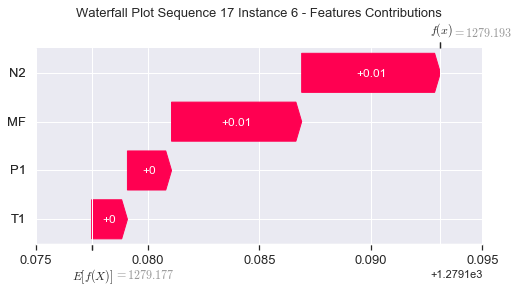

None

Contribution: [0.00212672 0.00171548 0.00669001 0.00627409]


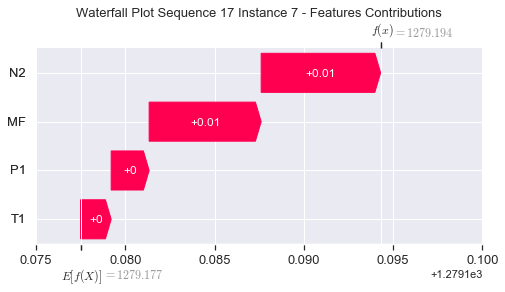

None

Contribution: [0.00217166 0.00175111 0.00683242 0.00641146]


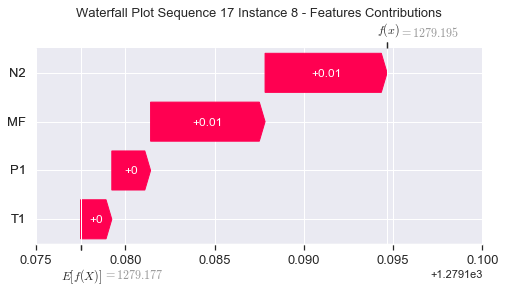

None

Contribution: [0.0021588  0.00173206 0.00676737 0.00637265]


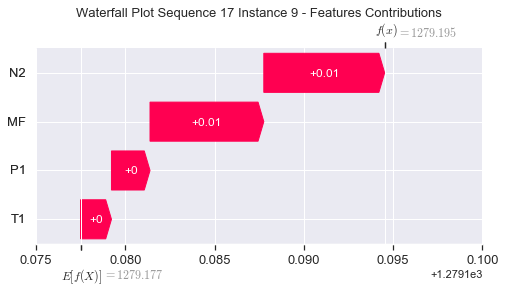

None

Contribution: [0.00211947 0.00177537 0.00670861 0.0063179 ]


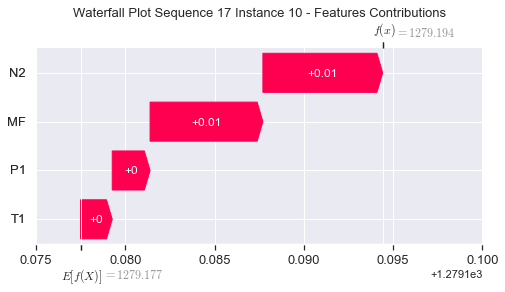

None

Contribution: [0.00209681 0.00169979 0.00661051 0.00620291]


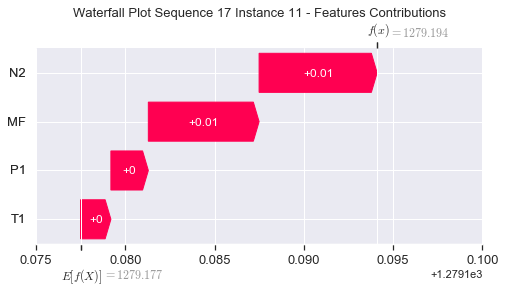

None

Contribution: [0.00207095 0.00165579 0.00653573 0.00612382]


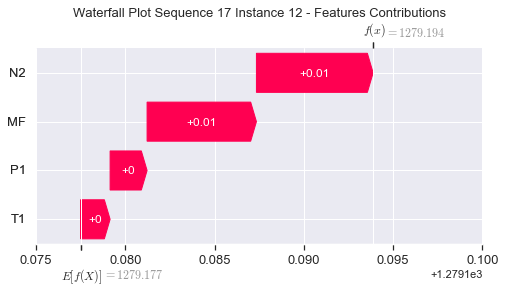

None

Contribution: [0.00204258 0.00163413 0.00643974 0.0060364 ]


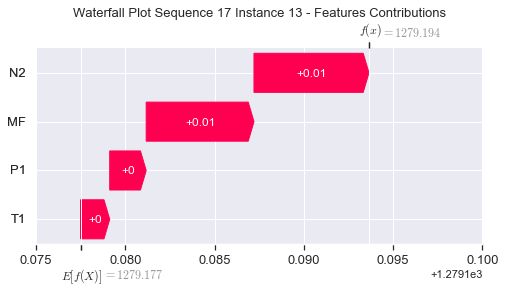

None

Contribution: [0.00191596 0.00149779 0.0061321  0.00573195]


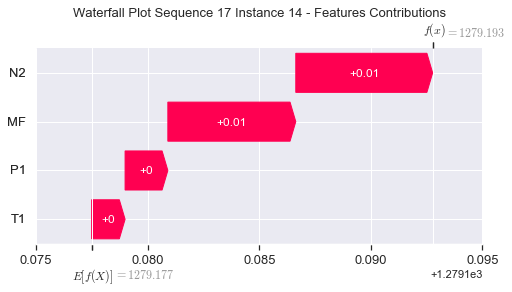

None

Contribution: [0.00174316 0.00138632 0.00548041 0.00514234]


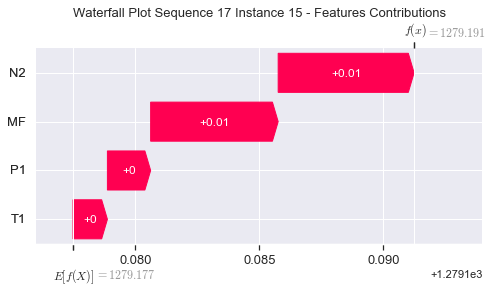

None

Contribution: [0.00143131 0.00114526 0.00441345 0.00418148]


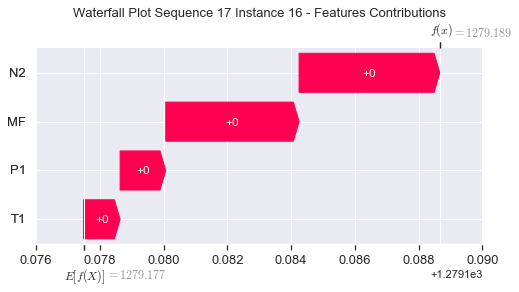

None

Contribution: [0.00130687 0.00107928 0.00414337 0.00388366]


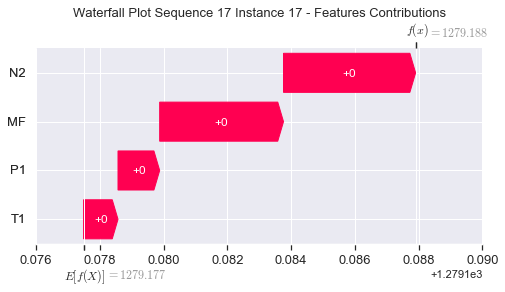

None

Contribution: [0.00333323 0.00293991 0.010892   0.01000946]


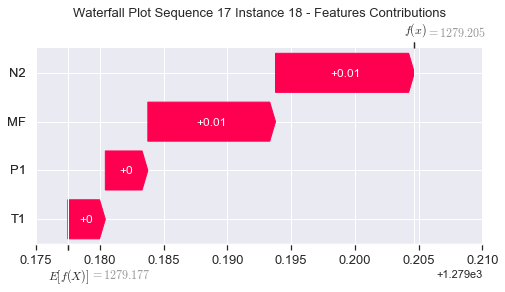

None

Contribution: [0.01386436 0.01261439 0.04516384 0.04129758]


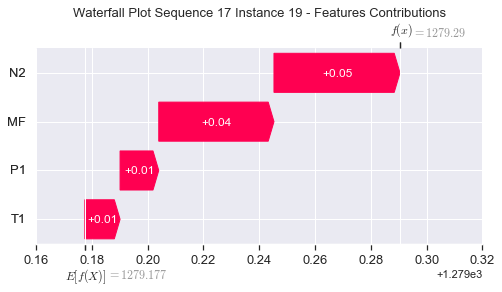

None

Contribution: [0.04906822 0.04291337 0.16059055 0.14695964]


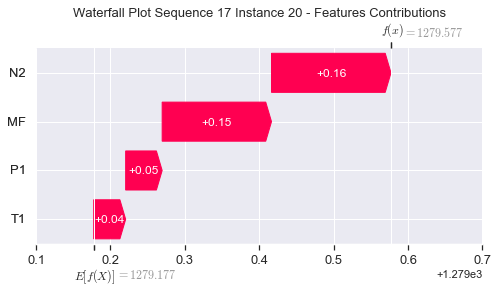

None

Contribution: [0.14297333 0.1226071  0.46729578 0.42828405]


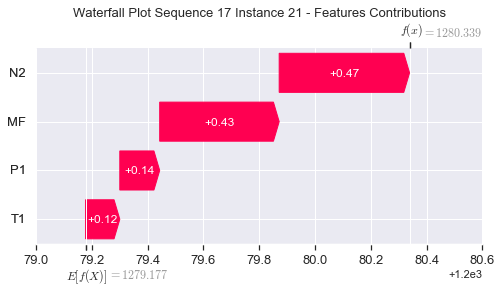

None

Contribution: [0.34076033 0.27247912 1.11610566 1.02718279]


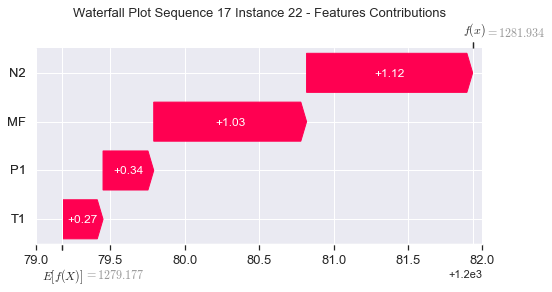

None

Contribution: [0.61256435 0.28464183 2.10279354 1.9644551 ]


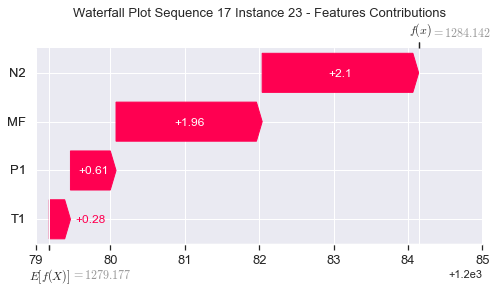

None

Contribution: [ 0.77002364 -1.03521531  2.64293621  2.69443812]


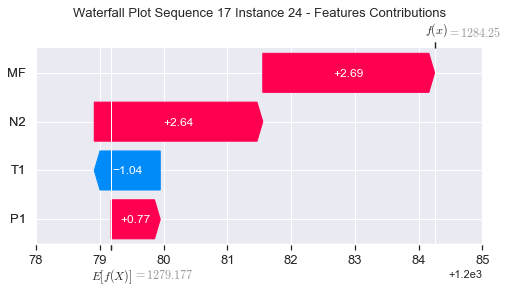

None

Contribution: [ 0.80939362 -0.40773622  2.3694968   2.49407558]


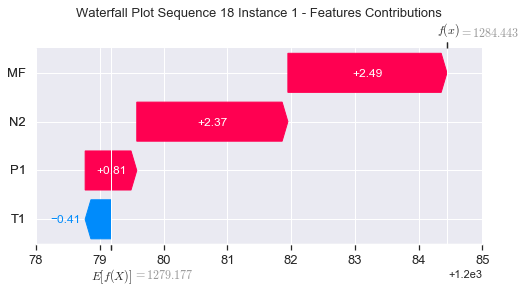

None

Contribution: [-0.08983102  0.03191999 -0.26754514 -0.27728957]


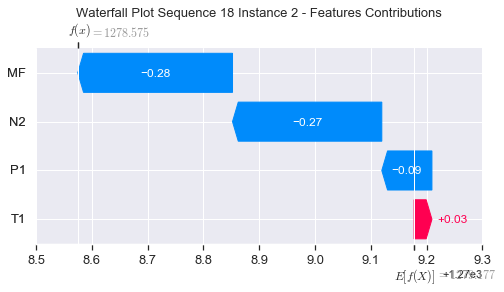

None

Contribution: [0.00111016 0.00084826 0.00370309 0.00357037]


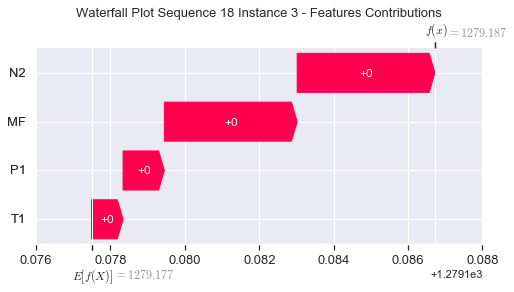

None

Contribution: [0.00159898 0.00128512 0.00509964 0.00483253]


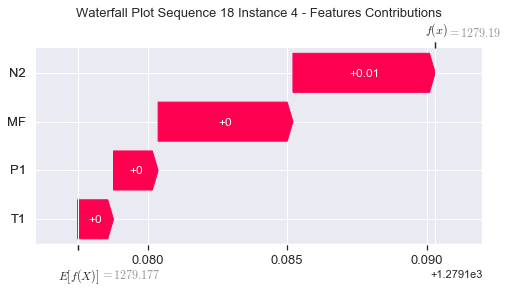

None

Contribution: [0.00179793 0.00150053 0.0056261  0.00533258]


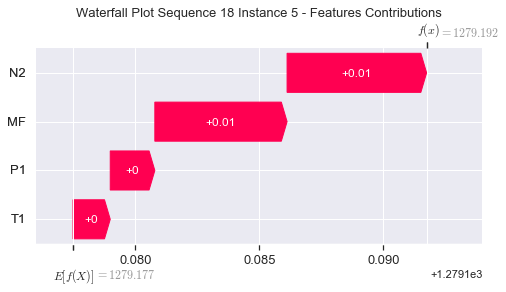

None

Contribution: [0.00198995 0.00165549 0.00618433 0.0058798 ]


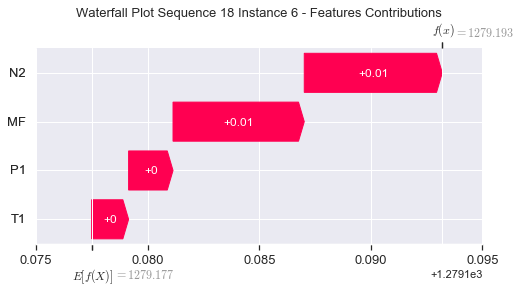

None

Contribution: [0.0021496  0.0017821  0.00665862 0.00633084]


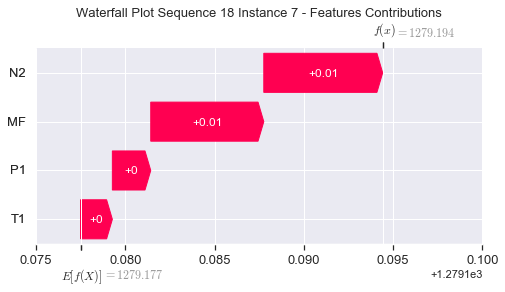

None

Contribution: [0.00218656 0.0018148  0.00679671 0.00645254]


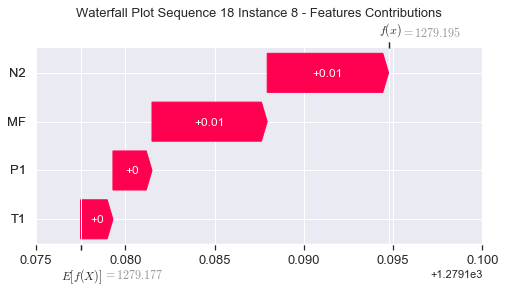

None

Contribution: [0.00216242 0.00185378 0.00672973 0.00637437]


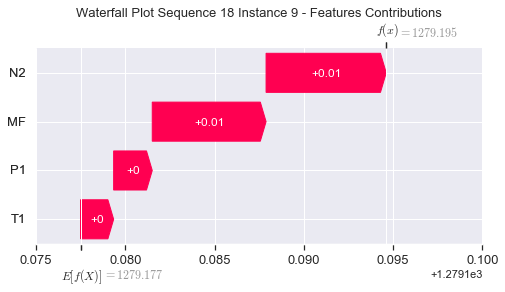

None

Contribution: [0.00216077 0.00179486 0.0066345  0.00629043]


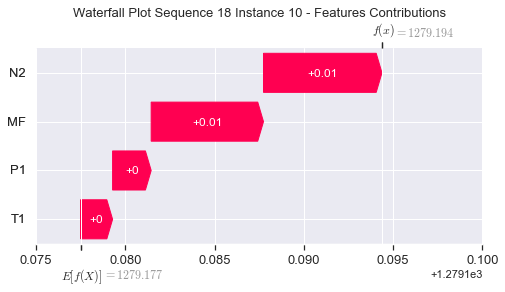

None

Contribution: [0.00210242 0.0017951  0.00656394 0.00623604]


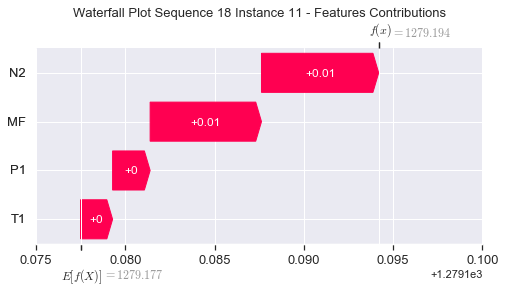

None

Contribution: [0.00211996 0.00175869 0.0064944  0.00621454]


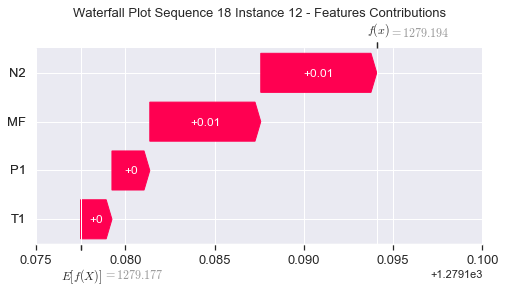

None

Contribution: [0.00208759 0.00173316 0.00640401 0.00611356]


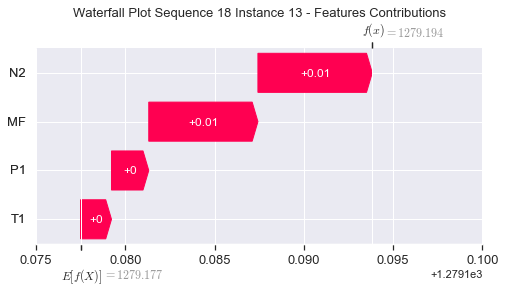

None

Contribution: [0.00195342 0.00170838 0.00610488 0.00576264]


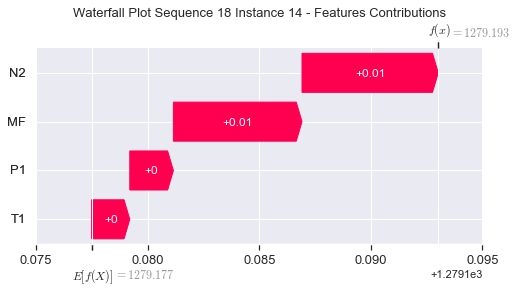

None

Contribution: [0.00177896 0.0014721  0.00547207 0.00521689]


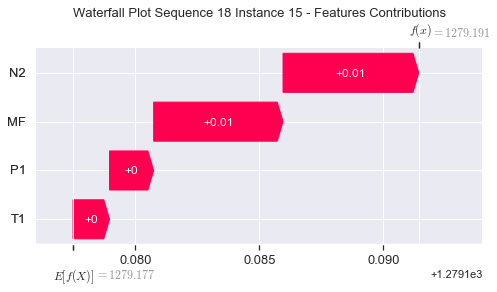

None

Contribution: [0.00140333 0.00122499 0.0043799  0.00414214]


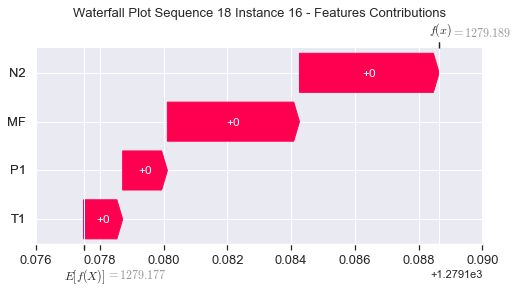

None

Contribution: [0.00133379 0.00115117 0.00410941 0.00392019]


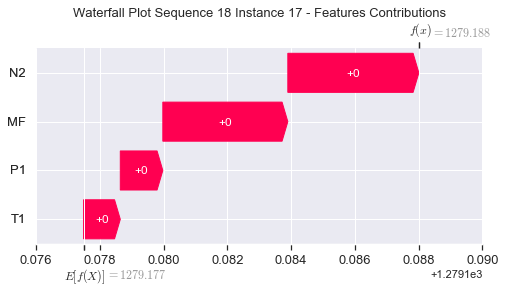

None

Contribution: [0.00333922 0.00304131 0.01066461 0.00994156]


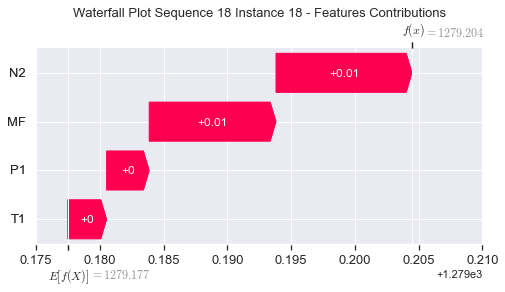

None

Contribution: [0.01379378 0.01244221 0.04440937 0.04118148]


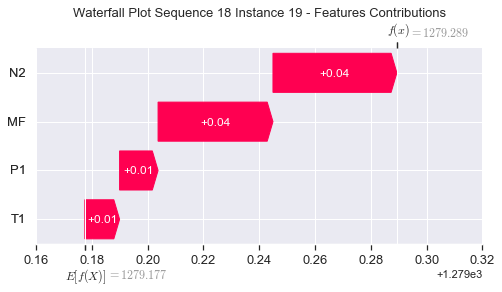

None

Contribution: [0.04902959 0.04386695 0.15864934 0.14602541]


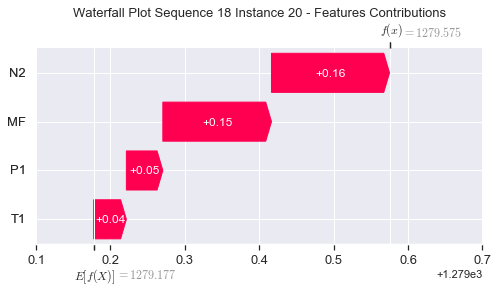

None

Contribution: [0.14347562 0.12627575 0.4633956  0.4270965 ]


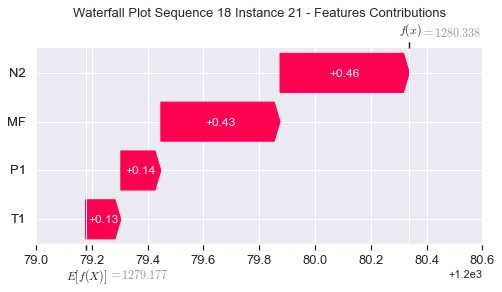

None

Contribution: [0.34261897 0.28270454 1.10994177 1.02684134]


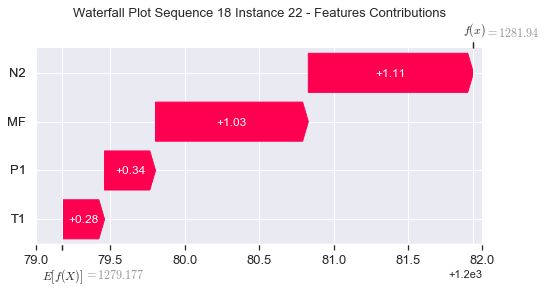

None

Contribution: [0.63033001 0.33318859 2.09716396 1.99095459]


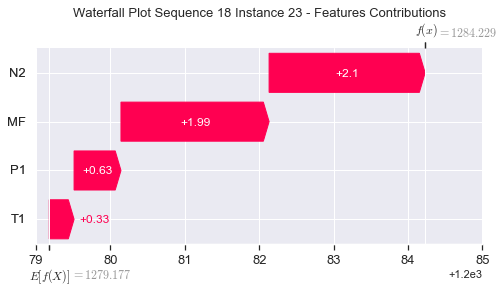

None

Contribution: [ 0.79986493 -0.89476119  2.63248393  2.68279993]


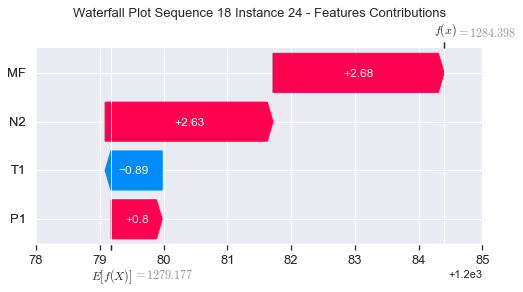

None

Contribution: [ 0.84029728 -0.26086121  2.36763119  2.41338284]


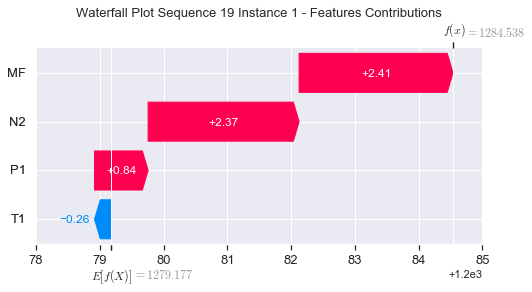

None

Contribution: [-0.09540337  0.01858664 -0.26683694 -0.28162045]


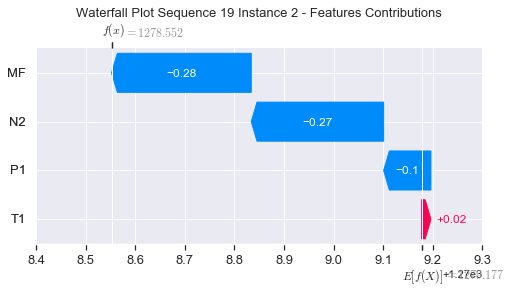

None

Contribution: [0.00107708 0.00087175 0.0036895  0.00352678]


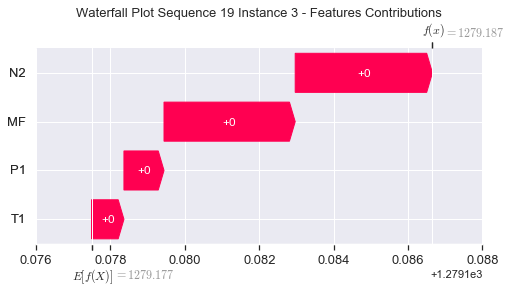

None

Contribution: [0.00163349 0.00134903 0.00512894 0.00487948]


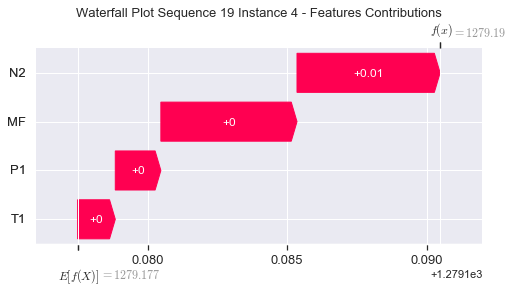

None

Contribution: [0.00181824 0.0015219  0.00565099 0.00536288]


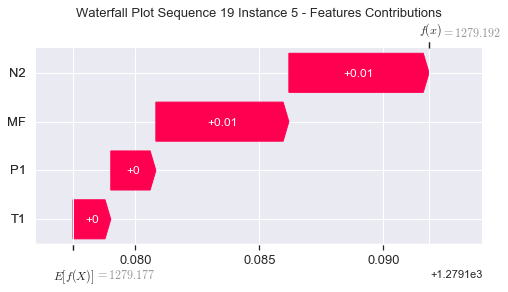

None

Contribution: [0.00198477 0.00163756 0.00619139 0.00582043]


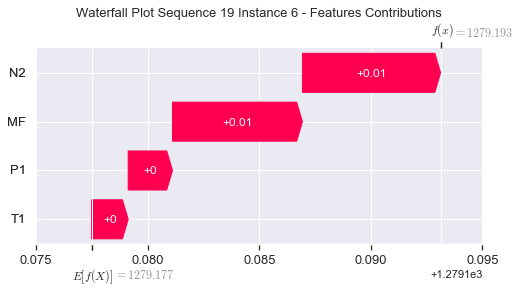

None

Contribution: [0.00214315 0.00176934 0.0066661  0.00626861]


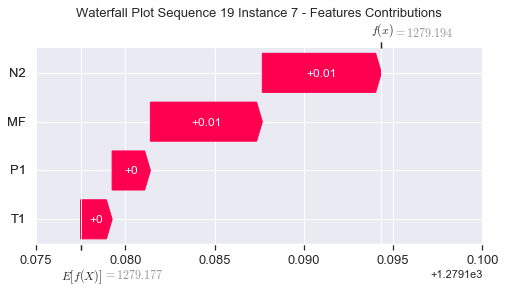

None

Contribution: [0.00218541 0.00179476 0.00680878 0.00641137]


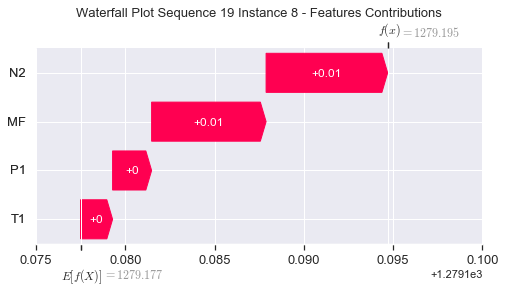

None

Contribution: [0.0021739  0.00182107 0.00676461 0.00639803]


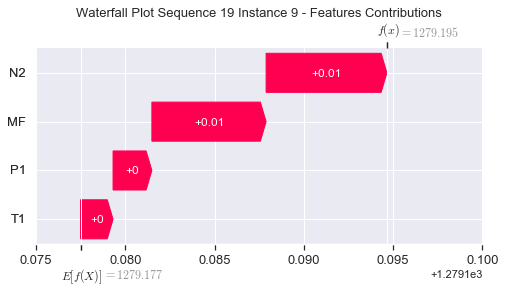

None

Contribution: [0.00215452 0.00179818 0.00667085 0.00629321]


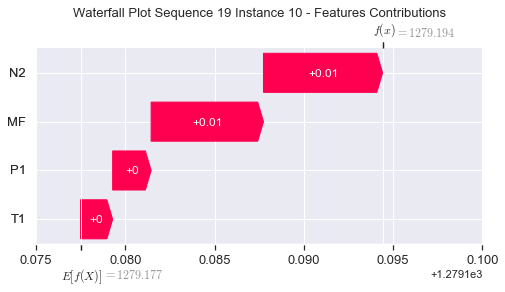

None

Contribution: [0.00209424 0.00170664 0.00659009 0.00620001]


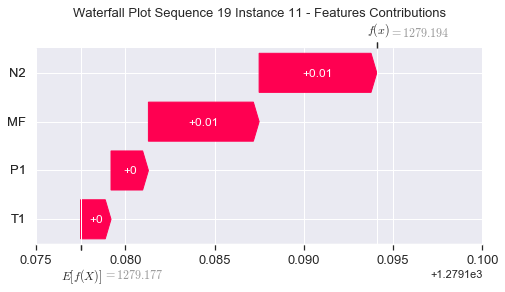

None

Contribution: [0.00208446 0.00168981 0.00649597 0.00610451]


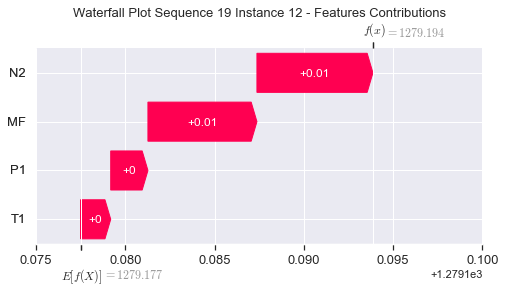

None

Contribution: [0.00206092 0.00167962 0.00640392 0.00602841]


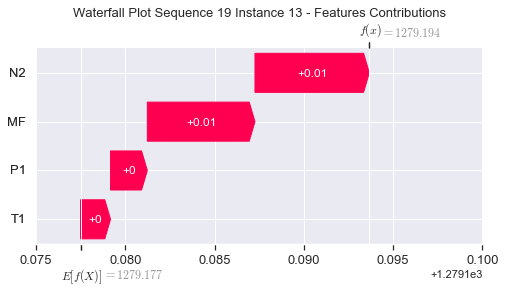

None

Contribution: [0.00198503 0.00162395 0.00613659 0.00584337]


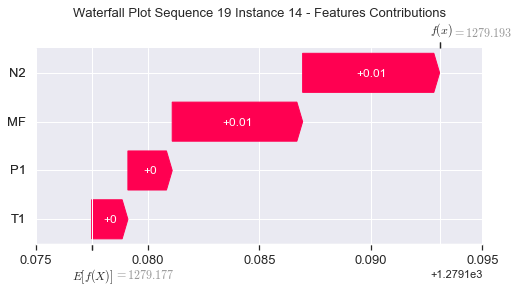

None

Contribution: [0.00176699 0.00142496 0.0054647  0.00515539]


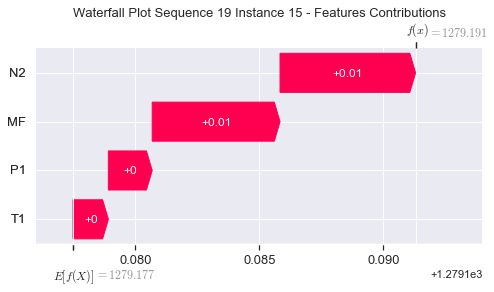

None

Contribution: [0.00141862 0.00119124 0.00439622 0.00418026]


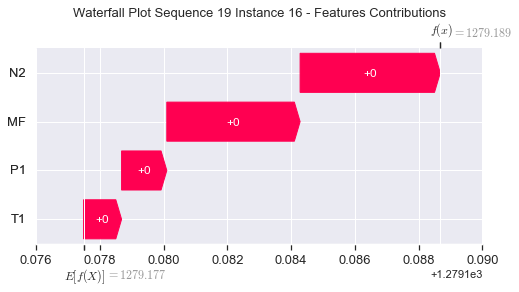

None

Contribution: [0.00133251 0.00112356 0.00412066 0.00389455]


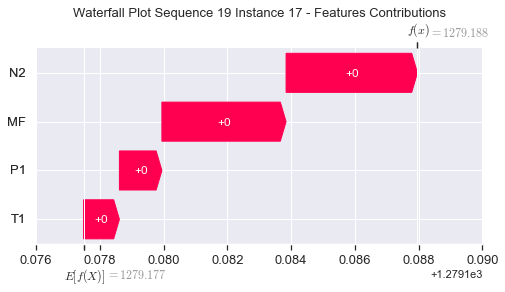

None

Contribution: [0.00335732 0.0029928  0.01073326 0.00994084]


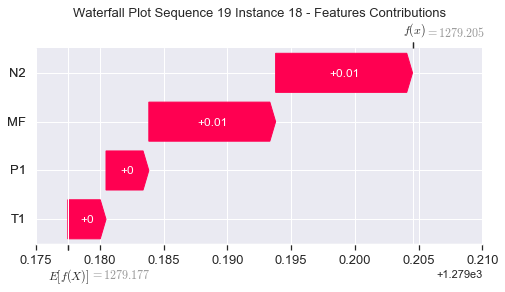

None

Contribution: [0.01369164 0.01234976 0.04454384 0.04077448]


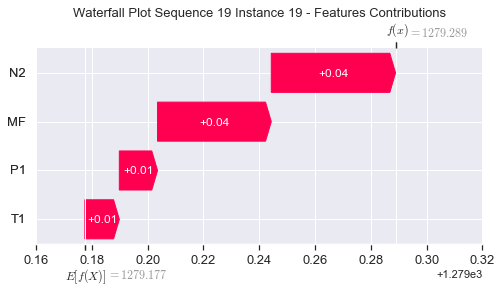

None

Contribution: [0.04945819 0.04371235 0.15855366 0.1464421 ]


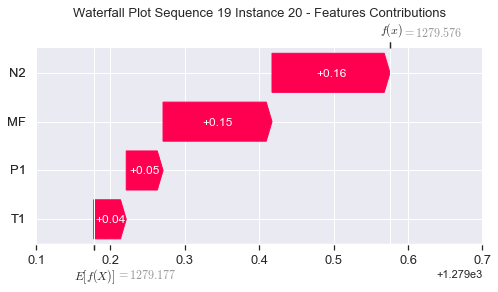

None

Contribution: [0.14471292 0.12530042 0.46279126 0.42850933]


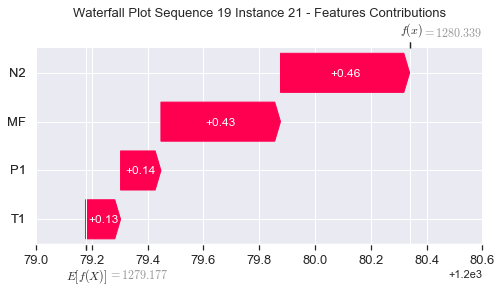

None

Contribution: [0.3472486  0.27890434 1.10790898 1.03338099]


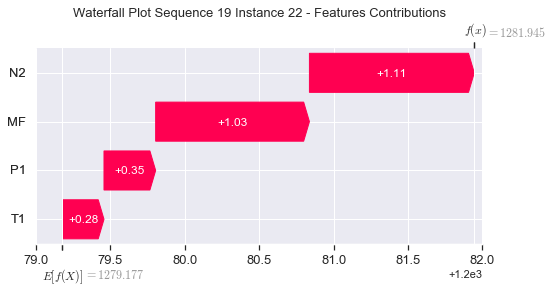

None

Contribution: [0.6419335  0.30613051 2.08404302 1.99823784]


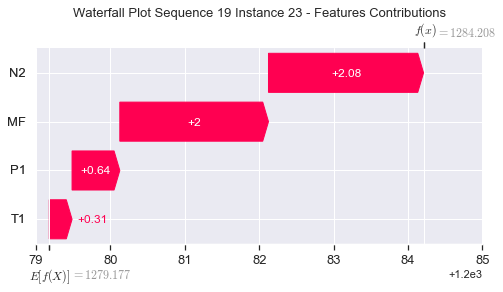

None

Contribution: [ 0.80320205 -1.0076385   2.55113804  2.66534902]


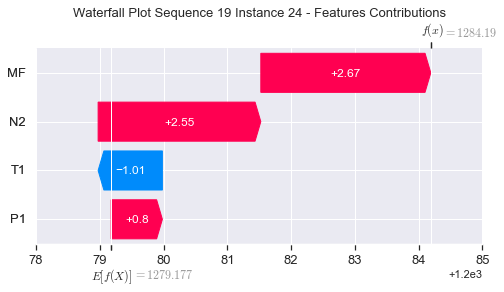

None

Contribution: [ 0.67080722 -0.45121188  2.29405993  2.1498657 ]


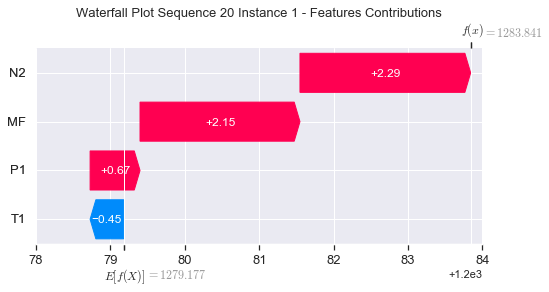

None

Contribution: [-0.10102514  0.02810691 -0.26982041 -0.29684762]


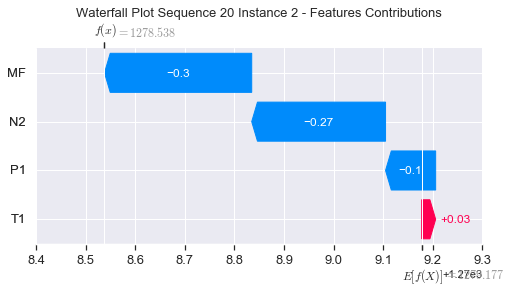

None

Contribution: [0.00111276 0.00085751 0.00368274 0.00353943]


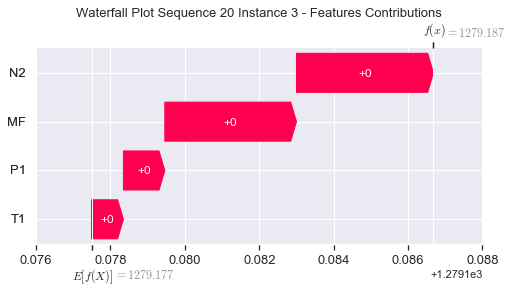

None

Contribution: [0.00160579 0.00138371 0.00508612 0.00475969]


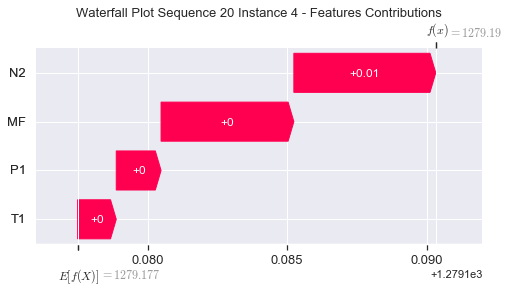

None

Contribution: [0.00183356 0.00158245 0.00563236 0.00534222]


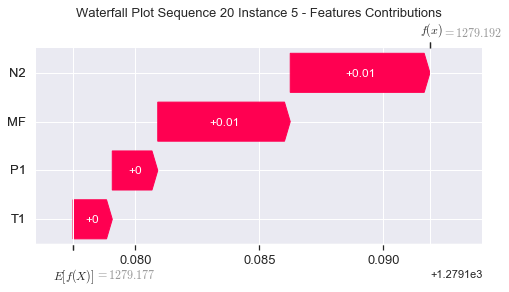

None

Contribution: [0.00198491 0.00168034 0.00617385 0.00579052]


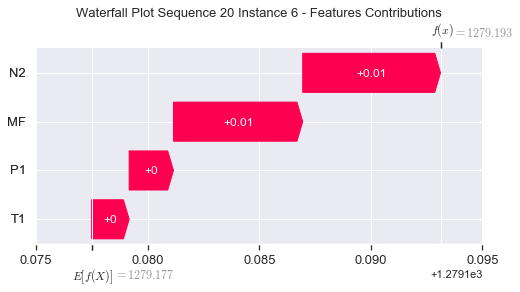

None

Contribution: [0.00214331 0.00181008 0.00665735 0.00625266]


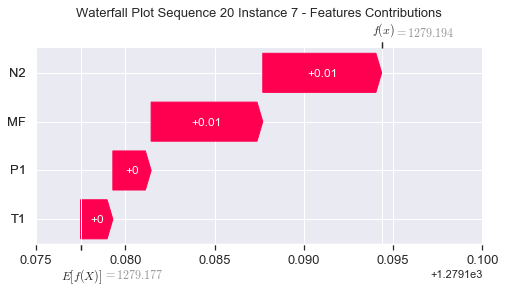

None

Contribution: [0.00218631 0.00183555 0.00679902 0.00639255]


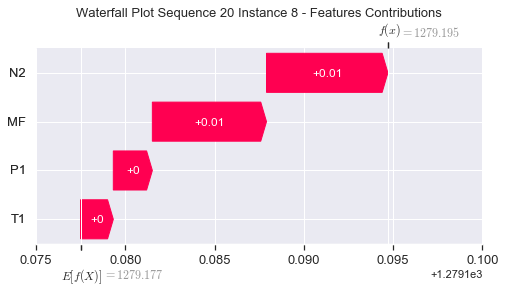

None

Contribution: [0.00215175 0.00181145 0.00674584 0.00636364]


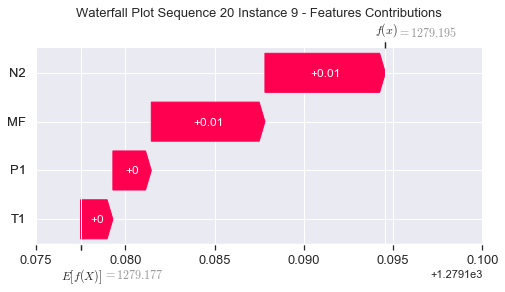

None

Contribution: [0.00217041 0.00166992 0.00663763 0.00630593]


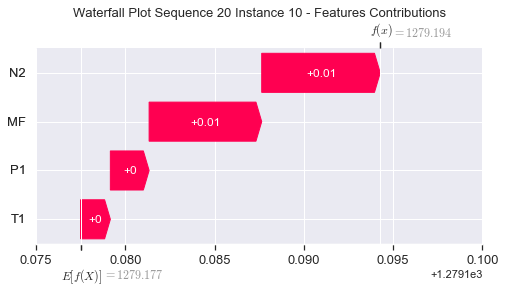

None

Contribution: [0.00207239 0.00173026 0.00654812 0.00614585]


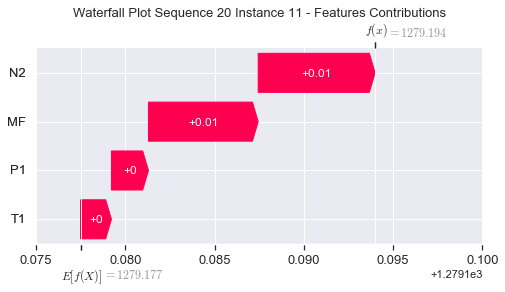

None

Contribution: [0.00209049 0.00177793 0.00647742 0.00612457]


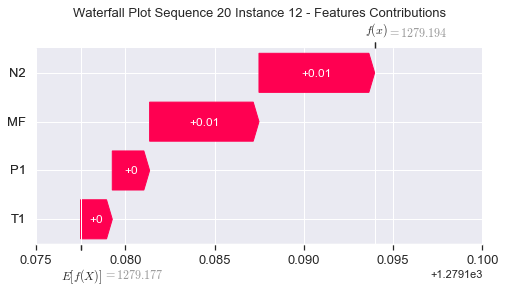

None

Contribution: [0.00206716 0.00175429 0.00638931 0.00604914]


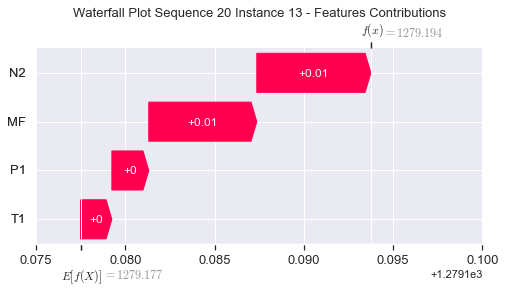

None

Contribution: [0.00196917 0.00169808 0.00610367 0.00578431]


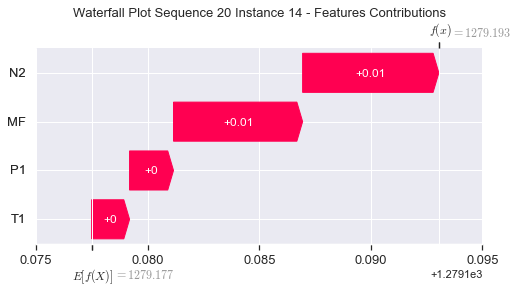

None

Contribution: [0.00176524 0.00147968 0.00545043 0.00516591]


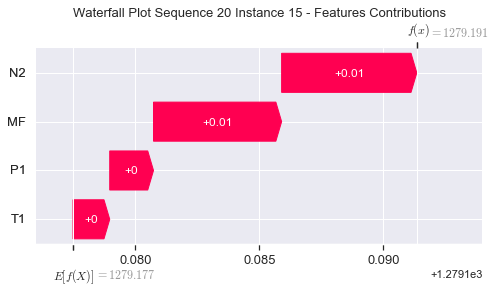

None

Contribution: [0.00141306 0.00115202 0.00436833 0.00417388]


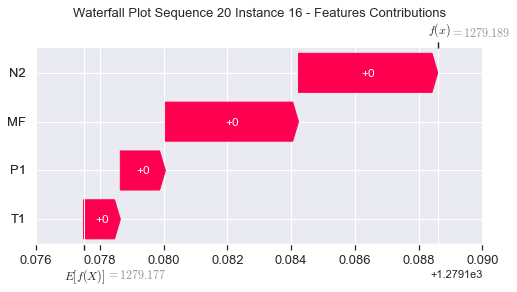

None

Contribution: [0.00130658 0.00113484 0.00403888 0.00383957]


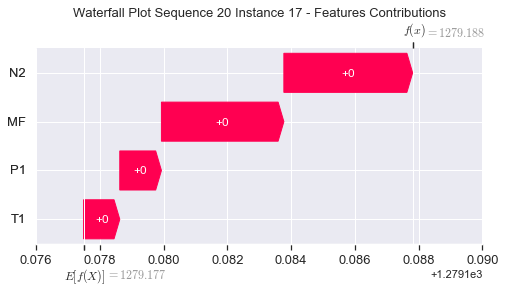

None

Contribution: [0.00328188 0.00299445 0.01049854 0.00976202]


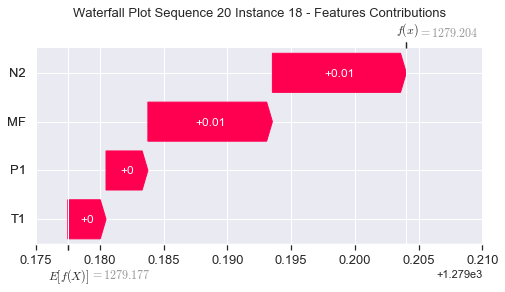

None

Contribution: [0.01371594 0.01242379 0.04400627 0.04059362]


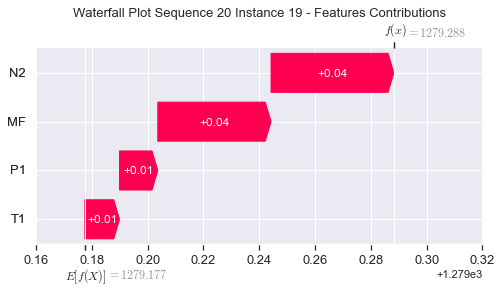

None

Contribution: [0.04910916 0.04381258 0.15755723 0.14587492]


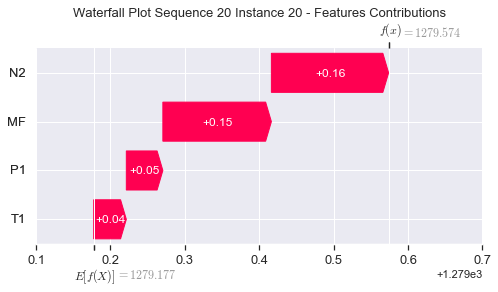

None

Contribution: [0.14424367 0.12691082 0.46097345 0.42840676]


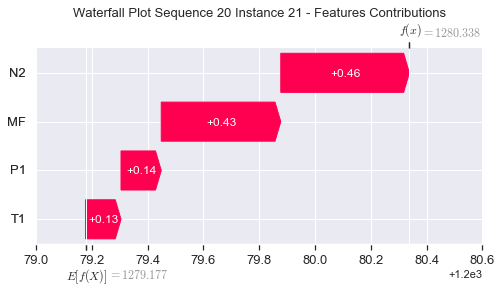

None

Contribution: [0.34746437 0.28748349 1.1051731  1.03666896]


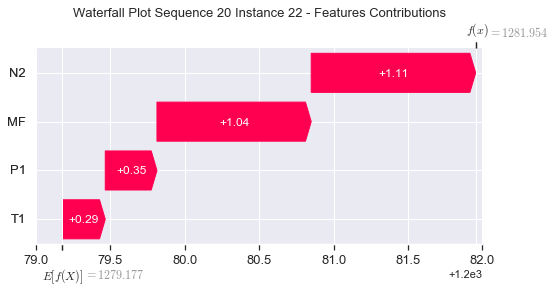

None

Contribution: [0.64432248 0.33716171 2.08401206 2.01866438]


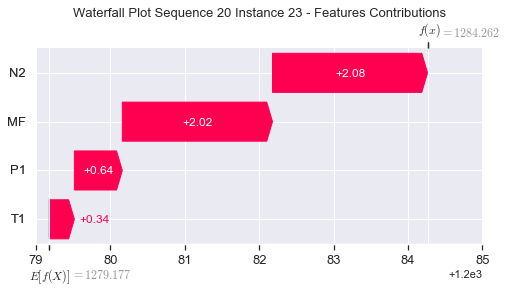

None

Contribution: [ 0.86609713 -0.86578583  2.57051077  2.86034806]


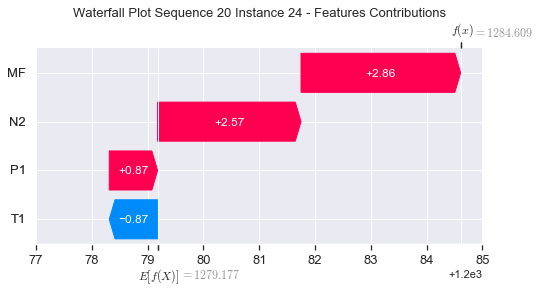

None

Contribution: [ 0.78890703 -0.27560149  2.30207321  2.48312943]


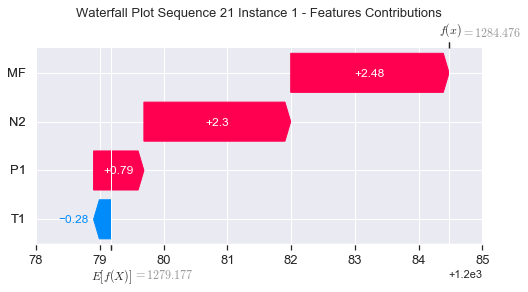

None

Contribution: [-0.10438695  0.00931782 -0.26769654 -0.3082975 ]


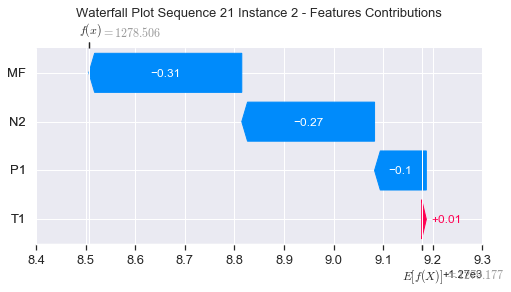

None

Contribution: [0.00112046 0.00097584 0.00368055 0.00360844]


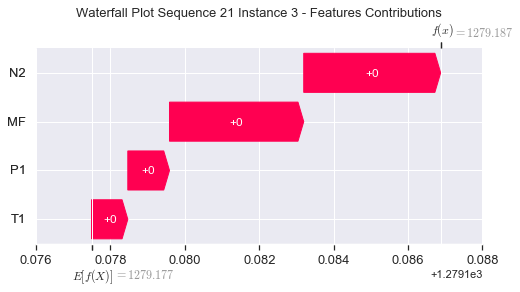

None

Contribution: [0.00165315 0.00150119 0.00508607 0.00484719]


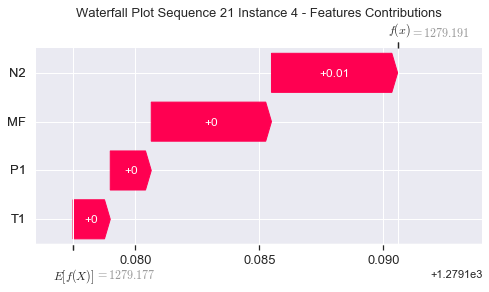

None

Contribution: [0.00181841 0.00156834 0.00561047 0.00535128]


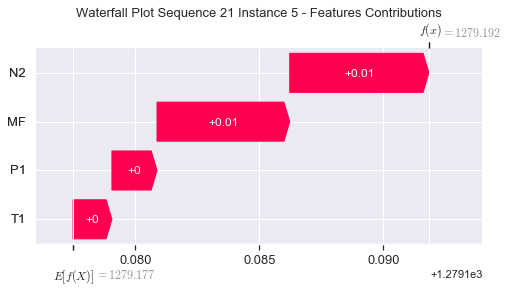

None

Contribution: [0.0020134  0.00172127 0.00617078 0.00587355]


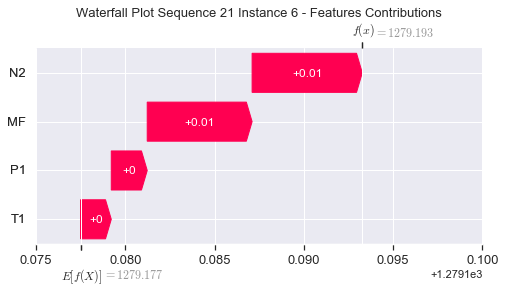

None

Contribution: [0.00216129 0.00183796 0.006647   0.00631939]


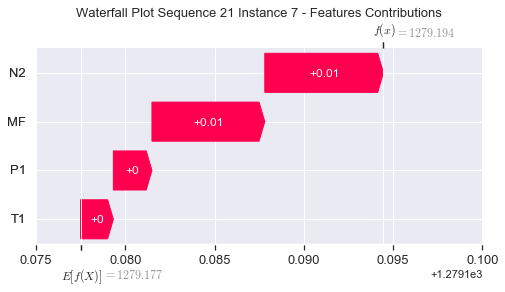

None

Contribution: [0.00220999 0.00185765 0.00679504 0.00646188]


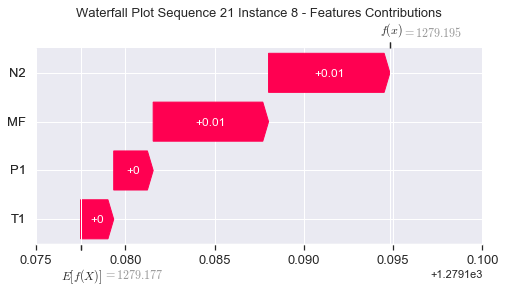

None

Contribution: [0.0021931  0.00182236 0.00673632 0.0064214 ]


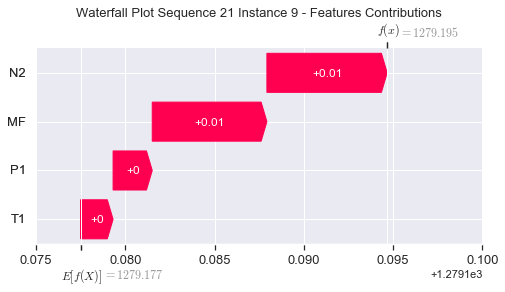

None

Contribution: [0.0020807  0.00179622 0.00663572 0.00626889]


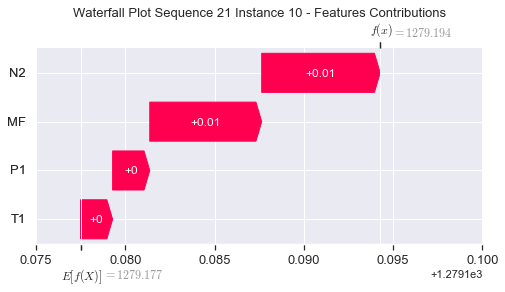

None

Contribution: [0.00214821 0.00175796 0.00658009 0.00627843]


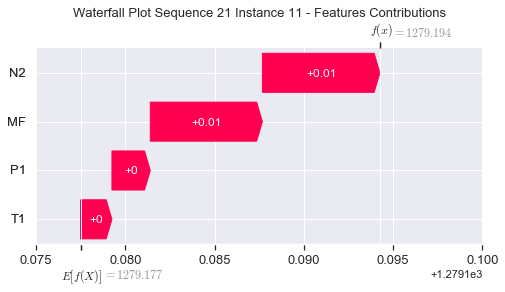

None

Contribution: [0.00208489 0.00171316 0.00648941 0.00616488]


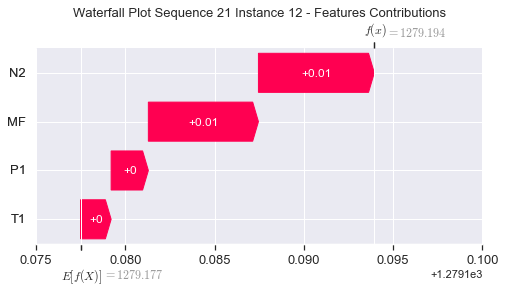

None

Contribution: [0.0020551  0.00168843 0.00639611 0.00607145]


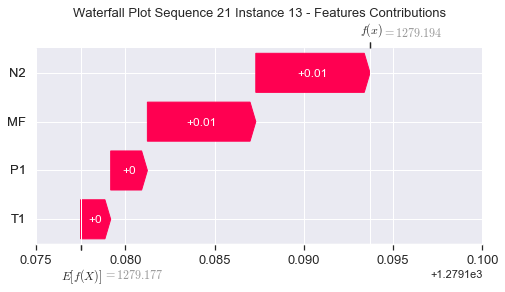

None

Contribution: [0.00200185 0.00161357 0.00612011 0.00582044]


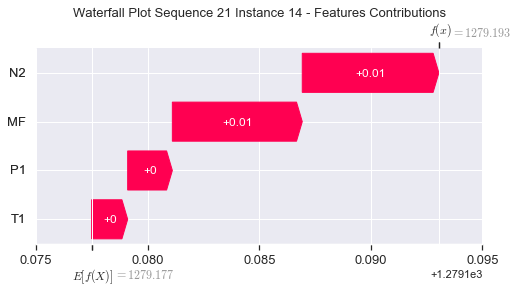

None

Contribution: [0.00177026 0.00142989 0.00546354 0.00519842]


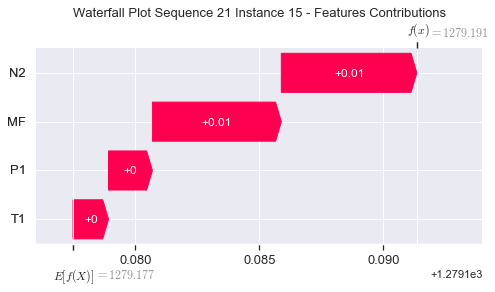

None

Contribution: [0.00142807 0.00117302 0.00439294 0.00423164]


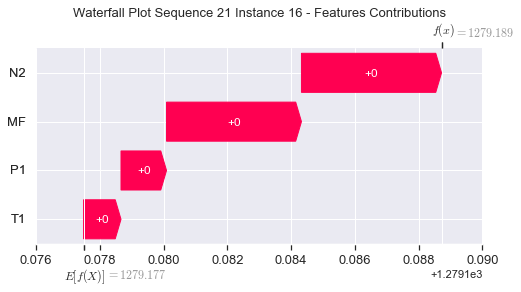

None

Contribution: [0.00132455 0.00110253 0.00410227 0.00390411]


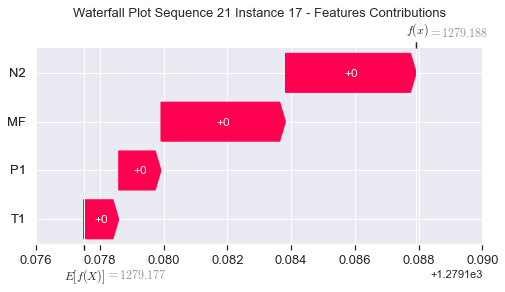

None

Contribution: [0.00335385 0.00294342 0.01071147 0.00997536]


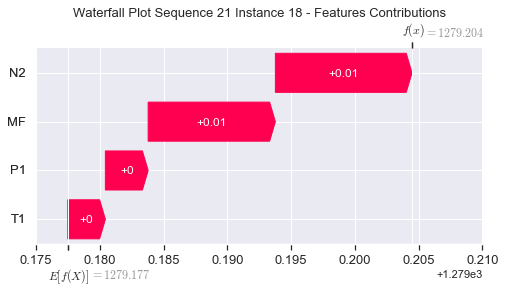

None

Contribution: [0.01395089 0.01200846 0.04464705 0.04156373]


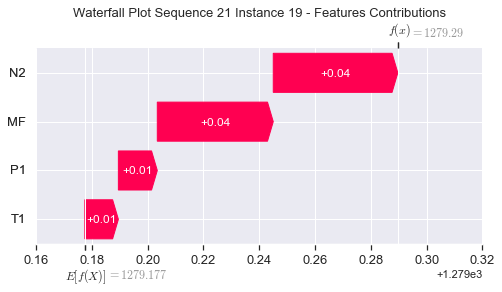

None

Contribution: [0.04960408 0.04265143 0.15935202 0.14719988]


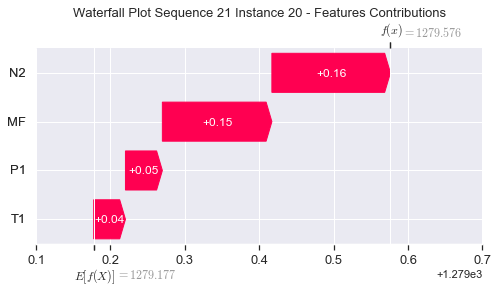

None

Contribution: [0.14487491 0.12131876 0.4652834  0.43040183]


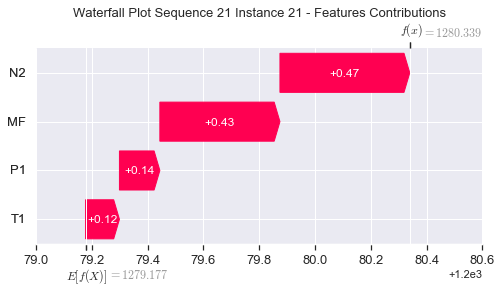

None

Contribution: [0.34731448 0.26522249 1.11419753 1.03712011]


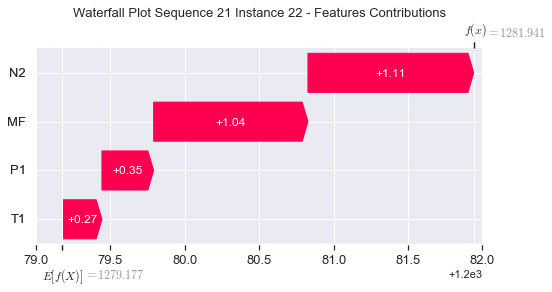

None

Contribution: [0.64731071 0.25757046 2.10645728 2.01846358]


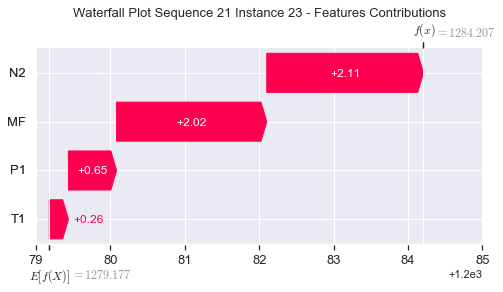

None

Contribution: [ 0.80226467 -1.22682939  2.63156703  2.69980365]


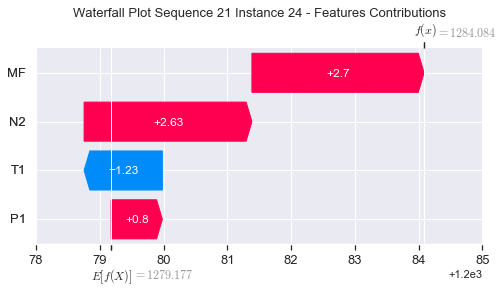

None

Contribution: [ 0.59530033 -0.64009071  2.33102647  2.14998536]


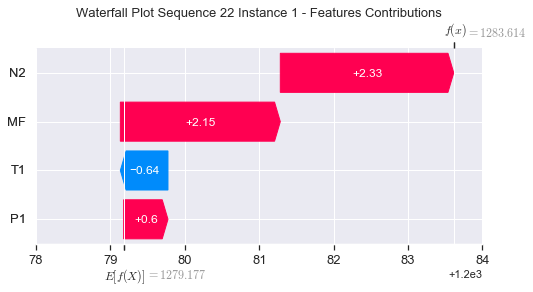

None

Contribution: [-0.09391022  0.05387814 -0.27393142 -0.29313294]


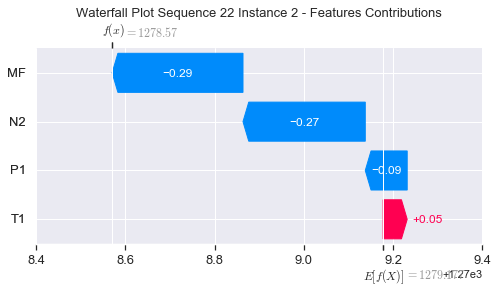

None

Contribution: [0.00111983 0.00077702 0.00370639 0.00360927]


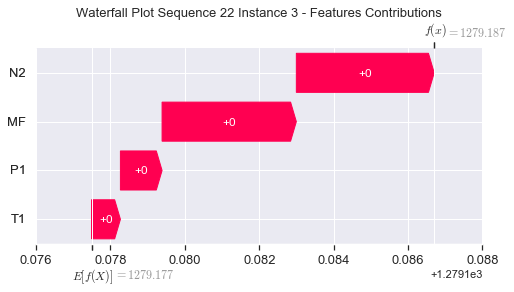

None

Contribution: [0.00165866 0.00123763 0.00512086 0.00489678]


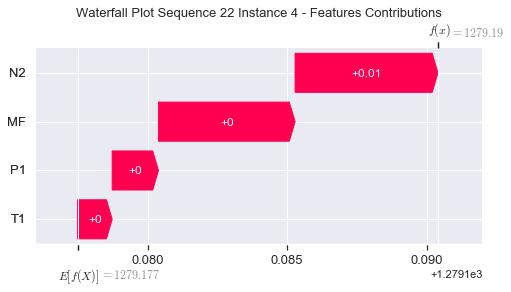

None

Contribution: [0.00181802 0.00137415 0.00561719 0.00536198]


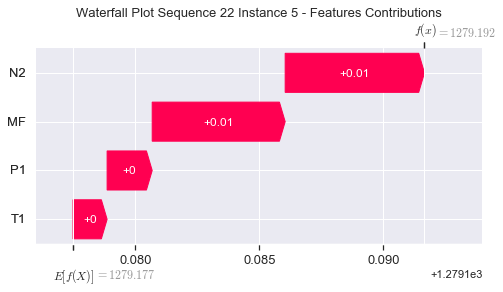

None

Contribution: [0.00199141 0.00153698 0.0061639  0.00588176]


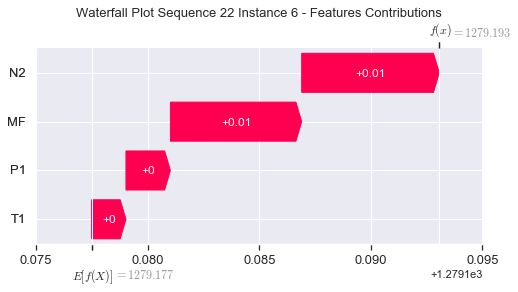

None

Contribution: [0.00215287 0.00165629 0.00664192 0.00635326]


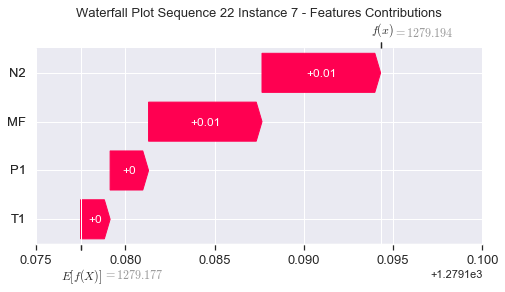

None

Contribution: [0.00219192 0.00170695 0.0067835  0.00646998]


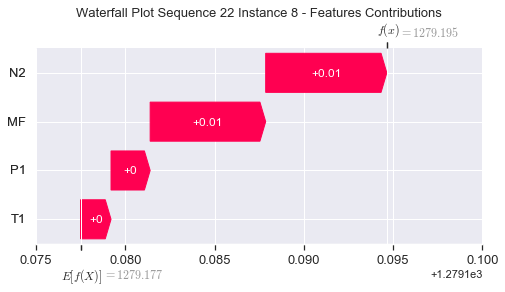

None

Contribution: [0.00216306 0.00171108 0.00670739 0.00638888]


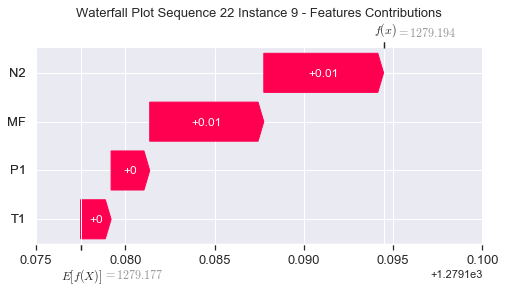

None

Contribution: [0.00215163 0.00174817 0.00662404 0.00625775]


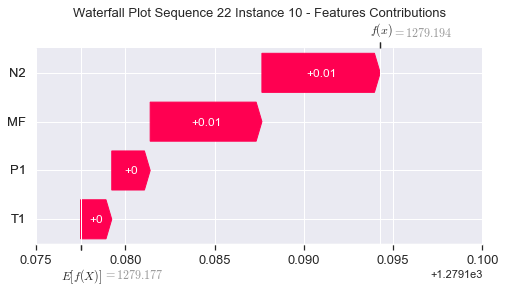

None

Contribution: [0.00207308 0.00172073 0.00652478 0.00615338]


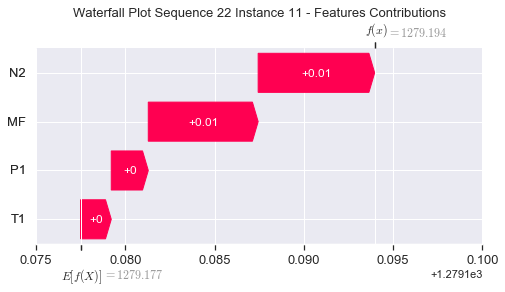

None

Contribution: [0.00207853 0.00170315 0.00646415 0.00618193]


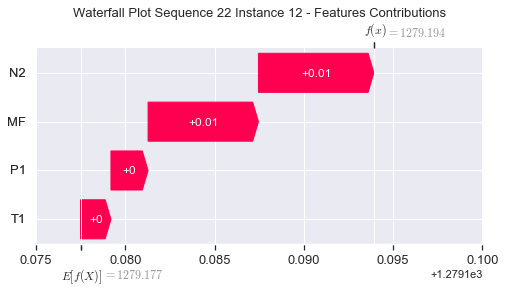

None

Contribution: [0.00205692 0.00167558 0.0063732  0.00610191]


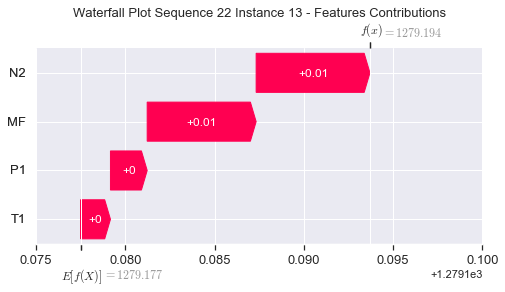

None

Contribution: [0.00195917 0.00161994 0.00609255 0.00585443]


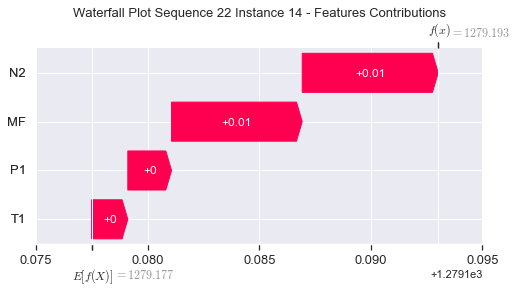

None

Contribution: [0.00176346 0.00142611 0.00543958 0.00522312]


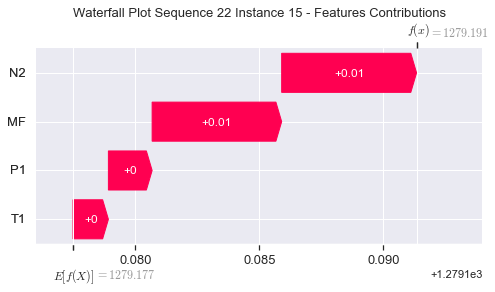

None

Contribution: [0.00142779 0.001155   0.00436754 0.00421846]


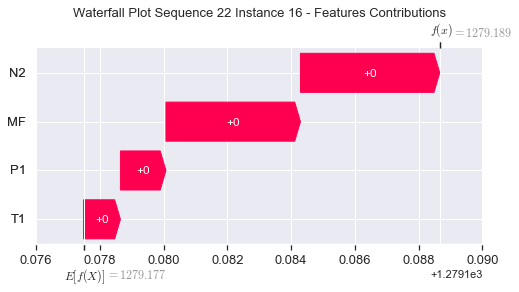

None

Contribution: [0.00130649 0.00110816 0.0040162  0.00388402]


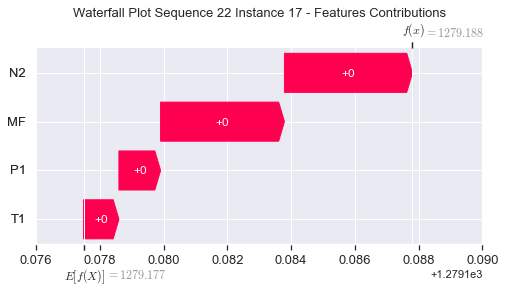

None

Contribution: [0.00326467 0.00296532 0.01039118 0.00979887]


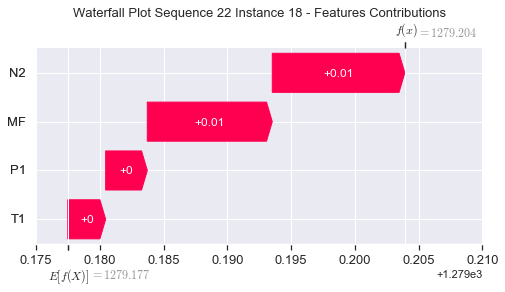

None

Contribution: [0.01341501 0.01221785 0.04363657 0.04031925]


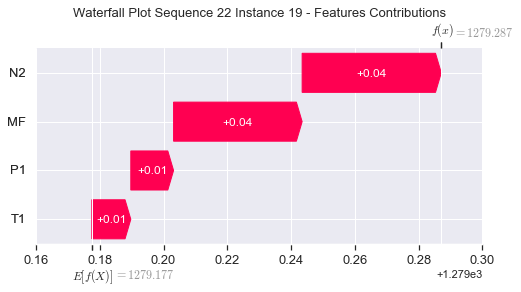

None

Contribution: [0.04899279 0.0436138  0.1563902  0.14611807]


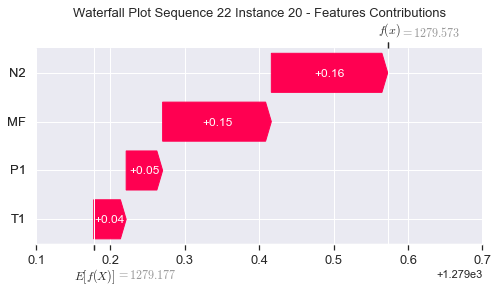

None

Contribution: [0.14386063 0.12695671 0.45870781 0.42925457]


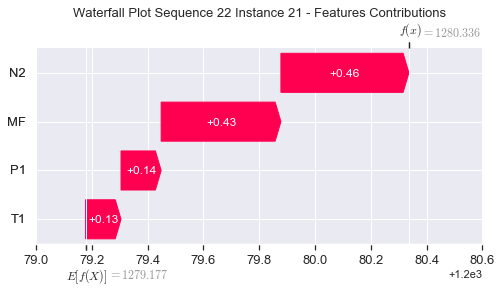

None

Contribution: [0.34608087 0.29012667 1.10270988 1.03849646]


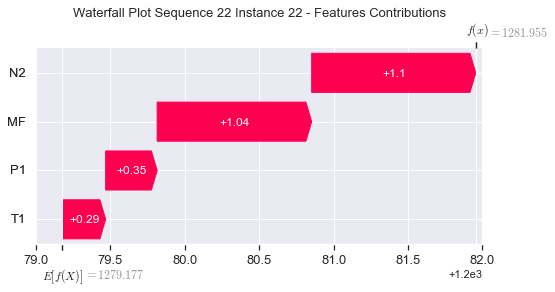

None

Contribution: [0.64580245 0.38368324 2.08750707 2.044737  ]


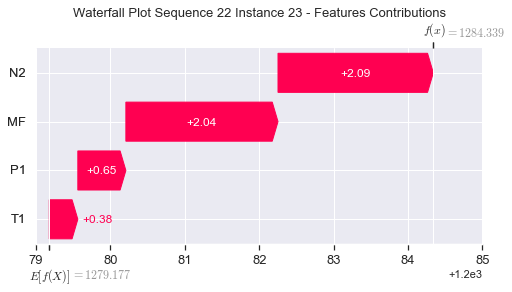

None

Contribution: [ 0.83091775 -0.74525225  2.63170848  2.89864118]


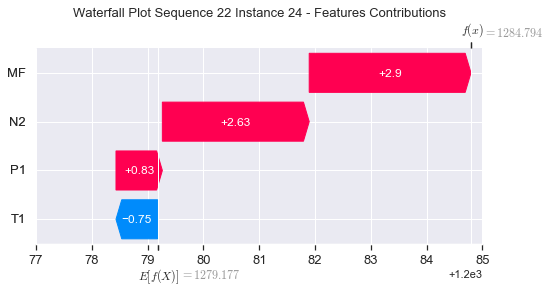

None

Contribution: [ 0.67109016 -0.32455707  2.36306419  2.38045255]


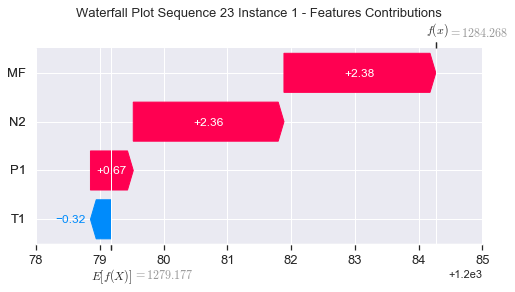

None

Contribution: [-0.09987216  0.0025549  -0.27222303 -0.30495754]


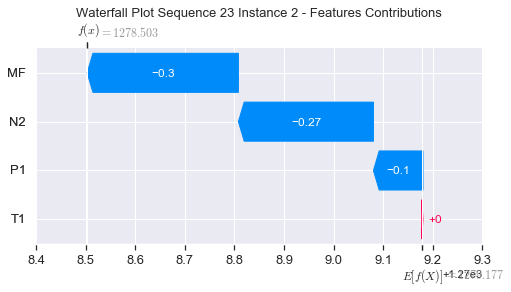

None

Contribution: [0.00108302 0.00078354 0.00369343 0.00360294]


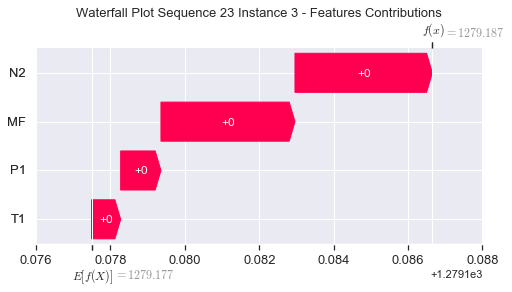

None

Contribution: [0.00157781 0.00126994 0.00509318 0.00482195]


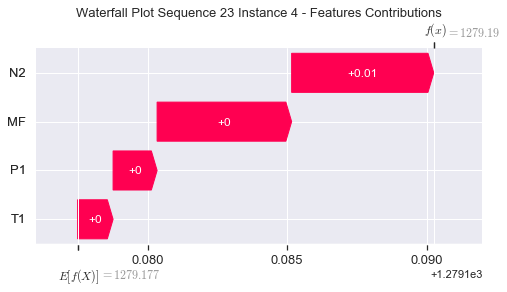

None

Contribution: [0.0018175  0.00147005 0.00563182 0.00536506]


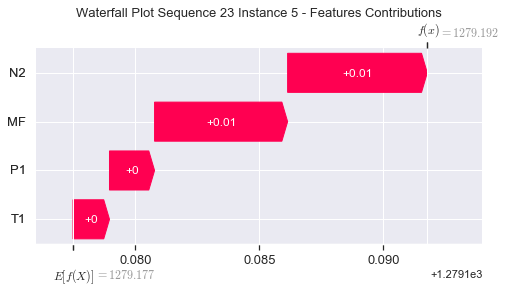

None

Contribution: [0.00200528 0.00162982 0.00618186 0.0058577 ]


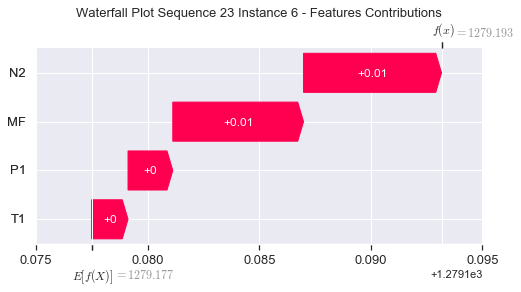

None

Contribution: [0.00216094 0.00175852 0.00665713 0.00630664]


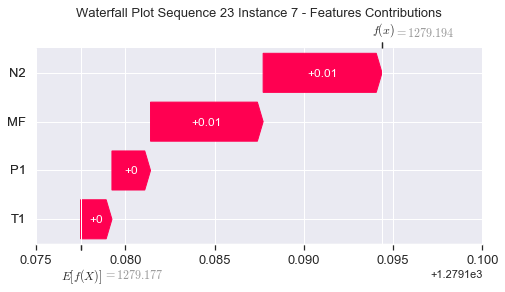

None

Contribution: [0.00220186 0.00178648 0.0067983  0.00643469]


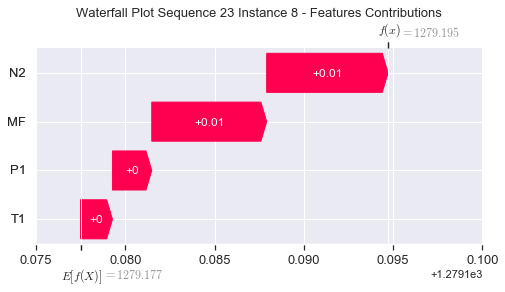

None

Contribution: [0.00219086 0.00179865 0.00674754 0.00639873]


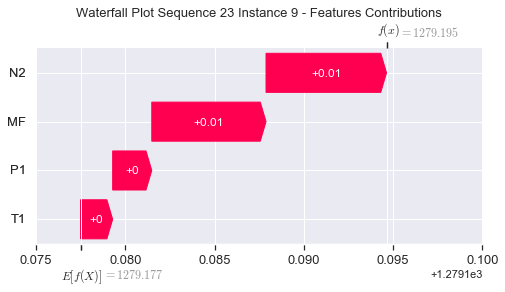

None

Contribution: [0.00217967 0.00177857 0.00665795 0.00630819]


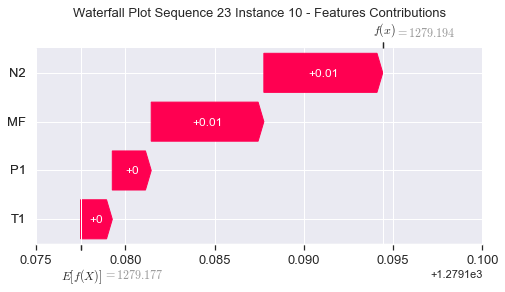

None

Contribution: [0.00212035 0.00173427 0.00657397 0.00618366]


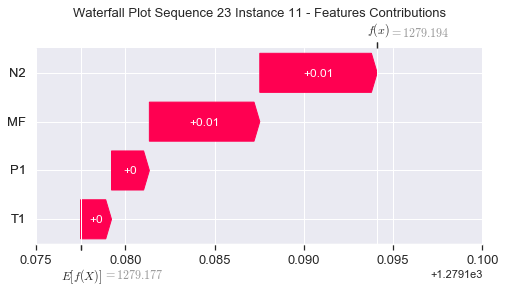

None

Contribution: [0.00209894 0.00172423 0.0064892  0.006114  ]


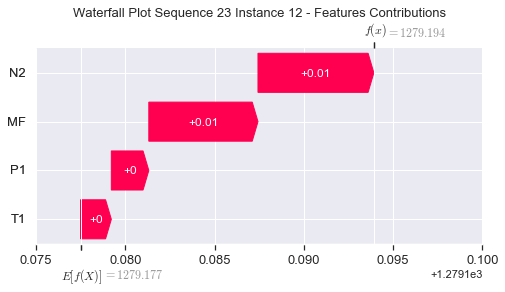

None

Contribution: [0.00207178 0.00170288 0.00639889 0.00603649]


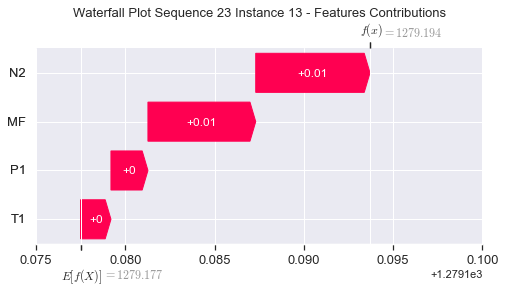

None

Contribution: [0.00198452 0.00164928 0.00612763 0.0058739 ]


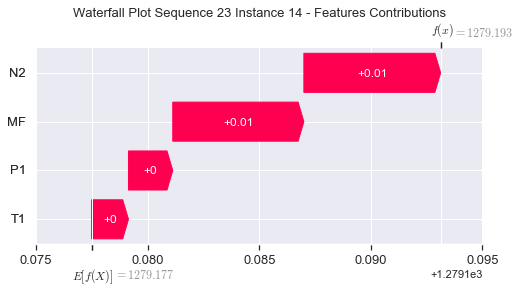

None

Contribution: [0.0017744  0.00145137 0.00546465 0.0051626 ]


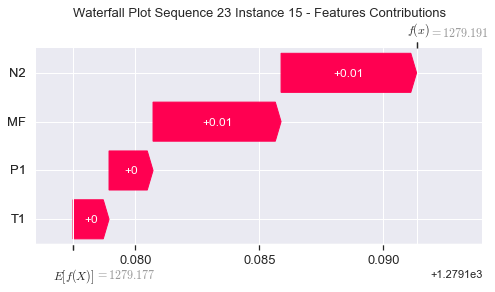

None

Contribution: [0.0013986  0.0011627  0.0043766  0.00414802]


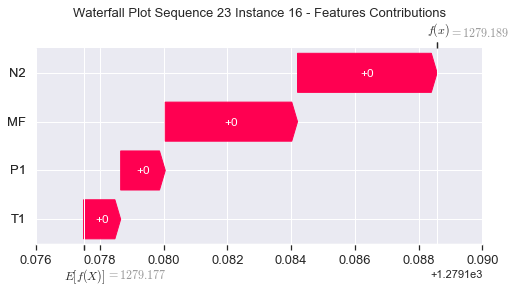

None

Contribution: [0.00132901 0.00113577 0.00409183 0.00387177]


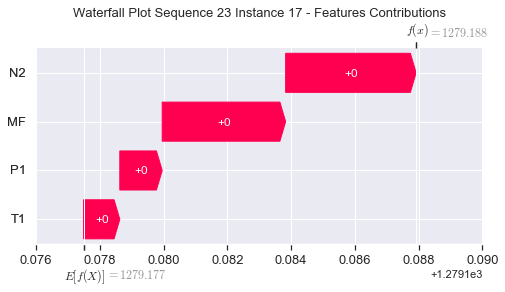

None

Contribution: [0.00334492 0.00302205 0.01065487 0.0098672 ]


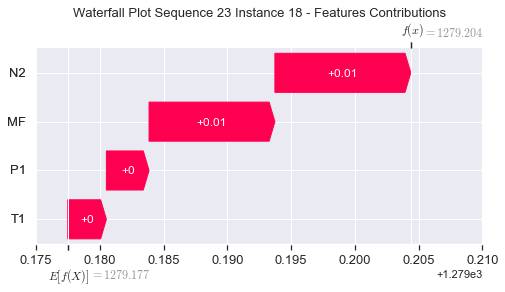

None

Contribution: [0.01382674 0.01229655 0.04438009 0.04041844]


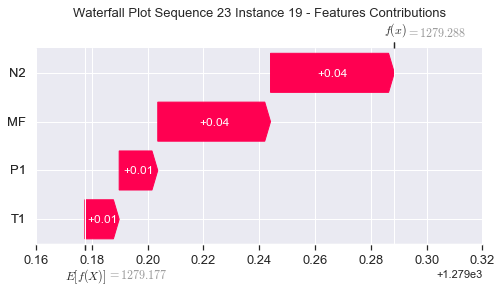

None

Contribution: [0.04935932 0.04383942 0.15847377 0.14593933]


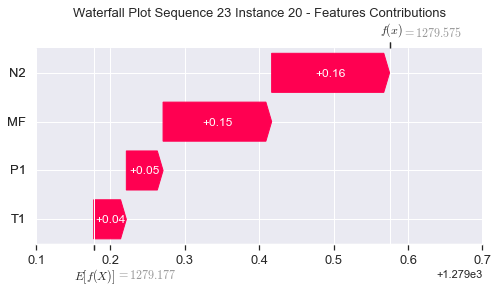

None

Contribution: [0.1444037  0.12608967 0.4631666  0.42700492]


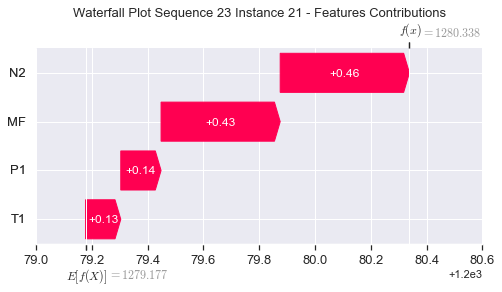

None

Contribution: [0.34589348 0.28233919 1.1101312  1.02728175]


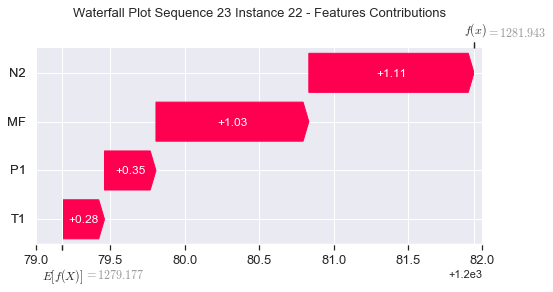

None

Contribution: [0.64219816 0.3332865  2.09773358 1.97965982]


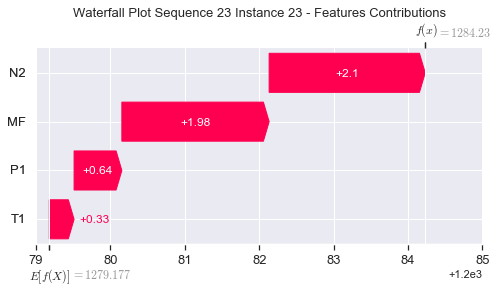

None

Contribution: [ 0.88946002 -0.89146173  2.64655927  2.72399315]


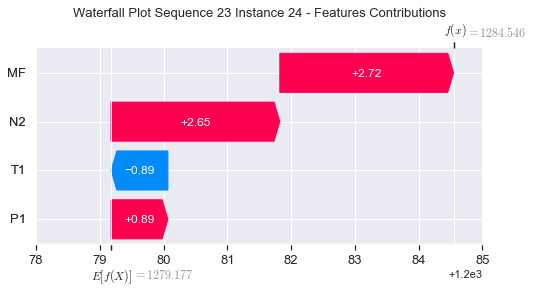

None

Contribution: [ 0.87763819 -0.30088699  2.36187608  2.39198091]


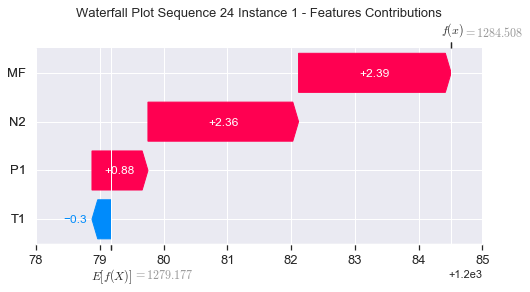

None

Contribution: [-0.09475101  0.02066852 -0.26578398 -0.27700052]


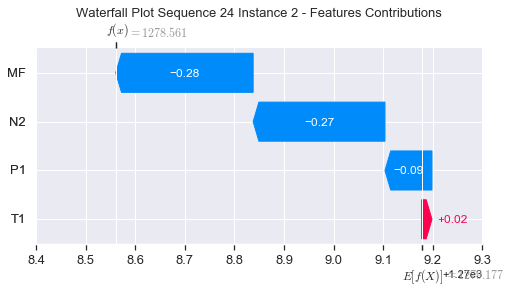

None

Contribution: [0.00111675 0.0008641  0.00369132 0.00357032]


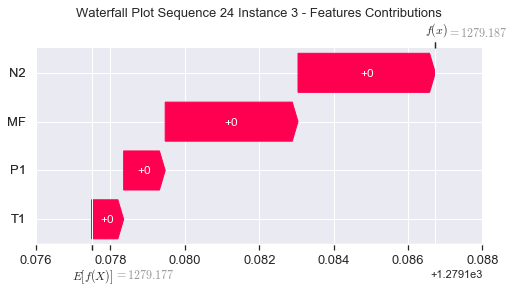

None

Contribution: [0.00167559 0.00129539 0.00510383 0.00487846]


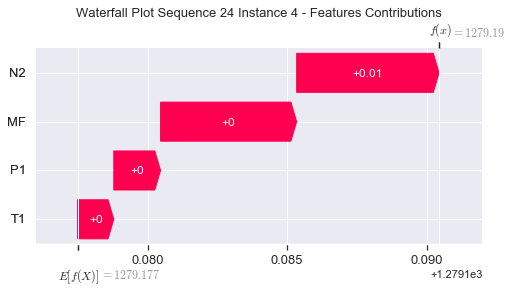

None

Contribution: [0.00182598 0.00143982 0.00561615 0.00529558]


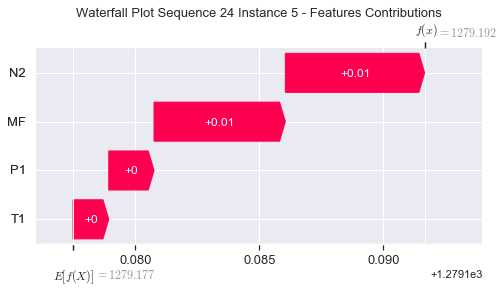

None

Contribution: [0.00200155 0.00157633 0.00617171 0.005815  ]


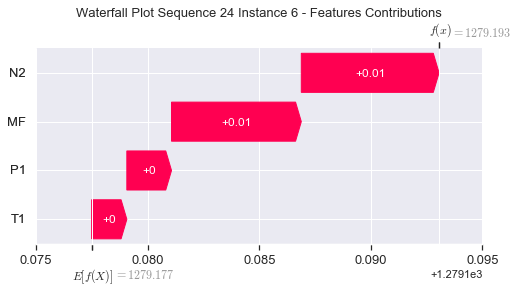

None

Contribution: [0.00215839 0.00170439 0.00664901 0.00627225]


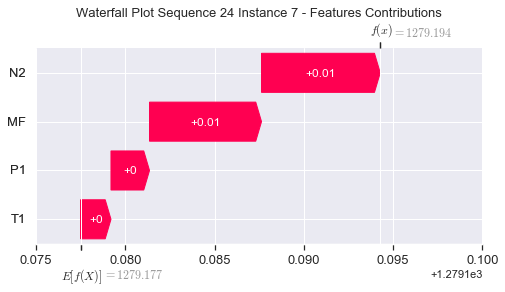

None

Contribution: [0.00219905 0.00174348 0.00678846 0.00639635]


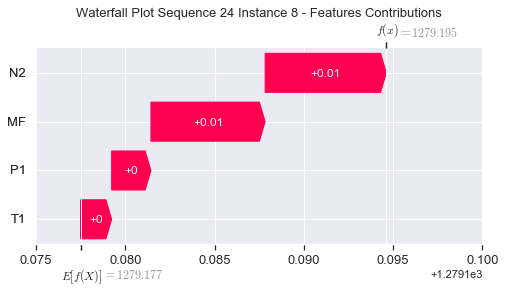

None

Contribution: [0.00216197 0.00174738 0.00672207 0.00629167]


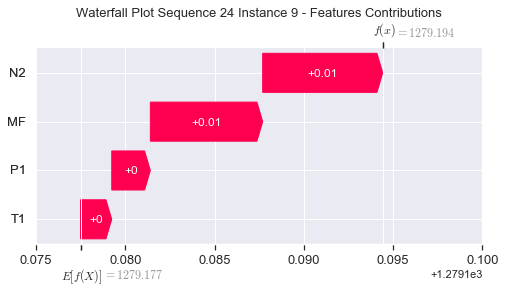

None

Contribution: [0.00215479 0.00168055 0.00663697 0.00630519]


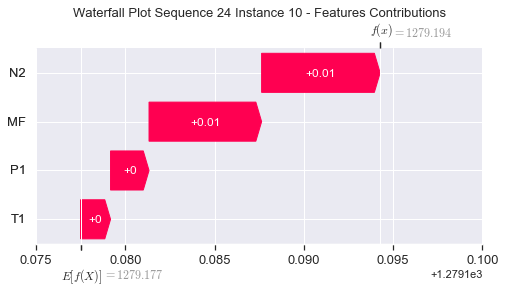

None

Contribution: [0.00210038 0.00167193 0.00654895 0.00613039]


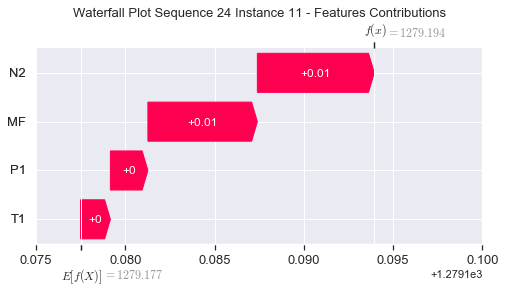

None

Contribution: [0.00210836 0.00165688 0.00648155 0.00614729]


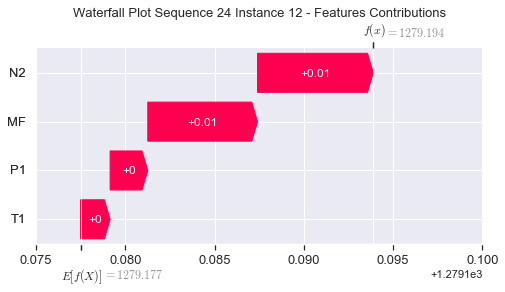

None

Contribution: [0.00208029 0.00165379 0.00639096 0.00606002]


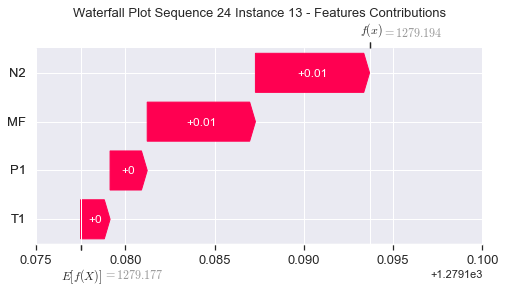

None

Contribution: [0.00196553 0.00156095 0.00609479 0.00572459]


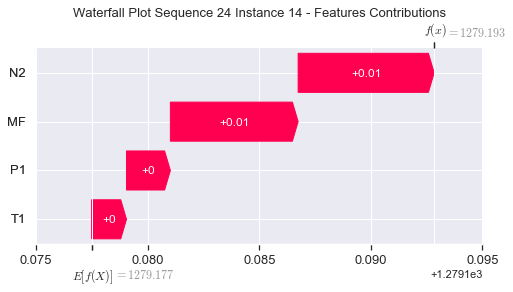

None

Contribution: [0.00178767 0.00143784 0.00547111 0.00520405]


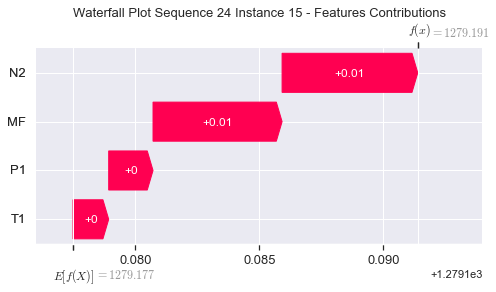

None

Contribution: [0.00140862 0.00111035 0.00438661 0.00416063]


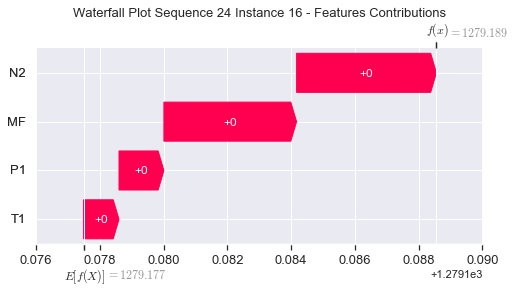

None

Contribution: [0.00133828 0.00114785 0.00410142 0.00391356]


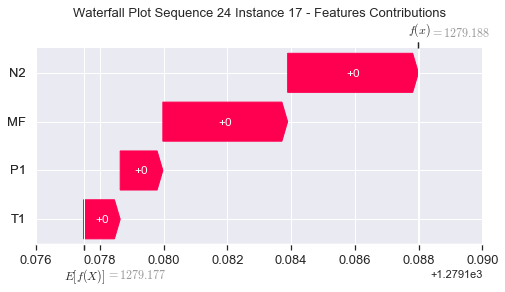

None

Contribution: [0.00329466 0.00302383 0.01045311 0.00976123]


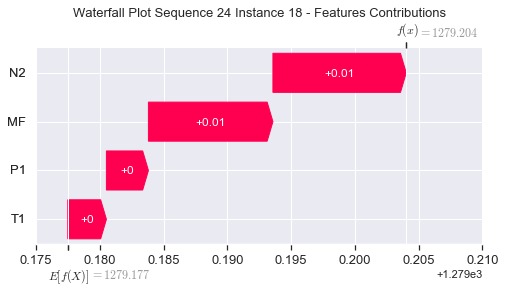

None

Contribution: [0.01347957 0.01257086 0.0435074  0.04014499]


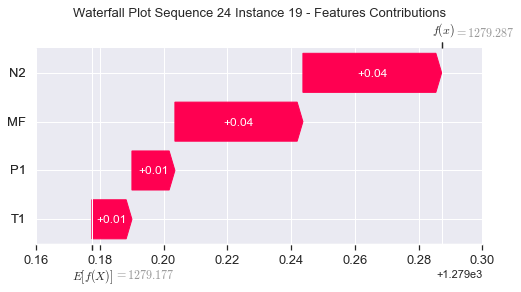

None

Contribution: [0.04859398 0.0450876  0.15538069 0.14395773]


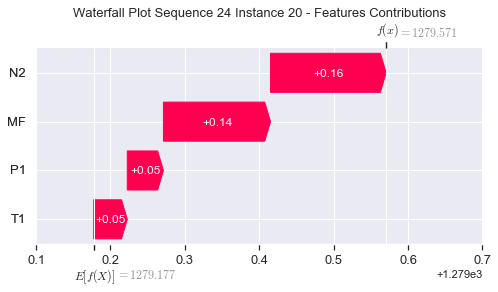

None

Contribution: [0.14301439 0.1308968  0.45584829 0.42335179]


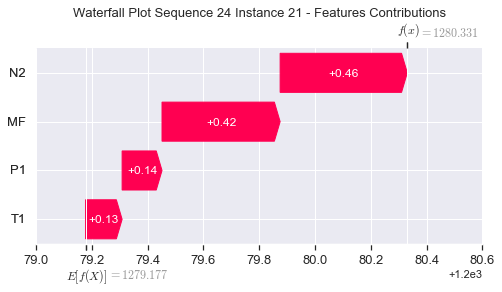

None

Contribution: [0.34573357 0.30264471 1.09690503 1.02681572]


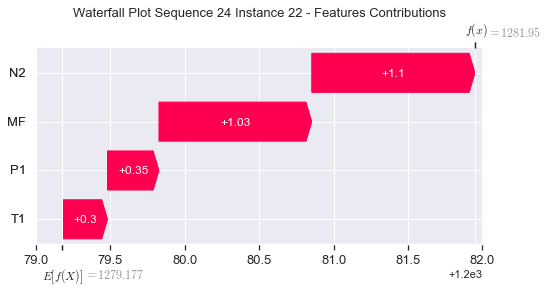

None

Contribution: [0.65065607 0.42606419 2.08370691 2.01983355]


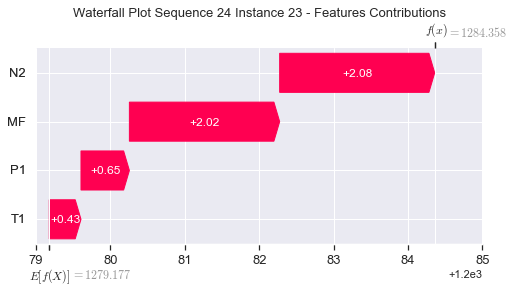

None

Contribution: [ 0.89140189 -0.43030938  2.62785482  2.82033947]


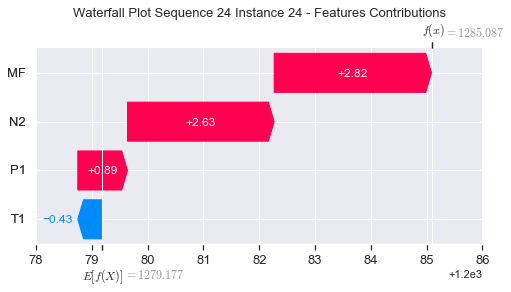

None

Contribution: [ 0.78529858 -0.09172834  2.33205786  2.2875042 ]


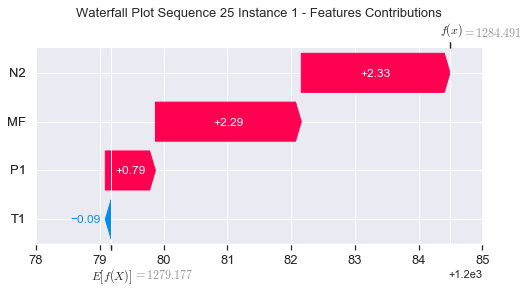

None

Contribution: [-0.10323544 -0.00340151 -0.26856419 -0.29975651]


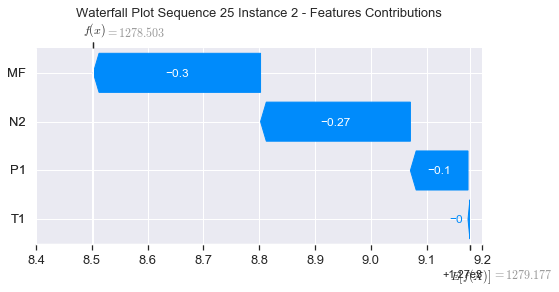

None

Contribution: [0.0011325  0.00091316 0.00369588 0.00362456]


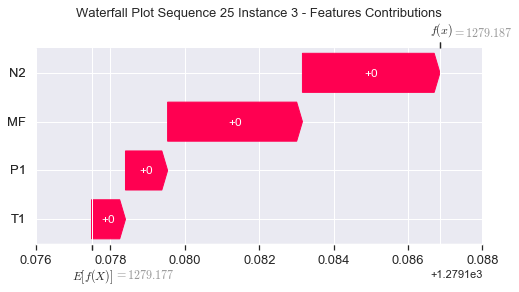

None

Contribution: [0.00159852 0.00132576 0.00507771 0.00479359]


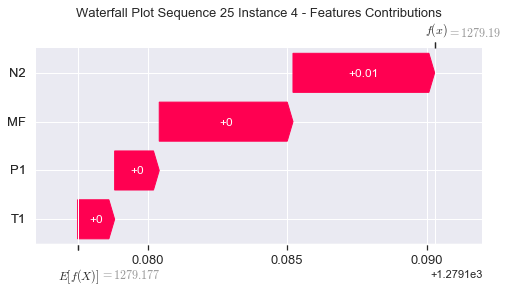

None

Contribution: [0.00179904 0.00155653 0.00560032 0.0052396 ]


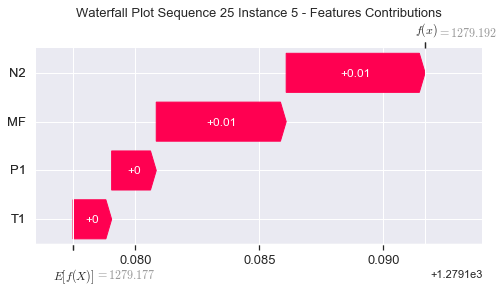

None

Contribution: [0.00196966 0.00166827 0.00615132 0.00575232]


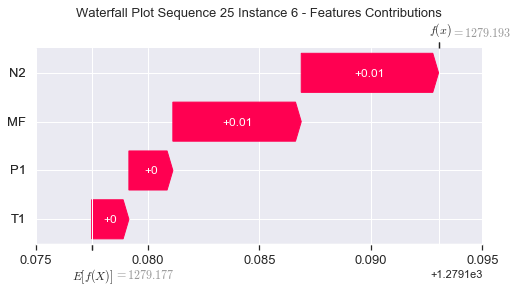

None

Contribution: [0.00212002 0.0017813  0.00662229 0.00620213]


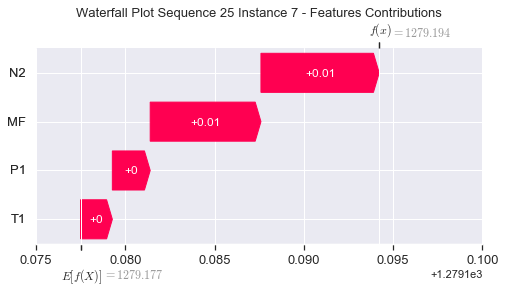

None

Contribution: [0.00216982 0.00183452 0.0067664  0.00634791]


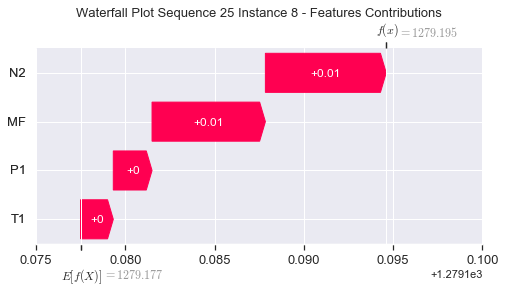

None

Contribution: [0.00217535 0.00183946 0.00672119 0.00639971]


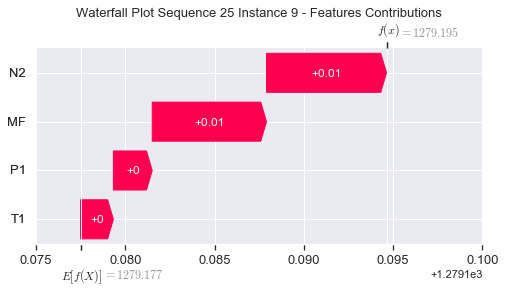

None

Contribution: [0.00206646 0.00173013 0.00660085 0.00613623]


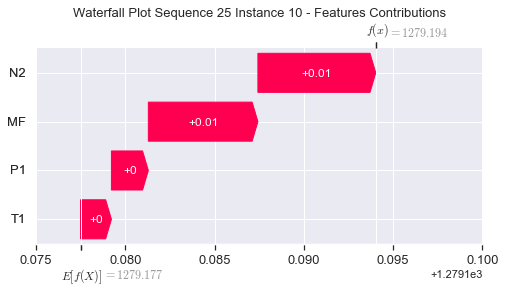

None

Contribution: [0.00212082 0.00182078 0.00655603 0.00622713]


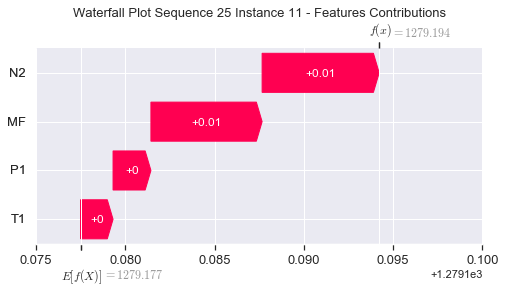

None

Contribution: [0.00207765 0.00175545 0.00646551 0.0060923 ]


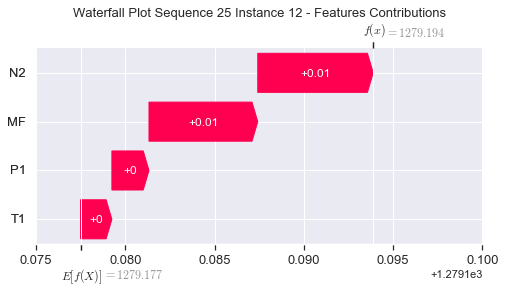

None

Contribution: [0.00205022 0.00173752 0.00637779 0.00601017]


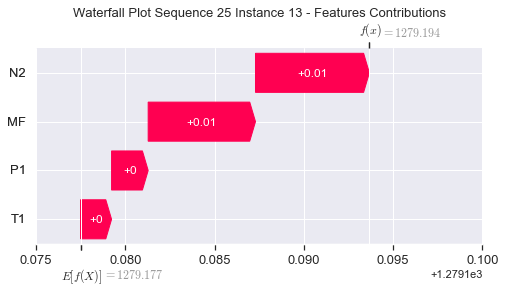

None

Contribution: [0.00197474 0.00163964 0.00609097 0.00571351]


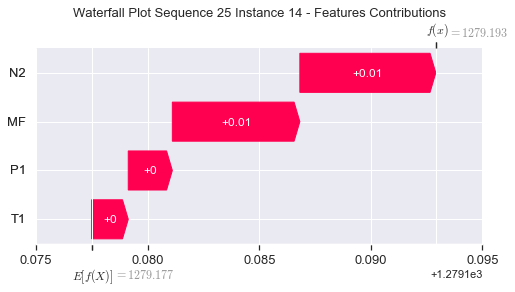

None

Contribution: [0.00176207 0.00150014 0.00546198 0.00516394]


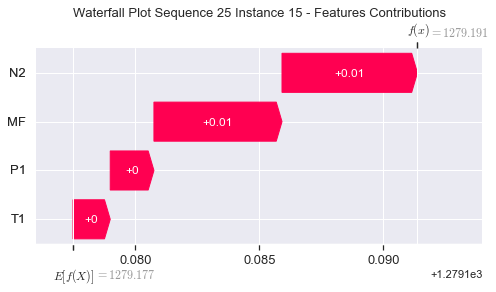

None

Contribution: [0.00137702 0.00114752 0.0043738  0.00409787]


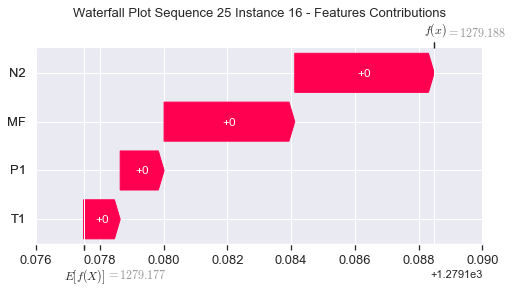

None

Contribution: [0.0013128  0.00117669 0.00408546 0.00387424]


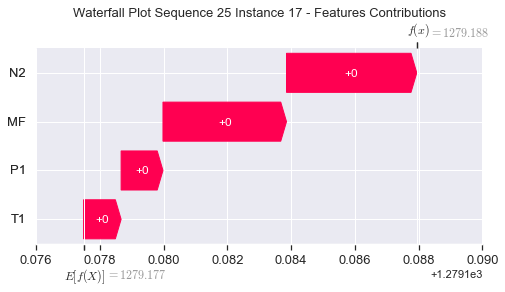

None

Contribution: [0.00324897 0.00308161 0.01043764 0.00969532]


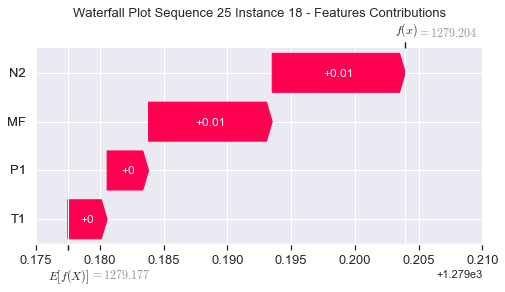

None

Contribution: [0.01360768 0.01265716 0.04341515 0.04023134]


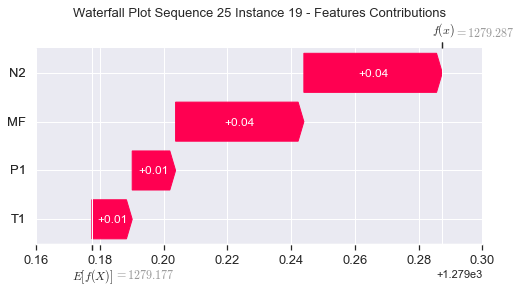

None

Contribution: [0.04814972 0.04547752 0.15547842 0.14357553]


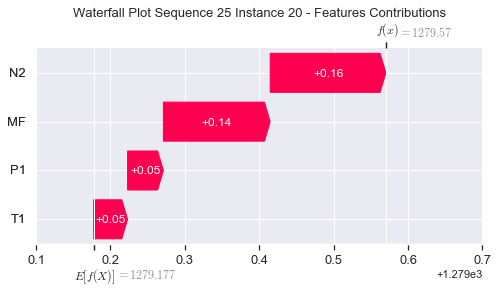

None

Contribution: [0.14164738 0.1327455  0.45597679 0.4220545 ]


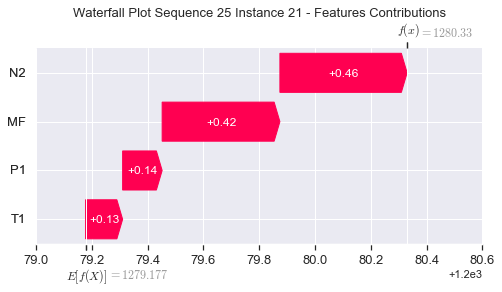

None

Contribution: [0.34178614 0.31099974 1.09690679 1.0223071 ]


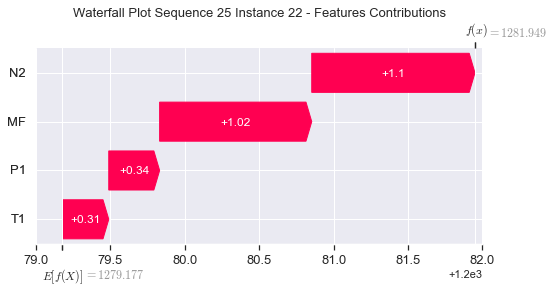

None

Contribution: [0.63628175 0.4526584  2.08429014 2.00238404]


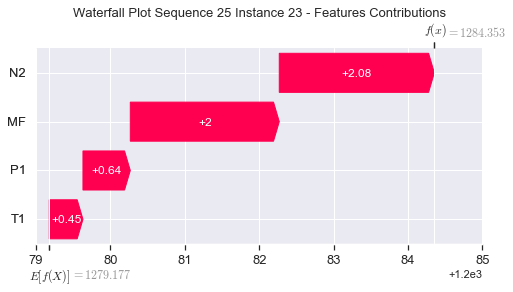

None

Contribution: [ 0.83226822 -0.3059911   2.65008284  2.85274165]


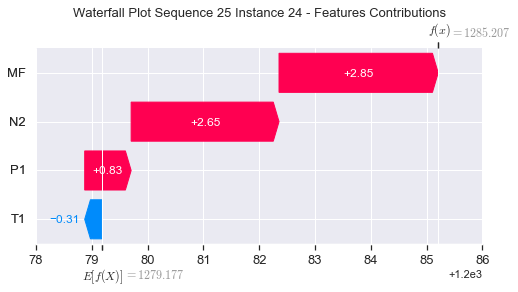

None

Contribution: [0.75490934 0.00258136 2.36883759 2.52145907]


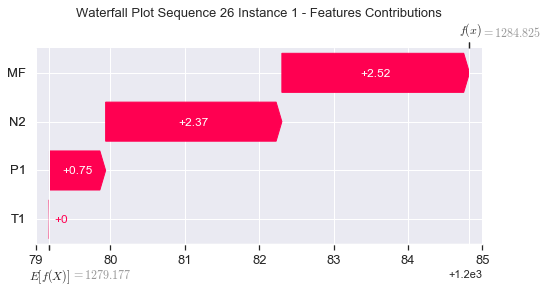

None

Contribution: [-0.09843604 -0.01578503 -0.2666061  -0.29277957]


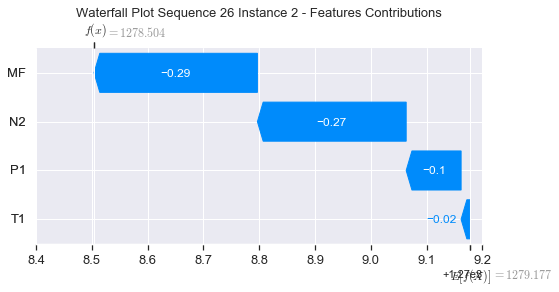

None

Contribution: [0.0011223  0.00098659 0.00368127 0.00361273]


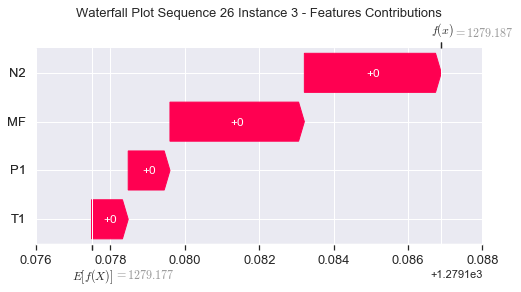

None

Contribution: [0.00162978 0.00145357 0.00507658 0.00483232]


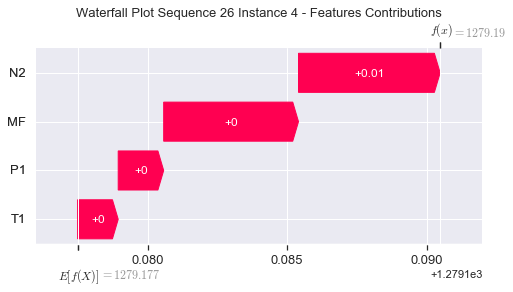

None

Contribution: [0.00180665 0.00162497 0.00559229 0.00528616]


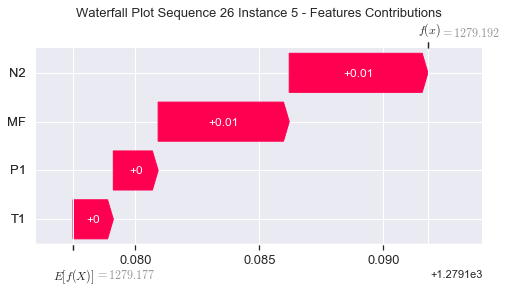

None

Contribution: [0.00196269 0.00173864 0.00613642 0.00577584]


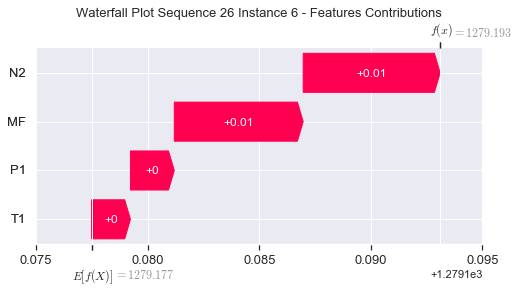

None

Contribution: [0.00211601 0.00186307 0.00660811 0.00622967]


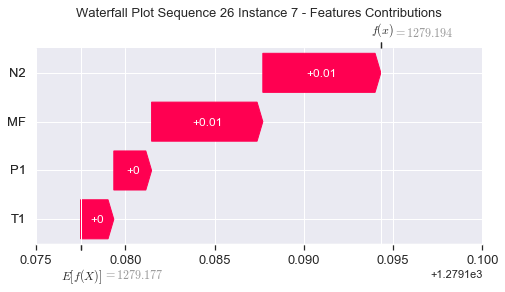

None

Contribution: [0.00216328 0.00190078 0.00674702 0.00635946]


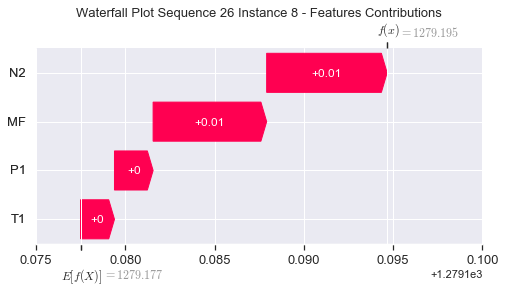

None

Contribution: [0.00215015 0.00190083 0.00668548 0.00630389]


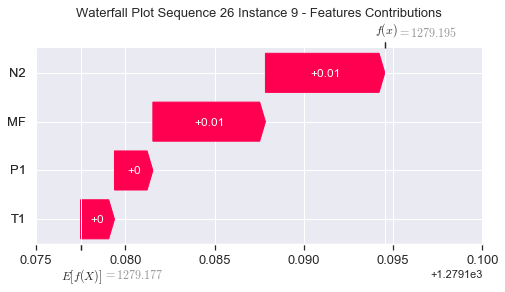

None

Contribution: [0.00211976 0.0018651  0.00659822 0.00625497]


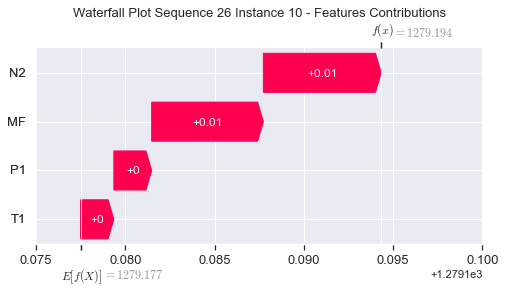

None

Contribution: [0.00210352 0.0018296  0.006518   0.00613872]


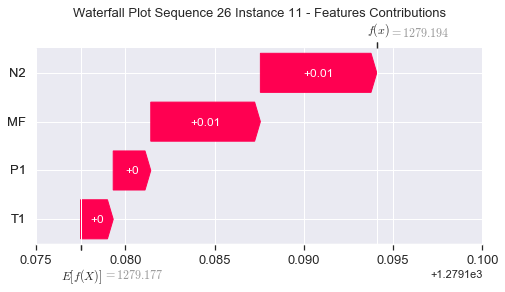

None

Contribution: [0.00210073 0.00179725 0.00644568 0.00613457]


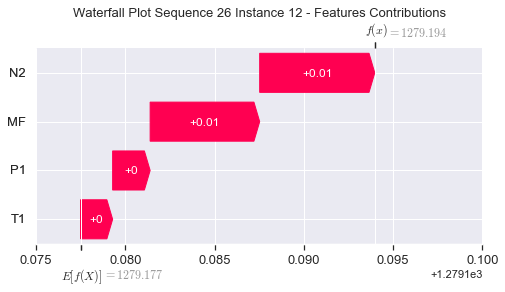

None

Contribution: [0.00206868 0.00178236 0.00635644 0.00604727]


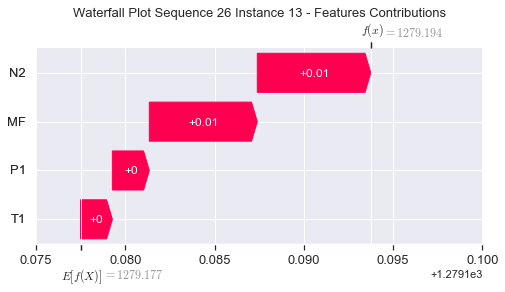

None

Contribution: [0.00196394 0.00170151 0.0060721  0.00576424]


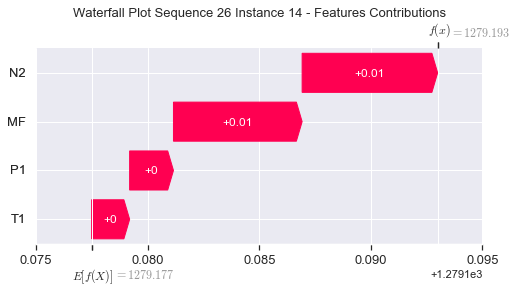

None

Contribution: [0.00177056 0.00152407 0.00545178 0.00519622]


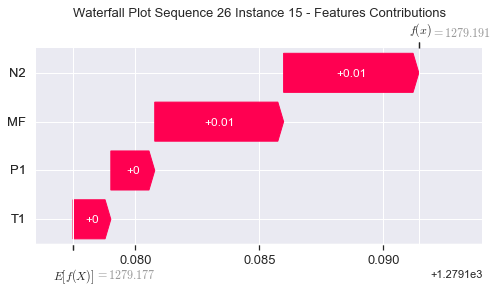

None

Contribution: [0.00142222 0.00127378 0.00440646 0.00421753]


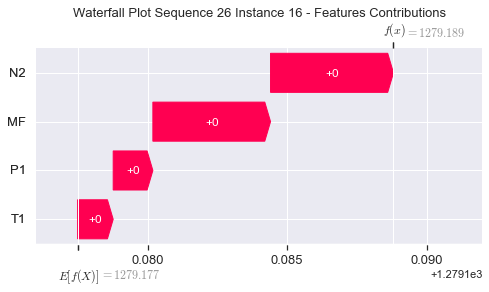

None

Contribution: [0.0013257  0.00120471 0.00410744 0.00392351]


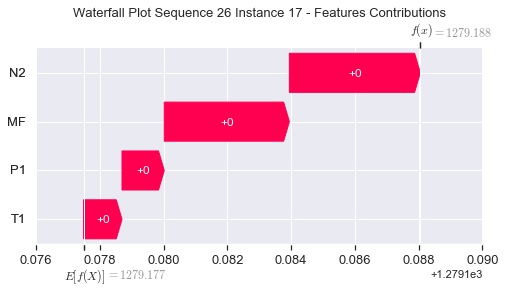

None

Contribution: [0.00326344 0.00311542 0.01046746 0.00977868]


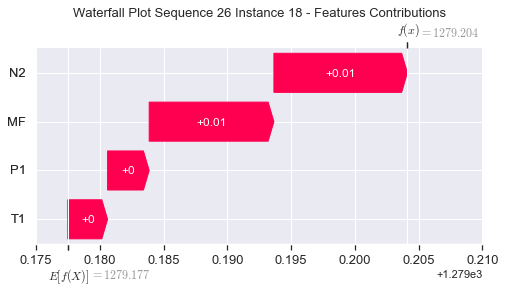

None

Contribution: [0.01346666 0.01291671 0.04339552 0.04024956]


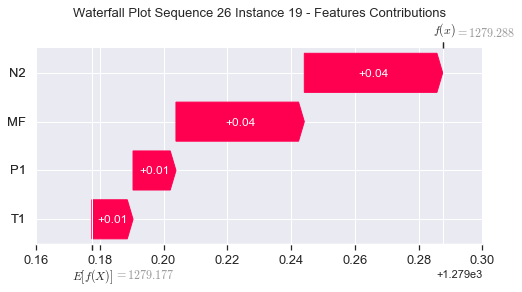

None

Contribution: [0.04801887 0.04547394 0.15543103 0.1440034 ]


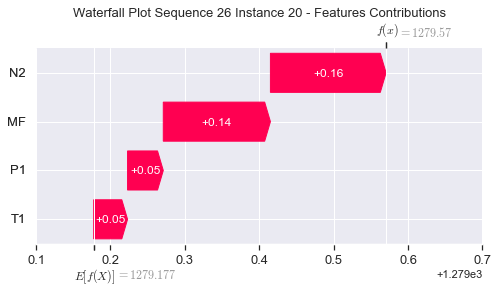

None

Contribution: [0.141622   0.13193284 0.4558543  0.42375782]


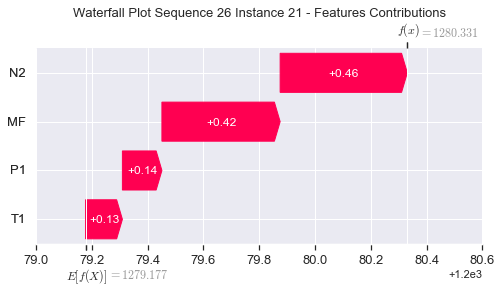

None

Contribution: [0.34245122 0.30446816 1.09702914 1.02874927]


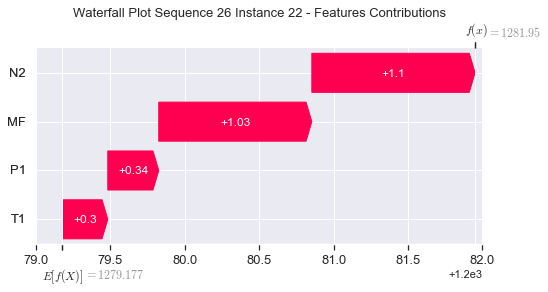

None

Contribution: [0.63559434 0.42319436 2.08301474 2.02138279]


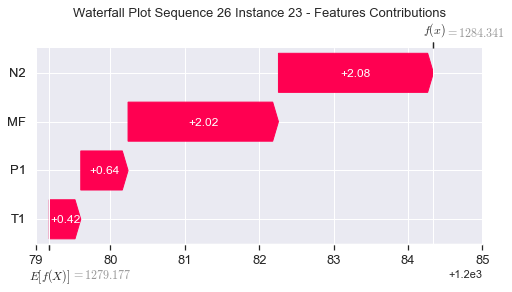

None

Contribution: [ 0.7974687  -0.47623461  2.61680215  2.83260968]


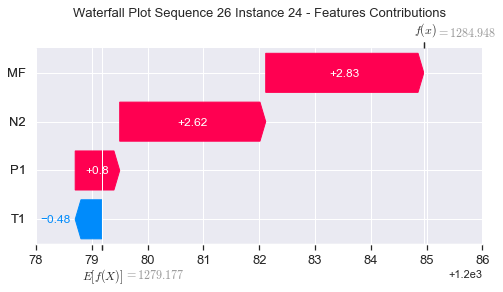

None

Contribution: [ 0.72894486 -0.11960252  2.32489845  2.3701566 ]


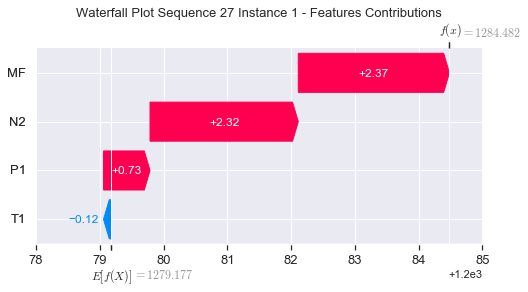

None

Contribution: [-0.10590156 -0.00385624 -0.27020334 -0.30896906]


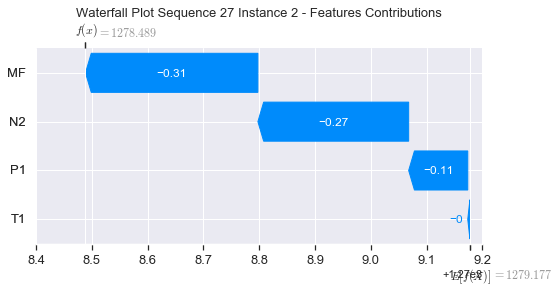

None

Contribution: [0.00112268 0.00089717 0.00369219 0.00367462]


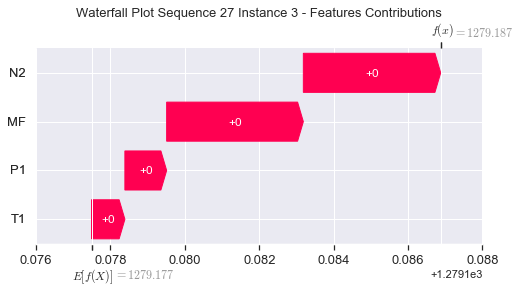

None

Contribution: [0.00164466 0.00143137 0.00509712 0.0049045 ]


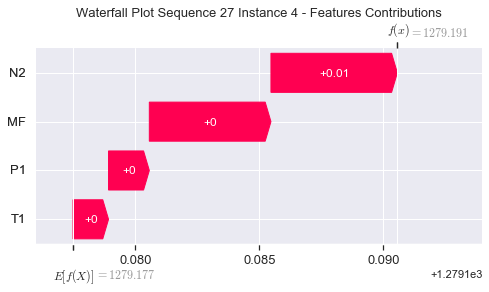

None

Contribution: [0.0017734  0.00149524 0.00559011 0.00524751]


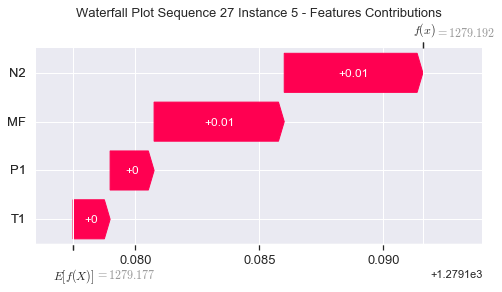

None

Contribution: [0.00197769 0.00167301 0.00615294 0.00581032]


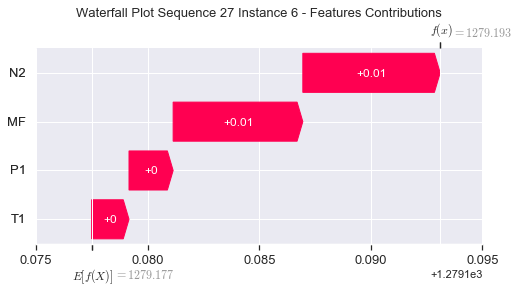

None

Contribution: [0.00212898 0.00180662 0.00662622 0.00624978]


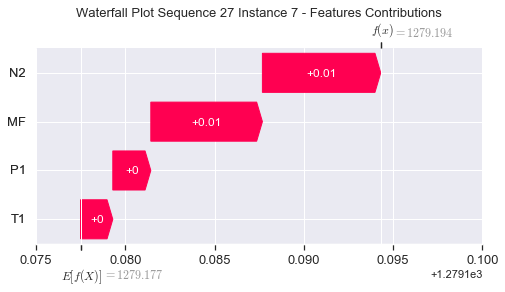

None

Contribution: [0.00217139 0.00184026 0.0067695  0.00638418]


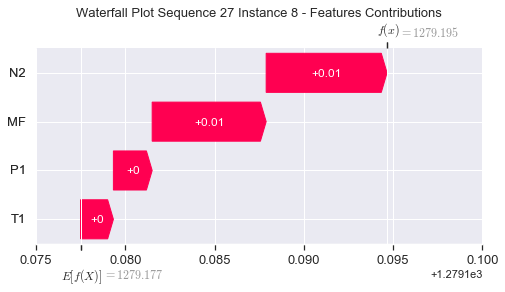

None

Contribution: [0.00214174 0.0018586  0.00671091 0.00629923]


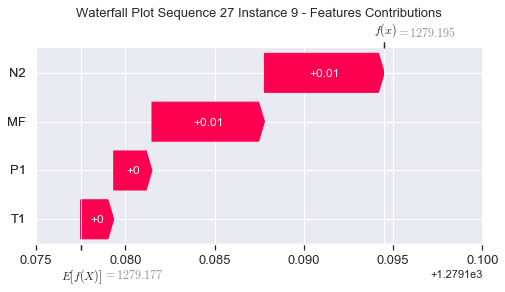

None

Contribution: [0.00211517 0.00181417 0.00662352 0.0062212 ]


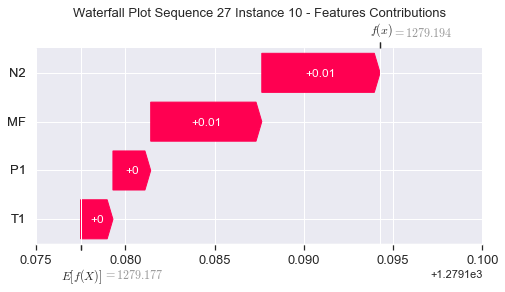

None

Contribution: [0.00208744 0.00175531 0.00654603 0.00614619]


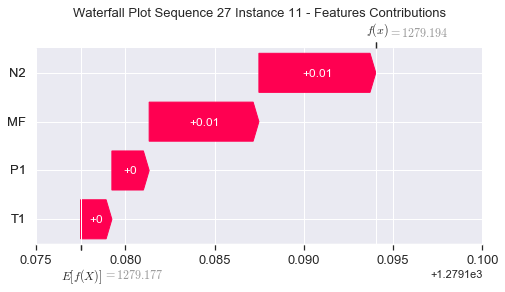

None

Contribution: [0.00205786 0.00171733 0.00645425 0.00605463]


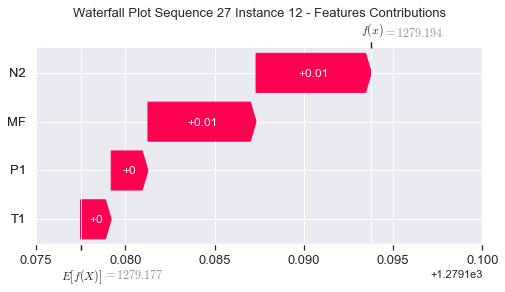

None

Contribution: [0.00202946 0.00171456 0.00636061 0.00597118]


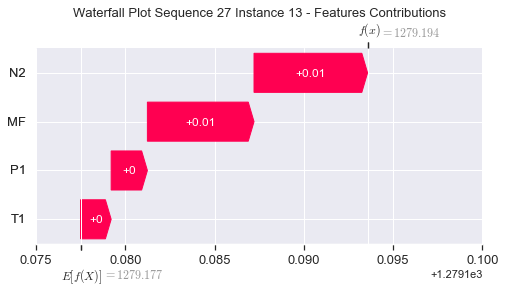

None

Contribution: [0.00194059 0.0016743  0.00608033 0.00574516]


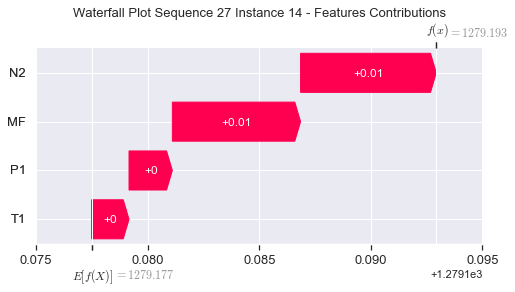

None

Contribution: [0.00174385 0.00149233 0.00544072 0.00513407]


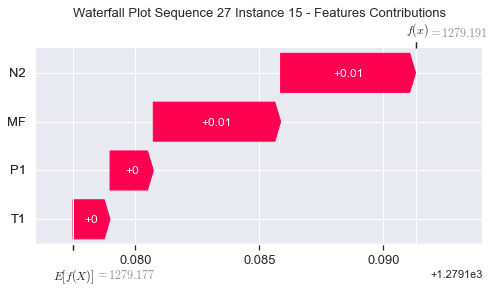

None

Contribution: [0.00142052 0.00125891 0.00439101 0.00418311]


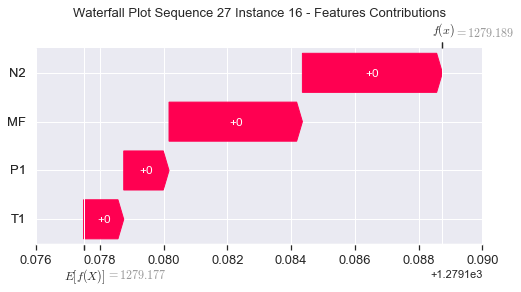

None

Contribution: [0.00130723 0.00119977 0.00407447 0.00386559]


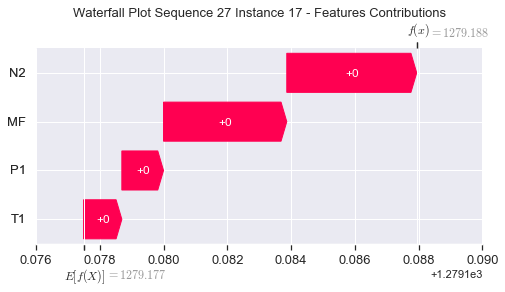

None

Contribution: [0.00325145 0.00314521 0.01043772 0.00972416]


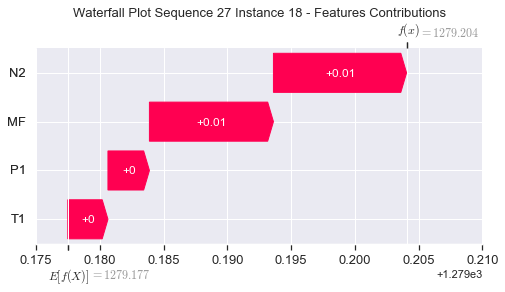

None

Contribution: [0.01344987 0.01286721 0.043409   0.03989492]


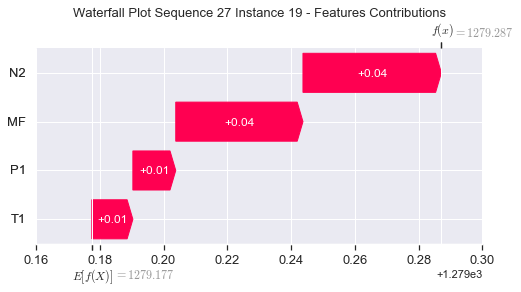

None

Contribution: [0.04815391 0.04645919 0.15548981 0.14408363]


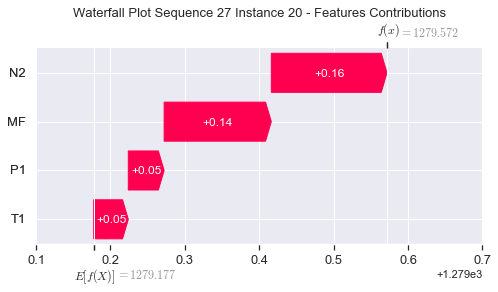

None

Contribution: [0.14119049 0.13429294 0.45621146 0.42296115]


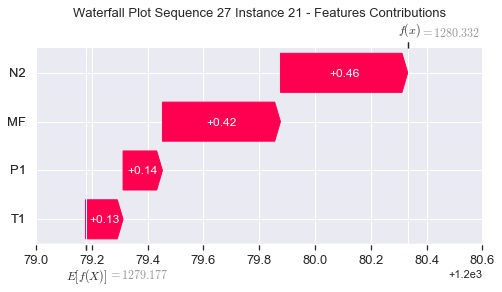

None

Contribution: [0.33822377 0.30880968 1.09679113 1.0221618 ]


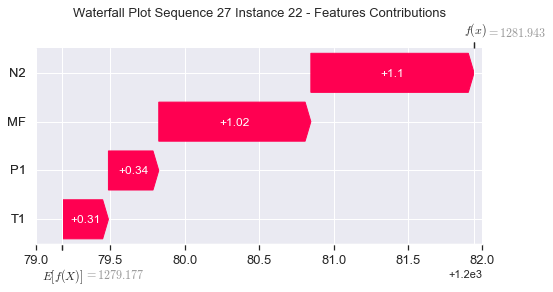

None

Contribution: [0.62754255 0.45311273 2.0773315  2.00830156]


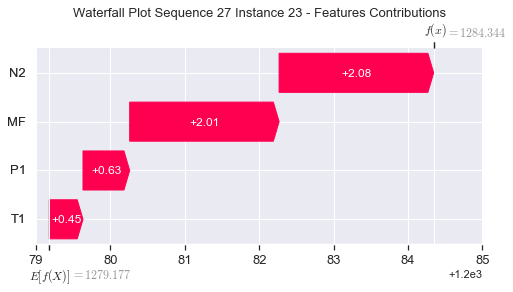

None

Contribution: [ 0.78098727 -0.28884851  2.60247741  2.84869286]


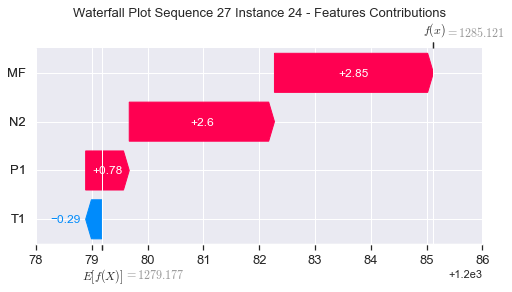

None

Contribution: [0.67705379 0.0505081  2.31985871 2.33044662]


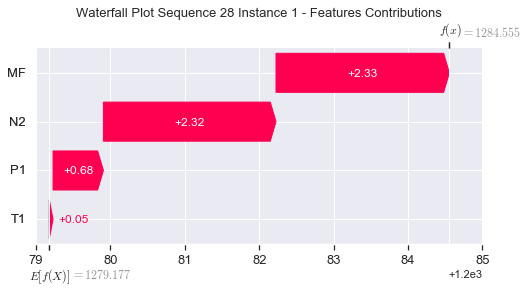

None

Contribution: [-0.08741178 -0.00074971 -0.26471466 -0.27789006]


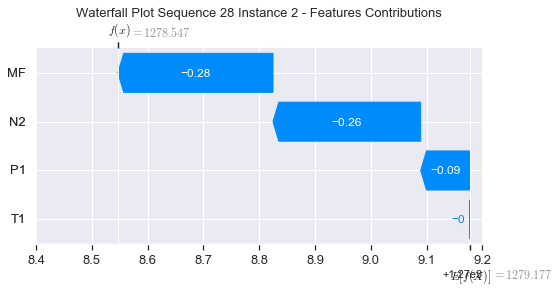

None

Contribution: [0.00105358 0.00091337 0.00366424 0.0034983 ]


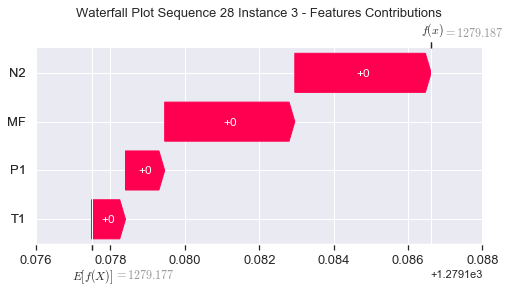

None

Contribution: [0.00164727 0.00143955 0.0050862  0.00488029]


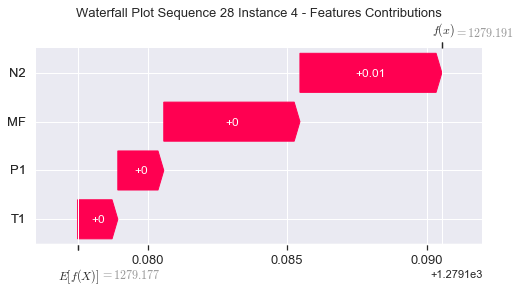

None

Contribution: [0.00184817 0.00158445 0.0056081  0.0053789 ]


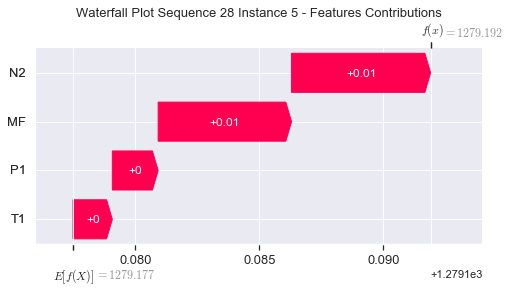

None

Contribution: [0.0019972  0.00181472 0.00614506 0.00584303]


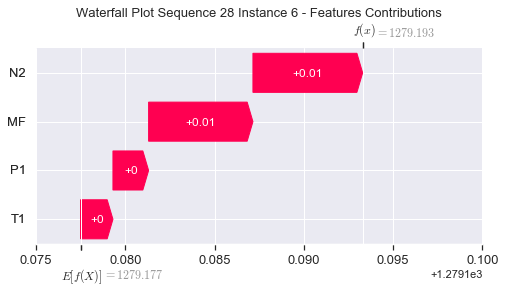

None

Contribution: [0.00212919 0.00198968 0.00661608 0.00628704]


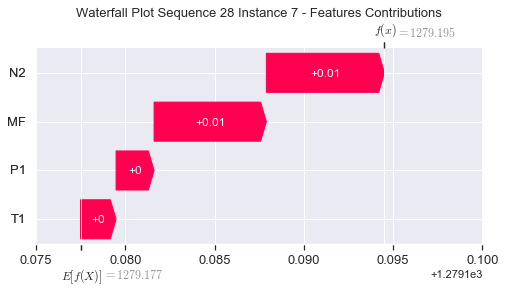

None

Contribution: [0.00219524 0.00195741 0.00675623 0.00642022]


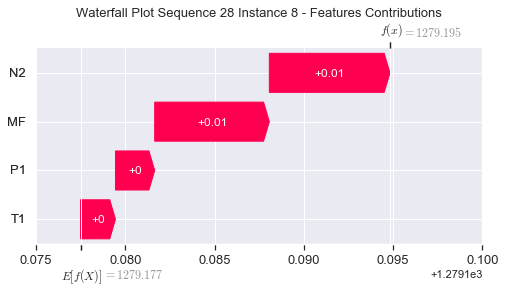

None

Contribution: [0.00216661 0.002096   0.00673089 0.00639581]


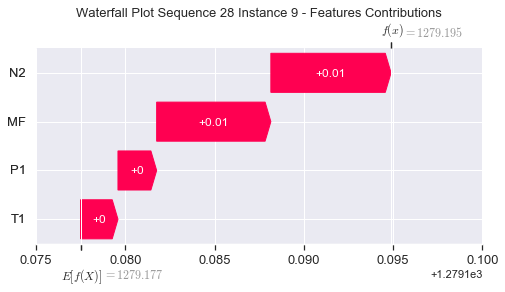

None

Contribution: [0.00219886 0.00203149 0.00665449 0.00639874]


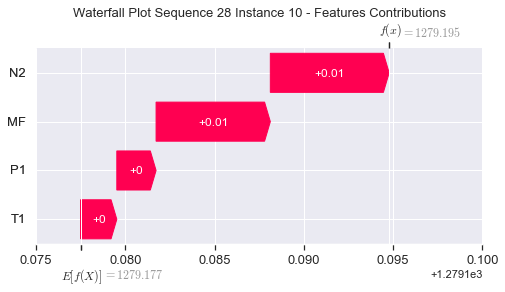

None

Contribution: [0.00217001 0.00185561 0.00657327 0.00621619]


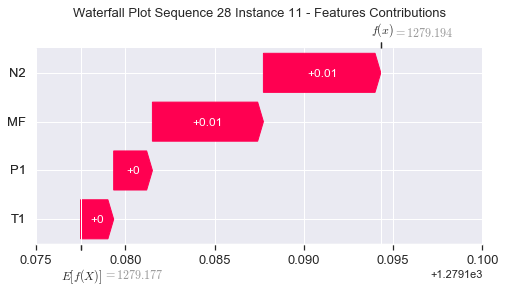

None

Contribution: [0.00211768 0.00176879 0.00648931 0.00617598]


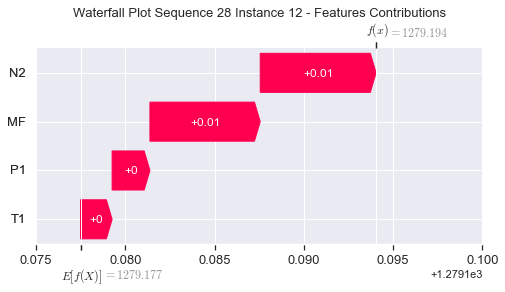

None

Contribution: [0.0020877  0.00174865 0.00640248 0.00609668]


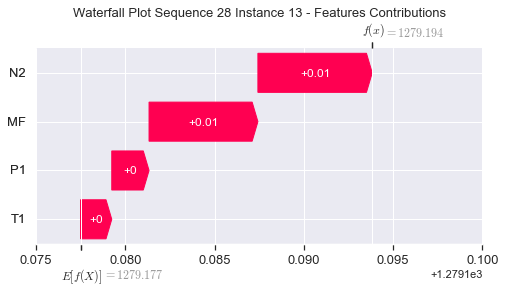

None

Contribution: [0.00194807 0.001616   0.00609315 0.0057033 ]


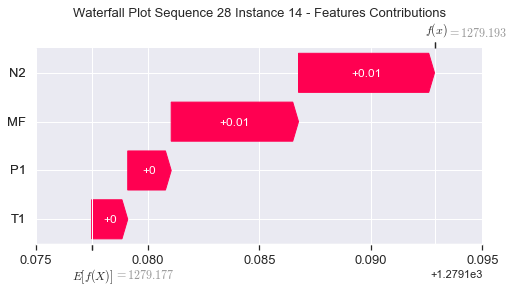

None

Contribution: [0.00179432 0.00143521 0.00545907 0.00519511]


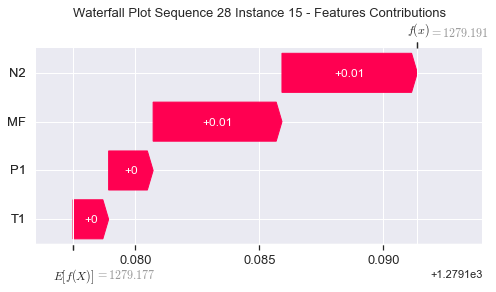

None

Contribution: [0.00147497 0.00121583 0.00440536 0.0042608 ]


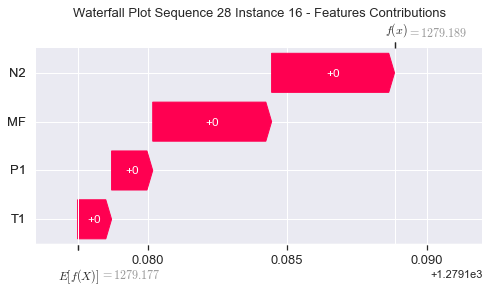

None

Contribution: [0.00135261 0.00111622 0.00411913 0.00392928]


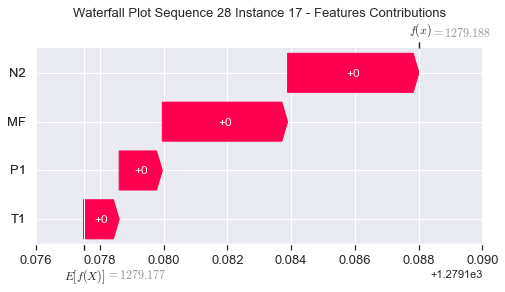

None

Contribution: [0.00343982 0.00290253 0.01077353 0.01005216]


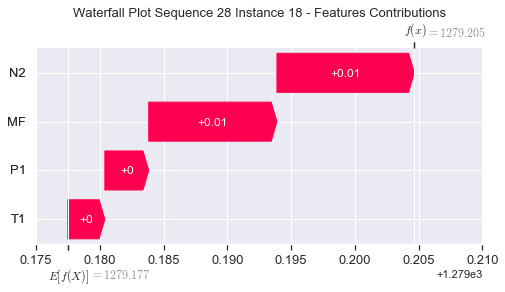

None

Contribution: [0.01393935 0.01173707 0.04487301 0.04160849]


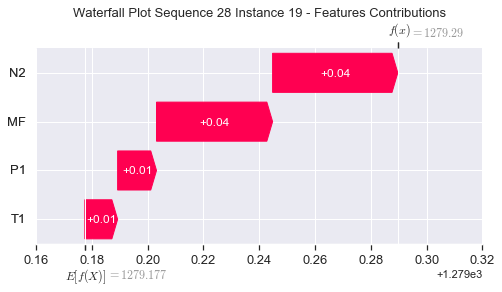

None

Contribution: [0.05100929 0.04075013 0.15996973 0.14837771]


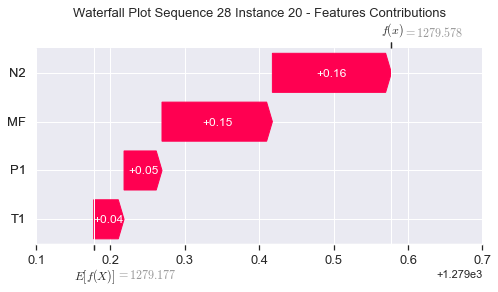

None

Contribution: [0.15057531 0.11198395 0.46710632 0.43451361]


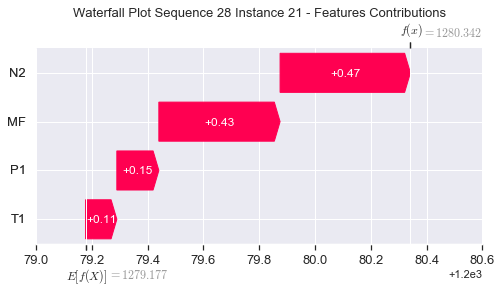

None

Contribution: [0.36929772 0.22005561 1.1186381  1.04900433]


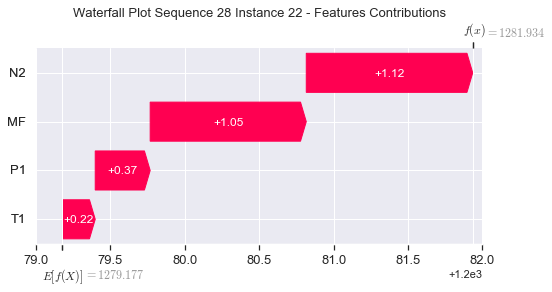

None

Contribution: [0.72752858 0.0756482  2.11193945 2.04696725]


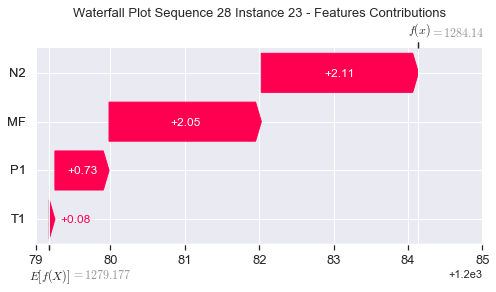

None

Contribution: [ 1.49555734 -2.48122862  2.72724796  3.311868  ]


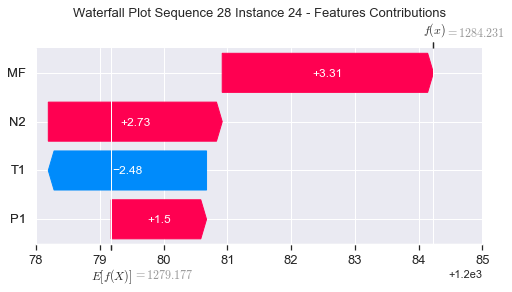

None

Contribution: [ 1.5696313  -1.82299046  2.50071043  3.33285834]


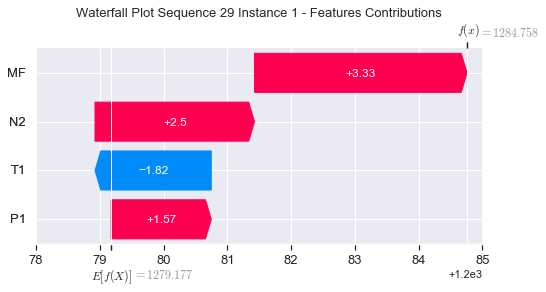

None

Contribution: [-0.12660712  0.11314969 -0.26736039 -0.30068258]


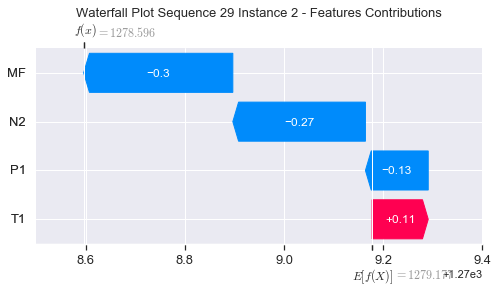

None

Contribution: [0.00126103 0.0003604  0.00374836 0.00369495]


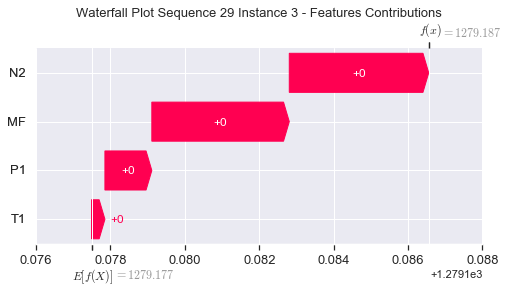

None

Contribution: [0.00192613 0.00071772 0.0052343  0.00517885]


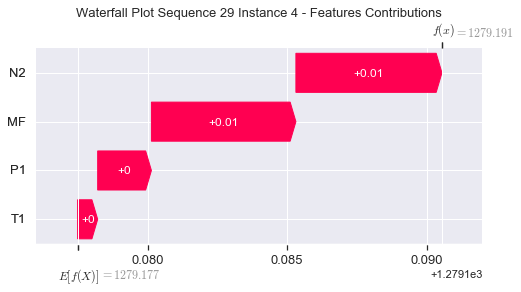

None

Contribution: [0.00199845 0.00084271 0.0057097  0.00537846]


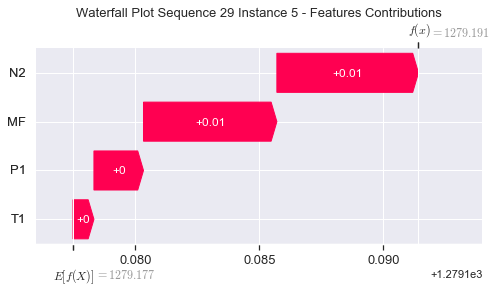

None

Contribution: [0.00232536 0.00085399 0.00631701 0.00610252]


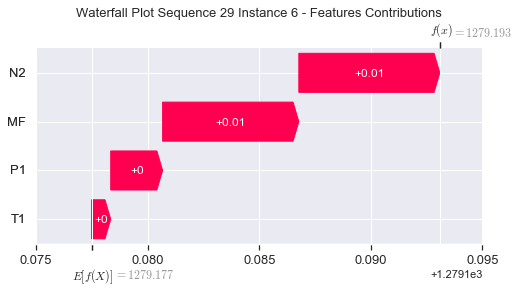

None

Contribution: [0.00249561 0.00091547 0.00680114 0.00656454]


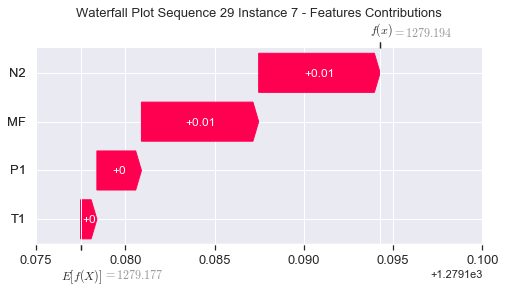

None

Contribution: [0.00251188 0.00100738 0.00694861 0.00668099]


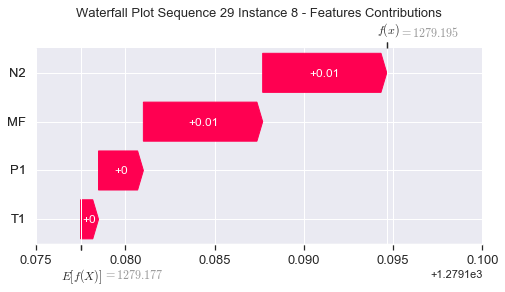

None

Contribution: [0.00246181 0.00093305 0.0068672  0.00655274]


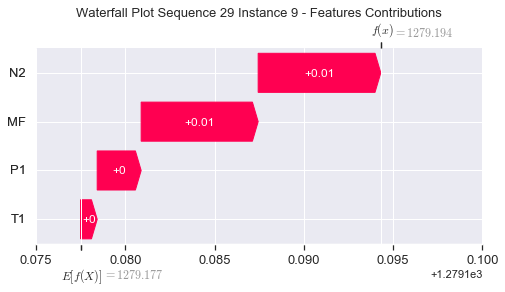

None

Contribution: [0.00225533 0.00094365 0.00672849 0.00629897]


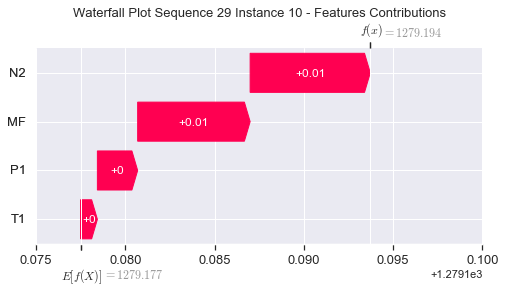

None

Contribution: [0.00241373 0.00094268 0.00669005 0.00646022]


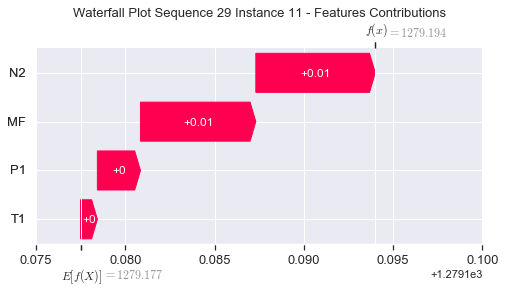

None

Contribution: [0.00241596 0.00090388 0.00659633 0.00645283]


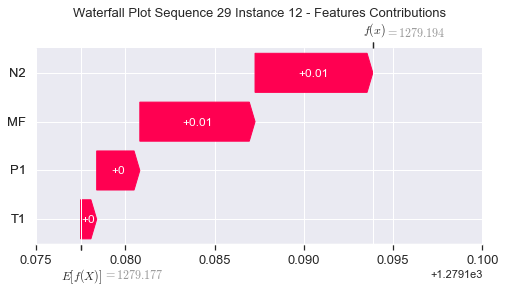

None

Contribution: [0.00234905 0.00094354 0.00648777 0.00630795]


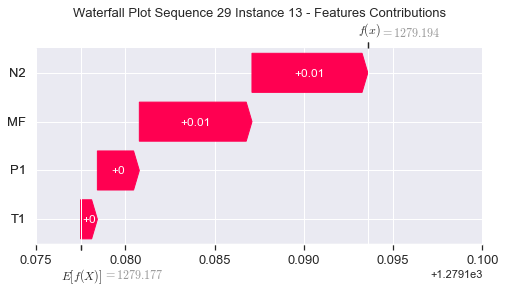

None

Contribution: [0.00236172 0.00094875 0.00621923 0.00611861]


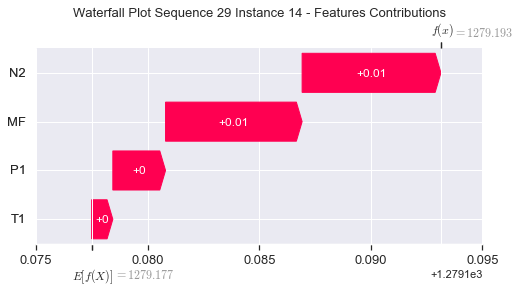

None

Contribution: [0.00200388 0.00086314 0.00553675 0.00539192]


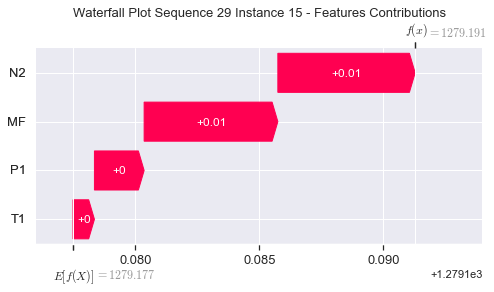

None

Contribution: [0.00166071 0.0005432  0.00446296 0.0044089 ]


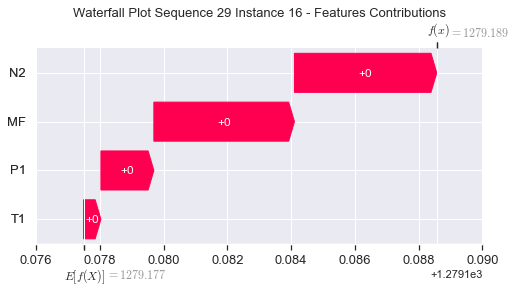

None

Contribution: [0.00152168 0.00069572 0.00421448 0.0041117 ]


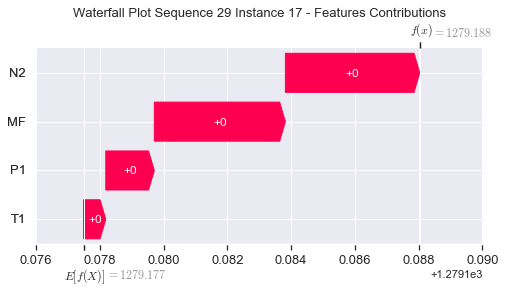

None

Contribution: [0.00374851 0.00221752 0.01100114 0.01045097]


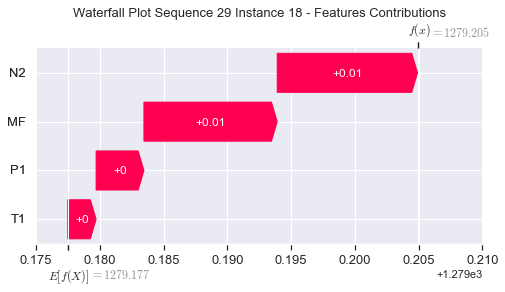

None

Contribution: [0.01449671 0.01116709 0.04521297 0.04175304]


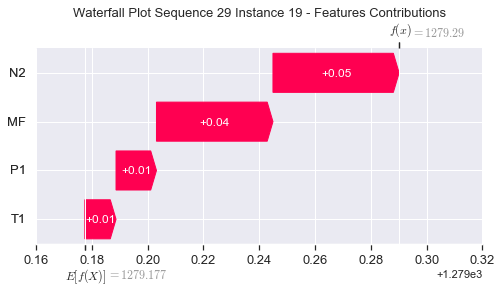

None

Contribution: [0.0515486  0.03773887 0.16077201 0.1487563 ]


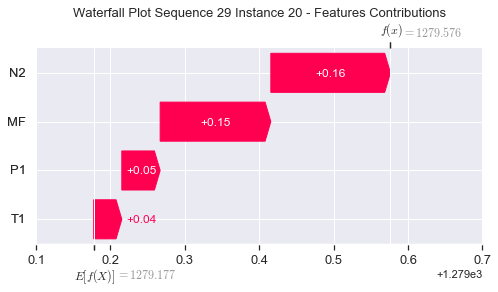

None

Contribution: [0.14912383 0.1089668  0.46747526 0.4327582 ]


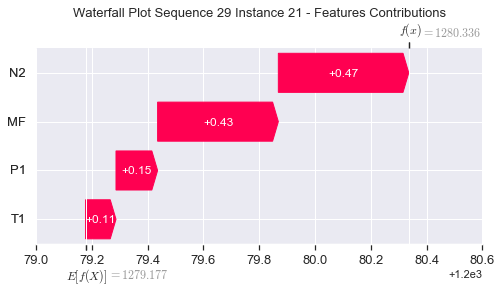

None

Contribution: [0.3512798  0.24506849 1.11581947 1.0341475 ]


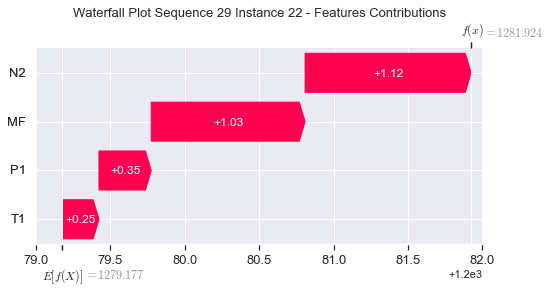

None

Contribution: [0.67454223 0.19851913 2.11192971 2.03712716]


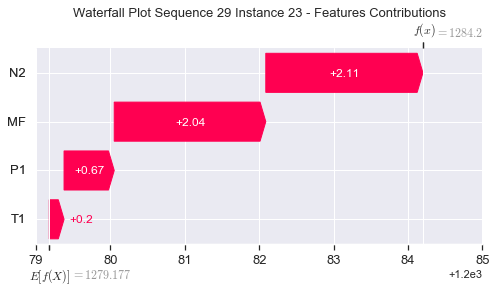

None

Contribution: [ 0.78516529 -1.00114948  2.67257123  2.74113257]


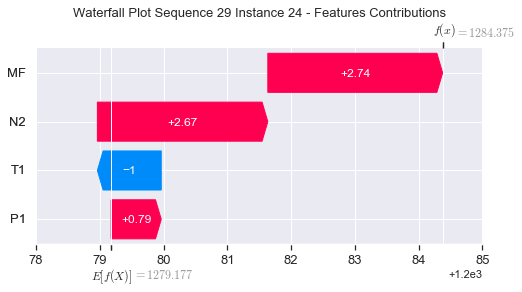

None

Contribution: [ 0.6928113  -0.23908269  2.38751268  2.45801196]


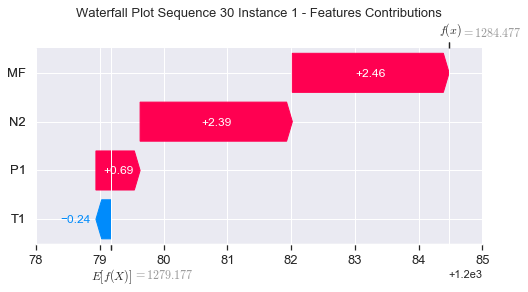

None

Contribution: [-0.08441794  0.03863267 -0.2646012  -0.27403808]


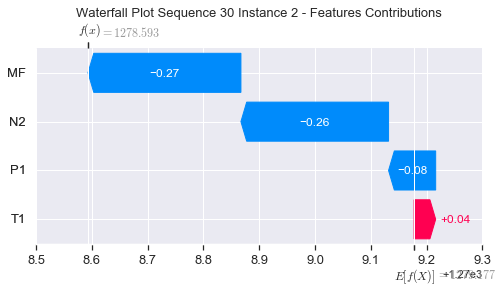

None

Contribution: [0.00108846 0.00075938 0.00370057 0.0035428 ]


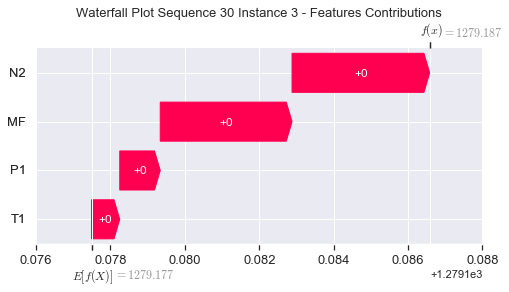

None

Contribution: [0.00151698 0.0011454  0.00508948 0.00474314]


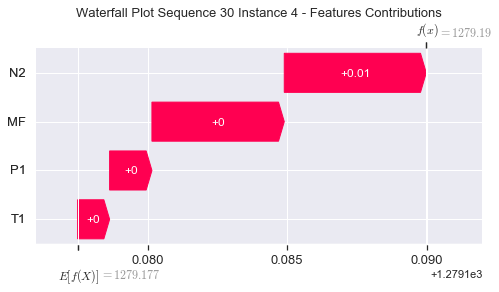

None

Contribution: [0.00181861 0.00157708 0.00564214 0.00533025]


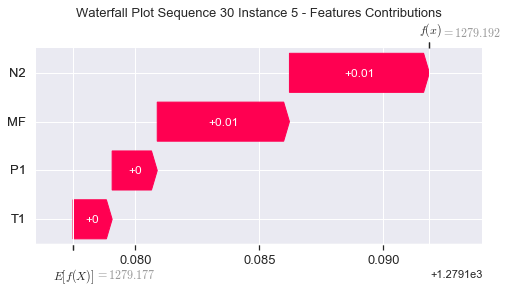

None

Contribution: [0.00198383 0.00168874 0.00618597 0.00581273]


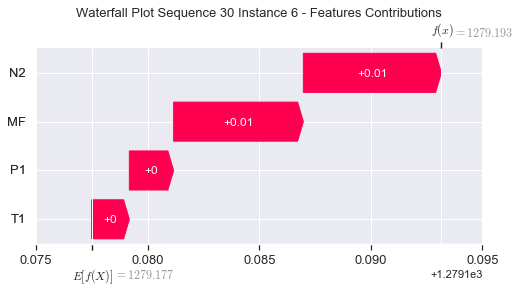

None

Contribution: [0.00213297 0.00181093 0.0066553  0.00624956]


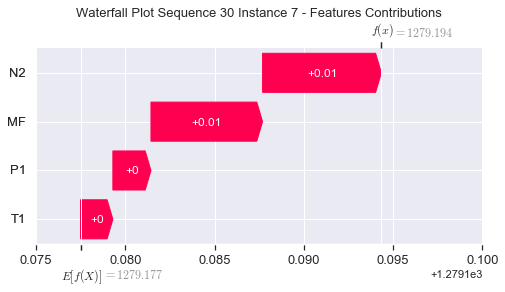

None

Contribution: [0.00217866 0.00185315 0.00679864 0.0063885 ]


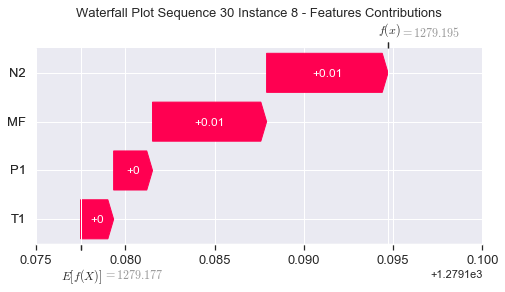

None

Contribution: [0.00216709 0.00190484 0.0067378  0.00635299]


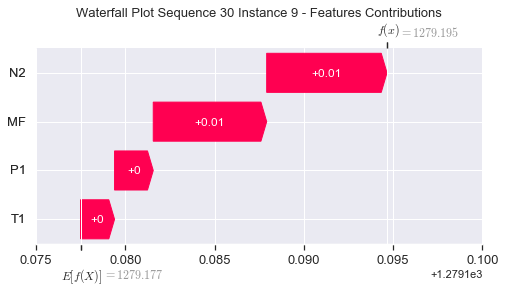

None

Contribution: [0.00215194 0.00182665 0.00666138 0.00624854]


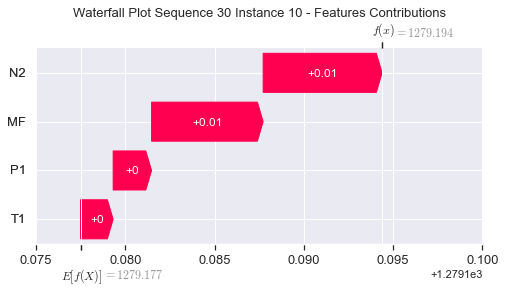

None

Contribution: [0.0020991  0.00182009 0.00659059 0.00619222]


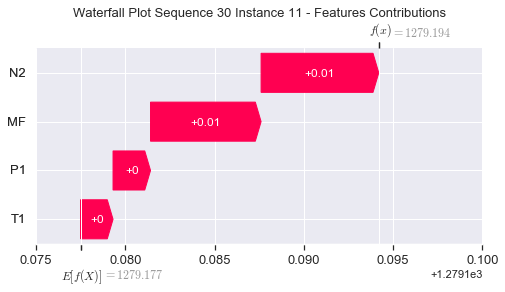

None

Contribution: [0.00206438 0.00172463 0.00650673 0.0060884 ]


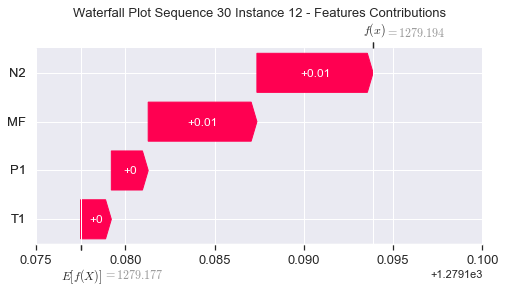

None

Contribution: [0.00203989 0.00171432 0.0064117  0.00600346]


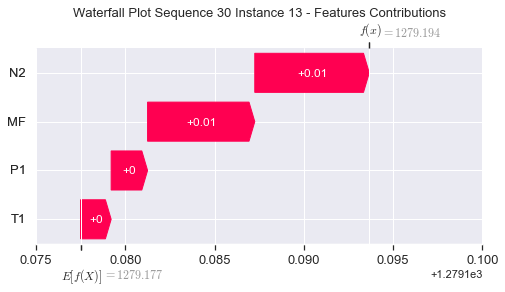

None

Contribution: [0.00195477 0.0015769  0.00610187 0.00564979]


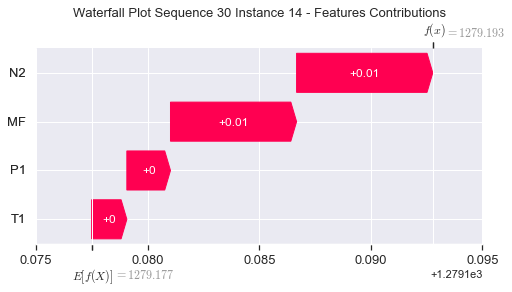

None

Contribution: [0.00174477 0.00146735 0.00547115 0.00513124]


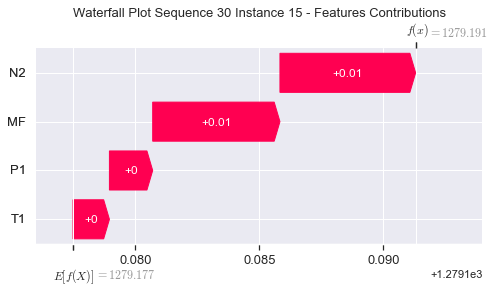

None

Contribution: [0.0014333  0.00120771 0.00441651 0.0042175 ]


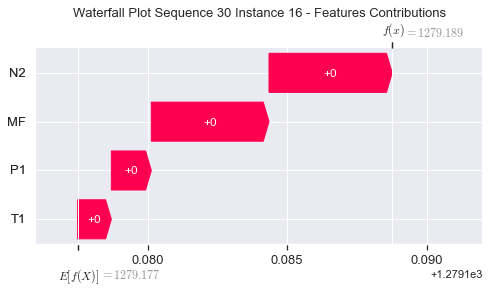

None

Contribution: [0.00130488 0.00115731 0.00411039 0.00385393]


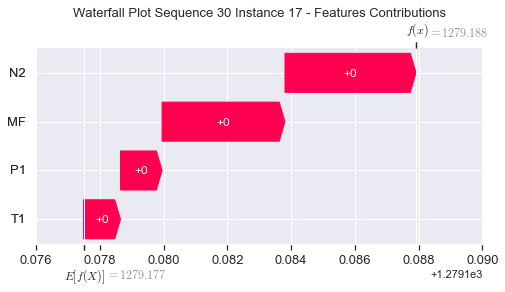

None

Contribution: [0.00328015 0.0030673  0.01064915 0.00979499]


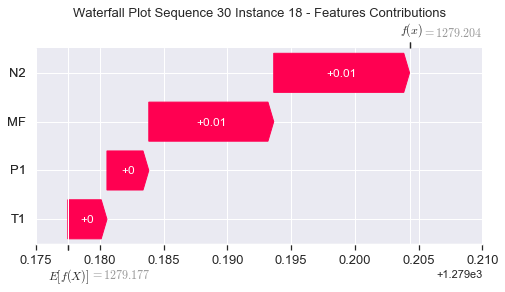

None

Contribution: [0.01369162 0.01301422 0.04421226 0.04067501]


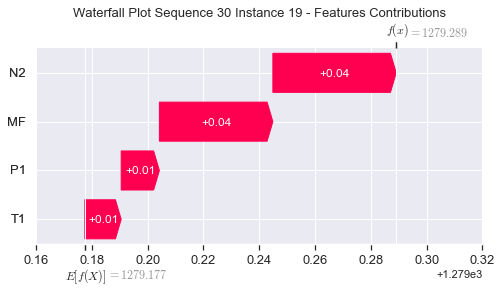

None

Contribution: [0.04858872 0.04527224 0.15791021 0.14475434]


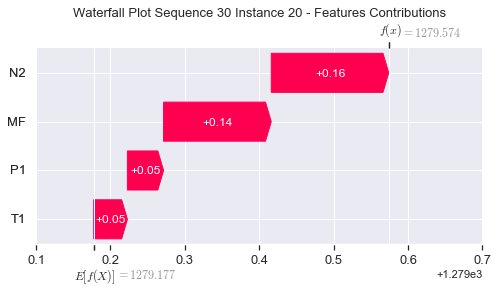

None

Contribution: [0.14205711 0.13041521 0.46146267 0.42343863]


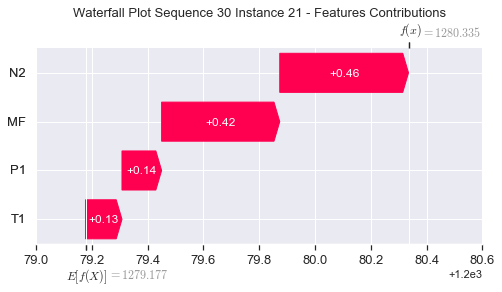

None

Contribution: [0.33962992 0.29755757 1.10616324 1.01925658]


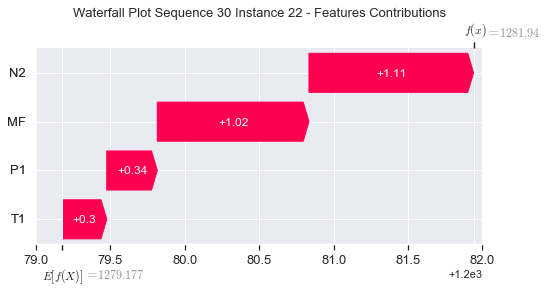

None

Contribution: [0.61759761 0.38466861 2.08955471 1.95926745]


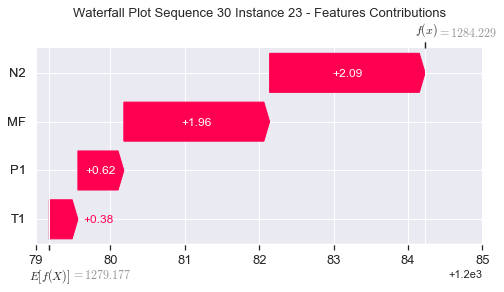

None

Contribution: [ 0.81216232 -0.54314009  2.64123925  2.74528991]


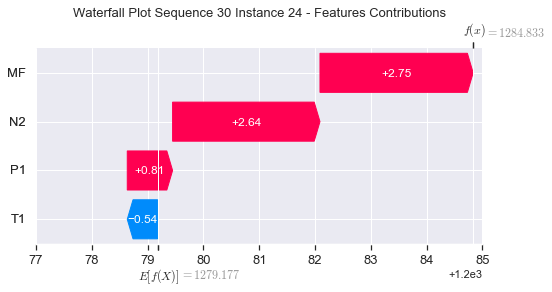

None

Contribution: [ 0.82378158 -0.03795891  2.36321225  2.52648941]


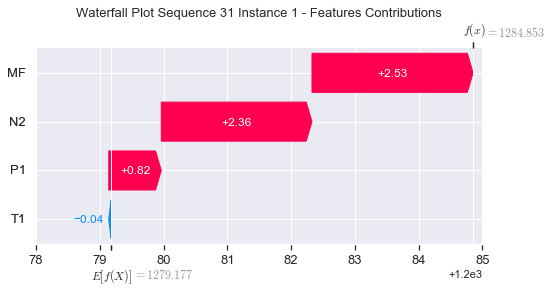

None

Contribution: [-0.08830609  0.00692693 -0.26246308 -0.27064785]


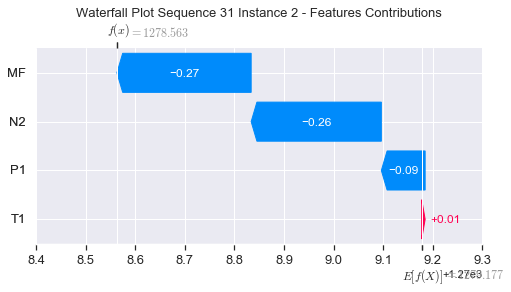

None

Contribution: [0.00108132 0.00093096 0.00370074 0.0035404 ]


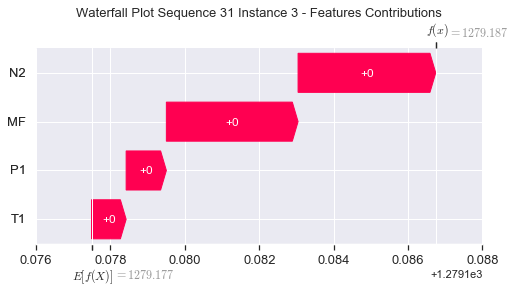

None

Contribution: [0.00159243 0.00143764 0.00509378 0.00479261]


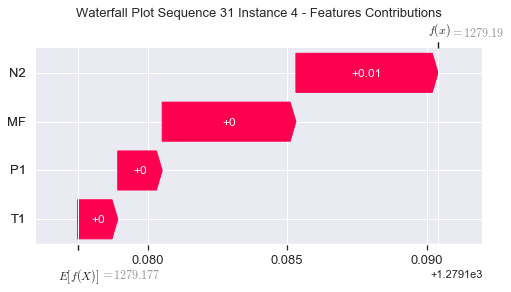

None

Contribution: [0.00181158 0.00157355 0.00564803 0.00532447]


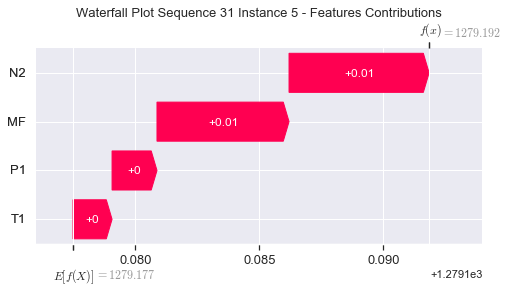

None

Contribution: [0.00195429 0.00170545 0.00617743 0.00576006]


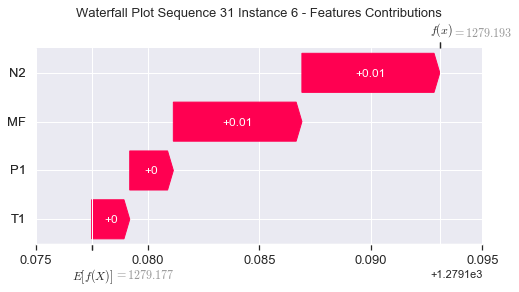

None

Contribution: [0.00210791 0.00182654 0.00664198 0.00619129]


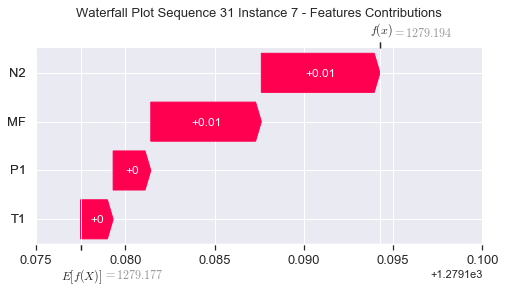

None

Contribution: [0.00216239 0.00186263 0.00678358 0.0063516 ]


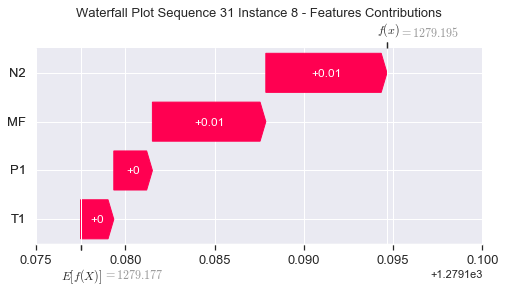

None

Contribution: [0.00220933 0.00186446 0.00673386 0.00640907]


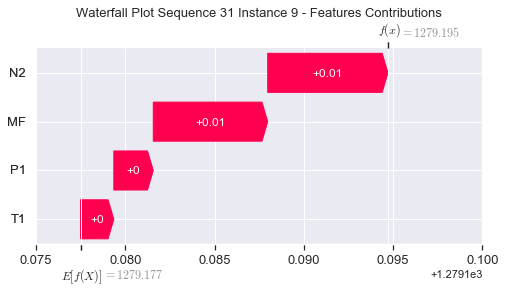

None

Contribution: [0.00214821 0.00188005 0.00663925 0.00624961]


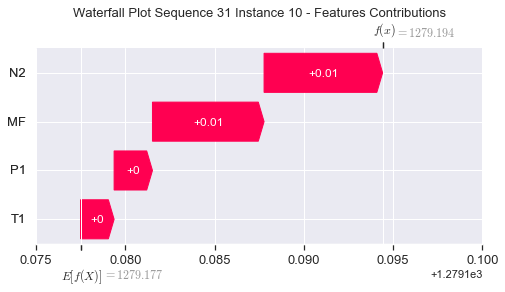

None

Contribution: [0.00212739 0.00181367 0.00657846 0.00623842]


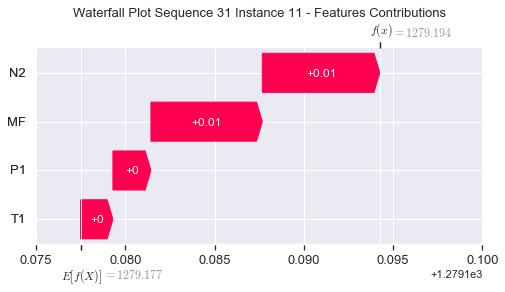

None

Contribution: [0.00204842 0.00175357 0.00647966 0.00603335]


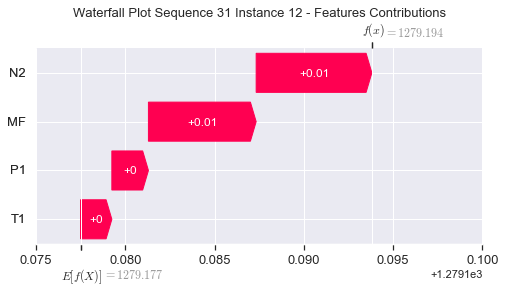

None

Contribution: [0.0020303  0.00173595 0.0063898  0.00596238]


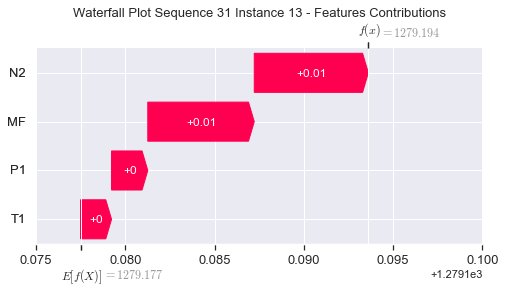

None

Contribution: [0.00193489 0.0015938  0.00610267 0.00574634]


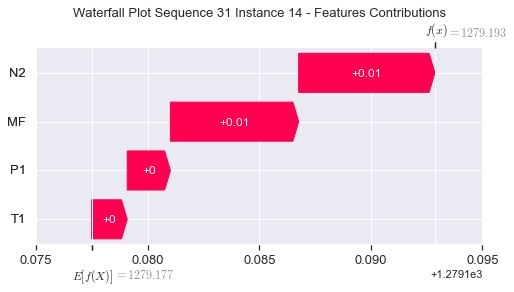

None

Contribution: [0.00173878 0.00148933 0.00546458 0.00511522]


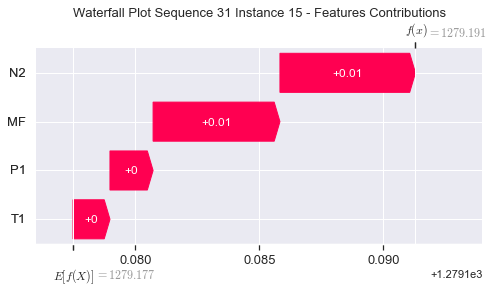

None

Contribution: [0.00143066 0.00128027 0.0044379  0.00422716]


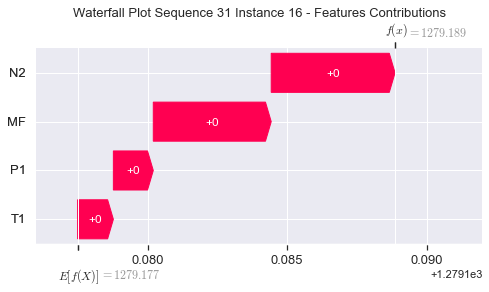

None

Contribution: [0.00131965 0.0011823  0.00414203 0.00388305]


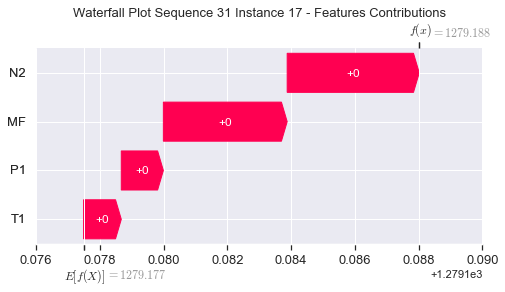

None

Contribution: [0.00328794 0.00309674 0.01063371 0.00979211]


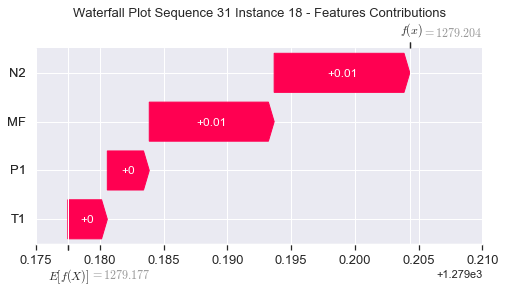

None

Contribution: [0.01344683 0.01264515 0.04404337 0.03991499]


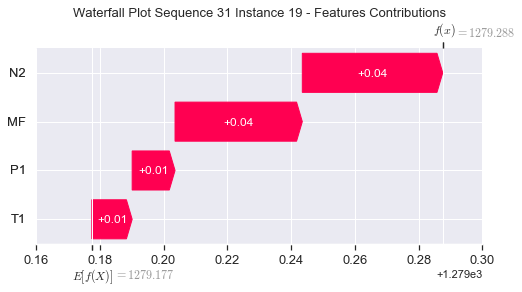

None

Contribution: [0.04871083 0.04494445 0.15662025 0.14432492]


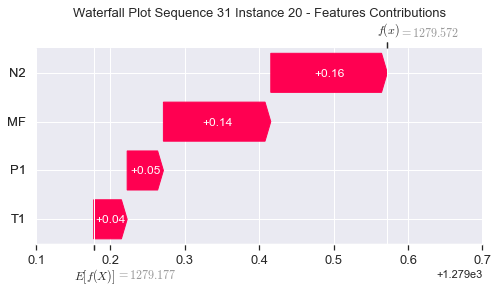

None

Contribution: [0.14300897 0.12971332 0.45843347 0.42367882]


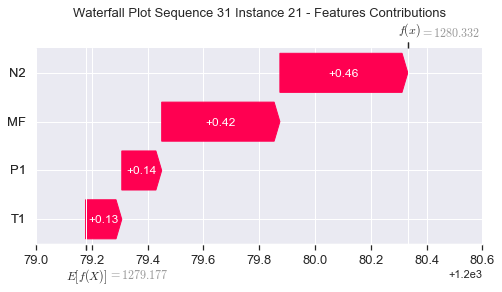

None

Contribution: [0.34455173 0.29694301 1.10190957 1.02658412]


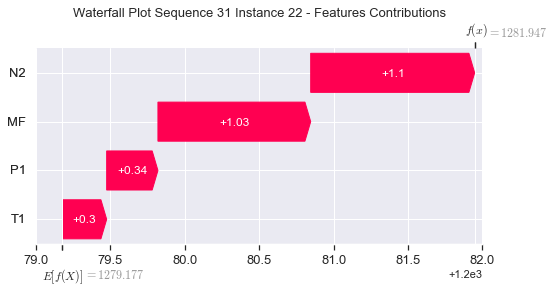

None

Contribution: [0.63844312 0.39346481 2.089364   1.99784716]


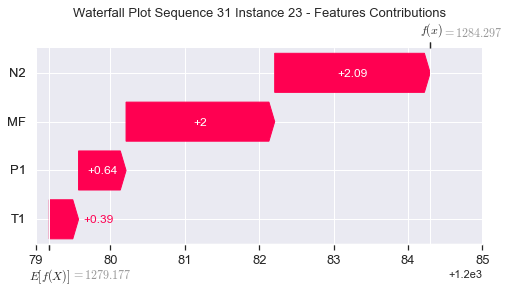

None

Contribution: [ 0.8205986  -0.67887351  2.65129178  2.78695761]


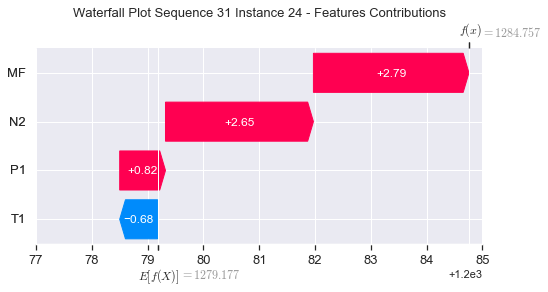

None

Contribution: [ 0.67714991 -0.41441474  2.36536915  2.26484715]


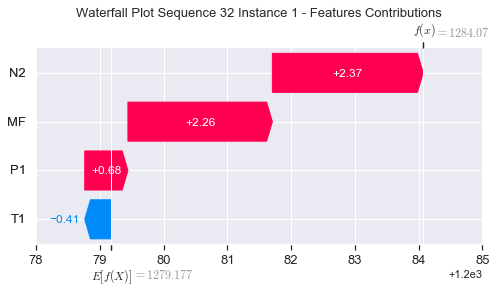

None

Contribution: [-0.10226568  0.0091323  -0.27300824 -0.299149  ]


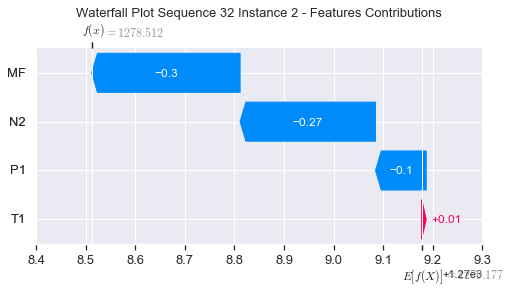

None

Contribution: [0.00105569 0.00088669 0.00367855 0.00352268]


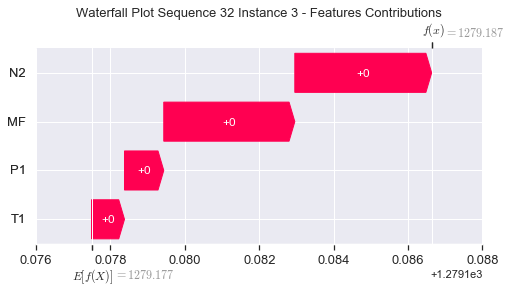

None

Contribution: [0.00162967 0.00139607 0.00512234 0.00481321]


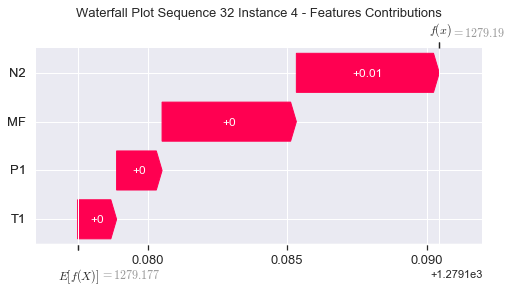

None

Contribution: [0.00184281 0.00154356 0.00566701 0.00540674]


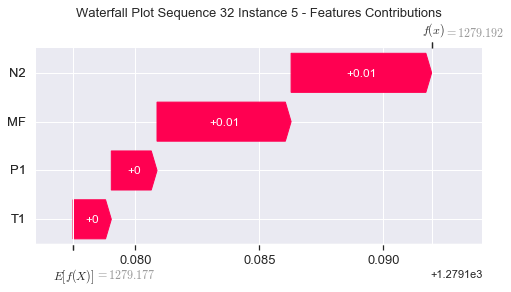

None

Contribution: [0.00201256 0.00166543 0.00621544 0.00589542]


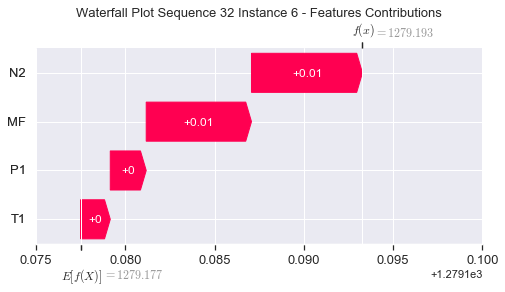

None

Contribution: [0.00216465 0.00179307 0.00669927 0.00635478]


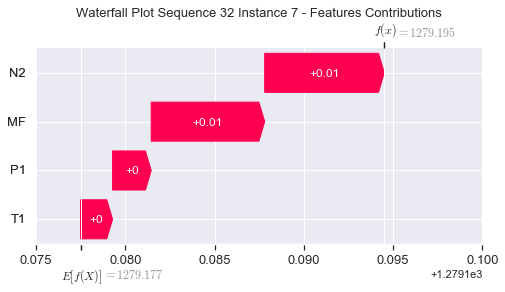

None

Contribution: [0.00220601 0.00182677 0.00684578 0.00648259]


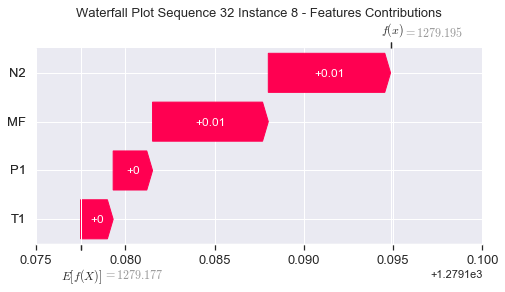

None

Contribution: [0.002122   0.00185494 0.00674088 0.00632209]


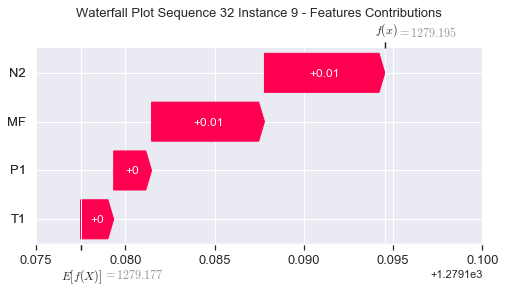

None

Contribution: [0.00205709 0.001825   0.00661072 0.00615631]


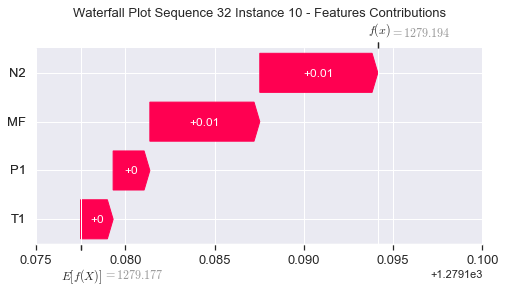

None

Contribution: [0.00207269 0.00177651 0.00656128 0.00615136]


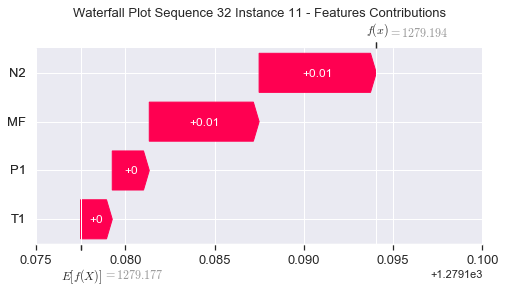

None

Contribution: [0.00210562 0.0017487  0.00651797 0.00621073]


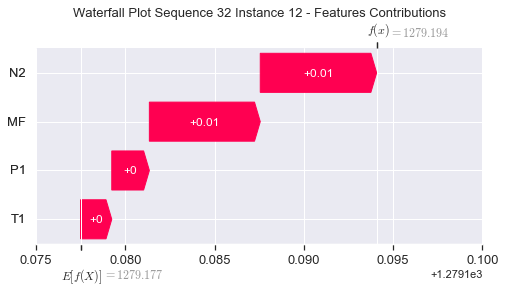

None

Contribution: [0.00207413 0.00172659 0.00642842 0.00611869]


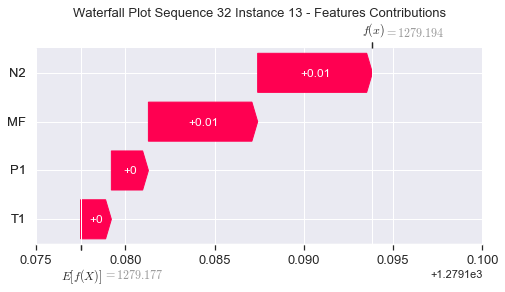

None

Contribution: [0.00195538 0.00172266 0.0061382  0.00577976]


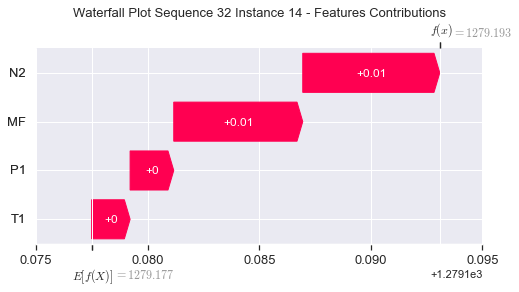

None

Contribution: [0.00176771 0.001449   0.00549379 0.00521713]


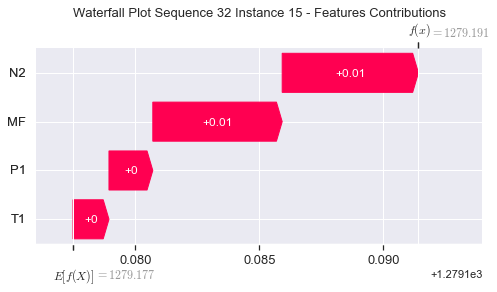

None

Contribution: [0.00139304 0.00115312 0.00439646 0.00413366]


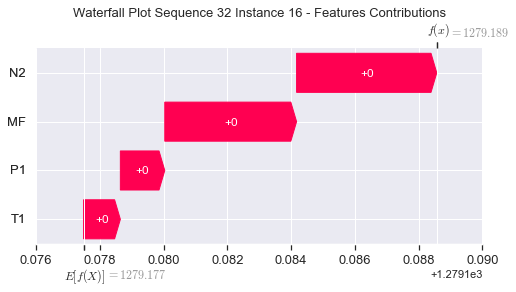

None

Contribution: [0.00131287 0.00112544 0.00410318 0.00389851]


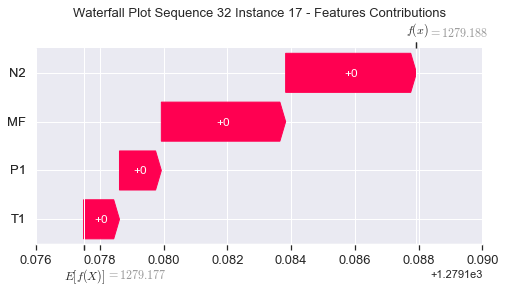

None

Contribution: [0.00330241 0.00297967 0.01066093 0.00990113]


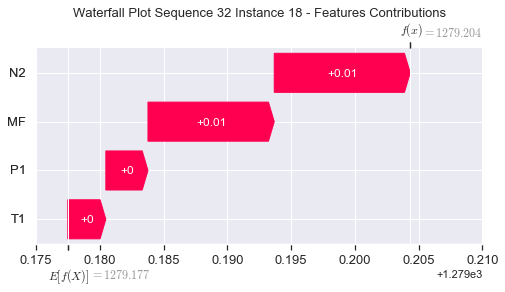

None

Contribution: [0.01315694 0.01164603 0.0443711  0.04058791]


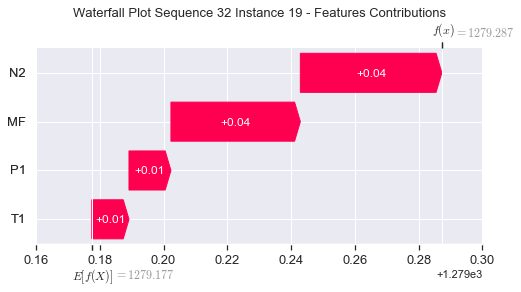

None

Contribution: [0.04875256 0.04320184 0.15859724 0.14597006]


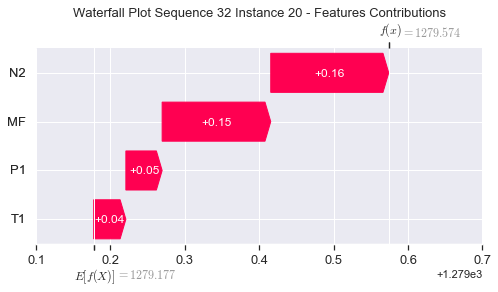

None

Contribution: [0.14308414 0.12466527 0.46416527 0.42820749]


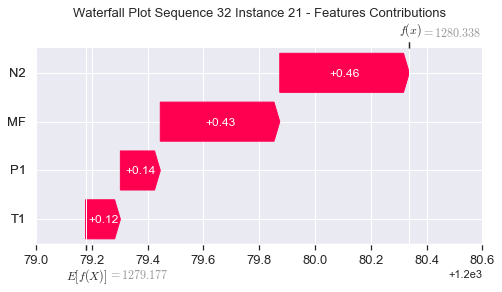

None

Contribution: [0.34354774 0.27842156 1.11608578 1.03477873]


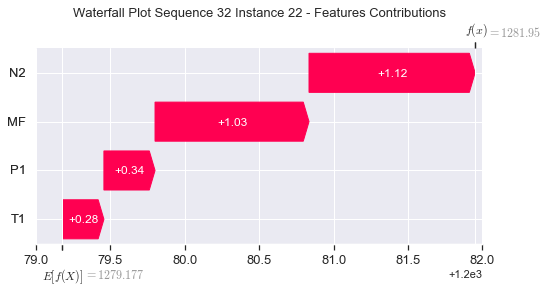

None

Contribution: [0.63323636 0.31070823 2.12823868 2.0179176 ]


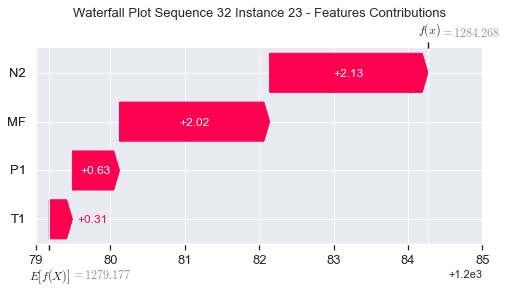

None

Contribution: [ 0.81316576 -0.96945309  2.78966303  2.801108  ]


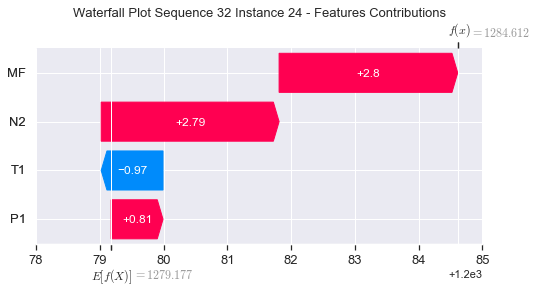

None

Contribution: [ 0.75020852 -0.31676664  2.46848285  2.39192446]


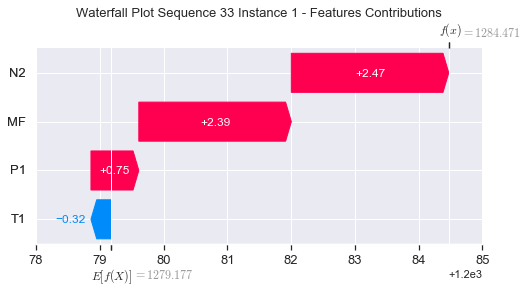

None

Contribution: [-0.09629908  0.02220859 -0.27905257 -0.29958958]


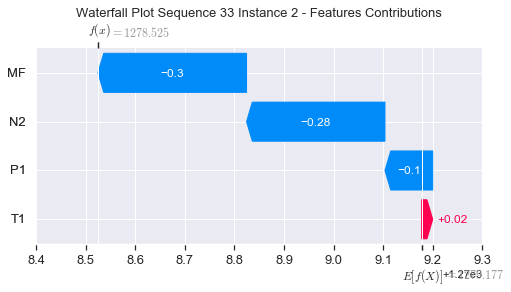

None

Contribution: [0.0010581  0.00081299 0.0037339  0.003545  ]


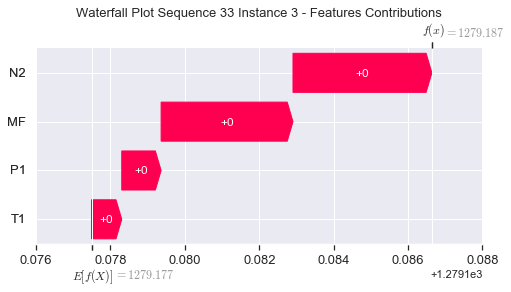

None

Contribution: [0.00166081 0.00145008 0.00519692 0.00493244]


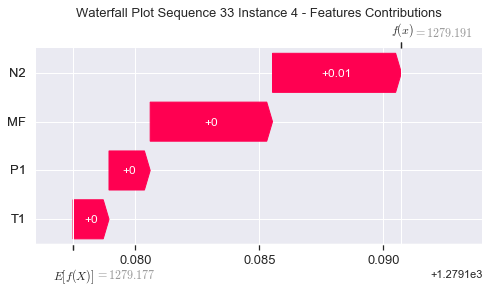

None

Contribution: [0.00178657 0.00148305 0.00570483 0.00532419]


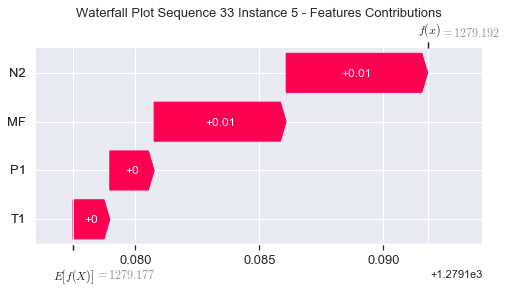

None

Contribution: [0.00200585 0.00163747 0.00627138 0.00590125]


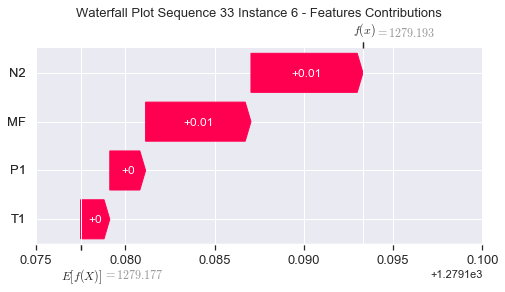

None

Contribution: [0.00214501 0.00173764 0.00674641 0.00632067]


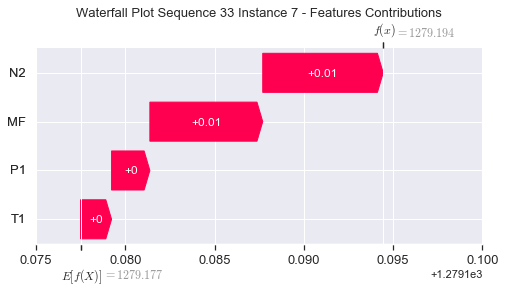

None

Contribution: [0.00218587 0.00177209 0.00689252 0.00647316]


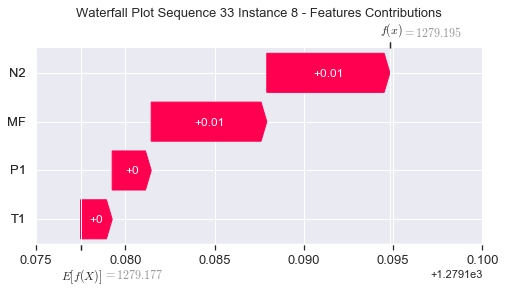

None

Contribution: [0.00208025 0.00174644 0.00680576 0.00635437]


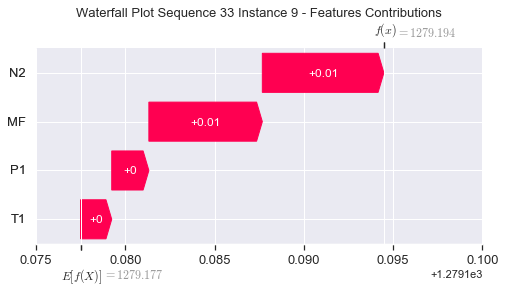

None

Contribution: [0.00208775 0.00177707 0.00669143 0.00623089]


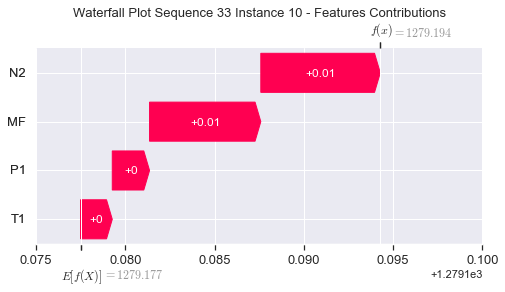

None

Contribution: [0.00208907 0.00172442 0.00666224 0.00634088]


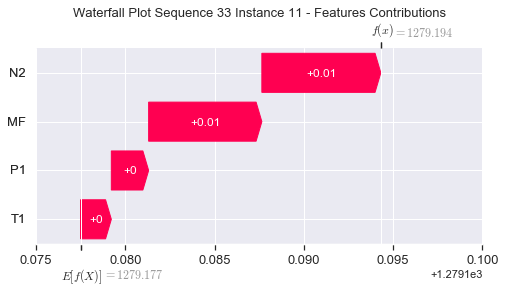

None

Contribution: [0.00210081 0.00161638 0.00656978 0.0062083 ]


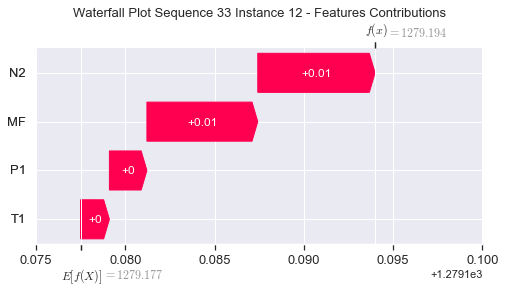

None

Contribution: [0.00205708 0.00159029 0.00647062 0.00608912]


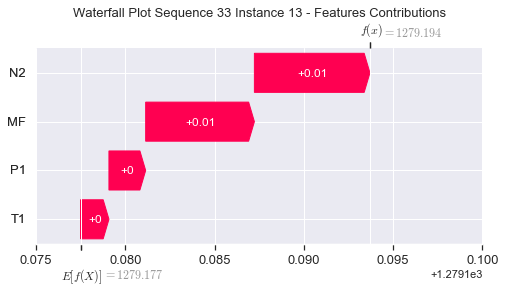

None

Contribution: [0.00195669 0.00149723 0.0061502  0.0057375 ]


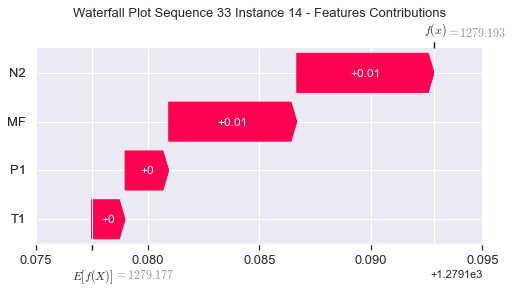

None

Contribution: [0.00175394 0.00133816 0.00549726 0.0051923 ]


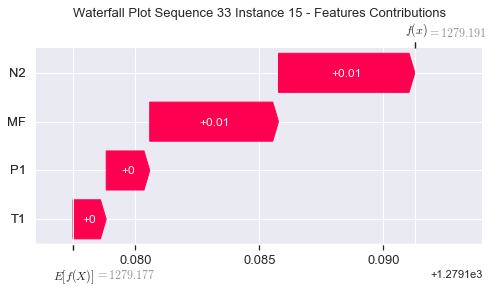

None

Contribution: [0.00138889 0.00110765 0.00438471 0.00412693]


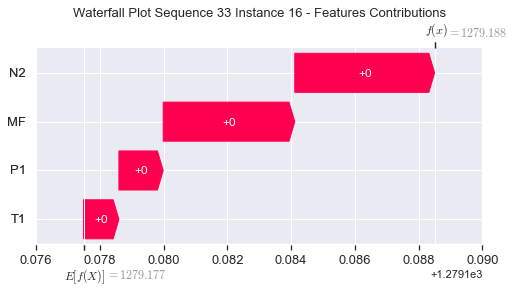

None

Contribution: [0.00130946 0.00103456 0.00415454 0.00391327]


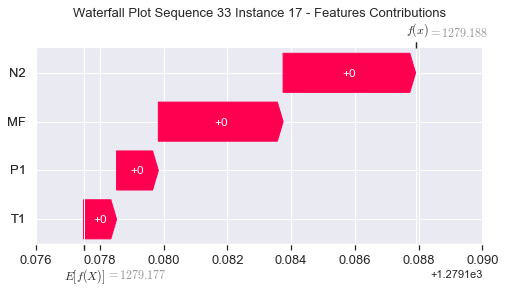

None

Contribution: [0.00339322 0.00287744 0.01105993 0.01023153]


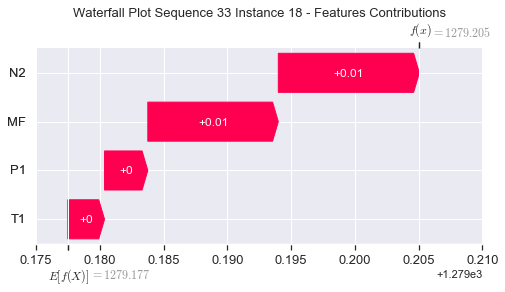

None

Contribution: [0.01375497 0.01190493 0.045858   0.04163169]


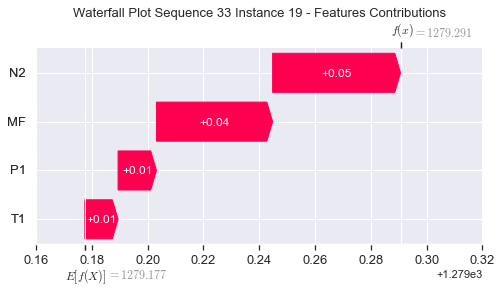

None

Contribution: [0.04909133 0.04167509 0.16243705 0.1486523 ]


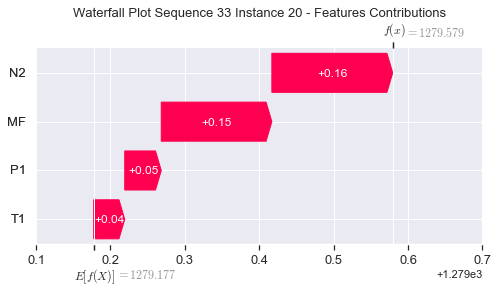

None

Contribution: [0.14245741 0.11744439 0.47110773 0.43226138]


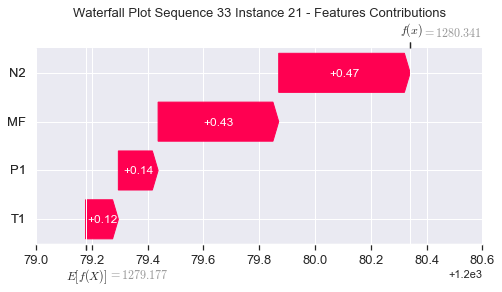

None

Contribution: [0.33727961 0.25194042 1.12161772 1.03651981]


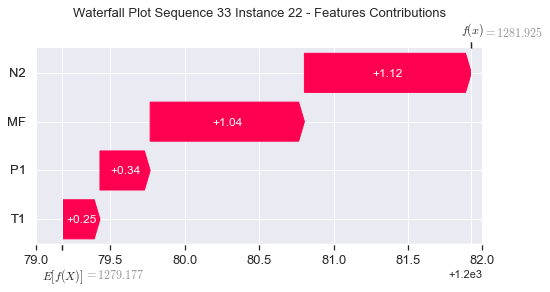

None

Contribution: [0.60650975 0.20638596 2.10344008 2.00561979]


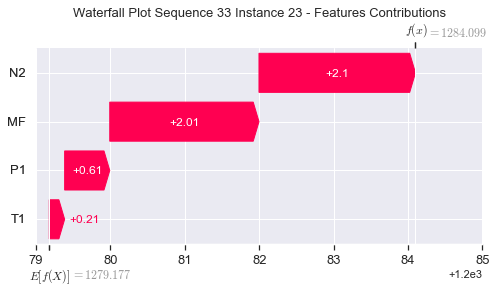

None

Contribution: [ 0.70971912 -1.33316593  2.63886869  2.82085807]


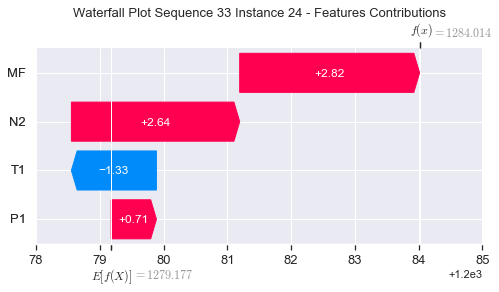

None

Contribution: [ 0.74579049 -0.56578432  2.40264831  2.56085899]


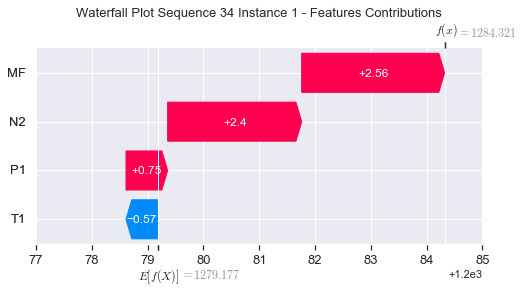

None

Contribution: [-0.07994192  0.06457361 -0.26394047 -0.27657281]


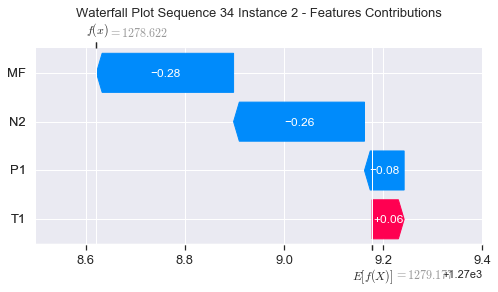

None

Contribution: [0.00108112 0.00068051 0.00374851 0.00364391]


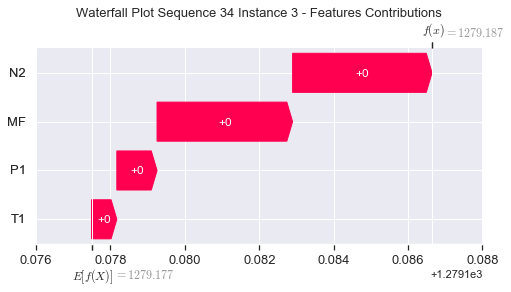

None

Contribution: [0.00161686 0.00119107 0.00520284 0.00498325]


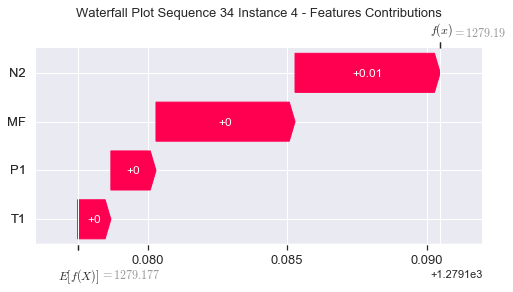

None

Contribution: [0.00178027 0.00134729 0.00571796 0.00533924]


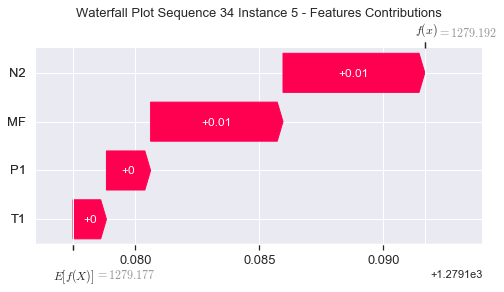

None

Contribution: [0.00196266 0.00149759 0.00629439 0.00589756]


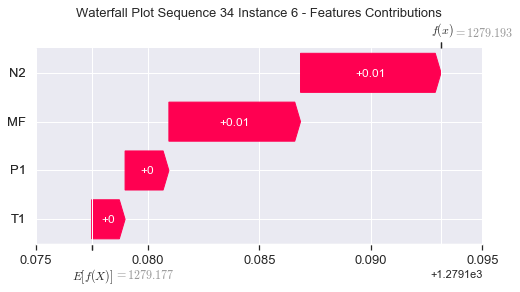

None

Contribution: [0.00211322 0.00161394 0.00677942 0.00634679]


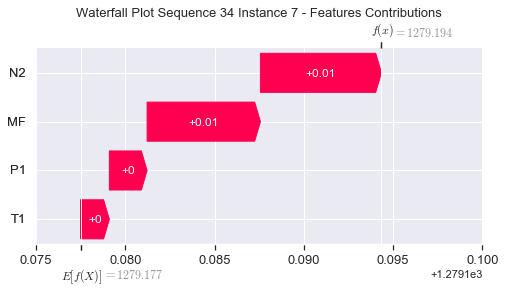

None

Contribution: [0.00214869 0.00163719 0.00692758 0.0064876 ]


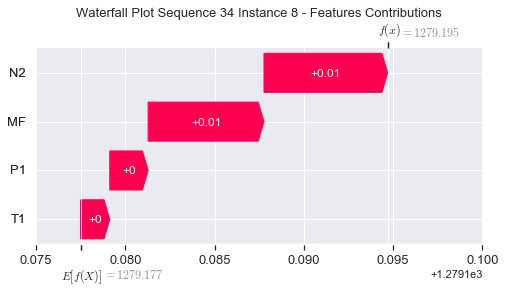

None

Contribution: [0.00207974 0.00161258 0.00687383 0.00643402]


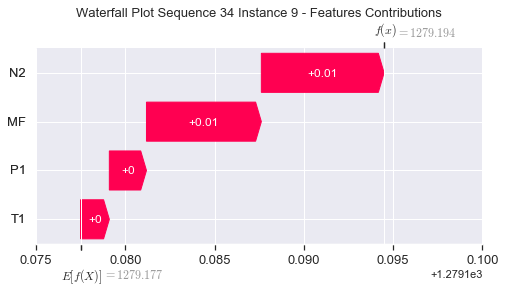

None

Contribution: [0.00203734 0.00156058 0.00678447 0.00636706]


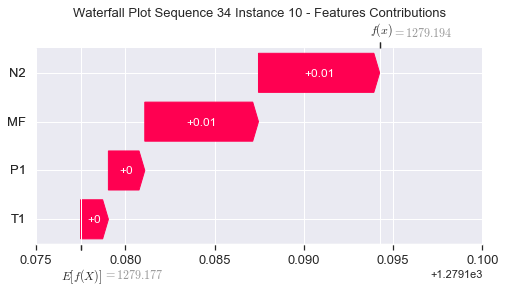

None

Contribution: [0.00200563 0.00156498 0.00671237 0.00629909]


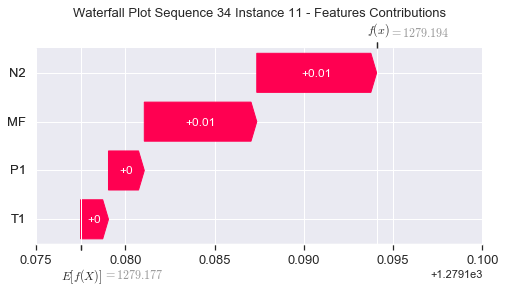

None

Contribution: [0.00200938 0.0015557  0.00662479 0.00619786]


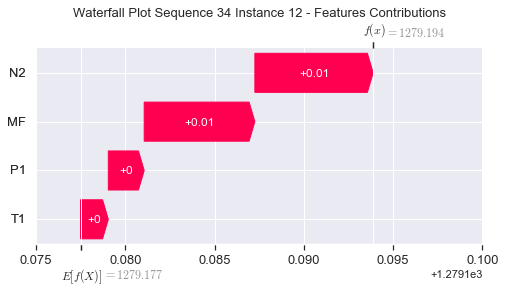

None

Contribution: [0.00198505 0.00153104 0.0065204  0.00609607]


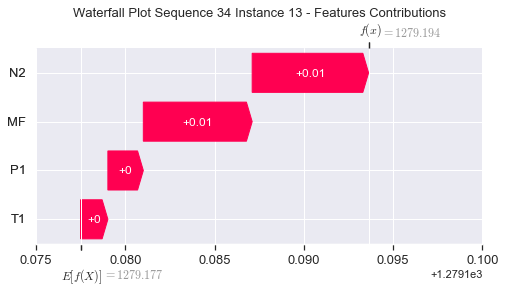

None

Contribution: [0.00181936 0.00141289 0.00619657 0.00570981]


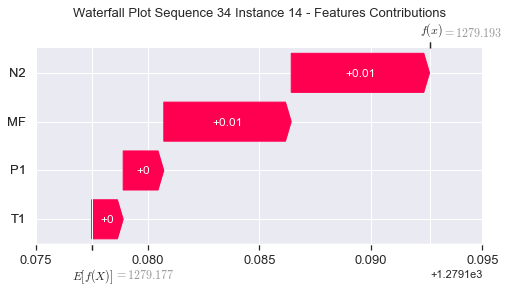

None

Contribution: [0.00169364 0.00128506 0.00551972 0.00517891]


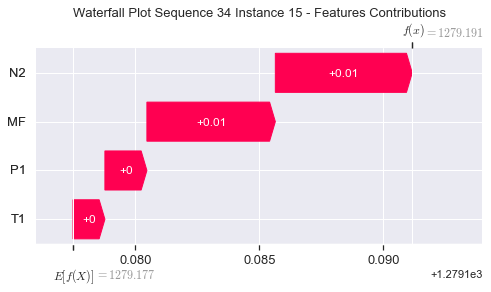

None

Contribution: [0.00139183 0.00097388 0.00443289 0.0042126 ]


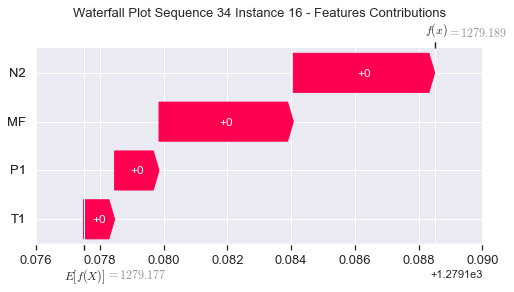

None

Contribution: [0.00127315 0.00099836 0.00419116 0.00393387]


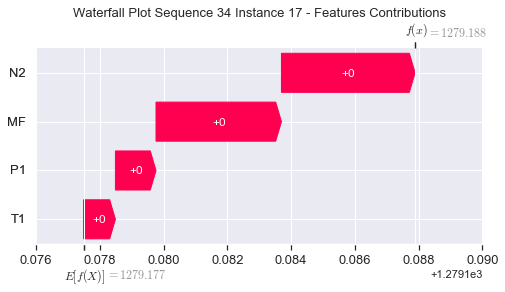

None

Contribution: [0.00333824 0.00281543 0.01122745 0.01034125]


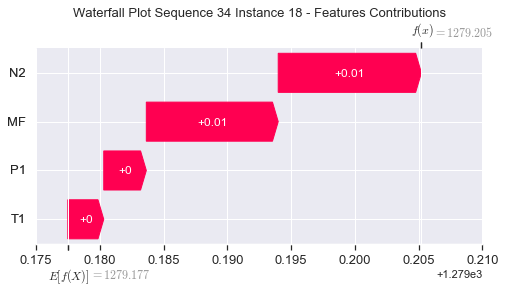

None

Contribution: [0.01355316 0.01133757 0.04651467 0.04218891]


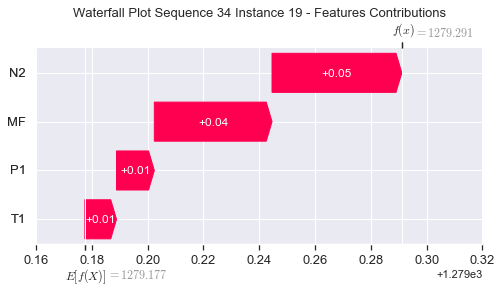

None

Contribution: [0.04920983 0.04081747 0.163951   0.15019954]


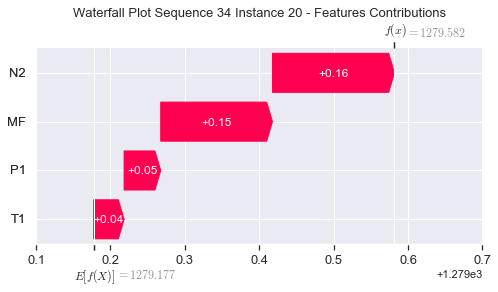

None

Contribution: [0.14208177 0.1151651  0.47482608 0.43541587]


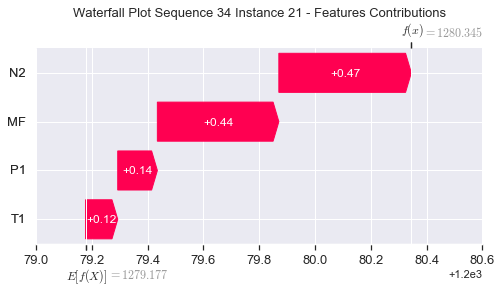

None

Contribution: [0.33411655 0.24454775 1.12898539 1.0394374 ]


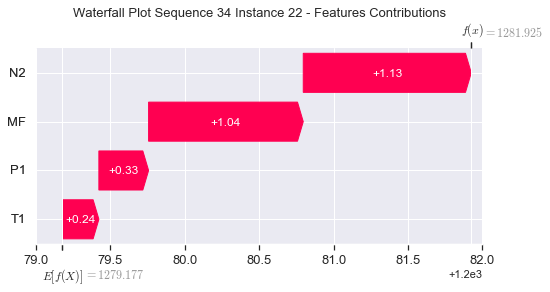

None

Contribution: [0.57741009 0.16842077 2.11930544 1.99412377]


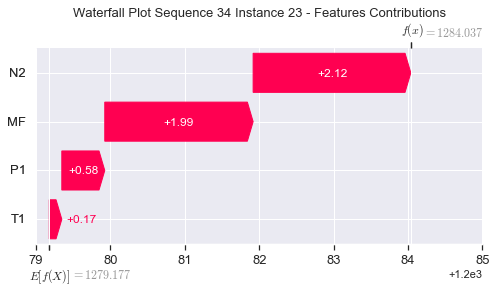

None

Contribution: [ 0.62505013 -1.57190123  2.64292325  2.72076723]


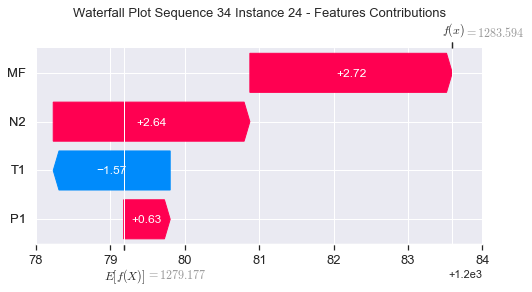

None

In [54]:
#Waterfall Plot for Local Accuracy & Consistency metrics

sns.set()
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [55]:
# calculate variables for control limit c

std.stack().max(),std.stack().mean(),std.stack().std()

(22.898836903246142, 21.458317817254123, 0.4688656255168608)

In [56]:
#calculate control limit

c = (std.stack().max() - std.stack().mean())/std.stack().std()
c

3.072349533843608

In [57]:
#Load Null anomaly testing data 1

xtest_AD_file = "xNull2.csv"
xtest_AD = pd.read_csv(xtest_AD_file, index_col=False)
xtest_AD = xtest_AD.to_numpy()
xtest_AD = xtest_AD.reshape(1,24,4)

In [58]:
#Load Null anomaly ground truth 1

ytest_AD_file = "yNull2.csv"
ytest_AD = pd.read_csv(ytest_AD_file, index_col=False)

In [59]:
#Prediction

preds_AD = model(xtest_AD)
y_AD = preds_AD[0].sample(1000)
#y1_AD = preds_AD[1]
y_AD = tf.keras.backend.get_value(y_AD)
#y1_AD = tf.keras.backend.get_value(y1_AD)
tens_draw_AD = y_AD
#tens_draw1_AD = y1_AD

#Predicted RUL for each Fleet
mean_Fleet_All_AD = np.zeros(tens_draw_AD.shape[1])
mean_Fleet_AD = np.zeros(tens_draw_AD.shape[0])
for y in range(tens_draw_AD.shape[1]):
    for x in range(tens_draw_AD.shape[0]):
        mean_Fleet_AD[x] = tens_draw_AD[x,y,0]
    mean_Fleet_All_AD[y] = mean_Fleet_AD.mean()
      
mean_Fleet_All_AD, #tens_draw1_AD

(array([1353.6217467]),)

In [60]:
#Calculate Mean and Std for predictions with AU

Fleet_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[0])))
mean_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
std_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
for z in range(tens_draw_AD.shape[1]):
    for y in range(tens_draw_AD.shape[0]):
        for x in range(pad):
            Fleet_AD[y][x] = tens_draw_AD[y,z,x]
    row_Mean_AD = Fleet_AD.mean(axis=1)
    row_Std_AD = Fleet_AD.std(axis=1)
    for j in range(pad):
        mean_AD[z][j] = row_Mean_AD[j]
    for k in range(pad):
        std_AD[z][k] = row_Std_AD[k]

In [61]:
hour_NUM2 = ['1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm']

0


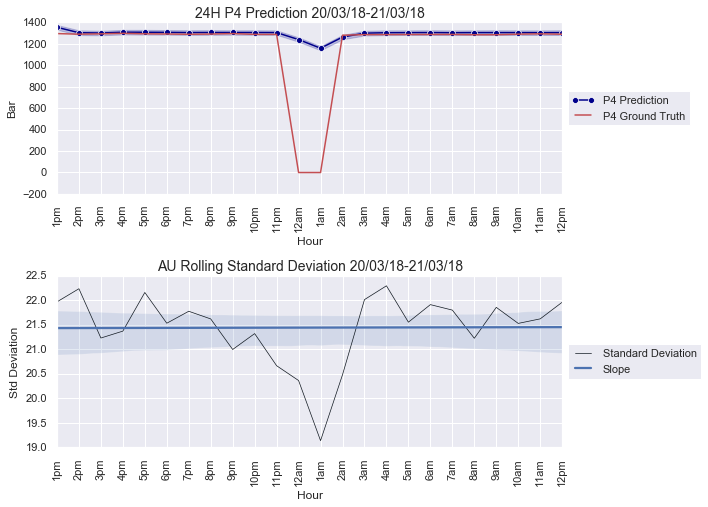

In [62]:
#Visualize prediction

for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD.shape[0])))
    for y in range(tens_draw_AD.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD.shape[0]:
        if(m < (tens_draw_AD.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Bar']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD['P4'][x]
    max_RUL_Arrange.columns = ['Hour','Bar']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD[B][x]
    min_Std_Arrange.columns = ['Hour','Bar']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange, color='darkblue', ax=ax, label="P4 Prediction")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='r', ax=ax,label="P4 Ground Truth")
    plt.title('24H P4 Prediction 20/03/18-21/03/18',fontsize=14)
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.set_xlabel('Hour')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'Bar', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'],label ='Slope',scatter = False)
    plt.title('AU Rolling Standard Deviation 20/03/18-21/03/18',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

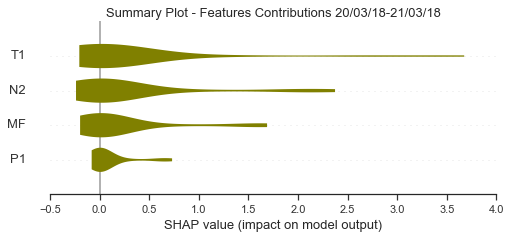

In [63]:
#Summary Plot for anomaly

sns.set_style("ticks")
instance = xtest_AD
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
shap_values = explainer.shap_values(instance)
plt.title("Summary Plot - Features Contributions 20/03/18-21/03/18",fontsize=13)
shap.summary_plot(shap_values[0][0],feature_names=xtrain.columns,plot_type="violin", color='olive')

In [64]:
#SHAP Force Plot for anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [65]:
# Export data for anomaly detection with MATLAB cusum

min_Std_Arrange.to_csv(r'C:/Users/Asus/Desktop/Real Gas Turbine/LSTM-P4/AD1.csv', index = False)

In [66]:
#Load Null anomaly testing data 2

xtest_AD_ALL_file = "xNull1.csv"
xtest_AD_ALL = pd.read_csv(xtest_AD_ALL_file, index_col=False)
xtest_AD_ALL = xtest_AD_ALL.to_numpy()
xtest_AD_ALL = xtest_AD_ALL.reshape(1,24,4)

In [67]:
#Load Null anomaly ground truth 2

ytest_AD_ALL_file = "yNull1.csv"
ytest_AD_ALL = pd.read_csv(ytest_AD_ALL_file, index_col=False)

In [68]:
#Prediction

preds_AD_ALL = model(xtest_AD_ALL)
y_AD_ALL = preds_AD_ALL[0].sample(1000)
#y1_AD_ALL = preds_AD_ALL[2]
y_AD_ALL = tf.keras.backend.get_value(y_AD_ALL)
#y1_AD_ALL = tf.keras.backend.get_value(y1_AD_ALL)
tens_draw_AD_ALL = y_AD_ALL
#tens_draw1_AD_ALL = y1_AD_ALL

#Predicted RUL for each Fleet
mean_Fleet_All_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[1])
mean_Fleet_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[0])
for y in range(tens_draw_AD_ALL.shape[1]):
    for x in range(tens_draw_AD_ALL.shape[0]):
        mean_Fleet_AD_ALL[x] = tens_draw_AD_ALL[x,y,0]
    mean_Fleet_All_AD_ALL[y] = mean_Fleet_AD_ALL.mean()
      
mean_Fleet_All_AD_ALL, #tens_draw1_AD_ALL

(array([1343.87726904]),)

In [69]:
#Calculate Mean and Std for predictions with AU

Fleet_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[0])))
mean_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
std_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
for z in range(tens_draw_AD_ALL.shape[1]):
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(pad):
            Fleet_AD_ALL[y][x] = tens_draw_AD_ALL[y,z,x]
    row_Mean_AD_ALL = Fleet_AD_ALL.mean(axis=1)
    row_Std_AD_ALL = Fleet_AD_ALL.std(axis=1)
    for j in range(pad):
        mean_AD_ALL[z][j] = row_Mean_AD_ALL[j]
    for k in range(pad):
        std_AD_ALL[z][k] = row_Std_AD_ALL[k]

In [70]:
hour_NUM3 = ['12pm','1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am']

0


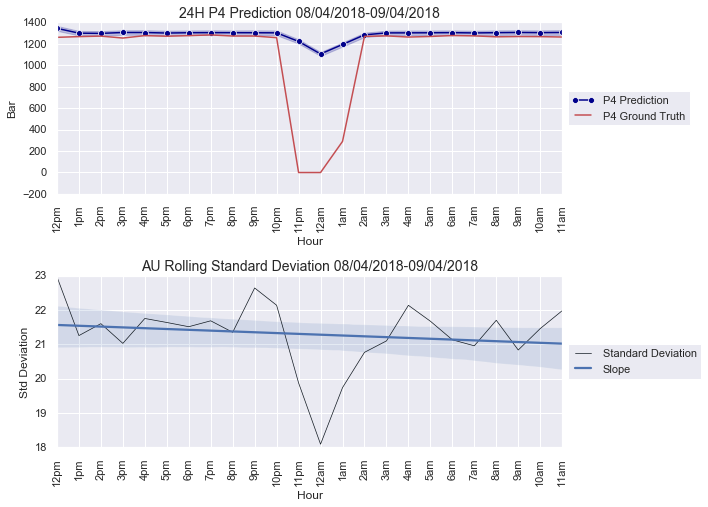

In [71]:
#Visualize anomaly prediction
sns.set()
for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD_ALL.shape[0])))
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD_ALL[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD_ALL.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD_ALL.shape[0]:
        if(m < (tens_draw_AD_ALL.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Bar']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD_ALL['P4'][x]
    max_RUL_Arrange.columns = ['Hour','Bar']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD_ALL[B][x]
    min_Std_Arrange.columns = ['Hour','Bar']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange,color='darkblue', ax=ax, label="P4 Prediction")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='r', ax=ax,label="P4 Ground Truth")
    plt.title('24H P4 Prediction 08/04/2018-09/04/2018',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'Bar', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'],label ='Slope',scatter = False)
    plt.title('AU Rolling Standard Deviation 08/04/2018-09/04/2018',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

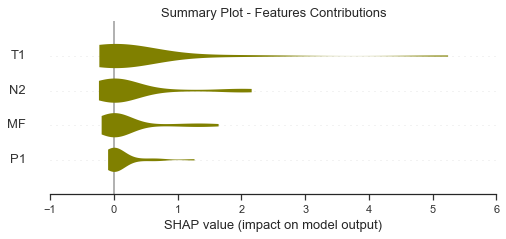

In [72]:
#Summary Plot for anomaly

sns.set_style("ticks")
instance = xtest_AD_ALL
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
shap_values = explainer.shap_values(instance)
plt.title("Summary Plot - Features Contributions",fontsize=13)
shap.summary_plot(shap_values[0][0],feature_names=xtrain.columns,plot_type="violin", color='olive')

In [73]:
#SHAP Force Plot for anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD_ALL[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [74]:
# Export data for anomaly detection with MATLAB cusum

min_Std_Arrange.to_csv(r'C:/Users/Asus/Desktop/Real Gas Turbine/LSTM-P4/AD2.csv', index = False)

In [75]:
#Define f''x

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 292)           345728    
_________________________________________________________________
dense_4 (Dense)              (None, 24, 495)           145035    
_________________________________________________________________
dense_5 (Dense)              (None, 24, 1)             496       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 491,259
Trainable params: 491,259
Non-trainable params: 0
_________________________________________________________________


In [76]:
#Extract only weights for 3 variables excluding mf

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [77]:
#Transfer weights from f'x to f''x

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [78]:
#Load xtest and delete mf

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete mf

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [79]:
#Prediction with features excluding mf 

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [80]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [ 0.35245093 -2.31344825  5.23914029]


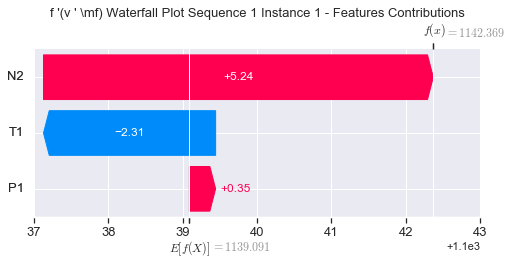

None

Contribution: [-0.07158165  0.28670571 -0.64999147]


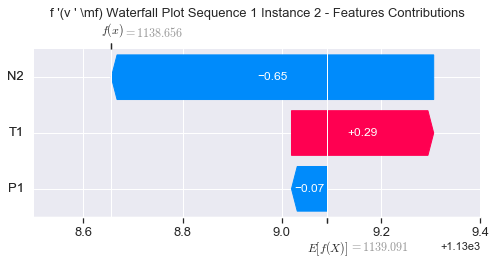

None

Contribution: [-0.000127   -0.00457206  0.00534724]


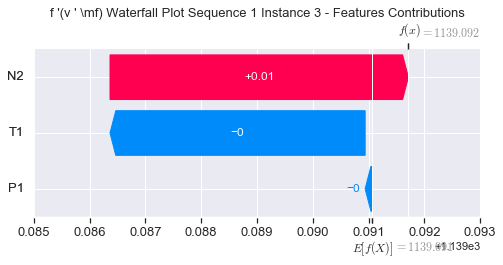

None

Contribution: [ 0.00046175 -0.0040602   0.00940043]


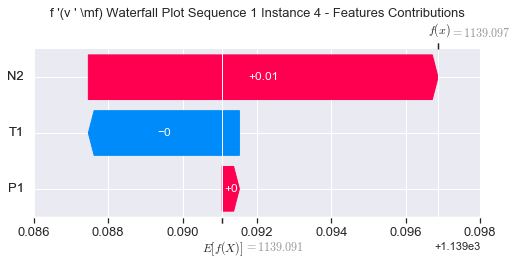

None

Contribution: [ 0.00125879 -0.00074712  0.01044652]


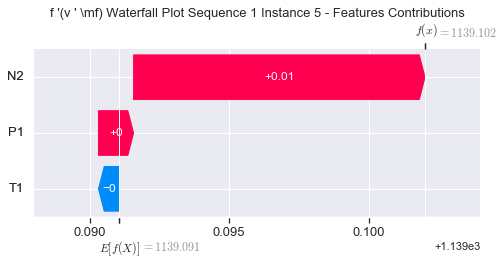

None

Contribution: [ 0.00202853 -0.00054779  0.0115599 ]


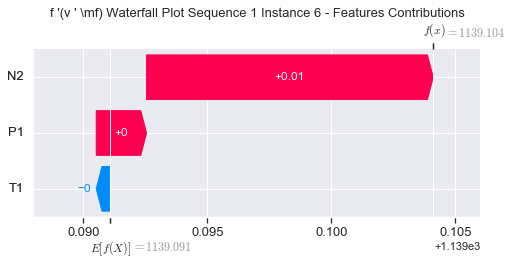

None

Contribution: [0.00213705 0.00013842 0.0124557 ]


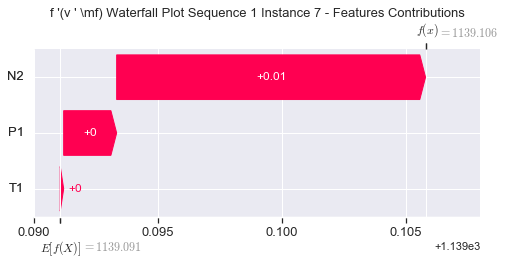

None

Contribution: [0.00232579 0.00028117 0.01274275]


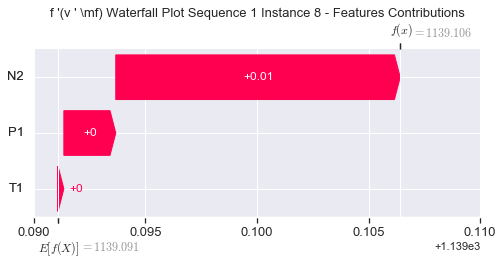

None

Contribution: [0.00218642 0.00336835 0.0130124 ]


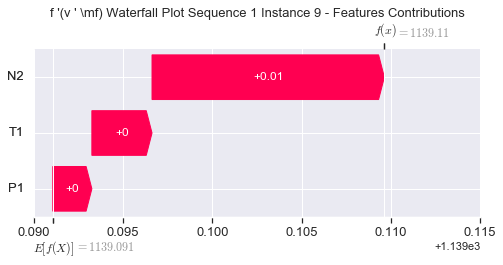

None

Contribution: [0.00159667 0.00188778 0.01307253]


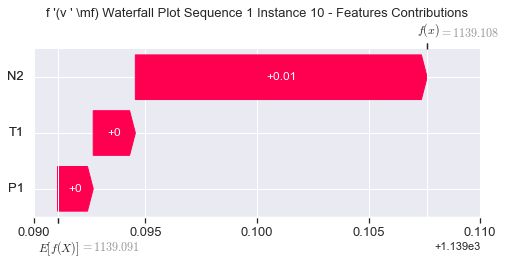

None

Contribution: [0.00272692 0.00208388 0.01349881]


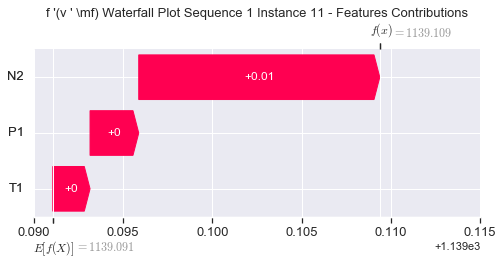

None

Contribution: [ 0.00195244 -0.00065066  0.01313127]


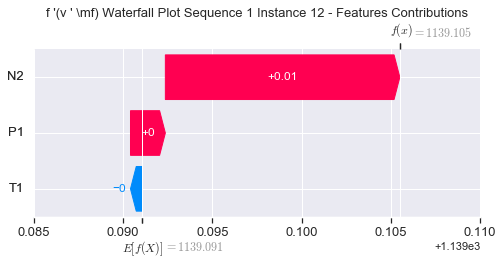

None

Contribution: [0.00138135 0.00017732 0.01159931]


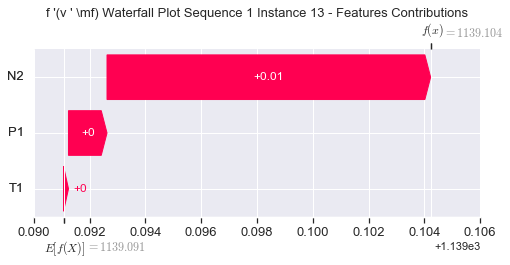

None

Contribution: [ 0.00090544 -0.00120544  0.00610826]


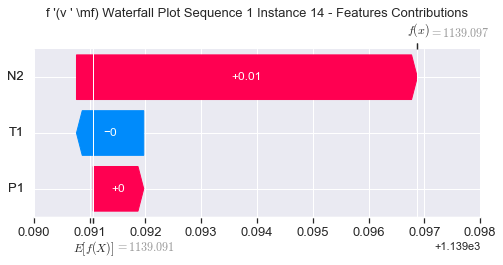

None

Contribution: [-0.00471771 -0.00386928 -0.00600035]


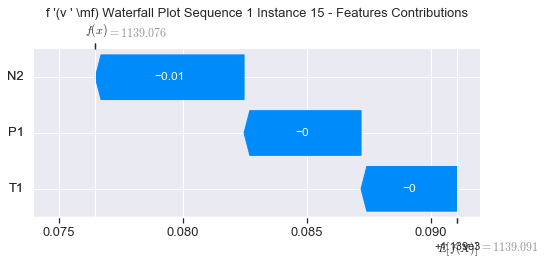

None

Contribution: [-0.01386161 -0.00673616 -0.02509434]


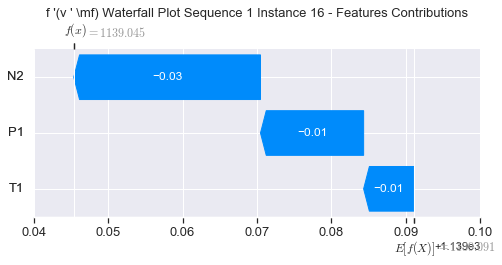

None

Contribution: [-0.02133244 -0.00724636 -0.04414203]


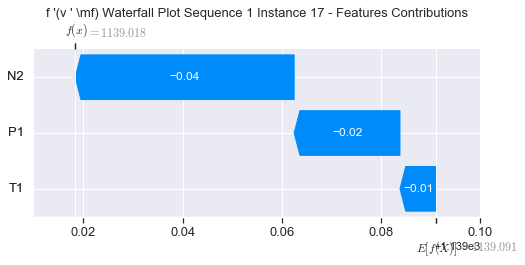

None

Contribution: [-0.02433851  0.00495254 -0.02721799]


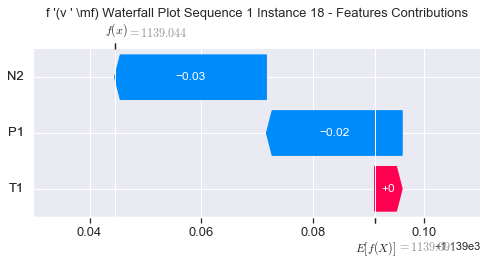

None

Contribution: [-0.02387039  0.05005724  0.10706481]


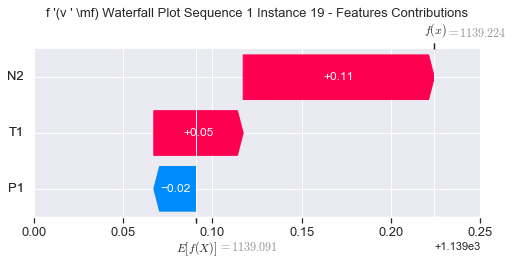

None

Contribution: [0.06967324 0.1963493  0.50001952]


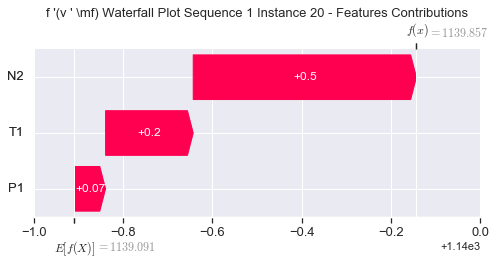

None

Contribution: [0.22021155 0.39149038 1.31818179]


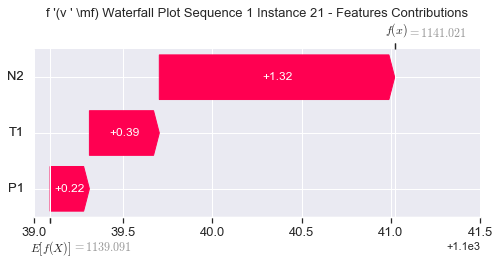

None

Contribution: [0.37783809 0.47226732 2.56995649]


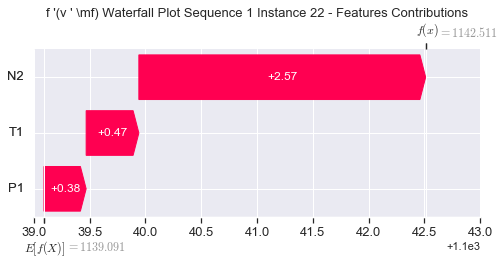

None

Contribution: [ 0.23528259 -0.01442898  3.71395681]


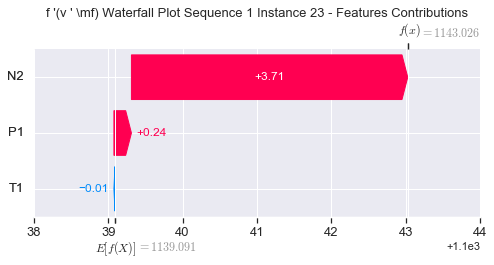

None

Contribution: [ 0.07536481 -1.36688771  3.37136613]


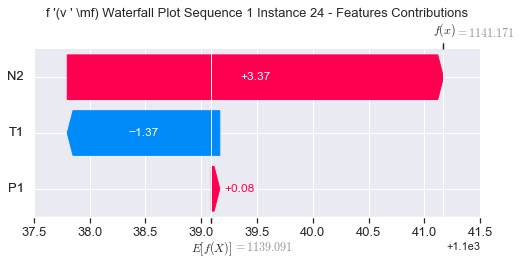

None

Contribution: [ 0.50427309 -1.60083547  4.81892987]


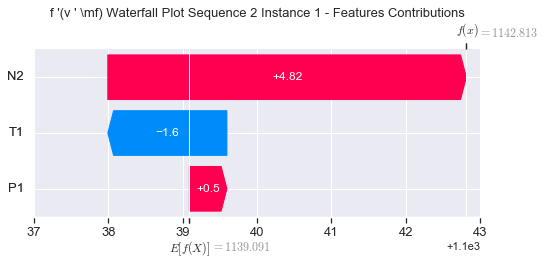

None

Contribution: [-0.00204098  0.13879682 -0.58469641]


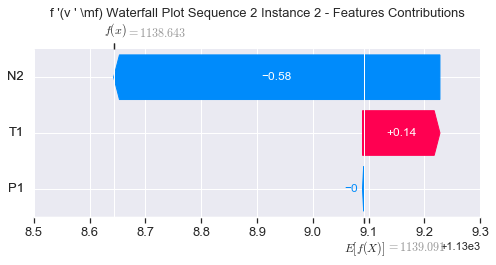

None

Contribution: [-0.00025445 -0.0050815   0.00471659]


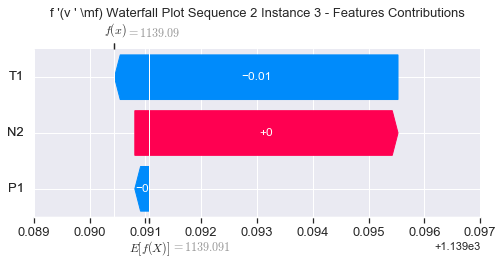

None

Contribution: [-0.0004549  -0.00437859  0.00833512]


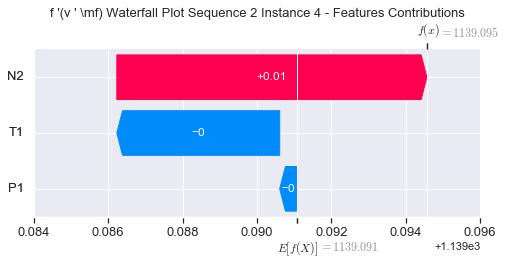

None

Contribution: [ 0.00067779 -0.00968897  0.01048521]


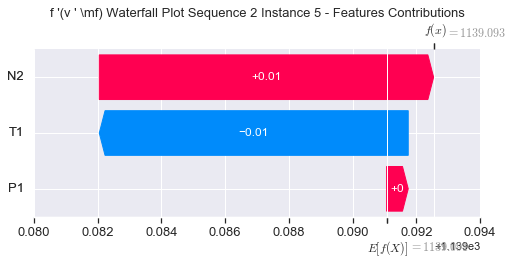

None

Contribution: [ 0.00110399 -0.01052301  0.01148603]


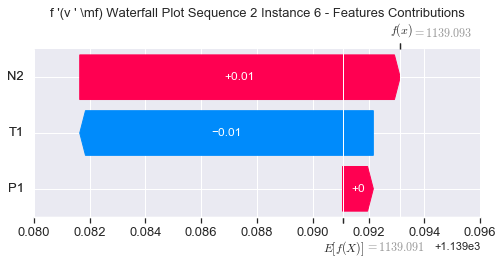

None

Contribution: [ 0.00144919 -0.01075455  0.01254609]


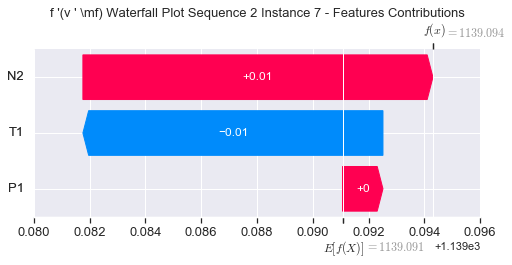

None

Contribution: [ 0.00153118 -0.01072509  0.01289332]


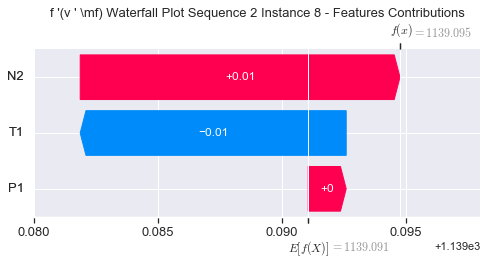

None

Contribution: [ 0.00134332 -0.01168943  0.01385673]


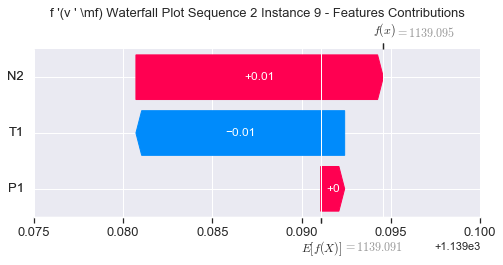

None

Contribution: [ 0.00088034 -0.01182044  0.01433511]


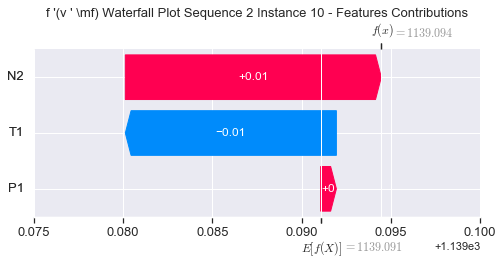

None

Contribution: [ 0.00133692 -0.01184432  0.01415521]


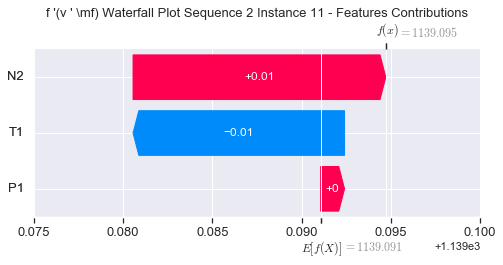

None

Contribution: [ 0.00137283 -0.01445387  0.01351132]


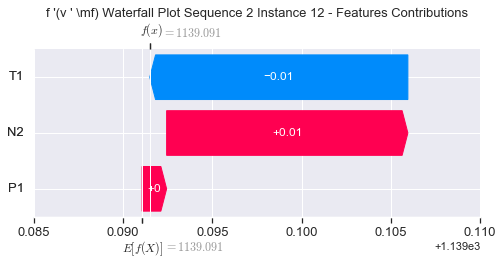

None

Contribution: [ 0.00068773 -0.01494607  0.01179245]


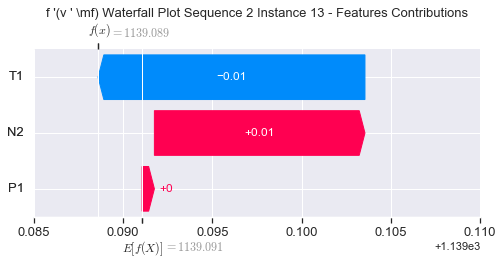

None

Contribution: [-0.00166783 -0.01992395  0.00524427]


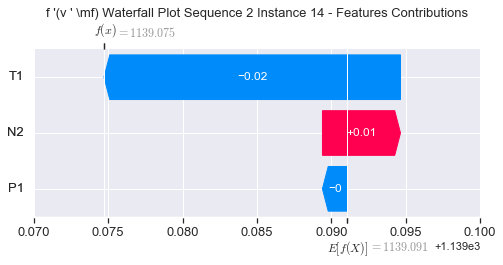

None

Contribution: [-0.00743317 -0.02759963 -0.0091048 ]


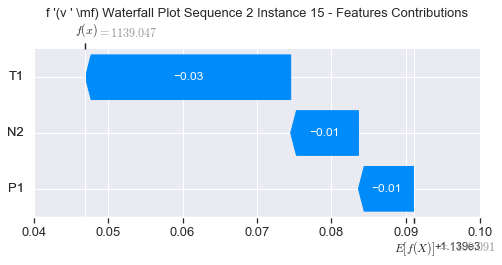

None

Contribution: [-0.01903616 -0.04276321 -0.03129197]


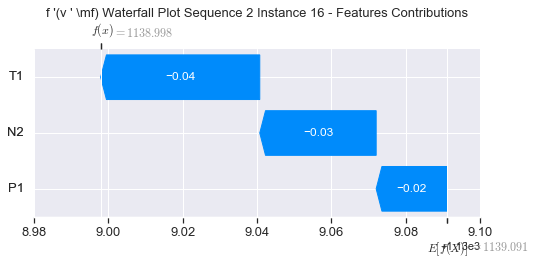

None

Contribution: [-0.02932705 -0.07765732 -0.0537493 ]


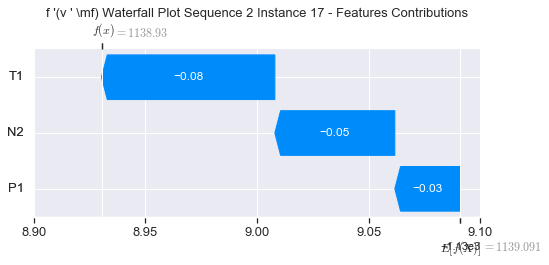

None

Contribution: [-0.03813127 -0.13732765 -0.03675838]


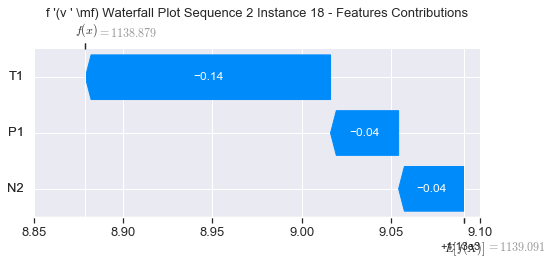

None

Contribution: [-0.03263049 -0.23913951  0.10592687]


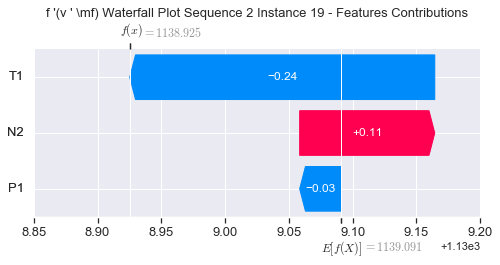

None

Contribution: [ 0.03729868 -0.47308898  0.53443689]


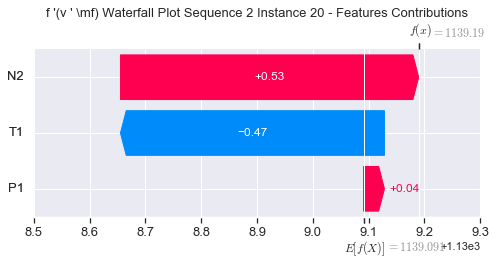

None

Contribution: [ 0.15995711 -1.06757688  1.4002014 ]


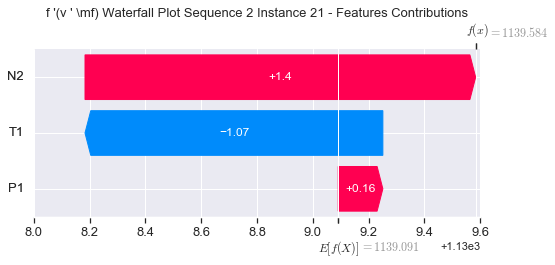

None

Contribution: [ 0.24235741 -2.5025577   2.68993175]


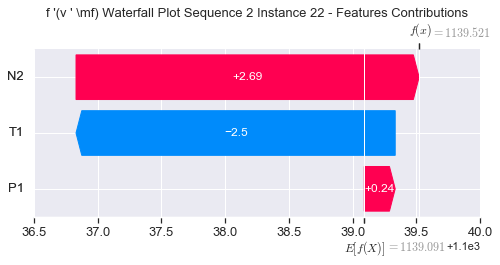

None

Contribution: [-0.08062906 -5.65218266  3.81461396]


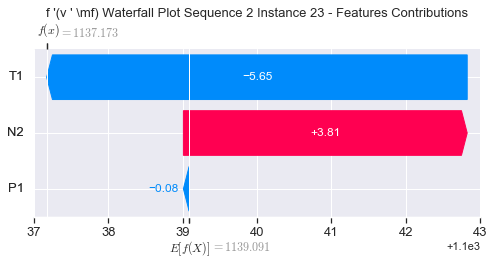

None

Contribution: [-0.48069188 -8.26316607  3.40974889]


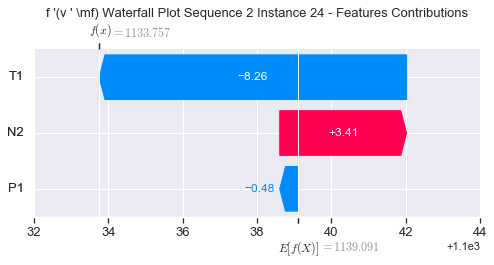

None

Contribution: [ -0.76298833 -10.81788226   4.90826422]


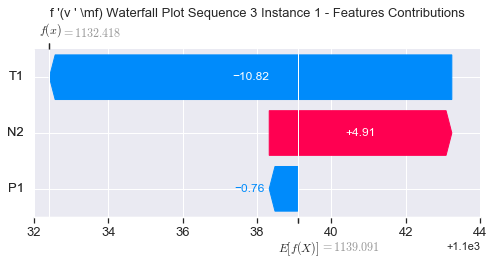

None

Contribution: [ 0.03007019  1.32294957 -0.60593253]


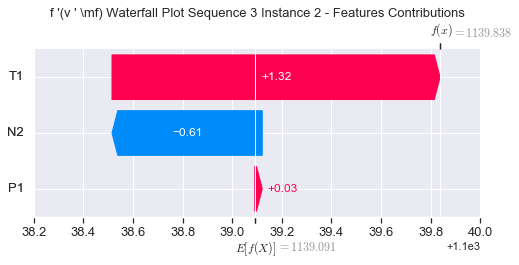

None

Contribution: [-0.00115957 -0.01670092  0.00408325]


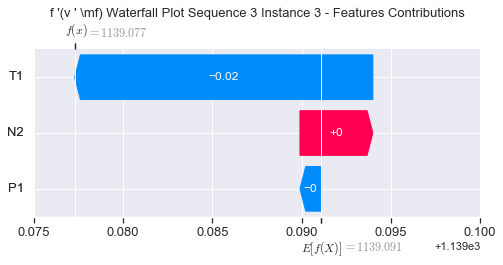

None

Contribution: [-9.30140028e-05 -2.14978665e-02  8.08429202e-03]


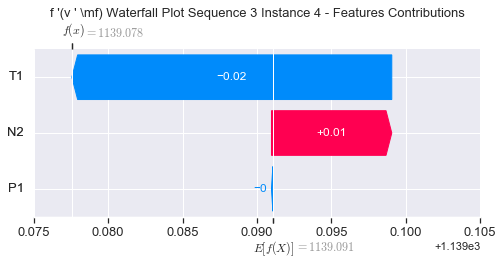

None

Contribution: [ 0.00043    -0.01722221  0.00946557]


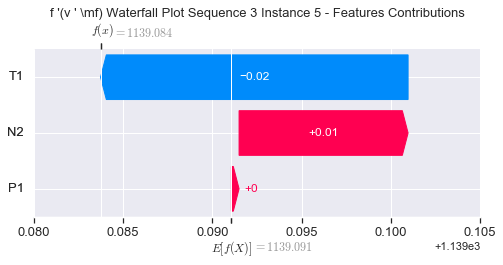

None

Contribution: [ 0.00081192 -0.01511063  0.01082555]


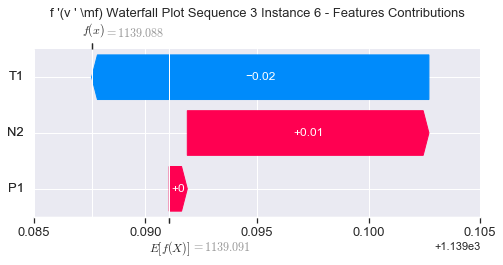

None

Contribution: [ 0.00104544 -0.01493202  0.01177697]


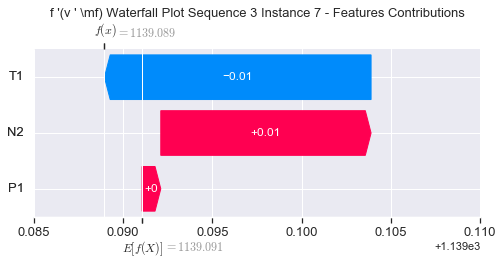

None

Contribution: [ 0.0012177  -0.0147544   0.01216139]


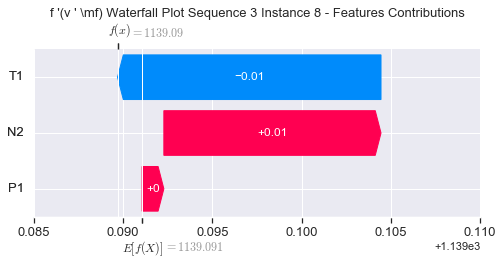

None

Contribution: [ 0.00059269 -0.0128861   0.01263343]


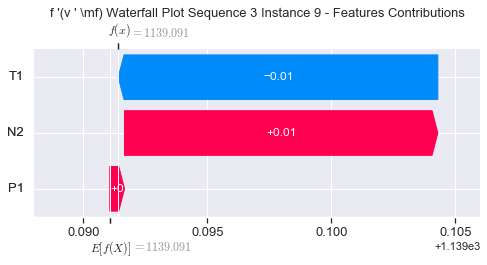

None

Contribution: [ 0.00083153 -0.0101251   0.01352838]


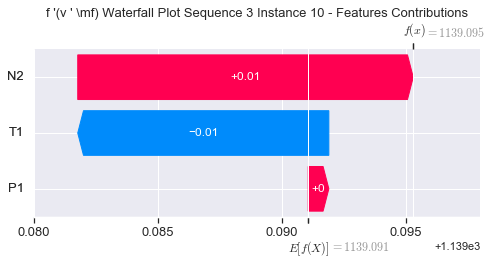

None

Contribution: [ 0.00131792 -0.0120034   0.0137791 ]


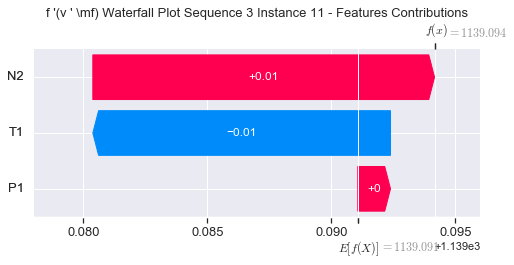

None

Contribution: [ 0.0016868  -0.016165    0.01363382]


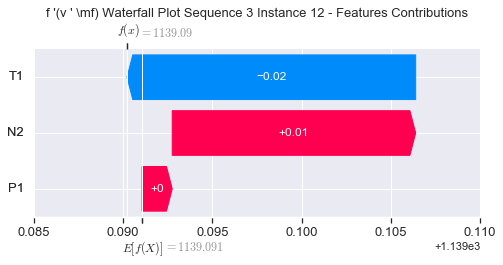

None

Contribution: [ 0.00085832 -0.01729456  0.01181943]


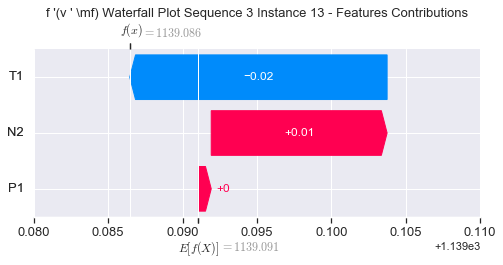

None

Contribution: [-0.00310128 -0.02007254  0.00527058]


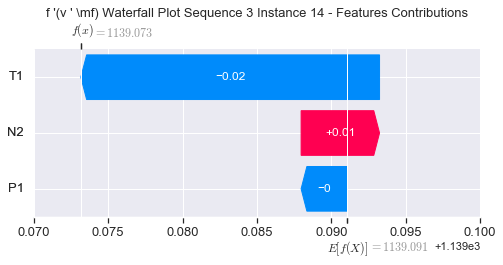

None

Contribution: [-0.00803837 -0.03177998 -0.01038497]


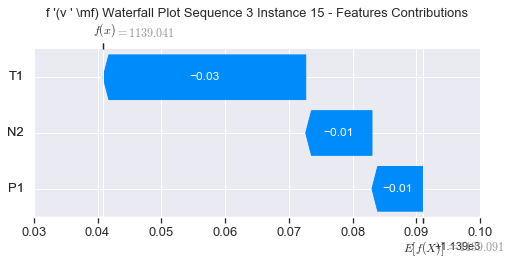

None

Contribution: [-0.01782938 -0.04904403 -0.03388566]


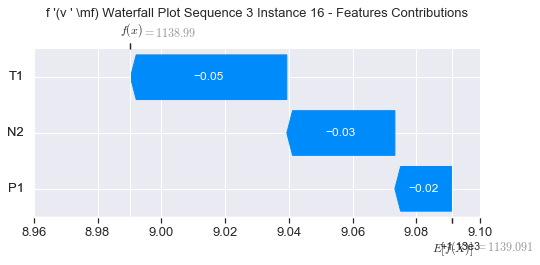

None

Contribution: [-0.03252425 -0.08877206 -0.06059973]


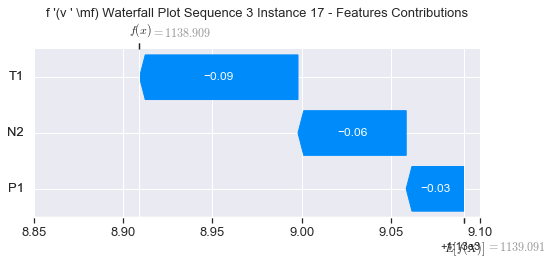

None

Contribution: [-0.04295083 -0.15843952 -0.04563386]


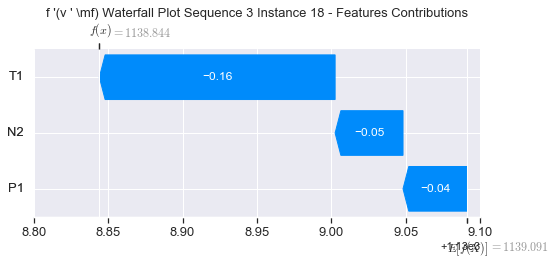

None

Contribution: [-0.03047337 -0.32131733  0.10419817]


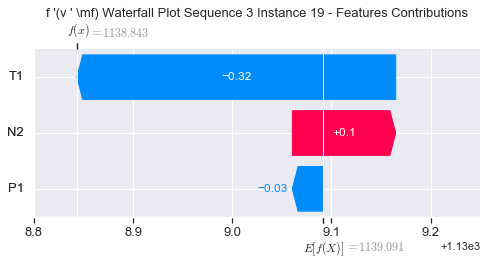

None

Contribution: [ 0.02434445 -0.60871637  0.53308223]


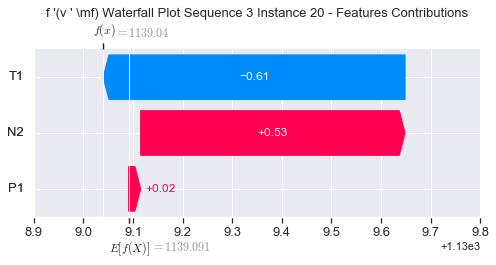

None

Contribution: [ 0.15313949 -1.3288502   1.42585899]


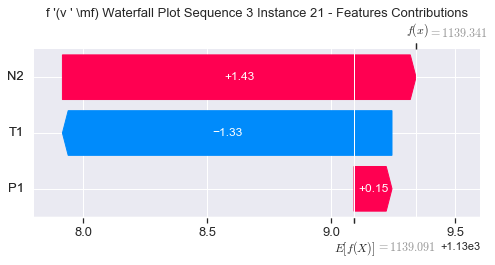

None

Contribution: [ 0.25994318 -3.04336092  2.76868762]


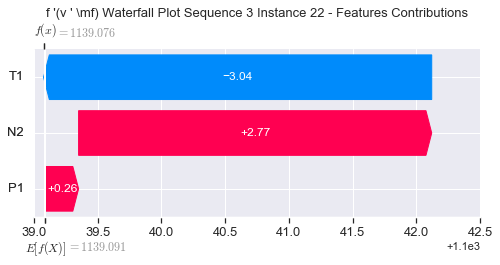

None

Contribution: [-0.00661023 -6.26562574  4.0014193 ]


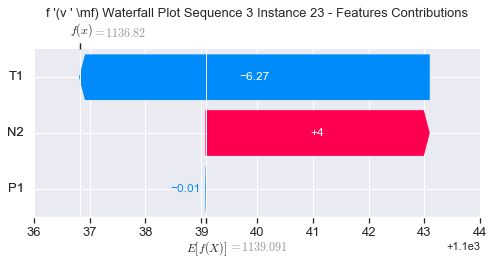

None

Contribution: [-0.27830607 -9.43282352  3.55024717]


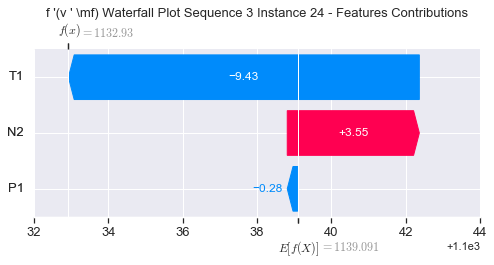

None

Contribution: [ 7.03103866e-03 -1.21008536e+01  4.89416669e+00]


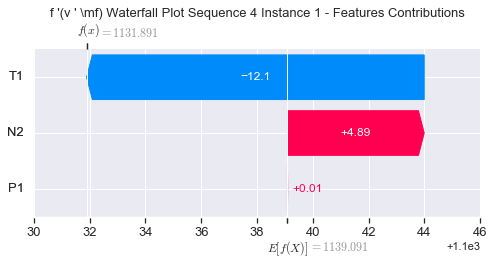

None

Contribution: [-0.01752277  1.41077213 -0.64228593]


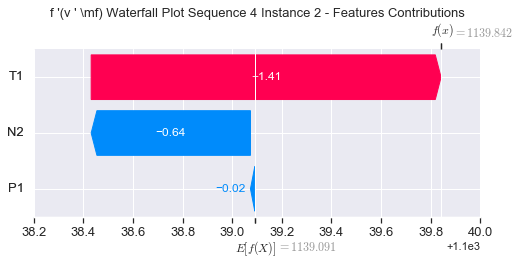

None

Contribution: [-0.00165716 -0.01649529  0.00416524]


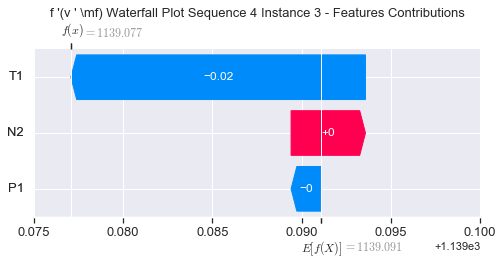

None

Contribution: [ 0.00030885 -0.02033773  0.00816113]


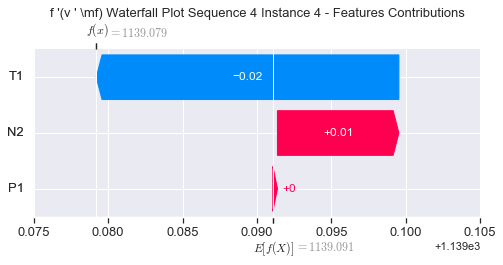

None

Contribution: [ 0.00069401 -0.01849695  0.00964431]


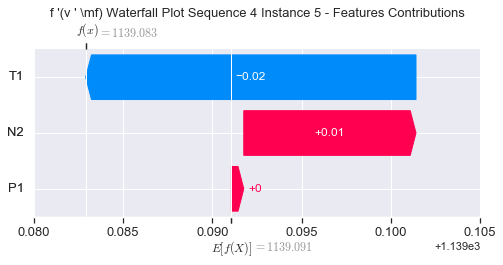

None

Contribution: [ 0.0013035  -0.01748706  0.01104752]


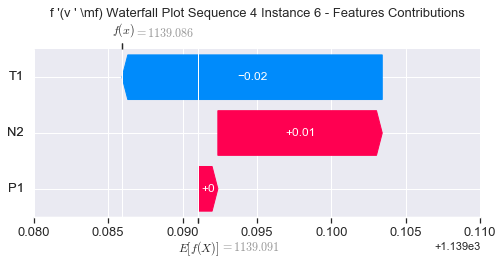

None

Contribution: [ 0.00162621 -0.01711218  0.01202461]


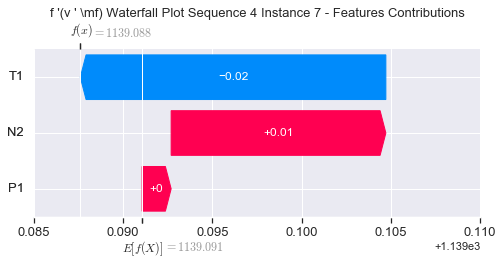

None

Contribution: [ 0.00157513 -0.01707082  0.01241808]


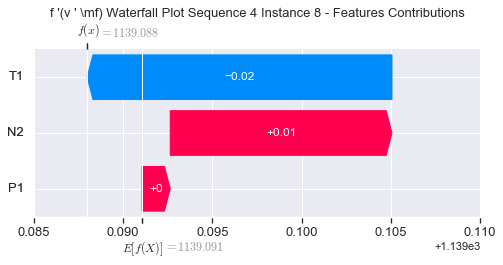

None

Contribution: [ 0.00039124 -0.01585277  0.01299829]


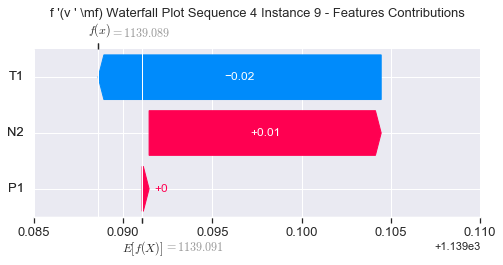

None

Contribution: [ 0.0012256  -0.01709806  0.01355687]


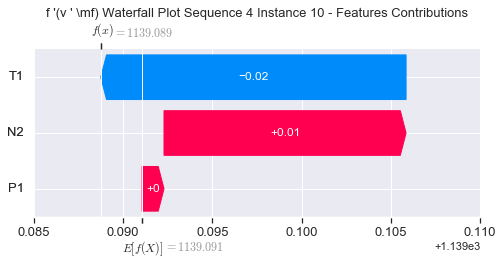

None

Contribution: [ 0.00058567 -0.01620571  0.01405995]


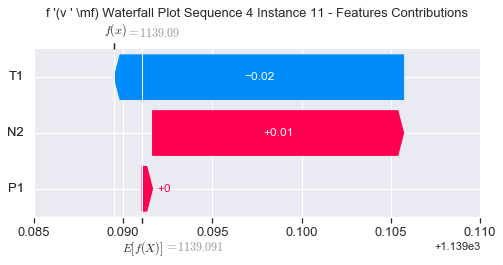

None

Contribution: [ 0.00163247 -0.01846994  0.01380084]


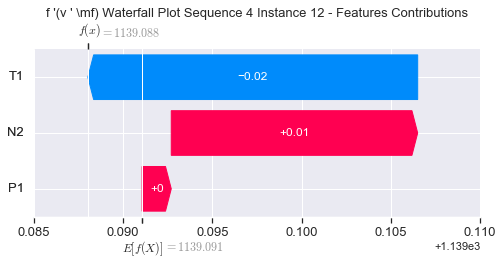

None

Contribution: [ 0.00088861 -0.01969341  0.01199823]


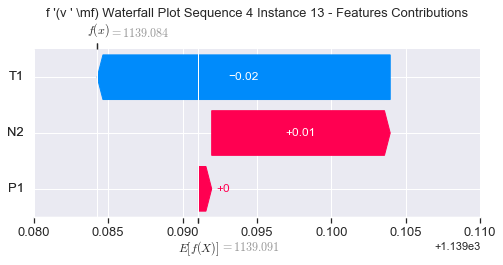

None

Contribution: [-0.00229584 -0.02342291  0.00565063]


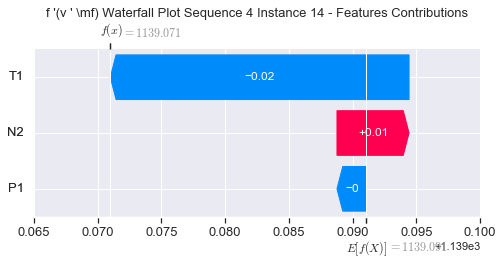

None

Contribution: [-0.0080151  -0.0363617  -0.01065756]


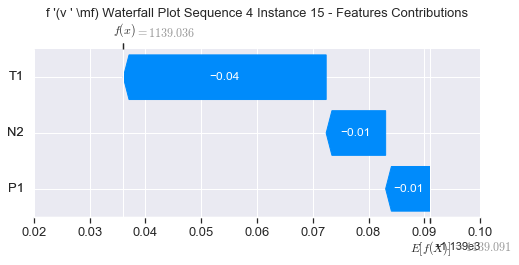

None

Contribution: [-0.02113152 -0.05607345 -0.03567408]


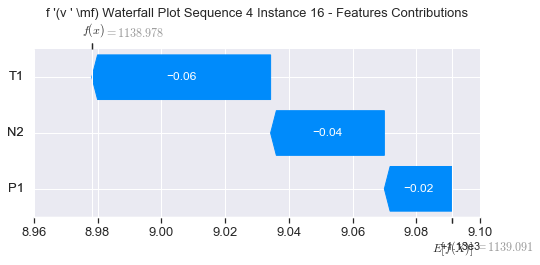

None

Contribution: [-0.03223849 -0.10164302 -0.0615972 ]


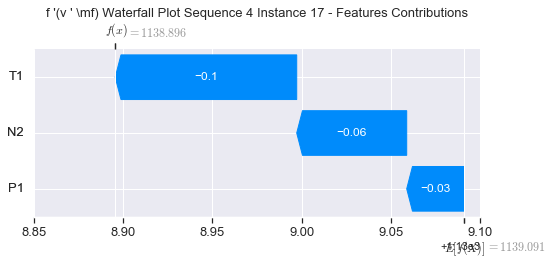

None

Contribution: [-0.04199312 -0.184941   -0.04622742]


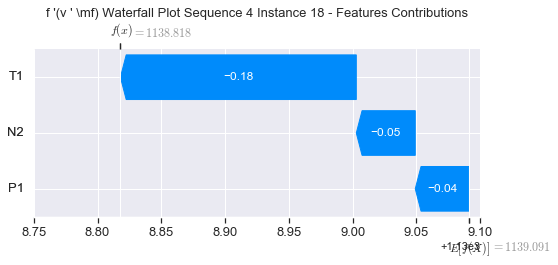

None

Contribution: [-0.02811237 -0.33281611  0.09870019]


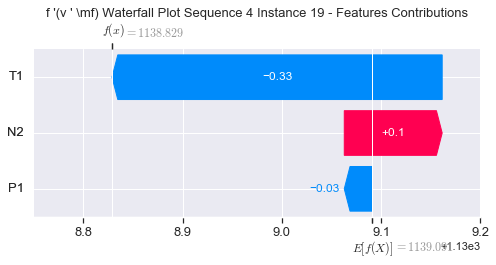

None

Contribution: [ 0.034192   -0.70351246  0.54068513]


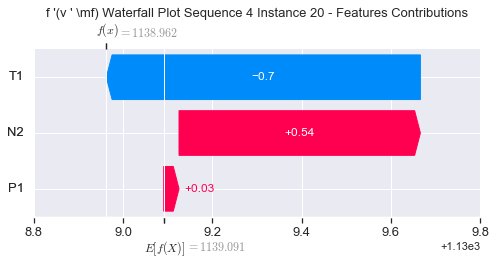

None

Contribution: [ 0.16086448 -1.51165898  1.44226647]


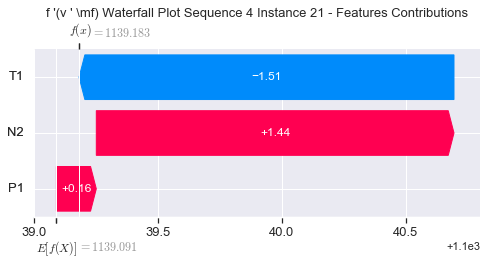

None

Contribution: [ 0.24598622 -3.39299236  2.79103765]


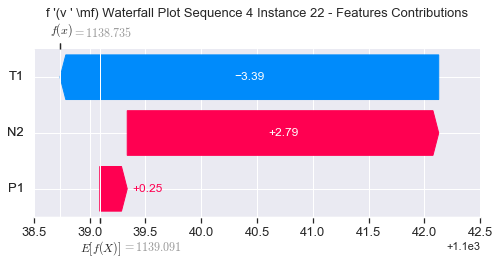

None

Contribution: [-0.03459534 -7.00618842  4.0344196 ]


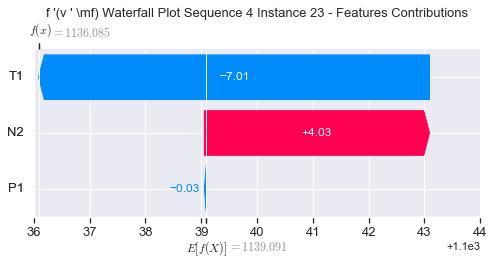

None

Contribution: [ -0.40394557 -10.21516973   3.63258388]


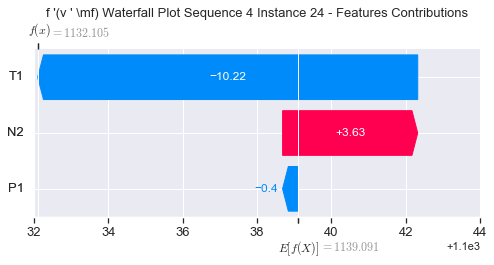

None

Contribution: [ -0.64253933 -12.39861135   5.16281714]


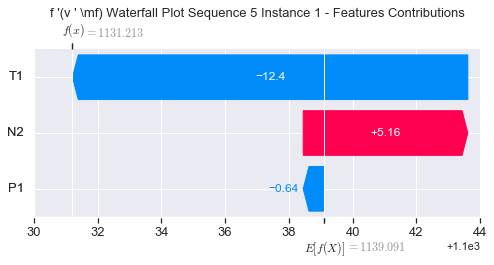

None

Contribution: [ 0.02189441  1.44534923 -0.63545131]


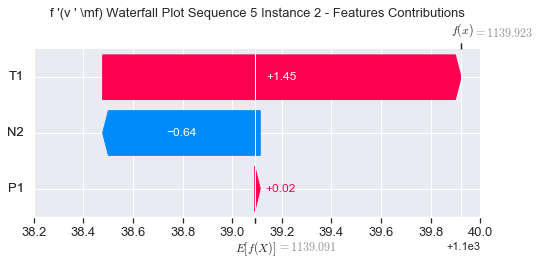

None

Contribution: [-0.00167827 -0.01671823  0.00397198]


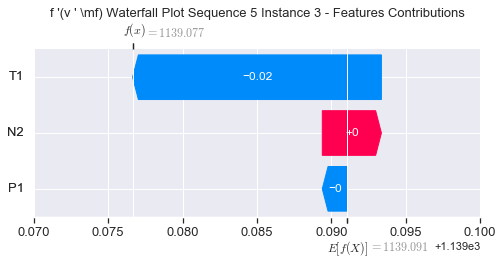

None

Contribution: [-0.00087755 -0.01997407  0.00804076]


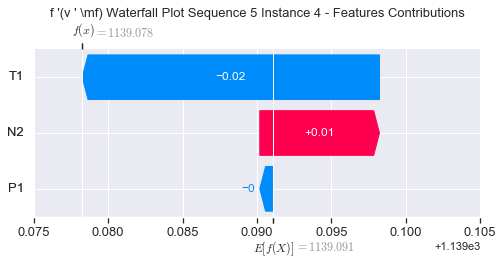

None

Contribution: [-0.00018808 -0.01774467  0.00953136]


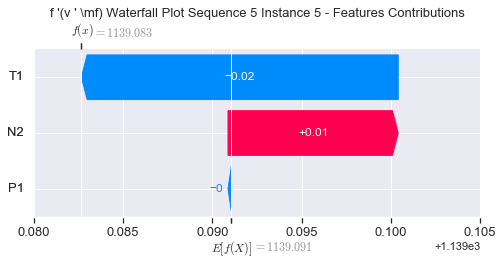

None

Contribution: [ 0.00056858 -0.01566223  0.01089231]


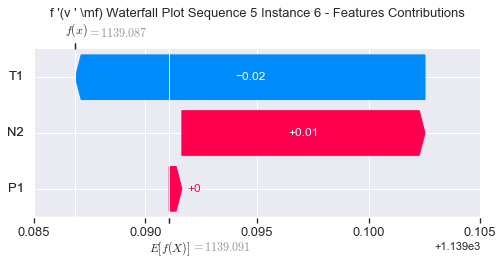

None

Contribution: [ 0.00083811 -0.015513    0.01181468]


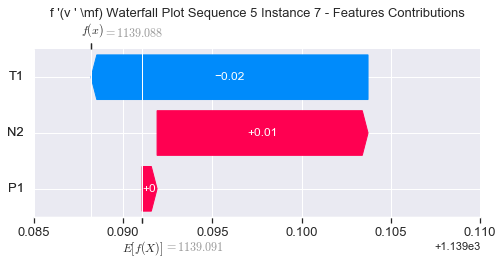

None

Contribution: [ 0.00098021 -0.01523653  0.01221193]


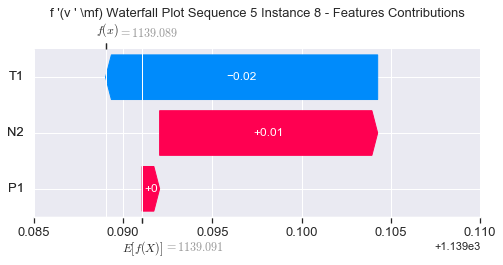

None

Contribution: [ 0.00044133 -0.0140717   0.01253595]


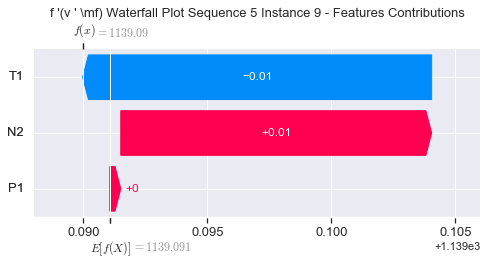

None

Contribution: [-0.00049947 -0.01386024  0.0131158 ]


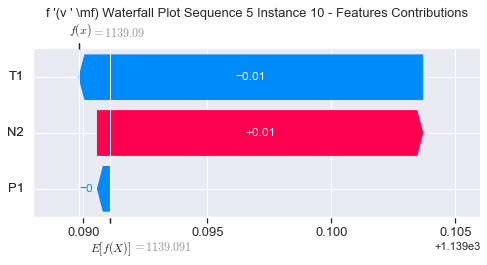

None

Contribution: [ 0.00075824 -0.01267603  0.01373169]


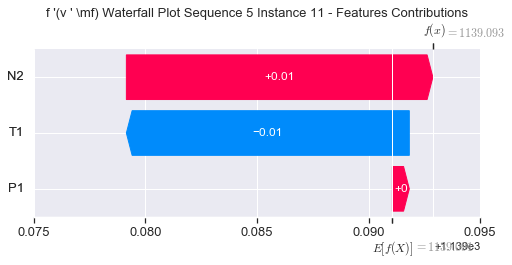

None

Contribution: [ 0.00103182 -0.01605224  0.01363084]


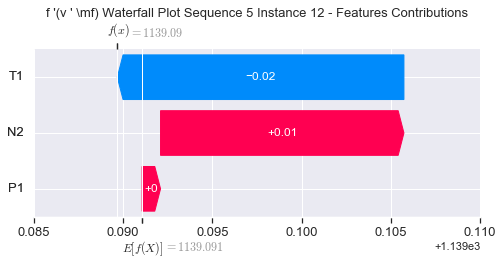

None

Contribution: [ 0.00029973 -0.01722395  0.01182765]


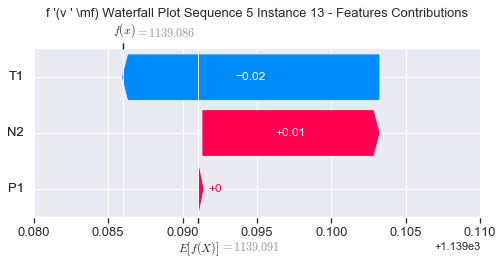

None

Contribution: [-0.00158602 -0.0210945   0.00585906]


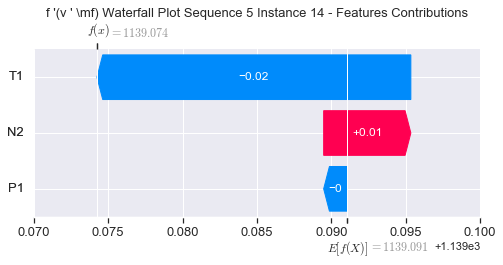

None

Contribution: [-0.00827896 -0.03096161 -0.01030264]


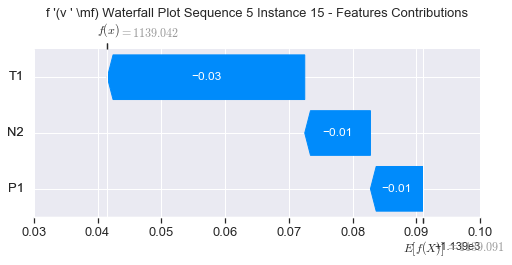

None

Contribution: [-0.01771608 -0.05013669 -0.03300022]


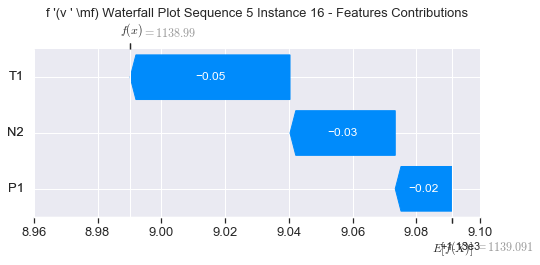

None

Contribution: [-0.03212026 -0.08556768 -0.06079171]


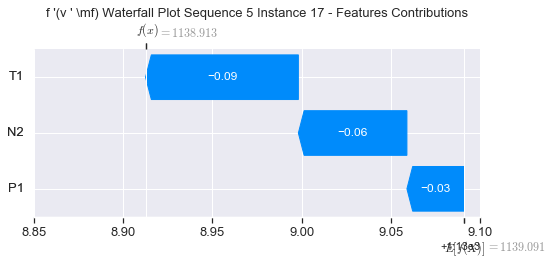

None

Contribution: [-0.04112716 -0.14967032 -0.04611733]


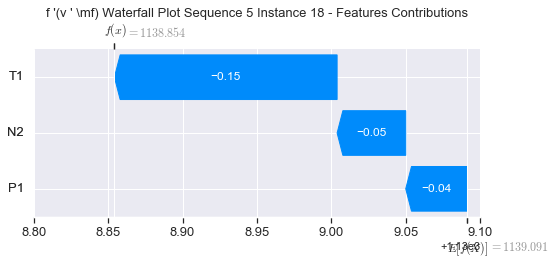

None

Contribution: [-0.03498539 -0.30272148  0.08972423]


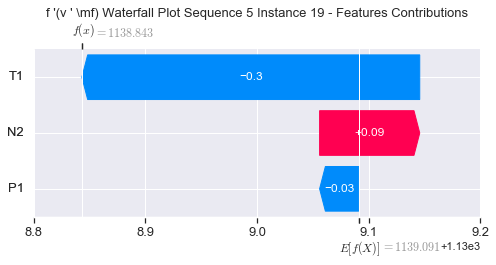

None

Contribution: [ 0.0409765  -0.55228236  0.53020249]


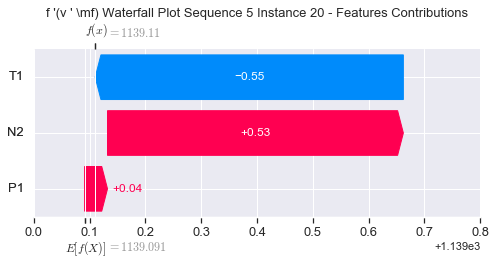

None

Contribution: [ 0.18107789 -1.18773529  1.42343337]


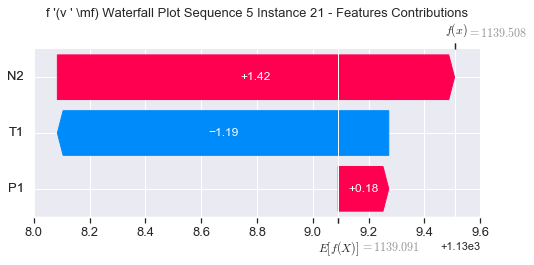

None

Contribution: [ 0.30039455 -2.69473568  2.77151999]


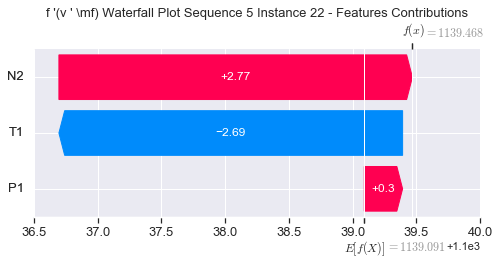

None

Contribution: [ 0.10012482 -5.61541724  4.01202035]


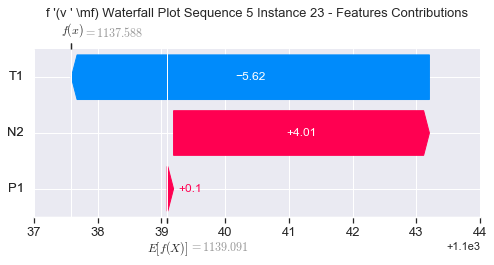

None

Contribution: [-0.1159126  -8.58389058  3.62342897]


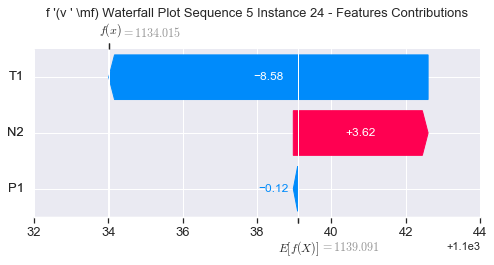

None

Contribution: [  0.13881458 -11.18854459   5.13921589]


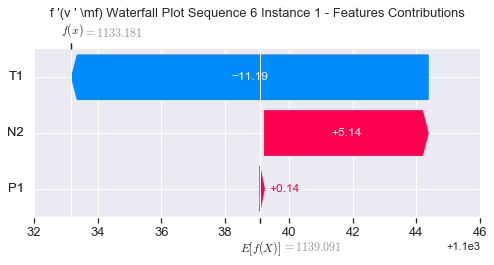

None

Contribution: [-0.00506489  1.26953317 -0.64662462]


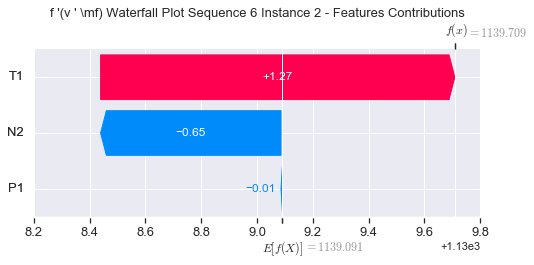

None

Contribution: [-0.00136966 -0.01455647  0.0045071 ]


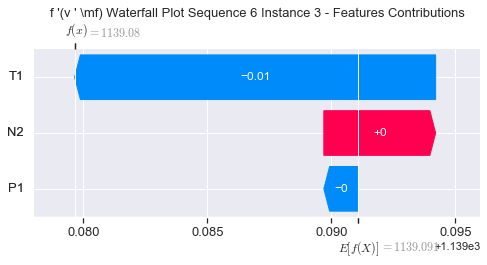

None

Contribution: [-0.00026863 -0.0188643   0.00844473]


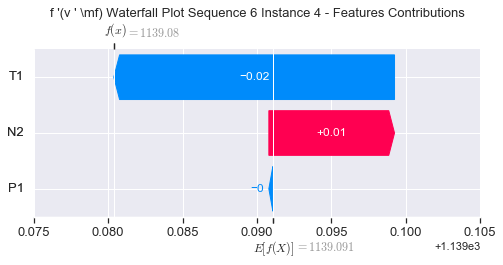

None

Contribution: [ 0.00044442 -0.01503578  0.0099416 ]


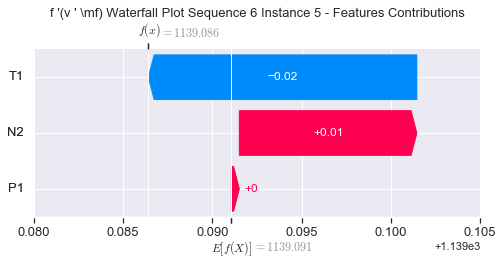

None

Contribution: [ 0.00106534 -0.01523675  0.01116692]


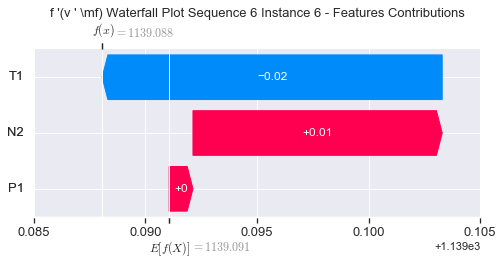

None

Contribution: [ 0.00139185 -0.01539329  0.01204969]


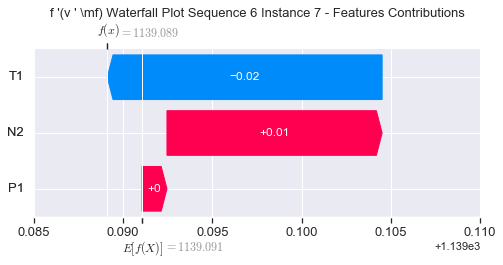

None

Contribution: [ 0.00141486 -0.01568368  0.01249183]


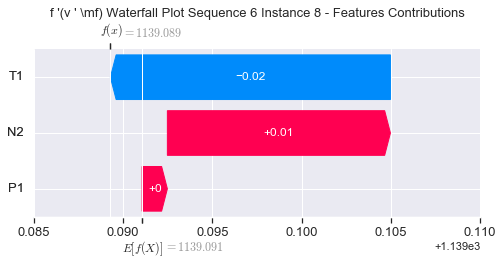

None

Contribution: [ 0.00089605 -0.01619918  0.01283134]


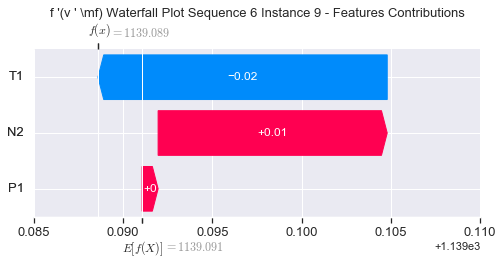

None

Contribution: [ 0.00014382 -0.01499154  0.01356308]


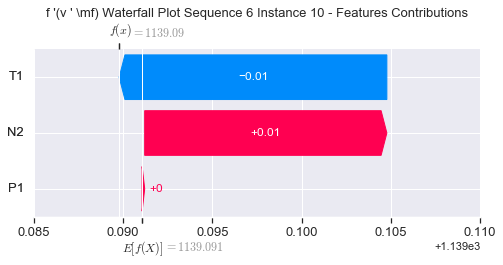

None

Contribution: [ 0.00101849 -0.01641316  0.01400147]


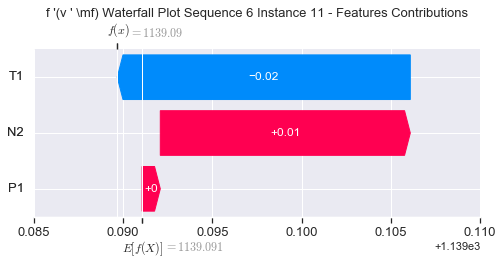

None

Contribution: [ 0.00142835 -0.01918045  0.01342517]


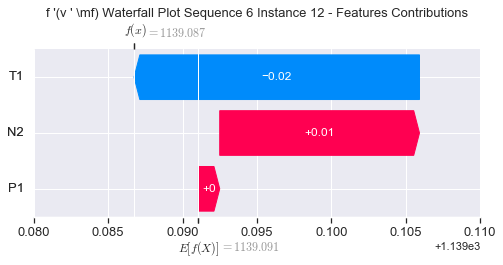

None

Contribution: [ 0.000623   -0.0207966   0.01160215]


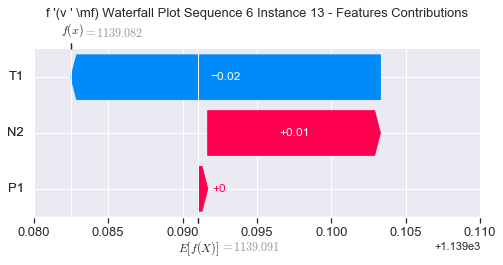

None

Contribution: [-0.00220472 -0.02439879  0.00441263]


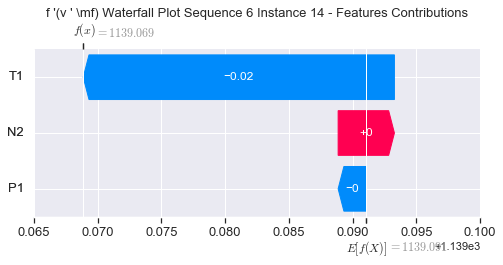

None

Contribution: [-0.00866349 -0.03965964 -0.01170293]


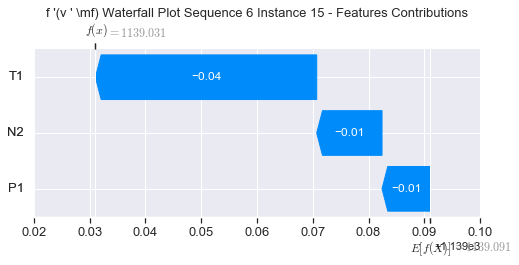

None

Contribution: [-0.02102981 -0.06913993 -0.03802012]


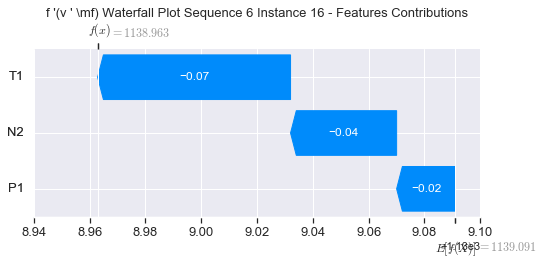

None

Contribution: [-0.0345109  -0.11972836 -0.0646896 ]


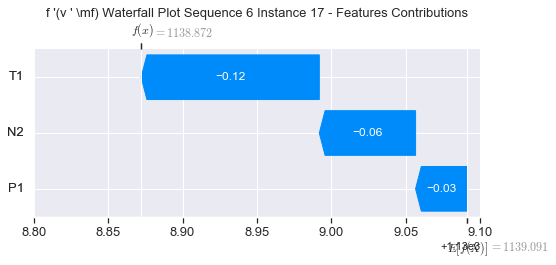

None

Contribution: [-0.04630607 -0.22605541 -0.04944533]


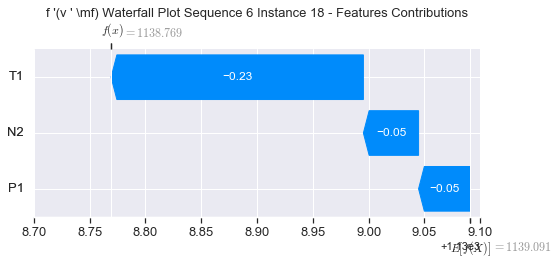

None

Contribution: [-0.041316   -0.46099765  0.1072557 ]


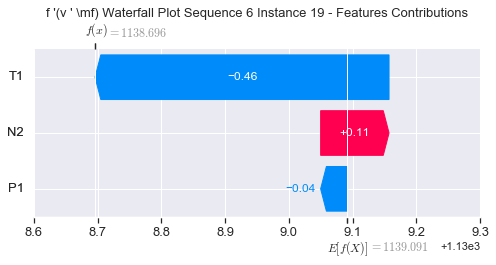

None

Contribution: [ 0.01925115 -0.91201012  0.55322169]


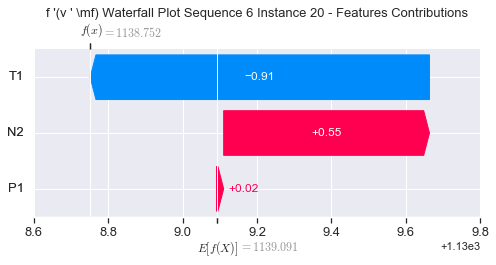

None

Contribution: [ 0.13384761 -1.9617768   1.46717962]


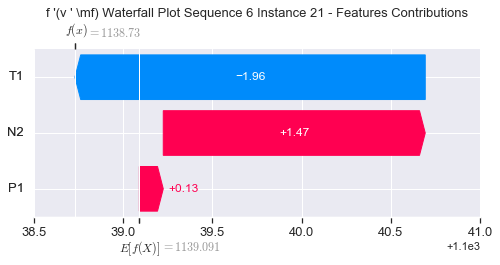

None

Contribution: [ 0.19078675 -4.27739073  2.84523117]


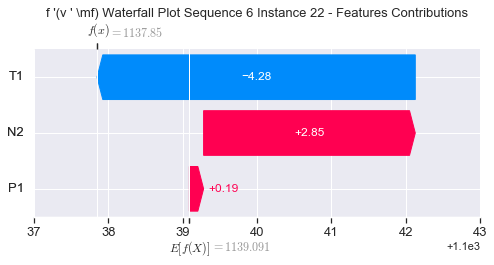

None

Contribution: [-0.1469852  -8.77170271  4.11061429]


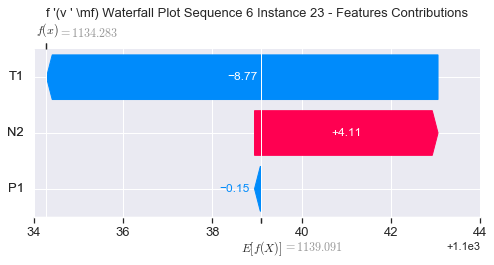

None

Contribution: [ -0.48175716 -12.28420047   3.77476383]


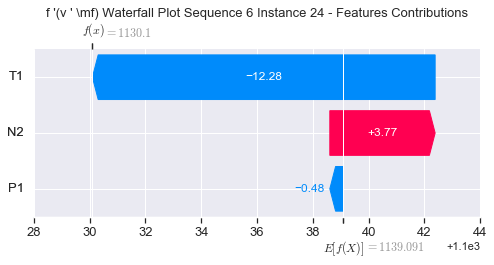

None

Contribution: [ -0.50770368 -16.35711374   5.21485438]


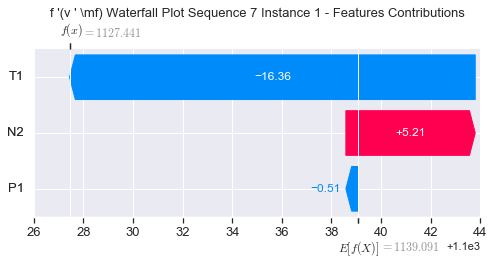

None

Contribution: [ 0.04847906  1.90290018 -0.64088122]


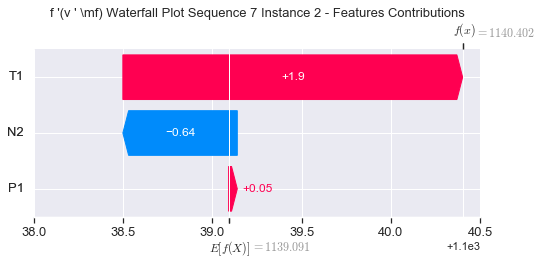

None

Contribution: [-0.00142372 -0.01854688  0.00374101]


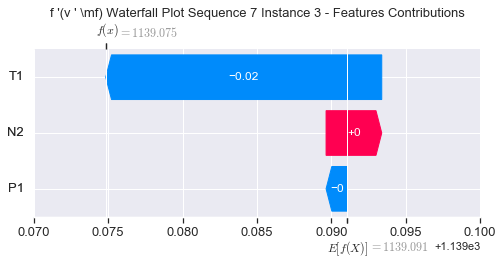

None

Contribution: [-0.00037699 -0.02672915  0.00813948]


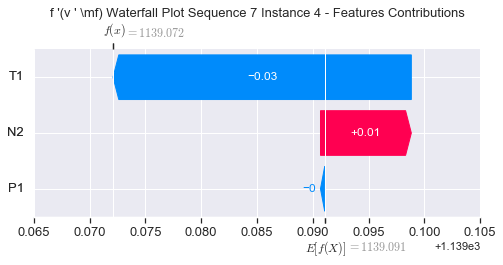

None

Contribution: [ 0.00046627 -0.02332958  0.00954299]


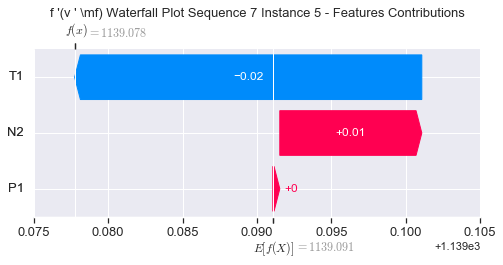

None

Contribution: [ 0.0006665  -0.02250623  0.01066027]


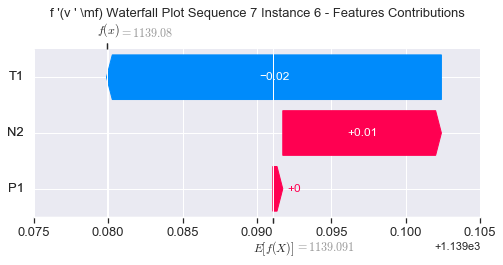

None

Contribution: [ 0.00080821 -0.02197749  0.01163695]


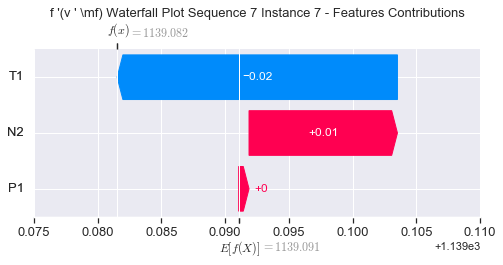

None

Contribution: [ 0.0009772  -0.0218646   0.01203326]


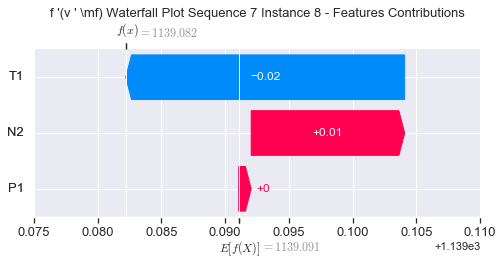

None

Contribution: [ 0.00017018 -0.0197726   0.01233566]


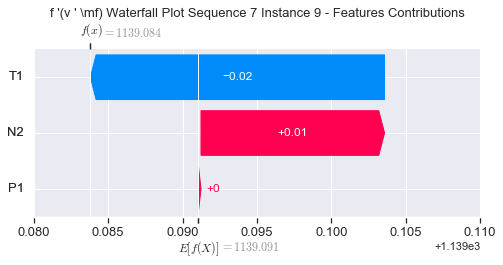

None

Contribution: [ 0.00054711 -0.01877165  0.0133056 ]


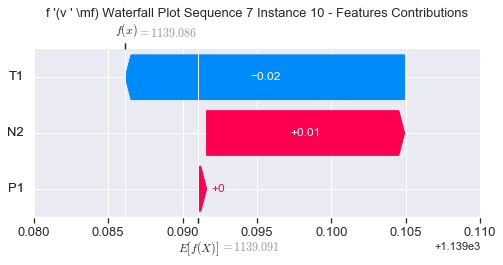

None

Contribution: [ 0.00083176 -0.0209636   0.01344709]


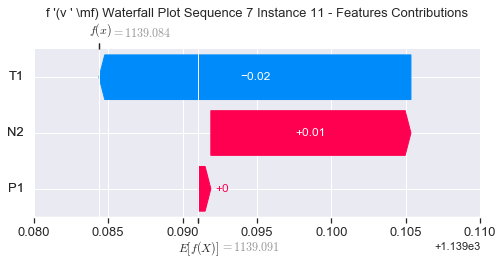

None

Contribution: [ 0.00077931 -0.02393946  0.01373567]


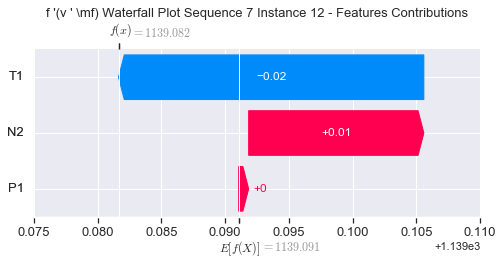

None

Contribution: [-0.0001654  -0.02581873  0.01192573]


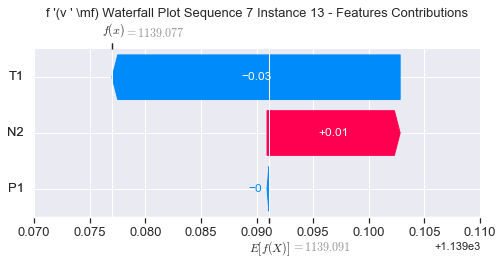

None

Contribution: [-0.00353269 -0.02902654  0.00474148]


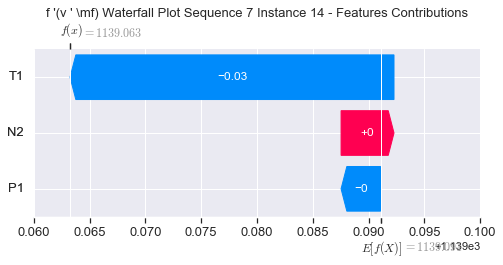

None

Contribution: [-0.01037913 -0.04821725 -0.01252804]


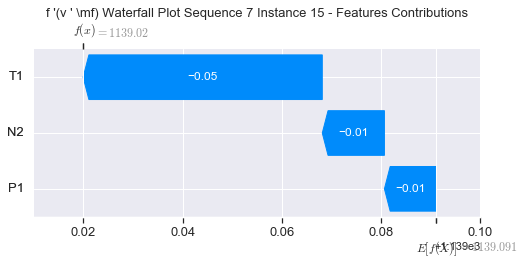

None

Contribution: [-0.02094958 -0.07945    -0.03870709]


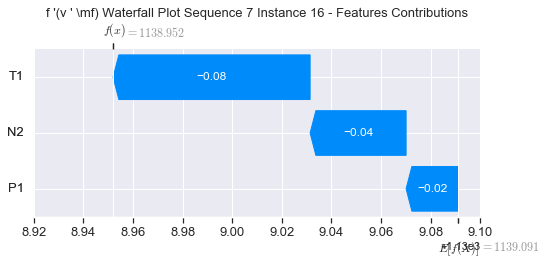

None

Contribution: [-0.04090696 -0.13669273 -0.06941762]


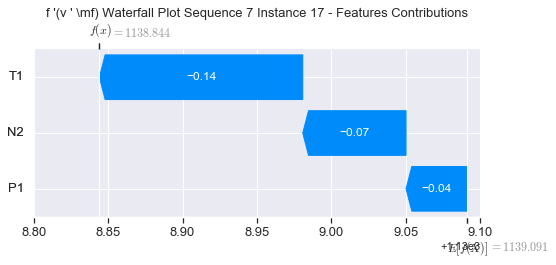

None

Contribution: [-0.05732764 -0.25395127 -0.05707537]


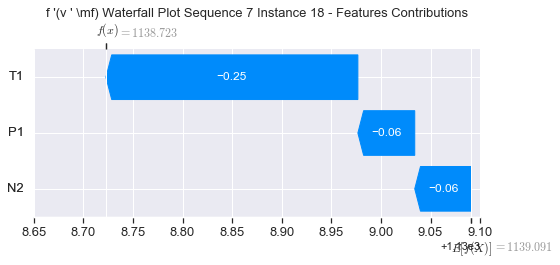

None

Contribution: [-0.03827406 -0.51935727  0.10189011]


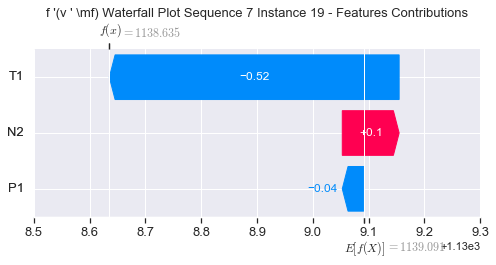

None

Contribution: [-0.01373796 -0.97028818  0.54180607]


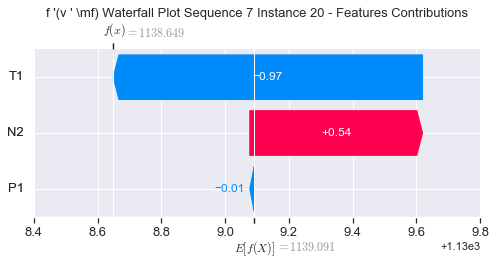

None

Contribution: [ 0.0788345  -2.02956294  1.4624416 ]


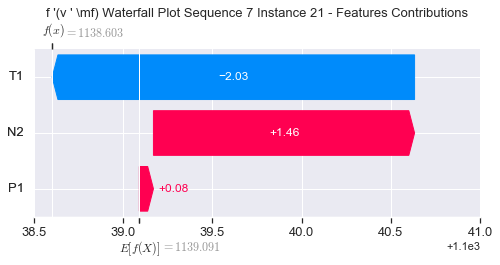

None

Contribution: [ 0.12676179 -4.37339307  2.84283328]


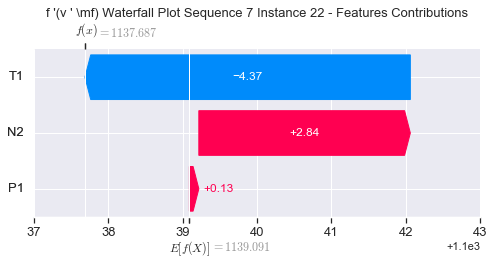

None

Contribution: [-0.26121364 -8.69424783  4.07293162]


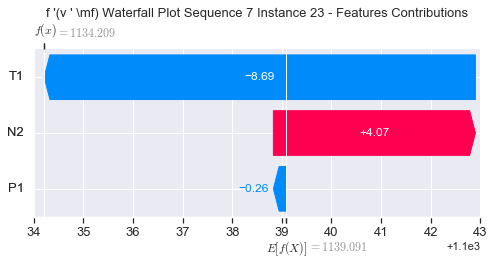

None

Contribution: [ -0.54845159 -12.34822807   3.66739296]


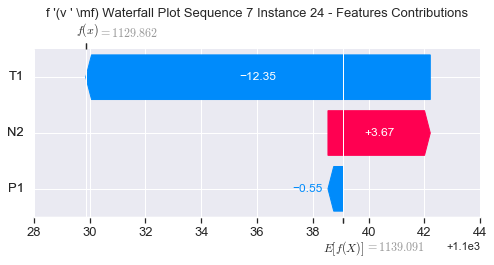

None

Contribution: [ -0.60018159 -15.49319477   5.11584462]


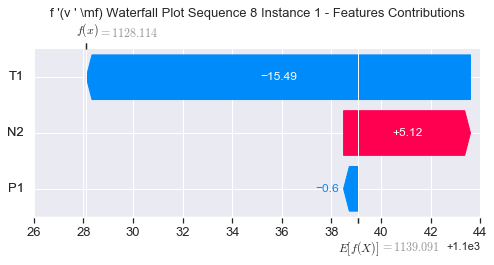

None

Contribution: [ 0.04326568  1.66406522 -0.65195692]


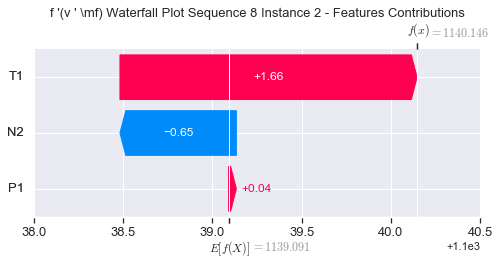

None

Contribution: [-0.00152954 -0.01914131  0.00431987]


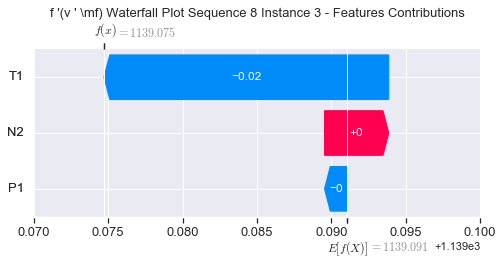

None

Contribution: [-0.00106726 -0.02502621  0.00820757]


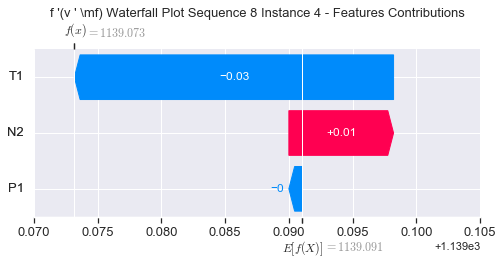

None

Contribution: [-0.002436   -0.02205019  0.00860691]


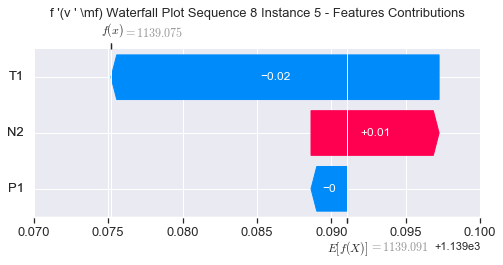

None

Contribution: [ 0.00019678 -0.01826794  0.01078572]


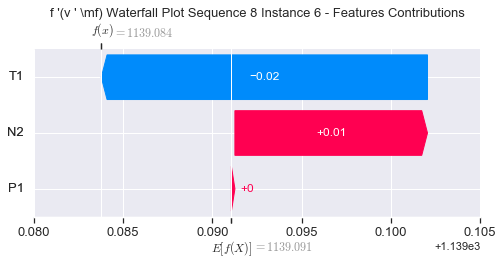

None

Contribution: [ 0.00039232 -0.01820126  0.01183652]


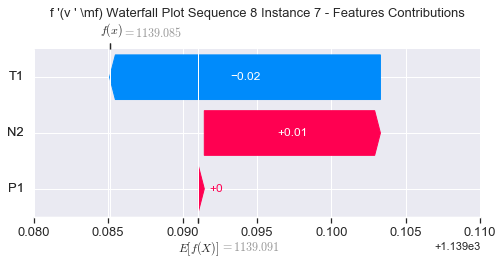

None

Contribution: [ 0.00049529 -0.01751984  0.01220243]


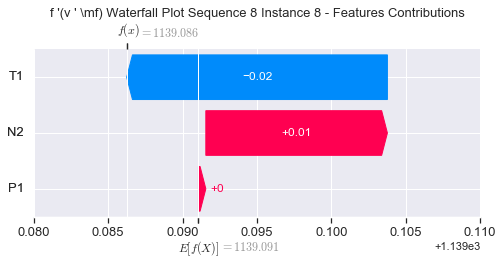

None

Contribution: [-0.00092093 -0.01850782  0.01304224]


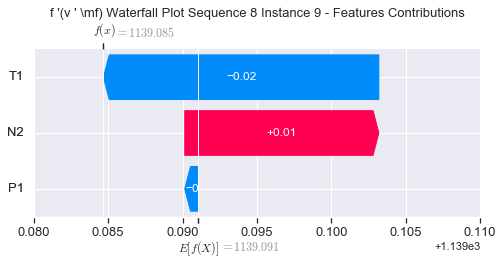

None

Contribution: [-0.00339201 -0.0195748   0.01331292]


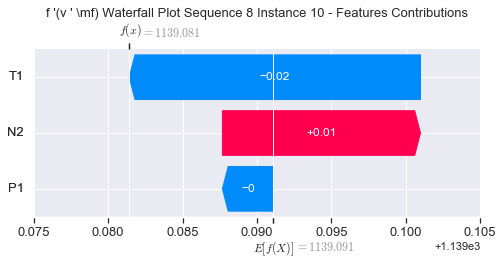

None

Contribution: [ 0.00106102 -0.01375628  0.01456814]


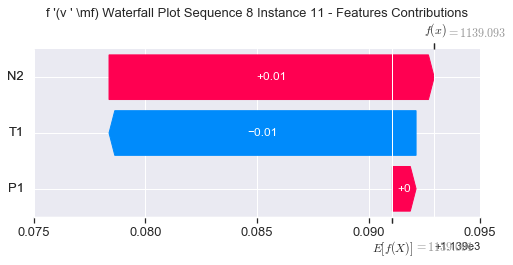

None

Contribution: [ 0.00203275 -0.01353987  0.01414782]


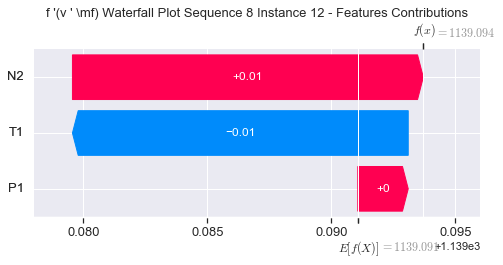

None

Contribution: [ 0.00091238 -0.01522485  0.01232853]


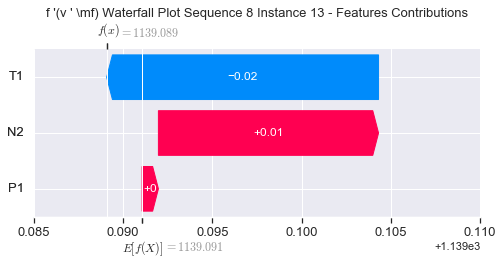

None

Contribution: [-0.0013305  -0.01917399  0.00619673]


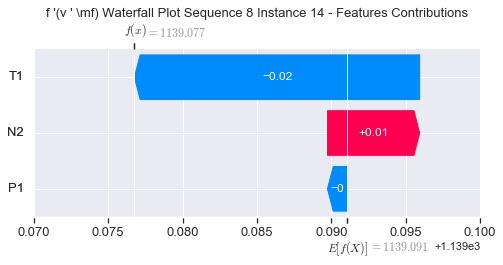

None

Contribution: [-0.00652936 -0.02767625 -0.00905854]


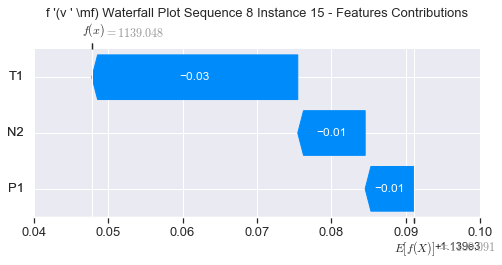

None

Contribution: [-0.01736771 -0.04575919 -0.03238002]


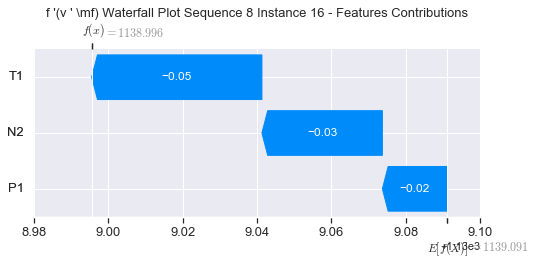

None

Contribution: [-0.02734295 -0.07241857 -0.05721375]


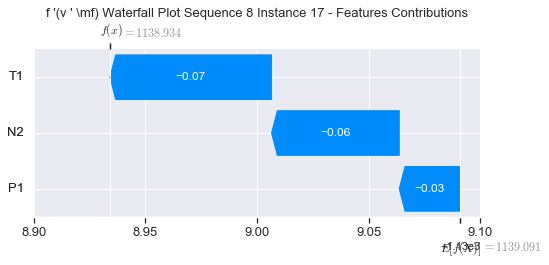

None

Contribution: [-0.02997671 -0.11730376 -0.04000494]


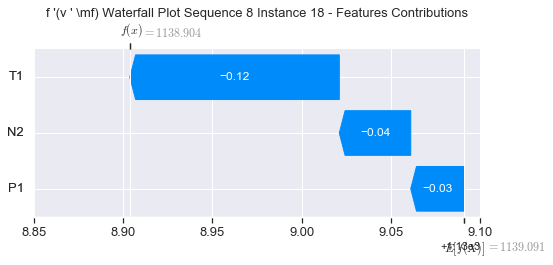

None

Contribution: [-0.01745159 -0.2692604   0.10875589]


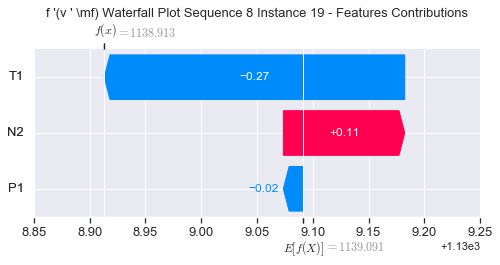

None

Contribution: [ 0.05640452 -0.4483012   0.54392238]


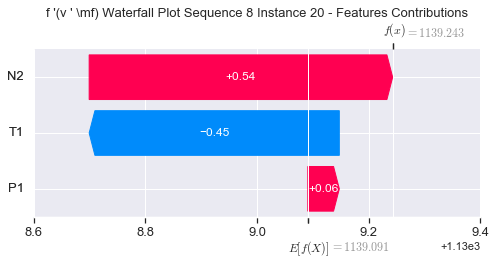

None

Contribution: [ 0.21762132 -0.89187897  1.45003406]


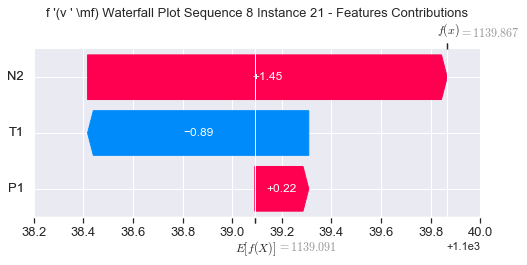

None

Contribution: [ 0.38778087 -1.99638456  2.81985389]


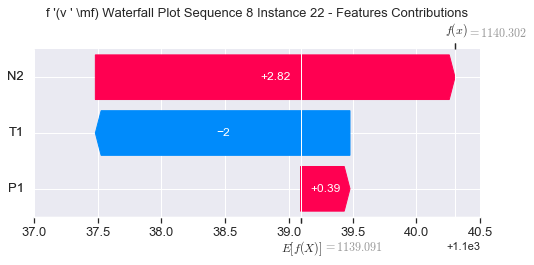

None

Contribution: [ 0.48585472 -3.92513439  4.19581587]


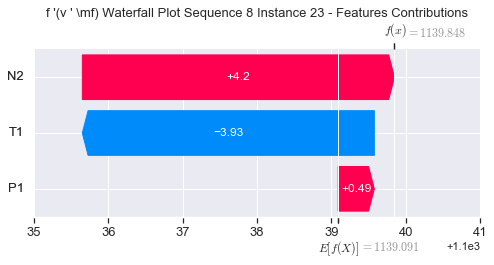

None

Contribution: [ 0.09859038 -7.02961248  3.73936937]


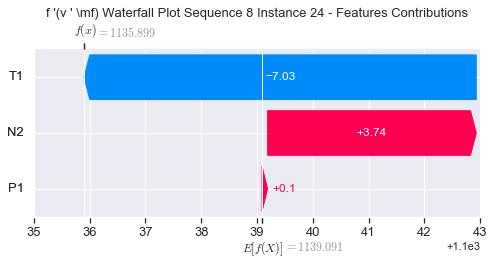

None

Contribution: [ 0.12454432 -8.99755192  5.14572131]


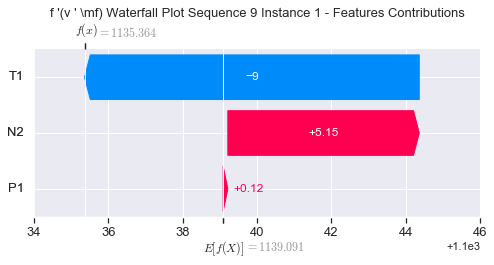

None

Contribution: [-0.04628122  0.79718077 -0.65998228]


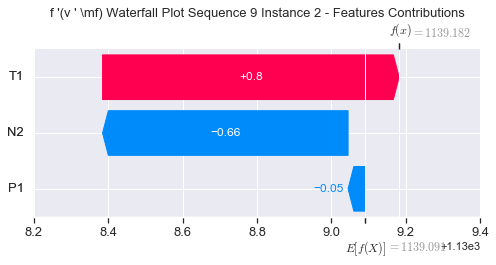

None

Contribution: [-0.00054632 -0.01465243  0.00468928]


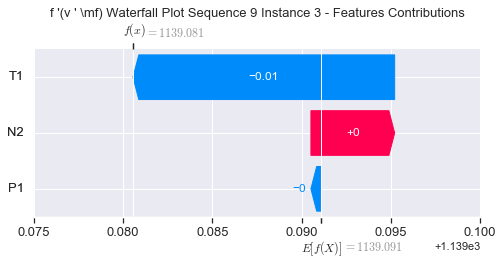

None

Contribution: [-0.00068294 -0.01208409  0.00804112]


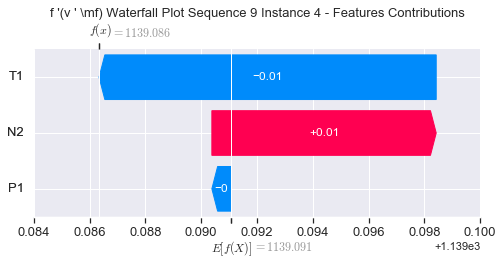

None

Contribution: [ 0.00055307 -0.01146764  0.00987988]


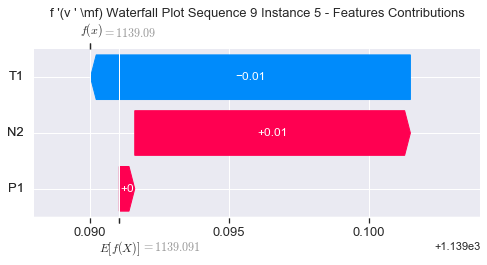

None

Contribution: [ 0.00099889 -0.01125941  0.01107466]


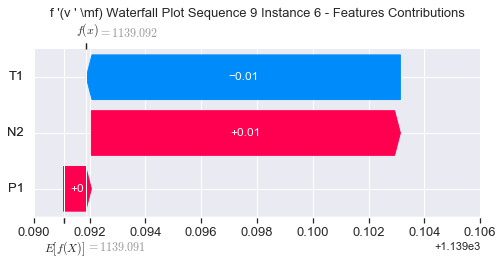

None

Contribution: [ 0.00134902 -0.0110649   0.01200946]


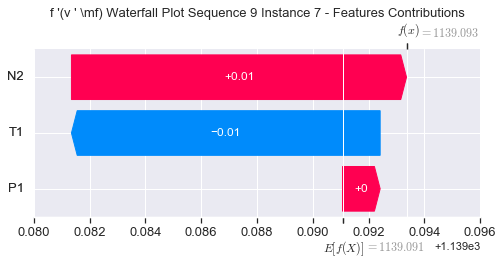

None

Contribution: [ 0.00166115 -0.01100938  0.01245045]


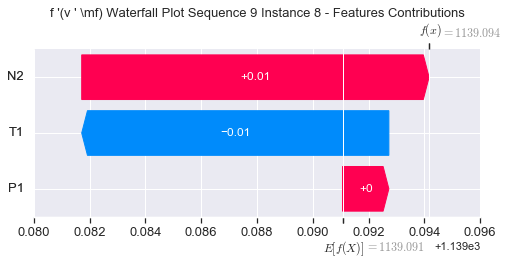

None

Contribution: [ 0.00207365 -0.00948448  0.01289139]


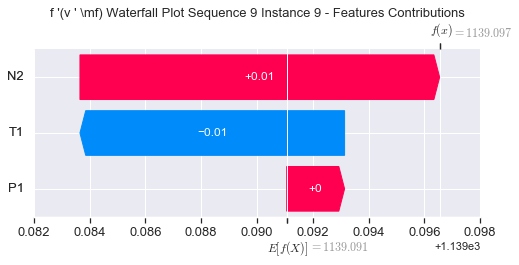

None

Contribution: [ 0.00121104 -0.00915831  0.01364858]


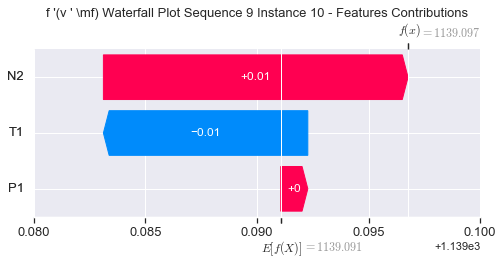

None

Contribution: [ 0.00229903 -0.00941162  0.01395114]


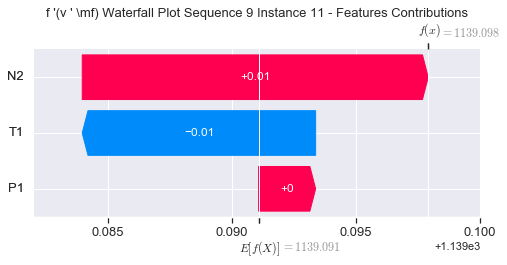

None

Contribution: [ 0.00197768 -0.01292117  0.0137779 ]


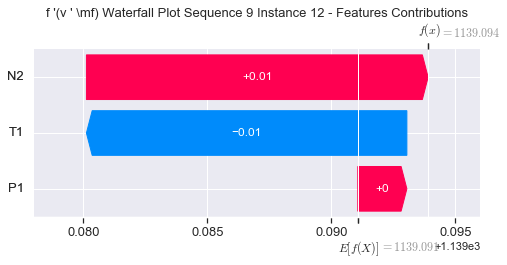

None

Contribution: [ 0.00143648 -0.01351637  0.01207205]


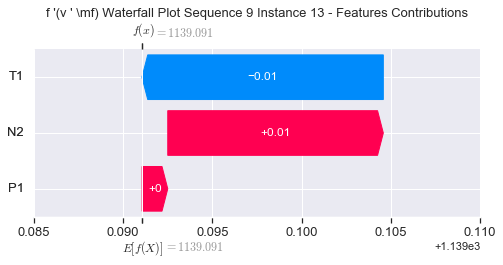

None

Contribution: [ 0.0001089  -0.01815253  0.00635803]


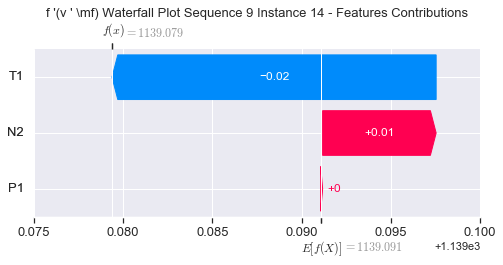

None

Contribution: [-0.00622045 -0.02593722 -0.00886177]


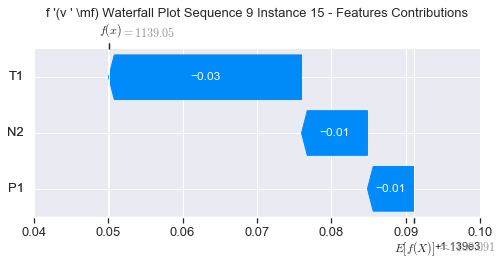

None

Contribution: [-0.0153393  -0.04766726 -0.03101066]


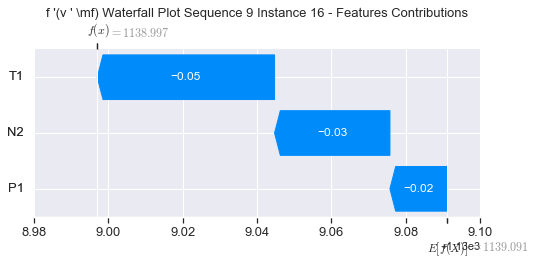

None

Contribution: [-0.02550258 -0.07278556 -0.05485138]


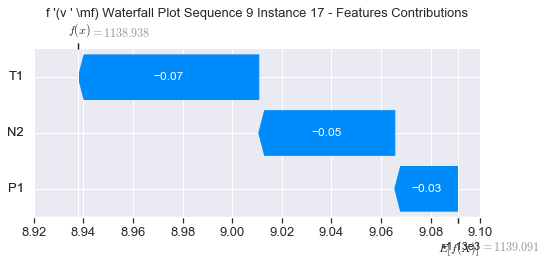

None

Contribution: [-0.02880994 -0.1291291  -0.0369282 ]


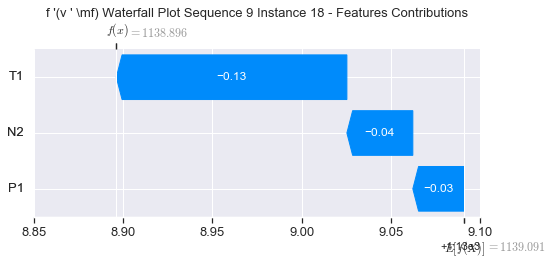

None

Contribution: [-0.01312539 -0.20975839  0.11597942]


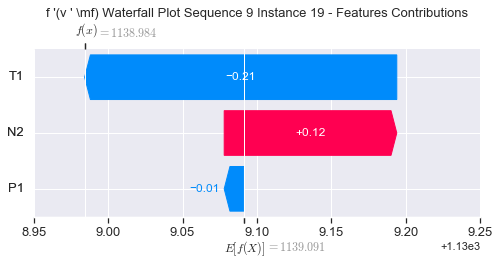

None

Contribution: [ 0.09547157 -0.46440923  0.54779242]


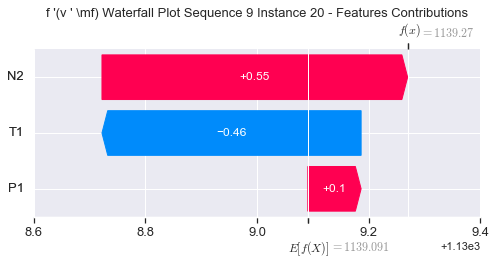

None

Contribution: [ 0.30093761 -1.0374334   1.45246974]


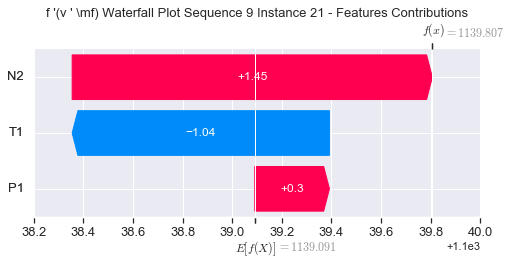

None

Contribution: [ 0.55679985 -2.459405    2.83994724]


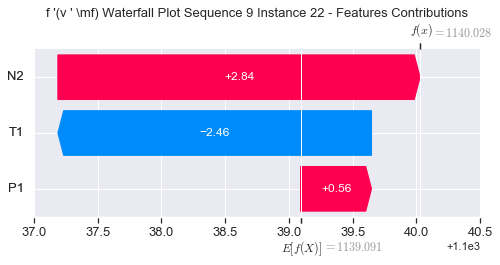

None

Contribution: [ 0.55005115 -5.50365849  4.15981502]


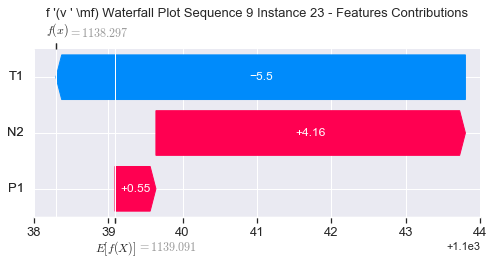

None

Contribution: [ 0.45982985 -8.58539606  3.80810678]


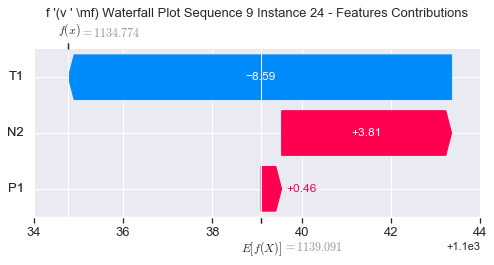

None

Contribution: [  0.99443725 -11.57637392   5.25740763]


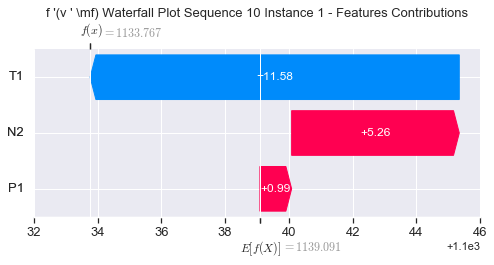

None

Contribution: [-0.14128277  1.24378707 -0.68728415]


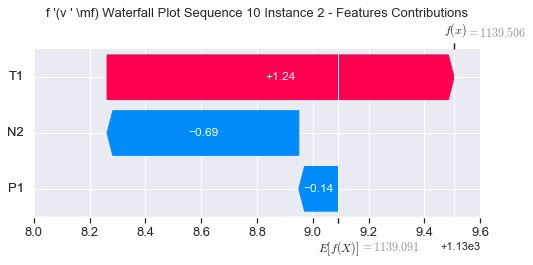

None

Contribution: [-0.00042696 -0.01480985  0.00461839]


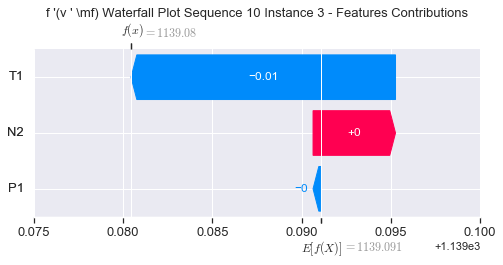

None

Contribution: [ 0.00132798 -0.01783185  0.00862866]


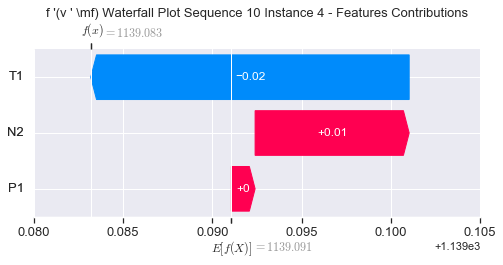

None

Contribution: [ 0.0023064  -0.01040005  0.01006153]


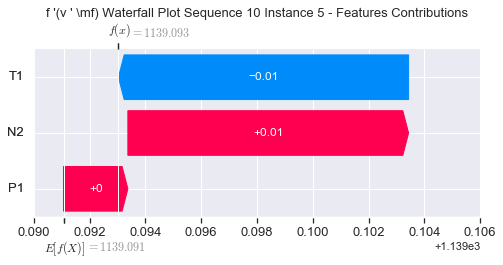

None

Contribution: [ 0.00352043 -0.01490299  0.01155954]


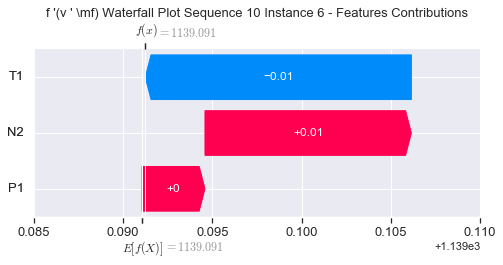

None

Contribution: [ 0.00336908 -0.0163151   0.01229922]


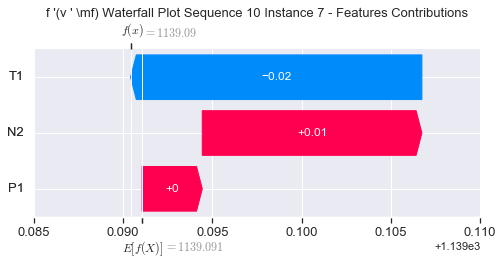

None

Contribution: [ 0.00414525 -0.01464048  0.01277847]


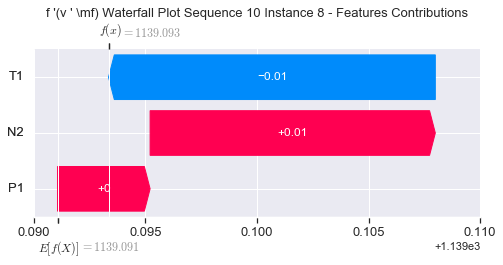

None

Contribution: [ 0.00544174 -0.01048142  0.01314711]


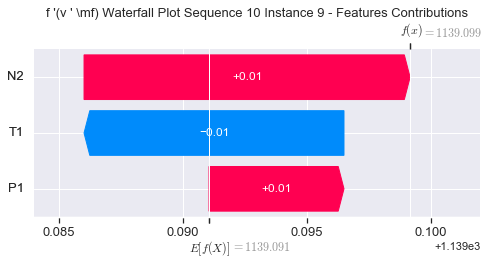

None

Contribution: [ 0.00498571 -0.00844862  0.01406299]


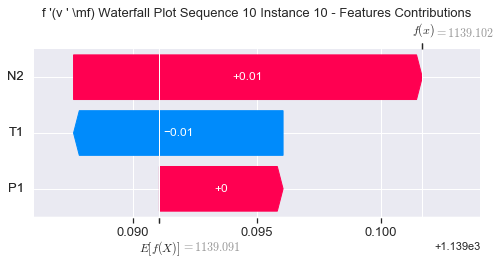

None

Contribution: [ 0.00845201 -0.00616716  0.01527938]


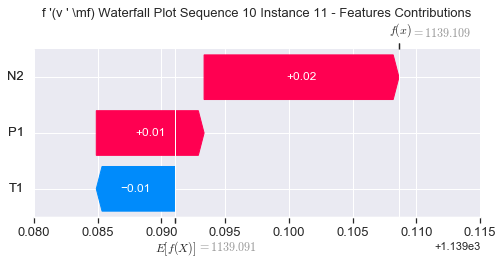

None

Contribution: [ 0.00489013 -0.0174598   0.01475775]


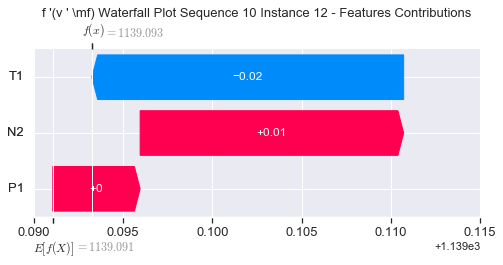

None

Contribution: [ 0.00402567 -0.01936253  0.01287036]


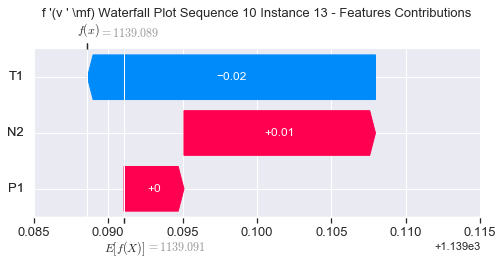

None

Contribution: [ 0.00253639 -0.01788303  0.00616978]


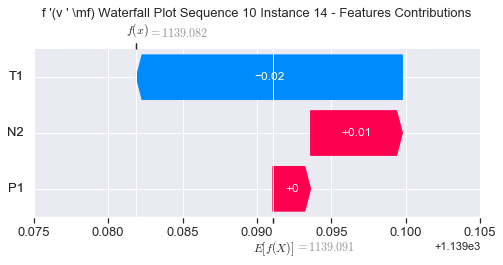

None

Contribution: [-0.00286233 -0.03945249 -0.00961147]


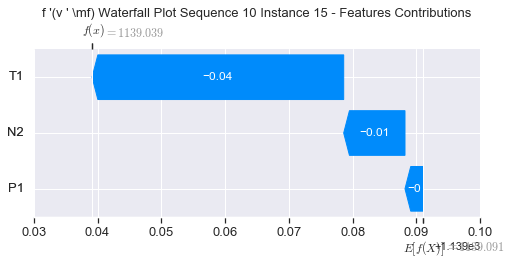

None

Contribution: [-0.01862644 -0.10283426 -0.03528946]


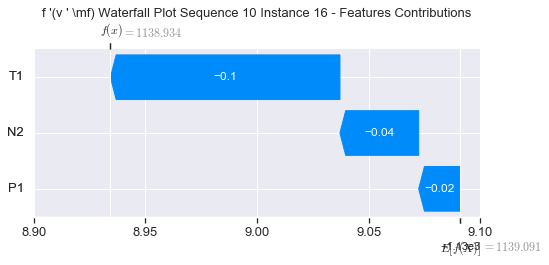

None

Contribution: [-0.01938836 -0.1259475  -0.06037069]


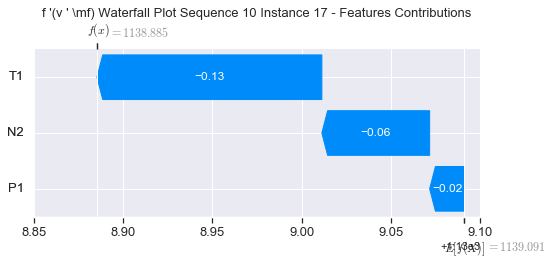

None

Contribution: [-0.01301426 -0.23895314 -0.04218051]


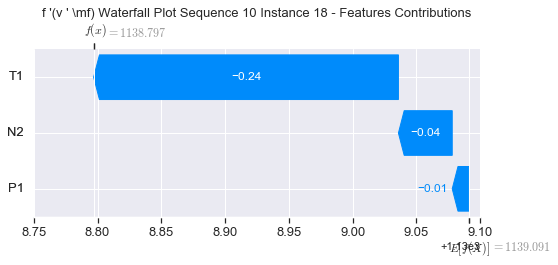

None

Contribution: [ 0.00767383 -0.68404872  0.12748625]


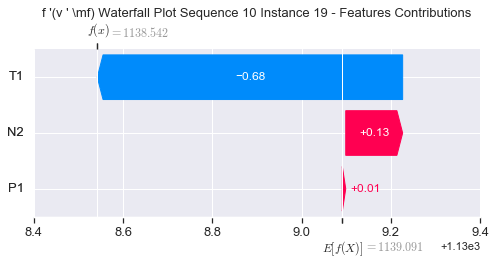

None

Contribution: [ 0.15997004 -0.95711973  0.55500441]


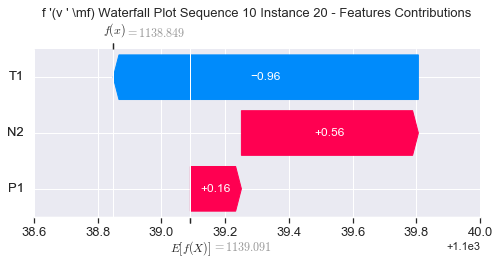

None

Contribution: [ 0.4519284  -1.89353454  1.47707049]


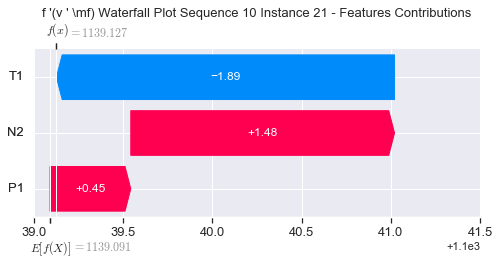

None

Contribution: [ 0.91653932 -3.80681872  2.88339609]


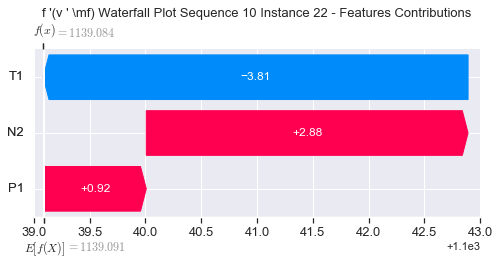

None

Contribution: [ 1.31347379 -8.31658281  4.24739746]


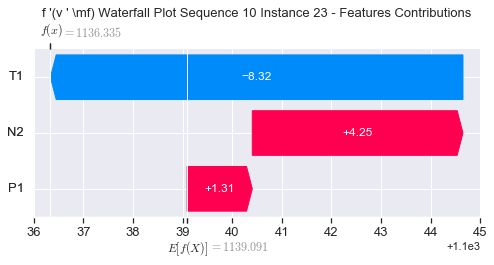

None

Contribution: [  1.19726202 -11.0316565    3.76312652]


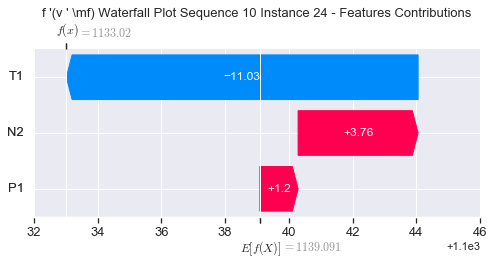

None

Contribution: [  0.95201922 -11.34458517   4.82064034]


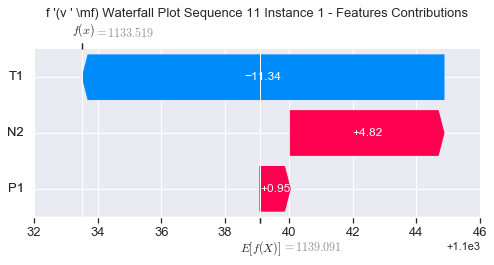

None

Contribution: [-0.25527359  1.37940441 -0.66102824]


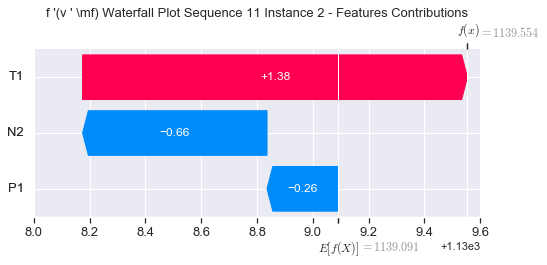

None

Contribution: [ 0.00105176 -0.01369843  0.00474654]


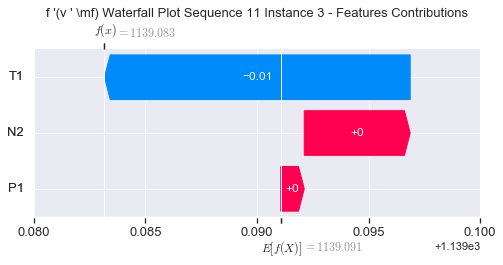

None

Contribution: [ 0.00404822 -0.01109034  0.00884249]


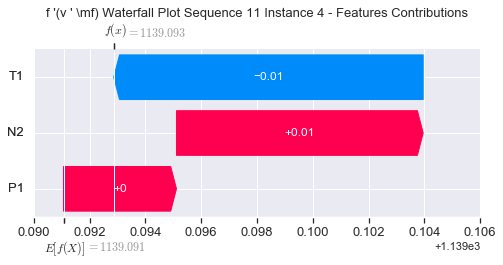

None

Contribution: [ 0.0043546  -0.0080302   0.01058238]


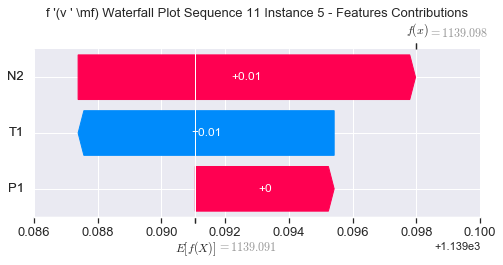

None

Contribution: [ 0.00524026 -0.00670837  0.01181998]


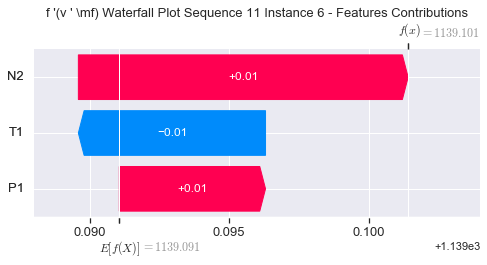

None

Contribution: [ 0.00512871 -0.0061757   0.01265842]


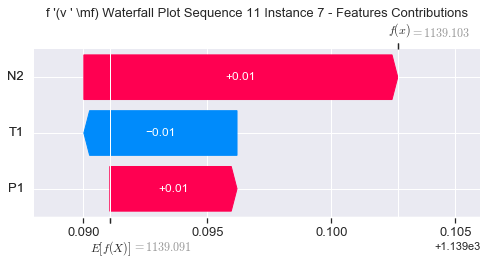

None

Contribution: [ 0.00539275 -0.00607909  0.01297673]


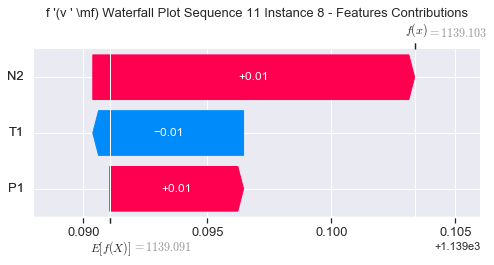

None

Contribution: [ 0.00370454 -0.00518569  0.01298748]


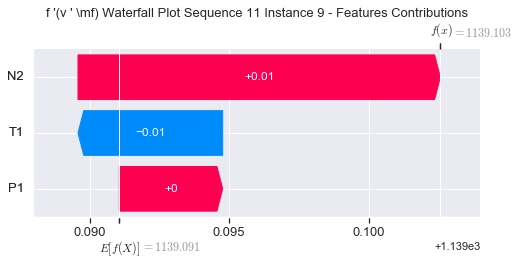

None

Contribution: [ 0.00317902 -0.00499401  0.01365336]


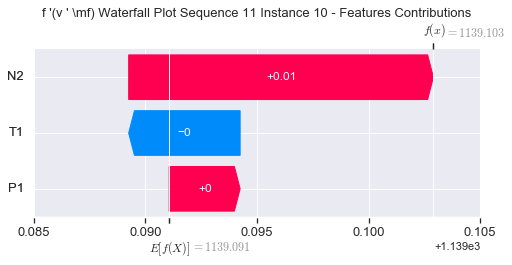

None

Contribution: [ 0.00569648 -0.005342    0.01408189]


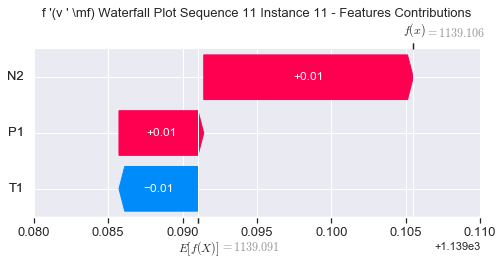

None

Contribution: [ 0.00613642 -0.00660693  0.01394416]


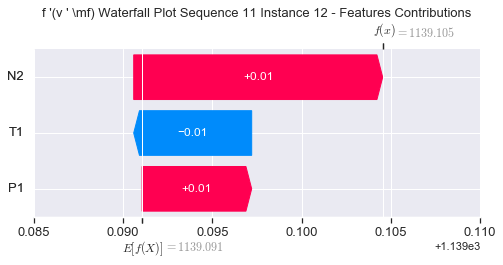

None

Contribution: [ 0.00551444 -0.00622397  0.01234722]


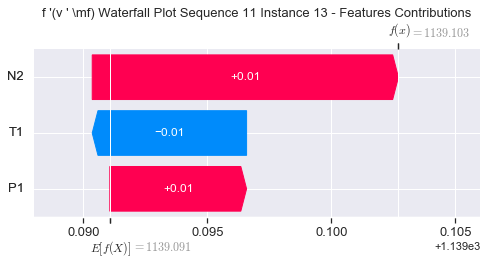

None

Contribution: [ 0.00394055 -0.00720888  0.00685473]


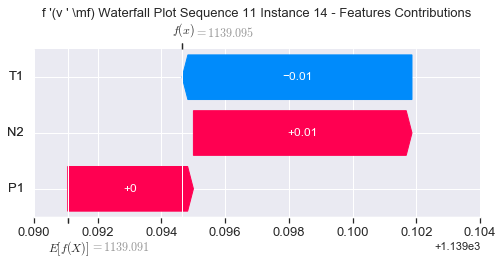

None

Contribution: [ 0.0003361  -0.01249538 -0.00627755]


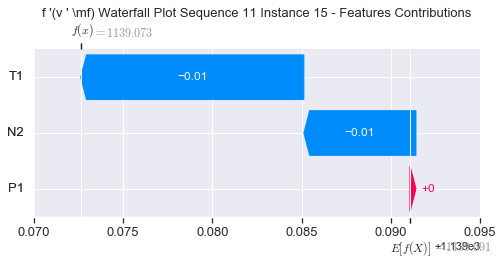

None

Contribution: [-0.00111365 -0.02403973 -0.0266173 ]


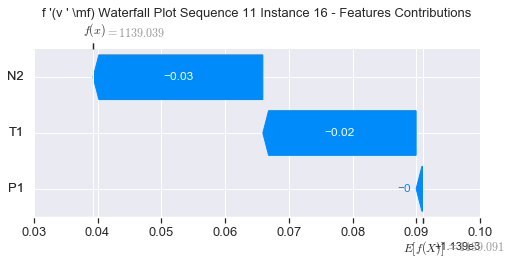

None

Contribution: [-0.01029724 -0.02877902 -0.04753929]


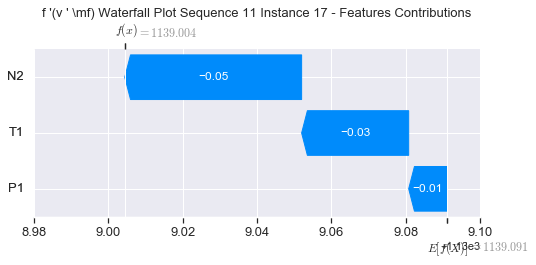

None

Contribution: [ 0.00019114 -0.03559047 -0.03056509]


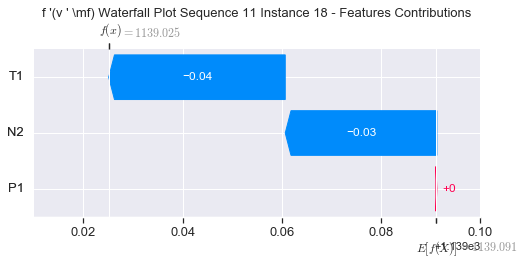

None

Contribution: [ 0.06618226 -0.02581035  0.11442645]


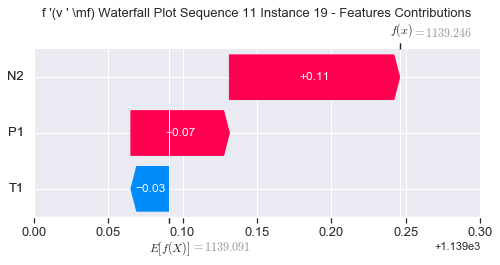

None

Contribution: [ 0.19220523 -0.00207896  0.51430812]


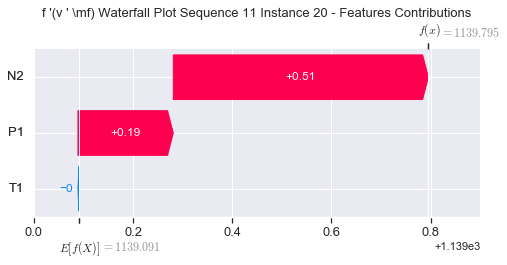

None

Contribution: [ 0.50756112 -0.04081433  1.36989147]


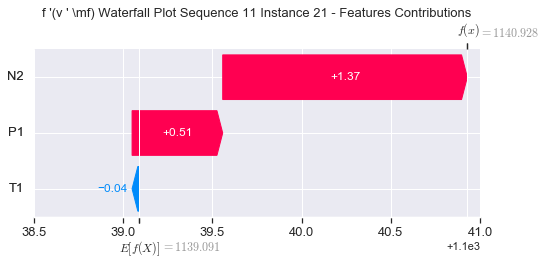

None

Contribution: [ 1.02598373 -0.42035911  2.69118664]


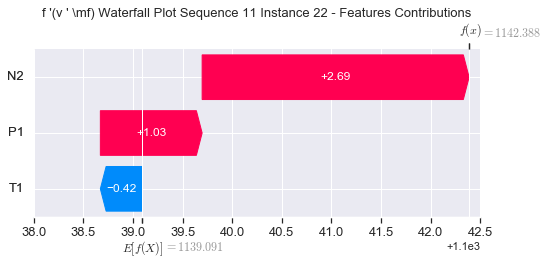

None

Contribution: [ 1.55766749 -1.55171219  3.95240356]


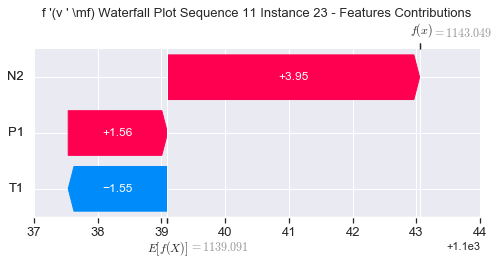

None

Contribution: [ 1.75921516 -3.42724263  3.61202716]


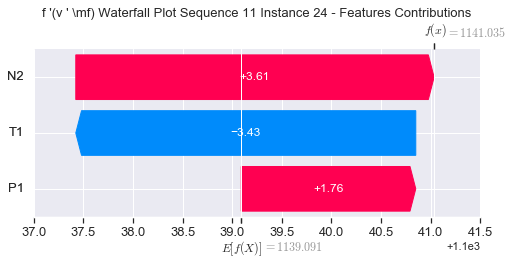

None

Contribution: [ 2.39323032 -4.18546759  4.97309771]


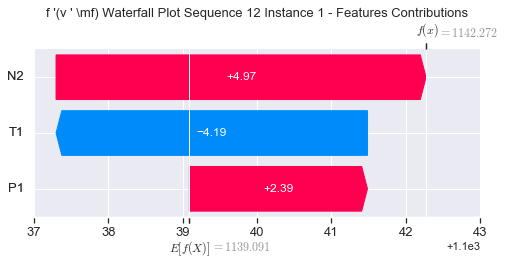

None

Contribution: [-0.31582664  0.4455793  -0.62569744]


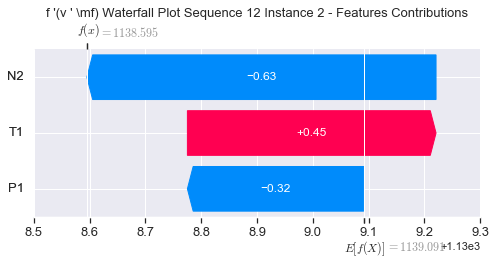

None

Contribution: [ 0.0017387  -0.00778371  0.00465735]


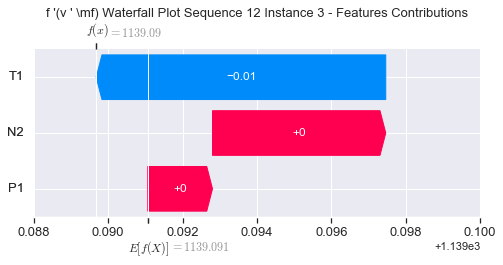

None

Contribution: [ 0.00383271 -0.00647758  0.00861659]


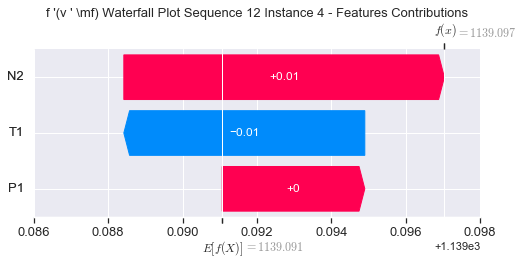

None

Contribution: [ 0.00421205 -0.00389307  0.01050123]


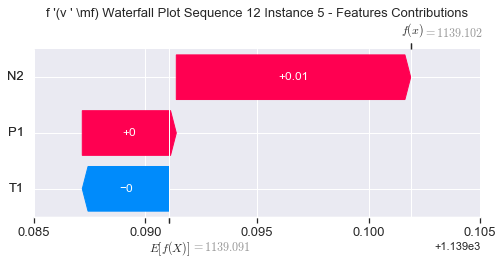

None

Contribution: [ 0.00469596 -0.00472461  0.01178433]


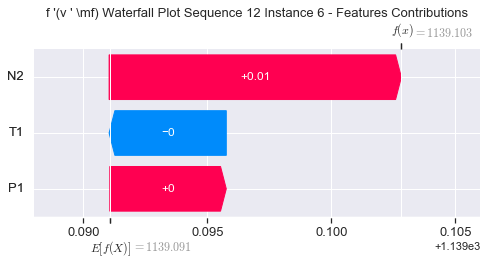

None

Contribution: [ 0.00498497 -0.00505497  0.01268342]


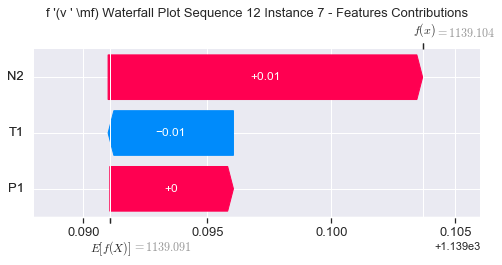

None

Contribution: [ 0.00508801 -0.00481121  0.01301627]


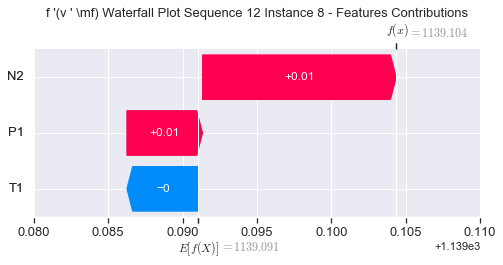

None

Contribution: [ 0.00466191 -0.00499384  0.01316154]


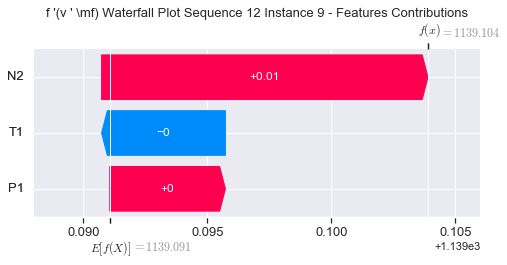

None

Contribution: [ 0.0057155  -0.00449147  0.01407004]


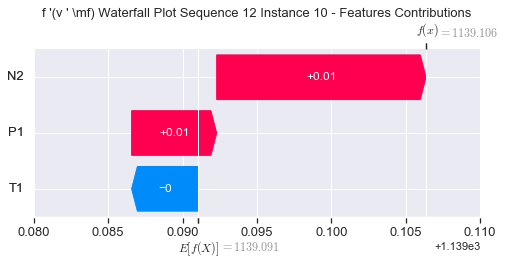

None

Contribution: [ 0.00484264 -0.00417514  0.01390275]


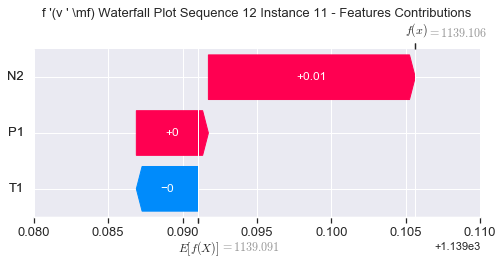

None

Contribution: [ 0.00505001 -0.0073674   0.01367446]


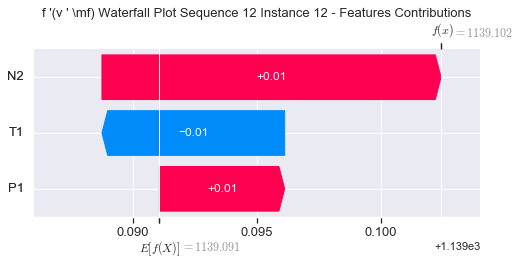

None

Contribution: [ 0.00476098 -0.00736633  0.01211654]


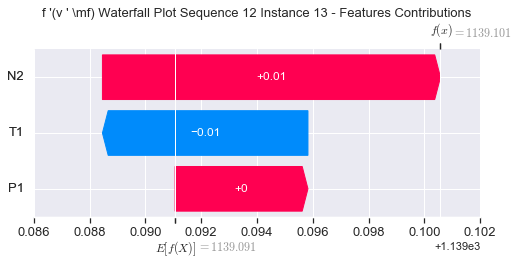

None

Contribution: [ 0.00361665 -0.01127527  0.00661351]


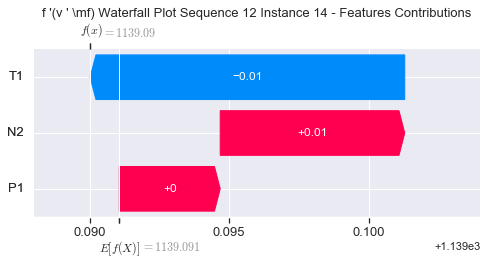

None

Contribution: [-0.00065314 -0.0149112  -0.0061056 ]


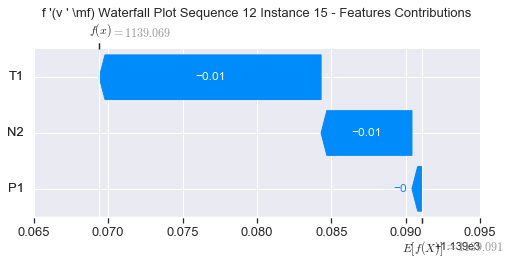

None

Contribution: [-0.00645356 -0.0282089  -0.02554541]


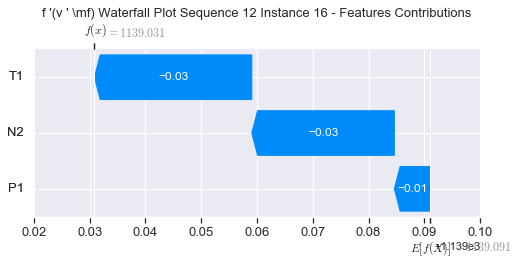

None

Contribution: [-0.01051173 -0.04031802 -0.04443951]


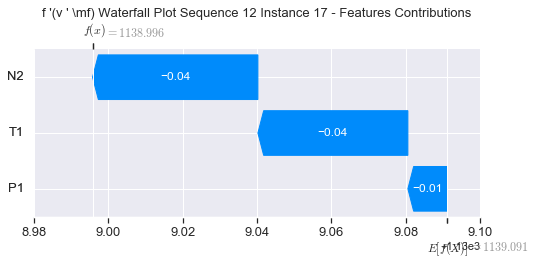

None

Contribution: [-0.00122772 -0.0621619  -0.02391607]


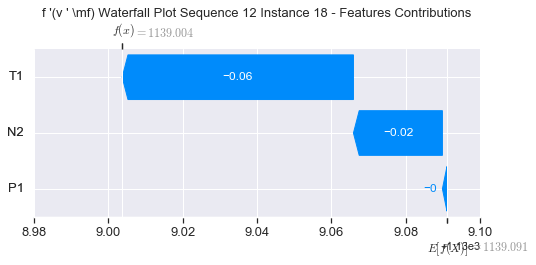

None

Contribution: [ 0.03342734 -0.1182297   0.1194087 ]


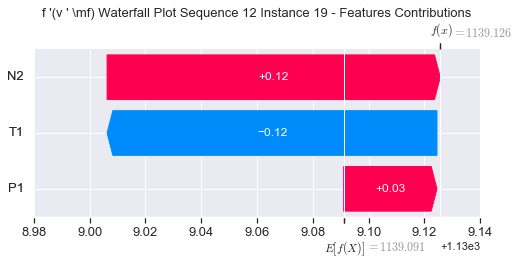

None

Contribution: [ 0.20018352 -0.14320276  0.54186226]


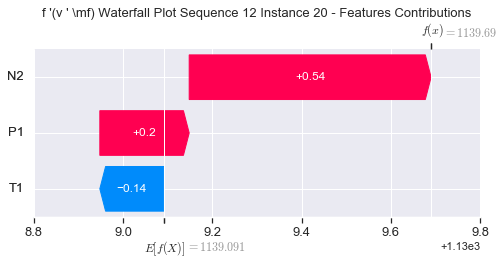

None

Contribution: [ 0.50853318 -0.34648435  1.41462871]


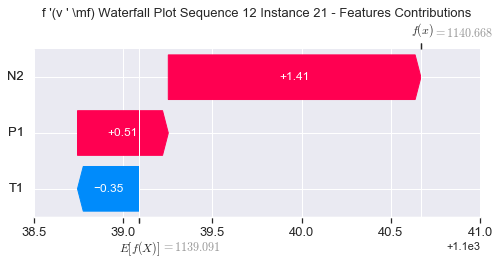

None

Contribution: [ 0.97412444 -0.99627653  2.7671466 ]


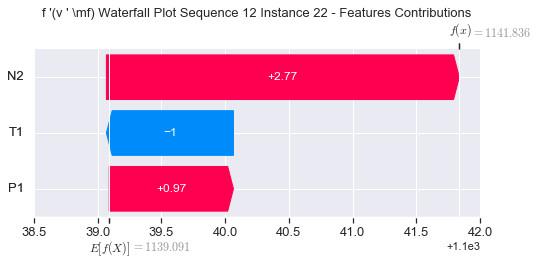

None

Contribution: [ 1.36685483 -2.90551505  4.10308211]


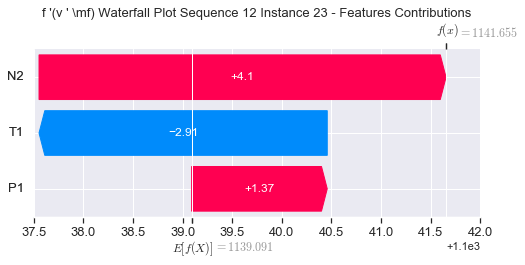

None

Contribution: [ 1.48702983 -4.65154924  3.90444954]


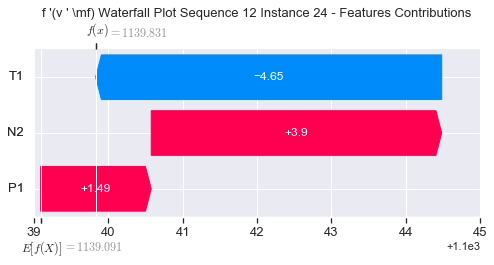

None

Contribution: [ 1.87639284 -4.90620357  5.4633548 ]


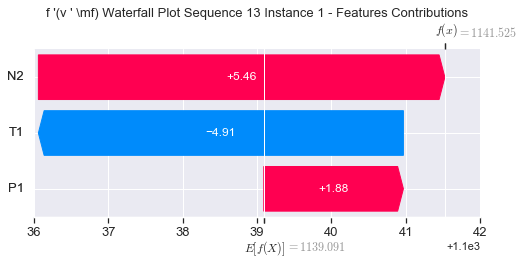

None

Contribution: [-0.27211839  0.70230485 -0.64267404]


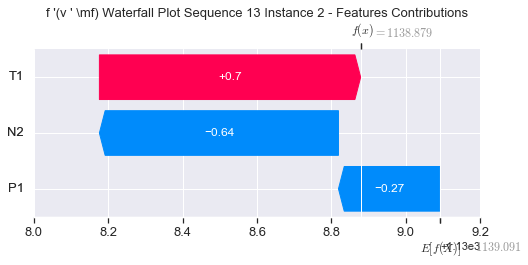

None

Contribution: [ 0.00083161 -0.00827319  0.00486237]


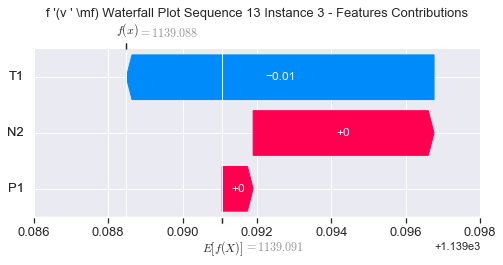

None

Contribution: [ 0.00224394 -0.00627892  0.0089095 ]


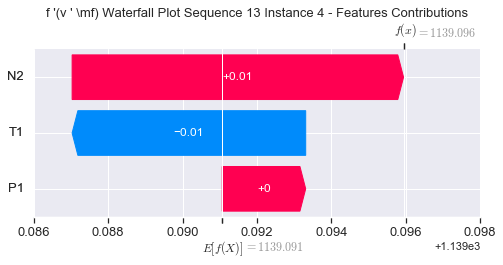

None

Contribution: [ 0.00311152 -0.00610417  0.01052248]


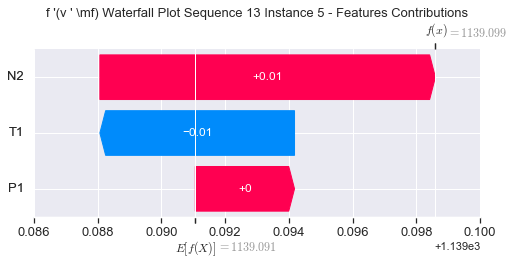

None

Contribution: [ 0.00354065 -0.00546727  0.01169915]


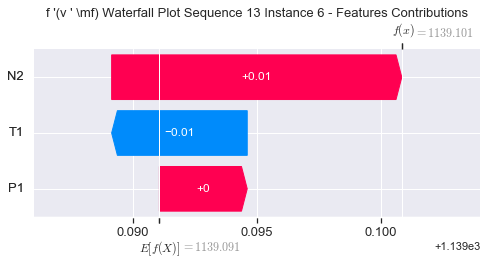

None

Contribution: [ 0.00382841 -0.00535572  0.0126368 ]


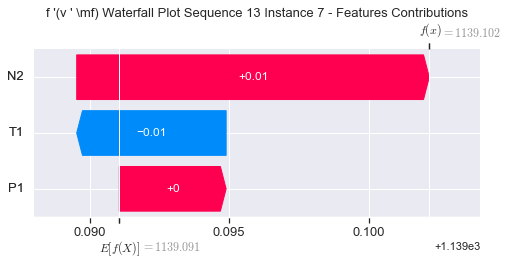

None

Contribution: [ 0.00399957 -0.00503703  0.01301629]


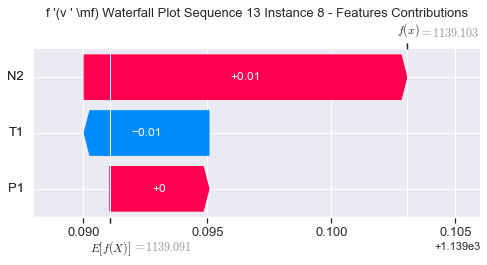

None

Contribution: [ 0.00409626 -0.00475174  0.01342409]


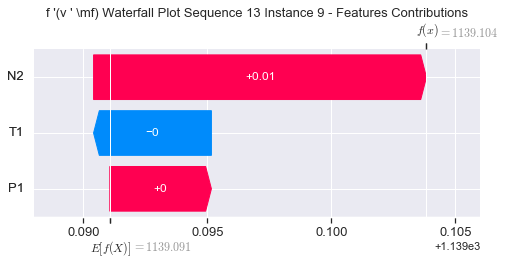

None

Contribution: [ 0.00339785 -0.00872916  0.01362334]


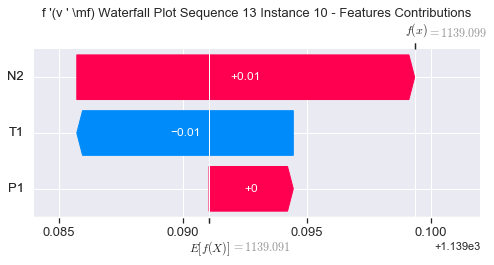

None

Contribution: [ 0.00440657 -0.00337008  0.01421146]


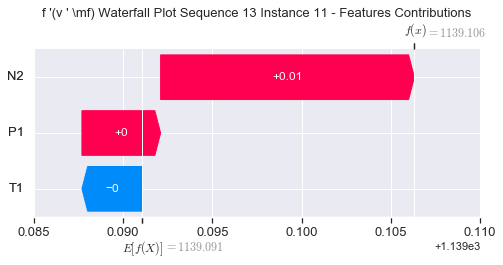

None

Contribution: [ 0.00424188 -0.00429783  0.01392865]


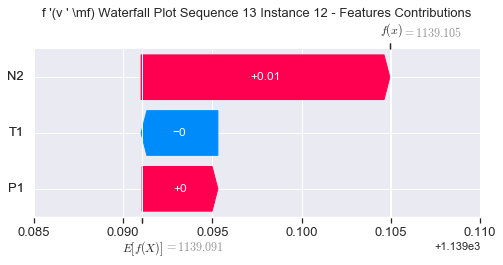

None

Contribution: [ 0.00380067 -0.00430608  0.01238018]


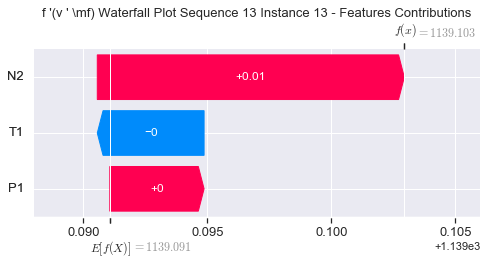

None

Contribution: [ 0.00247383 -0.00432842  0.00714766]


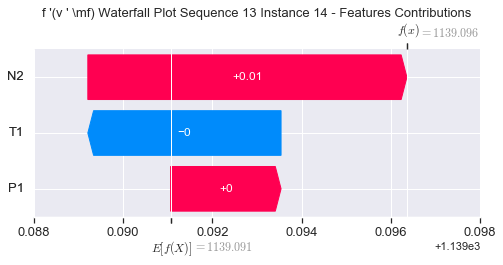

None

Contribution: [-0.00206492 -0.00980197 -0.00539485]


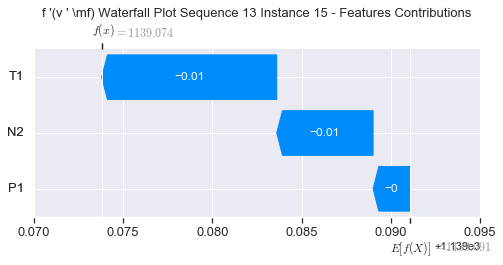

None

Contribution: [-0.00964433 -0.01773992 -0.02465039]


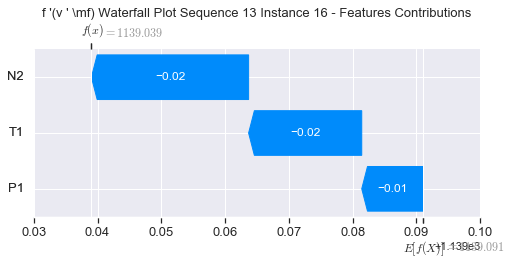

None

Contribution: [-0.01450284 -0.02480079 -0.04275273]


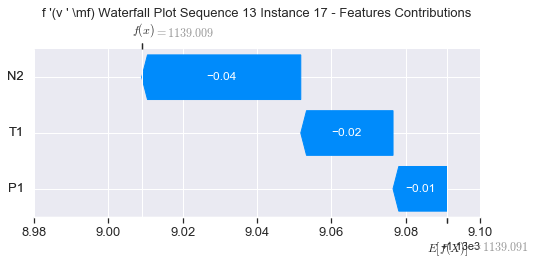

None

Contribution: [-0.01056164 -0.02950848 -0.02255126]


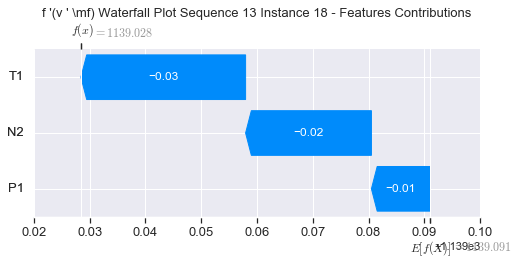

None

Contribution: [ 0.00818317 -0.04906175  0.12176799]


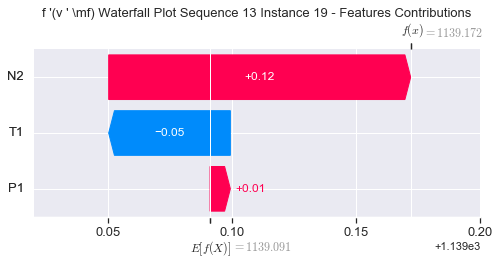

None

Contribution: [ 0.14373838 -0.00654206  0.53461599]


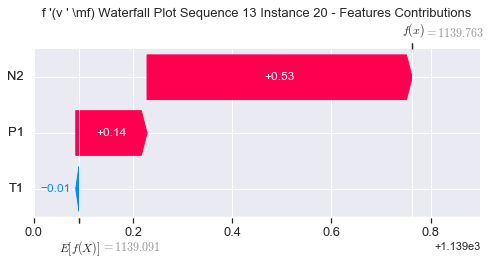

None

Contribution: [ 0.39172656 -0.0096388   1.40472026]


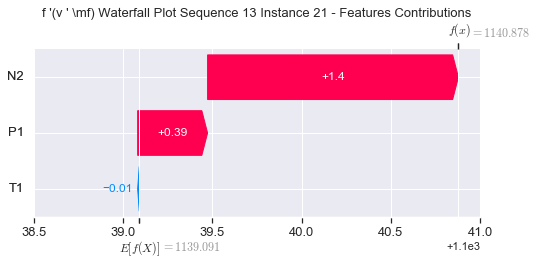

None

Contribution: [ 0.7364537  -0.25853518  2.76306957]


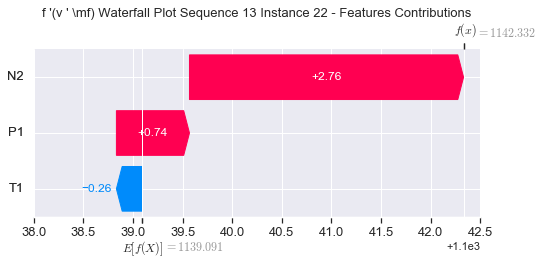

None

Contribution: [ 0.89699313 -1.33101514  4.09817026]


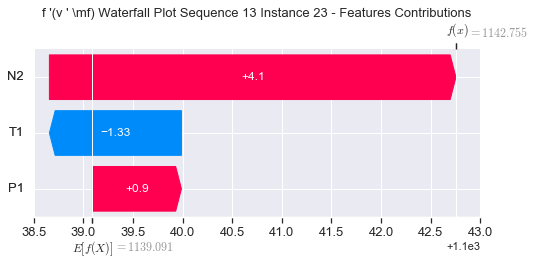

None

Contribution: [ 0.86469387 -2.94025373  3.84882359]


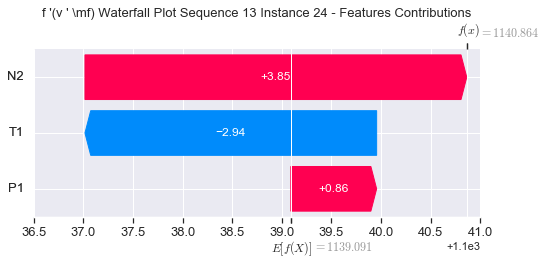

None

Contribution: [ 1.43801074 -2.49503515  5.37587828]


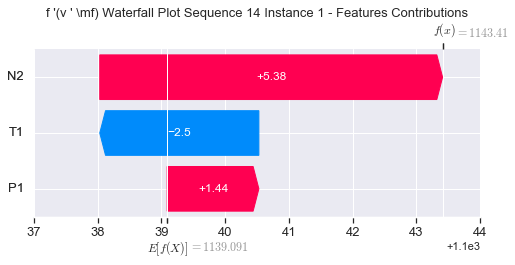

None

Contribution: [-0.19449297  0.31301604 -0.66793976]


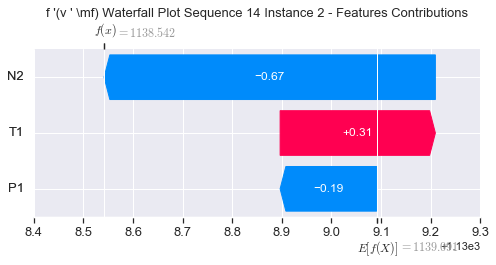

None

Contribution: [ 0.00064107 -0.00304433  0.00533092]


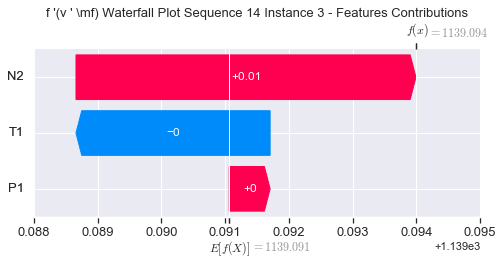

None

Contribution: [ 0.00332089 -0.00134507  0.00946697]


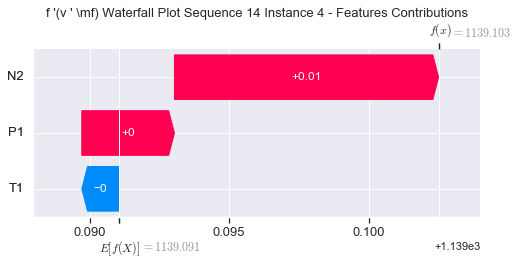

None

Contribution: [0.00347057 0.00057802 0.01050344]


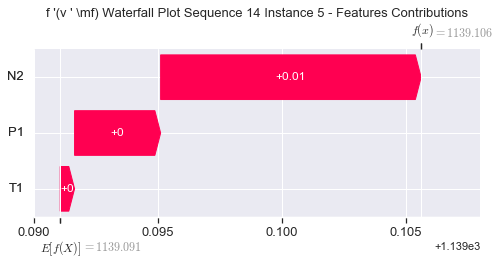

None

Contribution: [ 0.00363442 -0.00035775  0.01164494]


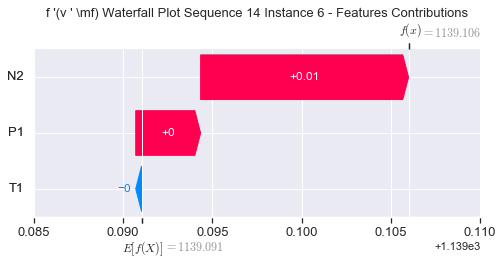

None

Contribution: [ 0.00396642 -0.00034297  0.01258117]


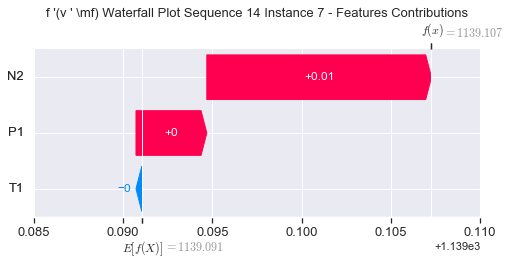

None

Contribution: [ 0.00408176 -0.00023279  0.01293306]


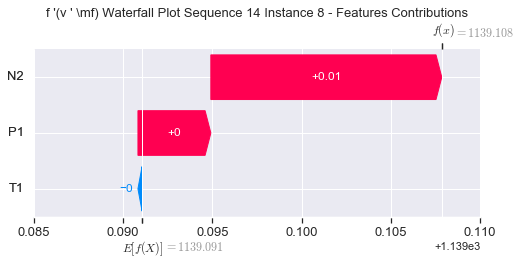

None

Contribution: [0.00409486 0.00163341 0.01332195]


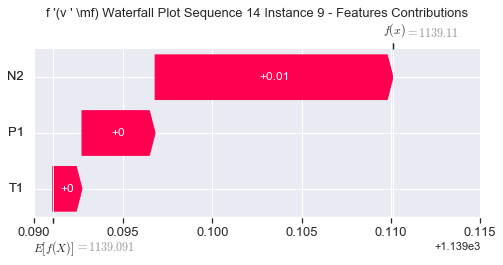

None

Contribution: [0.00389117 0.00159274 0.01379768]


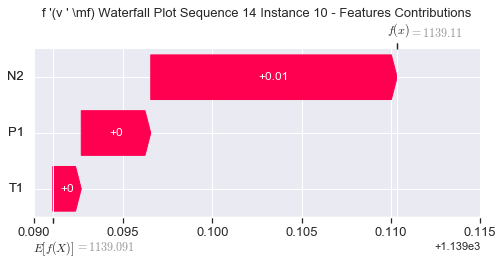

None

Contribution: [0.00405616 0.00153252 0.01398725]


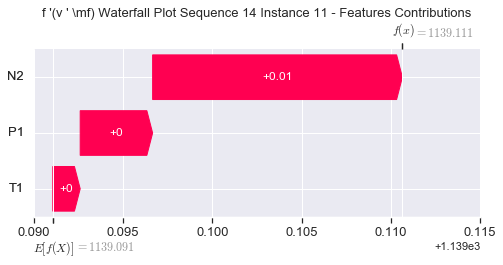

None

Contribution: [ 0.00407913 -0.00208523  0.0136895 ]


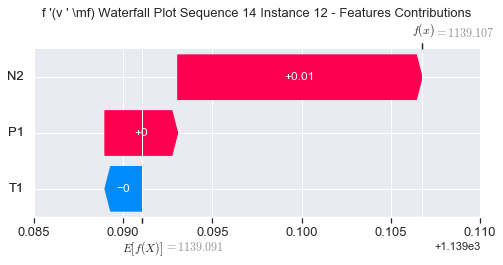

None

Contribution: [ 0.00373851 -0.00177928  0.01218048]


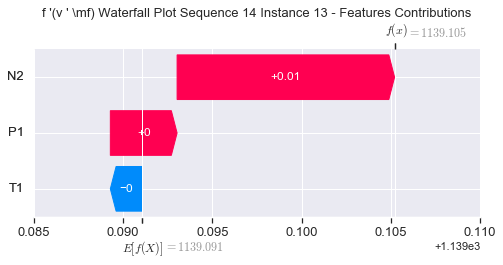

None

Contribution: [ 0.00214882 -0.00331114  0.00661986]


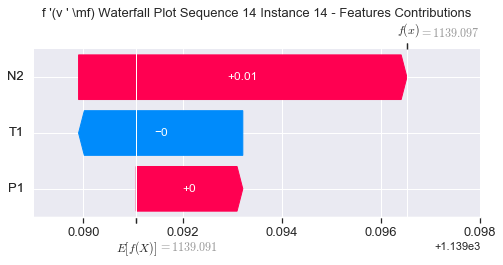

None

Contribution: [-0.0019451  -0.00747943 -0.00534088]


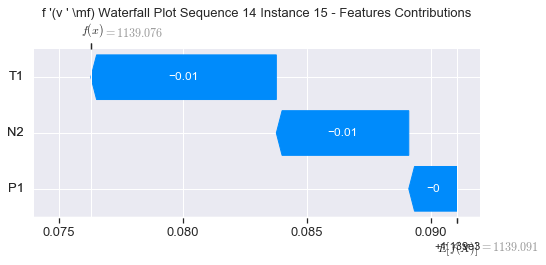

None

Contribution: [-0.00949241 -0.01863462 -0.02412332]


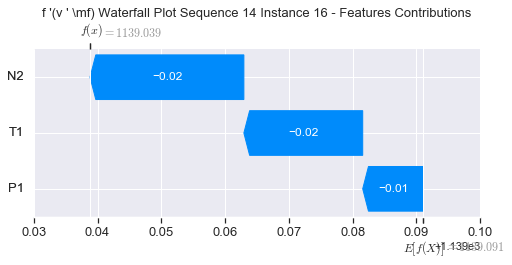

None

Contribution: [-0.01408885 -0.02129591 -0.04204505]


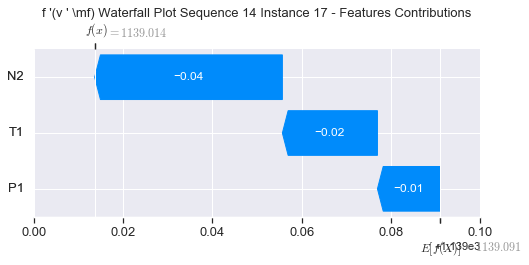

None

Contribution: [-0.01000038 -0.0267385  -0.0216888 ]


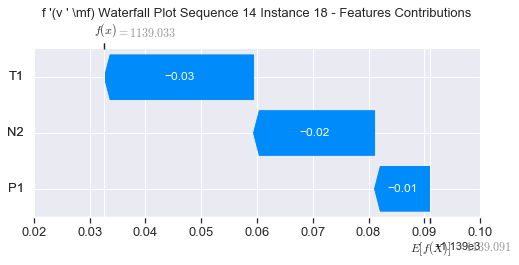

None

Contribution: [ 0.02755082 -0.05190289  0.12716608]


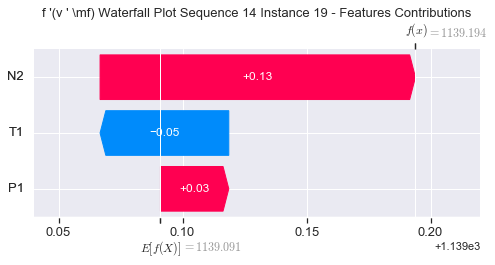

None

Contribution: [0.1508532  0.00359508 0.53479221]


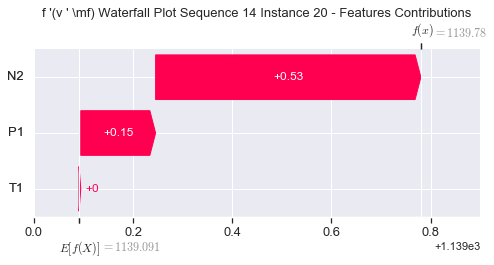

None

Contribution: [ 0.40227778 -0.03124238  1.39876952]


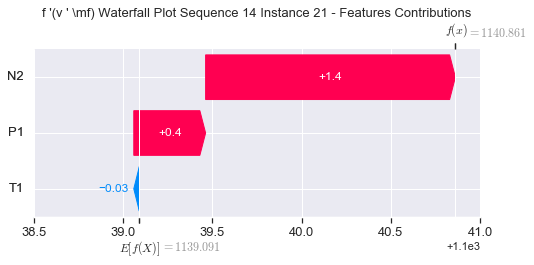

None

Contribution: [ 0.76074381 -0.39166133  2.74614531]


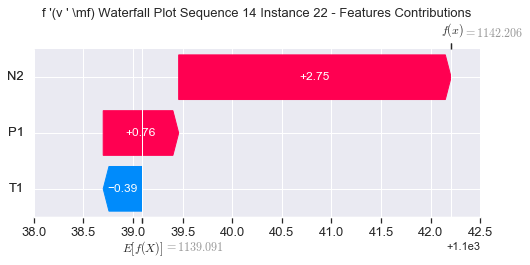

None

Contribution: [ 0.91644609 -1.83009248  4.06534949]


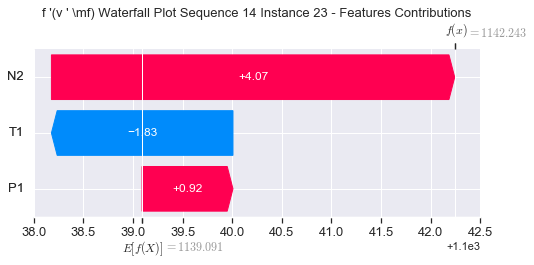

None

Contribution: [ 0.89012843 -3.55302735  3.76387168]


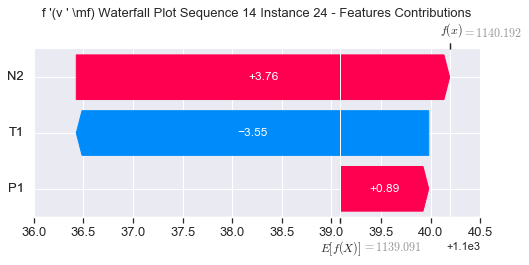

None

Contribution: [ 1.3152301  -3.60187599  5.04284962]


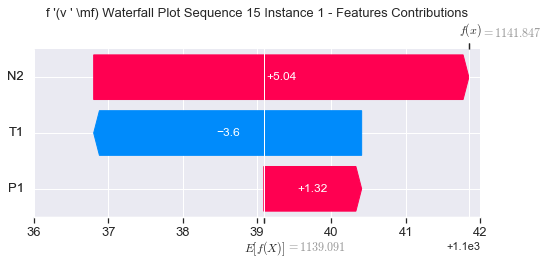

None

Contribution: [-0.20206779  0.48116405 -0.65541946]


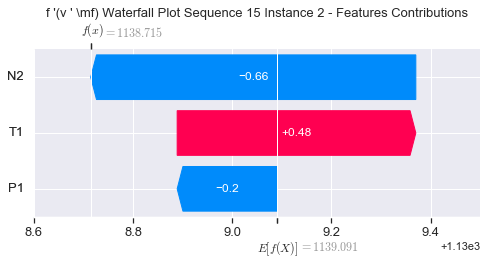

None

Contribution: [ 0.00095523 -0.00633598  0.00508159]


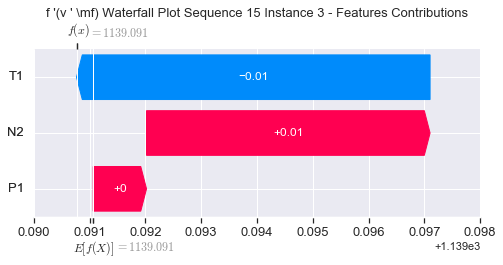

None

Contribution: [ 0.00186845 -0.00709479  0.00892187]


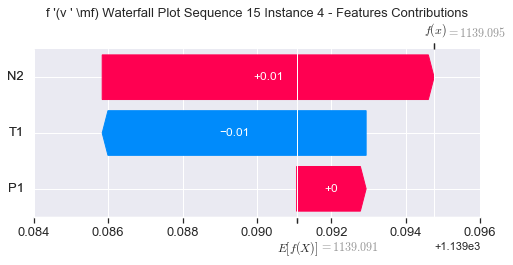

None

Contribution: [ 0.00327251 -0.00309351  0.01064336]


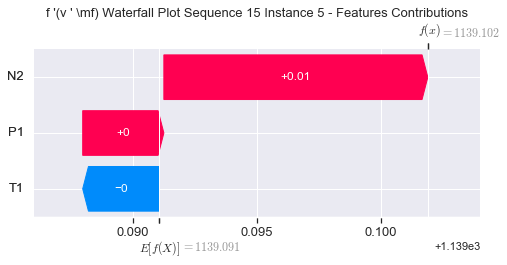

None

Contribution: [ 0.00386608 -0.00370374  0.01194256]


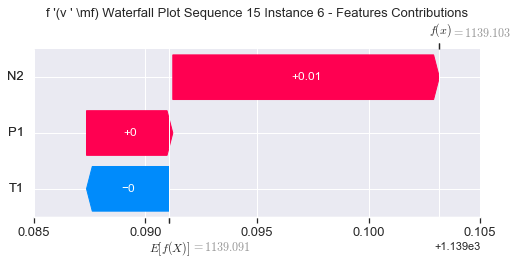

None

Contribution: [ 0.00414548 -0.00316076  0.01288359]


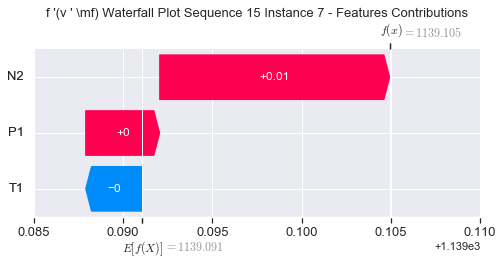

None

Contribution: [ 0.00414153 -0.00314939  0.01316332]


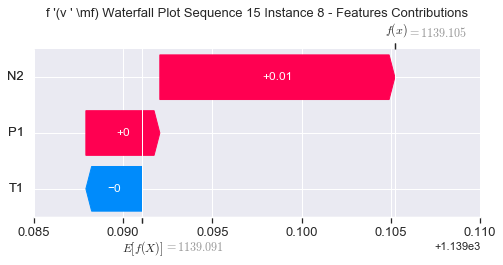

None

Contribution: [ 0.00346162 -0.00191043  0.01341992]


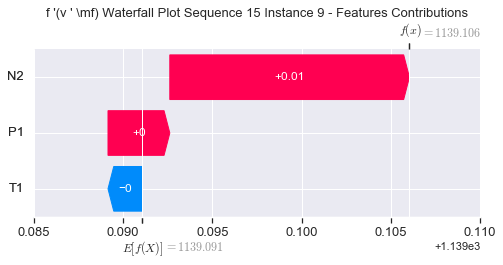

None

Contribution: [ 0.00382761 -0.00191149  0.0139459 ]


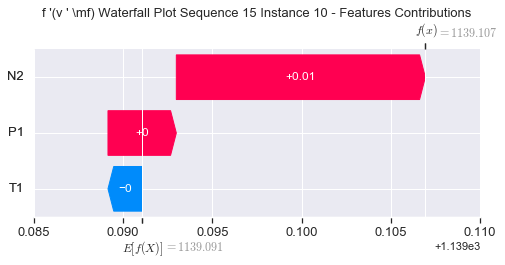

None

Contribution: [ 0.00343386 -0.0023985   0.01391988]


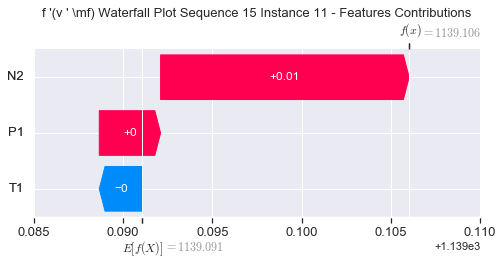

None

Contribution: [ 0.00401811 -0.0030467   0.01377791]


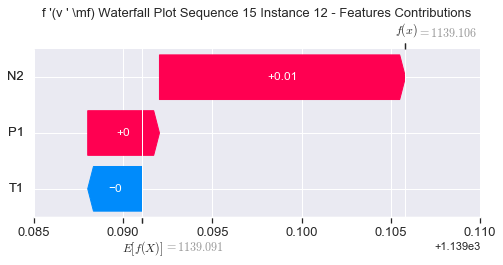

None

Contribution: [ 0.00366107 -0.00268783  0.01228574]


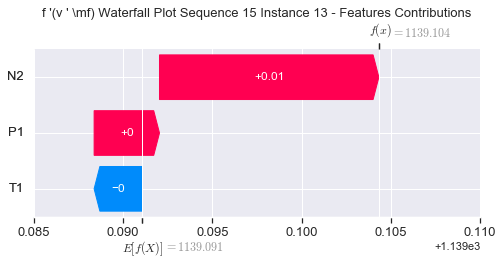

None

Contribution: [ 0.00279387 -0.0064177   0.00725947]


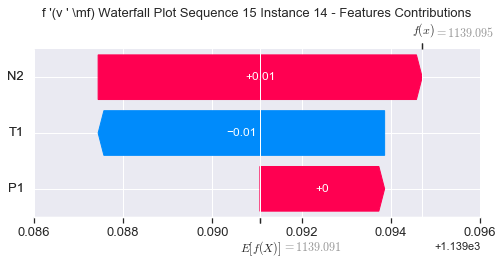

None

Contribution: [-0.00206292 -0.00854091 -0.00521737]


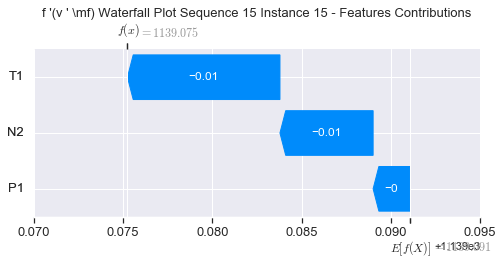

None

Contribution: [-0.0088004  -0.0132516  -0.02401591]


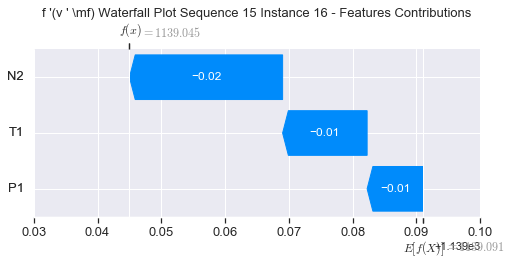

None

Contribution: [-0.01415383 -0.0215932  -0.04189329]


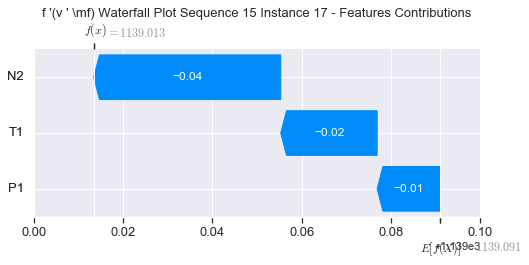

None

Contribution: [-0.00971365 -0.02646294 -0.02132867]


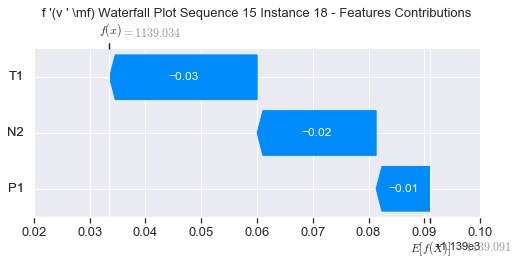

None

Contribution: [ 0.02798709 -0.01132764  0.12239599]


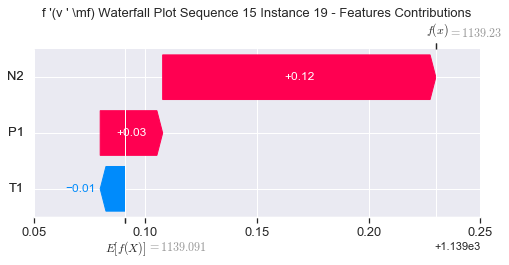

None

Contribution: [0.14822505 0.01727254 0.53762959]


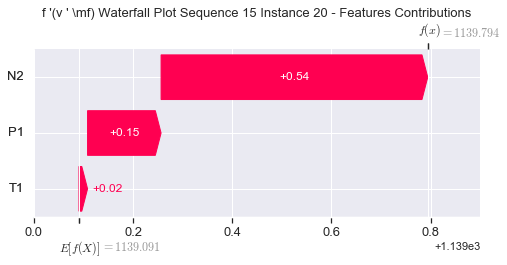

None

Contribution: [0.38987131 0.0183927  1.40335901]


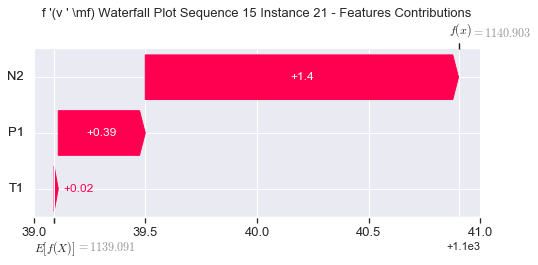

None

Contribution: [ 0.71238645 -0.26569858  2.74512937]


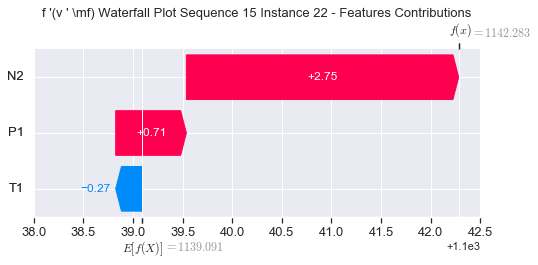

None

Contribution: [ 0.87002523 -1.53169436  4.06919581]


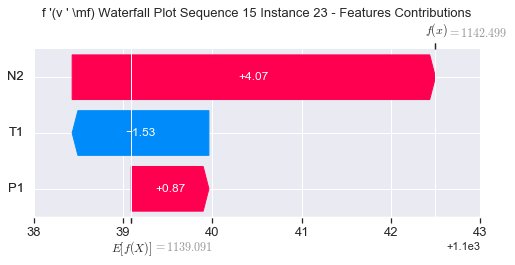

None

Contribution: [ 0.93071506 -3.33197593  3.85338596]


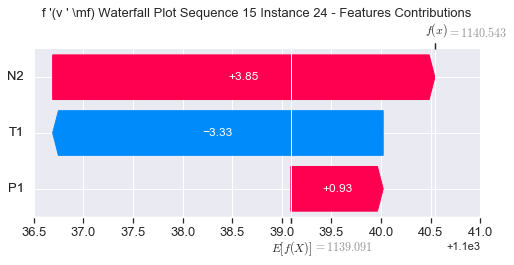

None

Contribution: [ 1.72486496 -3.2913013   5.44983591]


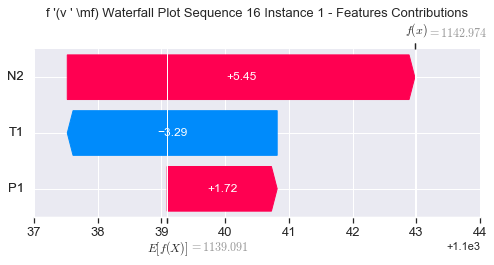

None

Contribution: [-0.15742438  0.3314591  -0.64229304]


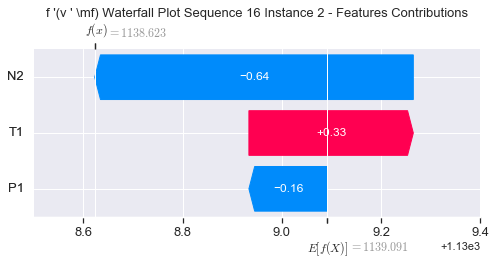

None

Contribution: [ 0.00041798 -0.00490865  0.00524142]


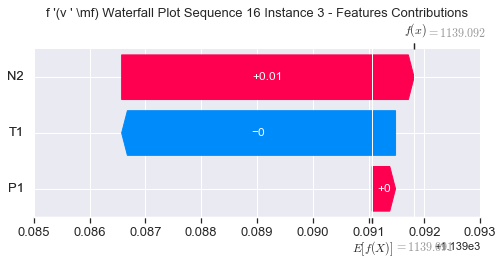

None

Contribution: [ 0.00281047 -0.00344989  0.0091128 ]


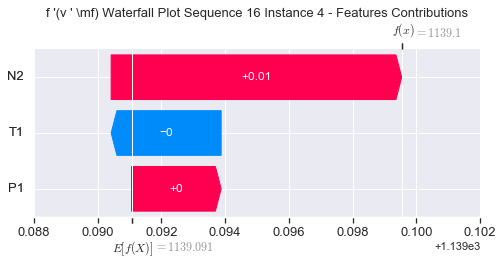

None

Contribution: [ 0.0036198  -0.00394583  0.0106886 ]


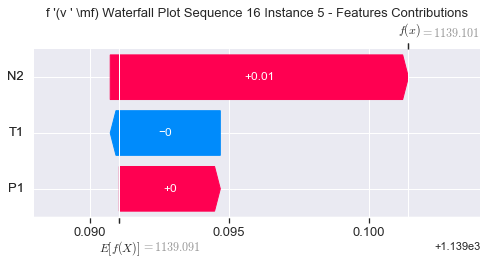

None

Contribution: [ 0.00403132 -0.00432767  0.01196663]


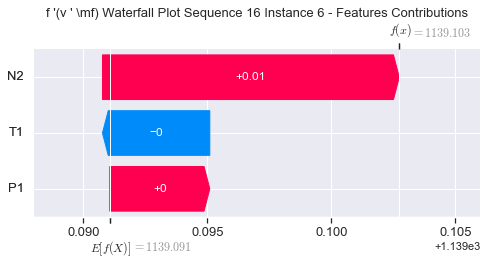

None

Contribution: [ 0.00422622 -0.00384214  0.01291322]


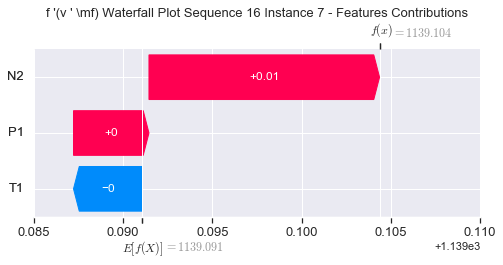

None

Contribution: [ 0.00429485 -0.00428846  0.01320515]


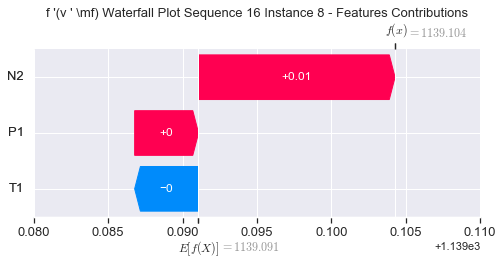

None

Contribution: [ 0.00375212 -0.00516454  0.01352174]


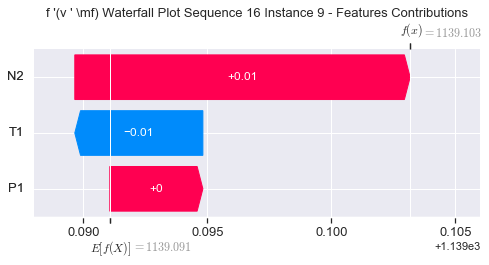

None

Contribution: [ 0.00357664 -0.00282712  0.0139749 ]


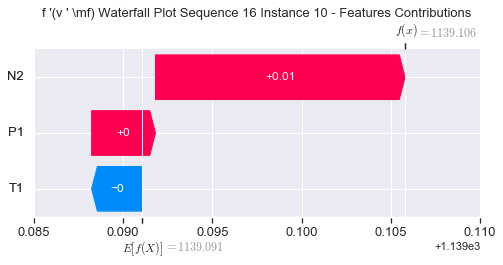

None

Contribution: [ 0.00406946 -0.00644822  0.01421779]


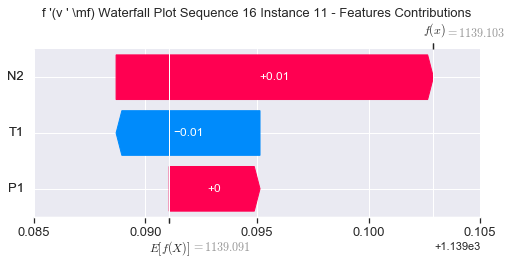

None

Contribution: [ 0.004089   -0.00518289  0.01403557]


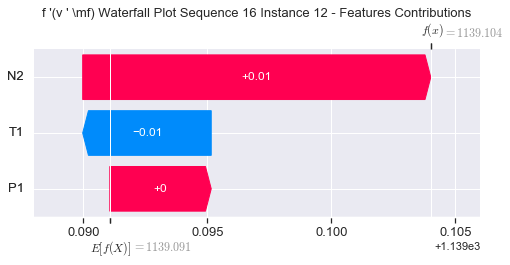

None

Contribution: [ 0.00364393 -0.00478334  0.01244535]


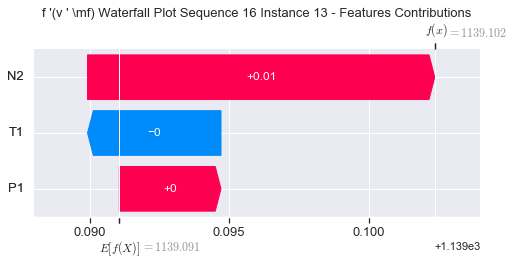

None

Contribution: [ 0.00158291 -0.00708449  0.00674038]


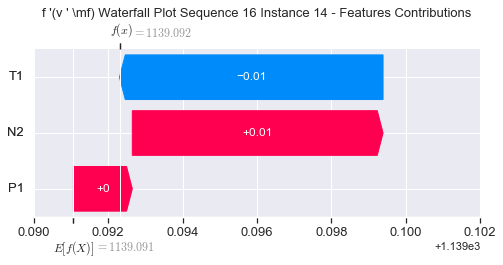

None

Contribution: [-0.00216773 -0.01166814 -0.00559061]


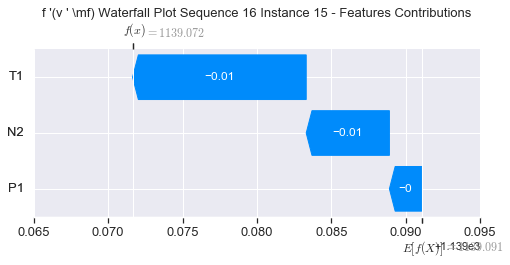

None

Contribution: [-0.01082547 -0.02292917 -0.02570297]


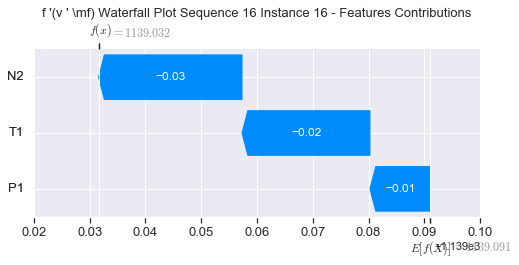

None

Contribution: [-0.01504303 -0.02953106 -0.04318594]


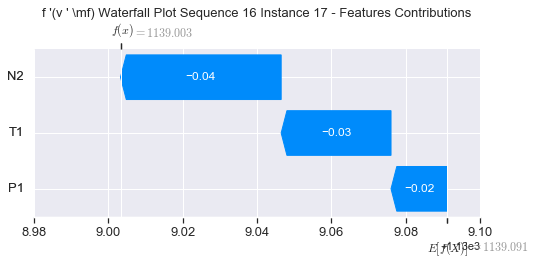

None

Contribution: [-0.01114658 -0.04256134 -0.02285103]


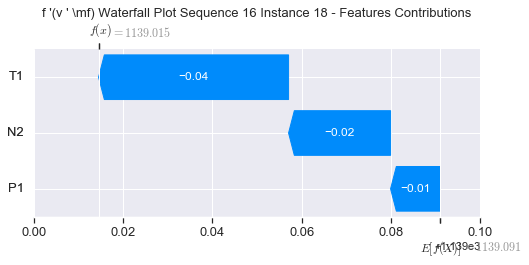

None

Contribution: [ 0.02720609 -0.07086294  0.12147379]


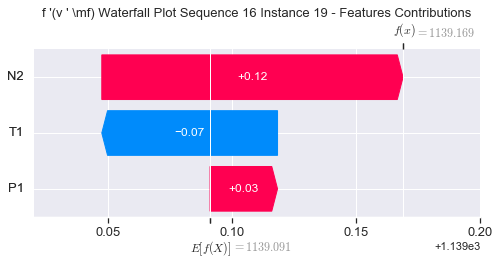

None

Contribution: [ 0.14455073 -0.06234747  0.53333343]


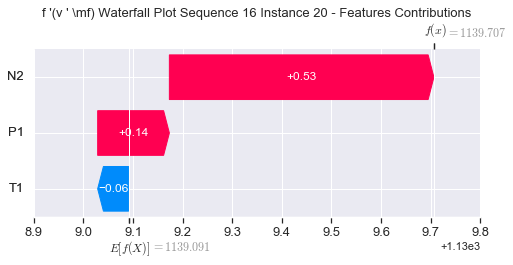

None

Contribution: [ 0.3852513  -0.17920136  1.39589599]


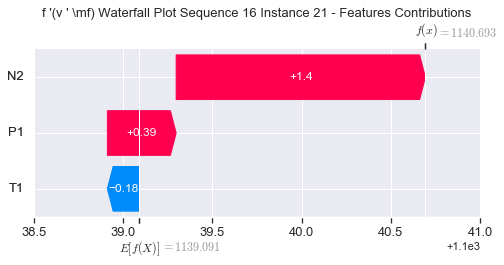

None

Contribution: [ 0.7240863  -0.74405208  2.72660818]


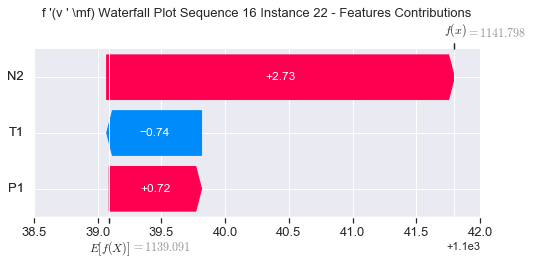

None

Contribution: [ 0.86259433 -2.44174839  4.00990032]


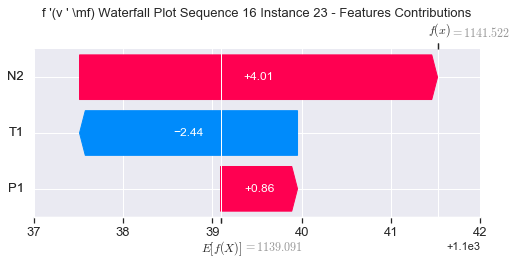

None

Contribution: [ 0.93409577 -4.20691266  3.74226816]


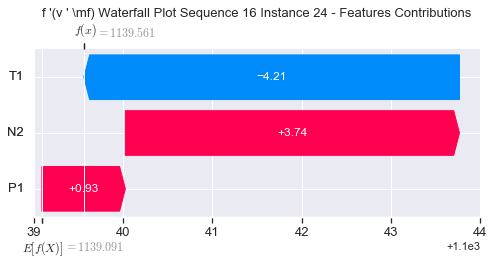

None

Contribution: [ 1.63233552 -3.62910056  5.38451453]


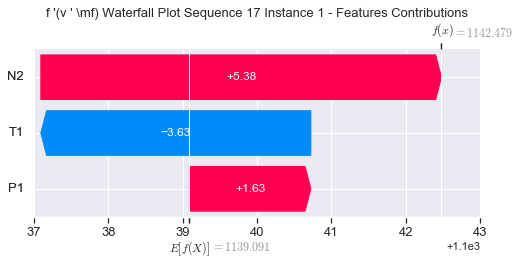

None

Contribution: [-0.16199287  0.56796822 -0.63680655]


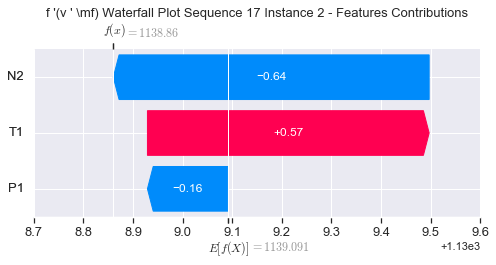

None

Contribution: [ 0.0014291  -0.00800759  0.00529894]


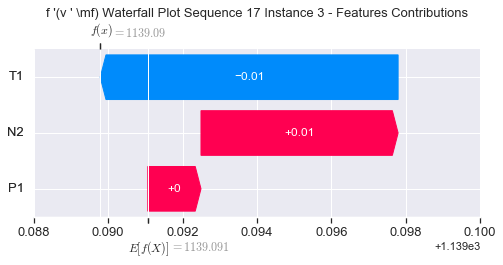

None

Contribution: [ 0.00367366 -0.00768061  0.00958838]


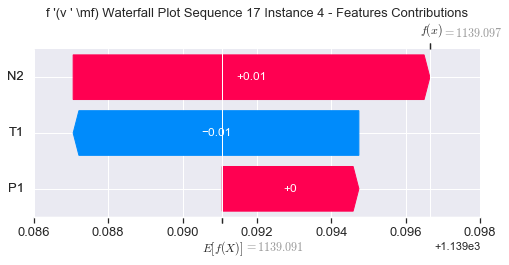

None

Contribution: [ 0.00358462 -0.00715704  0.01053861]


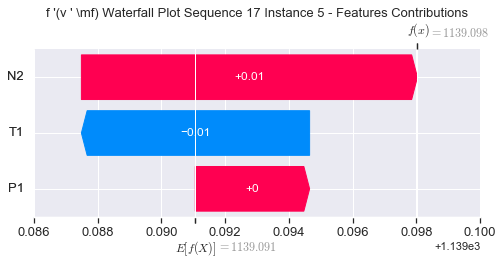

None

Contribution: [ 0.00368377 -0.00695063  0.01169894]


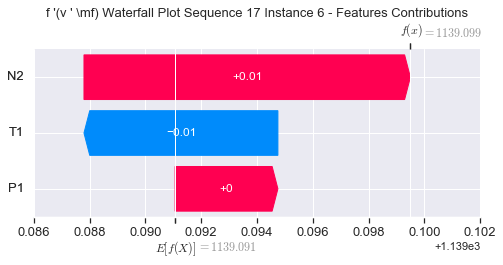

None

Contribution: [ 0.00398471 -0.00682339  0.01265089]


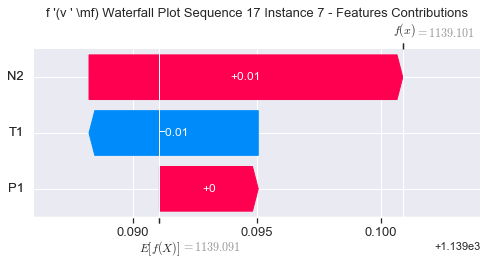

None

Contribution: [ 0.00406166 -0.00672041  0.01297822]


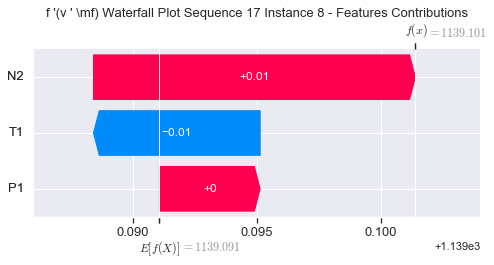

None

Contribution: [ 0.00372611 -0.00681702  0.01314754]


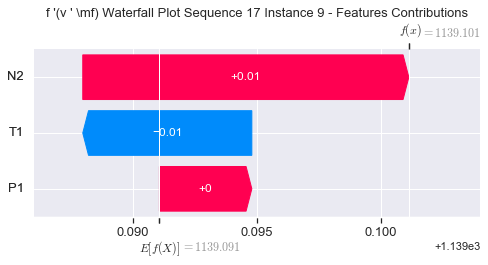

None

Contribution: [ 0.0032926  -0.00509809  0.01416787]


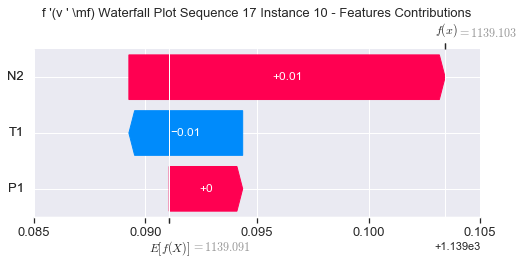

None

Contribution: [ 0.00376069 -0.00619494  0.01387302]


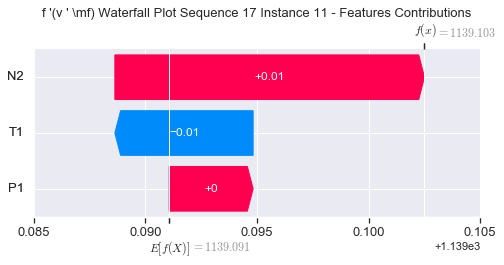

None

Contribution: [ 0.00413148 -0.00754185  0.01388178]


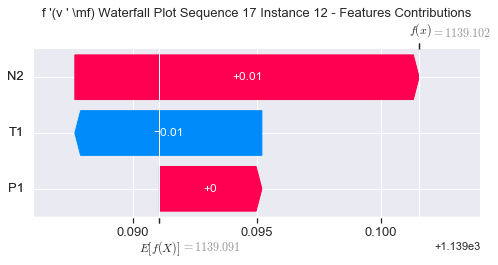

None

Contribution: [ 0.0037238  -0.00759219  0.01228039]


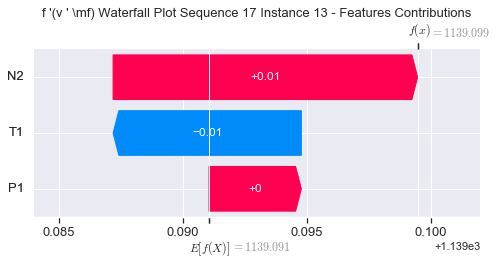

None

Contribution: [ 0.00090962 -0.01141388  0.00649099]


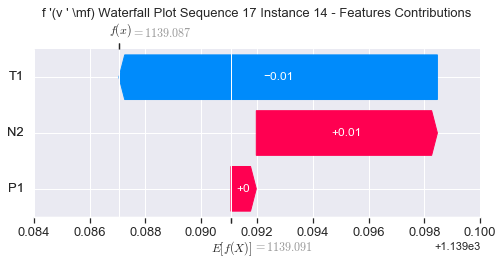

None

Contribution: [-0.00220396 -0.015005   -0.00594965]


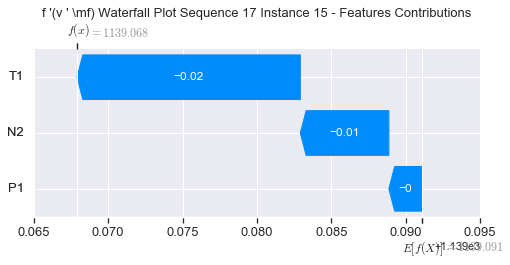

None

Contribution: [-0.00790083 -0.0218889  -0.02497939]


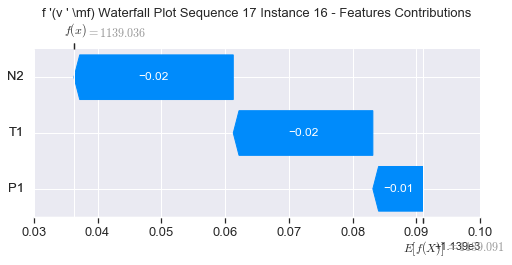

None

Contribution: [-0.01519964 -0.03934453 -0.04403761]


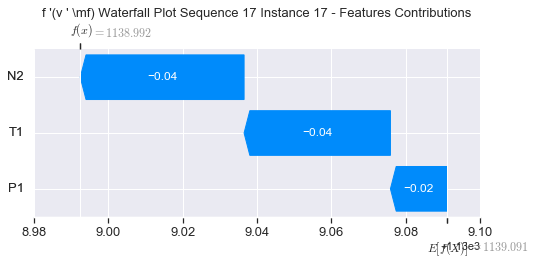

None

Contribution: [-0.01168273 -0.06029226 -0.02334963]


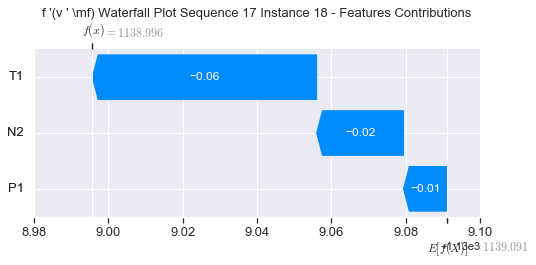

None

Contribution: [ 0.02719961 -0.06243892  0.12545482]


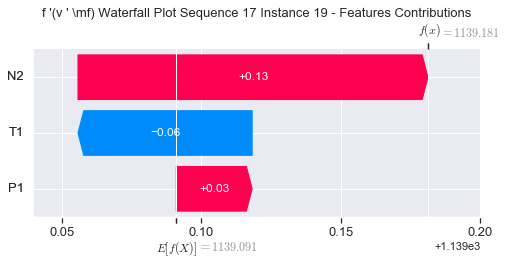

None

Contribution: [ 0.14716853 -0.14997671  0.54303032]


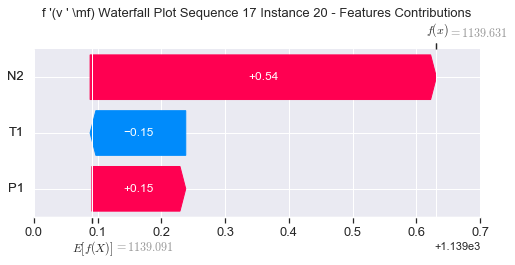

None

Contribution: [ 0.39678861 -0.36023681  1.42050481]


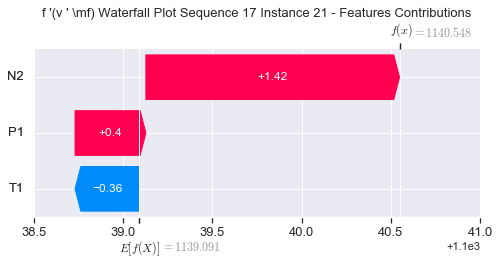

None

Contribution: [ 0.75325632 -1.03991457  2.78454136]


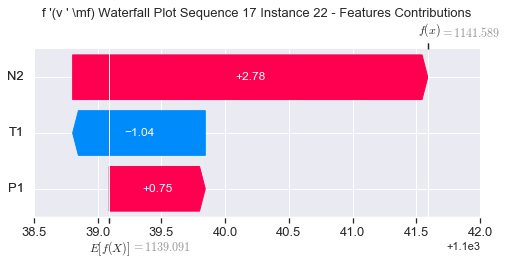

None

Contribution: [ 0.88347545 -2.87186687  4.11024955]


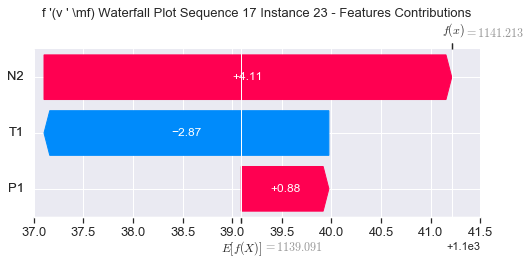

None

Contribution: [ 1.03587153 -4.94768856  3.87520713]


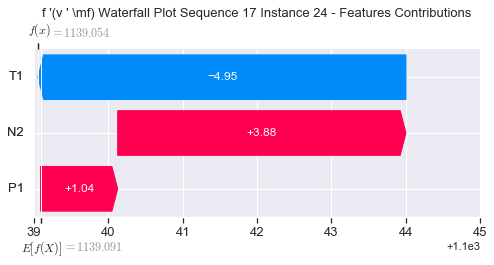

None

Contribution: [ 2.17296964 -5.39989228  5.44647935]


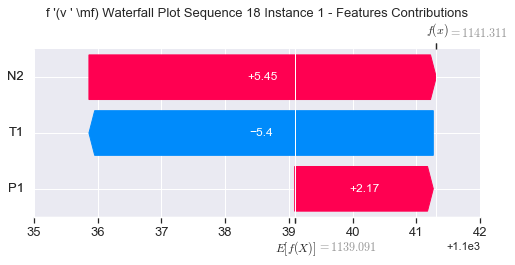

None

Contribution: [-0.20070123  0.65678124 -0.66471884]


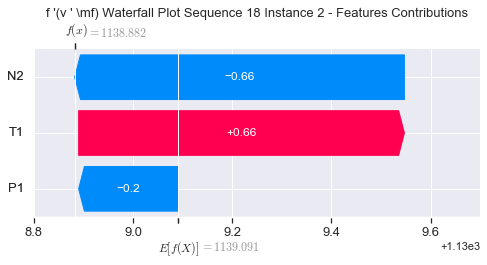

None

Contribution: [ 0.00153954 -0.00828216  0.00538009]


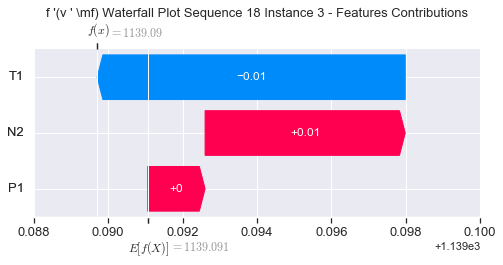

None

Contribution: [ 0.0024212  -0.00986484  0.00912473]


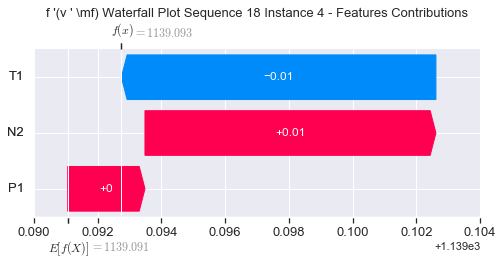

None

Contribution: [ 0.00368375 -0.00640593  0.010785  ]


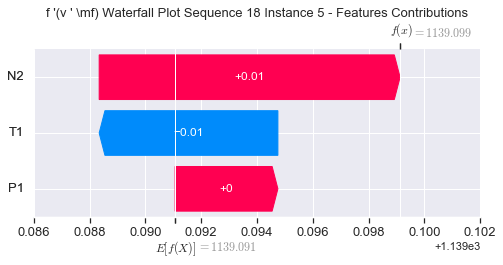

None

Contribution: [ 0.00440773 -0.00552607  0.01217335]


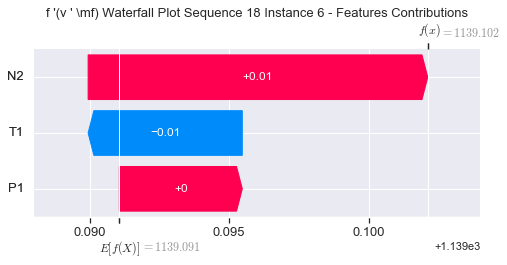

None

Contribution: [ 0.00487868 -0.00514494  0.01314088]


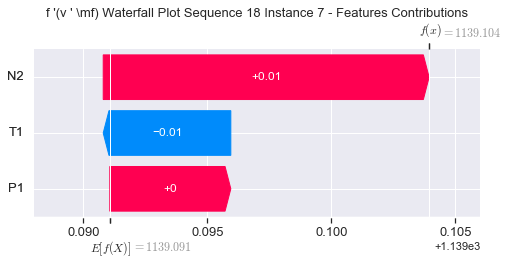

None

Contribution: [ 0.00477631 -0.00511379  0.01338581]


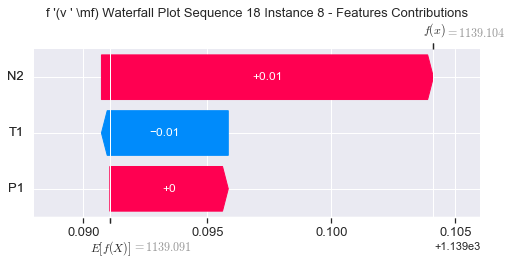

None

Contribution: [ 0.00421447 -0.0039136   0.0135708 ]


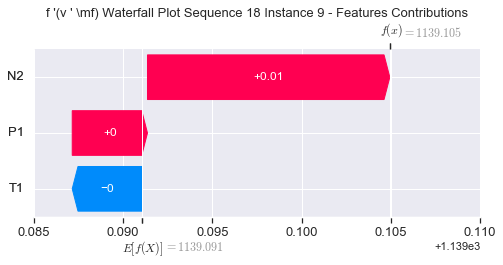

None

Contribution: [ 0.00469488 -0.0042884   0.01393608]


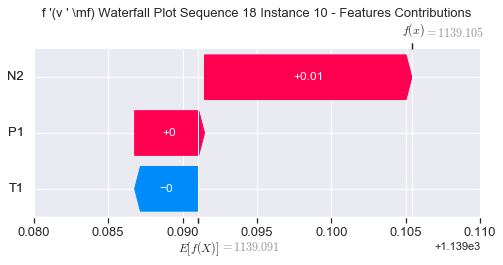

None

Contribution: [ 0.00436587 -0.00367098  0.0142781 ]


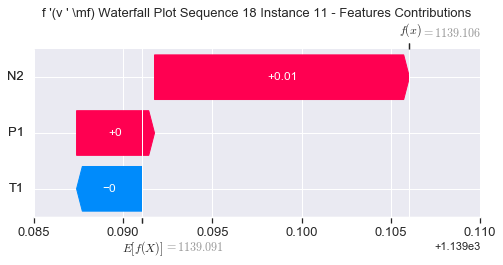

None

Contribution: [ 0.00578763 -0.00480948  0.01436256]


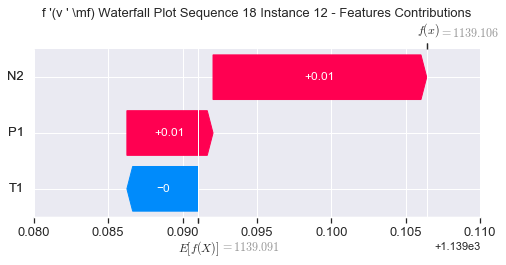

None

Contribution: [ 0.00534762 -0.00477108  0.01280293]


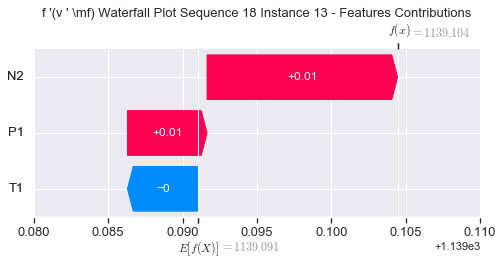

None

Contribution: [ 0.00244212 -0.00497576  0.00702095]


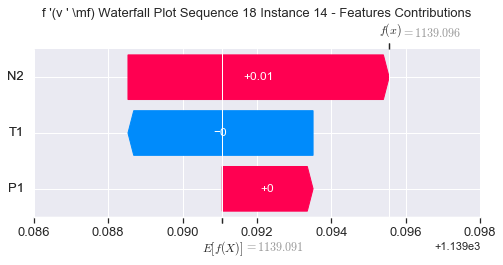

None

Contribution: [-0.00038205 -0.01122745 -0.00497006]


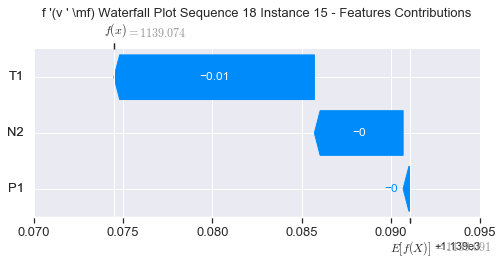

None

Contribution: [-0.00900088 -0.01590062 -0.02506577]


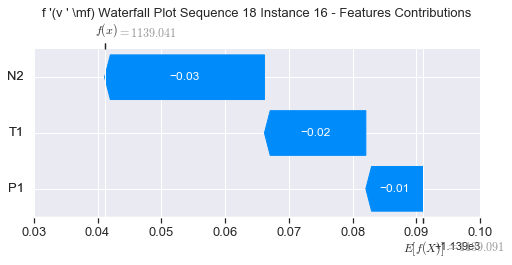

None

Contribution: [-0.01031516 -0.0288769  -0.04172497]


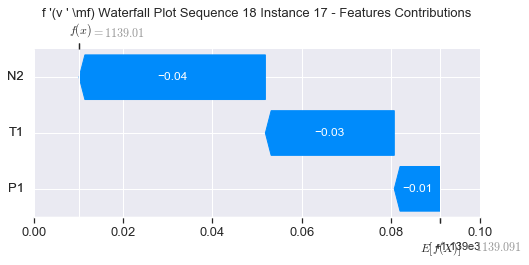

None

Contribution: [-0.0027796  -0.04066574 -0.0203648 ]


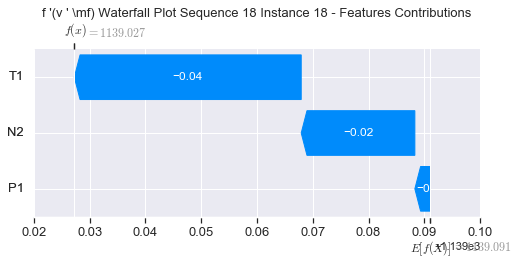

None

Contribution: [ 0.0383612  -0.05658637  0.12729308]


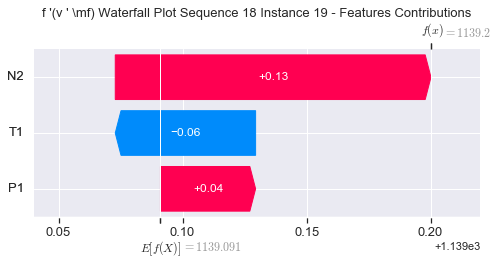

None

Contribution: [ 0.1708805  -0.08201711  0.54438266]


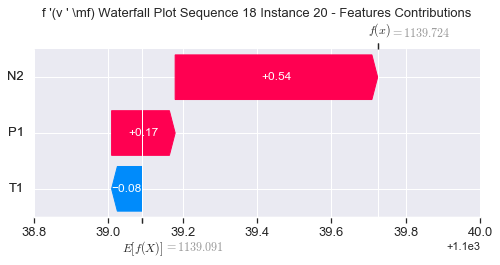

None

Contribution: [ 0.44786527 -0.20866363  1.42143502]


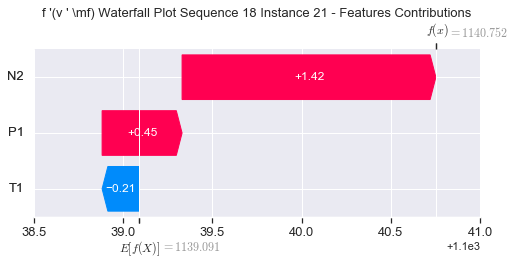

None

Contribution: [ 0.82948703 -0.78164921  2.77729579]


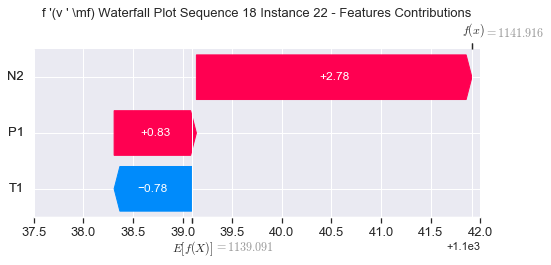

None

Contribution: [ 1.0867416  -2.34923796  4.12047469]


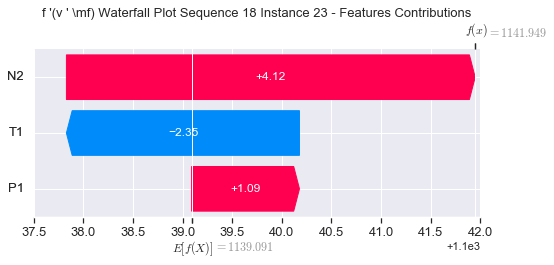

None

Contribution: [ 1.13547886 -4.47584177  3.84519305]


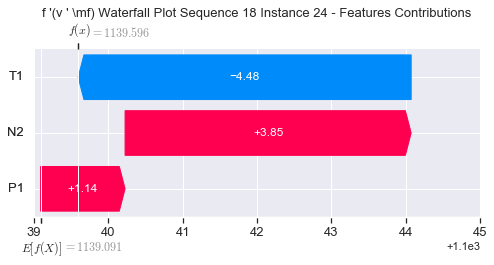

None

Contribution: [ 2.38194161 -4.38191435  5.42937969]


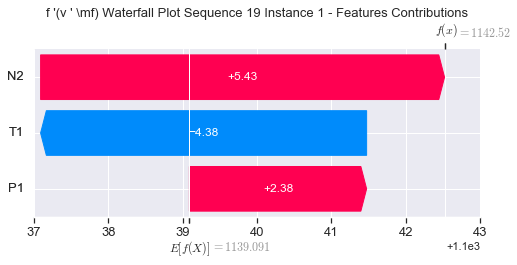

None

Contribution: [-0.24405728  0.54682217 -0.65608328]


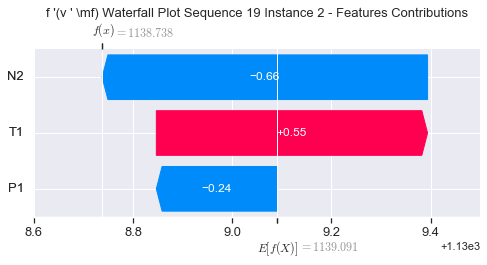

None

Contribution: [ 0.00067164 -0.00762202  0.00507347]


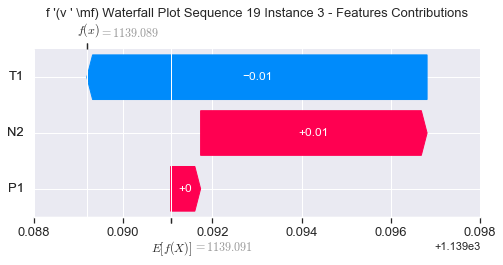

None

Contribution: [ 0.00324176 -0.0082085   0.0094643 ]


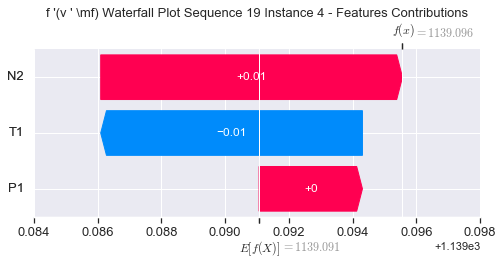

None

Contribution: [ 0.00402745 -0.00600107  0.01090142]


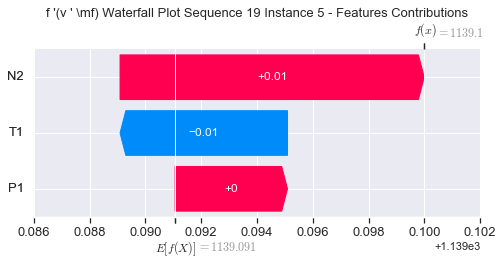

None

Contribution: [ 0.00413602 -0.00598604  0.01188948]


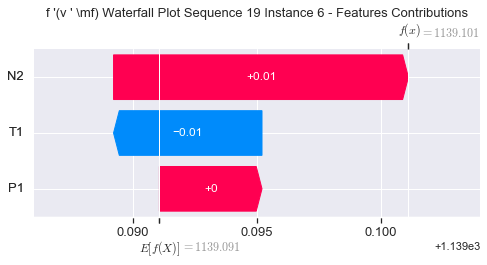

None

Contribution: [ 0.00458327 -0.0054694   0.01285923]


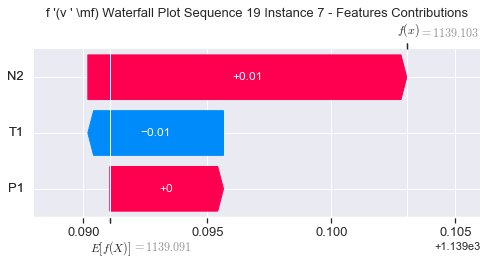

None

Contribution: [ 0.00459286 -0.0056      0.01317891]


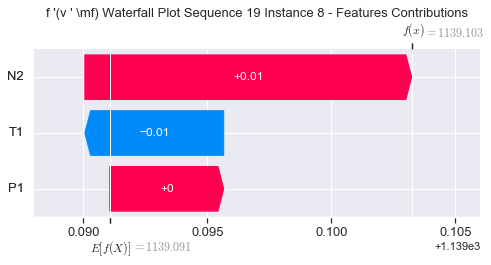

None

Contribution: [ 0.00426731 -0.00474478  0.01371493]


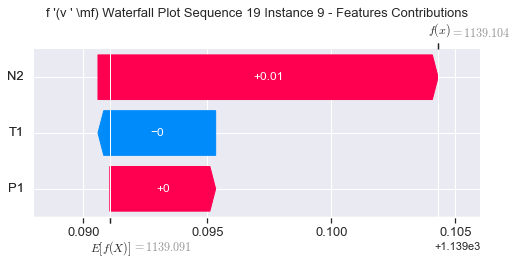

None

Contribution: [ 0.00430685 -0.00437093  0.0140051 ]


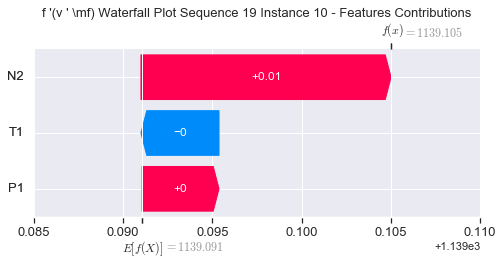

None

Contribution: [ 0.00394267 -0.0057668   0.01413167]


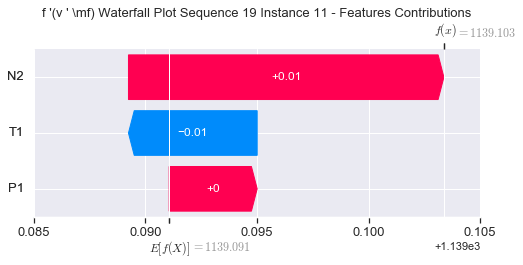

None

Contribution: [ 0.00473664 -0.00646517  0.01381621]


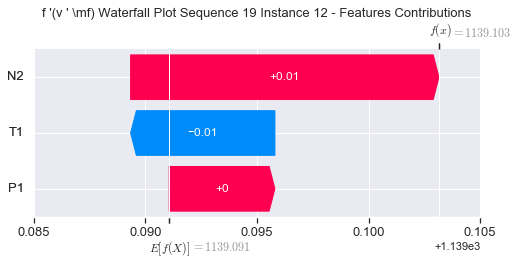

None

Contribution: [ 0.0044903  -0.00617188  0.01229386]


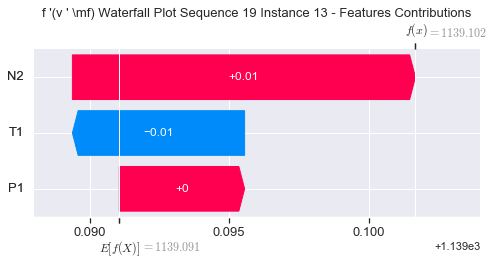

None

Contribution: [ 0.00315436 -0.00755842  0.0072887 ]


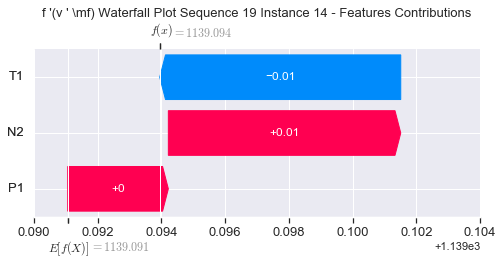

None

Contribution: [-0.00101293 -0.01316014 -0.00576516]


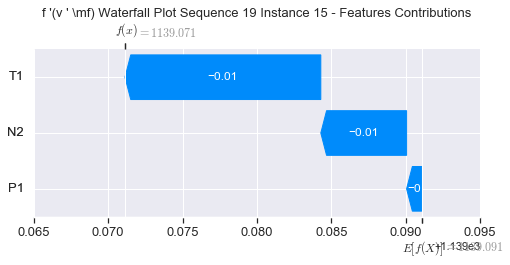

None

Contribution: [-0.00841494 -0.01839111 -0.02521606]


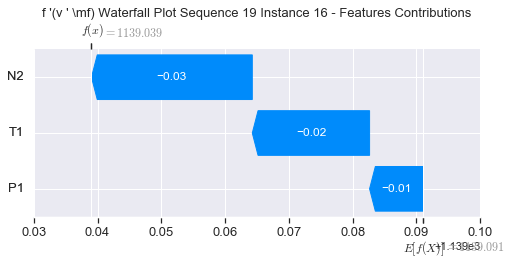

None

Contribution: [-0.01145803 -0.03296757 -0.04374442]


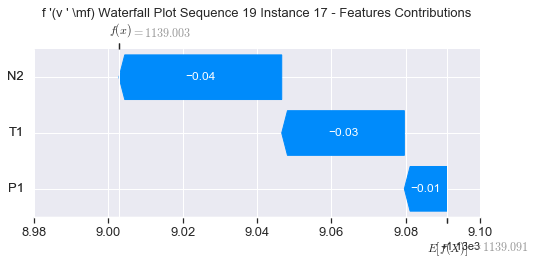

None

Contribution: [-0.00432761 -0.04913286 -0.02434534]


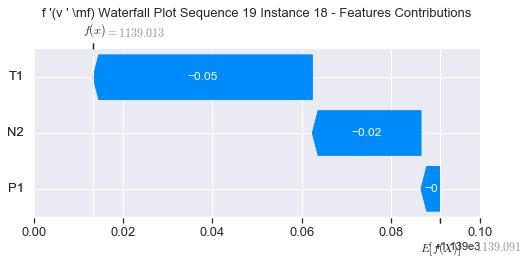

None

Contribution: [ 0.02597935 -0.06825901  0.11718503]


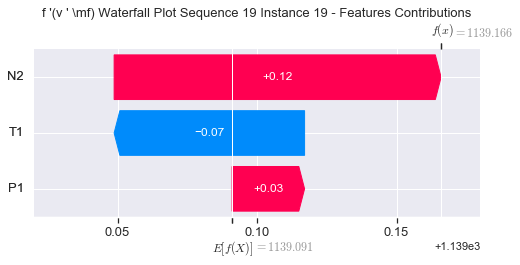

None

Contribution: [ 0.1856514  -0.09158941  0.53085619]


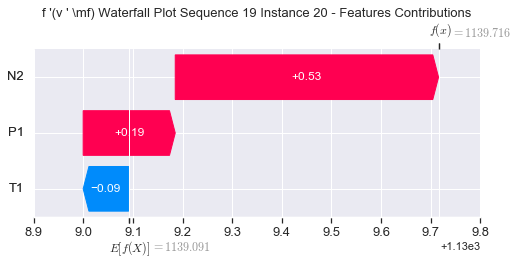

None

Contribution: [ 0.4807398  -0.2414457   1.39118568]


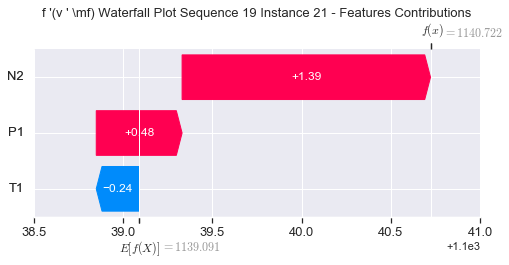

None

Contribution: [ 0.91992548 -0.86554351  2.71627326]


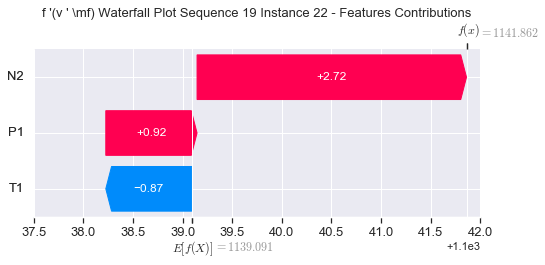

None

Contribution: [ 1.19799073 -2.63022926  3.95807971]


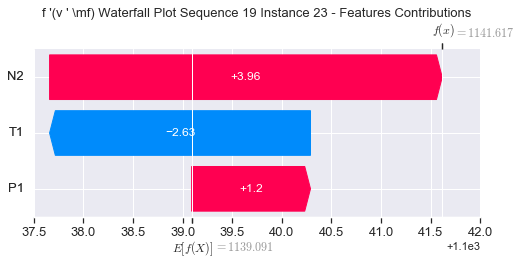

None

Contribution: [ 1.14426826 -4.84448648  3.56917207]


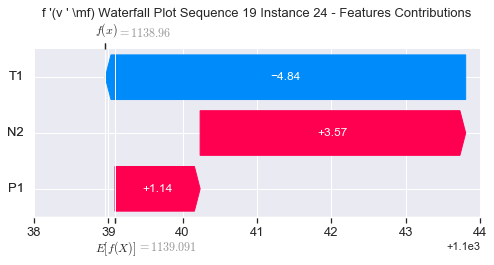

None

Contribution: [ 1.17204718 -5.66233544  4.73161622]


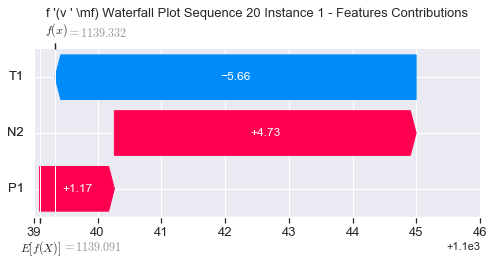

None

Contribution: [-0.2746727   0.61941679 -0.6415074 ]


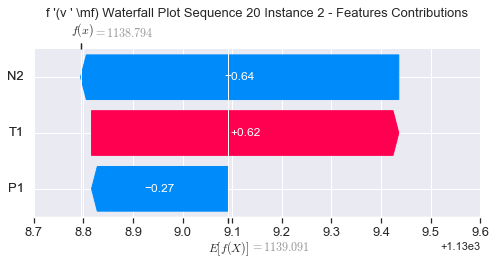

None

Contribution: [ 0.00163428 -0.00800859  0.00486549]


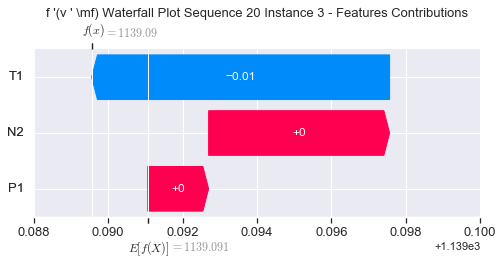

None

Contribution: [ 0.00257987 -0.00717585  0.00866135]


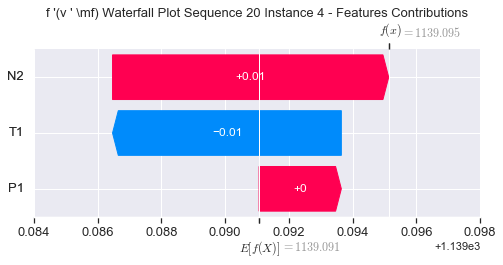

None

Contribution: [ 0.00451108 -0.00450165  0.01069837]


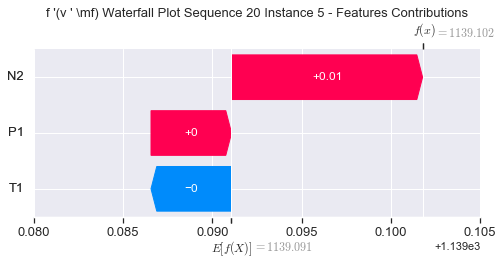

None

Contribution: [ 0.00422101 -0.00505297  0.01172593]


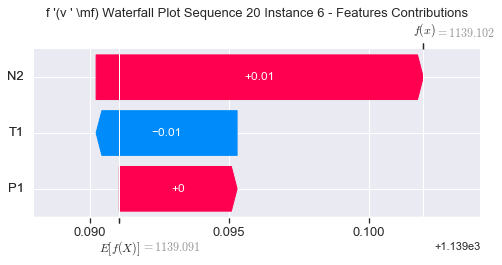

None

Contribution: [ 0.00463358 -0.00466037  0.0127925 ]


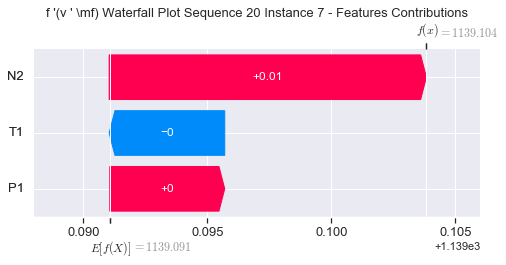

None

Contribution: [ 0.00463741 -0.00481582  0.01302737]


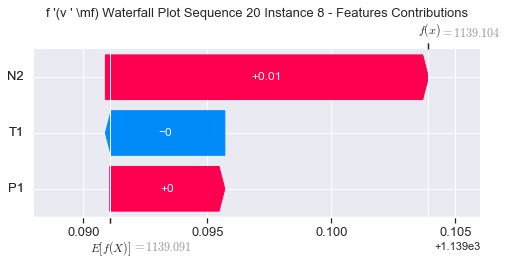

None

Contribution: [ 0.003814   -0.00497415  0.01341331]


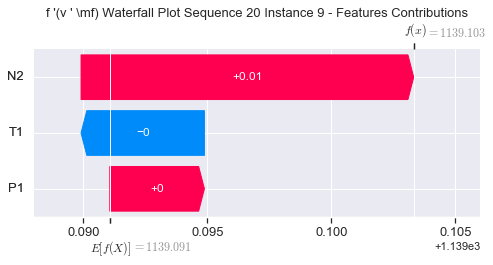

None

Contribution: [ 0.00474034 -0.00711767  0.01349697]


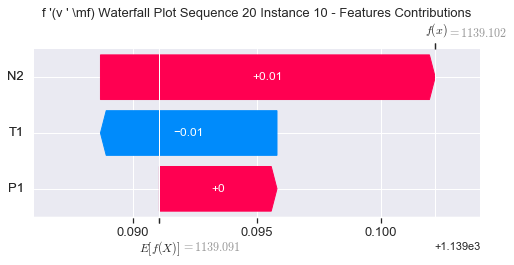

None

Contribution: [ 0.00357093 -0.00520017  0.01360014]


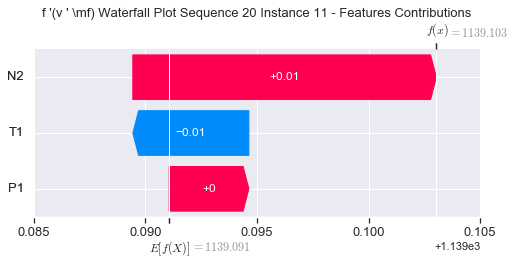

None

Contribution: [ 0.00501925 -0.00444832  0.01379187]


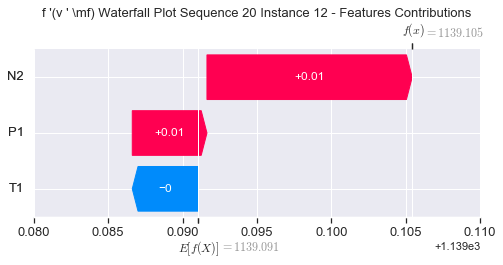

None

Contribution: [ 0.00479209 -0.00431285  0.01234336]


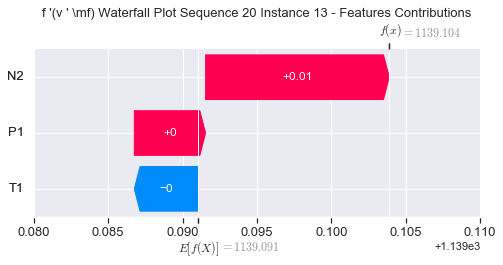

None

Contribution: [ 0.00284796 -0.00539246  0.00680803]


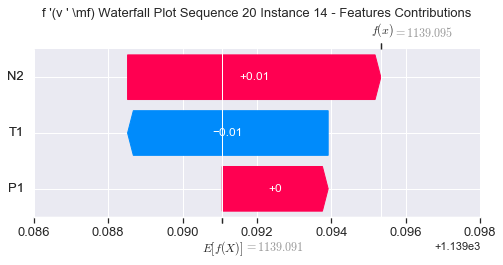

None

Contribution: [-0.00094435 -0.01102695 -0.00590129]


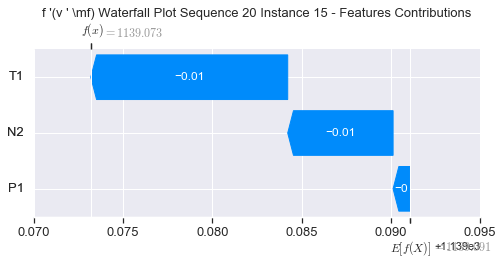

None

Contribution: [-0.00827891 -0.02065931 -0.02541967]


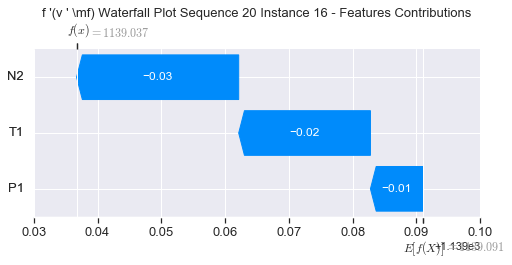

None

Contribution: [-0.01175723 -0.02951782 -0.04453955]


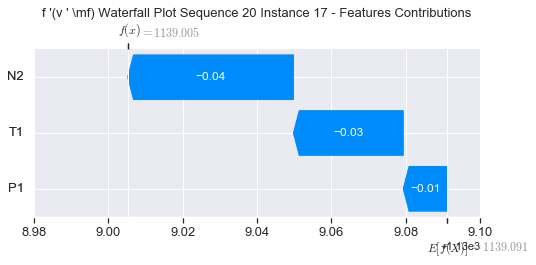

None

Contribution: [-0.00493516 -0.0428875  -0.02556535]


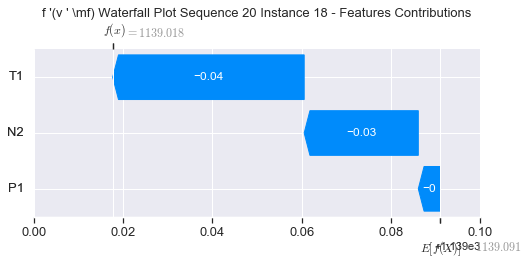

None

Contribution: [ 0.0394529  -0.05400494  0.12075174]


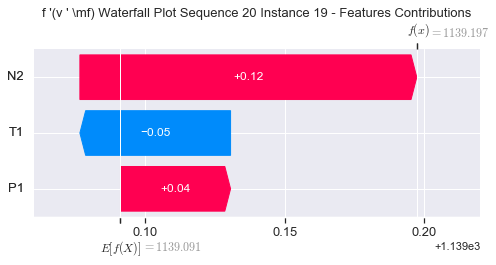

None

Contribution: [ 0.18594212 -0.07713994  0.53606335]


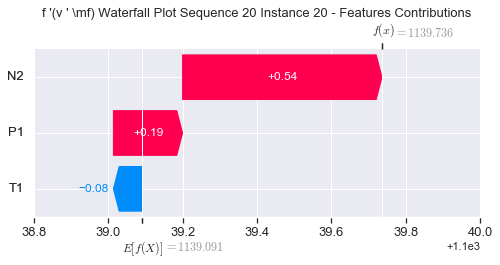

None

Contribution: [ 0.48872884 -0.1801765   1.40571595]


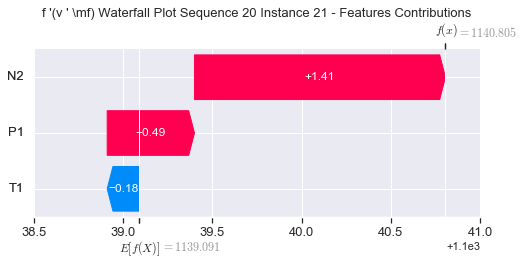

None

Contribution: [ 0.95108545 -0.67701563  2.74195361]


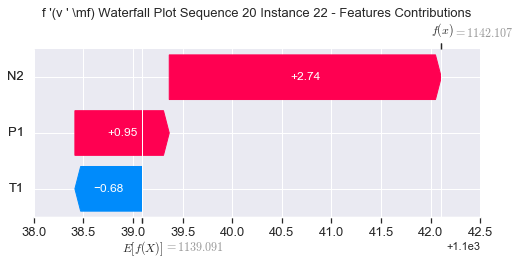

None

Contribution: [ 1.23771732 -2.32351059  4.00782855]


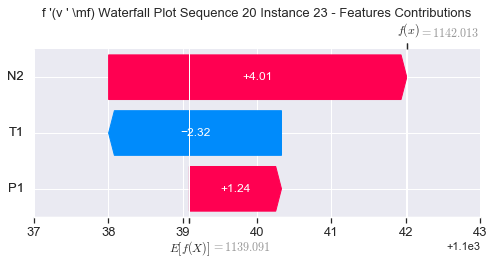

None

Contribution: [ 1.3569253  -4.39627189  3.64660065]


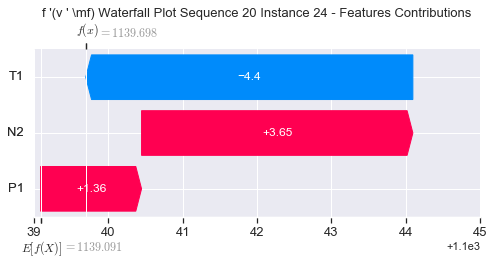

None

Contribution: [ 2.02181135 -4.52285981  4.93281272]


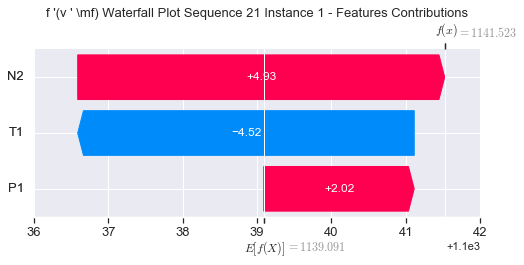

None

Contribution: [-0.31121135  0.4774957  -0.64995041]


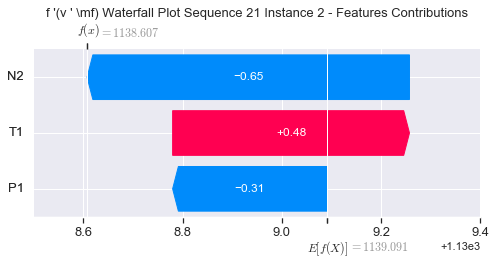

None

Contribution: [ 0.00190089 -0.004945    0.0050422 ]


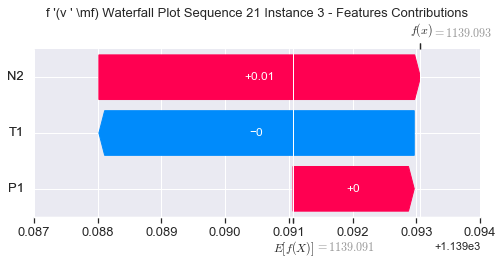

None

Contribution: [ 0.0040332  -0.0038787   0.00888955]


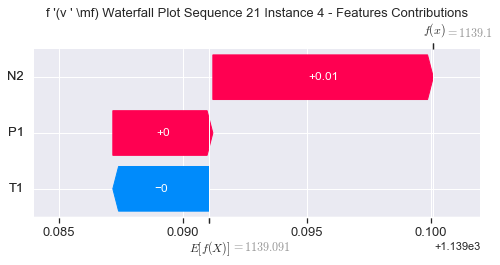

None

Contribution: [ 0.00425441 -0.00473242  0.0105442 ]


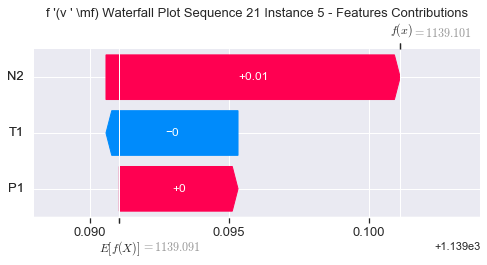

None

Contribution: [ 0.00497328 -0.00405339  0.01191005]


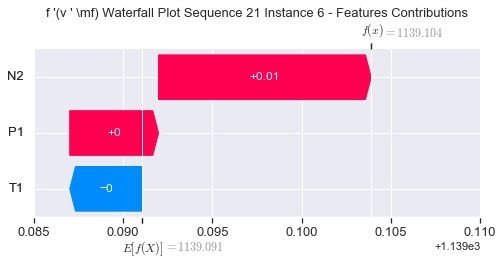

None

Contribution: [ 0.0051319  -0.00396383  0.01285751]


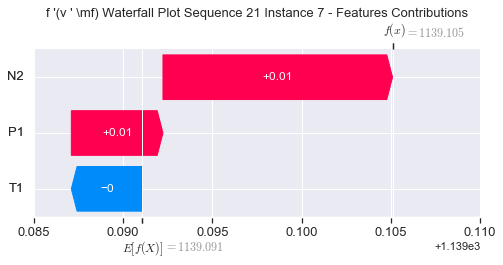

None

Contribution: [ 0.00524344 -0.00425994  0.01319321]


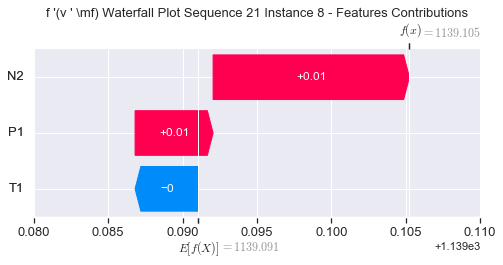

None

Contribution: [ 0.00481247 -0.00466322  0.01345049]


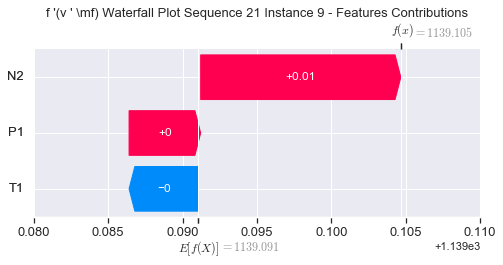

None

Contribution: [ 0.00279459 -0.0043213   0.01369932]


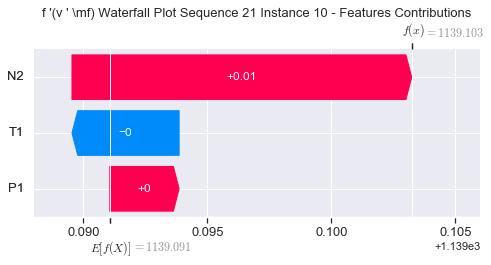

None

Contribution: [ 0.00531468 -0.00463351  0.01427727]


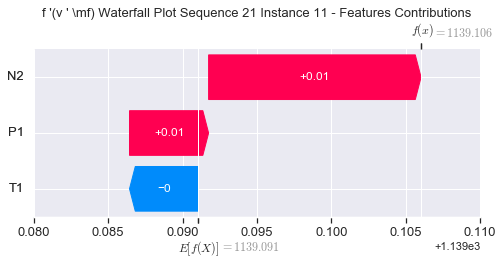

None

Contribution: [ 0.00487437 -0.00594238  0.01402977]


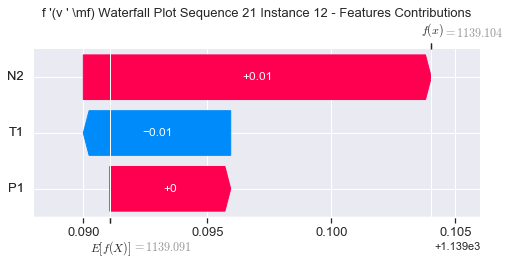

None

Contribution: [ 0.00446801 -0.00595743  0.01245824]


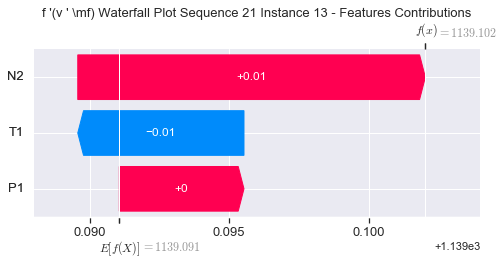

None

Contribution: [ 0.00381842 -0.00785222  0.00723795]


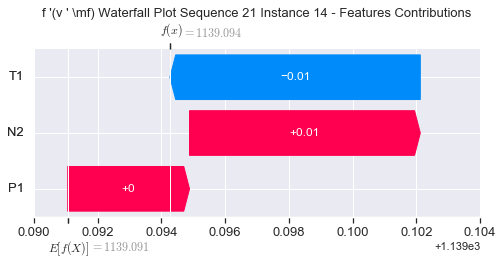

None

Contribution: [-0.00075981 -0.01305869 -0.00549236]


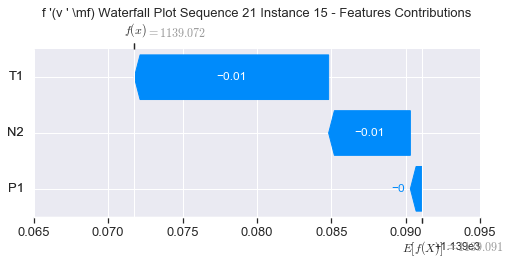

None

Contribution: [-0.00762789 -0.01967555 -0.02490721]


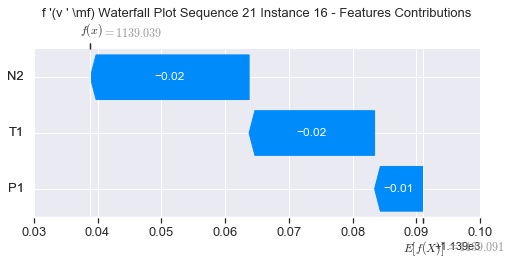

None

Contribution: [-0.01146145 -0.03534359 -0.04321319]


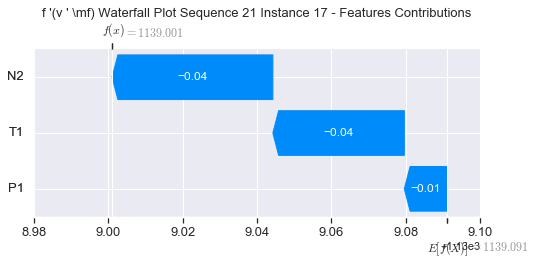

None

Contribution: [-0.00308892 -0.05432792 -0.02189799]


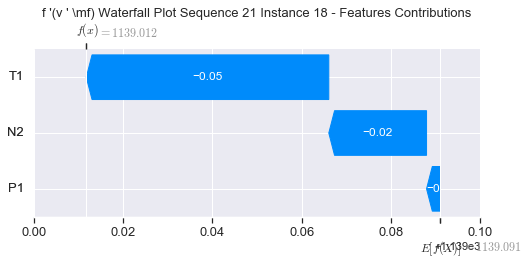

None

Contribution: [ 0.04424956 -0.09164532  0.12868134]


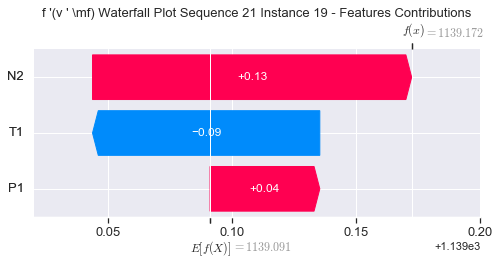

None

Contribution: [ 0.1874596  -0.14595712  0.54902282]


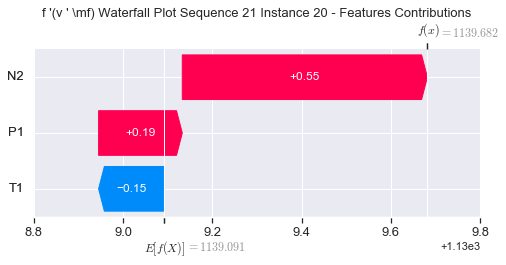

None

Contribution: [ 0.47652548 -0.38206487  1.4341755 ]


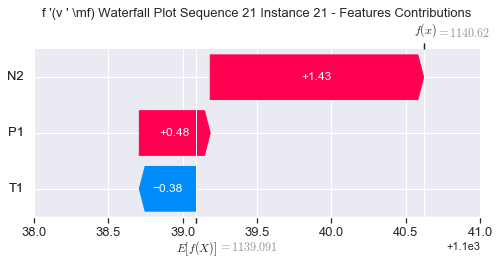

None

Contribution: [ 0.91111468 -1.18475847  2.81254982]


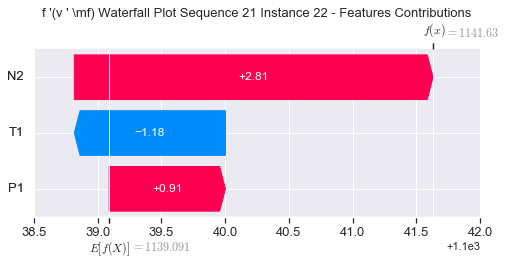

None

Contribution: [ 1.25053373 -3.16491917  4.18079414]


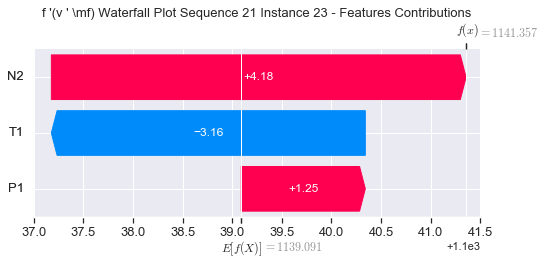

None

Contribution: [ 1.14101949 -5.58921207  3.83448251]


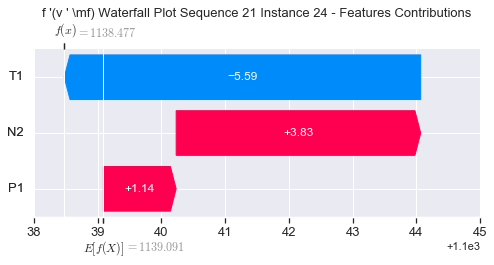

None

Contribution: [ 0.65569767 -6.94261789  4.96667824]


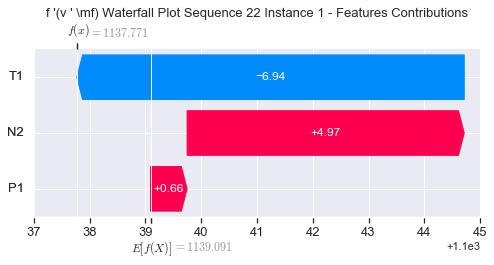

None

Contribution: [-0.21870255  0.82282213 -0.67260218]


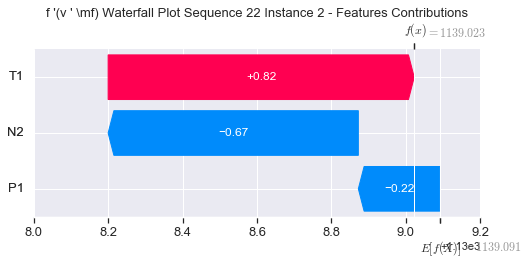

None

Contribution: [ 0.00175877 -0.01014001  0.00527374]


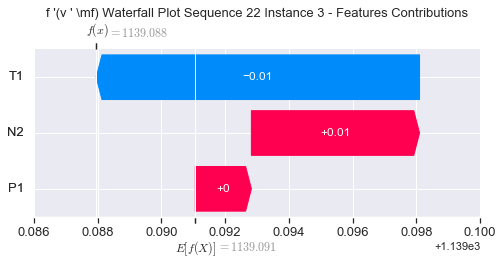

None

Contribution: [ 0.00400726 -0.01143554  0.00930741]


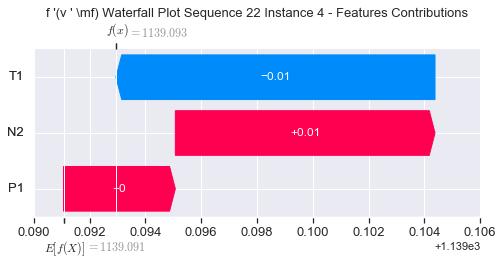

None

Contribution: [ 0.00410184 -0.00964572  0.01027832]


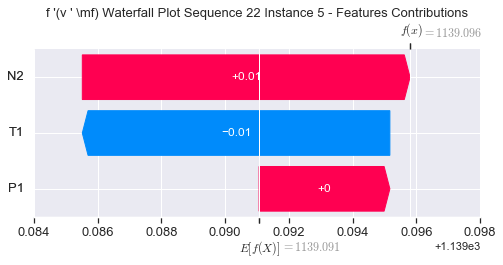

None

Contribution: [ 0.0043286  -0.0083361   0.01135814]


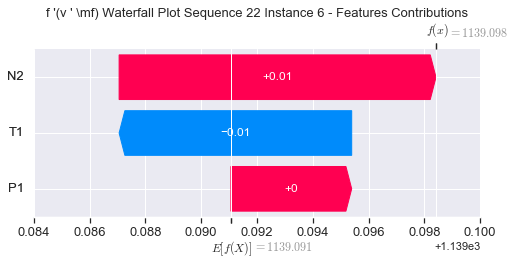

None

Contribution: [ 0.00481135 -0.00800151  0.01234448]


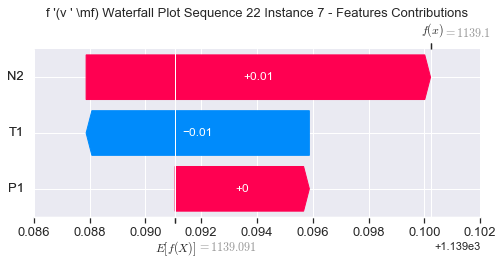

None

Contribution: [ 0.00474353 -0.00758009  0.01263364]


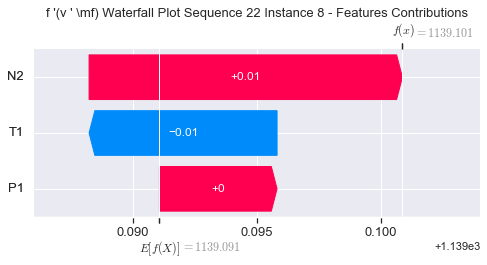

None

Contribution: [ 0.00407854 -0.00716634  0.01262018]


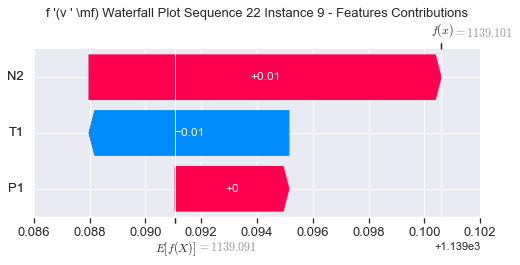

None

Contribution: [ 0.0043509  -0.0055092   0.01329865]


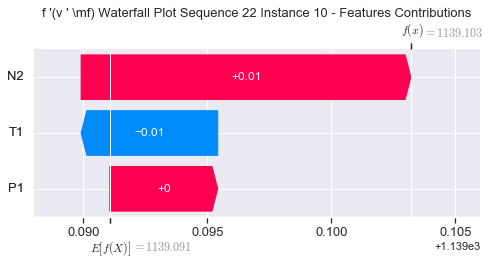

None

Contribution: [ 0.00361562 -0.00548831  0.01318047]


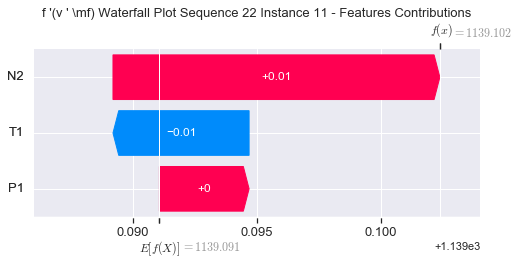

None

Contribution: [ 0.0047715  -0.00623554  0.01359826]


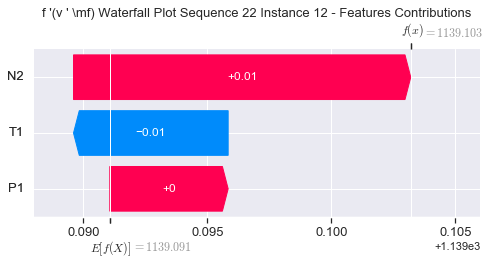

None

Contribution: [ 0.00458796 -0.00632628  0.01210611]


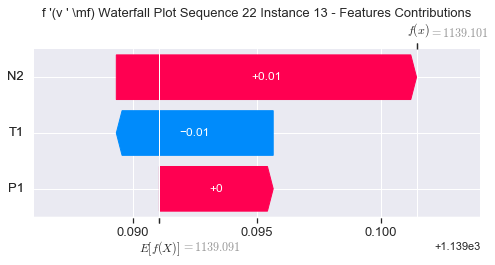

None

Contribution: [ 0.00260969 -0.00770192  0.00664892]


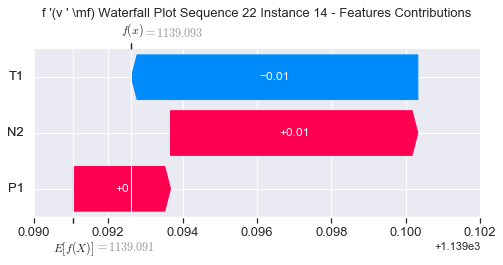

None

Contribution: [-0.0009896  -0.01326584 -0.00629207]


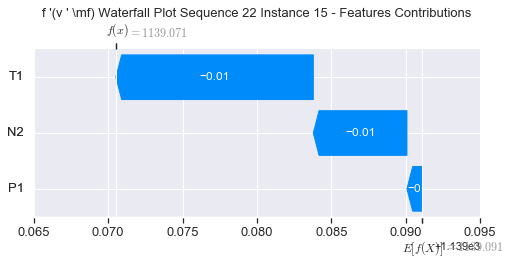

None

Contribution: [-0.00743448 -0.02072195 -0.02581238]


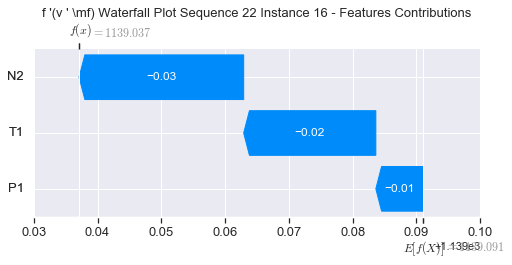

None

Contribution: [-0.01134515 -0.03245691 -0.04580372]


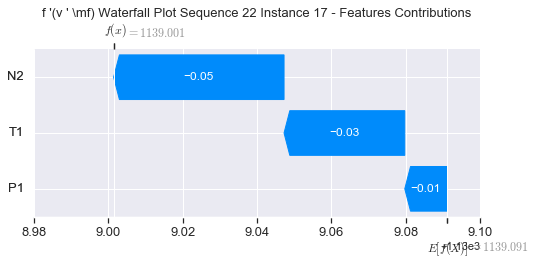

None

Contribution: [-0.00359812 -0.04362735 -0.02693866]


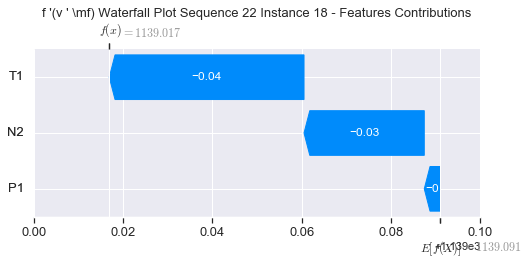

None

Contribution: [ 0.02600025 -0.06258105  0.11692246]


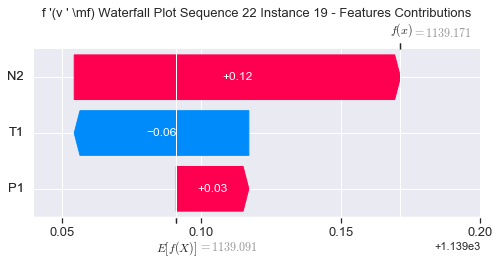

None

Contribution: [ 0.19666859 -0.0724931   0.53656994]


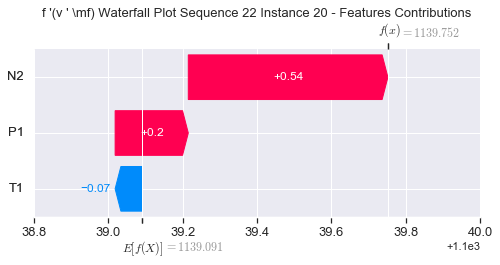

None

Contribution: [ 0.50151588 -0.15847215  1.41479877]


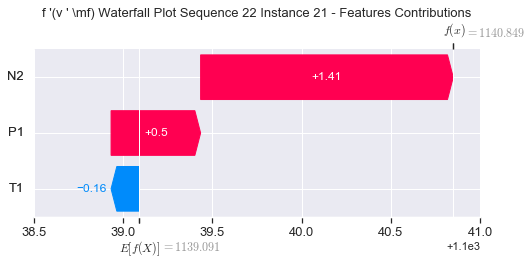

None

Contribution: [ 0.95095548 -0.59969787  2.78211792]


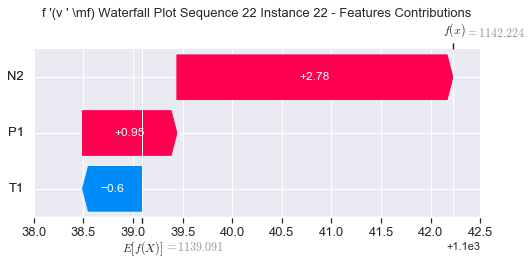

None

Contribution: [ 1.27313724 -1.83434008  4.10994407]


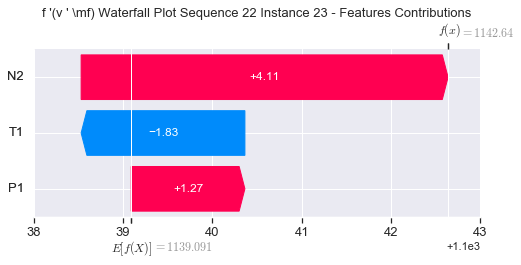

None

Contribution: [ 1.24296003 -4.001131    3.85760951]


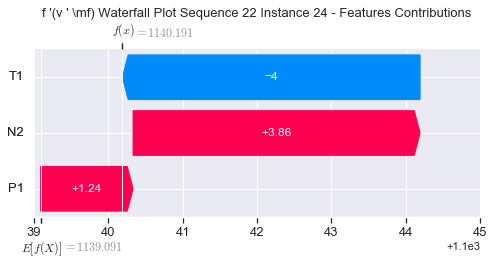

None

Contribution: [ 1.20222801 -4.81764769  5.30926389]


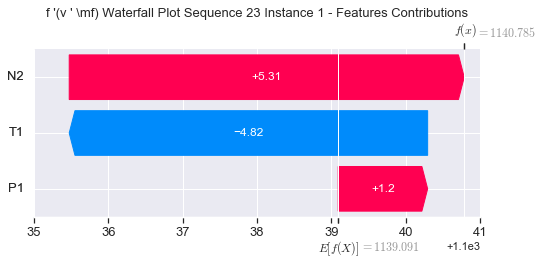

None

Contribution: [-0.27140413  0.41910173 -0.67565465]


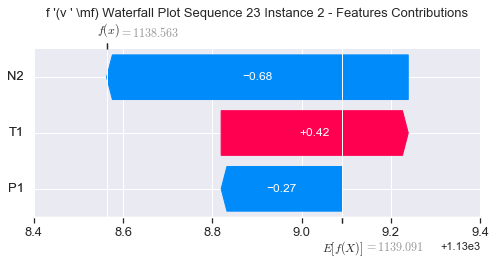

None

Contribution: [ 0.000816   -0.00974796  0.00510781]


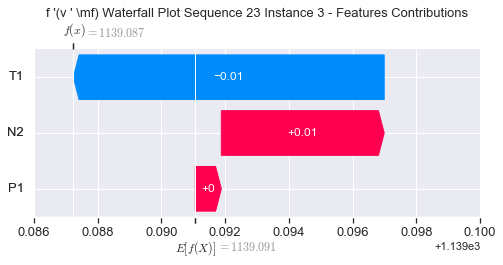

None

Contribution: [ 0.00179604 -0.01017268  0.00885975]


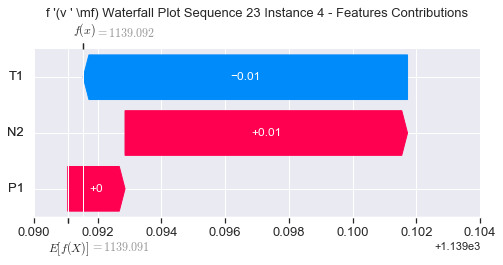

None

Contribution: [ 0.00412487 -0.00712887  0.01077513]


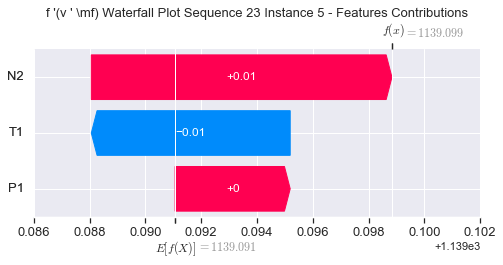

None

Contribution: [ 0.00472192 -0.00609913  0.01200526]


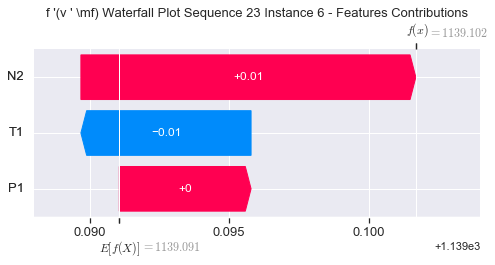

None

Contribution: [ 0.00508351 -0.00564815  0.01298225]


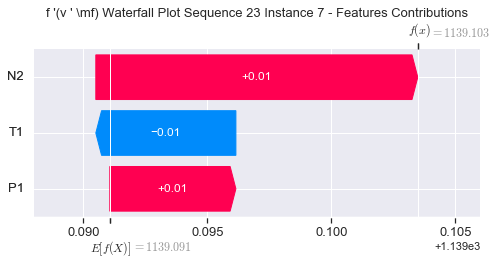

None

Contribution: [ 0.00505893 -0.00572969  0.01326525]


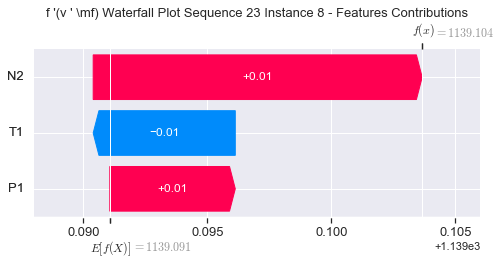

None

Contribution: [ 0.00476133 -0.00516477  0.01369346]


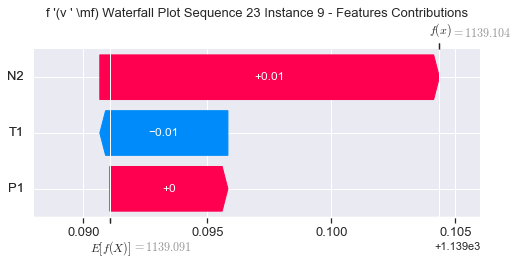

None

Contribution: [ 0.00500396 -0.00473618  0.01409702]


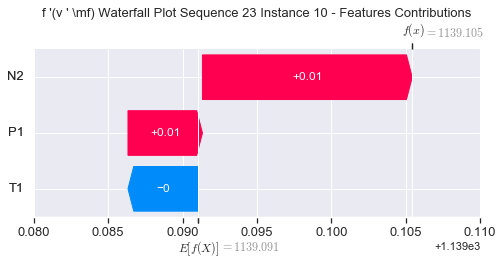

None

Contribution: [ 0.00468519 -0.00511729  0.01419562]


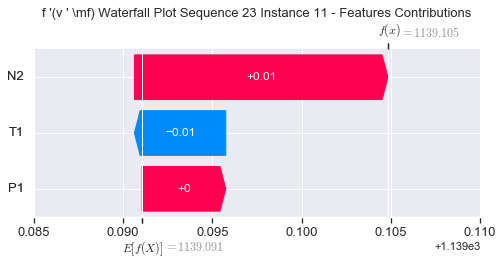

None

Contribution: [ 0.00522741 -0.00564146  0.01408187]


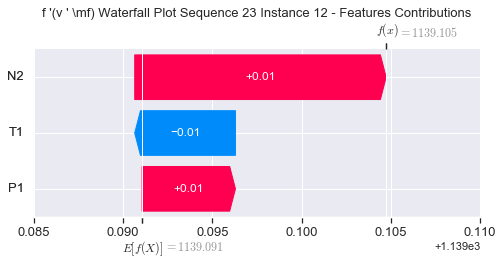

None

Contribution: [ 0.00491147 -0.00555773  0.0125866 ]


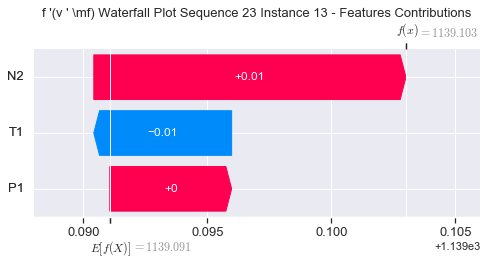

None

Contribution: [ 0.00326304 -0.00678482  0.00739819]


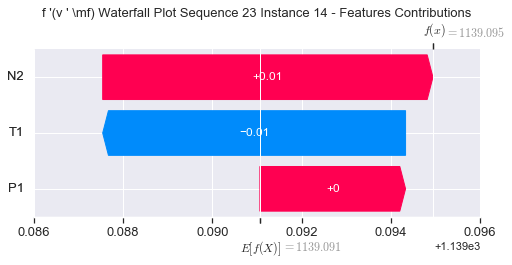

None

Contribution: [-0.00058124 -0.01209981 -0.00534531]


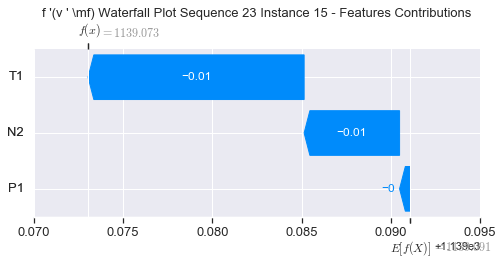

None

Contribution: [-0.00928795 -0.01995785 -0.0251825 ]


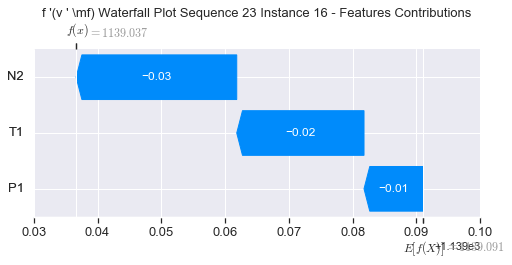

None

Contribution: [-0.01057791 -0.03056802 -0.0428363 ]


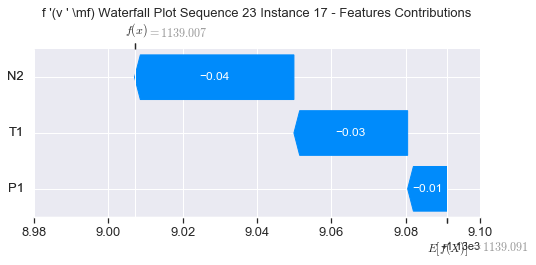

None

Contribution: [-0.00238373 -0.0432304  -0.02210819]


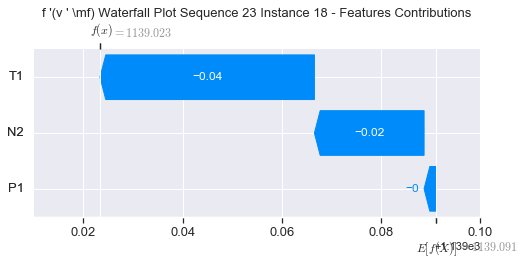

None

Contribution: [ 0.03872096 -0.0683155   0.11967963]


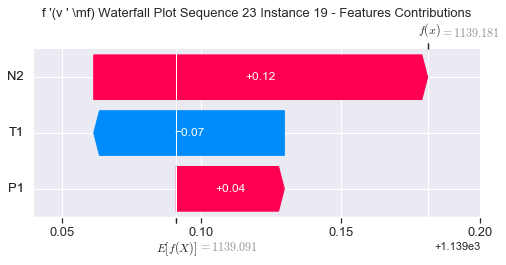

None

Contribution: [ 0.18720918 -0.08182927  0.54545454]


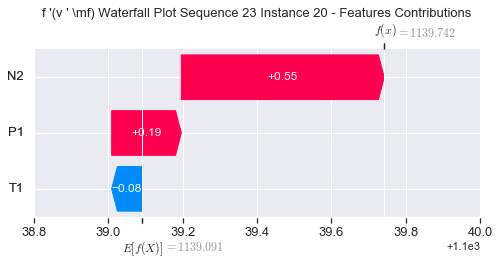

None

Contribution: [ 0.4792443  -0.21229182  1.42660708]


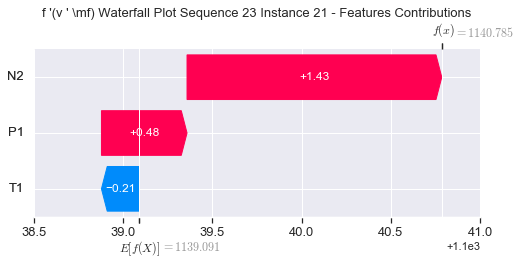

None

Contribution: [ 0.90127572 -0.78858397  2.79273327]


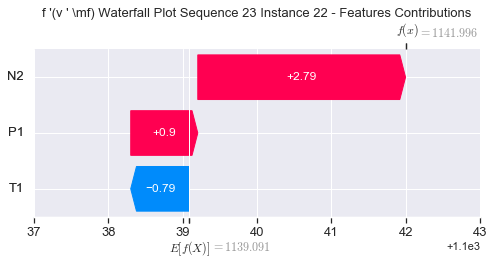

None

Contribution: [ 1.20994224 -2.35008132  4.12987698]


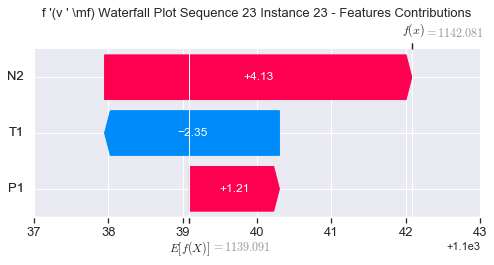

None

Contribution: [ 1.43291742 -4.46898205  3.8954216 ]


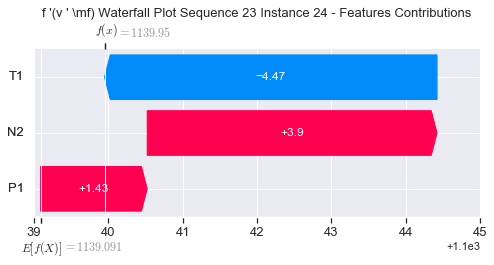

None

Contribution: [ 2.64570701 -4.57067267  5.45725177]


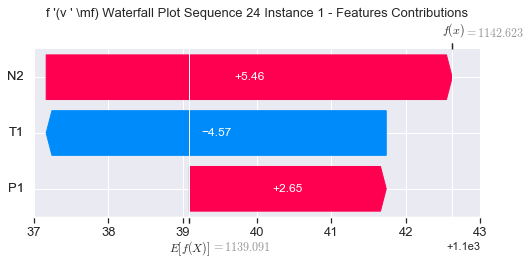

None

Contribution: [-0.2422001   0.55187311 -0.6576167 ]


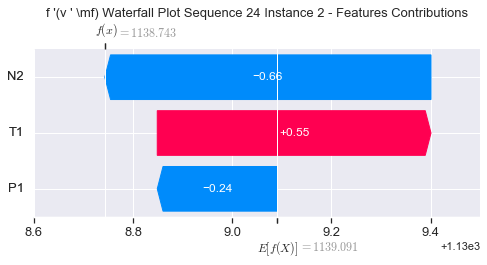

None

Contribution: [ 0.00183562 -0.00765136  0.0054641 ]


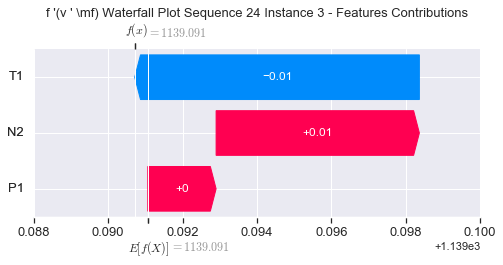

None

Contribution: [ 0.00467499 -0.00934517  0.00945617]


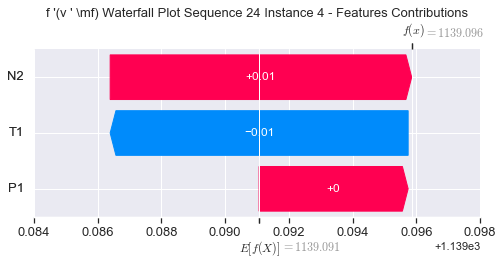

None

Contribution: [ 0.00446519 -0.0076173   0.01078273]


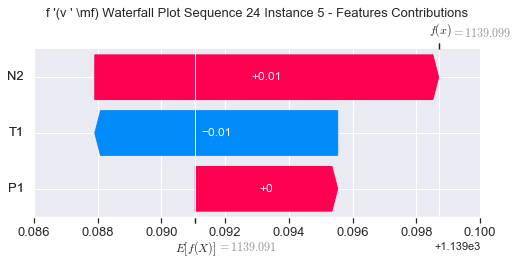

None

Contribution: [ 0.00473327 -0.00700753  0.01208371]


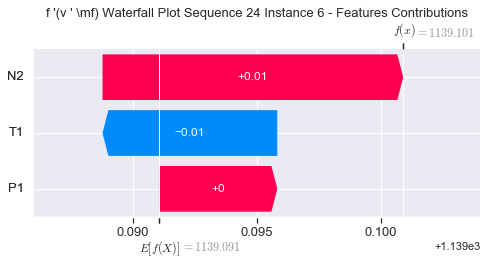

None

Contribution: [ 0.0051172  -0.00651978  0.01309673]


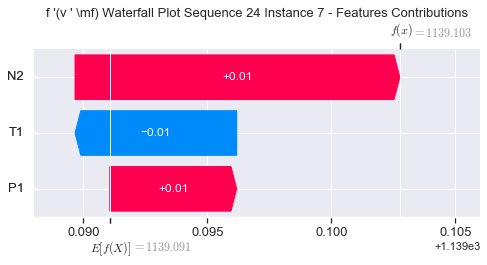

None

Contribution: [ 0.00508652 -0.00634539  0.01334634]


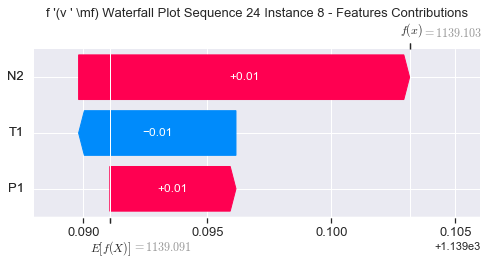

None

Contribution: [ 0.00425726 -0.0059375   0.01351637]


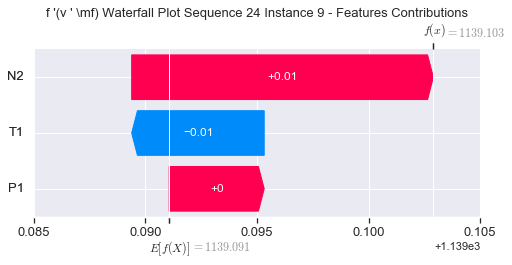

None

Contribution: [ 0.00457006 -0.0065216   0.0140078 ]


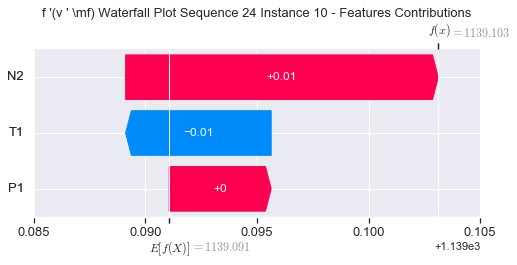

None

Contribution: [ 0.00437911 -0.00617527  0.01406704]


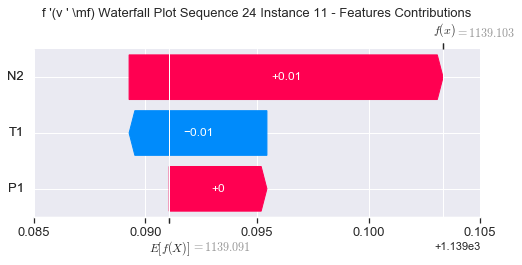

None

Contribution: [ 0.00554705 -0.00690389  0.01421592]


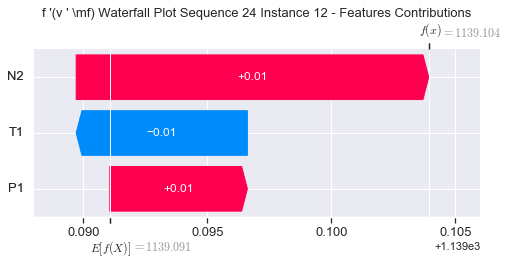

None

Contribution: [ 0.00521755 -0.00647534  0.01270232]


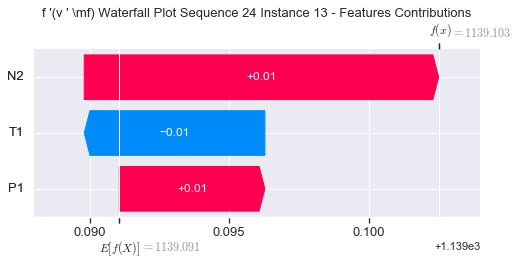

None

Contribution: [ 0.00290569 -0.00887162  0.00706358]


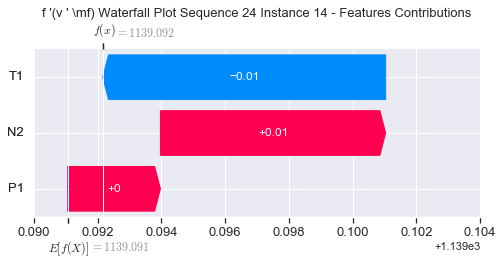

None

Contribution: [ 3.00544284e-05 -1.21444233e-02 -4.67503977e-03]


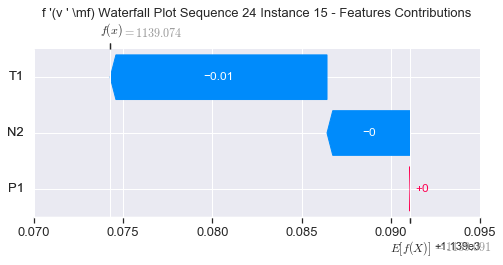

None

Contribution: [-0.008482   -0.02253478 -0.02425703]


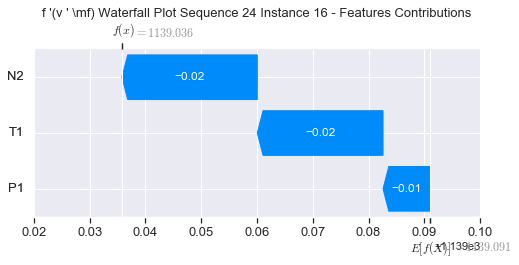

None

Contribution: [-0.0092524  -0.02738806 -0.04020134]


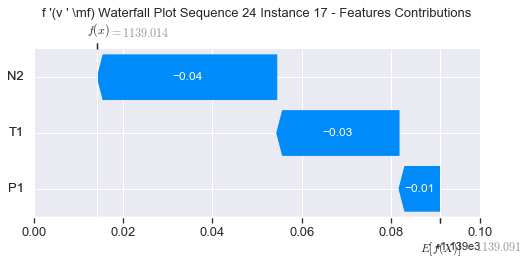

None

Contribution: [-0.00036259 -0.03320026 -0.01860102]


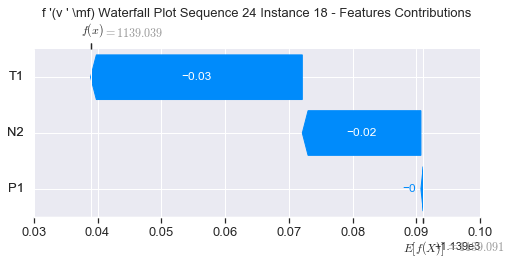

None

Contribution: [ 0.03837682 -0.02448764  0.1343528 ]


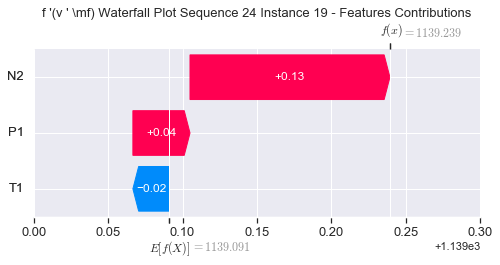

None

Contribution: [0.1929658  0.017311   0.54169515]


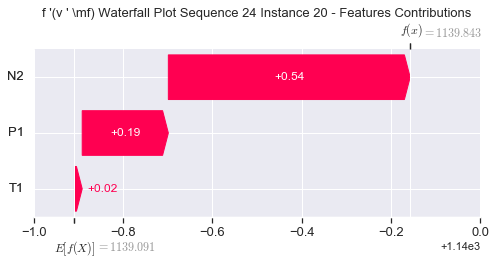

None

Contribution: [0.49889058 0.01239024 1.41196853]


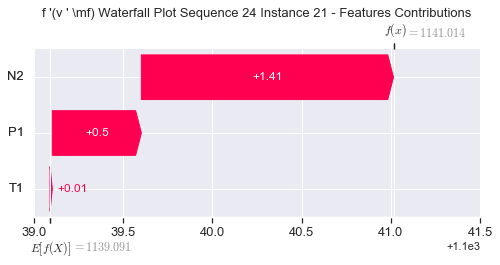

None

Contribution: [ 0.97467961 -0.25599923  2.7715146 ]


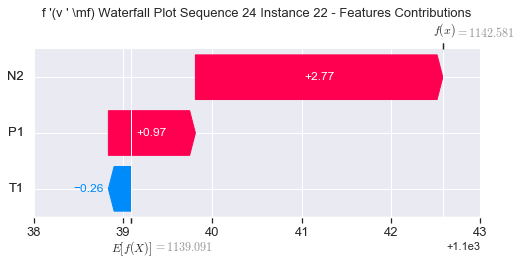

None

Contribution: [ 1.3404382  -1.32000457  4.12895293]


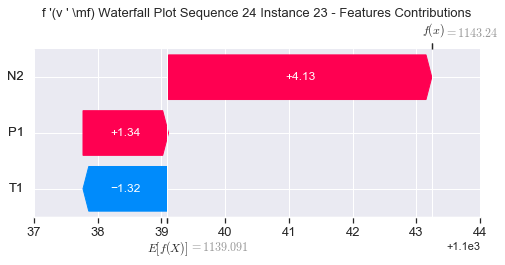

None

Contribution: [ 1.44367425 -2.91705538  3.85003189]


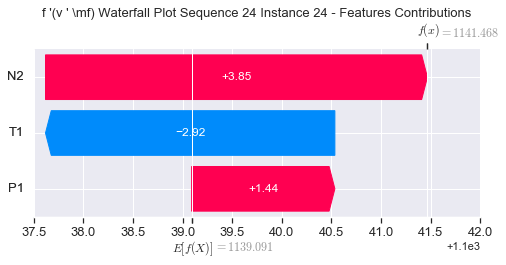

None

Contribution: [ 2.00752766 -3.1342596   5.20830616]


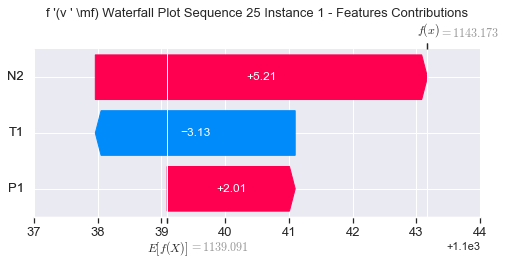

None

Contribution: [-0.30261614  0.35850122 -0.66359655]


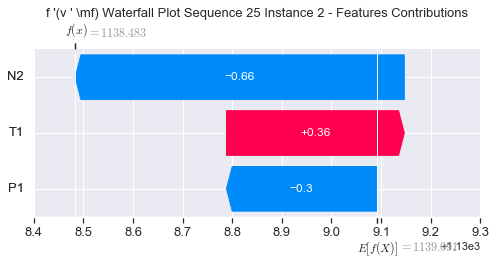

None

Contribution: [ 0.00223905 -0.00635557  0.00554805]


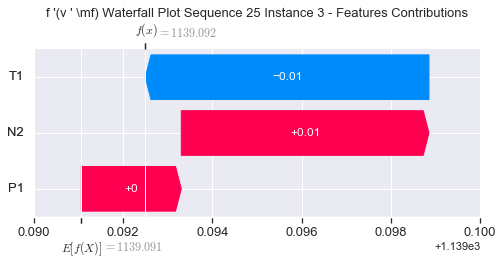

None

Contribution: [ 0.00258732 -0.00830599  0.00905735]


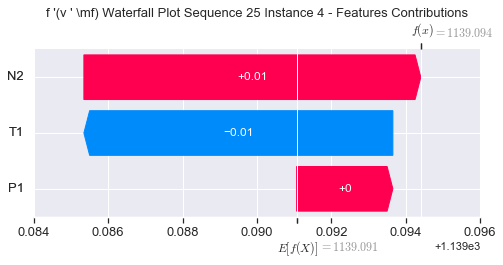

None

Contribution: [ 0.00384272 -0.00465779  0.01057119]


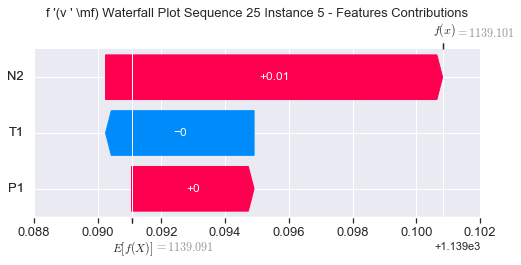

None

Contribution: [ 0.00408455 -0.00482449  0.01188918]


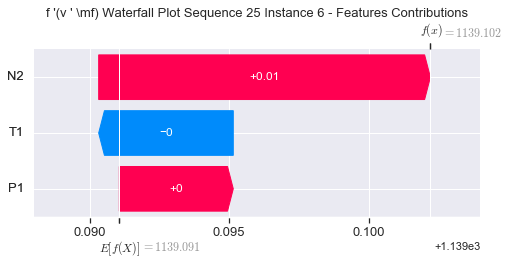

None

Contribution: [ 0.00438646 -0.00472859  0.01286486]


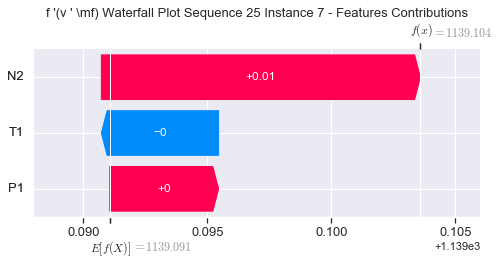

None

Contribution: [ 0.00455737 -0.00429668  0.01320226]


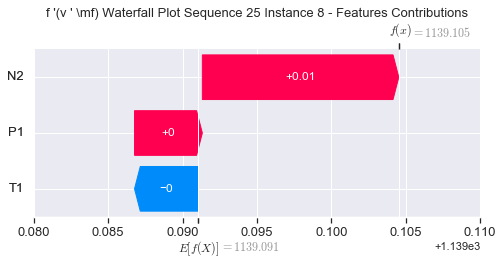

None

Contribution: [ 0.00461681 -0.00388478  0.01373205]


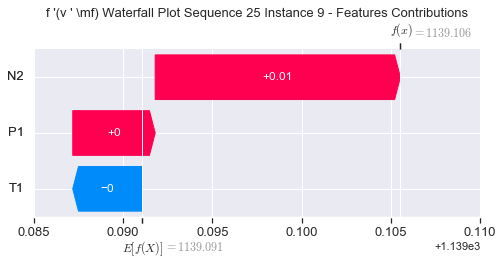

None

Contribution: [ 0.00277164 -0.00525979  0.01367463]


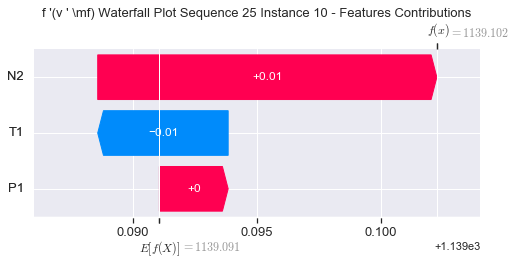

None

Contribution: [ 0.00489488 -0.00280965  0.01440432]


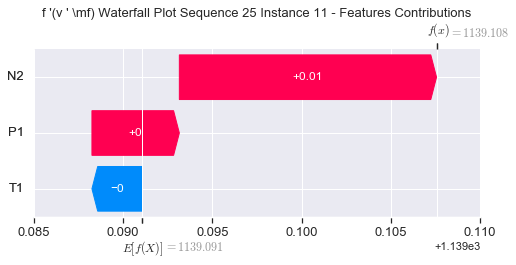

None

Contribution: [ 0.00490206 -0.00452991  0.01410245]


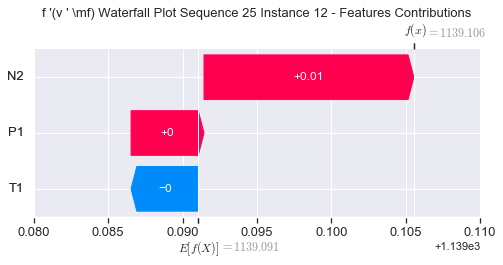

None

Contribution: [ 0.00452067 -0.00430816  0.01257777]


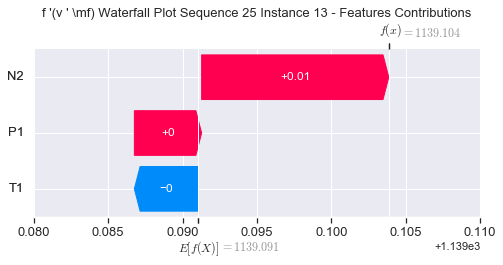

None

Contribution: [ 0.00321239 -0.0065803   0.00709811]


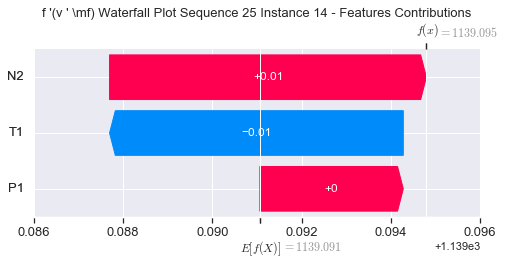

None

Contribution: [-0.0008376  -0.00965292 -0.00468484]


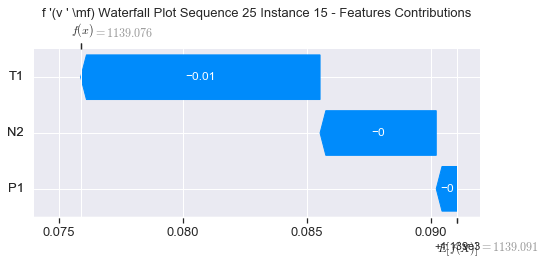

None

Contribution: [-0.0101127  -0.01985401 -0.02412555]


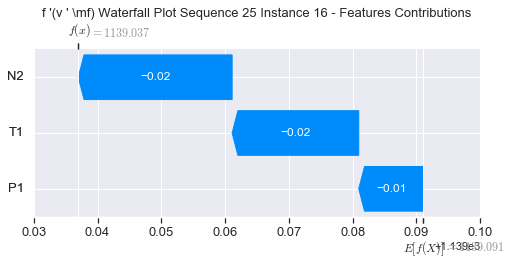

None

Contribution: [-0.01140288 -0.02367465 -0.04014321]


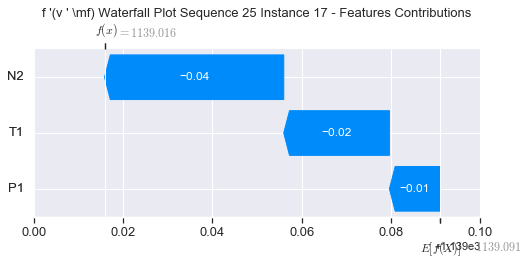

None

Contribution: [-0.00454429 -0.02664939 -0.01872084]


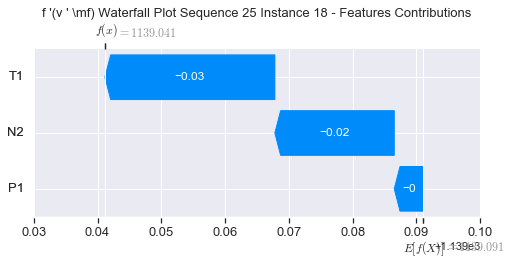

None

Contribution: [ 0.04654839 -0.01832322  0.12928419]


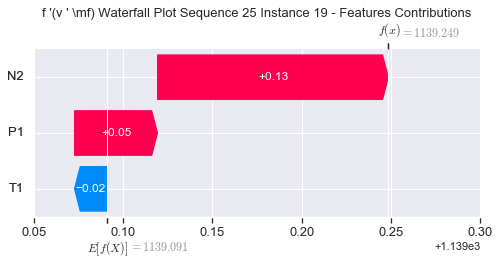

None

Contribution: [0.17287198 0.03207878 0.53882387]


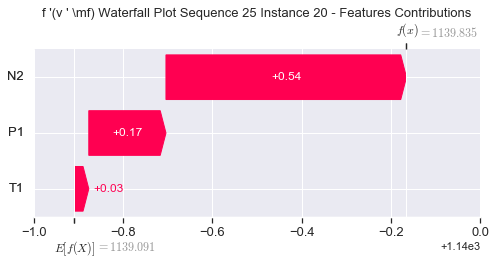

None

Contribution: [0.45664575 0.06636963 1.40799335]


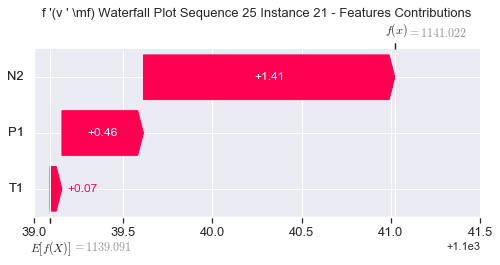

None

Contribution: [ 0.89260464 -0.07983112  2.76867269]


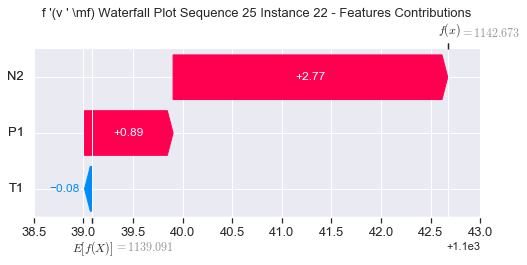

None

Contribution: [ 1.1932371  -1.03942005  4.13377999]


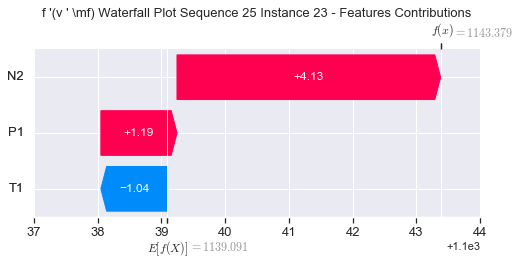

None

Contribution: [ 1.24913986 -2.5022828   3.92495071]


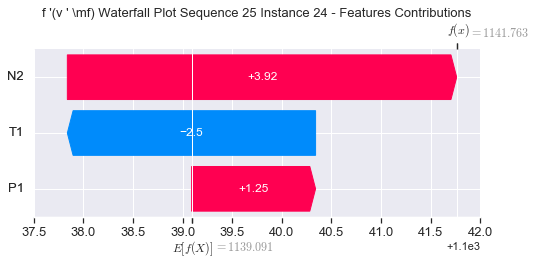

None

Contribution: [ 1.83750027 -2.51477203  5.5710226 ]


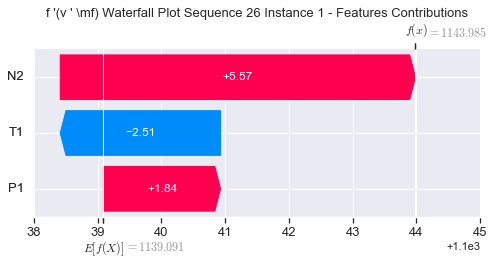

None

Contribution: [-0.27311003  0.2639049  -0.66891896]


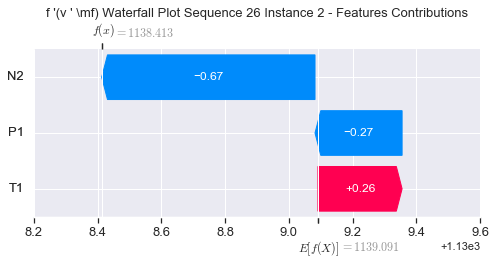

None

Contribution: [ 0.00212336 -0.00437322  0.00571709]


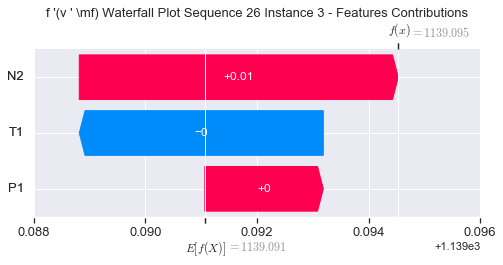

None

Contribution: [ 0.00367518 -0.00466844  0.00962428]


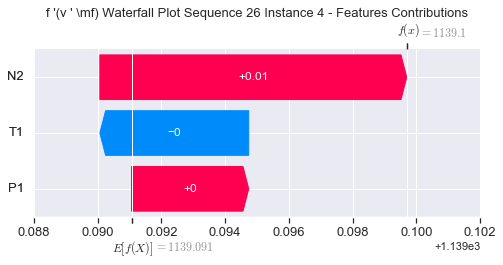

None

Contribution: [ 0.00423128 -0.00285705  0.01095468]


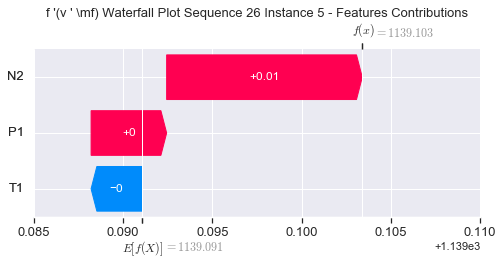

None

Contribution: [ 0.0041061  -0.00311492  0.01210346]


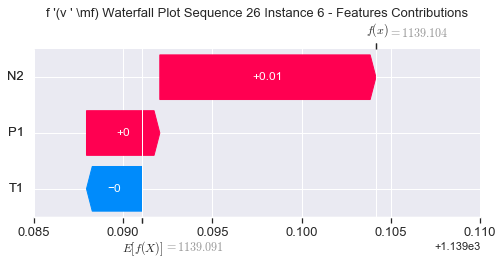

None

Contribution: [ 0.00446787 -0.00285629  0.01307579]


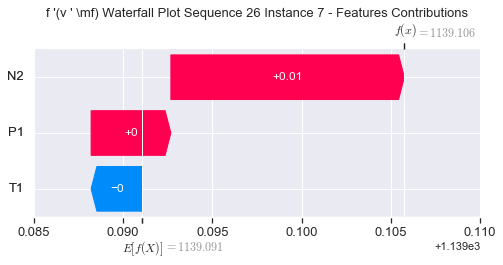

None

Contribution: [ 0.00460265 -0.00275503  0.0133598 ]


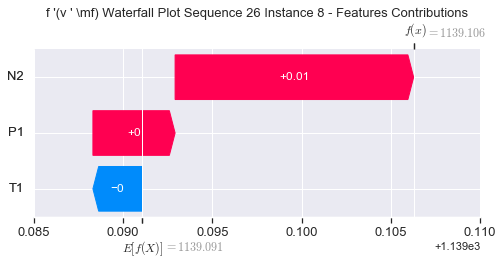

None

Contribution: [ 0.00428797 -0.00239053  0.0136219 ]


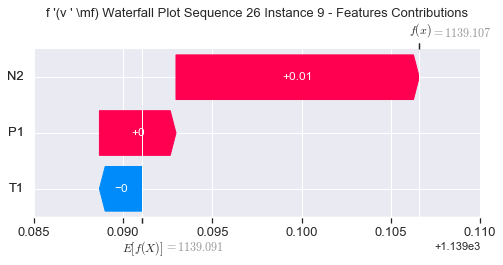

None

Contribution: [ 0.00410102 -0.0022651   0.01409603]


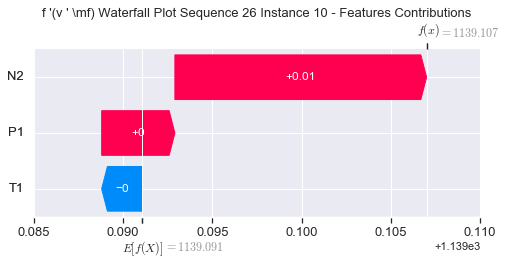

None

Contribution: [ 0.00473667 -0.00240647  0.01424178]


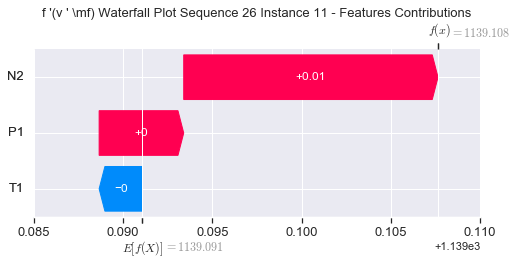

None

Contribution: [ 0.00565851 -0.00339713  0.01426809]


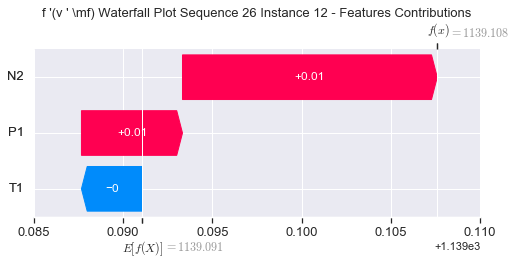

None

Contribution: [ 0.00522141 -0.00303076  0.01275748]


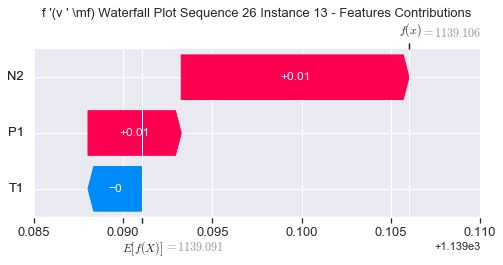

None

Contribution: [ 0.00316242 -0.00462643  0.00737007]


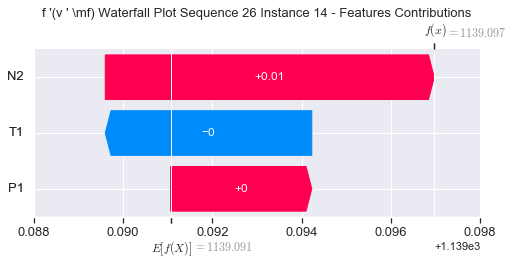

None

Contribution: [-0.00025512 -0.00854214 -0.00426093]


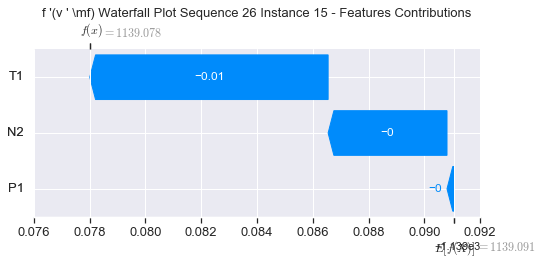

None

Contribution: [-0.00747902 -0.01217244 -0.02252477]


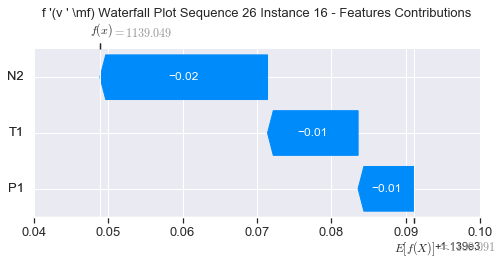

None

Contribution: [-0.01043941 -0.0210152  -0.03915671]


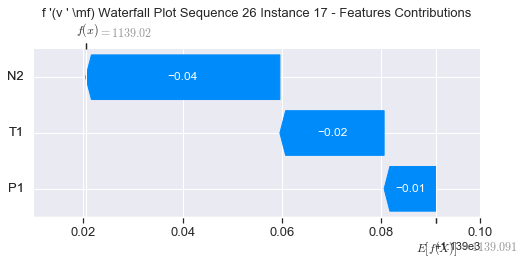

None

Contribution: [-0.00371338 -0.02358147 -0.01768263]


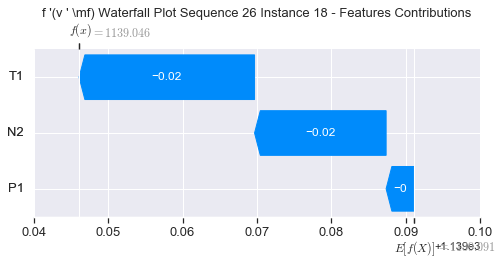

None

Contribution: [ 0.03742522 -0.00244189  0.12684362]


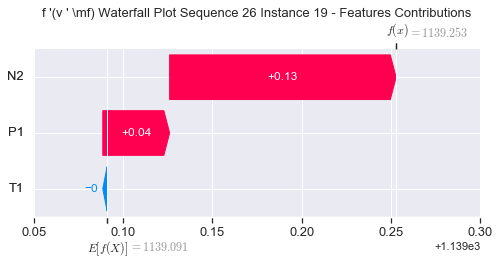

None

Contribution: [0.16808892 0.03257756 0.53852227]


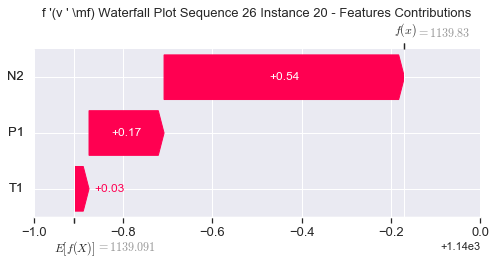

None

Contribution: [0.4567501  0.04308899 1.40718498]


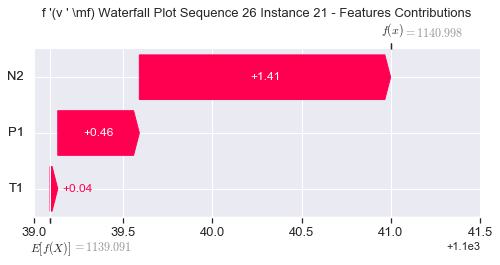

None

Contribution: [ 0.90489252 -0.21730637  2.76689199]


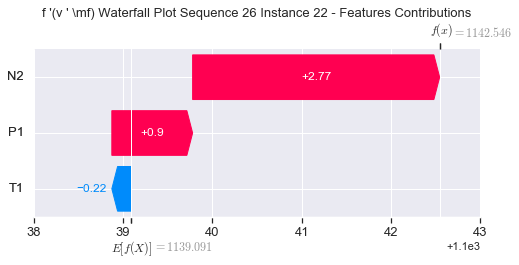

None

Contribution: [ 1.18258931 -1.34803811  4.10934446]


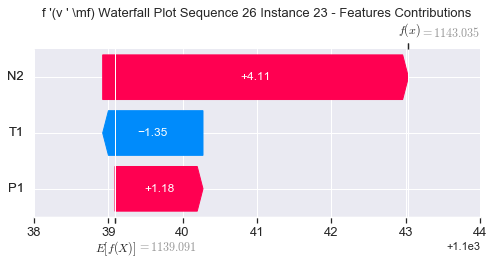

None

Contribution: [ 1.132736   -3.0662451   3.80980086]


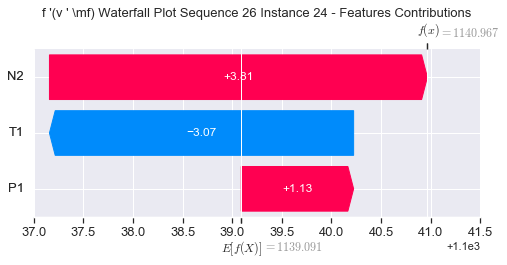

None

Contribution: [ 1.62717701 -3.34543424  5.15036251]


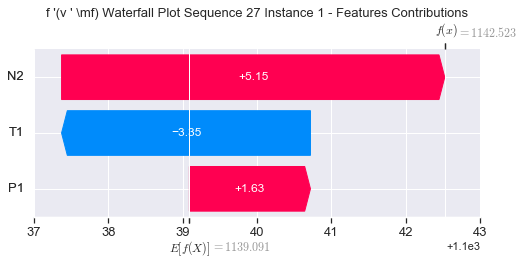

None

Contribution: [-0.32279738  0.35829857 -0.67354072]


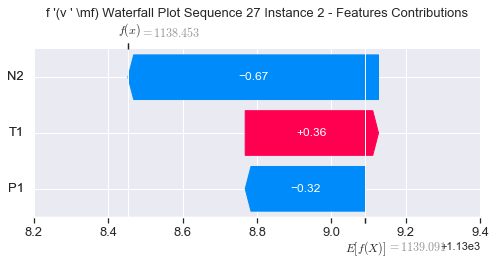

None

Contribution: [ 0.00201957 -0.00677716  0.00559801]


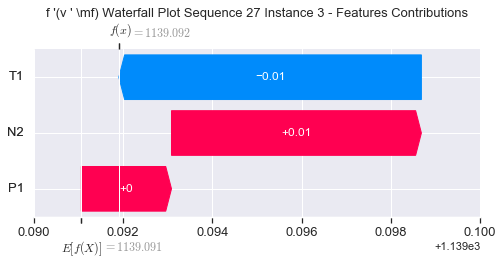

None

Contribution: [ 0.00386282 -0.00551025  0.0095021 ]


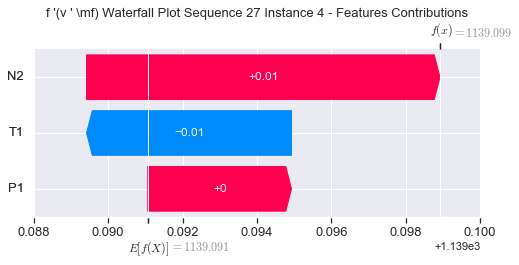

None

Contribution: [ 0.00326584 -0.00613306  0.01049745]


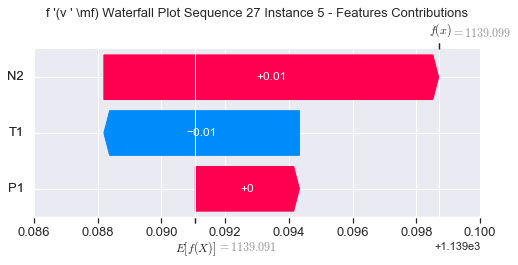

None

Contribution: [ 0.00426932 -0.00475298  0.01192666]


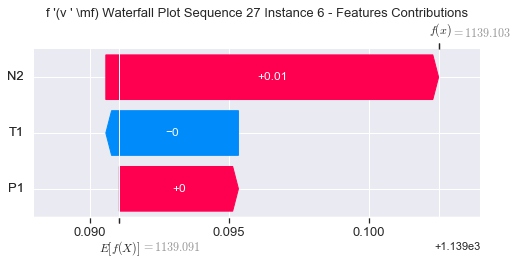

None

Contribution: [ 0.00456034 -0.00425642  0.01288454]


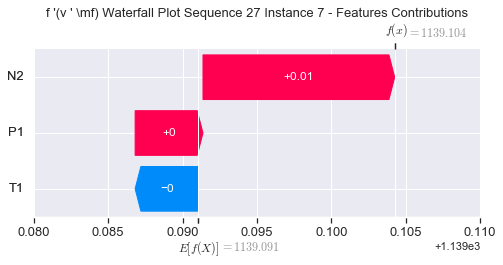

None

Contribution: [ 0.00456215 -0.00426178  0.01317281]


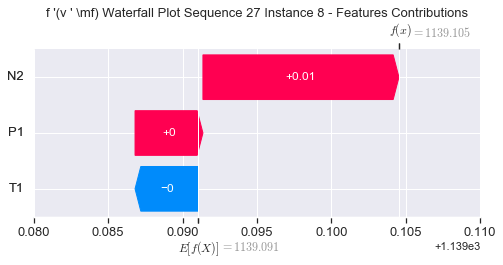

None

Contribution: [ 0.00386143 -0.00354338  0.01342874]


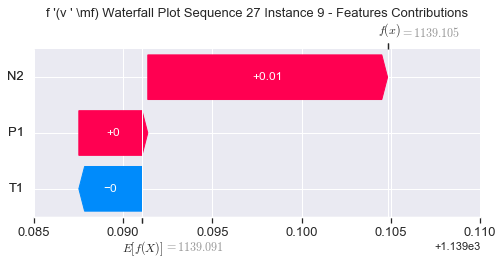

None

Contribution: [ 0.00373204 -0.00362123  0.0138323 ]


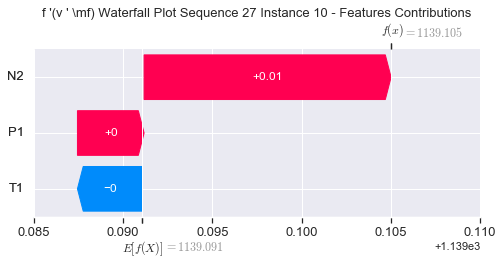

None

Contribution: [ 0.00408023 -0.00430043  0.013989  ]


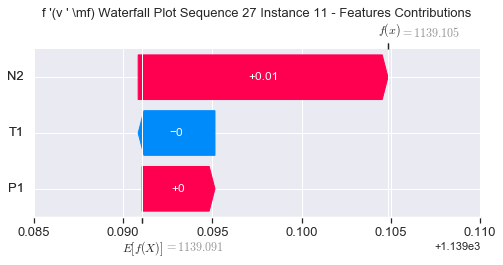

None

Contribution: [ 0.00439744 -0.00541339  0.01371597]


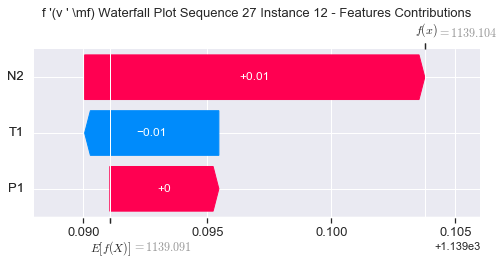

None

Contribution: [ 0.00401985 -0.0048623   0.0122088 ]


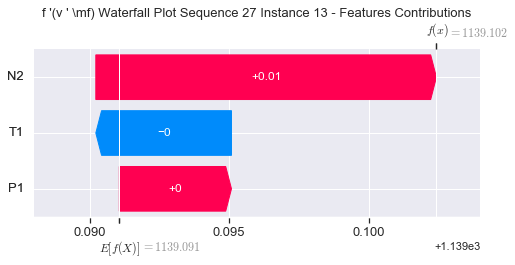

None

Contribution: [ 0.00228979 -0.00558268  0.00698363]


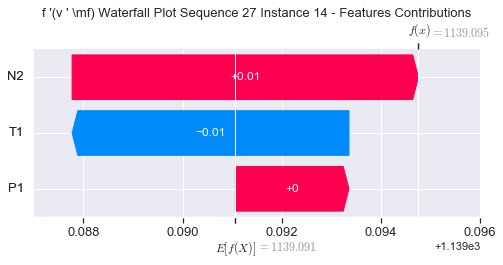

None

Contribution: [-0.00139529 -0.00988916 -0.00510745]


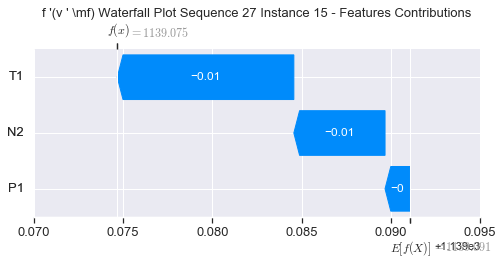

None

Contribution: [-0.00762613 -0.01315342 -0.02355706]


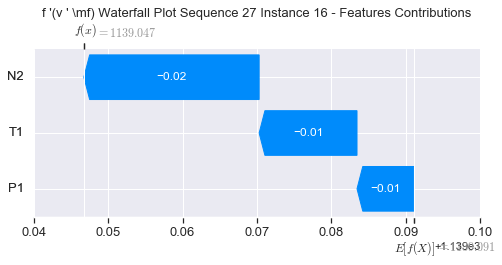

None

Contribution: [-0.01195072 -0.02126106 -0.04124729]


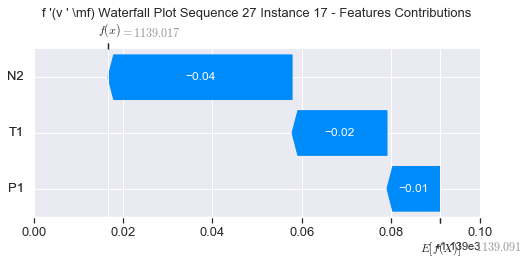

None

Contribution: [-0.00488008 -0.02106267 -0.02071148]


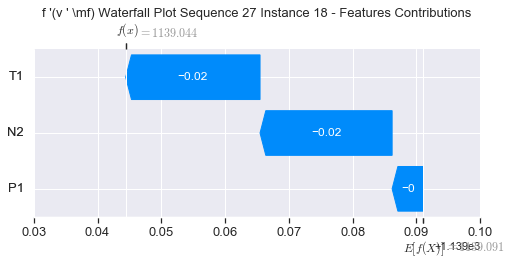

None

Contribution: [ 0.03395776 -0.00877361  0.11983512]


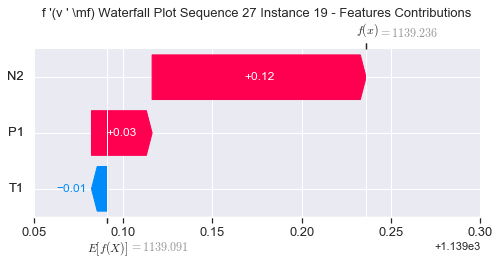

None

Contribution: [0.17129361 0.06829881 0.53340622]


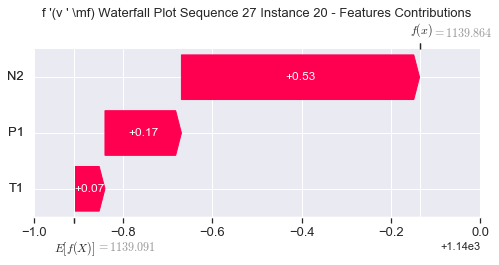

None

Contribution: [0.43646203 0.10068162 1.3919647 ]


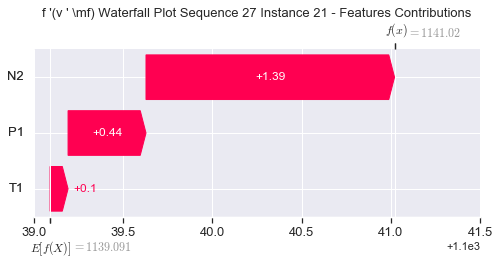

None

Contribution: [ 0.8064697  -0.14477651  2.72379505]


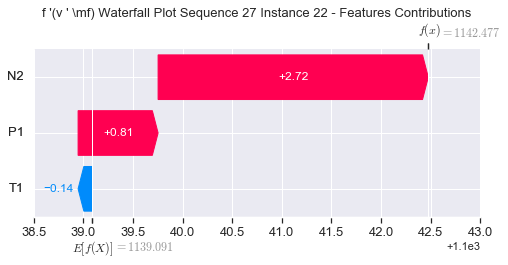

None

Contribution: [ 1.09926328 -1.0483212   4.04895886]


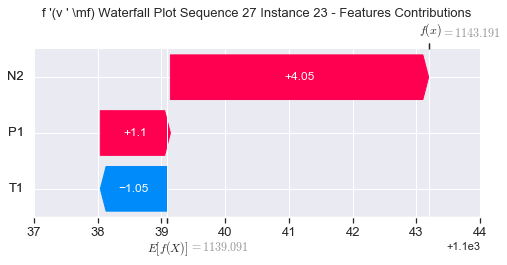

None

Contribution: [ 1.07968569 -2.4518792   3.76703745]


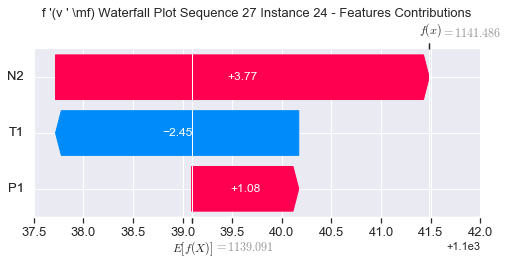

None

Contribution: [ 1.26543387 -2.2757205   5.09834869]


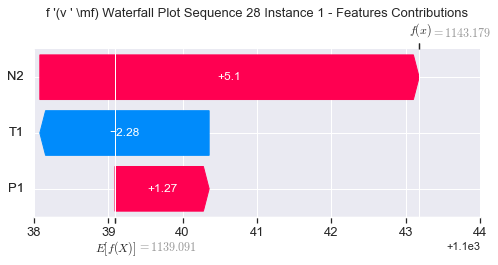

None

Contribution: [-0.17971419  0.39690198 -0.63784006]


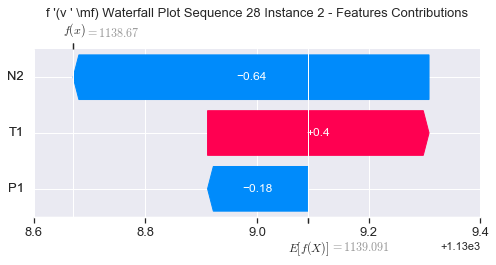

None

Contribution: [ 0.00017524 -0.0064242   0.00499619]


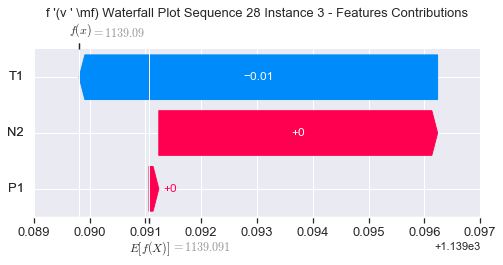

None

Contribution: [ 0.00396939 -0.00557323  0.009207  ]


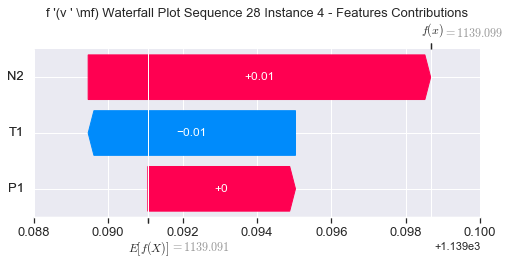

None

Contribution: [ 0.00517149 -0.00421268  0.0109064 ]


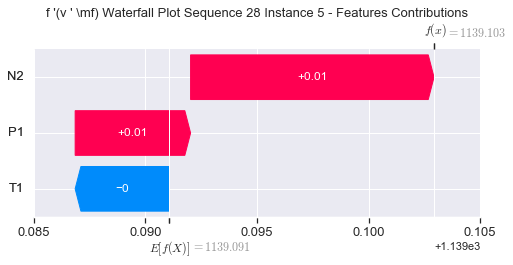

None

Contribution: [ 0.00479993 -0.00175197  0.01193991]


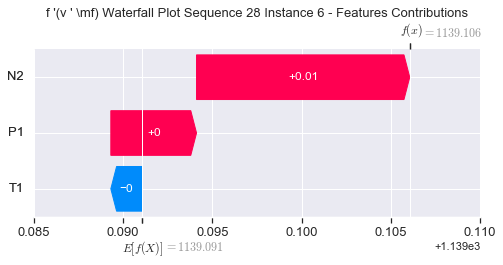

None

Contribution: [ 0.00466175 -0.00045158  0.01295178]


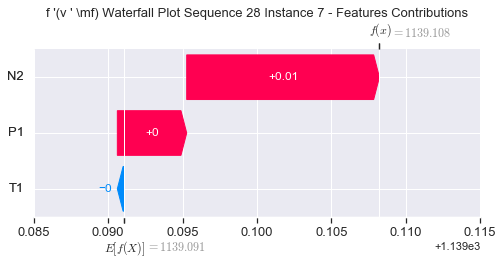

None

Contribution: [ 0.00523518 -0.00187674  0.01330608]


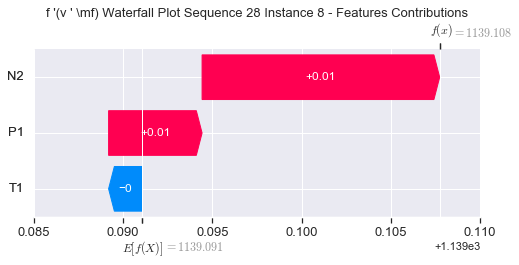

None

Contribution: [0.00450027 0.00151115 0.01421851]


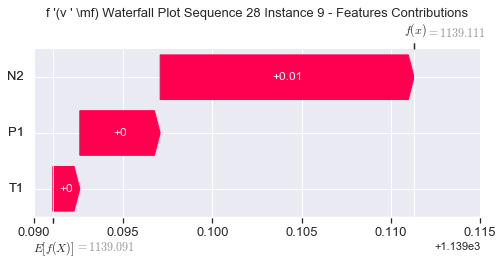

None

Contribution: [0.00566109 0.00097524 0.01463706]


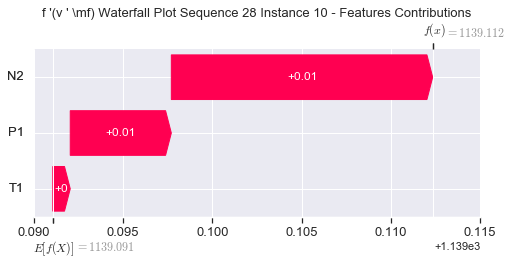

None

Contribution: [ 0.00598339 -0.00238489  0.01454159]


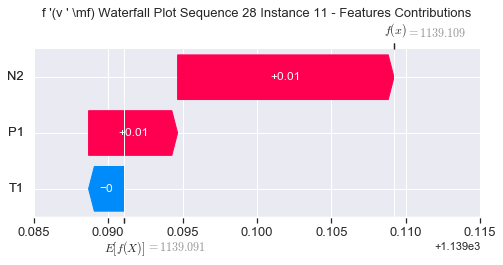

None

Contribution: [ 0.00571819 -0.00463789  0.01416142]


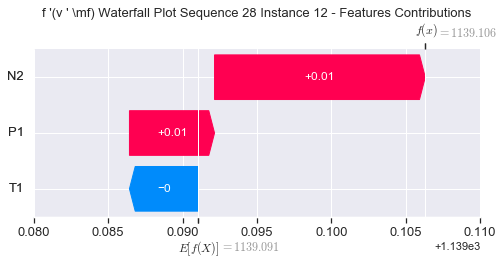

None

Contribution: [ 0.00533228 -0.0044347   0.01267184]


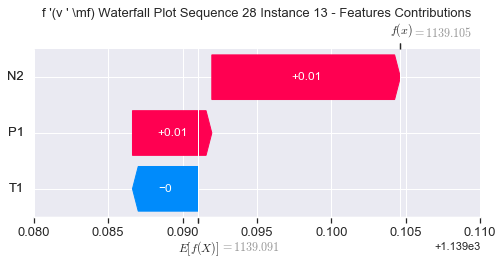

None

Contribution: [ 0.0023473  -0.00762633  0.00684903]


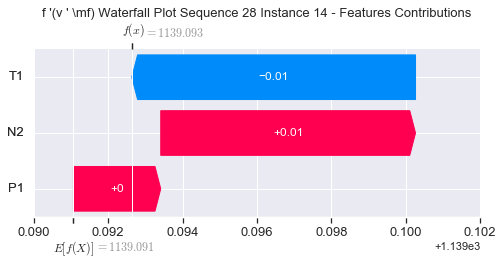

None

Contribution: [ 0.00034334 -0.01266073 -0.00519784]


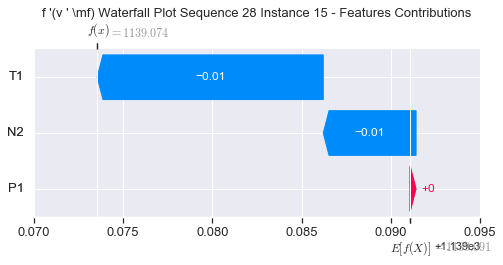

None

Contribution: [-0.00447056 -0.01666068 -0.02378475]


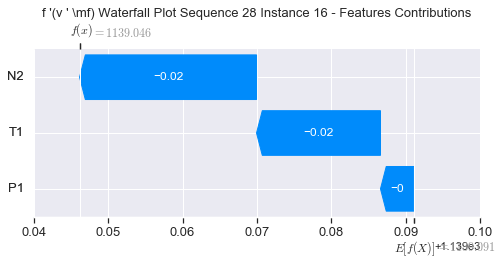

None

Contribution: [-0.00836802 -0.03382287 -0.04170823]


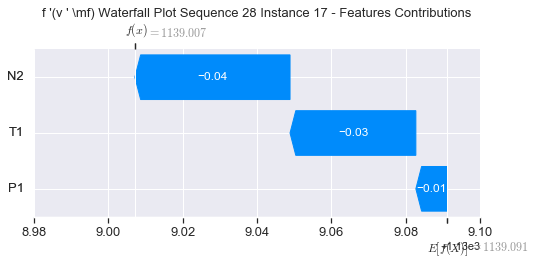

None

Contribution: [ 0.00482298 -0.06016711 -0.01969938]


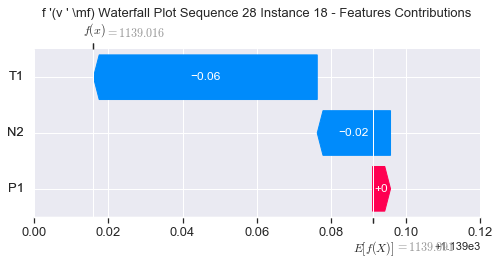

None

Contribution: [ 0.03946    -0.1140331   0.13039968]


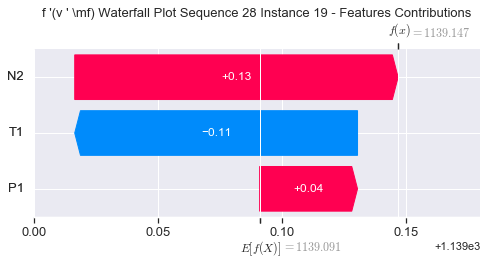

None

Contribution: [ 0.24285302 -0.23299546  0.56142349]


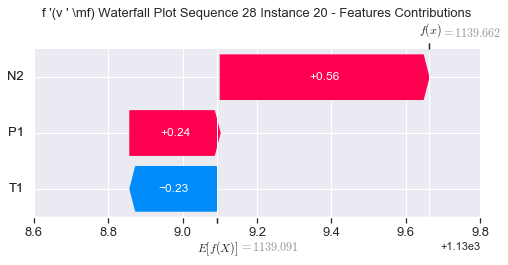

None

Contribution: [ 0.6407885  -0.68028069  1.46167537]


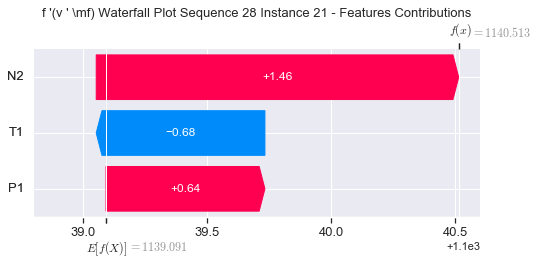

None

Contribution: [ 1.36142731 -2.17120047  2.85978489]


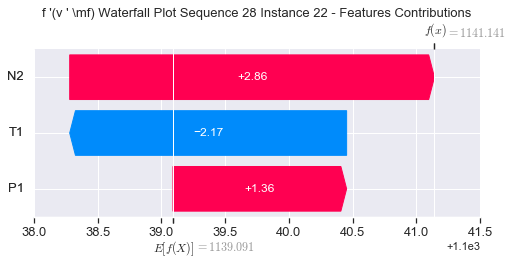

None

Contribution: [ 2.07830218 -5.09607715  4.2189274 ]


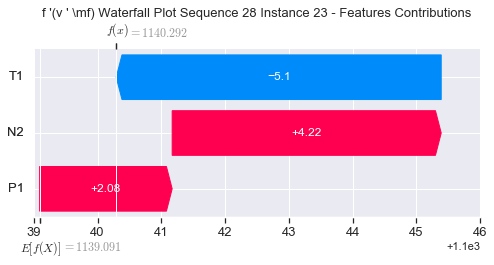

None

Contribution: [ 3.4515195  -9.81426703  4.1641318 ]


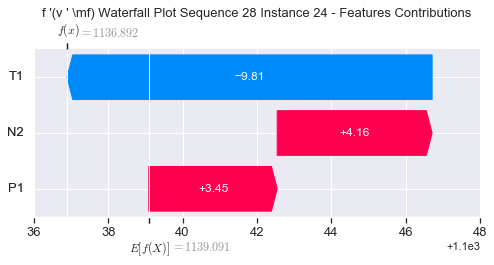

None

Contribution: [  7.66975874 -15.78959286   6.57722498]


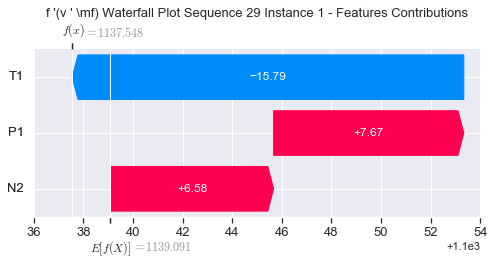

None

Contribution: [-0.52134409  1.38372638 -0.7015021 ]


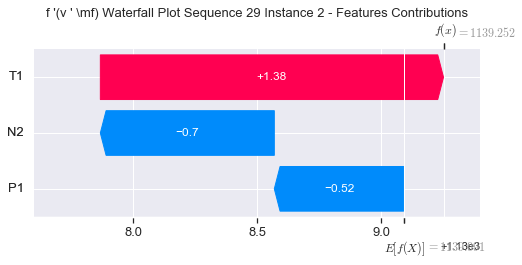

None

Contribution: [ 0.00518388 -0.02092318  0.00542699]


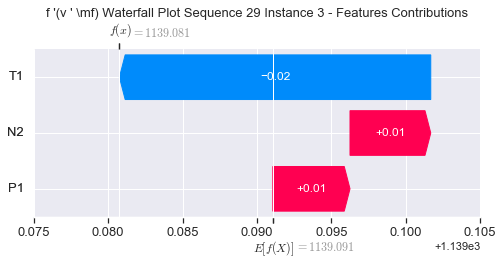

None

Contribution: [ 0.01095748 -0.02630309  0.01047819]


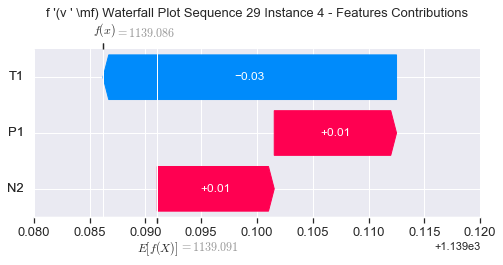

None

Contribution: [ 0.00811249 -0.02298352  0.01093556]


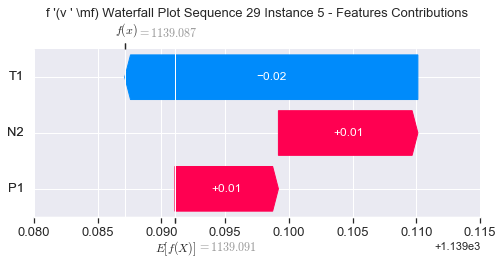

None

Contribution: [ 0.01139622 -0.02403297  0.01294613]


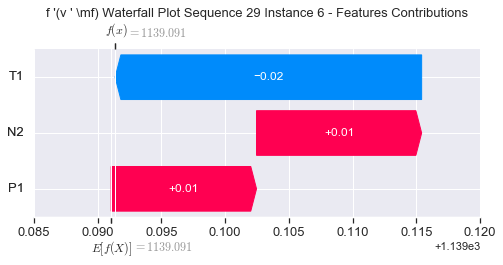

None

Contribution: [ 0.01171044 -0.02422904  0.0138779 ]


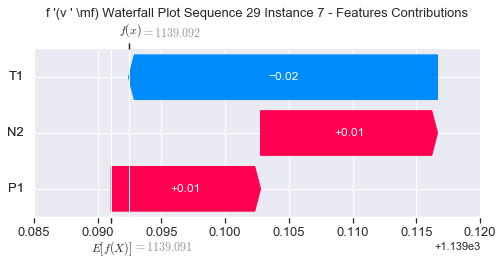

None

Contribution: [ 0.01102492 -0.02279365  0.01413053]


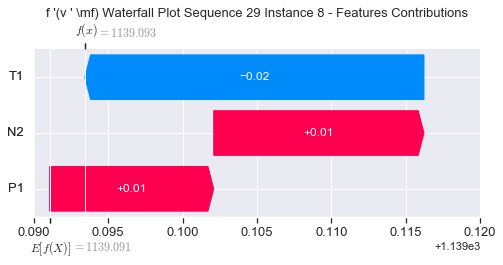

None

Contribution: [ 0.0099959  -0.02407626  0.0141581 ]


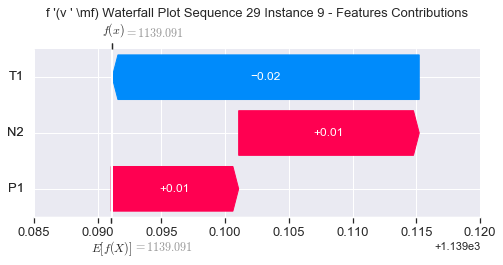

None

Contribution: [ 0.00618738 -0.02308564  0.01409831]


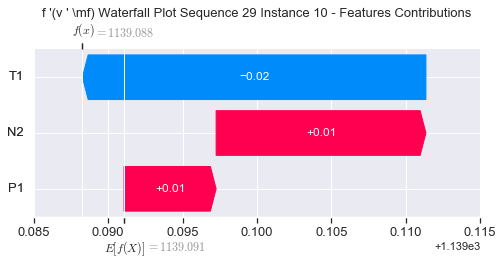

None

Contribution: [ 0.01103714 -0.02342132  0.01545213]


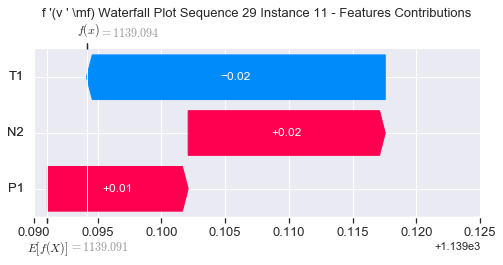

None

Contribution: [ 0.01261922 -0.02567151  0.01549374]


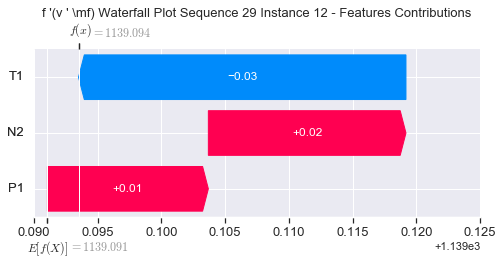

None

Contribution: [ 0.0119725  -0.02593954  0.01376443]


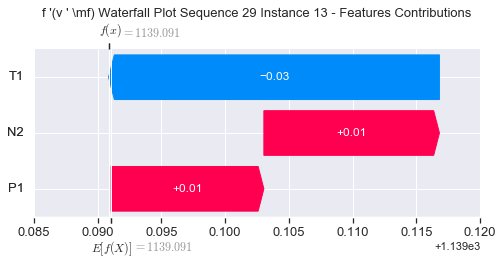

None

Contribution: [ 0.01457258 -0.02931872  0.00847506]


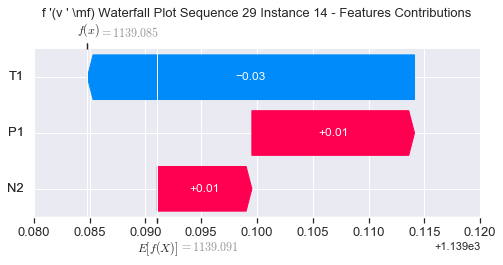

None

Contribution: [ 0.00826261 -0.03862567 -0.0054197 ]


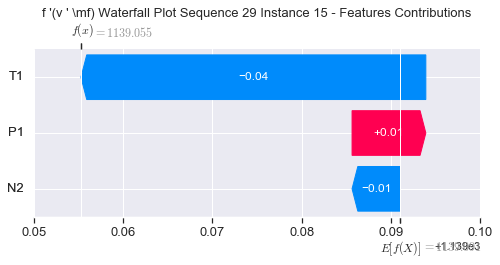

None

Contribution: [ 0.00716129 -0.06786481 -0.02547127]


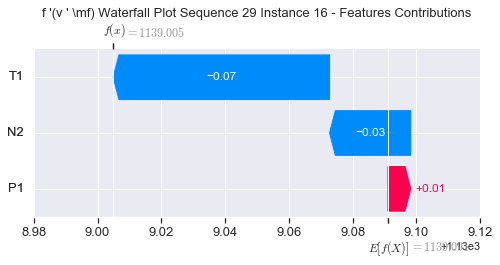

None

Contribution: [ 0.00800585 -0.09302378 -0.04485786]


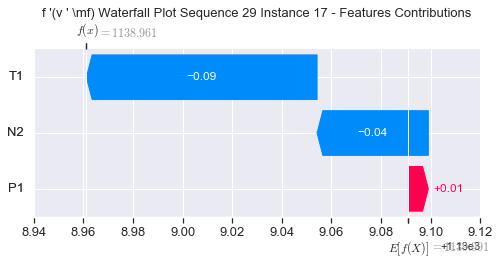

None

Contribution: [ 0.03227081 -0.151559   -0.02101464]


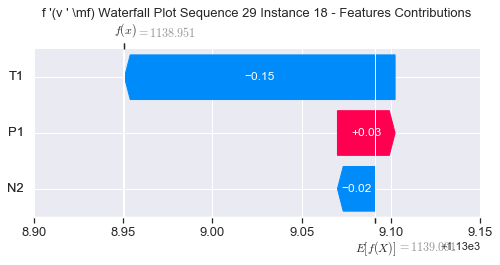

None

Contribution: [ 0.06807915 -0.17326498  0.12262293]


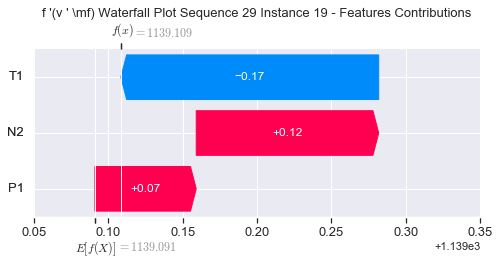

None

Contribution: [ 0.25997161 -0.39560724  0.56579007]


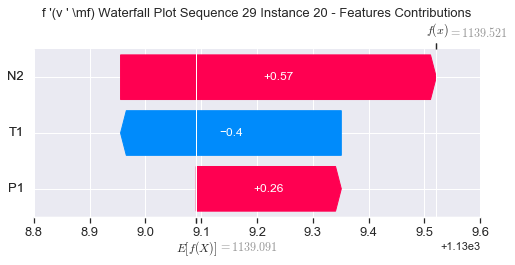

None

Contribution: [ 0.60124328 -0.81568945  1.47253099]


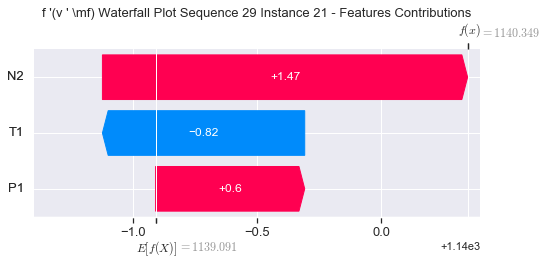

None

Contribution: [ 1.00125683 -1.68628461  2.85862472]


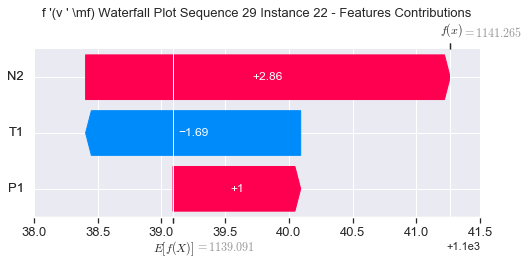

None

Contribution: [ 1.55405996 -3.87413072  4.2963186 ]


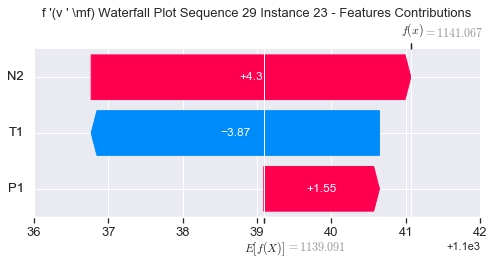

None

Contribution: [ 1.09115039 -4.89757859  3.99699257]


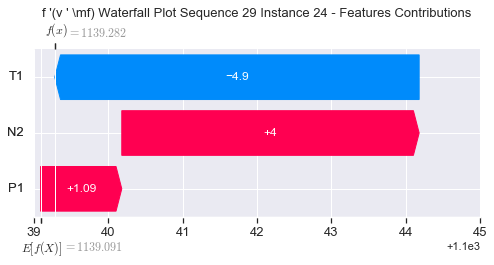

None

Contribution: [ 1.38638655 -4.20204625  5.60082446]


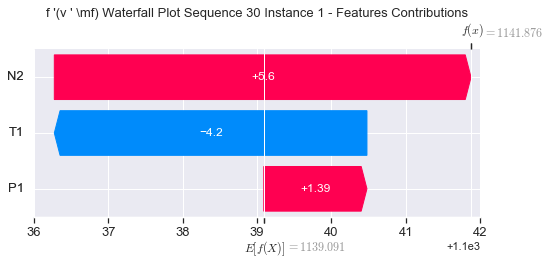

None

Contribution: [-0.16046474  0.70351147 -0.64871731]


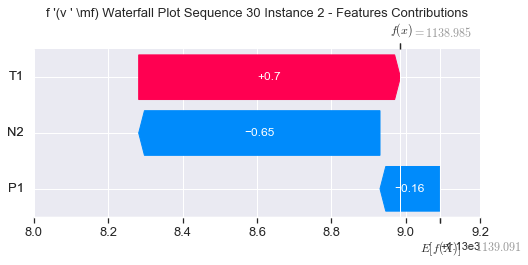

None

Contribution: [ 0.00092846 -0.0103352   0.00516002]


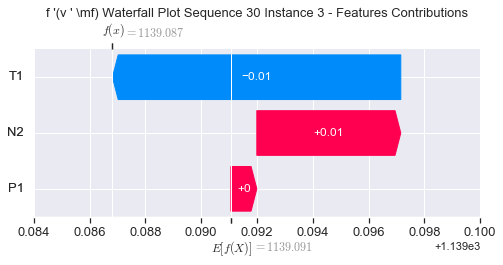

None

Contribution: [ 0.00013619 -0.01337564  0.00882687]


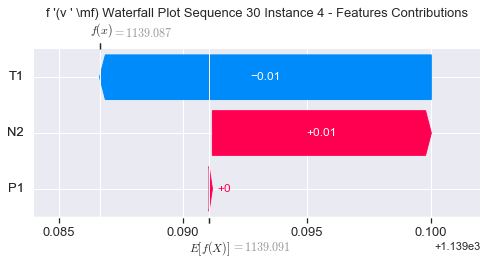

None

Contribution: [ 0.00410064 -0.00454829  0.01088525]


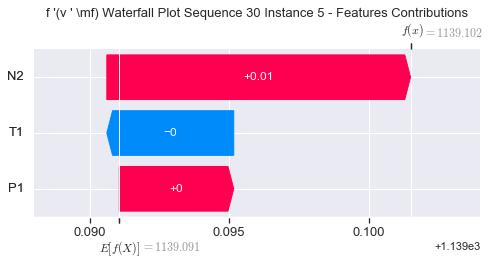

None

Contribution: [ 0.00421213 -0.00477873  0.01207365]


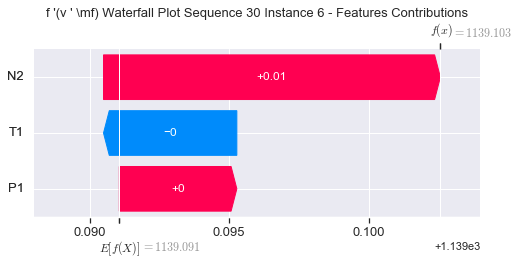

None

Contribution: [ 0.00446386 -0.00449365  0.01295304]


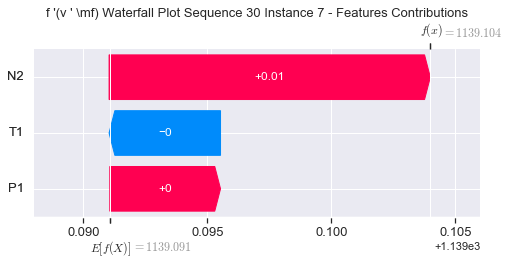

None

Contribution: [ 0.0045447  -0.00429579  0.01327002]


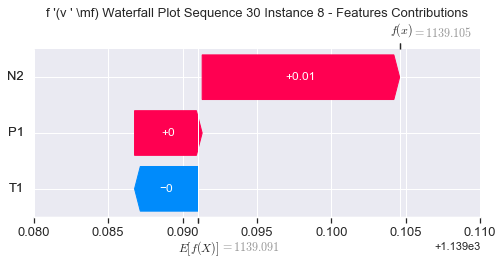

None

Contribution: [ 0.00421655 -0.00285659  0.01345479]


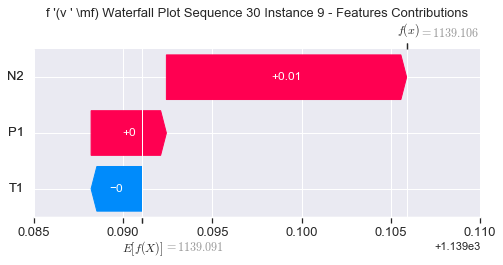

None

Contribution: [ 0.00433893 -0.00367466  0.0140675 ]


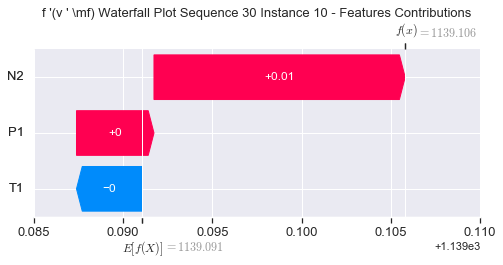

None

Contribution: [ 0.00408368 -0.00323161  0.01424664]


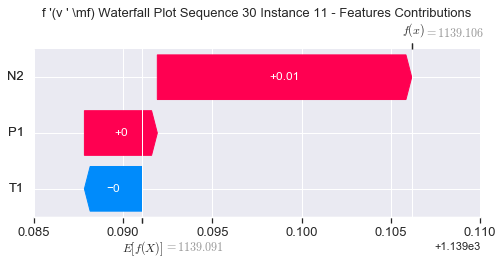

None

Contribution: [ 0.00425077 -0.00566351  0.01403857]


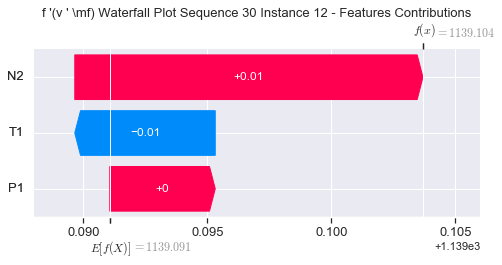

None

Contribution: [ 0.00394372 -0.00528808  0.01245696]


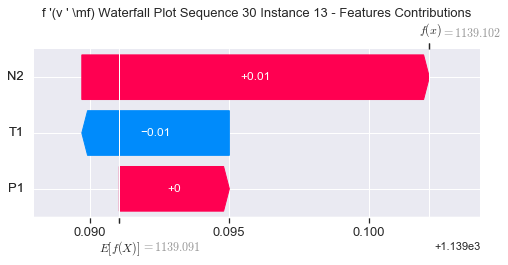

None

Contribution: [ 0.00240251 -0.00872347  0.0066684 ]


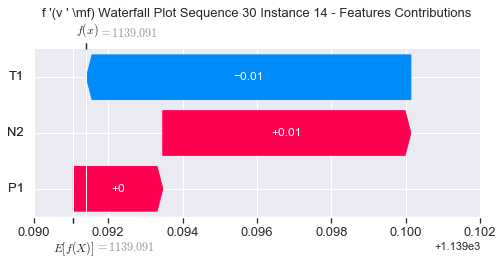

None

Contribution: [-0.00175439 -0.01133967 -0.00514152]


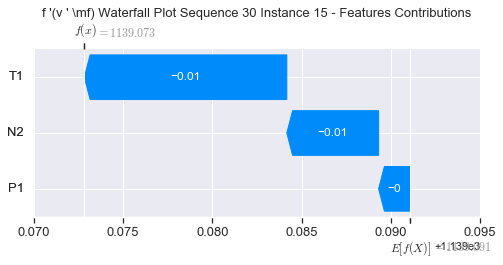

None

Contribution: [-0.00738063 -0.01706932 -0.02356514]


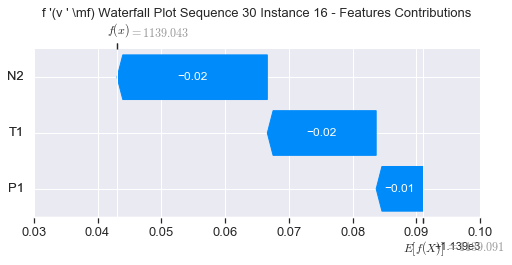

None

Contribution: [-0.01368254 -0.02791433 -0.04212751]


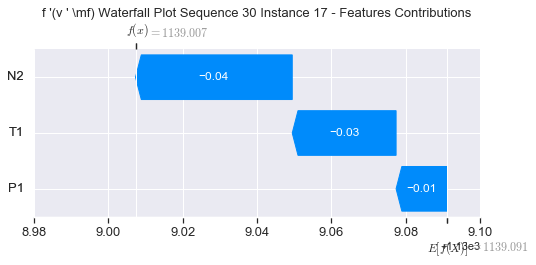

None

Contribution: [-0.00885085 -0.03681055 -0.02158486]


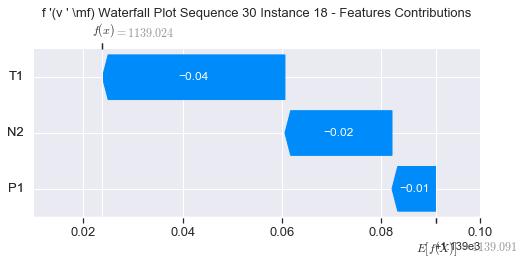

None

Contribution: [ 0.03493945 -0.01519564  0.12469058]


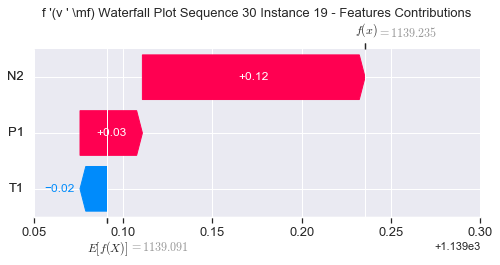

None

Contribution: [ 0.15912065 -0.01300598  0.53478327]


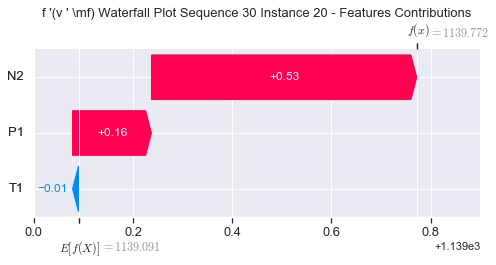

None

Contribution: [ 0.41732342 -0.06453904  1.4011443 ]


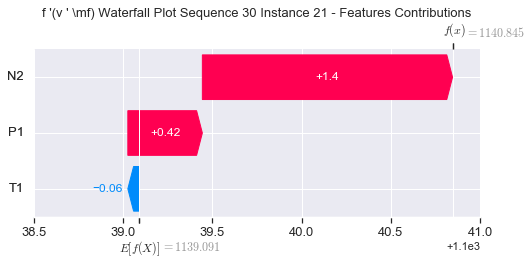

None

Contribution: [ 0.78551837 -0.43723936  2.75570926]


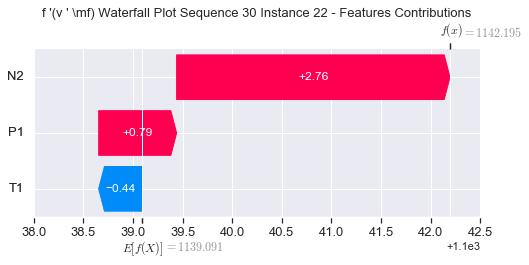

None

Contribution: [ 0.96708289 -1.78690639  4.07447202]


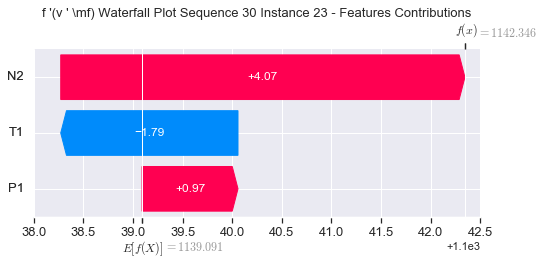

None

Contribution: [ 1.17962335 -3.30121317  3.8855235 ]


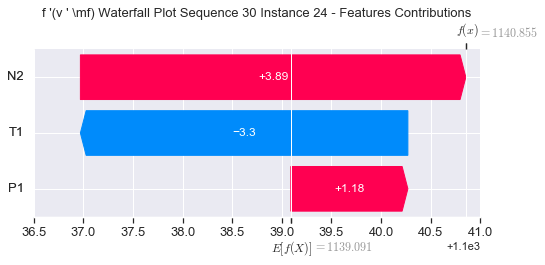

None

Contribution: [ 2.31074351 -2.7980634   5.54987504]


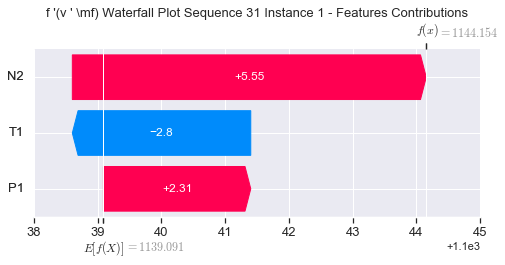

None

Contribution: [-0.19706763  0.44559201 -0.64816703]


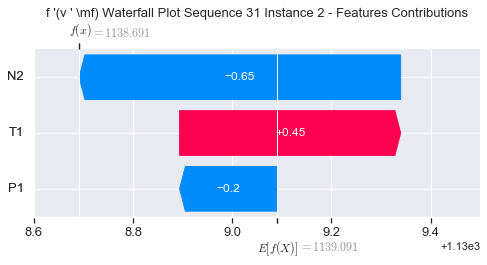

None

Contribution: [ 0.00091775 -0.0058519   0.00586974]


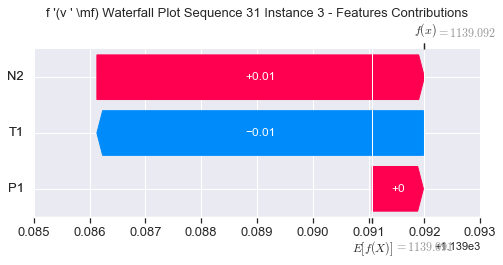

None

Contribution: [ 0.00238787 -0.00530727  0.00947286]


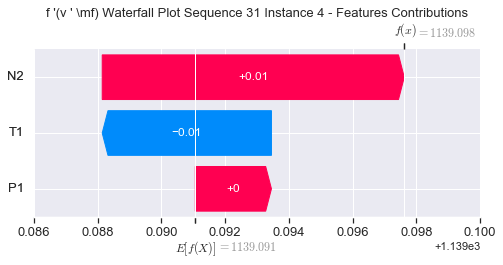

None

Contribution: [ 0.00412917 -0.00432636  0.0116441 ]


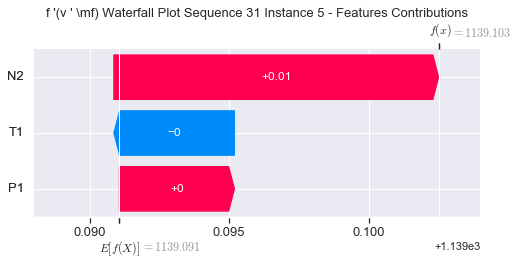

None

Contribution: [ 0.0037311  -0.00406908  0.01248012]


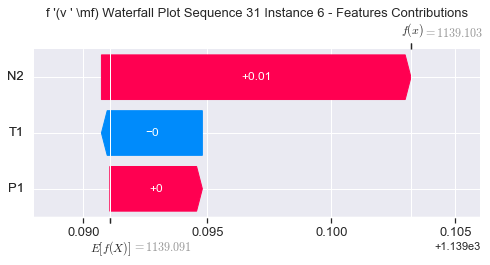

None

Contribution: [ 0.0041437  -0.00380955  0.01336207]


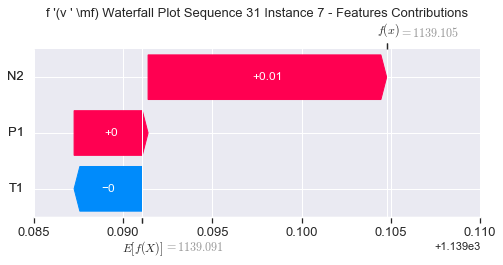

None

Contribution: [ 0.00444281 -0.00373058  0.01371395]


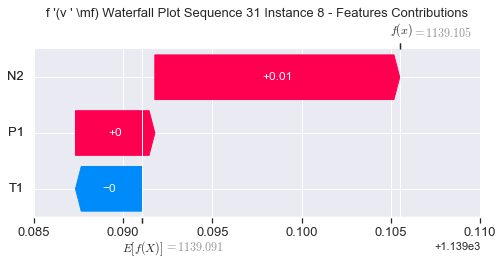

None

Contribution: [ 0.00539651 -0.00340513  0.01408399]


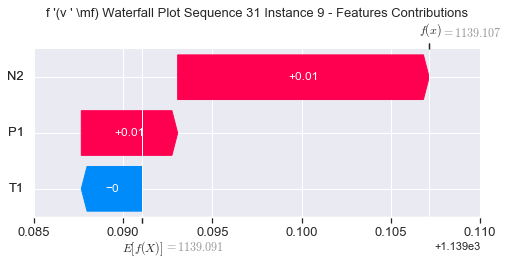

None

Contribution: [ 0.00449381 -0.00220503  0.01427864]


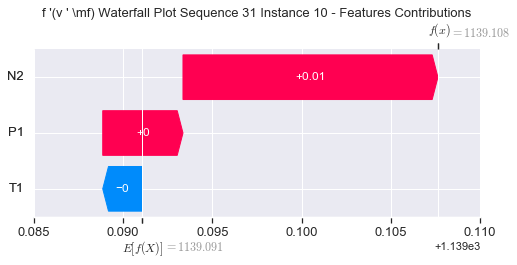

None

Contribution: [ 0.00493982 -0.00310304  0.01457937]


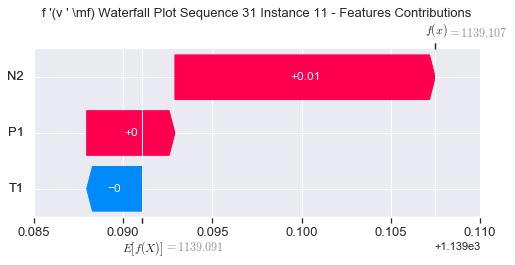

None

Contribution: [ 0.00410326 -0.00466673  0.0140896 ]


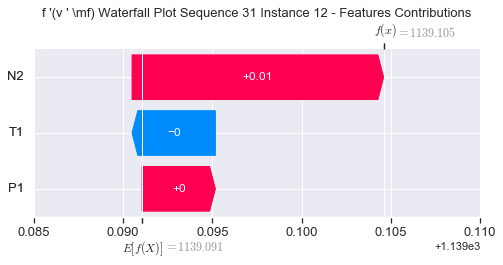

None

Contribution: [ 0.00393667 -0.00442793  0.01261243]


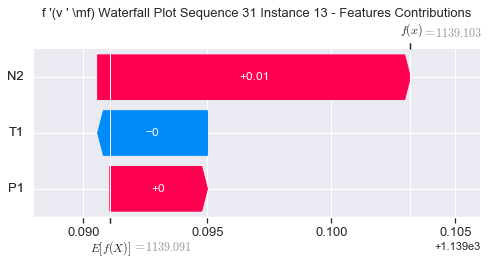

None

Contribution: [ 0.00203356 -0.00787863  0.00732747]


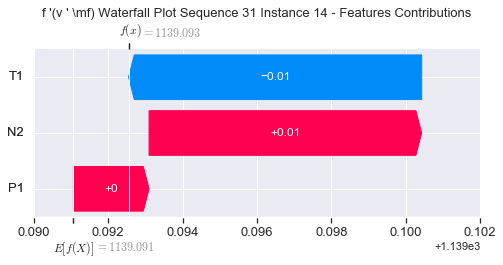

None

Contribution: [-0.00170918 -0.01008256 -0.00459407]


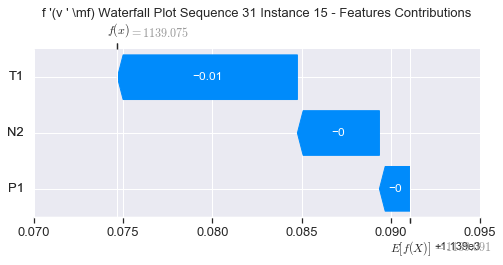

None

Contribution: [-0.00747583 -0.01226295 -0.02210096]


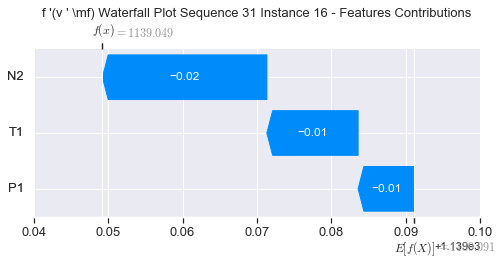

None

Contribution: [-0.01244122 -0.02488924 -0.03991504]


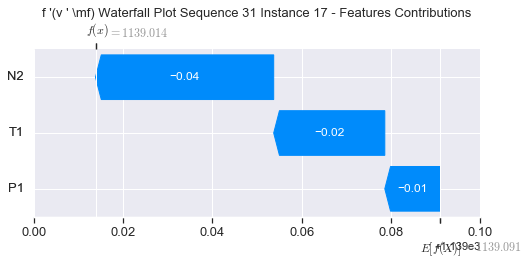

None

Contribution: [-0.00659513 -0.03104478 -0.01839807]


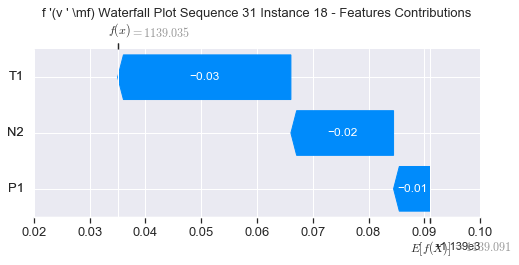

None

Contribution: [ 0.02546726 -0.03014956  0.13232446]


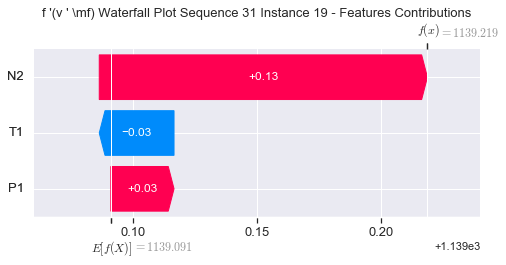

None

Contribution: [ 0.18343862 -0.00190422  0.54593173]


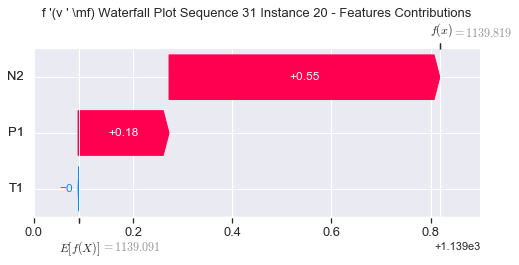

None

Contribution: [ 0.47777036 -0.04182216  1.41981434]


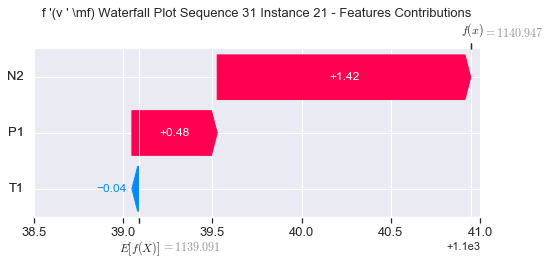

None

Contribution: [ 0.92473843 -0.39582046  2.79197393]


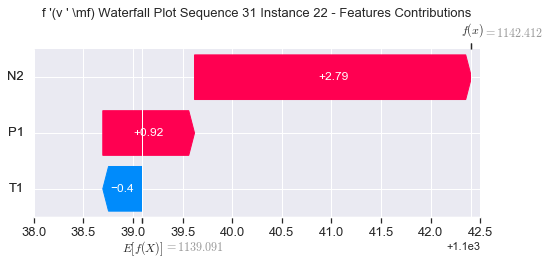

None

Contribution: [ 1.19800604 -1.66322143  4.12852618]


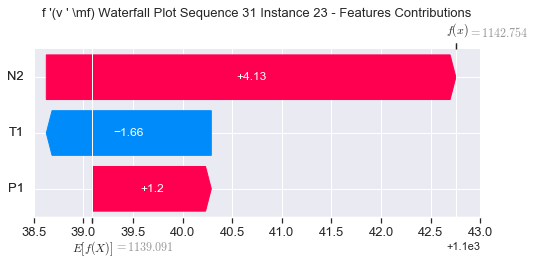

None

Contribution: [ 1.2070202  -3.7355815   3.91641302]


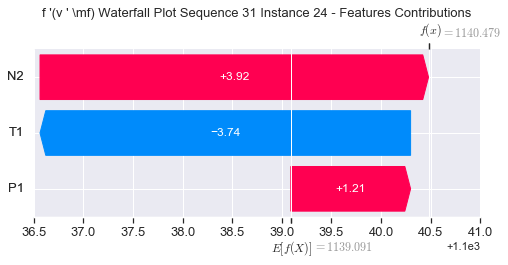

None

Contribution: [ 1.23236    -5.42080416  5.28415785]


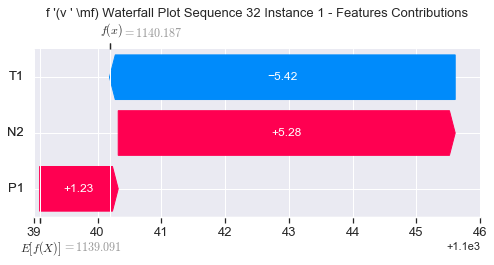

None

Contribution: [-0.2875416   0.47078725 -0.67445041]


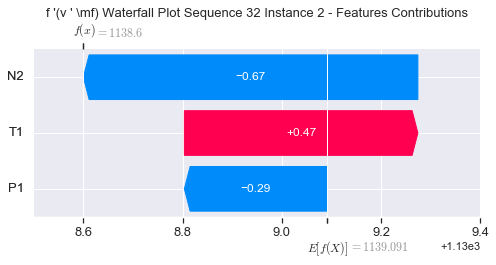

None

Contribution: [ 0.00025958 -0.00707917  0.00536389]


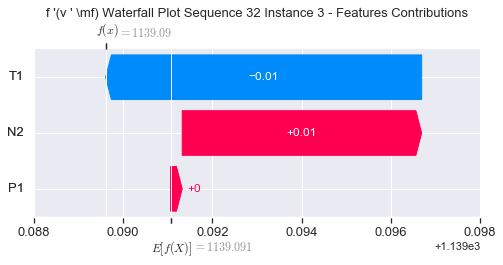

None

Contribution: [ 0.00350666 -0.00672149  0.01039069]


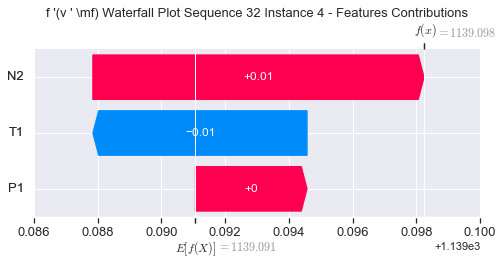

None

Contribution: [ 0.00500672 -0.00527844  0.01231794]


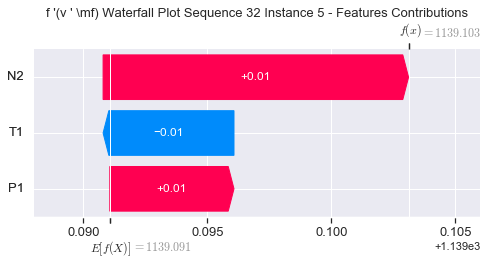

None

Contribution: [ 0.00507616 -0.00522833  0.01328557]


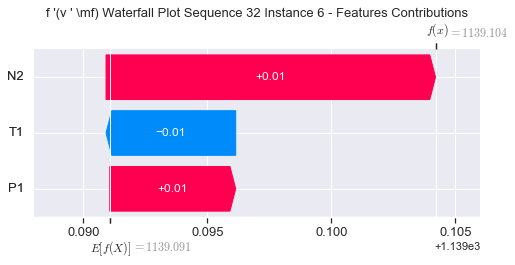

None

Contribution: [ 0.00527294 -0.00489078  0.01417709]


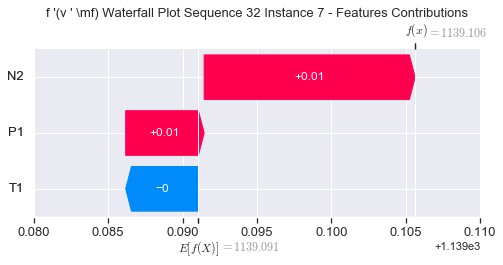

None

Contribution: [ 0.00518682 -0.00486286  0.01437048]


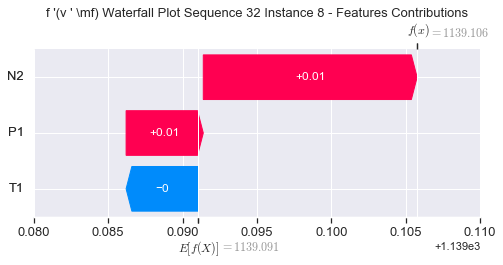

None

Contribution: [ 0.00330242 -0.00388128  0.01375319]


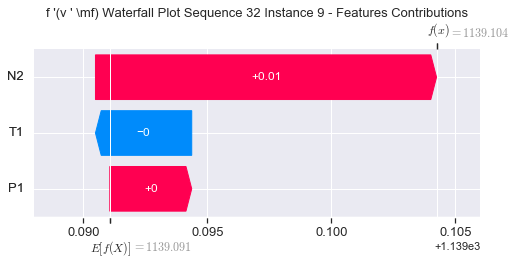

None

Contribution: [ 0.00239414 -0.00354106  0.01353508]


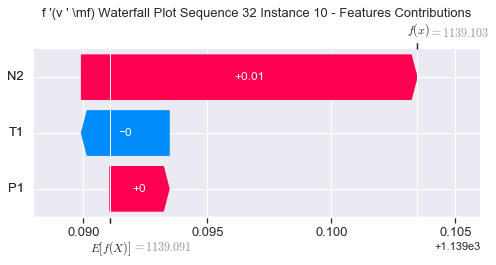

None

Contribution: [ 0.00376911 -0.00399021  0.01448428]


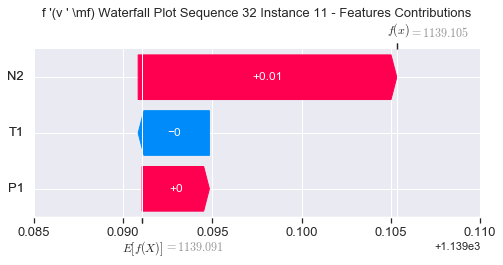

None

Contribution: [ 0.00556208 -0.00495649  0.01527657]


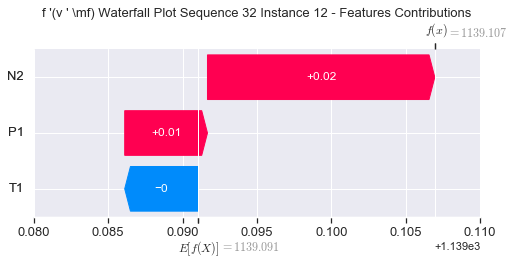

None

Contribution: [ 0.0051347  -0.00484032  0.01381917]


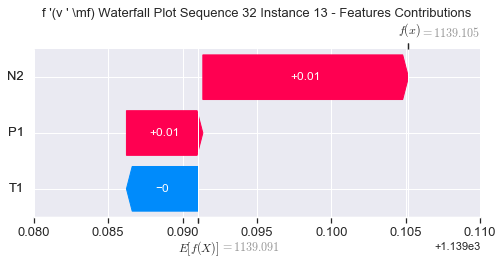

None

Contribution: [ 0.00259756 -0.00449175  0.00830388]


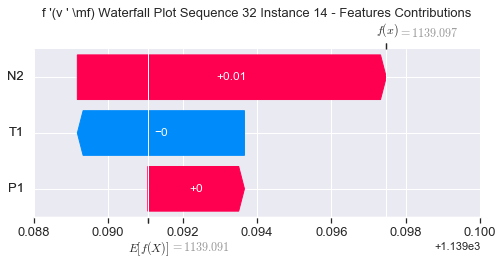

None

Contribution: [-0.00071276 -0.01210048 -0.00380601]


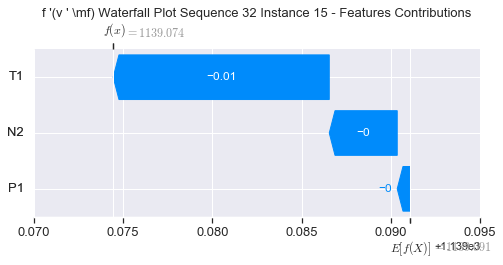

None

Contribution: [-0.00944116 -0.02053975 -0.02319641]


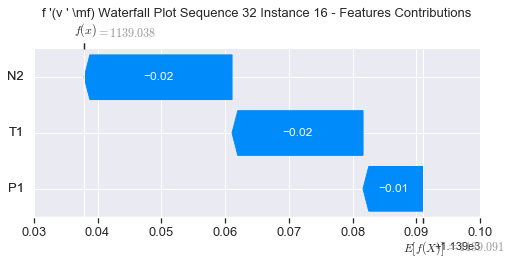

None

Contribution: [-0.01178955 -0.03149577 -0.0396559 ]


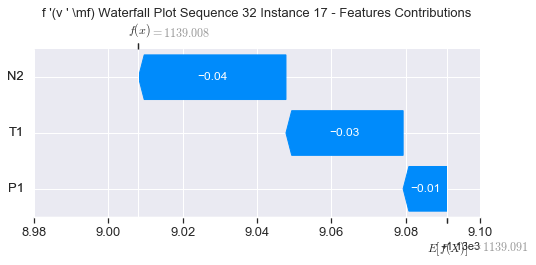

None

Contribution: [-0.00492573 -0.04671272 -0.01526861]


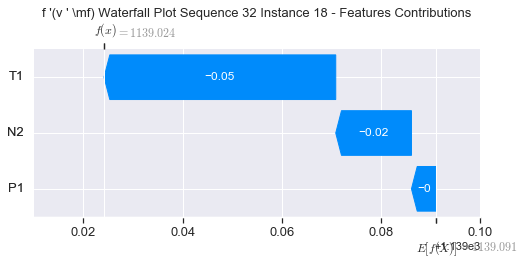

None

Contribution: [-0.00261111 -0.10992292  0.12641473]


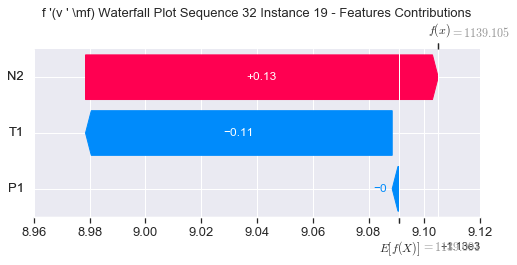

None

Contribution: [ 0.17162513 -0.10165887  0.58176791]


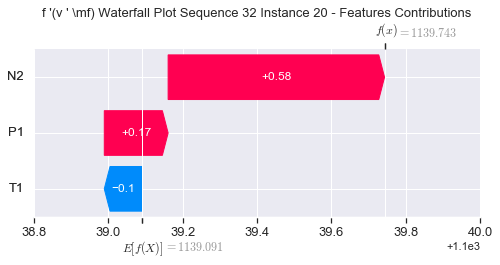

None

Contribution: [ 0.45700232 -0.24257648  1.51133104]


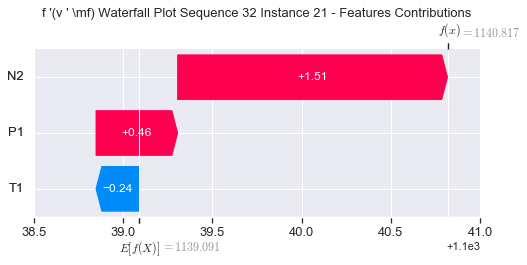

None

Contribution: [ 0.87226844 -0.8596945   2.98173535]


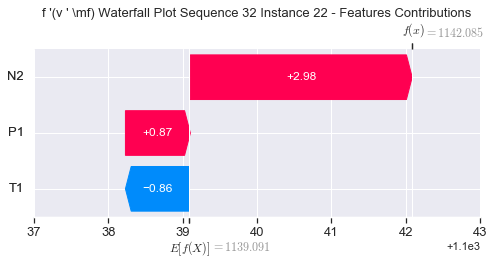

None

Contribution: [ 1.12656038 -2.58934607  4.47690464]


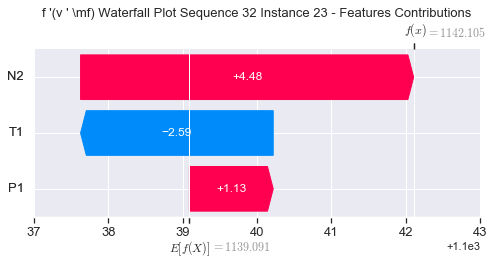

None

Contribution: [ 1.1817139  -4.73501775  4.37305534]


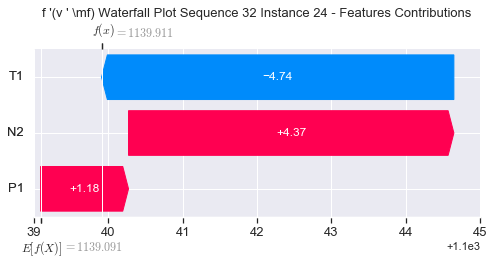

None

Contribution: [ 1.74738291 -4.85389194  6.06777905]


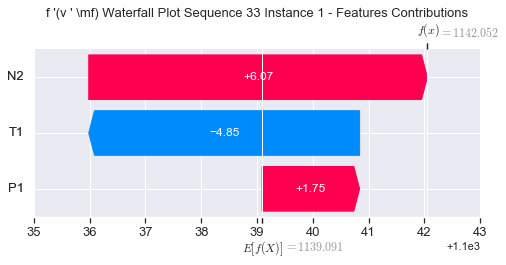

None

Contribution: [-0.24637265  0.58625731 -0.7387249 ]


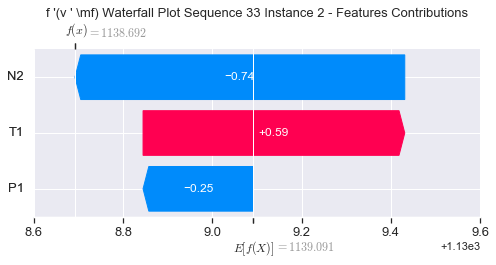

None

Contribution: [ 9.77773990e-05 -9.27965560e-03  5.99050979e-03]


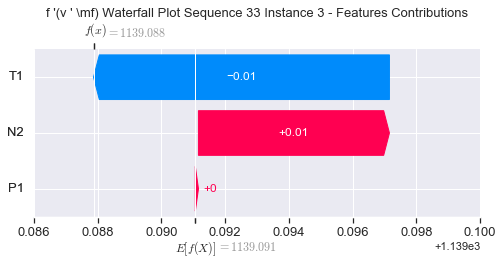

None

Contribution: [ 0.00380666 -0.00588911  0.01069612]


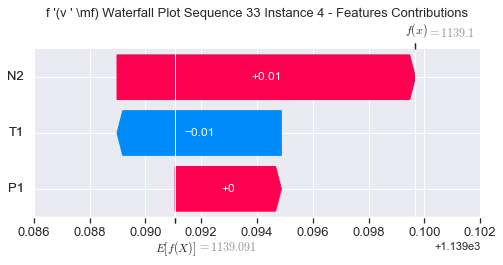

None

Contribution: [ 0.00307679 -0.00725618  0.01180683]


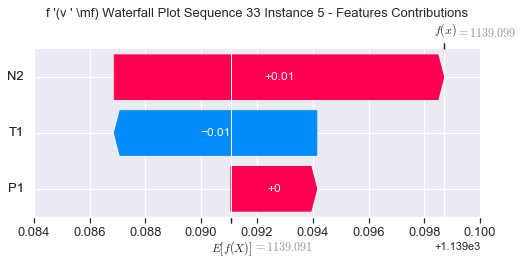

None

Contribution: [ 0.00438771 -0.00637081  0.01298228]


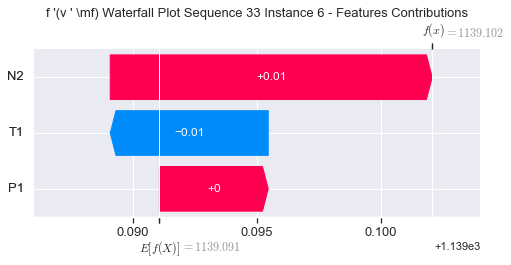

None

Contribution: [ 0.00435199 -0.0065527   0.01375973]


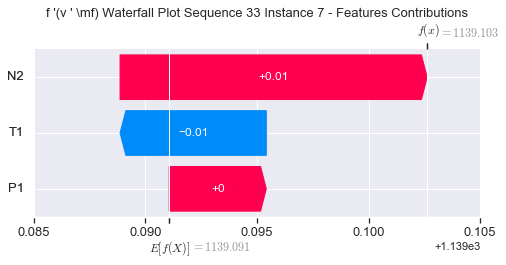

None

Contribution: [ 0.00429467 -0.00649041  0.01403153]


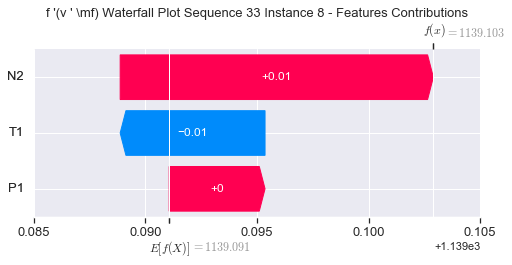

None

Contribution: [ 0.0019482  -0.00663235  0.01387388]


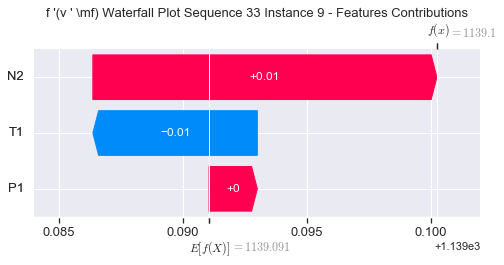

None

Contribution: [ 0.00258498 -0.00510155  0.01385616]


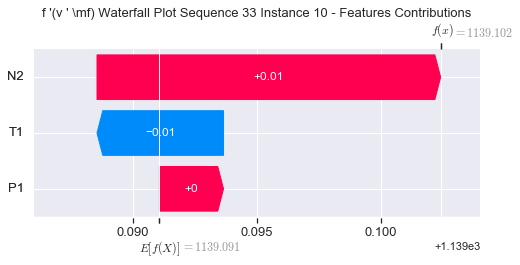

None

Contribution: [ 0.00353846 -0.00576282  0.01496723]


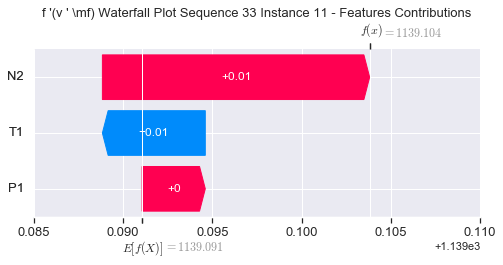

None

Contribution: [ 0.00482078 -0.008639    0.01461387]


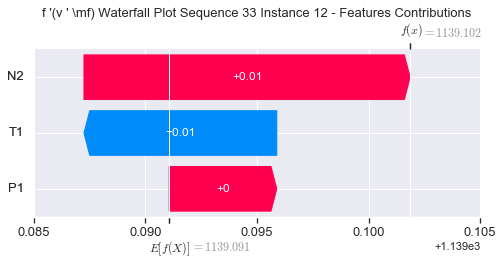

None

Contribution: [ 0.00404483 -0.00887696  0.01291886]


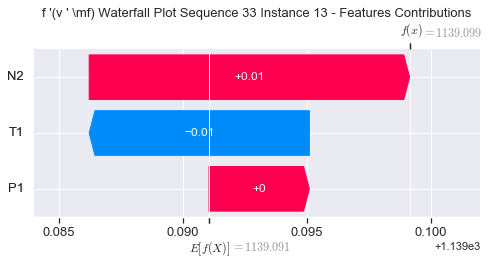

None

Contribution: [ 0.00201021 -0.01174656  0.00672139]


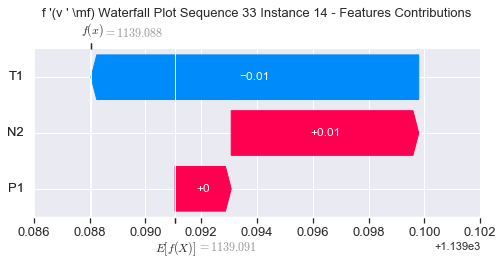

None

Contribution: [-0.0019292  -0.01736984 -0.00571347]


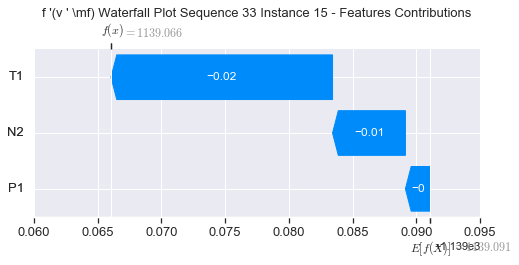

None

Contribution: [-0.01070097 -0.02496352 -0.02666219]


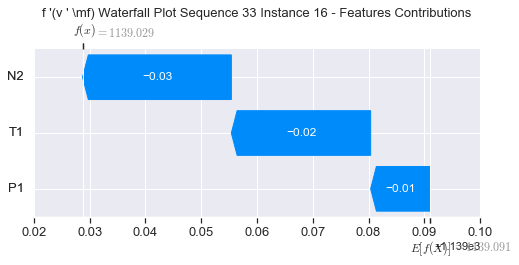

None

Contribution: [-0.01565726 -0.04706766 -0.04505708]


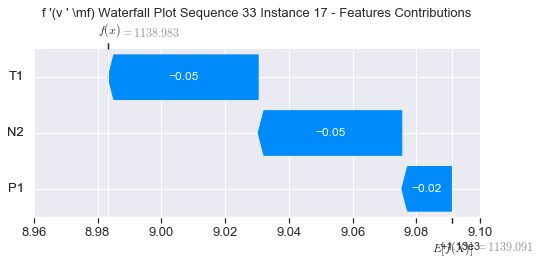

None

Contribution: [-0.01105991 -0.07598203 -0.0240297 ]


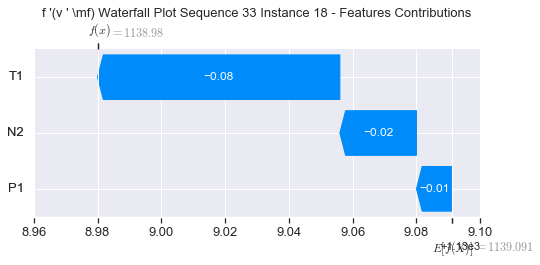

None

Contribution: [ 0.00303415 -0.1309241   0.11810501]


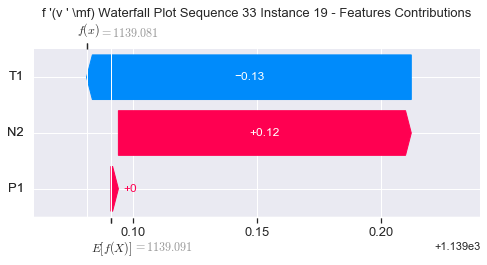

None

Contribution: [ 0.12441072 -0.23896746  0.54655618]


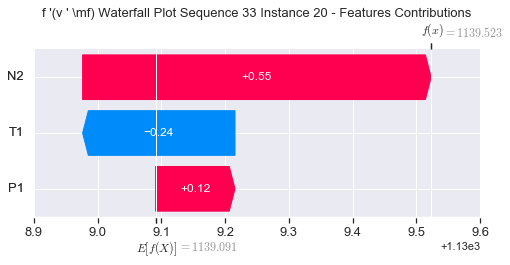

None

Contribution: [ 0.34600251 -0.57757121  1.42587551]


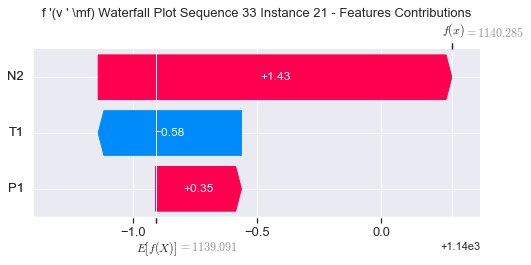

None

Contribution: [ 0.64062605 -1.55509636  2.78134427]


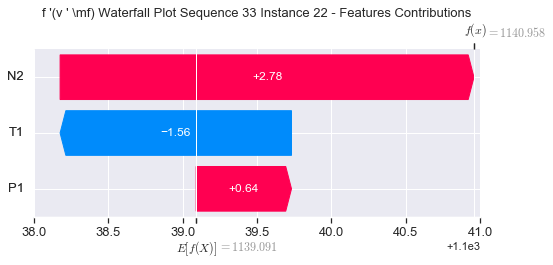

None

Contribution: [ 0.80232943 -3.75431343  4.0707828 ]


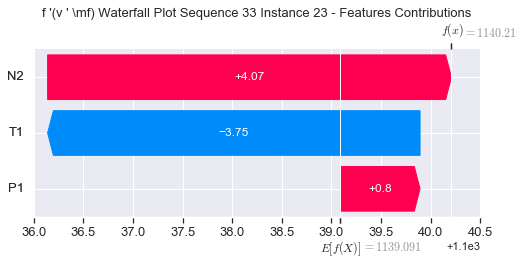

None

Contribution: [ 0.83392518 -5.97236085  3.85993354]


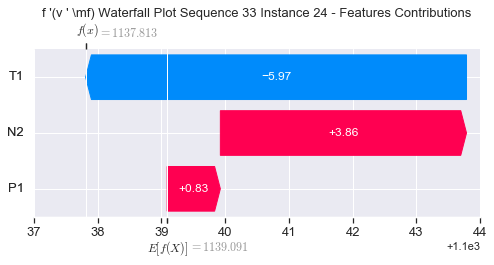

None

Contribution: [ 1.71313878 -6.69592951  5.59556359]


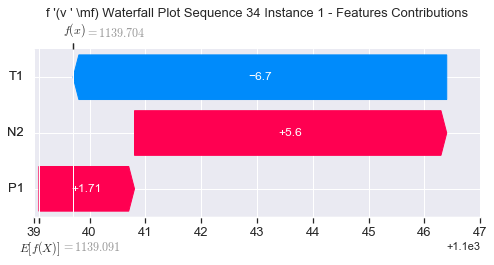

None

Contribution: [-0.11718969  0.94948684 -0.63068006]


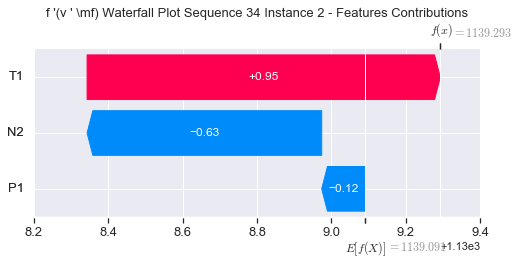

None

Contribution: [ 0.00033596 -0.0130445   0.00494331]


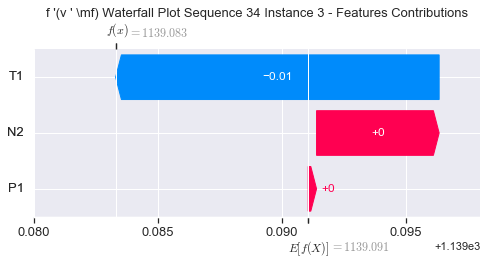

None

Contribution: [ 0.00195769 -0.01353518  0.00904988]


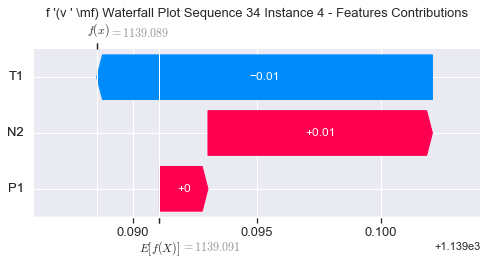

None

Contribution: [ 0.00233858 -0.01120402  0.0103261 ]


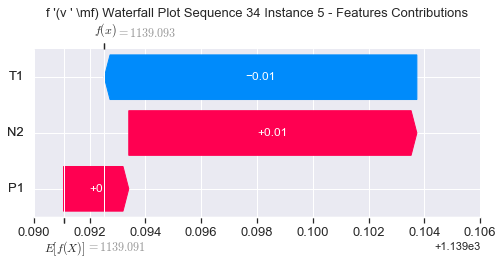

None

Contribution: [ 0.00283175 -0.01014504  0.01181264]


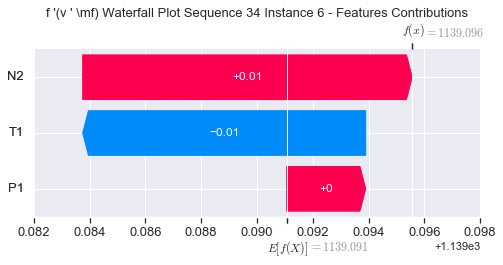

None

Contribution: [ 0.00310143 -0.00983756  0.01281492]


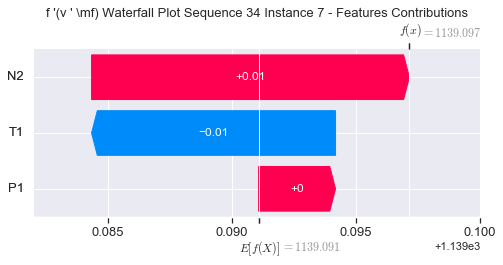

None

Contribution: [ 0.00294507 -0.00997608  0.01314615]


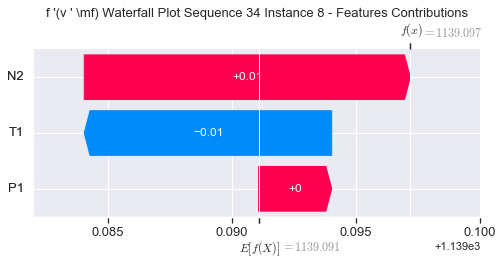

None

Contribution: [ 0.00135246 -0.01017012  0.01358437]


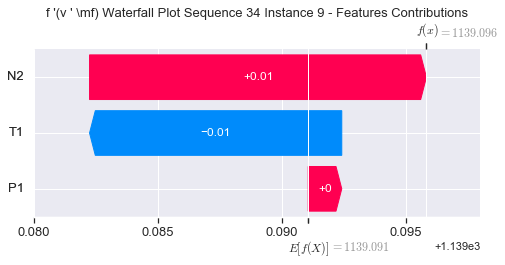

None

Contribution: [ 0.00085507 -0.01045267  0.01408787]


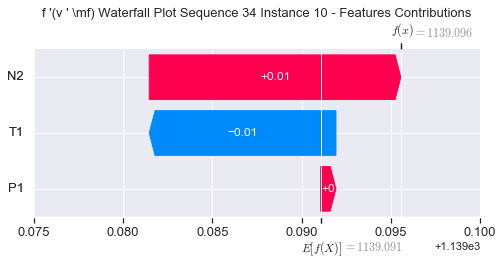

None

Contribution: [ 0.00106306 -0.00993098  0.01446067]


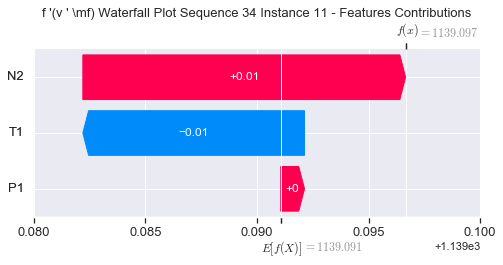

None

Contribution: [ 0.0020621  -0.01072173  0.01430926]


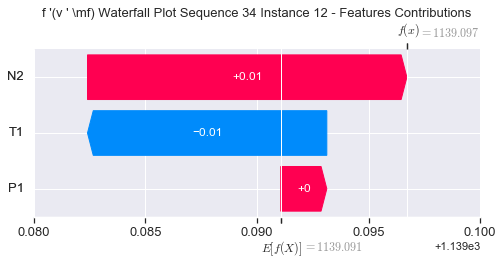

None

Contribution: [ 0.00160738 -0.01110654  0.0126029 ]


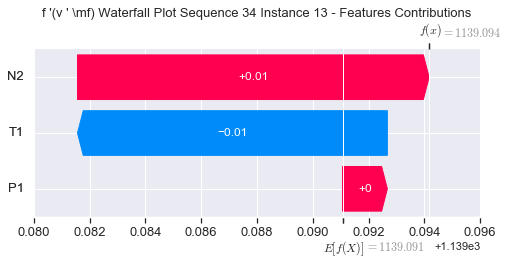

None

Contribution: [-0.00278413 -0.0150876   0.00649743]


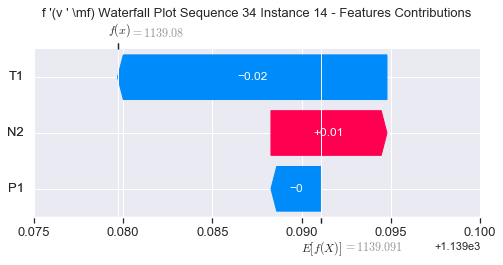

None

Contribution: [-0.00518377 -0.02080605 -0.00690657]


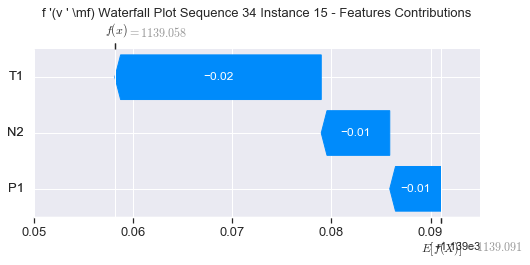

None

Contribution: [-0.01175835 -0.03643487 -0.02669839]


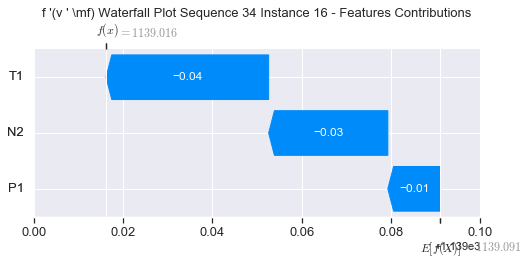

None

Contribution: [-0.02252363 -0.05554323 -0.04788522]


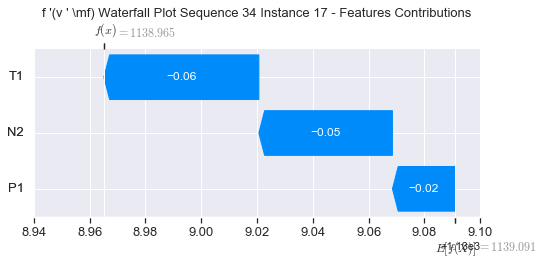

None

Contribution: [-0.02423223 -0.09315696 -0.02700401]


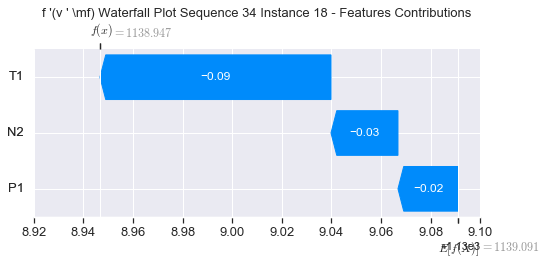

None

Contribution: [-0.02493473 -0.19003474  0.12132956]


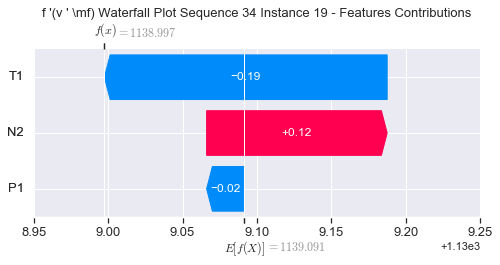

None

Contribution: [ 0.11041747 -0.30938506  0.55460532]


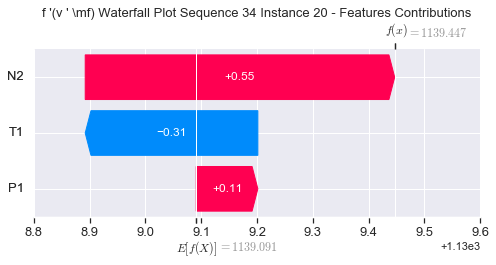

None

Contribution: [ 0.30439834 -0.70415806  1.45080973]


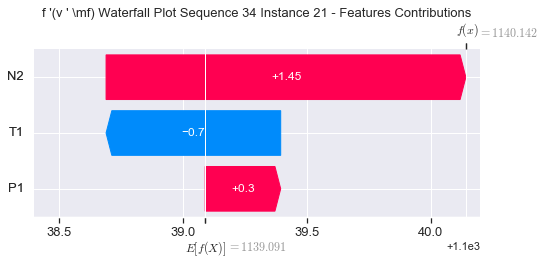

None

Contribution: [ 0.53365619 -1.79220747  2.82291437]


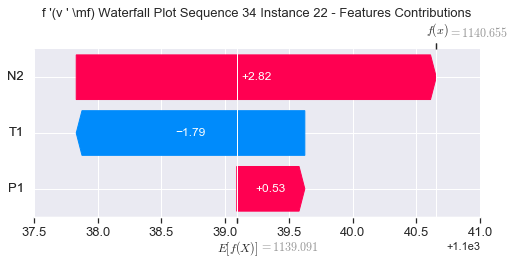

None

Contribution: [ 0.47249739 -4.21592057  4.16439322]


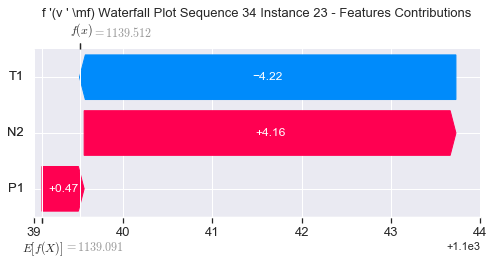

None

Contribution: [ 0.54766439 -6.79338746  3.86289076]


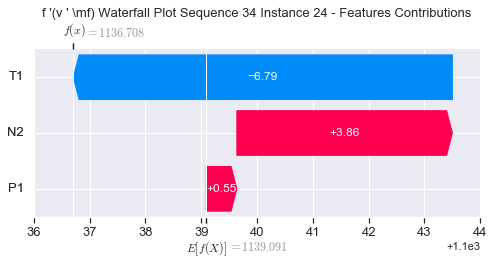

None

In [81]:
#Waterfall Plot for Consistency metric

sns.set()
instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("f '(v ' \mf) Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)